# Analysis of crosslinking experiment

In [13]:
#importing usefull library
from IPython.display import Image
from IPython.core.display import HTML
import matplotlib.pyplot as plt 
import scipy.cluster.hierarchy as sch
import matplotlib.gridspec as gridspec
import pandas as pd
import numpy as np
from scripts import utilities
import seaborn as sns
import gc
import os
from tqdm import tqdm_notebook as tqdm
import itertools
from scipy import stats
from ipyparallel import Client
import os
import pprint
from scripts import make_fig
from scripts import utilities
from analytic_wfm import peakdetect
from scripts import utilities

In [14]:
for exp in ['exp1', 'exp2', 'exp3']:
    proteinGroups = pd.read_csv(os.path.join('in_data',exp,'proteinGroups.txt'), sep='\t')   
    proteinGroups = utilities.clean(proteinGroups,upep=2)
    proteinGroups['prot_id']=[utilities.clean_id(n) for n in proteinGroups['Protein IDs']]
    proteinGroups.set_index('prot_id',inplace=True)
    print(proteinGroups.shape)
    proteinGroups.to_csv(os.path.join('in_data' ,exp, exp+'.csv'))
    for label,name in zip(['LFQ intensity ','MS/MS Count ', 'iBAQ ', 'Unique peptides '],['lfq','msms','ibaq','upep']):
        temp = utilities.get_data(proteinGroups, label,  '', list(np.arange(1,28,1)))
        temp.to_csv(os.path.join('in_data' ,exp, name+'.csv')) 

d:\my_env\prediction\lib\site-packages\IPython\core\interactiveshell.py:2785: DtypeWarning: Columns (292,293) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


removed  93 Only identified by site
tot  93  entries removed
---------------
removed  47 Reverse
tot  140  entries removed
---------------
removed  55 Potential contaminant
tot  195  entries removed
---------------
removed  414 Peptide counts (unique)
tot  609  entries removed
---------------
(4294, 306)
got:  4294 protein now
got:  4294 protein now
got:  4294 protein now
got:  4294 protein now


d:\my_env\prediction\lib\site-packages\IPython\core\interactiveshell.py:2785: DtypeWarning: Columns (292,293) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


removed  78 Only identified by site
tot  78  entries removed
---------------
removed  46 Reverse
tot  124  entries removed
---------------
removed  58 Potential contaminant
tot  182  entries removed
---------------
removed  478 Peptide counts (unique)
tot  660  entries removed
---------------
(4134, 306)
got:  4134 protein now
got:  4134 protein now
got:  4134 protein now
got:  4134 protein now
removed  69 Only identified by site
tot  69  entries removed
---------------
removed  44 Reverse
tot  113  entries removed
---------------
removed  44 Potential contaminant
tot  157  entries removed
---------------
removed  436 Peptide counts (unique)
tot  593  entries removed
---------------
(4016, 306)
got:  4016 protein now
got:  4016 protein now
got:  4016 protein now
got:  4016 protein now


In [15]:
def get_exp(label=''):
    exp_list = []
    for exp in ['exp1', 'exp2', 'exp3']:
        fpath = os.path.join('in_data', exp, label+'.csv')
        df = pd.read_csv(fpath)
        df = df.drop_duplicates('prot_id')
        df = df.set_index('prot_id')
        #df['max'] = np.argmax(df.values,axis=1)
        #df = df[(df['max']>2)]
        #del df['max']
        exp_list.append(df)
    return exp_list

def filter_start_column(exp_list):
    res = []
    for n in exp_list:
        n['max'] = np.argmax(n.values,axis=1)
        n = n[ (n['max']>2) ]
        del n['max'] 
        res.append(n)
    return res


def only_unique(exp_list):
    res =[]
    prots = set(exp_list[0].index.values)
    for n in exp_list[1:]:
        prots  = prots & set(n.index.values)
    res = [n.loc[prots] for n in exp_list]
    return res

def get_corr(exp_list):    
    rows = exp_list[0].index.values
    indexes = np.arange(len(exp_list))
    pairs = [n for n in itertools.combinations(indexes,2)]
    res = {}
    for n in pairs:
        key = str(n[0])+'_'+str(n[1])
        res[key]=[]
    for row in rows:
        for n in pairs:
            key = str(n[0])+'_'+str(n[1])
            #print(exp_list[n[0]].loc[prot].values)
            pearson,pval = stats.pearsonr(exp_list[n[0]].loc[row].values,
                           exp_list[n[1]].loc[row].values)
            res[key]+=[pearson]
    for n in pairs:
        key = str(n[0])+'_'+str(n[1])
        res[key]=pd.Series(res[key])
    return res

def norm_profile(X):
    return (X-X.mean())/X.std()

def mask_neg(X):
    return X.clip(lower=0)

def process_profile(X):
    X=norm_profile(X)
    X = savitzky_golay(X, 5, 3)
    X = mask_neg(X)
    return X
    
def get_profile(prot='Tb927.7.5090', dataset=('ibaq',0) ):
    x = res[dataset[0]][0][dataset[1]].loc[prot].values
    X=norm_profile(x)
    Xs = savitzky_golay(X, 5, 3)
    Xs = mask_neg(Xs)    
    return x, X, Xs

xw = [7,   9,    13,   14,  18, 19]
yw = [2000,600,  160, 132,  80, 66]
def plot_line(df, ax, 
              new_ticks={'label':'MW kDa',
                      'values': {
                      7:'2000', 
                      9:'600',
                      #13:'160',
                      14:'132',   
                      #4:'132', 
                      18:'80',     
                      19:'66', 
                      }},
              legend=False):
    plt.style.use('ggplot')
    #remove all zero entries
    df.fillna(0,inplace=True)
    df = df[(df.T != 0).any()]
    df.T.plot(ax=ax)
    ax.ticklabel_format(style='sci', axis='y', scilimits=(1,4))
    ax.set_xticks( [n for n in range(df.shape[1])])
    ax.set_xticklabels( [n for n in range(df.shape[1])])
    if legend:
        ax.legend(loc='center left', bbox_to_anchor=(1.1, 0.5),  
              fancybox=True, framealpha=0.5, fontsize = 'small')
    else:
        ax.legend_.remove()
    ax.set_xlim(-1,df.shape[1]+1)
    ax.set_xlabel(new_ticks['label'], labelpad=1)
    ax.set_ylabel('intensity', rotation=90)
    #ax.set_title(title)
    ticks = [new_ticks['values'][n] if n in new_ticks['values'] else '' for n in range(1, df.shape[1], 1) ]                    
    ax.set_xticklabels(ticks)

def mixing_correction(X):
    cf = [1 for n in range(18)]
    cf+= [2 for n in range(5)]
    cf+= [3 for n in range(4)]
    X=X/cf
    return X
    
    
def savitzky_golay(y, window_size, order, deriv=0, rate=1):
    #y=y.values
    name = y.name
    values = y.values
    index=y.index.values
    r"""Smooth (and optionally differentiate) data with a Savitzky-Golay filter.
    The Savitzky-Golay filter removes high frequency noise from data.
    It has the advantage of preserving the original shape and
    features of the signal better than other types of filtering
    approaches, such as moving averages techniques.
    Parameters
    ----------
    y : array_like, shape (N,)
        the values of the time history of the signal.
    window_size : int
        the length of the window. Must be an odd integer number.
    order : int
        the order of the polynomial used in the filtering.
        Must be less then `window_size` - 1.
    deriv: int
        the order of the derivative to compute (default = 0 means only smoothing)
    Returns
    -------
    ys : ndarray, shape (N)
        the smoothed signal (or it's n-th derivative).
    Notes
    -----
    The Savitzky-Golay is a type of low-pass filter, particularly
    suited for smoothing noisy data. The main idea behind this
    approach is to make for each point a least-square fit with a
    polynomial of high order over a odd-sized window centered at
    the point.
    Examples
    --------
    t = np.linspace(-4, 4, 500)
    y = np.exp( -t**2 ) + np.random.normal(0, 0.05, t.shape)
    ysg = savitzky_golay(y, window_size=31, order=4)
    import matplotlib.pyplot as plt
    plt.plot(t, y, label='Noisy signal')
    plt.plot(t, np.exp(-t**2), 'k', lw=1.5, label='Original signal')
    plt.plot(t, ysg, 'r', label='Filtered signal')
    plt.legend()
    plt.show()
    References
    ----------
    .. [1] A. Savitzky, M. J. E. Golay, Smoothing and Differentiation of
       Data by Simplified Least Squares Procedures. Analytical
       Chemistry, 1964, 36 (8), pp 1627-1639.
    .. [2] Numerical Recipes 3rd Edition: The Art of Scientific Computing
       W.H. Press, S.A. Teukolsky, W.T. Vetterling, B.P. Flannery
       Cambridge University Press ISBN-13: 9780521880688
    """
    import numpy as np
    from math import factorial


    window_size = np.abs(np.int(window_size))
    order = np.abs(np.int(order))
    #except ValueError, msg:
        #raise ValueError("window_size and order have to be of type int")
    if window_size % 2 != 1 or window_size < 1:
        raise TypeError("window_size size must be a positive odd number")
    if window_size < order + 2:
        raise TypeError("window_size is too small for the polynomials order")
    order_range = range(order+1)
    half_window = (window_size -1) // 2
    # precompute coefficients
    b = np.mat([[k**i for i in order_range] for k in range(-half_window, half_window+1)])
    m = np.linalg.pinv(b).A[deriv] * rate**deriv * factorial(deriv)
    # pad the signal at the extremes with
    # values taken from the signal itself
    firstvals = y[0] - np.abs( y[1:half_window+1][::-1] - y[0] )
    lastvals = y[-1] + np.abs(y[-half_window-1:-1][::-1] - y[-1])
    y = np.concatenate((firstvals, y, lastvals))
    values = np.convolve( m[::-1], y, mode='valid') 
    
    return  pd.Series(name=name,index=index,data=values)

def count_peack(X,index=0):
    return len(X[index])

In [16]:
#res['lfq']['exp_list'][0].iloc[0]
#savitzky_golay(res['lfq']['exp_list'][0].loc[prots].values[0], 5, 3, deriv=0, rate=1)

In [17]:
desc_dict = {}
list_ids = []
from Bio import SeqIO
for record in SeqIO.parse("in_data/TriTrypDB-37_TbruceiTREU927_AnnotatedProteins.fasta", "fasta"):
    #print(record.description)
    if '|' in record.description:
        desc = record.description.split(' | ')[4].split('=')[1].strip()
    else:
        desc = record.description
    list_ids.append(utilities.clean_id(record.id))
    desc_dict[utilities.clean_id(record.id)]=desc
open('list_ids.txt','w').write('\n'.join(list_ids))

150499

In [18]:
gene_table = pd.read_table('gene_table.txt')
gene_table.set_index('[Input ID]',inplace=True)
gene_table.head()
gene_table['[Molecular Weight]']=gene_table['[Molecular Weight]']/1000
gene_table['[Molecular Weight]']=gene_table['[Molecular Weight]'].astype(int)
gene_table.head()

,[Gene ID],[source_id],[Organism],[Genomic Location (Gene)],[Product Description],[Gene Name or Symbol],[Chromosome],[Genomic Location (Transcript)],[CDS Length],[Protein Length],[# TM Domains],[SignalP Peptide],[SignalP Scores],[Isoelectric Point],[Molecular Weight],Unnamed: 16
[Input ID],,,,,,,,,,,,,,,,
Tb04.24M18.150,Tb04.24M18.150,Tb04.24M18.150:mRNA,T. brucei brucei TREU927,"Tb927_04_v5.1:1,458,621..1,459,109(-)","hypothetical protein, conserved",NaN,04,Tb927_04_v5.1:1458621..1459109(-),489,162,0,NaN,NaN,8.76,18,NaN
Tb04.3I12.100,Tb04.3I12.100,Tb04.3I12.100:mRNA,T. brucei brucei TREU927,"Tb927_04_v5.1:1,312,814..1,313,406(-)",hypothetical protein,NaN,04,Tb927_04_v5.1:1312951..1313406(-),456,151,3,NaN,NaN,10.99,17,NaN
Tb05.30F7.410,Tb05.30F7.410,Tb05.30F7.410:mRNA,T. brucei brucei TREU927,"Tb927_05_v5.1:288,984..293,087(-)",hypothetical protein,NaN,05,Tb927_05_v5.1:292578..293087(-),510,169,0,NaN,NaN,10.21,18,NaN
Tb05.5K5.10,Tb05.5K5.10,Tb05.5K5.10:mRNA,T. brucei brucei TREU927,5K5_v5.1:3..97(-),"conserved hypothetical protein, conserved (fra...",NaN,Not Assigned,5K5_v5.1:3..74(-),72,24,0,NaN,NaN,8.22,2,NaN
Tb05.5K5.100,Tb05.5K5.100,Tb05.5K5.100:mRNA,T. brucei brucei TREU927,"5K5_v5.1:17,609..18,248(-)","hypothetical protein, conserved",NaN,Not Assigned,5K5_v5.1:17609..18118(-),510,169,0,NaN,NaN,10.08,18,NaN


In [19]:
#exp_list = get_exp(label=label)
#exp_list[0].to_csv('test.csv')

In [20]:
res = {}
for label in ['lfq', 'ibaq', 'msms', 'upep']:
    print(label)
    exp_list = get_exp(label=label)
    
    exp_list_filter_start_column = filter_start_column(exp_list)
    
    exp_list_common = only_unique(exp_list_filter_start_column)
    
    corr_prots = get_corr(exp_list_common)
    
    corr_columns = get_corr([n.T for n in exp_list_common])
    corrected = [n.apply(mixing_correction, axis=1) for n in exp_list_common]
    normed = [n.apply(norm_profile, axis=1) for n in corrected]
    smoothed = [n.apply(savitzky_golay, args=(5,3), axis=1) for n in normed]
    masked = [n.clip(lower=0) for n in smoothed]
    peaks = [n.apply(peakdetect, lookahead=2, delta=0.25, axis=1) for n in masked]
    max_count =  [n.apply(count_peack, index=0) for n in peaks]
    min_count =  [n.apply(count_peack, index=1) for n in peaks]
    res[label]={'exp_list':exp_list,
                'exp_list_filter_start_column':exp_list_filter_start_column,
                'exp_list_common':exp_list_common,
                'corr_prots':corr_prots, 
                'corr_columns':corr_columns,
                'exp_mixc':corrected,
                'exp_normed':normed,
                'exp_smoothed':smoothed,
                'exp_masked':masked,
                'peaks':peaks,
                'max_count':max_count,
                'min_count':min_count,
               }
    

lfq
ibaq
msms
upep


In [21]:
for label in ['lfq', 'ibaq', 'upep', 'msms']:
    print(label, [n.max() for n in res[label]['min_count']])

lfq [3, 3, 4]
ibaq [3, 3, 3]
upep [4, 3, 3]
msms [4, 3, 3]


In [22]:
def split_data(res, quant='lfq', index=0):
    new_data = []
    for prot in res[quant]['min_count'][index].index.values:
        min_count = res[quant]['min_count'][index].loc[prot]
        if min_count == 0:
            new_data.append(res[quant]['exp_masked'][index].loc[prot]) 
        if min_count == 1:
            prot_data = res[quant]['exp_masked'][index].loc[prot]
            prot_data=prot_data.to_frame()
            min_values = res[quant]['peaks'][index].loc[prot][1]
            x,y=(zip(*min_values))
            prot_data[prot+'_profile_0']=[n if index < x[0] else 0 for index,n in enumerate(prot_data[prot])]
            prot_data[prot+'_profile_1']=[n if index >= x[0] else 0 for index,n in enumerate(prot_data[prot])]
            new_data.append(prot_data[prot+'_profile_0'])
            new_data.append(prot_data[prot+'_profile_1'])
        if min_count == 2:
            prot_data = res[quant]['exp_masked'][index].loc[prot]
            prot_data=prot_data.to_frame()
            min_values = res[quant]['peaks'][index].loc[prot][1]
            x,y=(zip(*min_values))
            prot_data[prot+'_profile_0']=[n if index < x[0] else 0 for index,n in enumerate(prot_data[prot])]
            prot_data[prot+'_profile_1']=[n if index >= x[0] and index < x[1] else 0 for index,n in enumerate(prot_data[prot])]
            prot_data[prot+'_profile_2']=[n if index >= x[1]  else 0 for index, n in enumerate(prot_data[prot])]
            new_data.append(prot_data[prot+'_profile_0'])
            new_data.append(prot_data[prot+'_profile_1'])
            new_data.append(prot_data[prot+'_profile_2'])
        if min_count >= 3:
            prot_data = res[quant]['exp_masked'][index].loc[prot]
            prot_data=prot_data.to_frame()
            min_values = res[quant]['peaks'][index].loc[prot][1]
            x,y=(zip(*min_values))
            prot_data[prot+'_profile_0']=[n if index < x[0] else 0 for index,n in enumerate(prot_data[prot])]
            prot_data[prot+'_profile_1']=[n if index >= x[0] and index < x[1] else 0 for index,n in enumerate(prot_data[prot])]
            prot_data[prot+'_profile_2']=[n if index >= x[1] and index < x[2] else 0 for index, n in enumerate(prot_data[prot])]
            prot_data[prot+'_profile_3']=[n if index >= x[2]  else 0 for index, n in enumerate(prot_data[prot])]
            new_data.append(prot_data[prot+'_profile_0'])
            new_data.append(prot_data[prot+'_profile_1'])
            new_data.append(prot_data[prot+'_profile_2'])
            new_data.append(prot_data[prot+'_profile_3'])
            #print(prot_data)
        
    new_data=pd.concat(new_data,axis=1)
    new_data=new_data.T
    print(quant, 'done')
    return new_data

res['lfq']['exp_split']=[split_data(res, quant='lfq', index=0), 
                         split_data(res, quant='lfq', index=1),
                         split_data(res, quant='lfq', index=2)]
res['ibaq']['exp_split']=[split_data(res, quant='ibaq', index=0), 
                          split_data(res, quant='ibaq', index=1),
                          split_data(res, quant='ibaq', index=2)]

res['msms']['exp_split']=[split_data(res, quant='msms', index=0), 
                          split_data(res, quant='msms', index=1),
                          split_data(res, quant='msms', index=2)]

res['upep']['exp_split']=[split_data(res, quant='upep', index=0), 
                          split_data(res, quant='upep', index=1),
                          split_data(res, quant='upep', index=2)]

#res['msms']['exp_split']=[split_data(res, quant='msms', index=0), split_data(res, quant='msms', index=1)]
#res['upep']['exp_split']=[split_data(res, quant='upep', index=0), split_data(res, quant='upep', index=1)]

lfq done
lfq done
lfq done
ibaq done
ibaq done
ibaq done
msms done
msms done
msms done
upep done
upep done
upep done


a = -0.2656302903508436
b = 8.9629854095577
Line Solution is y = -0.2656302903508436x + 8.9629854095577
5 2069.0274766223197
6 1586.3700018515522
7 1216.305636927928
8 932.5689471535343
9 715.0216317270792
10 548.2232015103585
11 420.3350854551284
12 322.28038429933497
13 247.0996347870056
14 189.4568595746755
15 145.26084456109396
16 111.3747636795665
17 85.39354168123576
18 65.47315316281829
19 50.19974228359969
20 38.48927390243553
21 29.510593842643843
22 22.626437462889662
23 17.34819959882552
24 13.301255657869431
25 10.19837252091458
26 7.8193220813564315
27 5.995250485957453


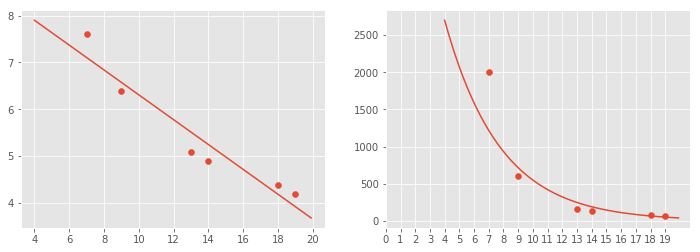

In [23]:
xw = [7,   9,    13,   14,  18, 19]
yw = [2000,600,  160, 132,  80, 66]
coefficients = np.polyfit(xw, np.log(yw), 1)
# Print the findings
print ('a =', coefficients[0])
print ('b =', coefficients[1])
# Calculate the coefficients. This line answers the initial question. 
a=coefficients[0]
b=coefficients[1]
print("Line Solution is y = {a}x + {b}".format(a=a, b=b))  
for n in np.arange(5, 28, 1):
    print (n, np.exp(a*n+b))
fig,axes = plt.subplots(ncols=2,nrows=1,figsize=(12,4))
axes[0].scatter(xw, np.log(yw))
axes[0].plot(np.arange(4,20,0.1), [a*x+b for x in np.arange(4,20,0.1)])
axes[1].scatter(xw, yw)
axes[1].plot(np.arange(4,20,0.1), [np.exp(a*x+b) for x in np.arange(4,20,0.1)])
axes[1].set_xticks(np.arange(0,20,1))
plt.show()

In [24]:
mw_dict = gene_table['[Molecular Weight]'].to_dict()
def filter_mw(df, a, b, mw_dict):
    temp = df.copy()
    temp['max']=temp.apply(np.argmax,axis=1)
    temp['max']=[int(n.split(' ')[-1]) for n in temp['max']]
    temp['mw']=[mw_dict[n.split('_')[0]] for n in temp.index.values]
    temp['app_mw']=[np.exp(a*n+b) for n in temp['max']]
    temp['dif_mw']=temp['app_mw']/temp['mw']
    temp=temp[temp['dif_mw']>1.5]
    return temp

res['lfq']['exp_filter_mw']=[filter_mw(res['lfq']['exp_split'][0],a,b,mw_dict), 
                             filter_mw(res['lfq']['exp_split'][1],a,b,mw_dict),
                             filter_mw(res['lfq']['exp_split'][2],a,b,mw_dict),]

res['ibaq']['exp_filter_mw']=[filter_mw(res['ibaq']['exp_split'][0],a,b,mw_dict), 
                              filter_mw(res['ibaq']['exp_split'][1],a,b,mw_dict),
                              filter_mw(res['ibaq']['exp_split'][2],a,b,mw_dict)]

res['msms']['exp_filter_mw']=[filter_mw(res['msms']['exp_split'][0],a,b,mw_dict), 
                              filter_mw(res['msms']['exp_split'][1],a,b,mw_dict),
                              filter_mw(res['msms']['exp_split'][2],a,b,mw_dict)]

res['upep']['exp_filter_mw']=[filter_mw(res['upep']['exp_split'][0],a,b,mw_dict), 
                              filter_mw(res['upep']['exp_split'][1],a,b,mw_dict),
                              filter_mw(res['upep']['exp_split'][2],a,b,mw_dict)]


#res['msms']['exp_filter_mw']=[filter_mw(res['msms']['exp_split'][0],a,b,mw_dict), filter_mw(res['msms']['exp_split'][1],a,b,mw_dict)]
#res['upep']['exp_filter_mw']=[filter_mw(res['upep']['exp_split'][0],a,b,mw_dict), filter_mw(res['upep']['exp_split'][1],a,b,mw_dict)]

d:\my_env\prediction\lib\site-packages\numpy\core\fromnumeric.py:51: FutureWarning: 'argmax' is deprecated, use 'idxmax' instead. The behavior of 'argmax'
will be corrected to return the positional maximum in the future.
Use 'series.values.argmax' to get the position of the maximum now.
  return getattr(obj, method)(*args, **kwds)


# Troubleshooting
The data is not reproducible.
The experiment replica might have different crosslinking efficency altering the profile shape . Let's see a few examples:

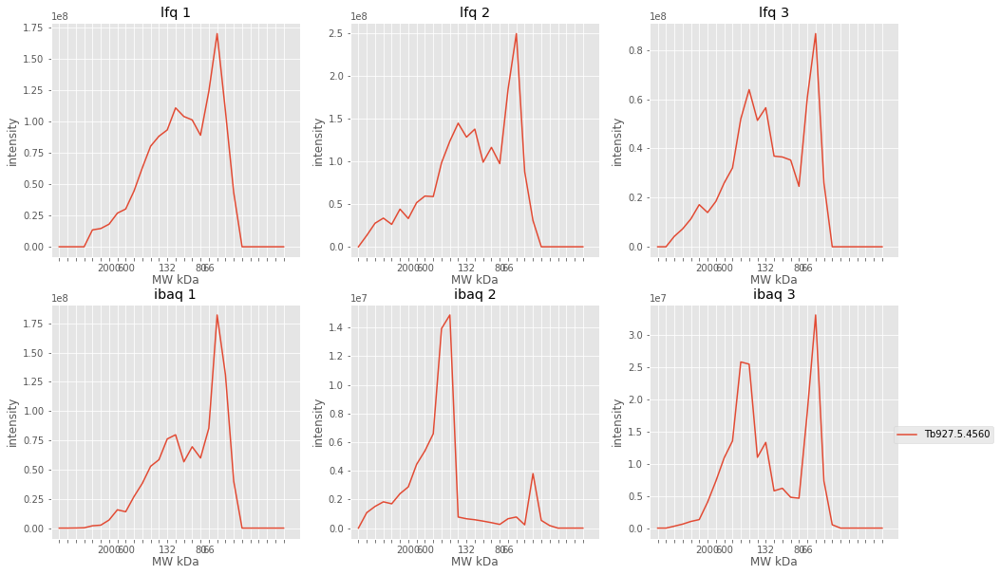

              [Molecular Weight]  [# TM Domains]        [Product Description]
[Input ID]                                                                   
Tb927.5.4560                  55               0  guanine deaminase, putative


In [15]:
plt.style.use('ggplot')
prots=['Tb927.5.4560']#Tb927.10.7940
fig,axes = plt.subplots(ncols=3,nrows=2,figsize=(16,10))
prots = [n  for n in prots if n in res['lfq']['exp_list'][0].index.values]
plot_line(res['lfq']['exp_list'][0].loc[prots], axes[0,0])
plot_line(res['lfq']['exp_list'][1].loc[prots], axes[0,1])
plot_line(res['lfq']['exp_list'][2].loc[prots], axes[0,2])
plot_line(res['ibaq']['exp_list'][0].loc[prots], axes[1,0])
plot_line(res['ibaq']['exp_list'][1].loc[prots], axes[1,1])
plot_line(res['ibaq']['exp_list'][2].loc[prots], axes[1,2])
plt.legend(bbox_to_anchor=(1.4, 0.5))
axes[0,0].set_title('lfq 1')
axes[0,1].set_title('lfq 2')
axes[0,2].set_title('lfq 3')
axes[1,0].set_title('ibaq 1')
axes[1,1].set_title('ibaq 2')
axes[1,2].set_title('ibaq 3')
#plt.suptitle('Cytoplasmic dynein', fontsize=21)
#plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()
print(gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[prots])

howewer we hope that the experiments are consistent, even if the crosslinking efficent is different

# Data Analysis
We need a new way to analyze the data. 
The profile is different between the replica so we can not average them.
On the other end we can analyze each experiment independently.

## Pipline
### Profile Normalization
we take each profile, we substract the mean and we divide by the std deviation

In [16]:
def visualize_pipline(prots=[], quant_to_use = 'ibaq', res={}):
    #quant_to_use = 'ibaq'
    fig,axes = plt.subplots(ncols=3, nrows=7, figsize=(16,35))
    prots = [n  for n in prots if n in res[quant_to_use]['exp_list'][0].index.values]
    plot_line(res[quant_to_use]['exp_list'][0].loc[prots], axes[0,0])
    plot_line(res[quant_to_use]['exp_list'][1].loc[prots], axes[0,1])
    plot_line(res[quant_to_use]['exp_list'][2].loc[prots], axes[0,2])

    plot_line(res[quant_to_use]['exp_mixc'][0].loc[prots], axes[1,0])
    plot_line(res[quant_to_use]['exp_mixc'][1].loc[prots], axes[1,1])
    plot_line(res[quant_to_use]['exp_mixc'][2].loc[prots], axes[1,2])

    plot_line(res[quant_to_use]['exp_normed'][0].loc[prots], axes[2,0])
    plot_line(res[quant_to_use]['exp_normed'][1].loc[prots], axes[2,1])
    plot_line(res[quant_to_use]['exp_normed'][2].loc[prots], axes[2,2])

    plot_line(res[quant_to_use]['exp_smoothed'][0].loc[prots], axes[3,0])
    plot_line(res[quant_to_use]['exp_smoothed'][1].loc[prots], axes[3,1])
    plot_line(res[quant_to_use]['exp_smoothed'][2].loc[prots], axes[3,2])

    plot_line(res[quant_to_use]['exp_masked'][0].loc[prots], axes[4,0])
    plot_line(res[quant_to_use]['exp_masked'][1].loc[prots], axes[4,1])
    plot_line(res[quant_to_use]['exp_masked'][2].loc[prots], axes[4,2])

    split_profiles = [n for n in res[quant_to_use]['exp_split'][0].index.values if n.split('_')[0] in prots]
    plot_line(res[quant_to_use]['exp_split'][0].iloc[:,0:27].loc[split_profiles], axes[5, 0])

    split_profiles = [n for n in res[quant_to_use]['exp_split'][1].index.values if n.split('_')[0] in prots]
    plot_line(res[quant_to_use]['exp_split'][1].iloc[:,0:27].loc[split_profiles], axes[5, 1])

    split_profiles = [n for n in res[quant_to_use]['exp_split'][2].index.values if n.split('_')[0] in prots]
    plot_line(res[quant_to_use]['exp_split'][2].iloc[:,0:27].loc[split_profiles], axes[5, 2])



    for prot in prots:
        if prot in res[quant_to_use]['peaks'][0].index.values:
            temp = res[quant_to_use]['peaks'][0].loc[prot][0]
            if len(temp)>0:
                x, y = zip(*temp)
                axes[4, 0].scatter(x, y, marker='*', s=50, c='r')

    for prot in prots:
        if prot in res[quant_to_use]['peaks'][0].index.values:
            temp = res[quant_to_use]['peaks'][0].loc[prot][1]
            if len(temp)>0:
                x, y = zip(*temp)
                axes[4,0].scatter(x, y, marker='o',s=50,c='b')

    for prot in prots:
        if prot in res[quant_to_use]['peaks'][1].index.values:
            temp = res[quant_to_use]['peaks'][1].loc[prot][0]
            if len(temp)>0:
                x, y = zip(*temp)
                axes[4,1].scatter(x,y, marker='*',s=50,c='r')

    for prot in prots:
        if prot in res[quant_to_use]['peaks'][1].index.values:
            temp = res[quant_to_use]['peaks'][1].loc[prot][1]
            if len(temp)>0:
                x, y = zip(*temp)
                axes[4,1].scatter(x,y, marker='o',s=50,c='b')



    for prot in prots:
        if prot in res[quant_to_use]['peaks'][2].index.values:
            temp = res[quant_to_use]['peaks'][2].loc[prot][0]
            if len(temp)>0:
                x, y = zip(*temp)
                axes[4,2].scatter(x,y, marker='*',s=50,c='r')

    for prot in prots:
        if prot in res[quant_to_use]['peaks'][2].index.values:        
            temp = res[quant_to_use]['peaks'][2].loc[prot][1]
            if len(temp)>0:
                x, y = zip(*temp)
                axes[4,2].scatter(x,y, marker='o',s=50,c='b')




    split_profiles = [n for n in res[quant_to_use]['exp_filter_mw'][0].index.values if n.split('_')[0] in prots]
    plot_line(res[quant_to_use]['exp_filter_mw'][0].iloc[:,0:27].loc[split_profiles], axes[6, 0])

    split_profiles = [n for n in res[quant_to_use]['exp_filter_mw'][1].index.values if n.split('_')[0] in prots]
    plot_line(res[quant_to_use]['exp_filter_mw'][1].iloc[:,0:27].loc[split_profiles], axes[6, 1])

    split_profiles = [n for n in res[quant_to_use]['exp_filter_mw'][2].index.values if n.split('_')[0] in prots]
    plot_line(res[quant_to_use]['exp_filter_mw'][2].iloc[:,0:27].loc[split_profiles], axes[6, 2])


    axes[0,0].set_title(quant_to_use+' 1')
    axes[0,1].set_title(quant_to_use+' 2')
    axes[0,1].set_title(quant_to_use+' 3')

    axes[1,0].set_title(quant_to_use+' 1  after mix correction')
    axes[1,1].set_title(quant_to_use+' 2 after mix correction')
    axes[1,2].set_title(quant_to_use+' 3 after mix correction')

    axes[2,0].set_title(quant_to_use+' 1  after norm')
    axes[2,1].set_title(quant_to_use+' 2 after norm')
    axes[2,2].set_title(quant_to_use+' 3 after norm')

    axes[3,0].set_title(quant_to_use+'1  after smoothing')
    axes[3,1].set_title(quant_to_use+'2 after smoothing')
    axes[3,2].set_title(quant_to_use+'3 after smoothing')

    axes[4,0].set_title(quant_to_use+'1  after masked')
    axes[4,1].set_title(quant_to_use+'2 after masked')
    axes[4,2].set_title(quant_to_use+'3 after masked')

    axes[5,0].set_title(quant_to_use+' 1  after split')
    axes[5,1].set_title(quant_to_use+' 2 after split')
    axes[5,2].set_title(quant_to_use+' 3 after split')

    axes[6,0].set_title(quant_to_use+' 1  after mw filter')
    axes[6,1].set_title(quant_to_use+' 2 after mw filter')
    axes[6,2].set_title(quant_to_use+' 3 after mw filter')

    axes[6,0].legend(bbox_to_anchor=(0.5, -0.1))
    axes[6,1].legend(bbox_to_anchor=(0.5, -0.1))
    axes[6,2].legend(bbox_to_anchor=(0.5, -0.1))
    #plt.suptitle('Cytoplasmic dynein', fontsize=21)
    #plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()
    print(gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[prots])


In [18]:
plt.style.use('ggplot')
prots=[
#'Tb927.11.10690'
'Tb927.10.1060',
'Tb927.10.8190',
'Tb927.11.14250',
'Tb927.11.16760',
'Tb927.11.1900',
'Tb927.11.3240',
'Tb927.6.4760',
'Tb927.8.3150',
'Tb927.7.2500',
'Tb927.6.3100'
]

#CCR4-NOT
prots=[
'Tb927.10.1510',
'Tb927.10.8720',
'Tb927.8.1960',
'Tb927.6.850'
]

#2-oxoisovalerate 
prots=[
'Tb927.10.660',
'Tb927.10.4330'
]

#ruvB-like
prots=[
'Tb927.4.1270',
'Tb927.4.2000']

#RNA-editing complex
prots=[
'Tb927.7.3950',
'Tb927.8.620',
'Tb927.1.1690'
]


#PAMC1
prots=[
'Tb927.1.1730',
'Tb927.6.1200',
'Tb927.10.1730']

#Nucleoporin
prots=[
'Tb927.10.8910',
'Tb927.11.15560',
'Tb927.4.5200']

#N-acetyltransferase complex
prots=[
'Tb927.3.610',
'Tb927.11.4530',
'Tb927.10.3150',
'Tb927.7.2360']

#hypothetical 
prots=[
'Tb927.10.14480',
'Tb927.11.5030',
'Tb927.11.10600',
'Tb927.11.11050',
'Tb927.7.3210']

#ISWI
prots=[
'Tb927.10.5450',
'Tb927.2.1810',
'Tb927.7.1060',
'Tb927.11.10730']

#ISWI2
prots=[
'Tb927.2.1810',
'Tb927.11.1290',
'Tb927.4.1410',
'Tb927.6.4510',
'Tb927.7.1060']


prots = [
    'Tb927.11.9610', 'Tb927.5.2570', 'Tb927.8.5090'
]


#'prefoldin'
prots=[
'Tb927.11.12680',
'Tb927.11.800',
'Tb927.6.2340',
'Tb927.5.580',
'Tb927.11.12910',
'Tb927.11.16040']

prots=[
'Tb927.10.1060',
'Tb927.10.8190',
'Tb927.11.14250',
'Tb927.11.16760',
]



prots=[
'Tb927.11.12250',
'Tb927.1.650',
'Tb927.11.16630',
'Tb927.11.16920',
'Tb927.11.13380',
]


prots=['Tb927.8.3980',
'Tb927.10.7050',
'Tb927.11.4970',
'Tb927.11.8180',
'Tb927.10.4470']

#ruvB-like
prots=[
'Tb927.4.1270',
'Tb927.4.2000']
#2-oxoisovalerate 
prots=[
'Tb927.10.660',
'Tb927.10.4330'
]

prots=[
#'Tb927.11.10690'
'Tb927.10.1060',
'Tb927.10.8190',
'Tb927.11.14250',
'Tb927.11.16760',
'Tb927.11.1900',
'Tb927.11.3240',
'Tb927.6.4760',
'Tb927.8.3150',
#'Tb927.7.2500',
#'Tb927.6.3100'
]
#ruvB-like
prots=[
'Tb927.8.3980',
'Tb927.10.7050',
'T927.11.4970',
]



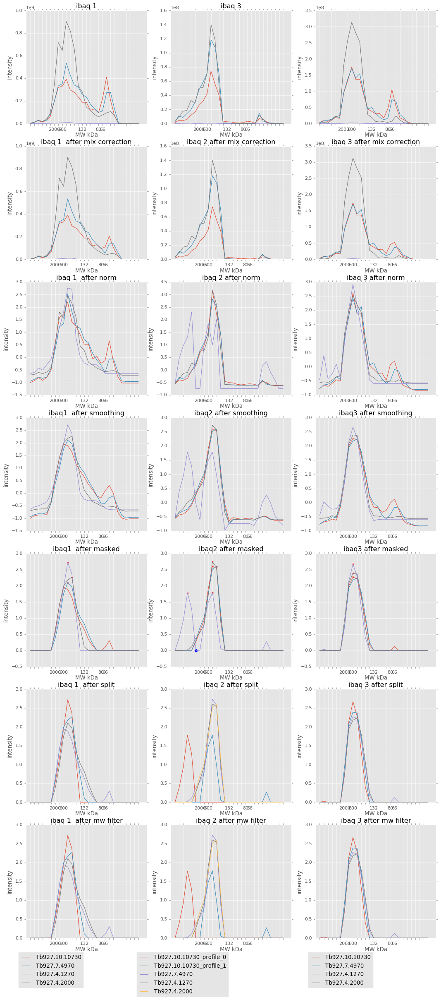

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.4.1270                    49               0   
Tb927.4.2000                    52               0   
Tb927.10.10730                 166               0   
Tb927.7.4970                    42               0   

                           [Product Description]  
[Input ID]                                        
Tb927.4.1270    ruvB-like DNA helicase, putative  
Tb927.4.2000    ruvB-like DNA helicase, putative  
Tb927.10.10730         RNA Interference Factor 5  
Tb927.7.4970      glutamine synthetase, putative  


In [61]:
prots=[
'Tb927.11.16920',
'Tb927.11.13380',
'Tb927.8.3980',
'Tb927.10.7050',
'Tb927.11.4970']
prots=[
#'Tb927.11.10690'
'Tb927.10.1060',
'Tb927.10.8190',
'Tb927.11.14250',
'Tb927.11.16760',
'Tb927.11.1900',
'Tb927.11.3240',
'Tb927.6.4760',
'Tb927.8.3150',
'Tb927.7.2500',
'Tb927.6.3100'
]
#ruvB-like
prots=[
'Tb927.4.1270',
'Tb927.4.2000',
'Tb927.10.10730',
'Tb927.7.4970']
import warnings
warnings.filterwarnings("ignore")
visualize_pipline(prots=prots, 
                  quant_to_use = 'ibaq', 
                  res=res)

found: 77


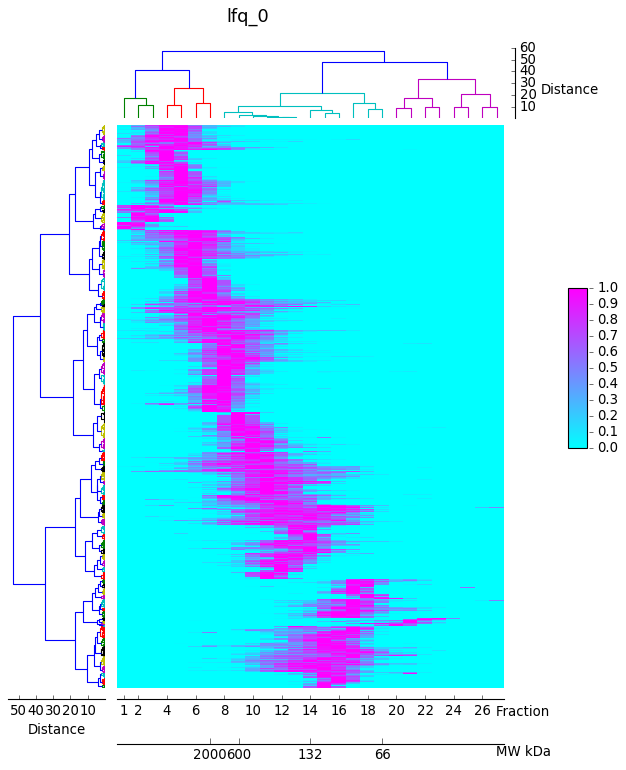

In [27]:
import warnings
warnings.filterwarnings("ignore")
temp = res['lfq']['exp_filter_mw'][0].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='lfq_0',
     fig_name = 'lfq_0.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      7:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('lfq_0_2.5.csv')
print('found:', len(cluster_df['clusters'].unique()))

In [28]:
#from sklearn.cluster.bicluster import SpectralBiclustering
#model = SpectralBiclustering(n_clusters=20, method='log',
                             #random_state=0)
#data = res['lfq']['exp_filter_mw'][0].iloc[:,0:27]
#model.fit(data)
#model.column_labels_
#data.iloc[np.argsort(model.row_labels_),np.argsort(model.column_labels_)]
#fit_data = data[np.argsort(model.row_labels_)]
#fit_data = fit_data[:, np.argsort(model.column_labels_)]
#plt.matshow(fit_data, cmap=plt.cm.Blues

found: 66


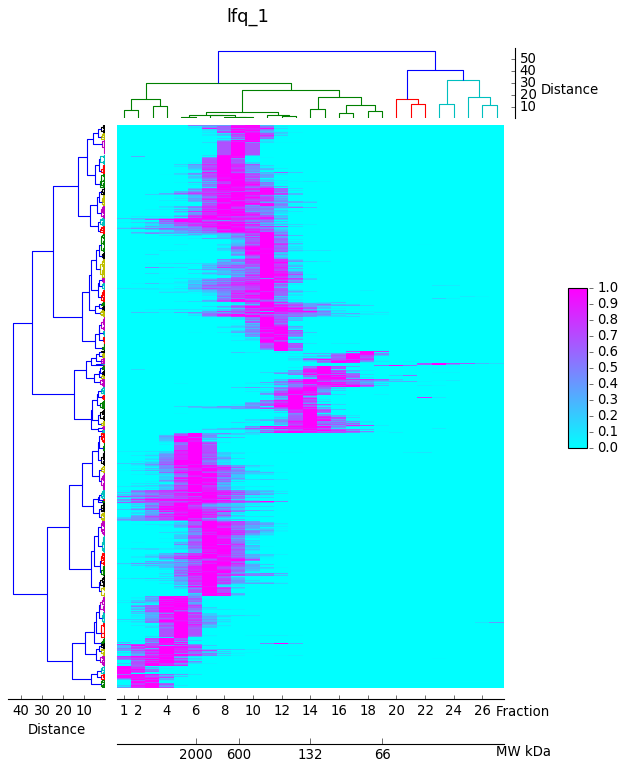

In [29]:
import warnings
warnings.filterwarnings("ignore")
temp = res['lfq']['exp_filter_mw'][1].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='lfq_1',
     fig_name = 'lfq_1.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('lfq_1_2.5.csv')
print('found:', len(cluster_df['clusters'].unique()))

found: 73


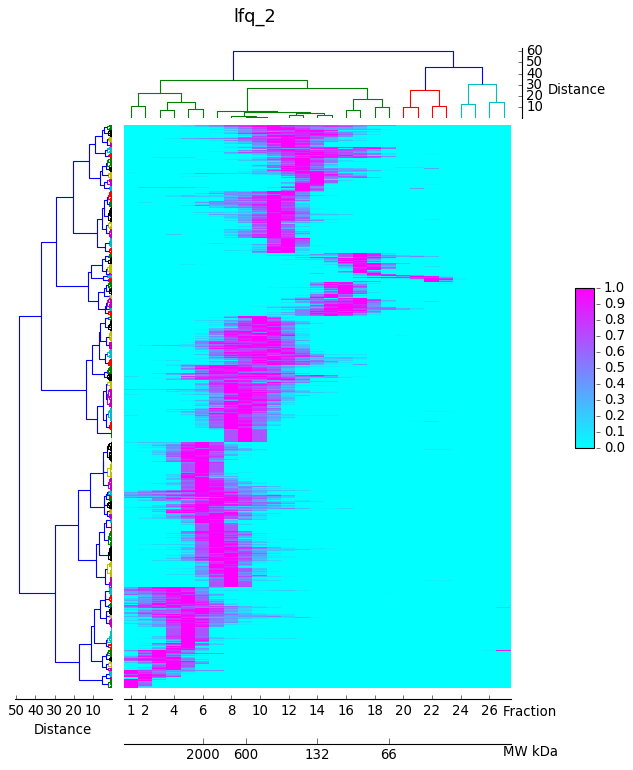

In [30]:
import warnings
warnings.filterwarnings("ignore")
temp = res['lfq']['exp_filter_mw'][2].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='lfq_2',
     fig_name = 'lfq_2.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('lfq_2_2.5.csv')
print('found:', len(cluster_df['clusters'].unique()))

In [207]:
def find_complex(df_1,df_2,df_3, cfile, gene_table):
    for cluster in df_1['clusters'].unique():
        prots_1 = df_1[df_1['clusters']==cluster].index.values
        prots_1 = set([n.split('_')[0] for n in prots_1])    
        for cluster2 in df_2['clusters'].unique():
            prots_2 = df_2[df_2['clusters']==cluster2].index.values
            prots_2 = set([n.split('_')[0] for n in prots_2])
            common = prots_1 & prots_2
            if len(common)>=2:
                for cluster3 in df_3['clusters'].unique():
                    prots_3 = df_3[df_3['clusters']==cluster3].index.values
                    prots_3 = set([n.split('_')[0] for n in prots_3])
                    common_2 = common & prots_3
                    if len(common_2)>=2:
                        fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(16,8))
                        #print(common)

                        plot_line(res['lfq']['exp_list'][0].loc[list(common_2)], axes[0,0])
                        plot_line(res['lfq']['exp_list'][1].loc[list(common_2)], axes[0,1])
                        plot_line(res['lfq']['exp_list'][2].loc[list(common_2)], axes[0,2])

                        plot_line(res['ibaq']['exp_list'][0].loc[list(common_2)], axes[1,0])
                        plot_line(res['ibaq']['exp_list'][1].loc[list(common_2)], axes[1,1])
                        plot_line(res['ibaq']['exp_list'][2].loc[list(common_2)], axes[1,2])
                        axes[0,0].set_title('lfq 0')
                        axes[0,1].set_title('lfq 1')
                        axes[0,2].set_title('lfq 2') 

                        axes[1,0].set_title('ibaq 0')
                        axes[1,1].set_title('ibaq 1')
                        axes[1,2].set_title('ibaq 2')

                        plt.subplots_adjust(wspace=0.2)
                        plt.subplots_adjust(hspace=0.3)
                        plt.legend(bbox_to_anchor=(0.4, -0.2))
                        plt.show()
                        gt = gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[list(common_2)]
                        gt = gt.drop_duplicates()
                        print (gt)
                        print (cluster, cluster2, cluster3, list(common_2))
                        temp_res = [str(cluster), str(cluster2), str(cluster3), ','.join(list(common_2)), ','.join(list(gt['[Product Description]'].values))]
                        cfile.write('\t'.join(temp_res)+'\n')

In [27]:
def find_complex_2(df_1,df_2, cfile, gene_table):
    for cluster in df_1['clusters'].unique():
        prots_1 = df_1[df_1['clusters']==cluster].index.values
        prots_1 = set([n.split('_')[0] for n in prots_1])    
        for cluster2 in df_2['clusters'].unique():
            prots_2 = df_2[df_2['clusters']==cluster2].index.values
            prots_2 = set([n.split('_')[0] for n in prots_2])
            common = prots_1 & prots_2
            if len(common)>=2:
                fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(16,8))
                #print(common)

                plot_line(res['lfq']['exp_list'][0].loc[list(common)], axes[0,0])
                plot_line(res['lfq']['exp_list'][1].loc[list(common)], axes[0,1])
                plot_line(res['lfq']['exp_list'][2].loc[list(common)], axes[0,2])

                plot_line(res['ibaq']['exp_list'][0].loc[list(common)], axes[1,0])
                plot_line(res['ibaq']['exp_list'][1].loc[list(common)], axes[1,1])
                plot_line(res['ibaq']['exp_list'][2].loc[list(common)], axes[1,2])
                axes[0,0].set_title('lfq 0')
                axes[0,1].set_title('lfq 1')
                axes[0,2].set_title('lfq 2') 

                axes[1,0].set_title('ibaq 0')
                axes[1,1].set_title('ibaq 1')
                axes[1,2].set_title('ibaq 2')

                plt.subplots_adjust(wspace=0.2)
                plt.subplots_adjust(hspace=0.3)
                plt.legend(bbox_to_anchor=(0.4, -0.2))
                plt.show()
                gt = gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[list(common)]
                gt = gt.drop_duplicates()
                print (gt)
                print (cluster, cluster2, list(common))
                temp_res = [str(cluster), str(cluster2), ','.join(list(common)), ','.join(list(gt['[Product Description]'].values))]
                cfile.write('\t'.join(temp_res)+'\n')

In [ ]:
plt.style.use('ggplot')
df_1 = pd.read_csv('lfq_0_2.5.csv',index_col=[0])
df_2 = pd.read_csv('lfq_1_2.5.csv',index_col=[0])
df_3 = pd.read_csv('lfq_2_2.5.csv',index_col=[0])

cfile = open('lfq_complexes_01.txt','w')
find_complex_2(df_1, df_2, cfile, gene_table)
cfile.close()  

cfile = open('lfq_complexes_02.txt','w')
find_complex_2(df_1, df_3, cfile, gene_table)
cfile.close()  

cfile = open('lfq_complexes_12.txt','w')
find_complex_2(df_2, df_3, cfile, gene_table)
cfile.close()  


In [ ]:
cfile = open('lfq_complexes.txt','w')
plt.style.use('ggplot')
df_1 = pd.read_csv('lfq_0_2.5.csv',index_col=[0])
df_2 = pd.read_csv('lfq_1_2.5.csv',index_col=[0])
df_3 = pd.read_csv('lfq_2_2.5.csv',index_col=[0])
find_complex(df_1, df_2, df_3, cfile, gene_table)
cfile.close()   

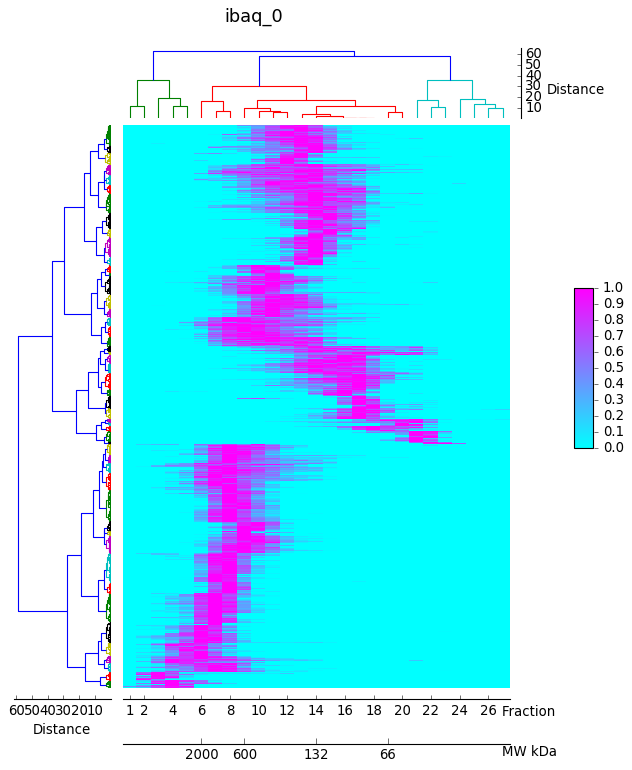

In [46]:
import warnings
warnings.filterwarnings("ignore")
temp = res['ibaq']['exp_filter_mw'][0].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=3.5,
     step_first_x = 2,
     title='ibaq_0',
     fig_name = 'ibaq_0.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('ibaq_0_3.5.csv')

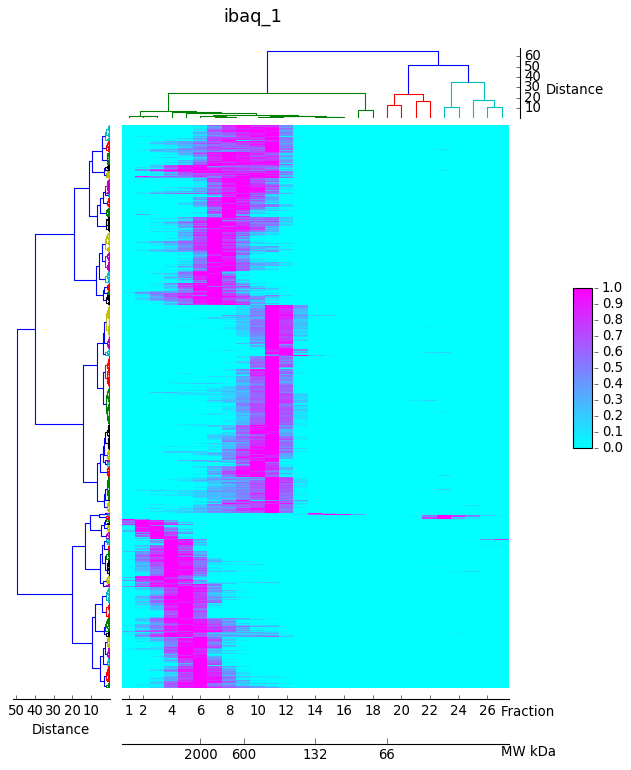

In [34]:
import warnings
warnings.filterwarnings("ignore")
temp = res['ibaq']['exp_filter_mw'][1].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='ibaq_1',
     fig_name = 'ibaq_1.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('ibaq_1_2.5.csv')

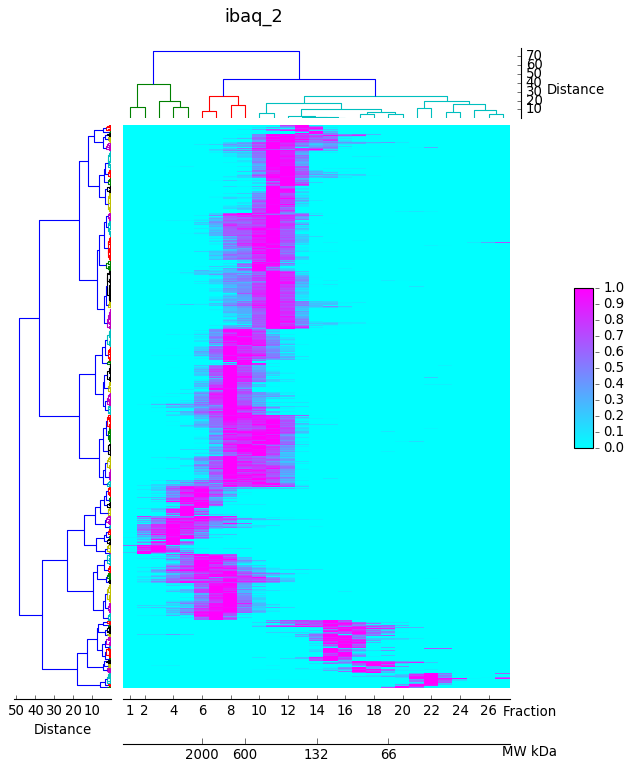

In [36]:
import warnings
warnings.filterwarnings("ignore")
temp = res['ibaq']['exp_filter_mw'][2].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='ibaq_2',
     fig_name = 'ibaq_2.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('ibaq_2_2.5.csv')

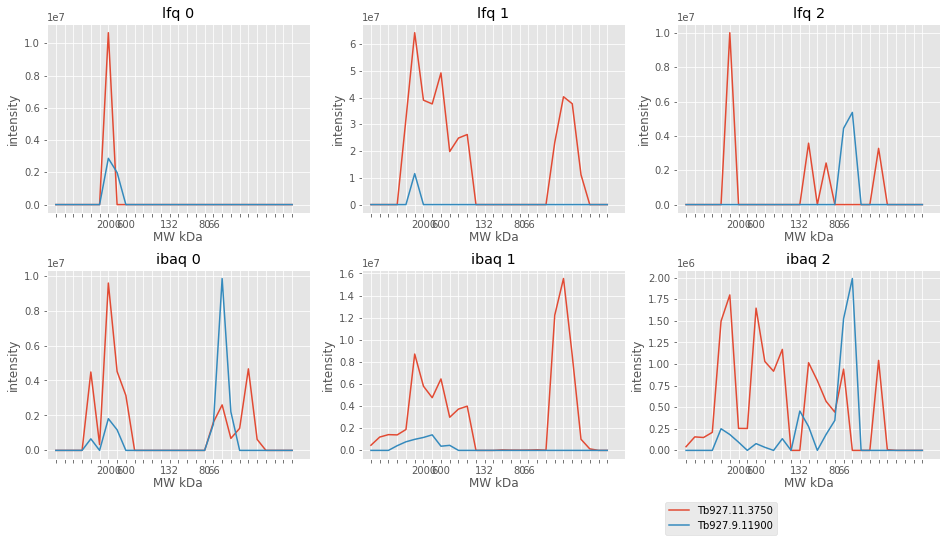

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.3750                  34               1   
Tb927.9.11900                  60               0   

                                [Product Description]  
[Input ID]                                             
Tb927.11.3750  NADH-cytochrome b5 reductase, putative  
Tb927.9.11900           acyl transferase-like protein  
15 41 30 ['Tb927.11.3750', 'Tb927.9.11900']


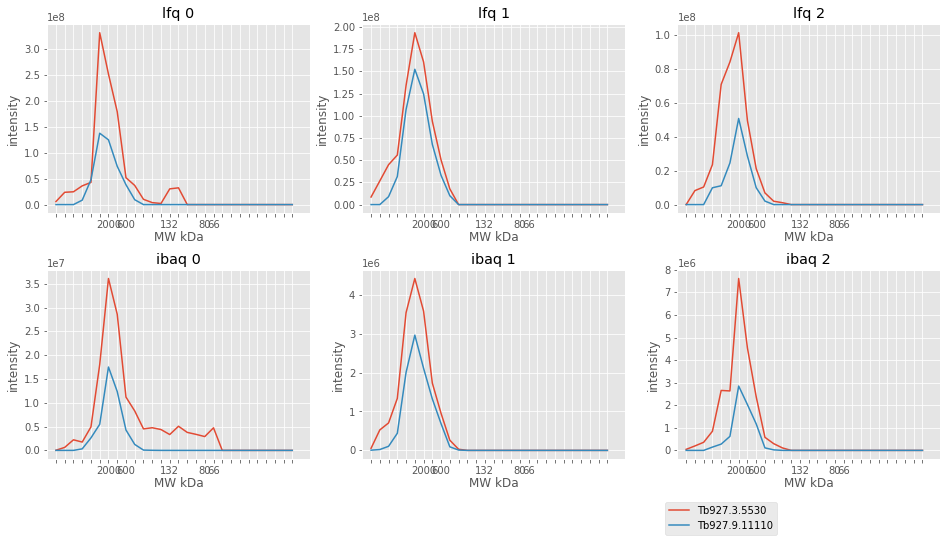

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.5530                  279               2   
Tb927.9.11110                 276               0   

                             [Product Description]  
[Input ID]                                          
Tb927.3.5530    Tb-292 membrane associated protein  
Tb927.9.11110  U5 snRNA-associated splicing factor  
15 2 17 ['Tb927.3.5530', 'Tb927.9.11110']


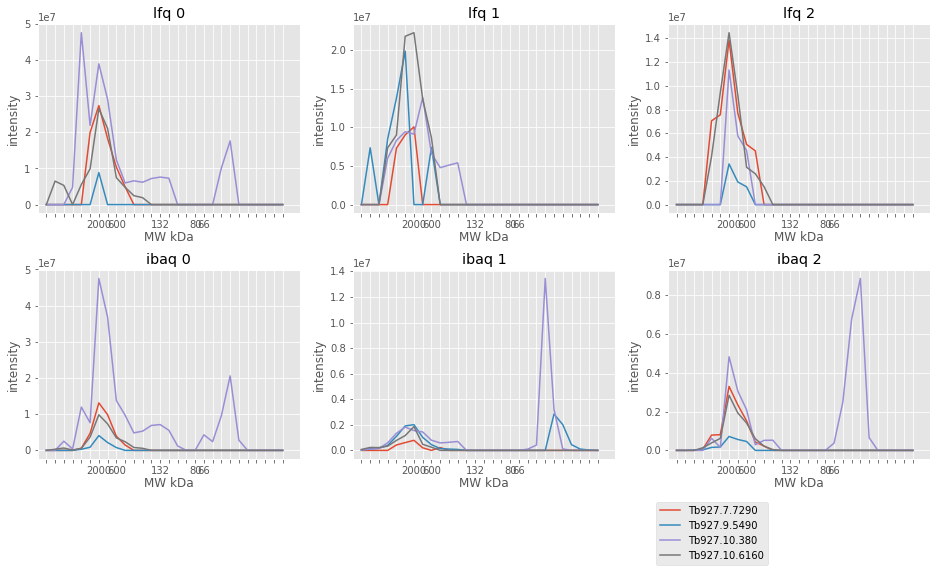

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.7290                  100               0   
Tb927.9.5490                   75               1   
Tb927.10.380                   39               0   
Tb927.10.6160                  81               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.7.7290                    COG4 transport protein, putative  
Tb927.9.5490                        cation transporter, putative  
Tb927.10.380   kinetoplast ribosomal PPR-repeat containing pr...  
Tb927.10.6160                        Sec34-like family, putative  
15 39 17 ['Tb927.7.7290', 'Tb927.9.5490', 'Tb927.10.380', 'Tb927.10.6160']


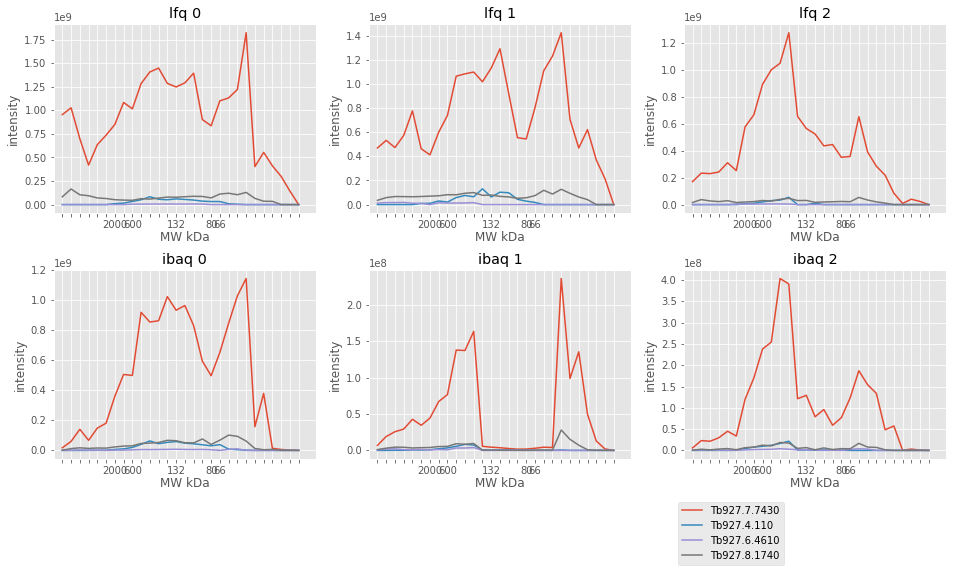

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.7430                  63               0   
Tb927.4.110                   40               0   
Tb927.6.4610                  46               0   
Tb927.8.1740                  62               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.7430                     ATP synthase F1, alpha subunit  
Tb927.4.110   retrotransposon hot spot protein 1 (RHS1), int...  
Tb927.6.4610               Ankyrin repeats (3 copies), putative  
Tb927.8.1740  Mitochondrial import inner membrane translocas...  
67 31 48 ['Tb927.7.7430', 'Tb927.4.110', 'Tb927.6.4610', 'Tb927.8.1740']


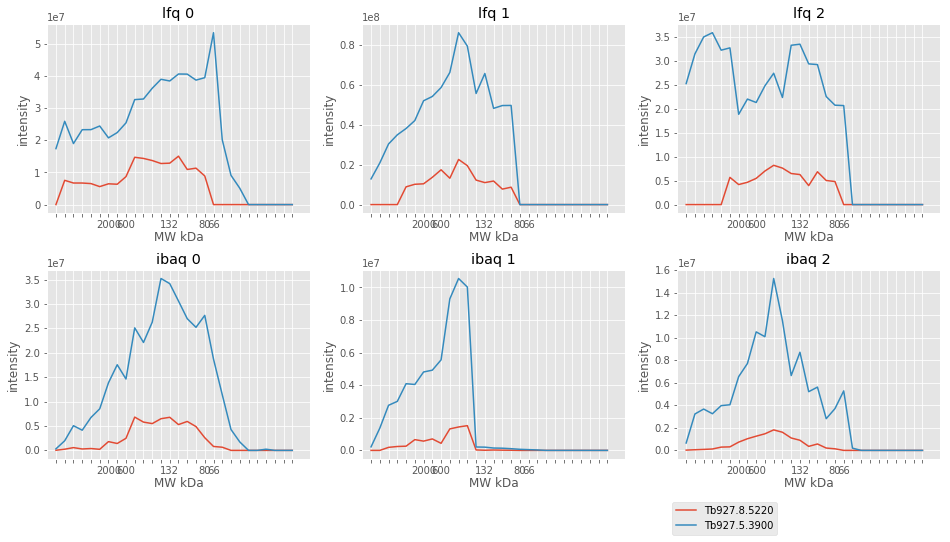

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.5220                 114               0   
Tb927.5.3900                  82               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.5220                    hypothetical protein, conserved  
Tb927.5.3900  Galactose oxidase, central domain/Domain of un...  
67 25 47 ['Tb927.8.5220', 'Tb927.5.3900']


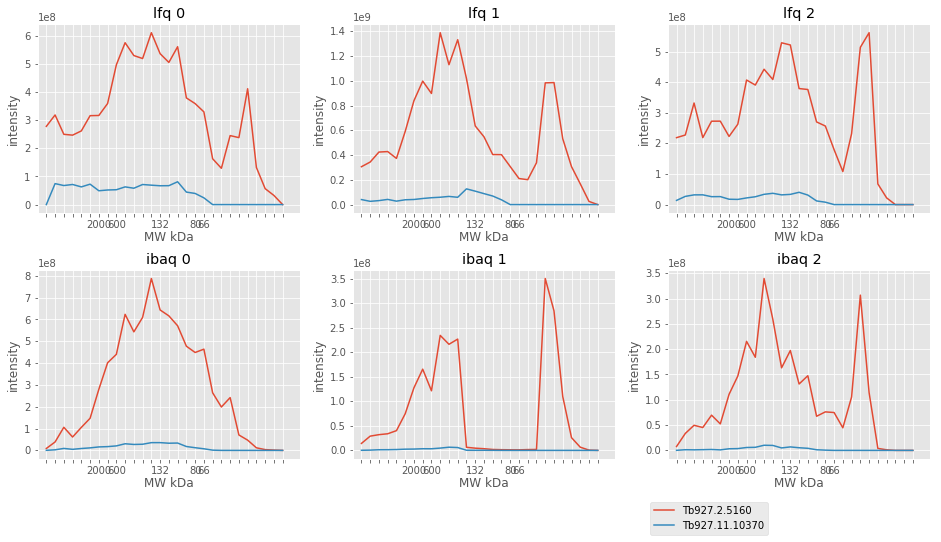

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.2.5160                    44               0   
Tb927.11.10370                 118               1   

                           [Product Description]  
[Input ID]                                        
Tb927.2.5160    chaperone protein DnaJ, putative  
Tb927.11.10370   glycosyl hydrolase-like protein  
67 25 58 ['Tb927.2.5160', 'Tb927.11.10370']


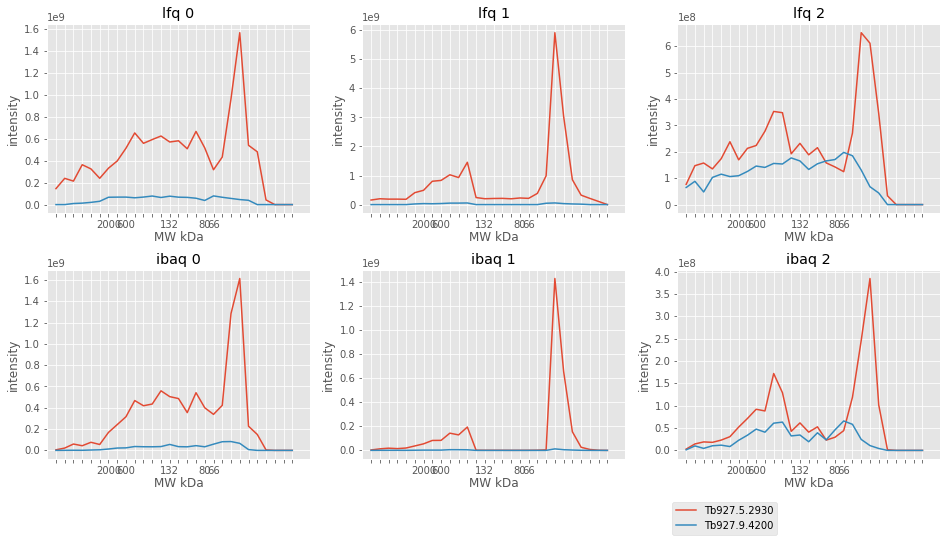

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.2930                  43               0   
Tb927.9.4200                  79               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.5.2930  Mitochondrial ATP synthase subunit, putative  
Tb927.9.4200                   fatty acyl CoA synthetase 2  
67 32 46 ['Tb927.5.2930', 'Tb927.9.4200']


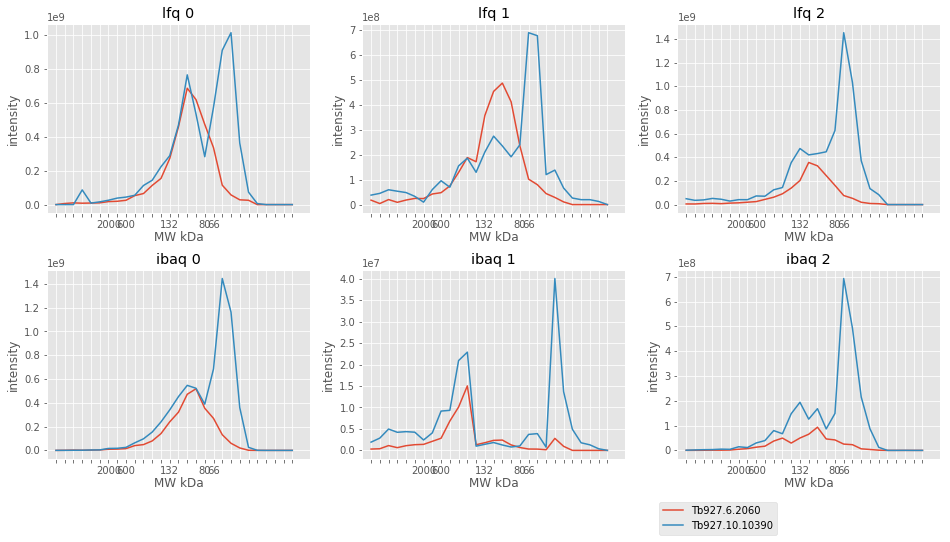

                [Molecular Weight]  [# TM Domains]     [Product Description]
[Input ID]                                                                  
Tb927.6.2060                    53               0  histidyl-tRNA synthetase
Tb927.10.10390                  53               0   trypanothione reductase
41 35 14 ['Tb927.6.2060', 'Tb927.10.10390']


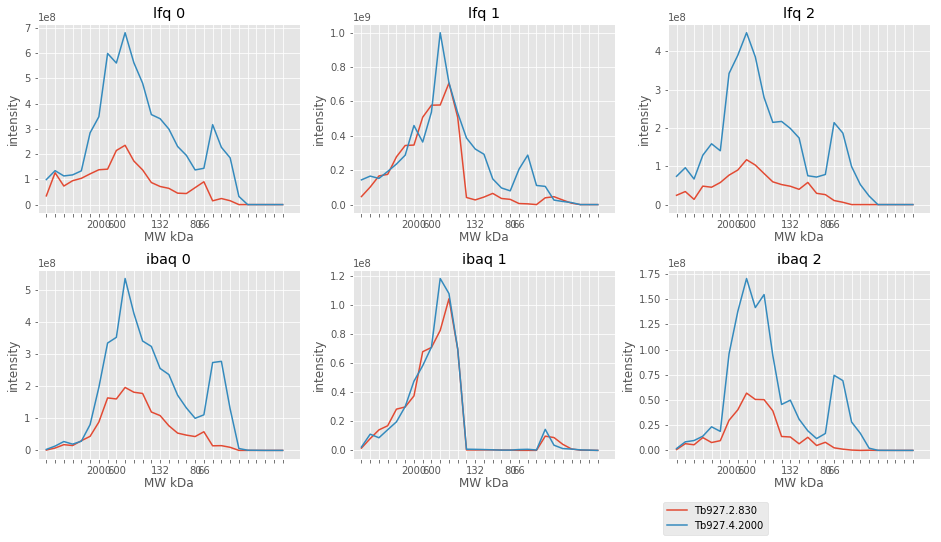

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.2.830                   40               0   
Tb927.4.2000                  52               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.2.830   retrotransposon hot spot protein 1 (RHS1), int...  
Tb927.4.2000                   ruvB-like DNA helicase, putative  
55 29 36 ['Tb927.2.830', 'Tb927.4.2000']


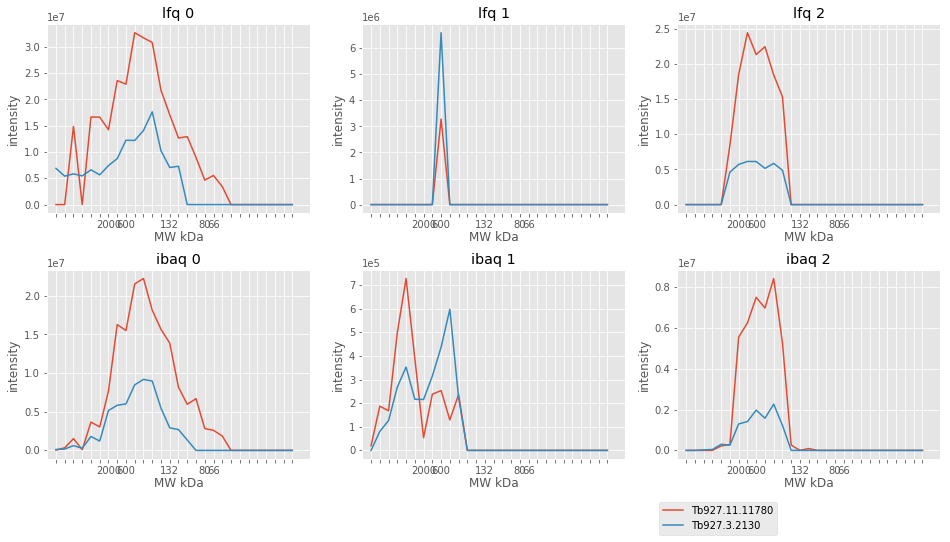

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11780                  66               0   
Tb927.3.2130                    81               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.11.11780        acyl-CoA dehydrogenase, putative  
Tb927.3.2130    RNA pseudouridylate synthase, putative  
55 8 37 ['Tb927.11.11780', 'Tb927.3.2130']


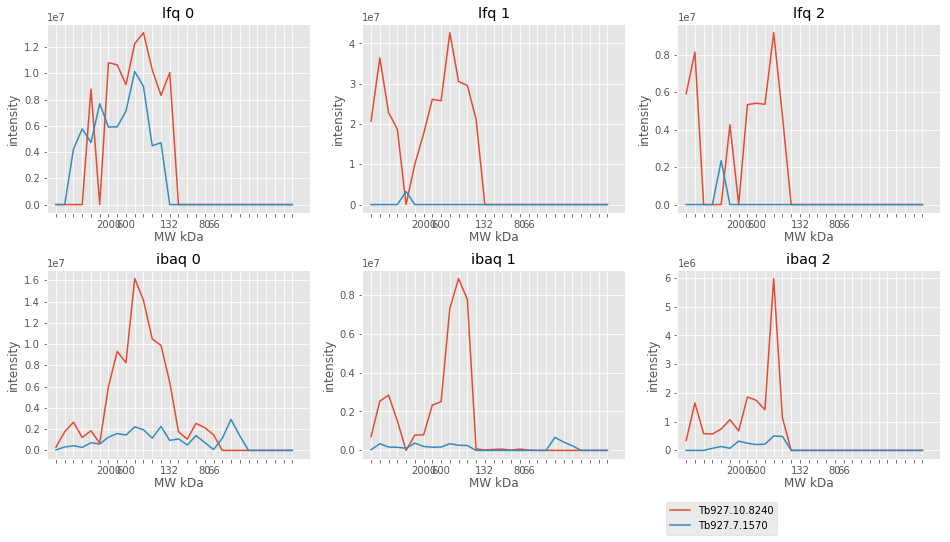

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.8240                  42               0   
Tb927.7.1570                  155               0   

                         [Product Description]  
[Input ID]                                      
Tb927.10.8240  hypothetical protein, conserved  
Tb927.7.1570   hypothetical protein, conserved  
55 17 48 ['Tb927.10.8240', 'Tb927.7.1570']


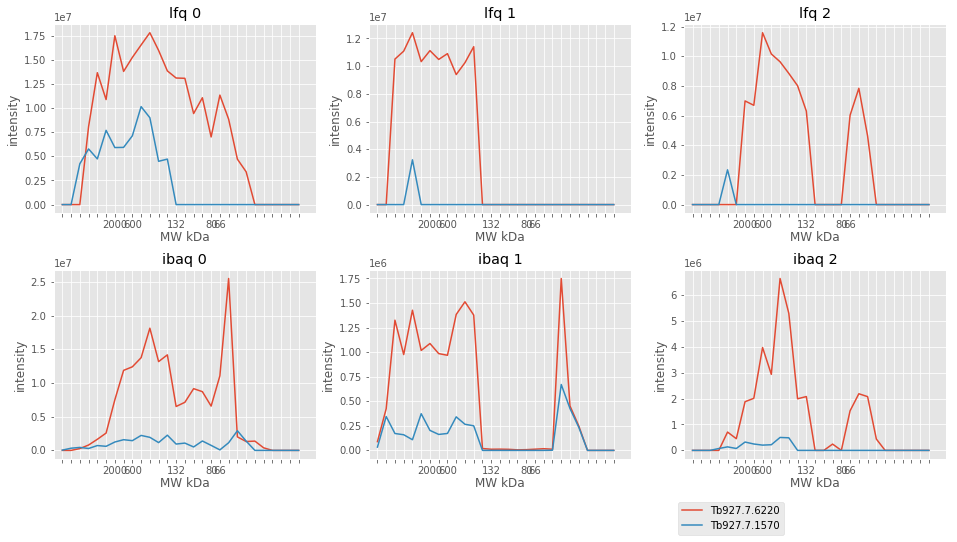

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.6220                  60               0   
Tb927.7.1570                 155               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.6220  calcium/calmodulin-dependent protein kinase, p...  
Tb927.7.1570                    hypothetical protein, conserved  
55 30 48 ['Tb927.7.6220', 'Tb927.7.1570']


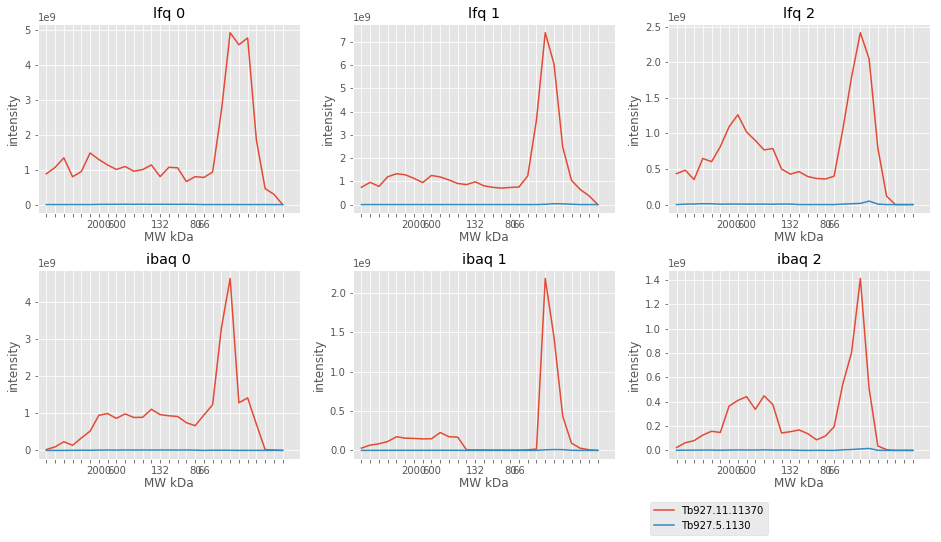

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11370                  34               0   
Tb927.5.1130                    34               3   

                            [Product Description]  
[Input ID]                                         
Tb927.11.11370  receptor for activated C kinase 1  
Tb927.5.1130      hypothetical protein, conserved  
70 28 38 ['Tb927.11.11370', 'Tb927.5.1130']


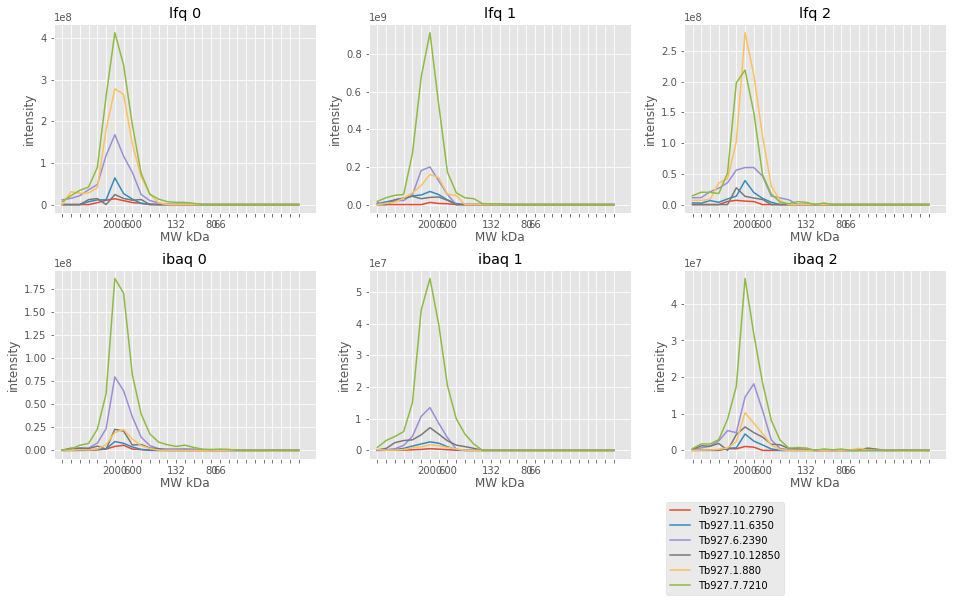

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.2790                  115               0   
Tb927.11.6350                  141               0   
Tb927.6.2390                    63               0   
Tb927.10.12850                  41               0   
Tb927.1.880                    512               0   
Tb927.7.7210                    77               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.2790         Conserved oligomeric complex COG6, putative  
Tb927.11.6350                                AAA ATPase, putative  
Tb927.6.2390             conserved hypothetical protein, putative  
Tb927.10.12850                              ttaggg binding factor  
Tb927.1.880                                     Midasin, putative  
Tb927.7.7210    Present in the outer mitochondrial membrane pr...  
16 41 17 ['Tb927.10.279

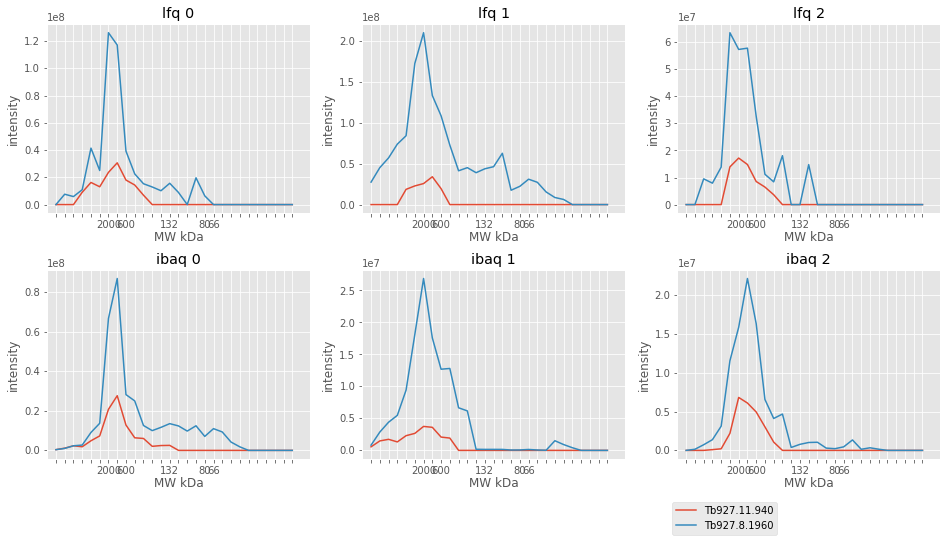

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.11.940                  43               0   
Tb927.8.1960                  48               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.11.940                                     KREPB5  
Tb927.8.1960  CCR4-NOT transcription complex subunit 11  
16 41 40 ['Tb927.11.940', 'Tb927.8.1960']


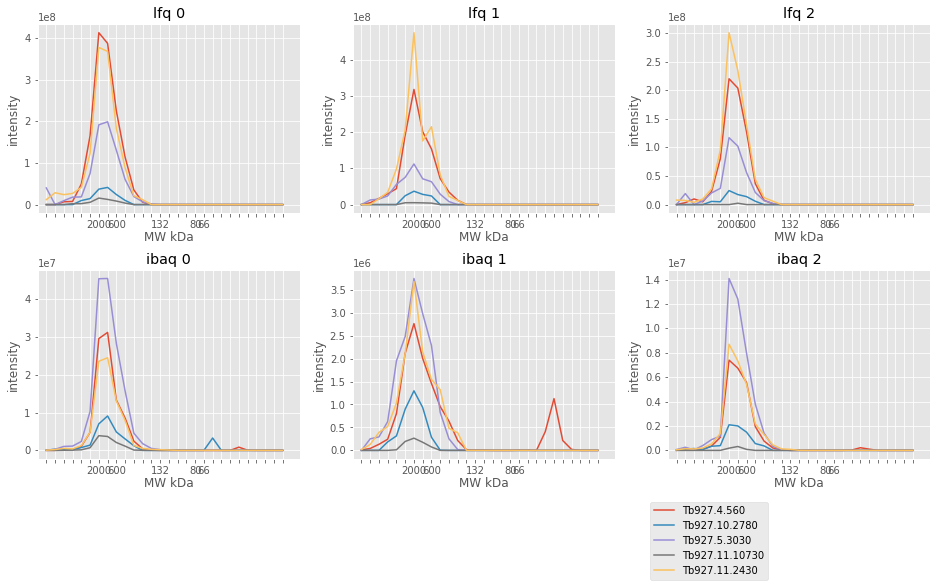

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.4.560                    479               0   
Tb927.10.2780                  170               0   
Tb927.5.3030                   140               0   
Tb927.11.10730                 139               0   
Tb927.11.2430                  484               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.4.560     Cytoplasmic dynein 2 heavy chain (DYNC2H1), pu...  
Tb927.10.2780          DNA-directed RNA polymerase III subunit C1  
Tb927.5.3030                 Intraflagellar transport protein 121  
Tb927.11.10730                 SWI/SNF-related helicase, putative  
Tb927.11.2430   Cytoplasmic dynein 2 heavy chain (DYNC2H2), pu...  
16 41 41 ['Tb927.4.560', 'Tb927.10.2780', 'Tb927.5.3030', 'Tb927.11.10730', 'Tb927.11.2430']


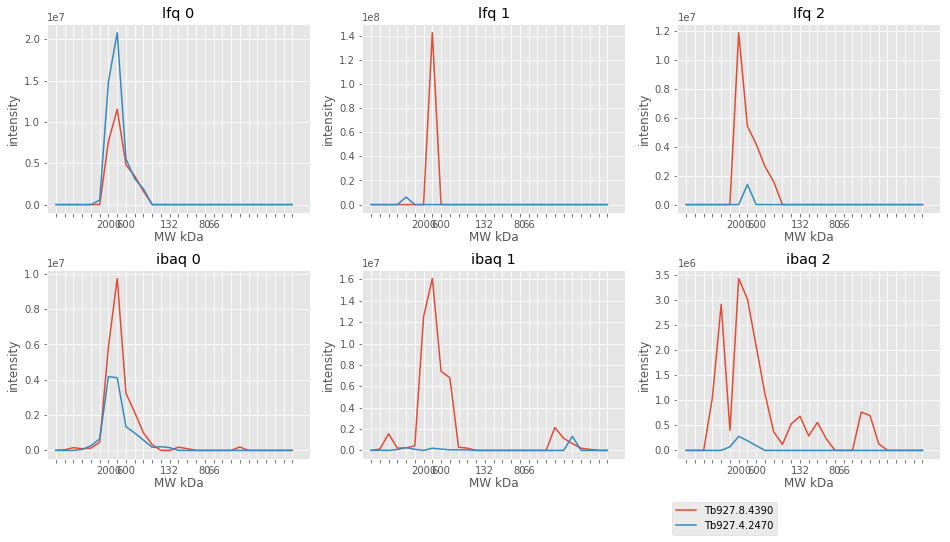

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.4390                  51               0   
Tb927.4.2470                 146               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.4390  translation initiation factor eIF-2B subunit b...  
Tb927.4.2470                    hypothetical protein, conserved  
16 43 17 ['Tb927.8.4390', 'Tb927.4.2470']


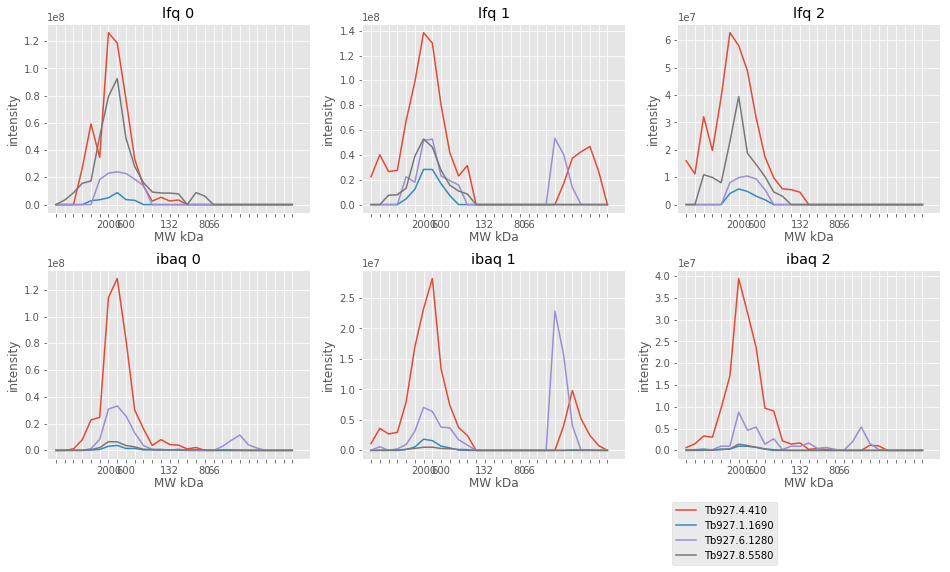

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.410                   35               0   
Tb927.1.1690                  89               0   
Tb927.6.1280                  33               0   
Tb927.8.5580                 526               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.4.410                                              CAF 40  
Tb927.1.1690                             RNA-editing nuclease 1  
Tb927.6.1280  translation initiation factor EIF-2b alpha sub...  
Tb927.8.5580  N-terminal region of Chorein, a TM vesicle-med...  
16 40 17 ['Tb927.4.410', 'Tb927.1.1690', 'Tb927.6.1280', 'Tb927.8.5580']


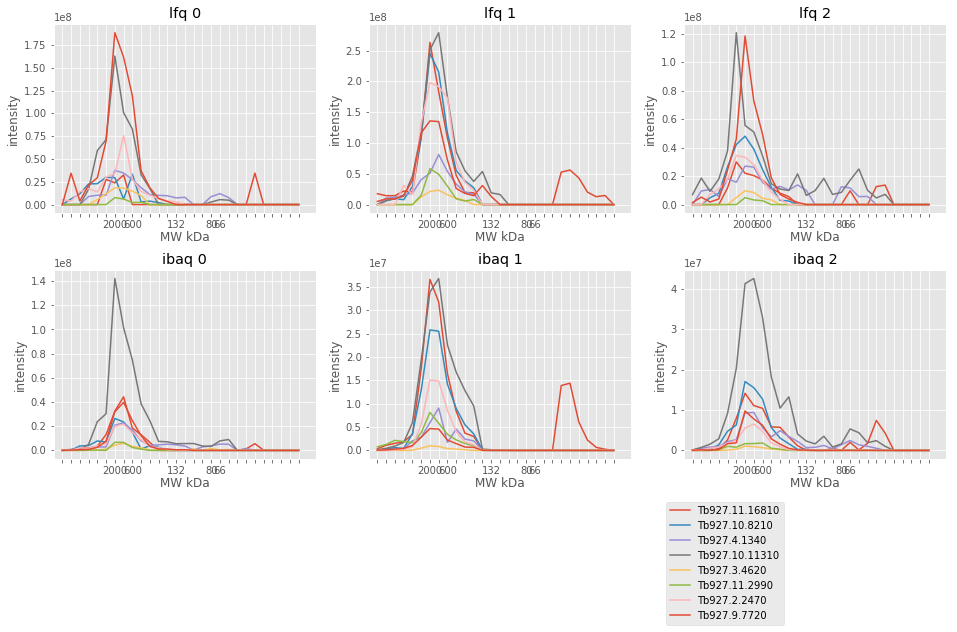

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.16810                  45               0   
Tb927.10.8210                   62               0   
Tb927.4.1340                    85               0   
Tb927.10.11310                  46               0   
Tb927.3.4620                   160               0   
Tb927.11.2990                   46               0   
Tb927.2.2470                    81               0   
Tb927.9.7720                   152               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.16810   dynein light intermediate chain D1bLIC, putative  
Tb927.10.8210                                              KREPA2  
Tb927.4.1340    cleavage and polyadenylation specificity facto...  
Tb927.10.11310             intraflagellar transport protein 57/55  
Tb927.3.4620              AAA domain containing pro

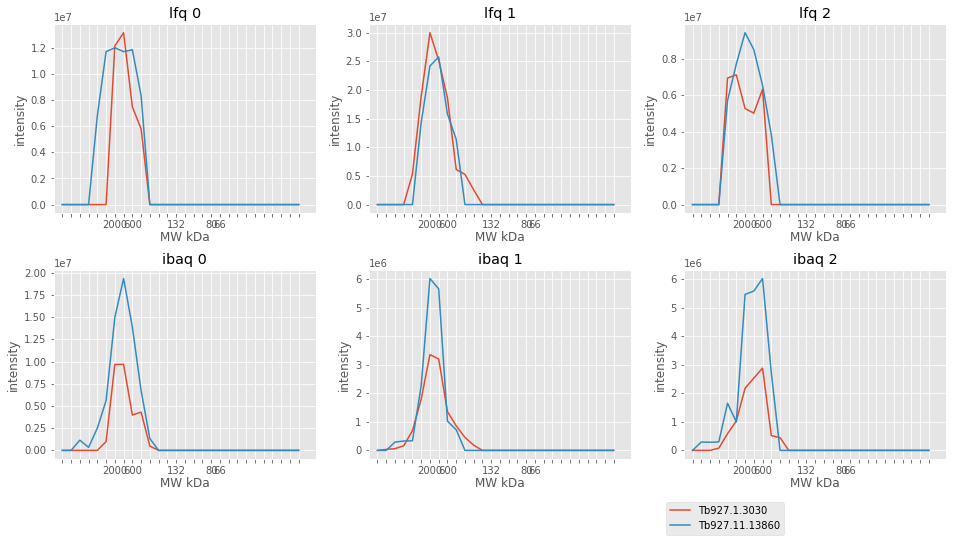

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.3030                    47               0   
Tb927.11.13860                  29               0   

                          [Product Description]  
[Input ID]                                       
Tb927.1.3030                              KREL2  
Tb927.11.13860  hypothetical protein, conserved  
16 40 42 ['Tb927.1.3030', 'Tb927.11.13860']


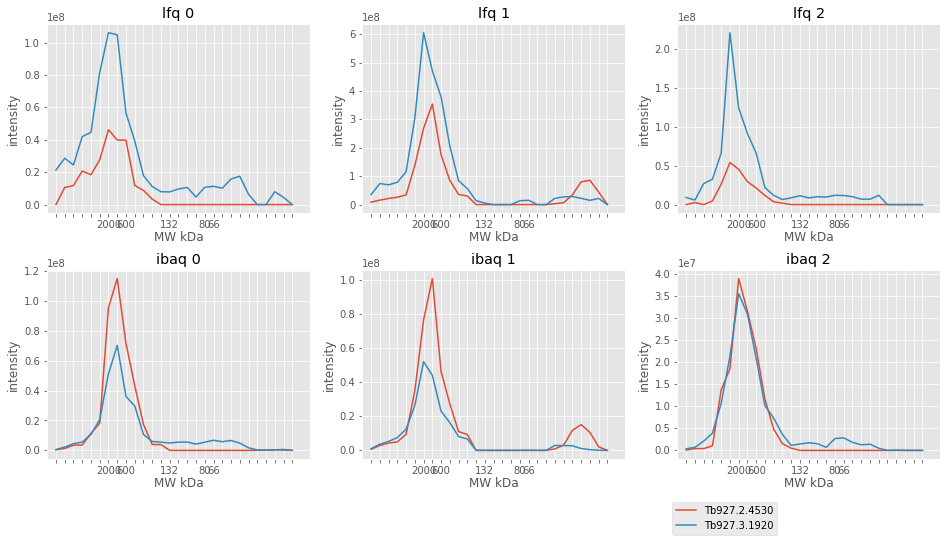

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.2.4530                  25               0   
Tb927.3.1920                  66               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.2.4530                    hypothetical protein, conserved  
Tb927.3.1920  General negative regulator of transcription su...  
16 40 16 ['Tb927.2.4530', 'Tb927.3.1920']


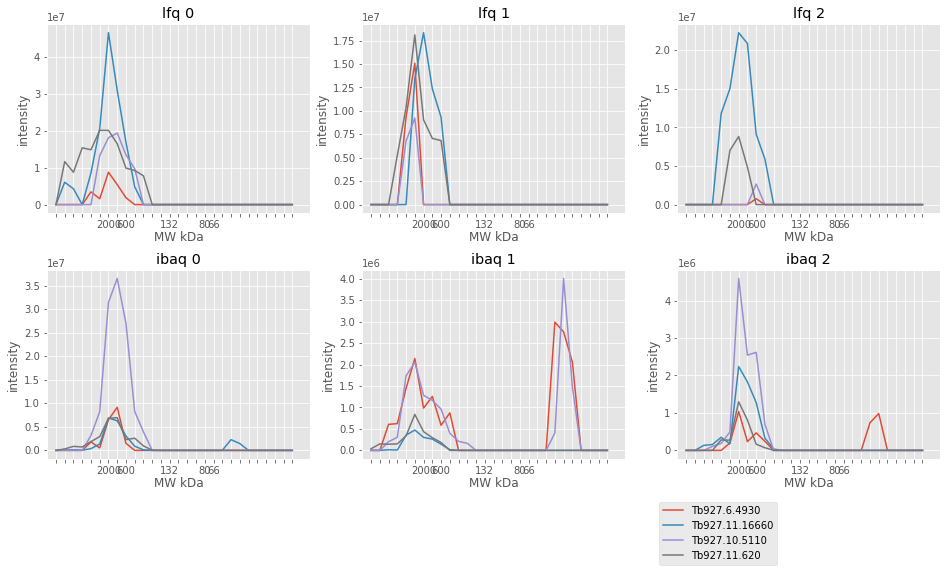

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.4930                    27               0   
Tb927.6.4930                    30               0   
Tb927.11.16660                 234               0   
Tb927.10.5110                   23               0   
Tb927.11.620                   143               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.6.4930    thiosulfate sulfurtransferase, mitochondrial, ...  
Tb927.6.4930    thiosulfate sulfurtransferase, mitochondrial, ...  
Tb927.11.16660                        Dopey, N-terminal, putative  
Tb927.10.5110                                              KREPA4  
Tb927.11.620                Regulatory-associated protein of TOR1  
16 2 17 ['Tb927.6.4930', 'Tb927.11.16660', 'Tb927.10.5110', 'Tb927.11.620']


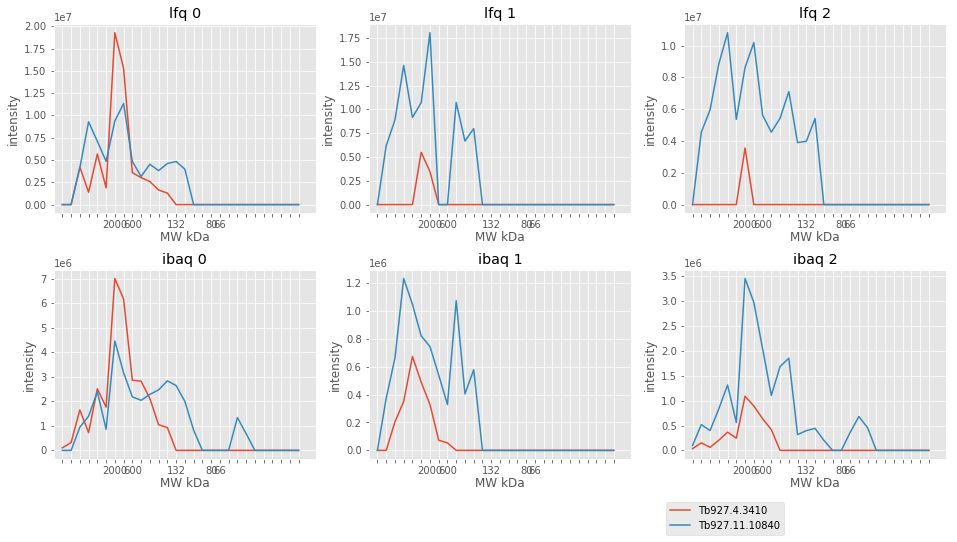

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.4.3410                    85               0   
Tb927.11.10840                  55               0   

                          [Product Description]  
[Input ID]                                       
Tb927.4.3410            selenoprotein, putative  
Tb927.11.10840  hypothetical protein, conserved  
16 9 40 ['Tb927.4.3410', 'Tb927.11.10840']


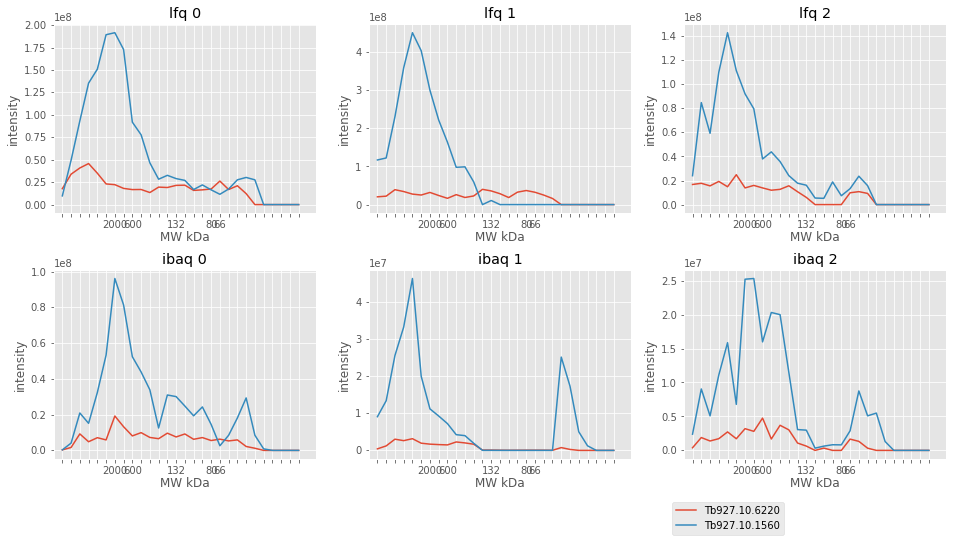

               [Molecular Weight]  [# TM Domains]    [Product Description]
[Input ID]                                                                
Tb927.10.6220                  90               0  5'-3' exoribonuclease D
Tb927.10.1560                  91               0     Nucleolar protein 91
16 12 33 ['Tb927.10.6220', 'Tb927.10.1560']


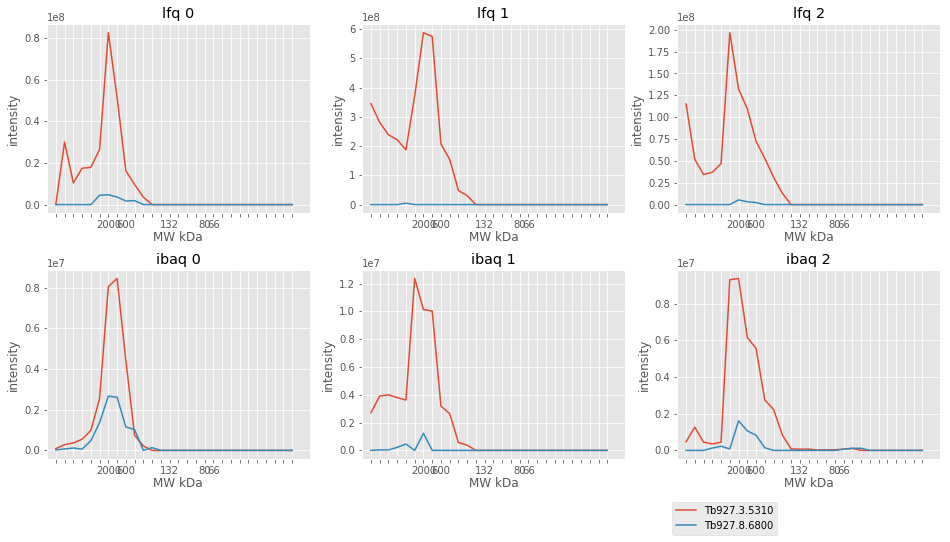

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.5310                 242               0   
Tb927.8.6800                  57               0   

                        [Product Description]  
[Input ID]                                     
Tb927.3.5310        paraflagellar rod protein  
Tb927.8.6800  hypothetical protein, conserved  
16 39 17 ['Tb927.3.5310', 'Tb927.8.6800']


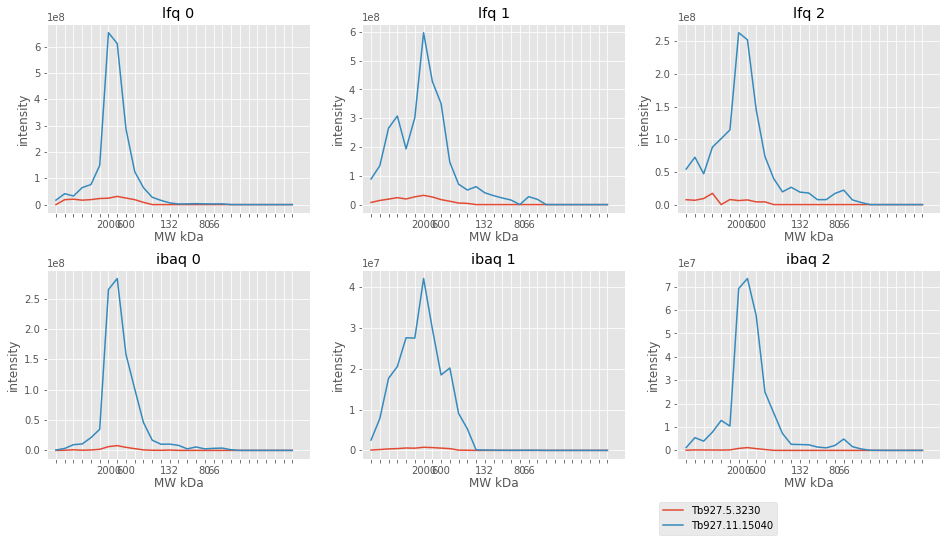

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.5.3230                   240               0   
Tb927.11.15040                  64               0   

                          [Product Description]  
[Input ID]                                       
Tb927.5.3230    hypothetical protein, conserved  
Tb927.11.15040  Chaperonin HSP60, mitochondrial  
16 36 42 ['Tb927.5.3230', 'Tb927.11.15040']


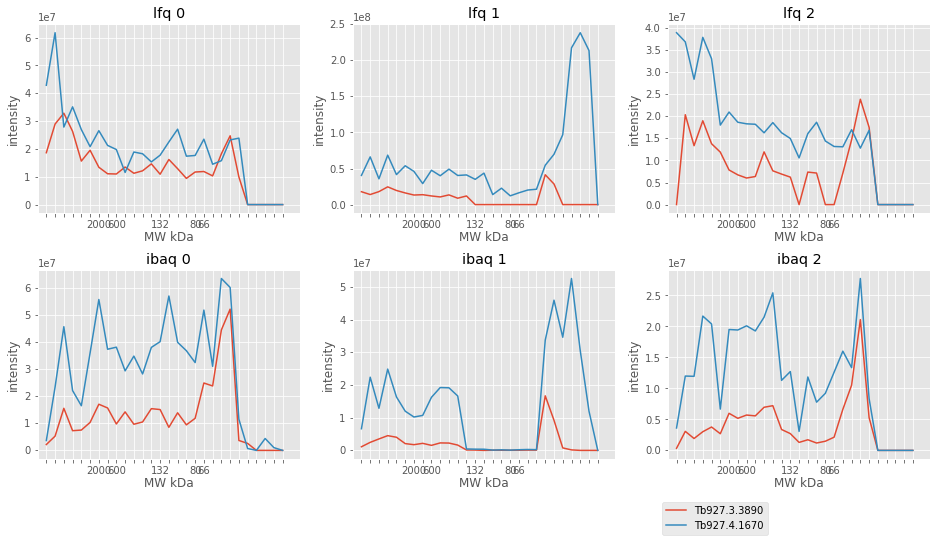

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.3890                  36               0   
Tb927.4.1670                  17               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.3.3890                    hypothetical protein, conserved  
Tb927.4.1670  cytochrome b5-like Heme/Steroid binding domain...  
16 11 51 ['Tb927.3.3890', 'Tb927.4.1670']


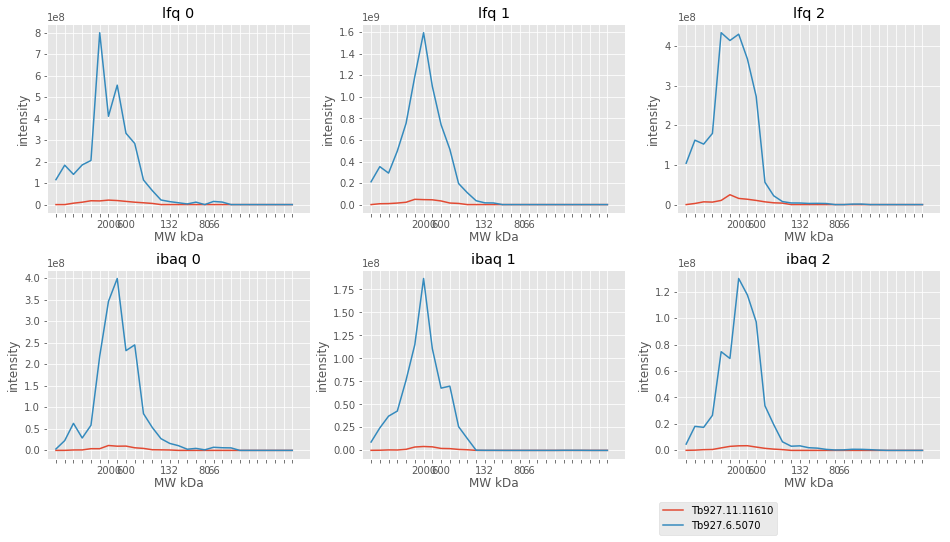

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11610                  64               0   
Tb927.6.5070                    51               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.11610  Cactus-binding C-terminus of cactin protein, p...  
Tb927.6.5070                      hypothetical protein, conserved  
23 41 16 ['Tb927.11.11610', 'Tb927.6.5070']


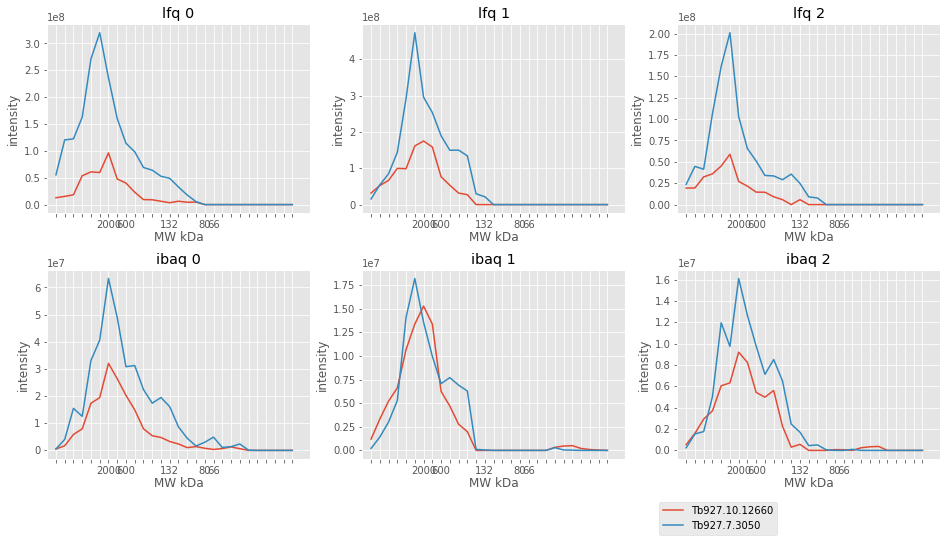

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.12660                  92               0   
Tb927.7.3050                   131               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.10.12660              pumilio/PUF RNA binding protein 2  
Tb927.7.3050    Mitochondrial SSU ribosomal protein, putative  
23 38 19 ['Tb927.10.12660', 'Tb927.7.3050']


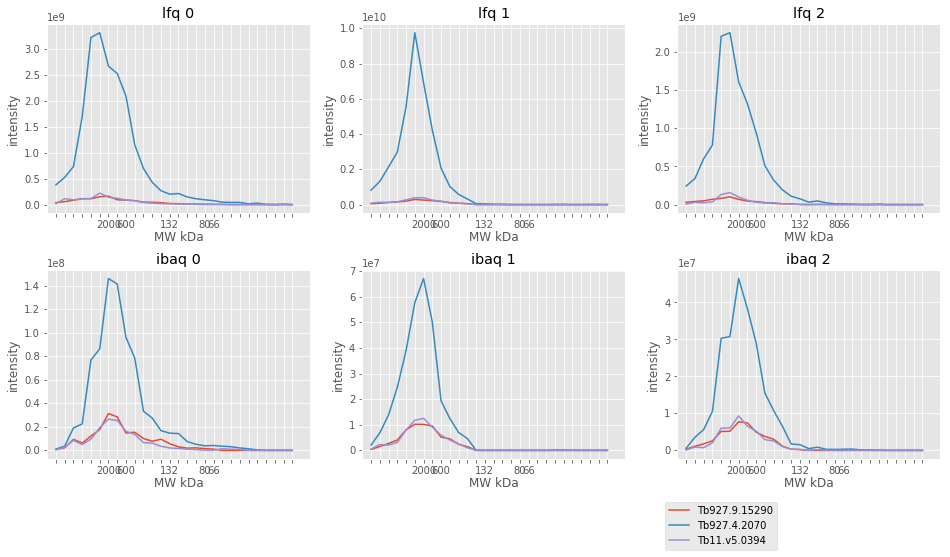

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.15290                 149               0   
Tb927.4.2070                  511               0   
Tb11.v5.0394                  183               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.9.15290  CHAT domain containing protein, putative  
Tb927.4.2070                antigenic protein, putative  
Tb11.v5.0394            hypothetical protein, conserved  
23 38 16 ['Tb927.9.15290', 'Tb927.4.2070', 'Tb11.v5.0394']


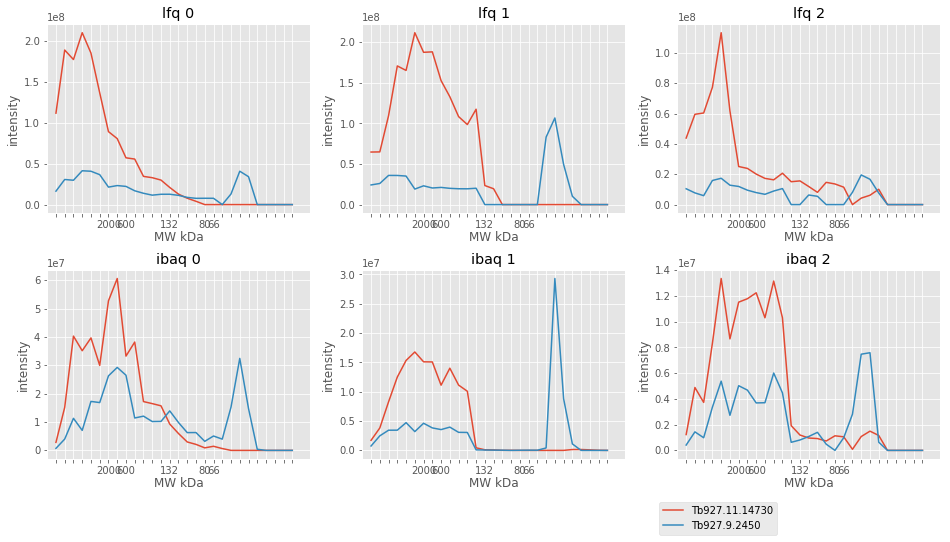

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.14730                  74               1   
Tb927.9.2450                    44               1   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.14730             Metalloprotease M41 FtsH, putative  
Tb927.9.2450    electon transport protein SCO1/SCO2, putative  
23 48 33 ['Tb927.11.14730', 'Tb927.9.2450']


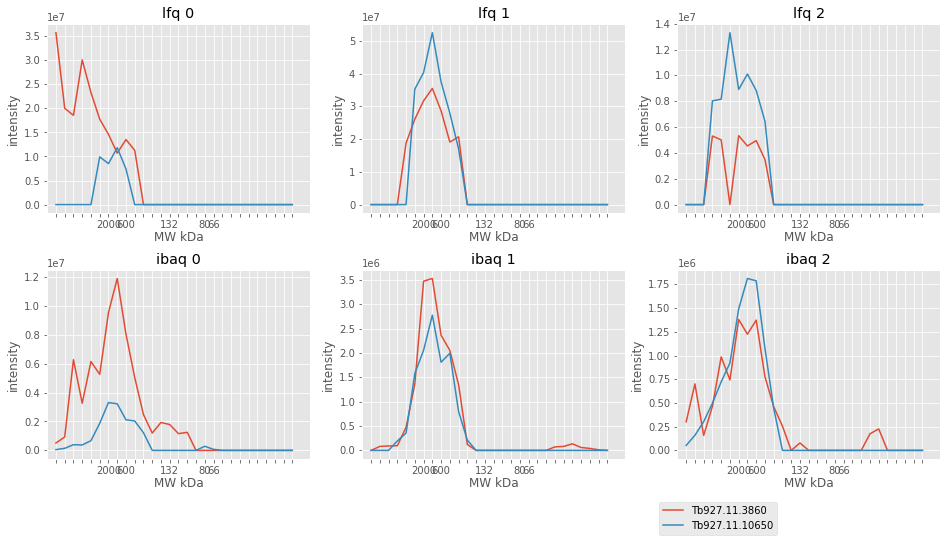

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.3860                   50               0   
Tb927.11.10650                 100               0   

                                      [Product Description]  
[Input ID]                                                   
Tb927.11.3860               hypothetical protein, conserved  
Tb927.11.10650  Adaptor protein complex AP-3 subunit beta-3  
23 44 39 ['Tb927.11.3860', 'Tb927.11.10650']


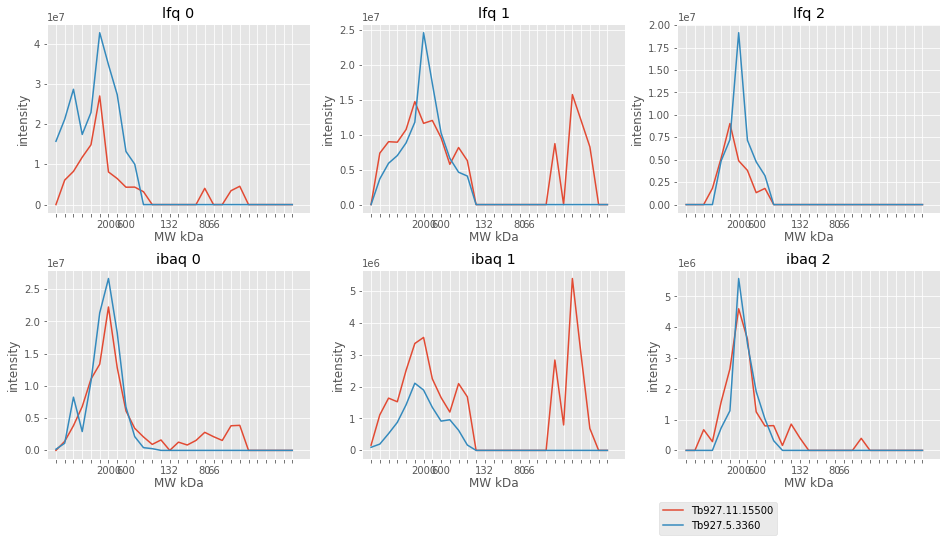

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.15500                  33               0   
Tb927.5.3360                    46               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.11.15500  LSU ribosomal protein, mitochondrial, putative  
Tb927.5.3360                mitochondrial ribosomal protein L2  
13 38 17 ['Tb927.11.15500', 'Tb927.5.3360']


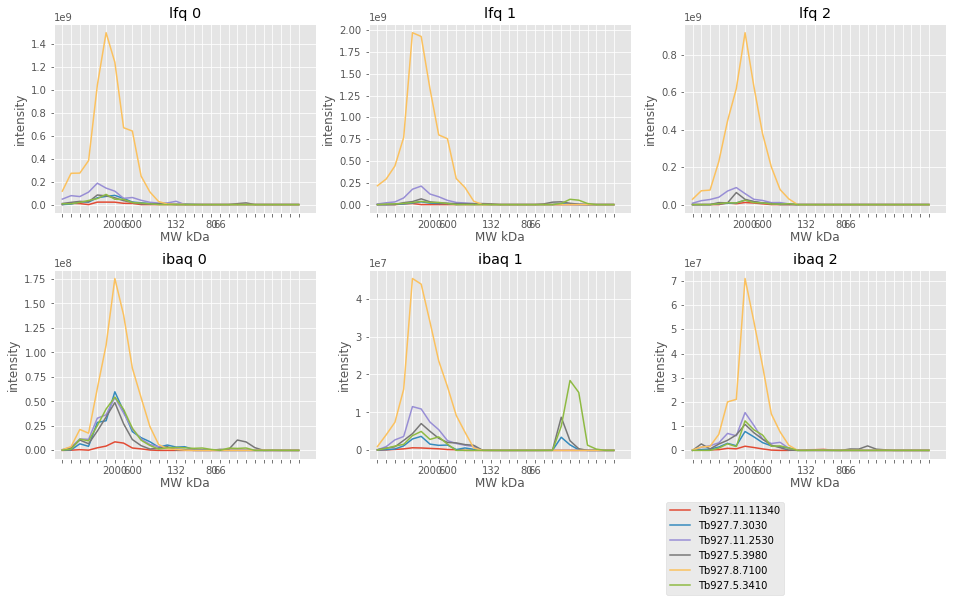

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11340                  87               0   
Tb927.7.3030                    35               0   
Tb927.11.2530                   84               0   
Tb927.5.3980                    43               0   
Tb927.8.7100                   242               0   
Tb927.5.3410                    30               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.11340              gamma-tubulin complex component 3  
Tb927.7.3030                  hypothetical protein, conserved  
Tb927.11.2530   Mitochondrial SSU ribosomal protein, putative  
Tb927.5.3980              mitochondrial ribosomal protein L15  
Tb927.8.7100                           acetyl-CoA carboxylase  
Tb927.5.3410               Mitochondrial ribosomal protein L9  
13 2 17 ['Tb927.11.11340', 'Tb927.7.3030', 'Tb927.11.25

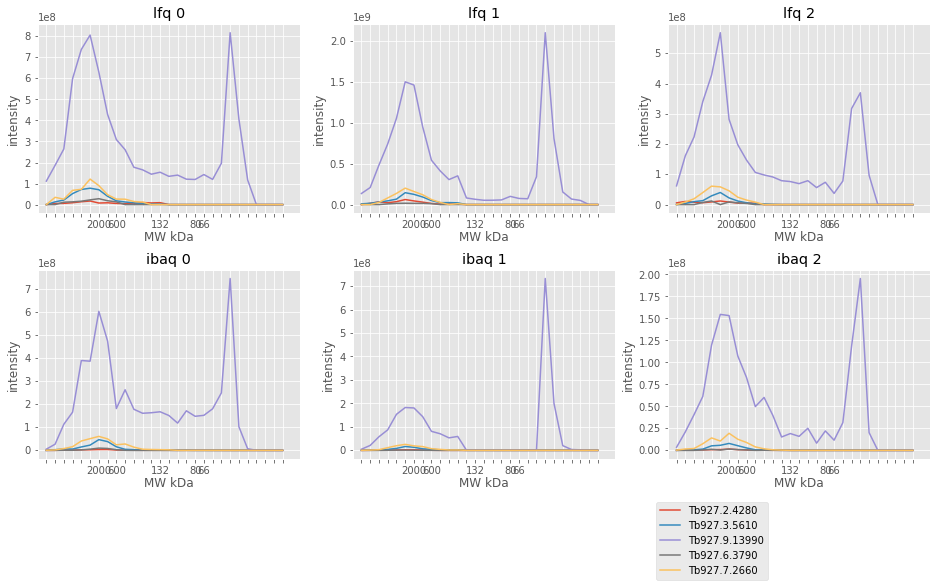

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.2.4280                  114               0   
Tb927.3.5610                   54               0   
Tb927.9.13990                  34               0   
Tb927.6.3790                   85               0   
Tb927.7.2660                   43               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.2.4280   kinetoplastid-specific dual specificity phosph...  
Tb927.3.5610                  Mitochondrial ribosomal protein L3  
Tb927.9.13990                      RNA-binding protein, putative  
Tb927.6.3790        valosin-containing protein homolog, putative  
Tb927.7.2660         zinc finger protein family member, putative  
13 2 21 ['Tb927.2.4280', 'Tb927.3.5610', 'Tb927.9.13990', 'Tb927.6.3790', 'Tb927.7.2660']


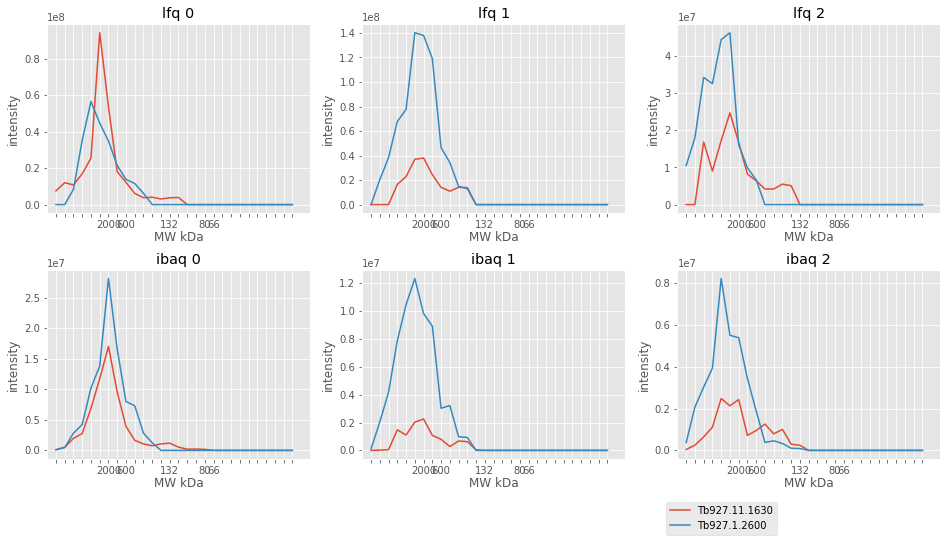

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.1630                  93               0   
Tb927.1.2600                   74               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.1630  LSU ribosomal protein, mitochondrial, putative  
Tb927.1.2600                pumilio/PUF RNA binding protein 9  
13 2 32 ['Tb927.11.1630', 'Tb927.1.2600']


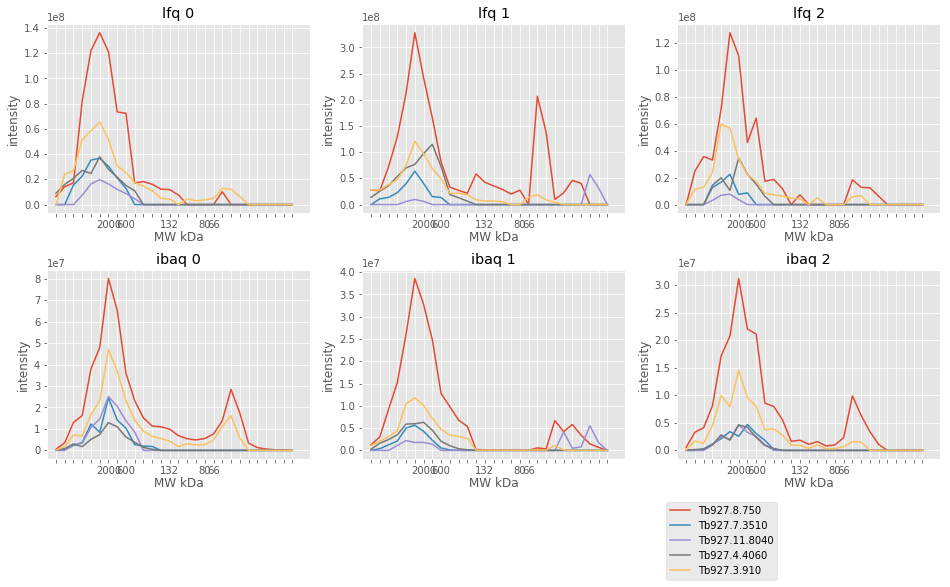

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.750                    39               0   
Tb927.7.3510                   56               0   
Tb927.11.8040                  22               0   
Tb927.4.4060                  104               0   
Tb927.3.910                    50               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.8.750           nucleolar RNA-binding protein, putative  
Tb927.7.3510   LSU ribosomal protein, mitochondrial, putative  
Tb927.11.8040  LSU ribosomal protein, mitochondrial, putative  
Tb927.4.4060                  hypothetical protein, conserved  
Tb927.3.910                               tubulin gamma chain  
13 2 16 ['Tb927.8.750', 'Tb927.7.3510', 'Tb927.11.8040', 'Tb927.4.4060', 'Tb927.3.910']


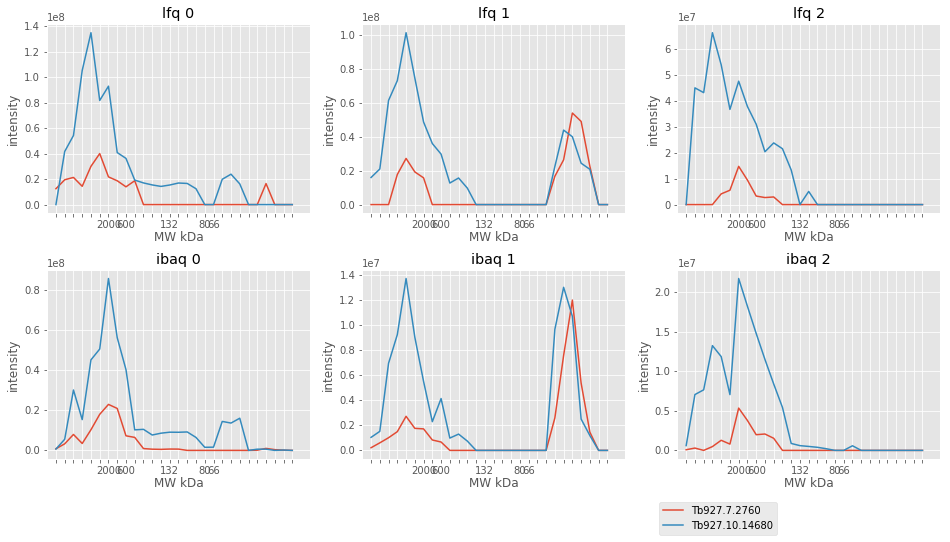

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.2760                    31               0   
Tb927.10.14680                  35               0   

                                [Product Description]  
[Input ID]                                             
Tb927.7.2760      Mitochondrial ribosomal protein L22  
Tb927.10.14680  ribosome biogenesis protein, putative  
13 9 40 ['Tb927.7.2760', 'Tb927.10.14680']


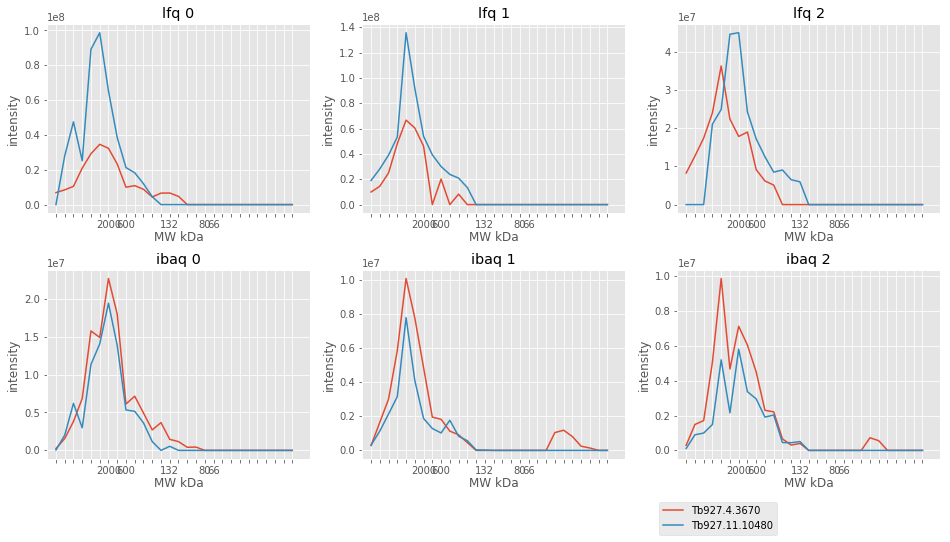

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.4.3670                    51               0   
Tb927.11.10480                 106               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.4.3670                           CBF/Mak21 family, putative  
Tb927.11.10480  PQQ-like domain/WD domain, G-beta repeat/Utp21...  
13 9 20 ['Tb927.4.3670', 'Tb927.11.10480']


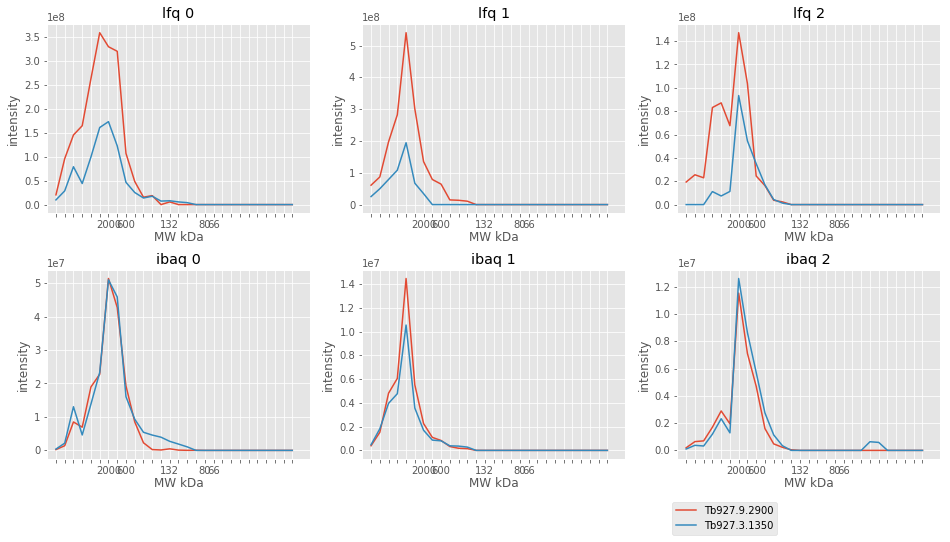

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.2900                 287               0   
Tb927.3.1350                  86               0   

                        [Product Description]  
[Input ID]                                     
Tb927.9.2900            Nucleolar protein 287  
Tb927.3.1350  hypothetical protein, conserved  
13 8 17 ['Tb927.9.2900', 'Tb927.3.1350']


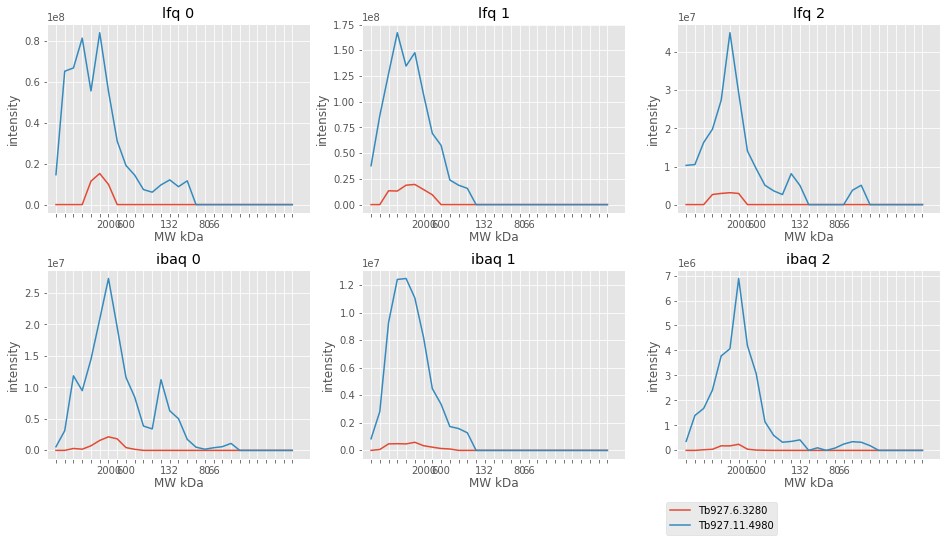

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.6.3280                  202               0   
Tb927.11.4980                  65               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.6.3280                 cyclosome subunit 1, putative  
Tb927.11.4980  ATP-dependent DEAD/H RNA helicase, putative  
13 7 21 ['Tb927.6.3280', 'Tb927.11.4980']


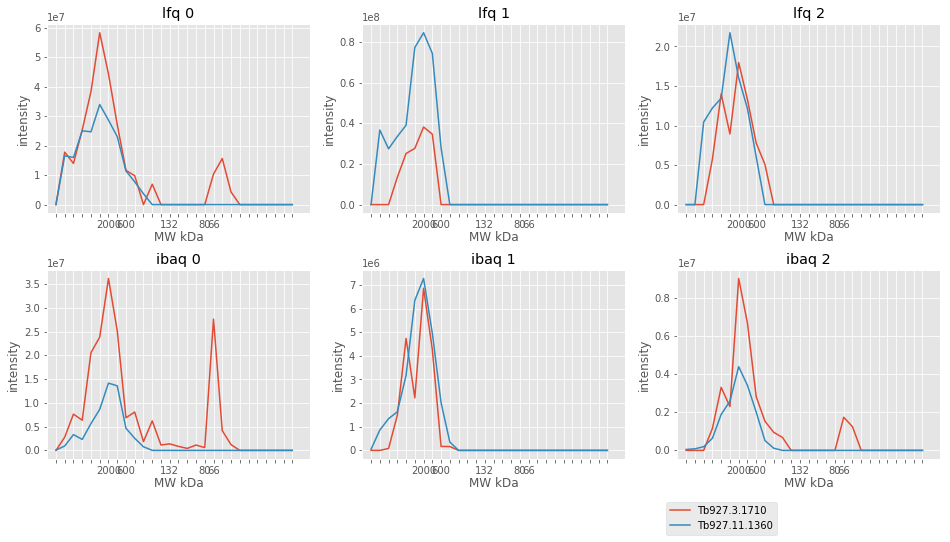

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.1710                   43               0   
Tb927.11.1360                  62               0   

                              [Product Description]  
[Input ID]                                           
Tb927.3.1710    mitochondrial ribosomal protein l24  
Tb927.11.1360  zinc-finger of a C2HC-type, putative  
13 39 17 ['Tb927.3.1710', 'Tb927.11.1360']


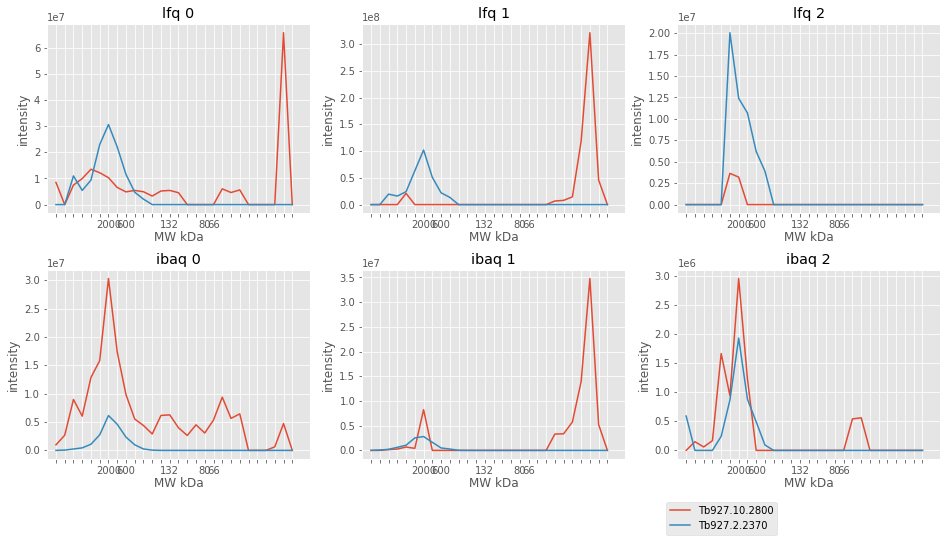

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.2800                  18               0   
Tb927.2.2370                  151               0   

                            [Product Description]  
[Input ID]                                         
Tb927.10.2800  mitochondrial ribosomal protein s6  
Tb927.2.2370                Vps51/Vps67, putative  
13 39 15 ['Tb927.10.2800', 'Tb927.2.2370']


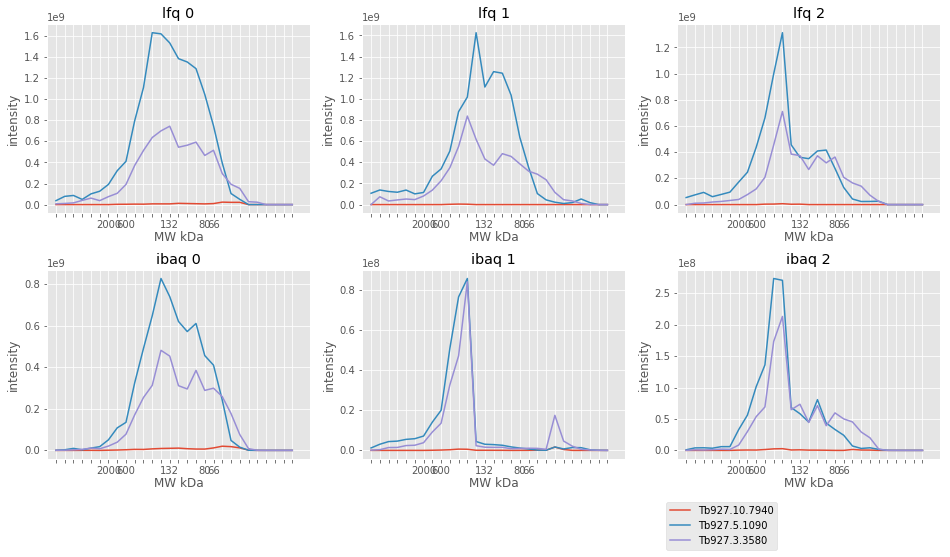

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.7940                  40               0   
Tb927.5.1090                   90               0   
Tb927.3.3580                   87               1   

                            [Product Description]  
[Input ID]                                         
Tb927.10.7940         methyltransferase, putative  
Tb927.5.1090   threonyl-tRNA synthetase, putative  
Tb927.3.3580      heat shock protein 90, putative  
66 35 57 ['Tb927.10.7940', 'Tb927.5.1090', 'Tb927.3.3580']


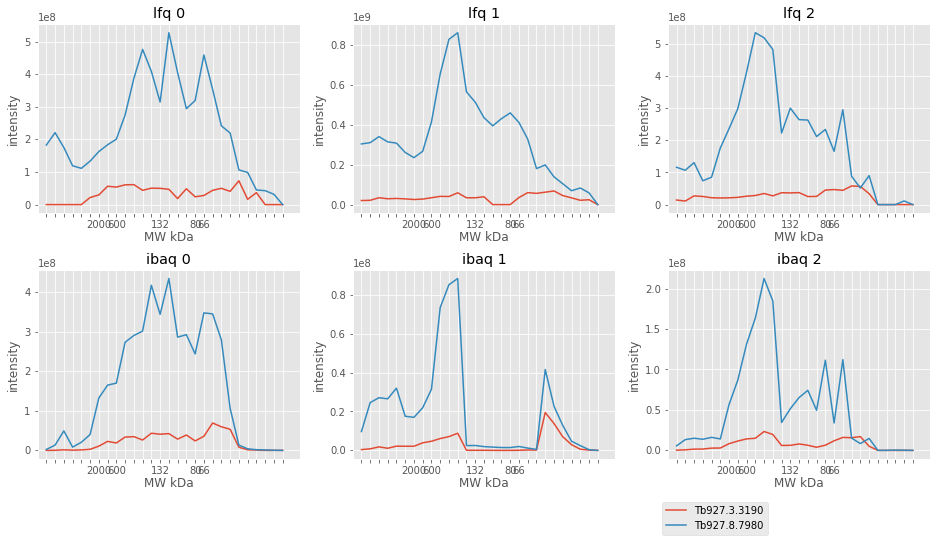

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.3190                  56               0   
Tb927.8.7980                  86              14   

                                          [Product Description]  
[Input ID]                                                       
Tb927.3.3190     Serine/threonine-protein kinase NEK7, putative  
Tb927.8.7980  Pyrophosphate-energized vacuolar membrane prot...  
66 31 48 ['Tb927.3.3190', 'Tb927.8.7980']


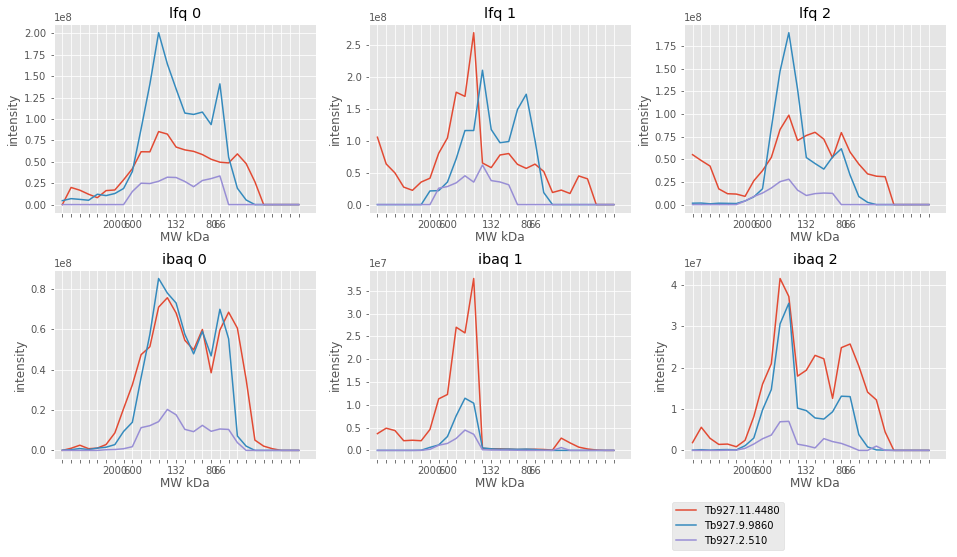

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.4480                  66               0   
Tb927.9.9860                   79               0   
Tb927.2.510                    95               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.4480                 Flagellar radial spoke protein 4/6  
Tb927.9.9860         170 kDa glucose-regulated protein, putative  
Tb927.2.510    retrotransposon hot spot protein 4 (RHS4), put...  
66 31 57 ['Tb927.11.4480', 'Tb927.9.9860', 'Tb927.2.510']


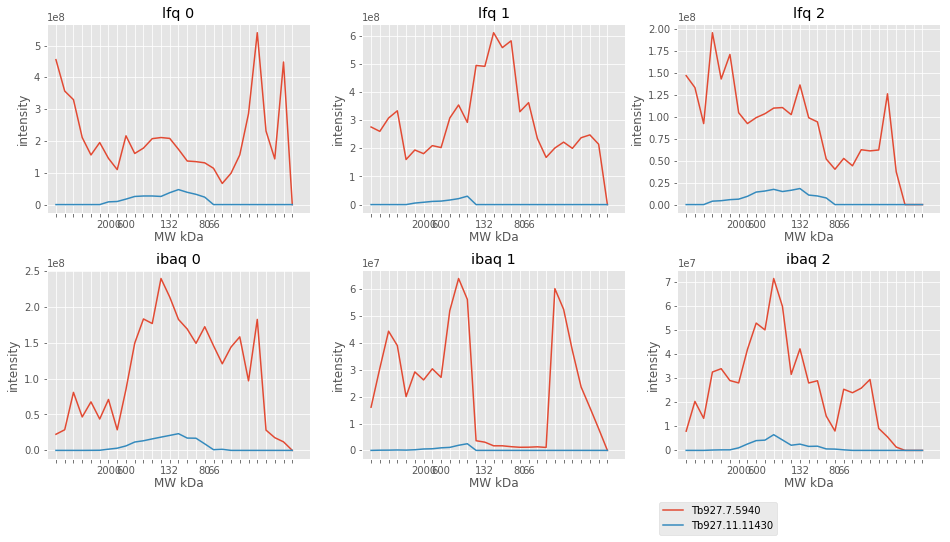

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.5940                    67              14   
Tb927.11.11430                  91               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.7.5940    Protein Associated with Differentiation  
Tb927.11.11430                       cullin 1, putative  
66 31 47 ['Tb927.7.5940', 'Tb927.11.11430']


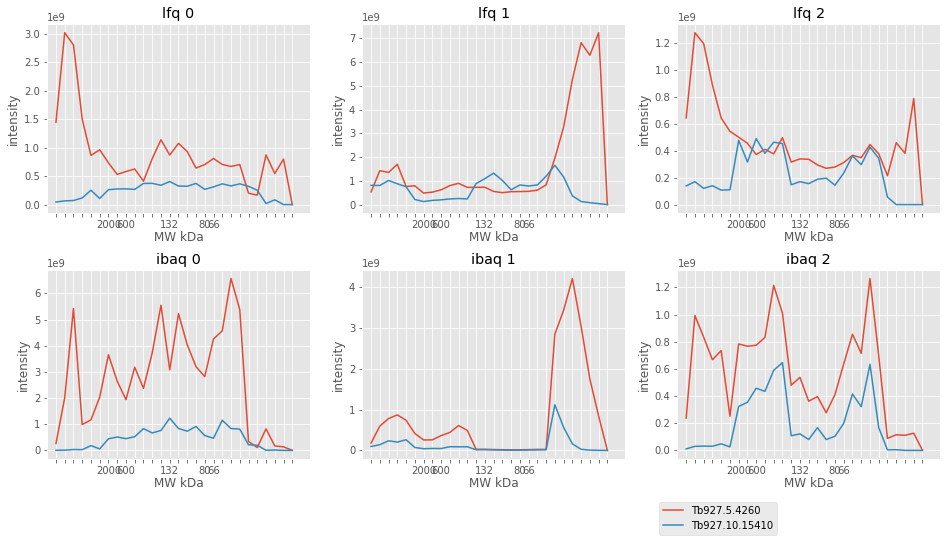

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.5.4260                    11               0   
Tb927.10.15410                  33               0   

                          [Product Description]  
[Input ID]                                       
Tb927.5.4260               histone H4, putative  
Tb927.10.15410  glycosomal malate dehydrogenase  
66 14 50 ['Tb927.5.4260', 'Tb927.10.15410']


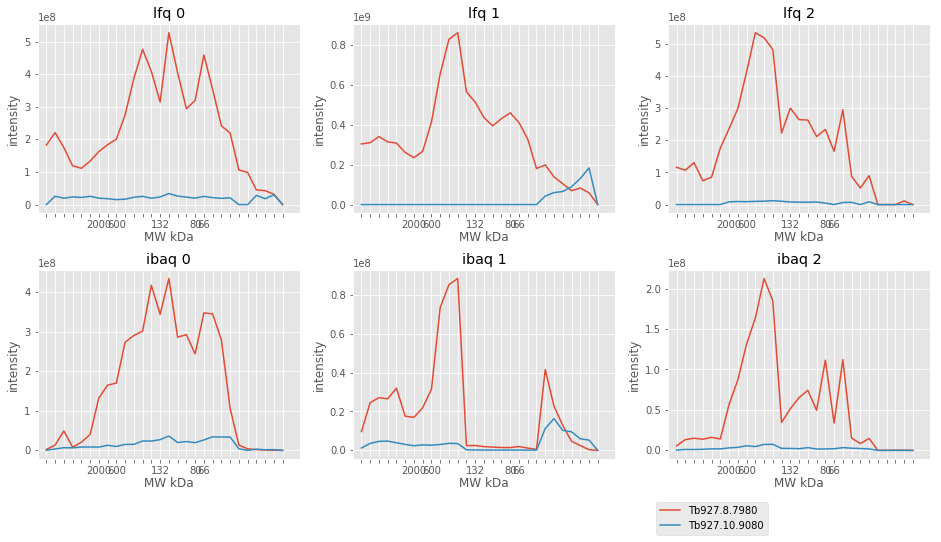

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.7980                   86              14   
Tb927.10.9080                  69              11   

                                           [Product Description]  
[Input ID]                                                        
Tb927.8.7980   Pyrophosphate-energized vacuolar membrane prot...  
Tb927.10.9080                    pteridine transporter, putative  
66 13 48 ['Tb927.8.7980', 'Tb927.10.9080']


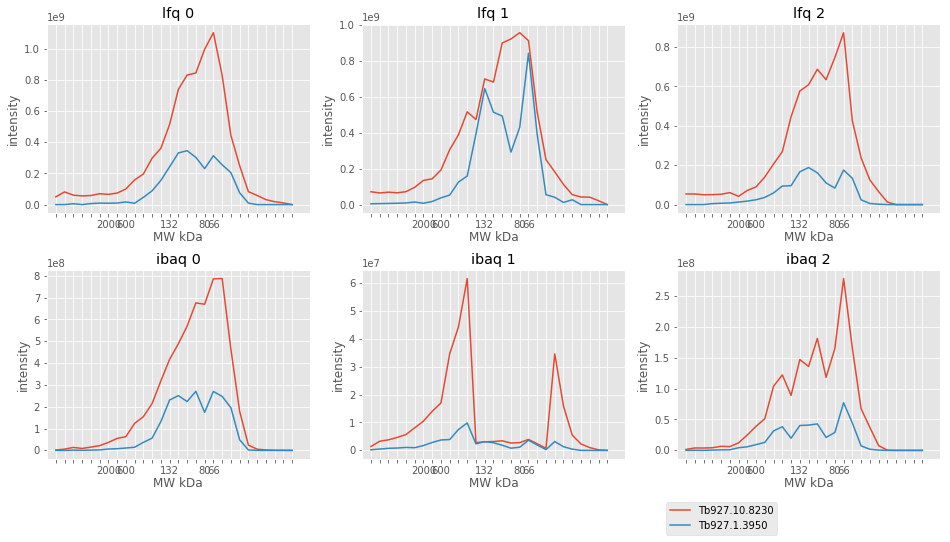

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.8230                  55               0   
Tb927.1.3950                   55               0   

                       [Product Description]  
[Input ID]                                    
Tb927.10.8230  protein disulfide isomerase 2  
Tb927.1.3950        alanine aminotransferase  
43 35 13 ['Tb927.10.8230', 'Tb927.1.3950']


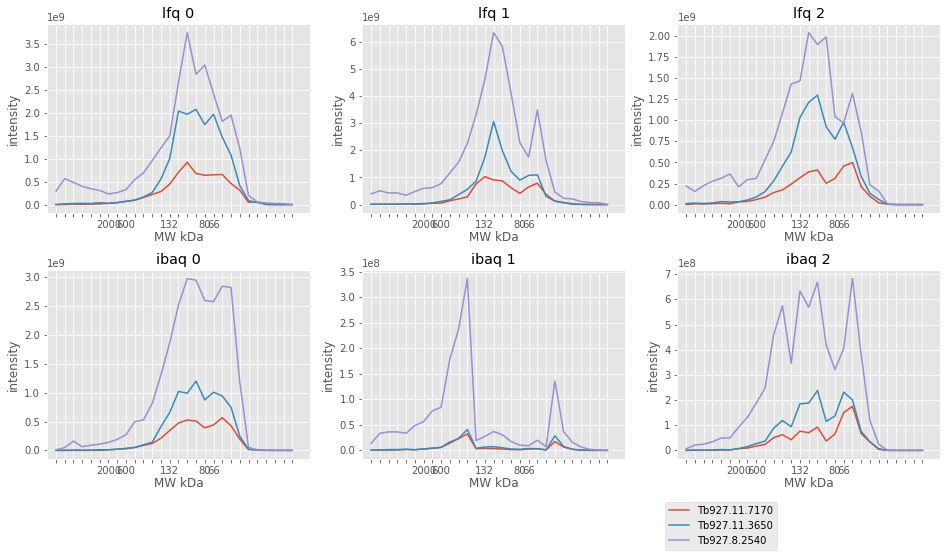

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.7170                  53               0   
Tb927.11.3650                  66               0   
Tb927.8.2540                   46               0   

                               [Product Description]  
[Input ID]                                            
Tb927.11.7170                  seryl-tRNA synthetase  
Tb927.11.3650  adenylosuccinate synthetase, putative  
Tb927.8.2540       3-ketoacyl-CoA thiolase, putative  
43 35 14 ['Tb927.11.7170', 'Tb927.11.3650', 'Tb927.8.2540']


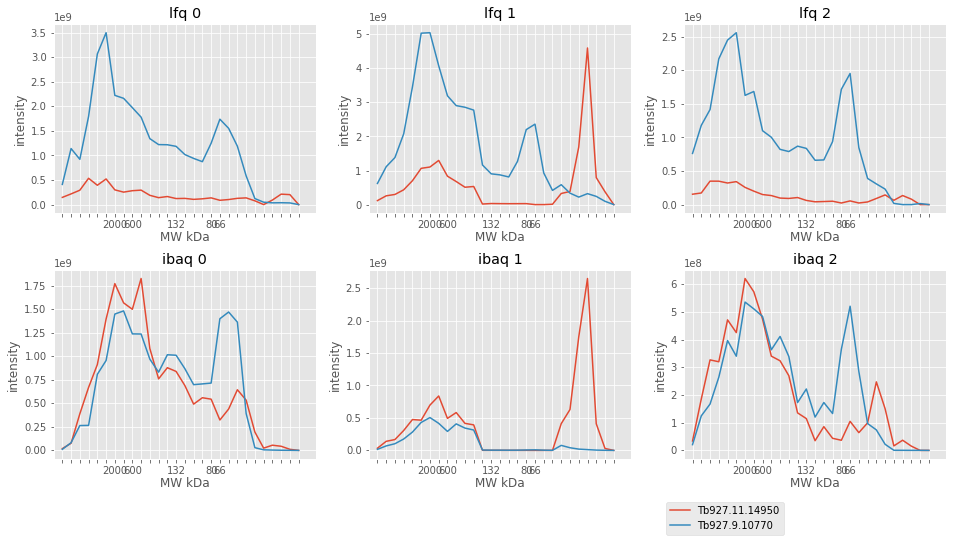

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.14950                  15               0   
Tb927.9.10770                   62               0   

                          [Product Description]  
[Input ID]                                       
Tb927.11.14950            zinc finger protein 2  
Tb927.9.10770   polyadenylate-binding protein 2  
25 42 19 ['Tb927.11.14950', 'Tb927.9.10770']


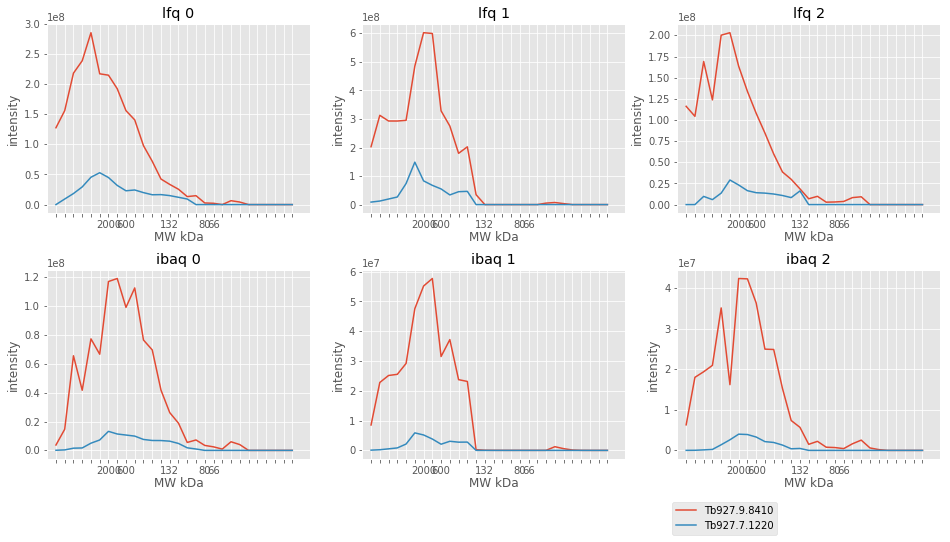

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.8410                  49               0   
Tb927.7.1220                 117               0   

                         [Product Description]  
[Input ID]                                      
Tb927.9.8410  chaperone protein DnaJ, putative  
Tb927.7.1220   hypothetical protein, conserved  
25 41 40 ['Tb927.9.8410', 'Tb927.7.1220']


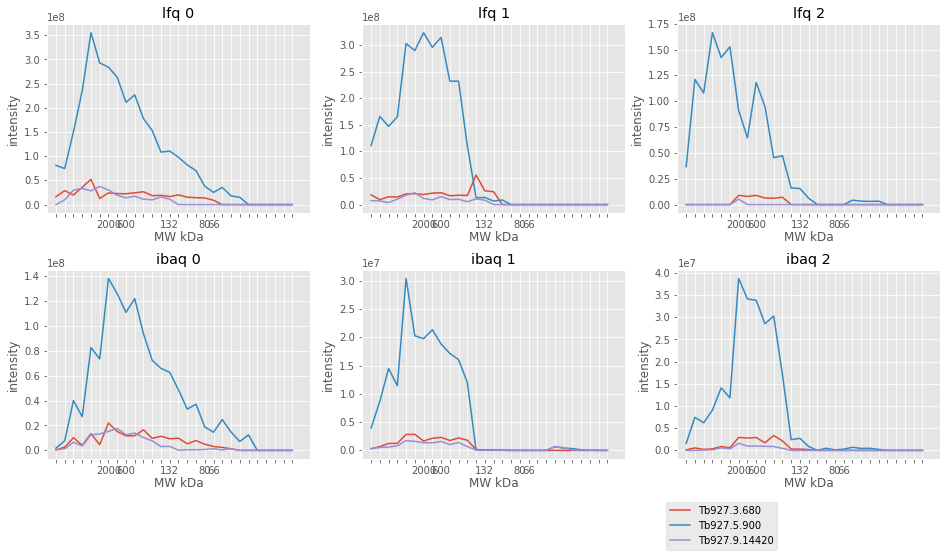

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.680                    66               2   
Tb927.5.900                    92              11   
Tb927.9.14420                  42               1   

                                           [Product Description]  
[Input ID]                                                        
Tb927.3.680                            cytochrome P450, putative  
Tb927.5.900         oligosaccharyl transferase subunit, putative  
Tb927.9.14420  Peptidyl-prolyl cis-trans isomerase C, mitocho...  
25 48 35 ['Tb927.3.680', 'Tb927.5.900', 'Tb927.9.14420']


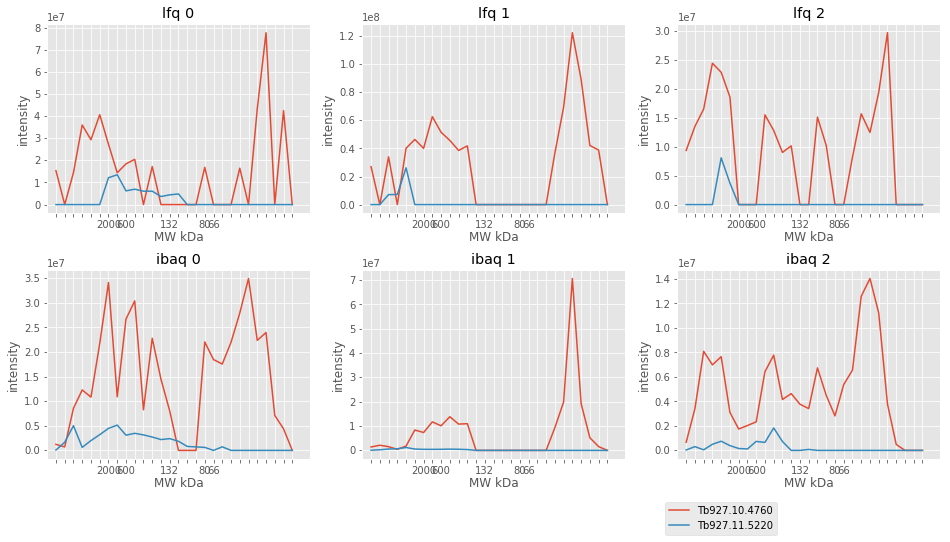

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.4760                  27               3   
Tb927.11.5220                  84               1   

                                    [Product Description]  
[Input ID]                                                 
Tb927.10.4760  Integral membrane protein DUF106, putative  
Tb927.11.5220            chaperone protein DnaJ, putative  
25 51 53 ['Tb927.10.4760', 'Tb927.11.5220']


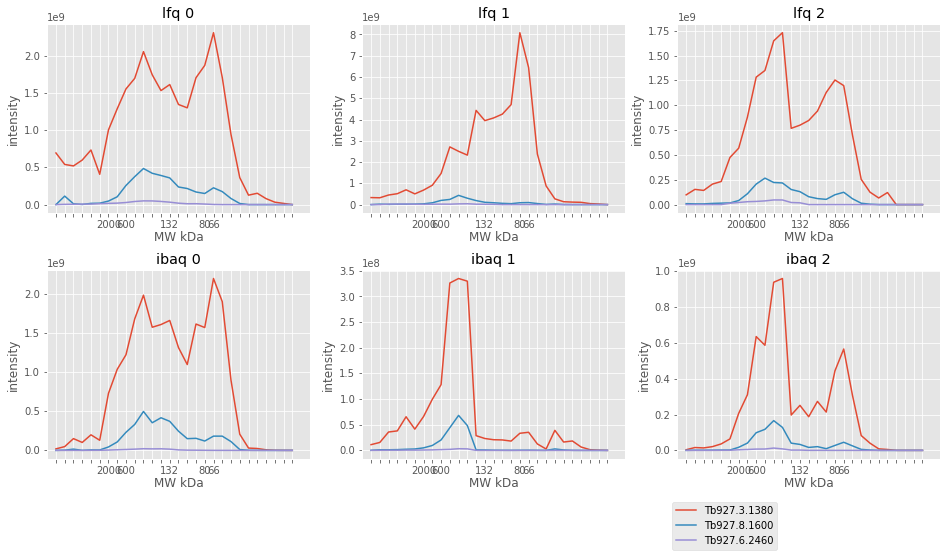

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.1380                  55               0   
Tb927.8.1600                  66               0   
Tb927.8.1600                  75               1   
Tb927.6.2460                 112               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.3.1380          ATP synthase subunit beta, mitochondrial  
Tb927.8.1600                   lysyl-tRNA synthetase, putative  
Tb927.8.1600                   lysyl-tRNA synthetase, putative  
Tb927.6.2460  ubiquitin fusion degradation protein 2, putative  
52 31 48 ['Tb927.3.1380', 'Tb927.8.1600', 'Tb927.6.2460']


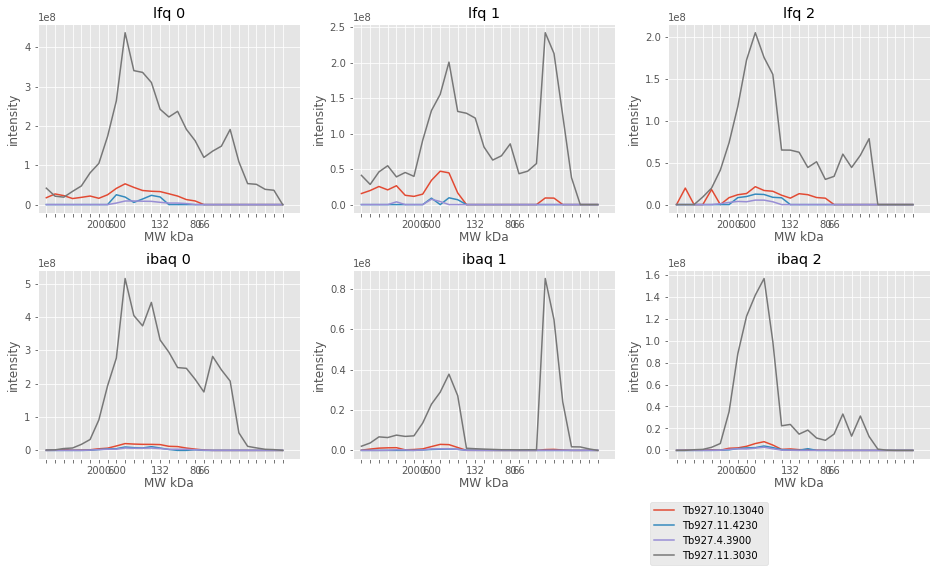

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.13040                 133               1   
Tb927.11.4230                  132               0   
Tb927.4.3900                    45               0   
Tb927.11.3030                   39               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.13040  procyclic-enriched flagellar receptor adenylat...  
Tb927.11.4230                     hypothetical protein, conserved  
Tb927.4.3900                      hypothetical protein, conserved  
Tb927.11.3030    phosphoribosylpyrophosphate synthetase, putative  
52 30 50 ['Tb927.10.13040', 'Tb927.11.4230', 'Tb927.4.3900', 'Tb927.11.3030']


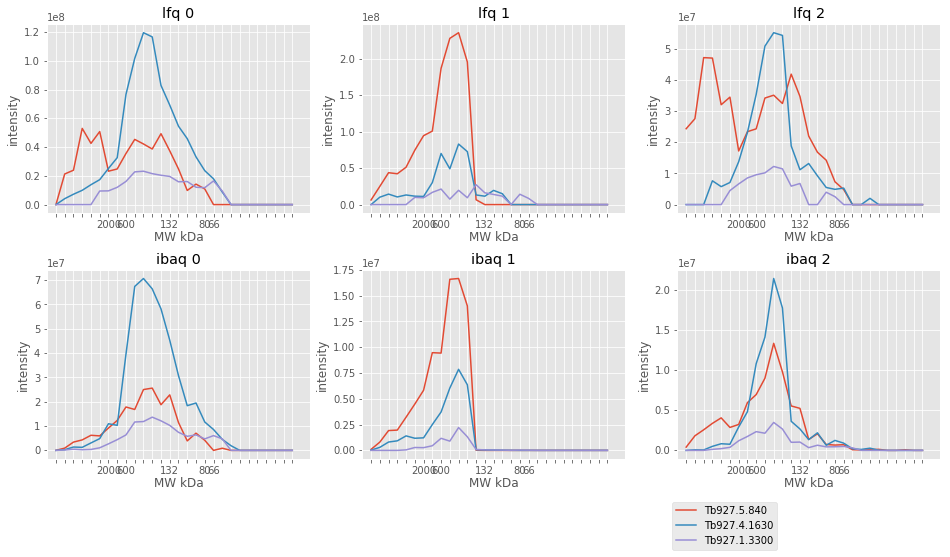

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.840                  111               0   
Tb927.4.1630                  78               0   
Tb927.1.3300                  97               0   

                               [Product Description]  
[Input ID]                                            
Tb927.5.840                    Nucleolar protein 111  
Tb927.4.1630      ribosomal RNA processing protein 6  
Tb927.1.3300  Myotubularin-related protein, putative  
52 30 48 ['Tb927.5.840', 'Tb927.4.1630', 'Tb927.1.3300']


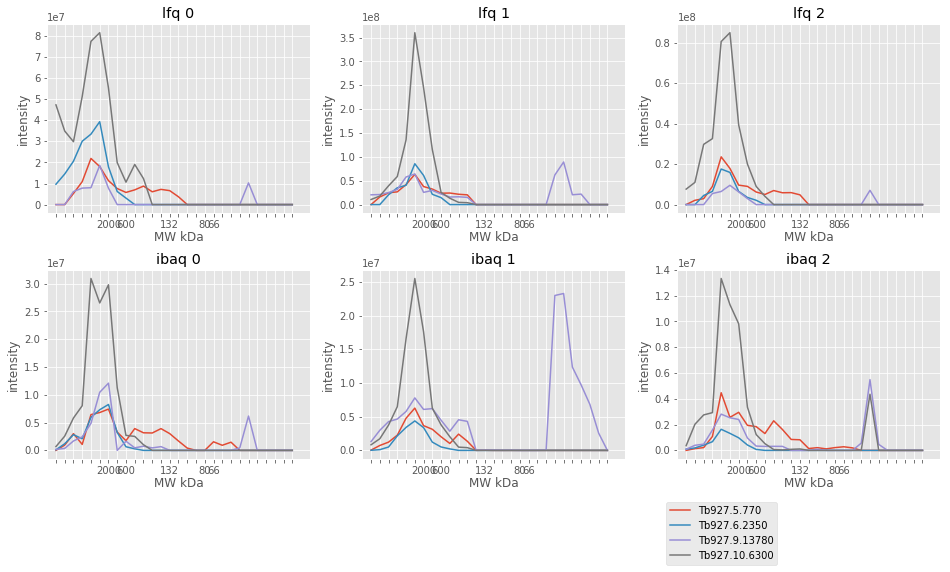

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.5.770                    76               0   
Tb927.6.2350                  103               0   
Tb927.9.13780                  33               0   
Tb927.10.6300                  50               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.5.770                  hypothetical protein, conserved  
Tb927.6.2350           50S ribosome-binding GTPase, putative  
Tb927.9.13780  Mitochondrial SSU ribosomal protein, putative  
Tb927.10.6300             Mitochondrial ribosomal protein S5  
11 2 32 ['Tb927.5.770', 'Tb927.6.2350', 'Tb927.9.13780', 'Tb927.10.6300']


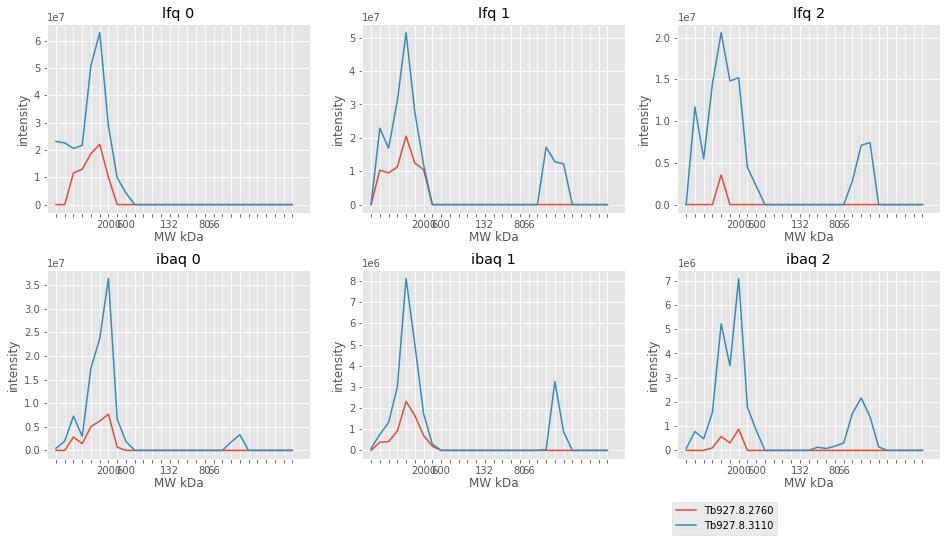

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.2760                  52               0   
Tb927.8.3110                  50               0   

                              [Product Description]  
[Input ID]                                           
Tb927.8.2760  50S ribosome-binding GTPase, putative  
Tb927.8.3110     Mitochondrial ribosomal protein S9  
11 4 21 ['Tb927.8.2760', 'Tb927.8.3110']


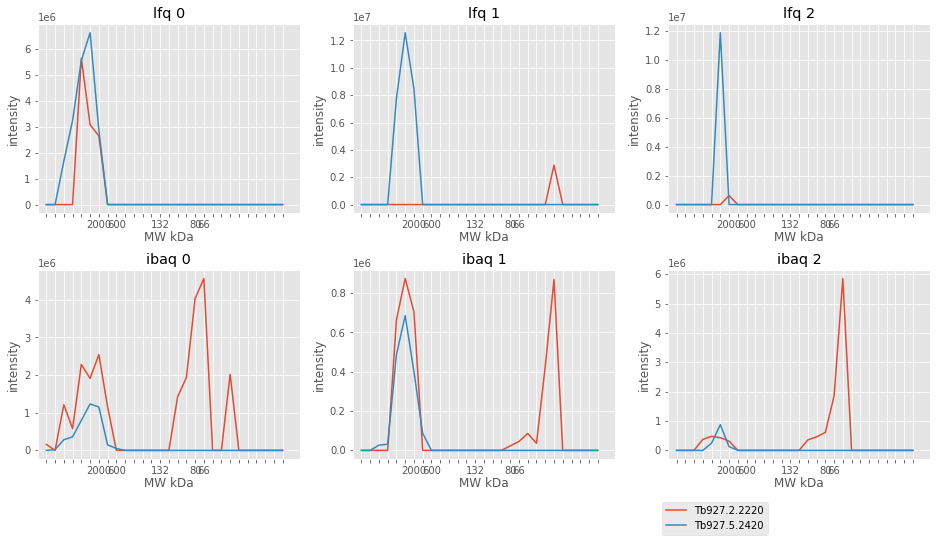

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.2.2220                  34               0   
Tb927.5.2420                 102               0   

                        [Product Description]  
[Input ID]                                     
Tb927.2.2220  hypothetical protein, conserved  
Tb927.5.2420   NOL1/NOP2/sun family, putative  
11 3 30 ['Tb927.2.2220', 'Tb927.5.2420']


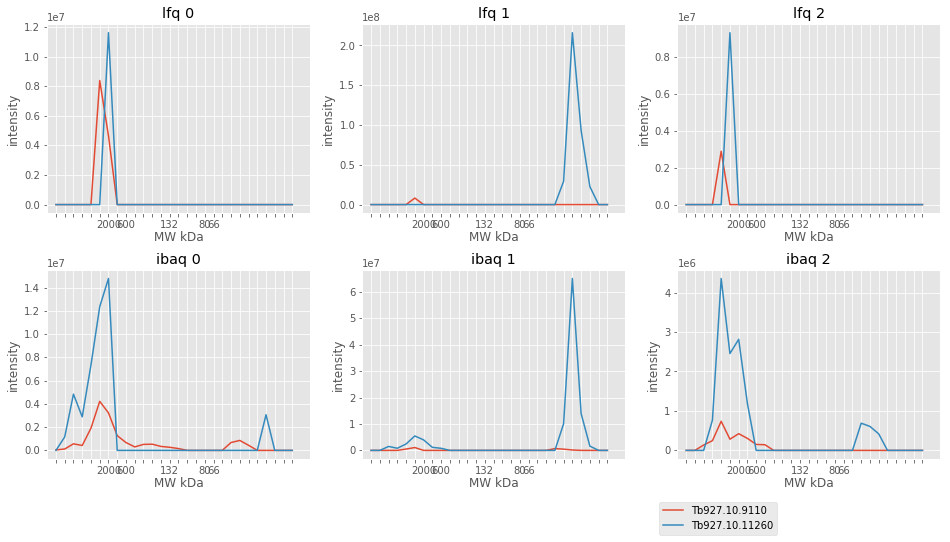

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.9110                   36               0   
Tb927.10.11260                  22               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.10.9110                  hypothetical protein, conserved  
Tb927.10.11260  SSU ribosomal protein, mitochondrial, putative  
11 3 32 ['Tb927.10.9110', 'Tb927.10.11260']


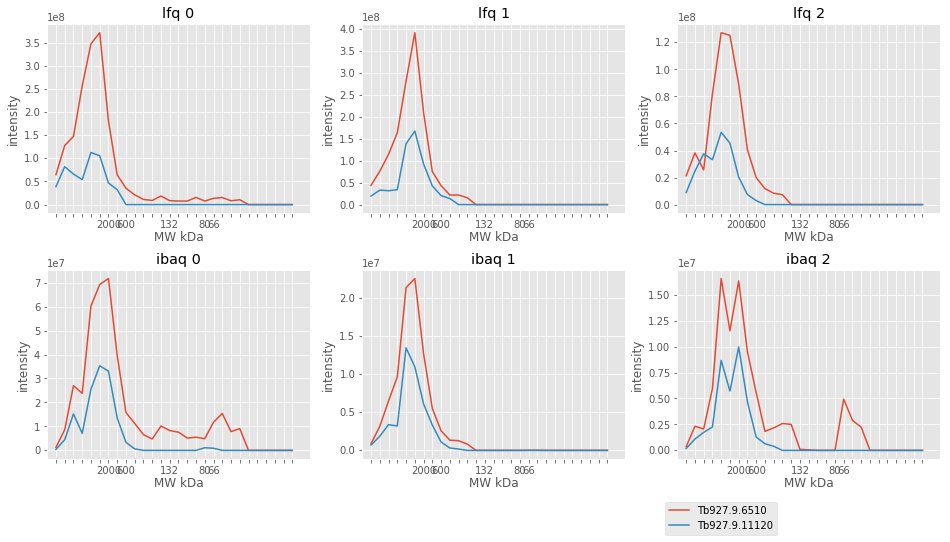

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.6510                   75               0   
Tb927.9.11120                  72               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.9.6510       Mitochondrial SSU ribosomal protein, putative  
Tb927.9.11120  Chromosome passenger complex (CPC) protein INC...  
11 5 21 ['Tb927.9.6510', 'Tb927.9.11120']


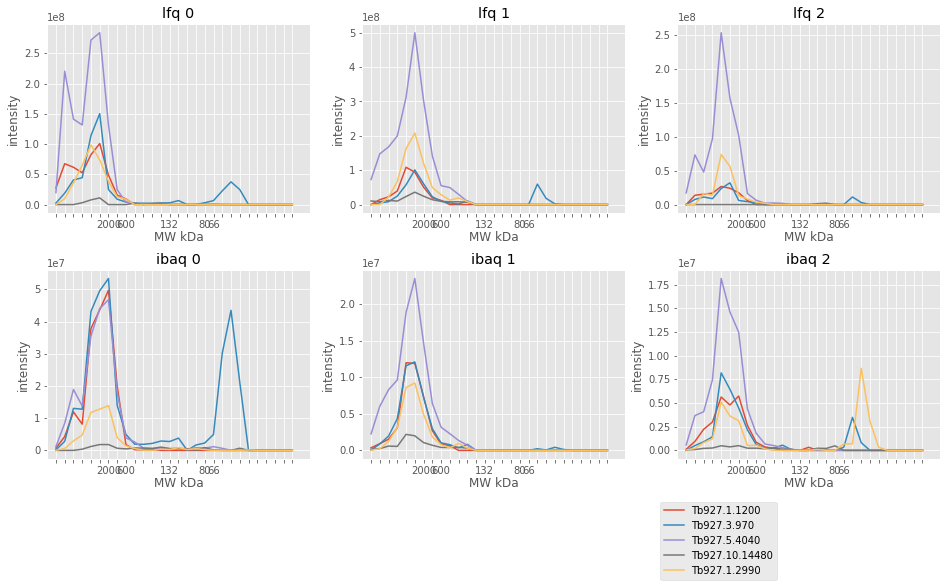

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.1200                    50               0   
Tb927.3.970                     39               0   
Tb927.5.4040                    94               0   
Tb927.10.14480                  92               0   
Tb927.1.2990                   115               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.1.1200                  Mitochondrial ribosomal protein S15  
Tb927.3.970         Mitochondrial SSU ribosomal protein, putative  
Tb927.5.4040        Mitochondrial SSU ribosomal protein, putative  
Tb927.10.14480                    hypothetical protein, conserved  
Tb927.1.2990    kinetoplast ribosomal PPR-repeat containing pr...  
11 5 32 ['Tb927.1.1200', 'Tb927.3.970', 'Tb927.5.4040', 'Tb927.10.14480', 'Tb927.1.2990']


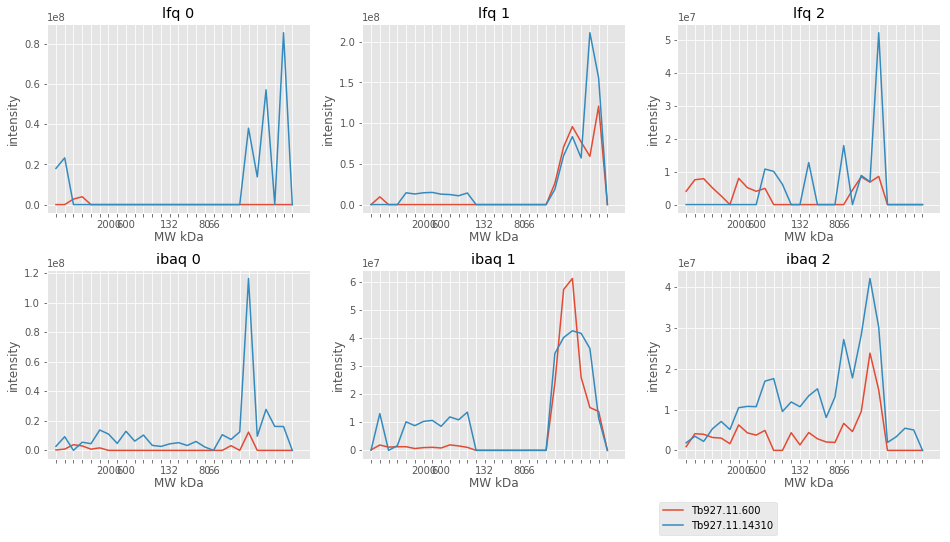

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.600                    10               0   
Tb927.11.14310                   8               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.11.600    Mitochondrial ATP synthase subunit, putative  
Tb927.11.14310          small nuclear ribonucleoprotein Sm-G  
29 20 3 ['Tb927.11.600', 'Tb927.11.14310']


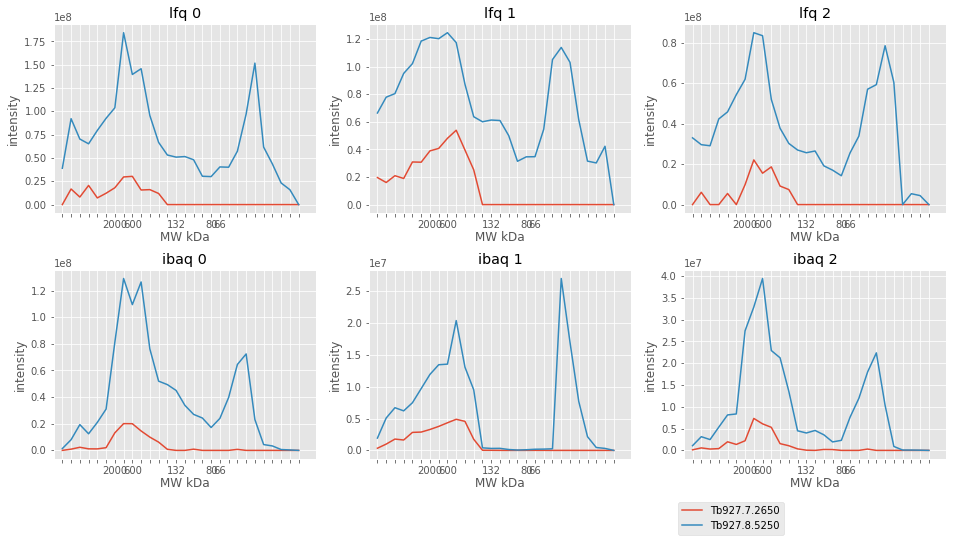

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.2650                  62               0   
Tb927.8.5250                  57               0   

                        [Product Description]  
[Input ID]                                     
Tb927.7.2650  hypothetical protein, conserved  
Tb927.8.5250     delta-coat protein, putative  
17 50 45 ['Tb927.7.2650', 'Tb927.8.5250']


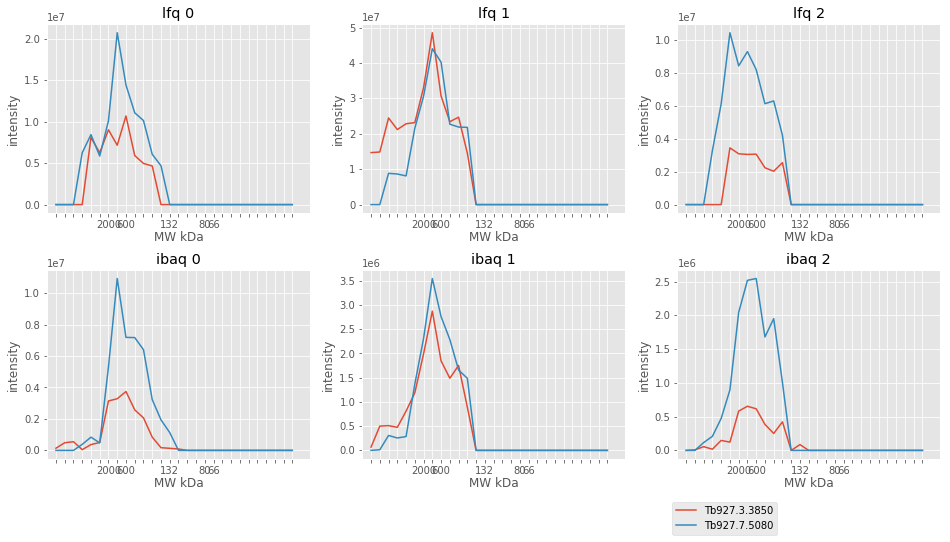

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.3850                 146               0   
Tb927.7.5080                  79               0   

                          [Product Description]  
[Input ID]                                       
Tb927.3.3850  COPII coat assembly protein sec16  
Tb927.7.5080        ATP-NAD kinase-like protein  
17 44 35 ['Tb927.3.3850', 'Tb927.7.5080']


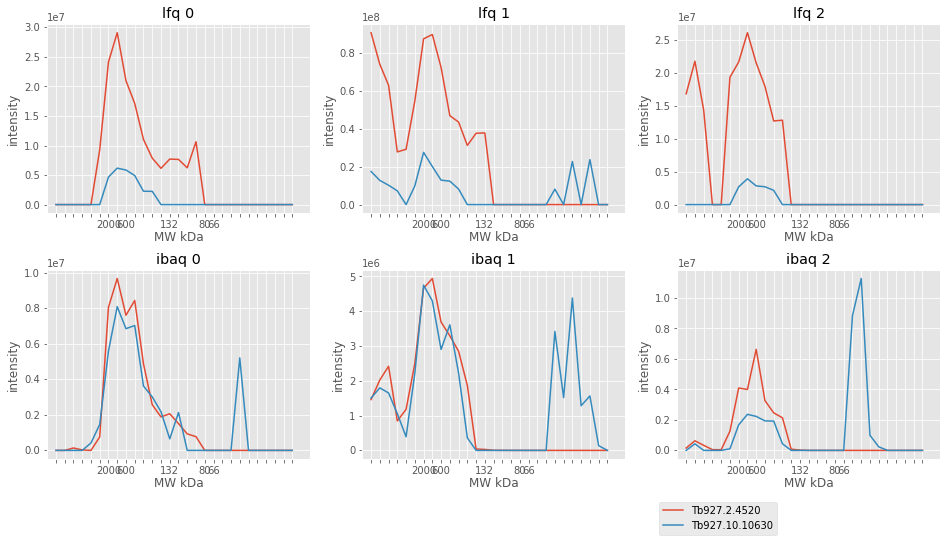

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.2.4520                   143               0   
Tb927.10.10630                  29               0   

                          [Product Description]  
[Input ID]                                       
Tb927.2.4520    hypothetical protein, conserved  
Tb927.10.10630  hypothetical protein, conserved  
17 44 45 ['Tb927.2.4520', 'Tb927.10.10630']


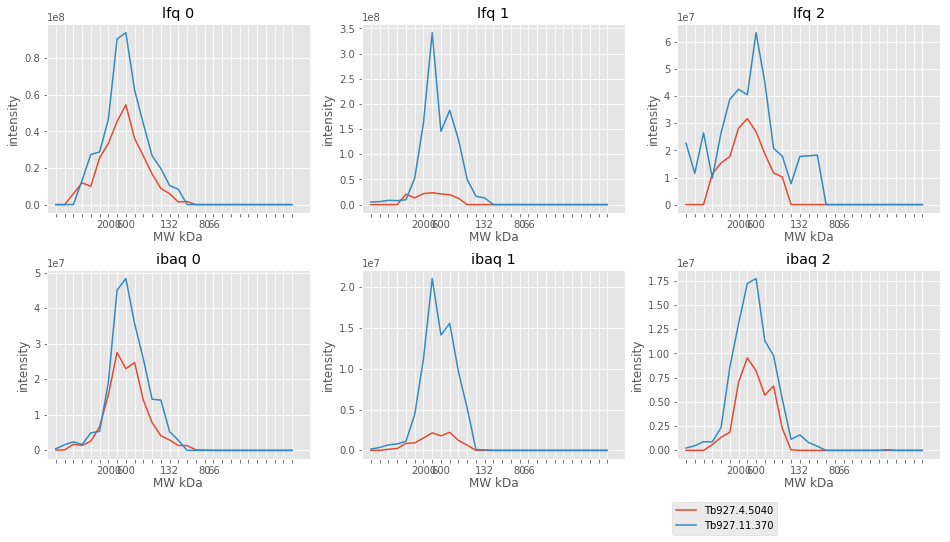

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.5040                  63               0   
Tb927.11.370                  92               0   

                       [Product Description]  
[Input ID]                                    
Tb927.4.5040  dihydrolipoamide dehydrogenase  
Tb927.11.370   repressor activator protein 1  
17 46 44 ['Tb927.4.5040', 'Tb927.11.370']


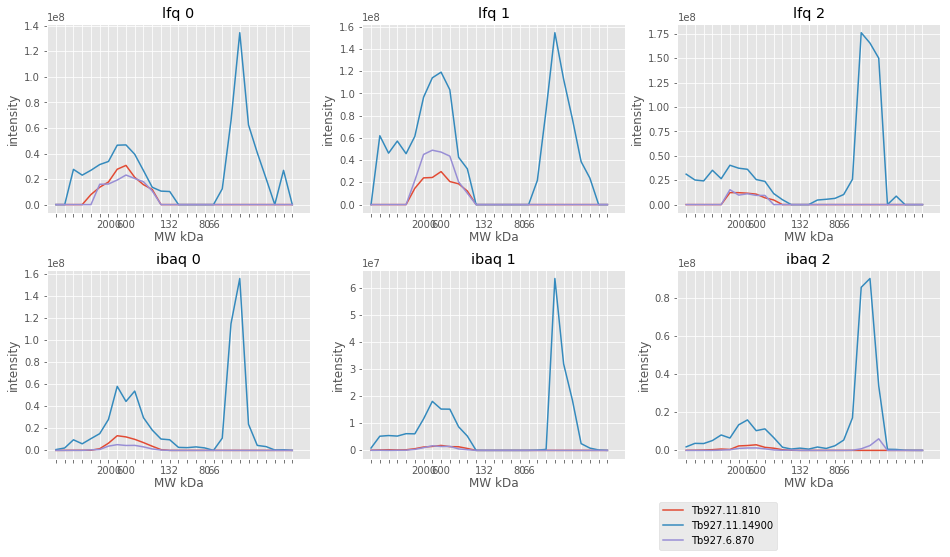

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.810                    86               0   
Tb927.11.14900                  34               0   
Tb927.6.870                    194               0   

                          [Product Description]  
[Input ID]                                       
Tb927.11.810    hypothetical protein, conserved  
Tb927.11.14900         coatomer subunit epsilon  
Tb927.6.870              myotubularin, putative  
17 46 42 ['Tb927.11.810', 'Tb927.11.14900', 'Tb927.6.870']


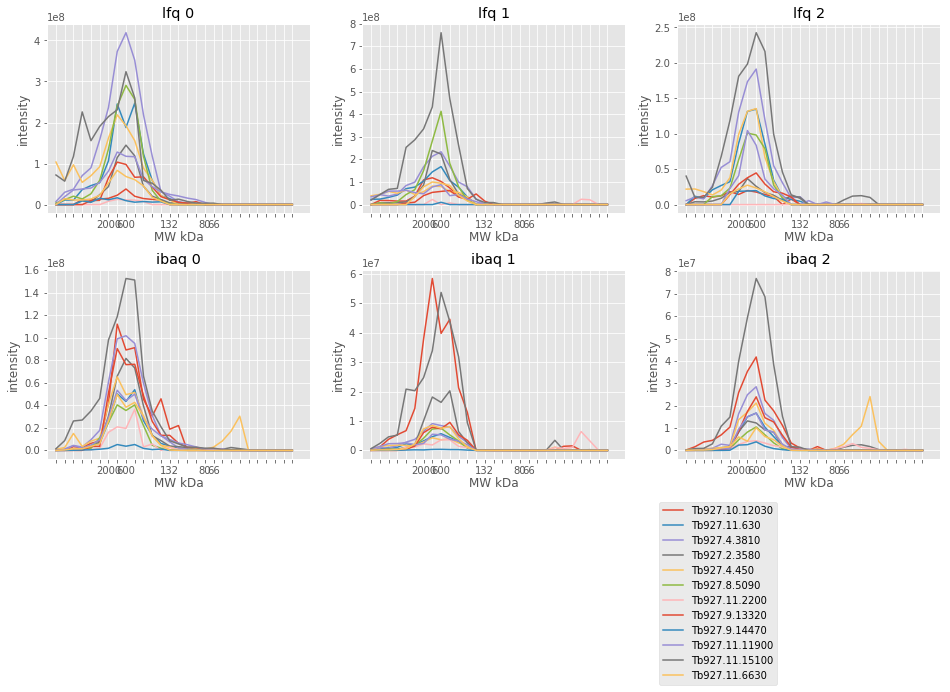

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.12030                  27               0   
Tb927.11.630                   179               0   
Tb927.4.3810                   134               0   
Tb927.2.3580                    52               0   
Tb927.4.450                    132               0   
Tb927.8.5090                   195               0   
Tb927.11.2200                   14               0   
Tb927.9.13320                   55               0   
Tb927.9.14470                  132               0   
Tb927.11.11900                  97               0   
Tb927.11.15100                 118               0   
Tb927.11.6630                   66               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.12030                    hypothetical protein, conserved  
Tb927.11.630              RNA polymeras

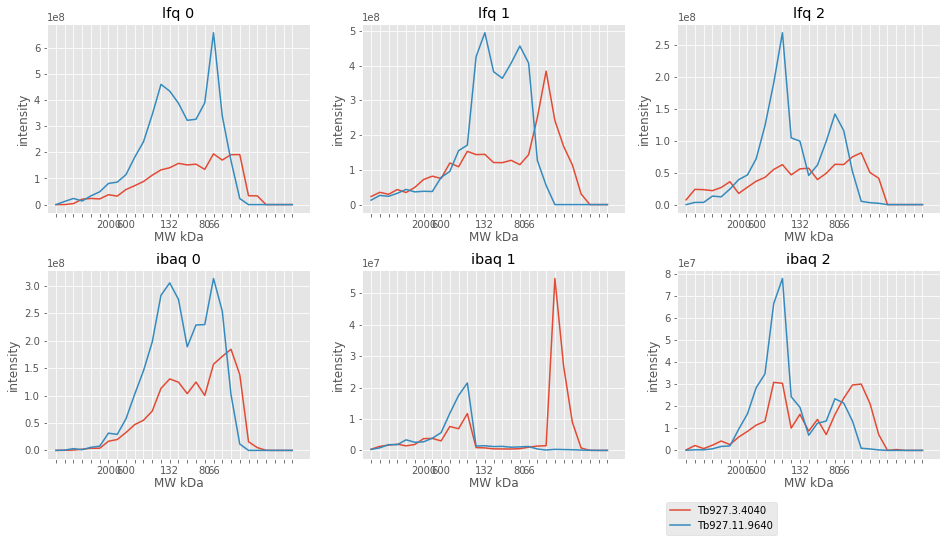

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.4040                   67               0   
Tb927.11.9640                  70               0   

                              [Product Description]  
[Input ID]                                           
Tb927.3.4040   Ankyrin repeats (3 copies), putative  
Tb927.11.9640      glycyl-tRNA synthetase, putative  
47 35 57 ['Tb927.3.4040', 'Tb927.11.9640']


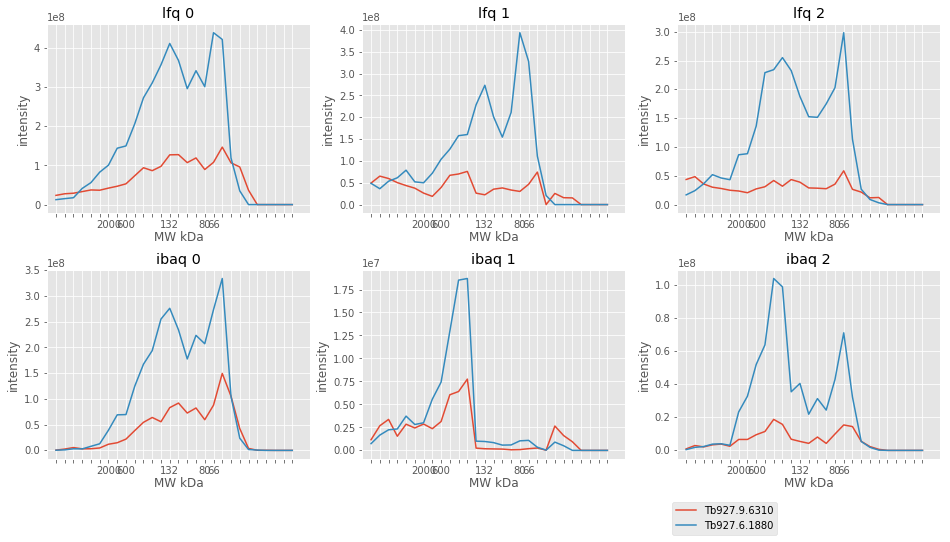

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.6310                  72               7   
Tb927.6.1880                  62               0   

                           [Product Description]  
[Input ID]                                        
Tb927.9.6310           ABC transporter, putative  
Tb927.6.1880  aspartyl-tRNA synthetase, putative  
47 31 46 ['Tb927.9.6310', 'Tb927.6.1880']


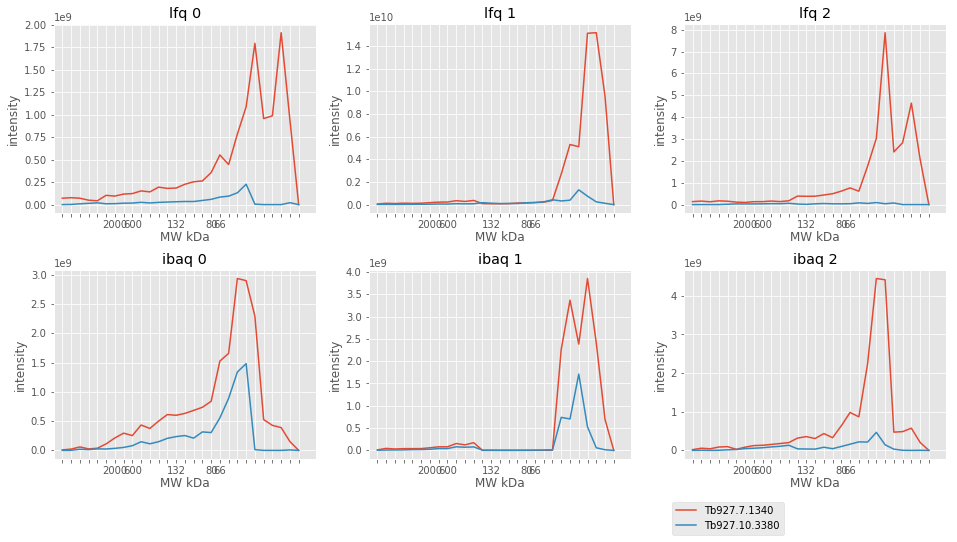

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.1340                   10               0   
Tb927.10.3380                  11               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.7.1340         10 kDa heat shock protein, putative  
Tb927.10.3380  60S acidic ribosomal protein P2, putative  
31 20 3 ['Tb927.7.1340', 'Tb927.10.3380']


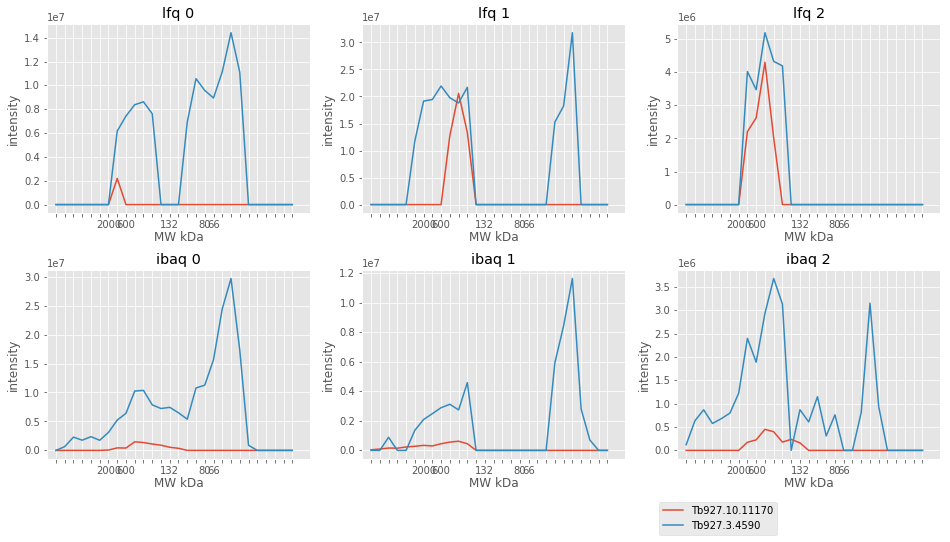

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.11170                 198               0   
Tb927.3.4590                    32               0   

                          [Product Description]  
[Input ID]                                       
Tb927.10.11170  hypothetical protein, conserved  
Tb927.3.4590    hypothetical protein, conserved  
51 23 50 ['Tb927.10.11170', 'Tb927.3.4590']


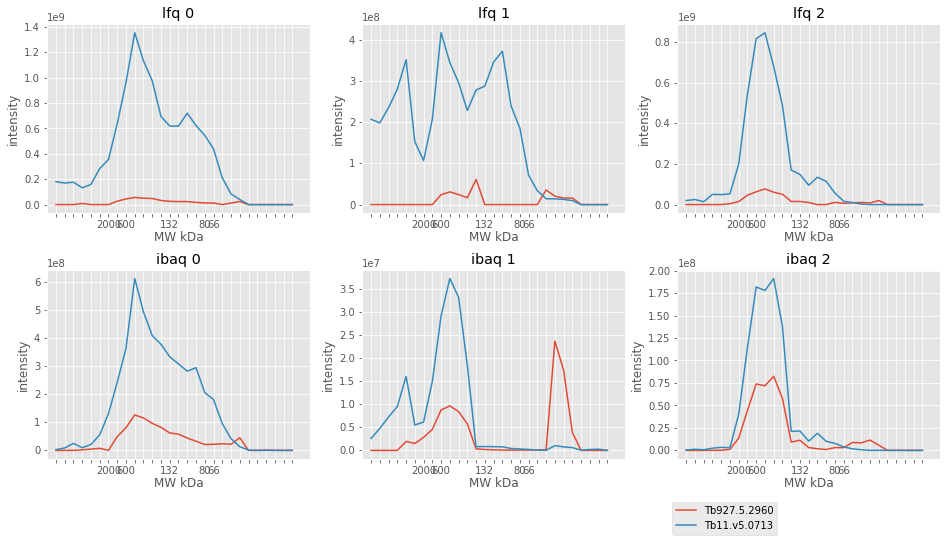

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.2960                  41               0   
Tb11.v5.0713                  78               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.5.2960  phosphoribosylpyrophosphate synthetase, putative  
Tb11.v5.0713  retrotransposon hot spot (RHS) protein, putative  
51 29 50 ['Tb927.5.2960', 'Tb11.v5.0713']


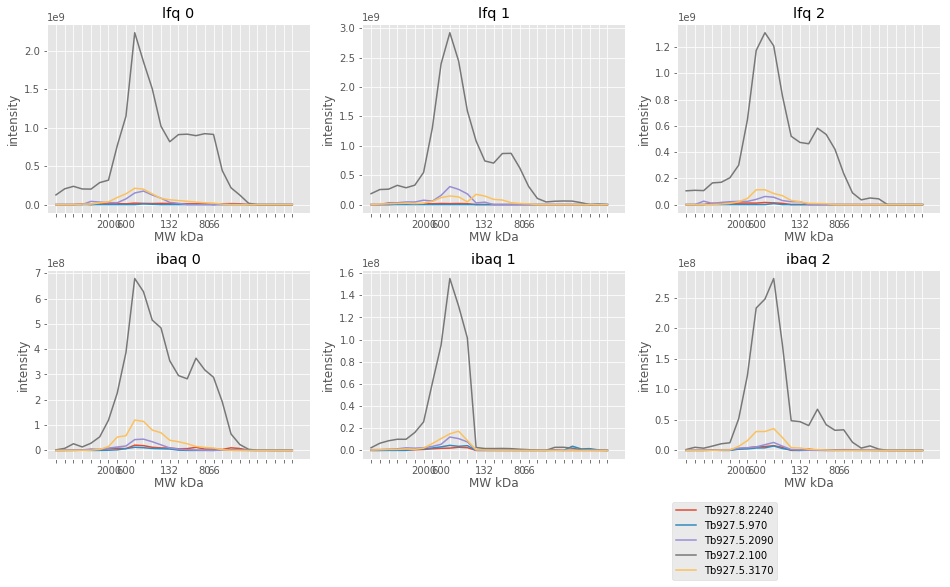

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.2240                  52               0   
Tb927.5.970                   21               0   
Tb927.5.2090                 122               0   
Tb927.2.100                   94               0   
Tb927.5.3170                  73               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.2240                     Tryptophanyl-tRNA synthetase 2  
Tb927.5.970           class I transcription factor A, subunit 6  
Tb927.5.2090                                  kinesin, putative  
Tb927.2.100   retrotransposon hot spot protein 1 (RHS1), put...  
Tb927.5.3170       ribose-phosphate pyrophosphokinase, putative  
51 30 50 ['Tb927.8.2240', 'Tb927.5.970', 'Tb927.5.2090', 'Tb927.2.100', 'Tb927.5.3170']


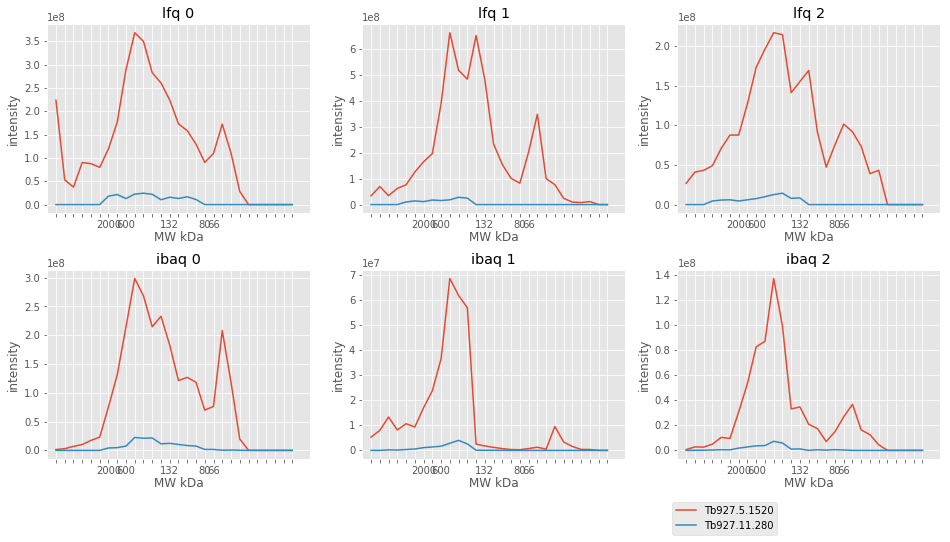

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.1520                  52               0   
Tb927.11.280                  71               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.5.1520  ATP-dependent protease ATPase subunit HslU1  
Tb927.11.280              hypothetical protein, conserved  
51 30 48 ['Tb927.5.1520', 'Tb927.11.280']


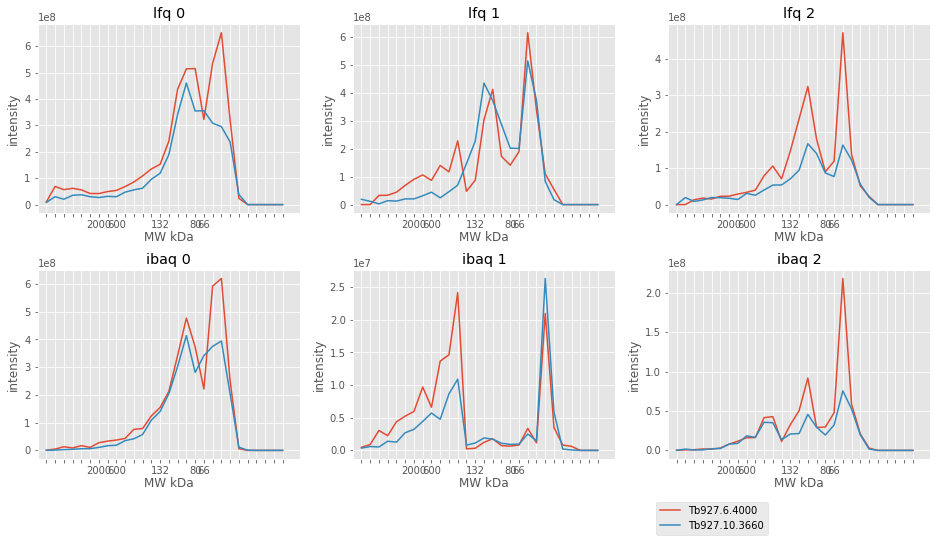

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.6.4000                   45               0   
Tb927.10.3660                  44               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.6.4000   small glutamine-rich tetratricopeptide repeat ...  
Tb927.10.3660                         aspartate aminotransferase  
37 31 10 ['Tb927.6.4000', 'Tb927.10.3660']


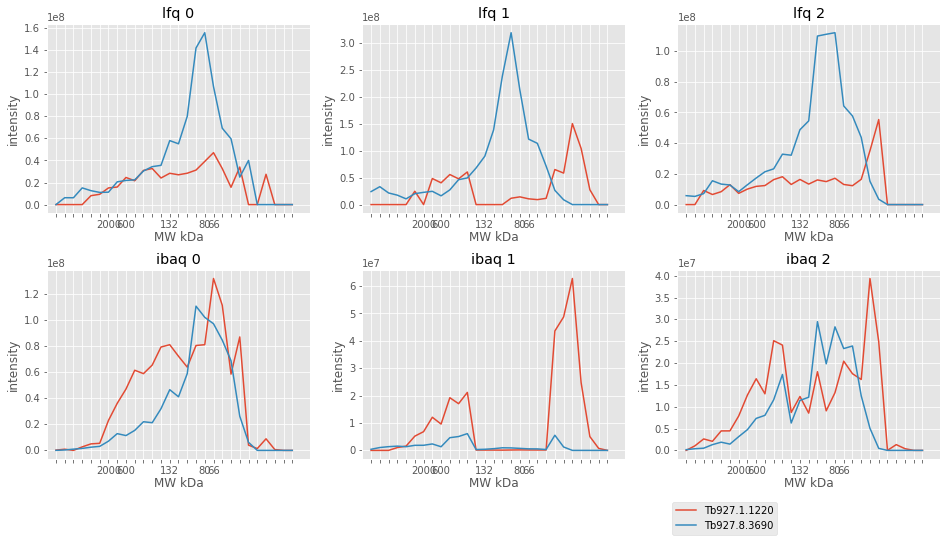

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.1.1220                  25               0   
Tb927.8.3690                  48               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.1.1220                      RWD domain-containing protein  
Tb927.8.3690  isocitrate dehydrogenase [NADP], mitochondrial...  
37 31 12 ['Tb927.1.1220', 'Tb927.8.3690']


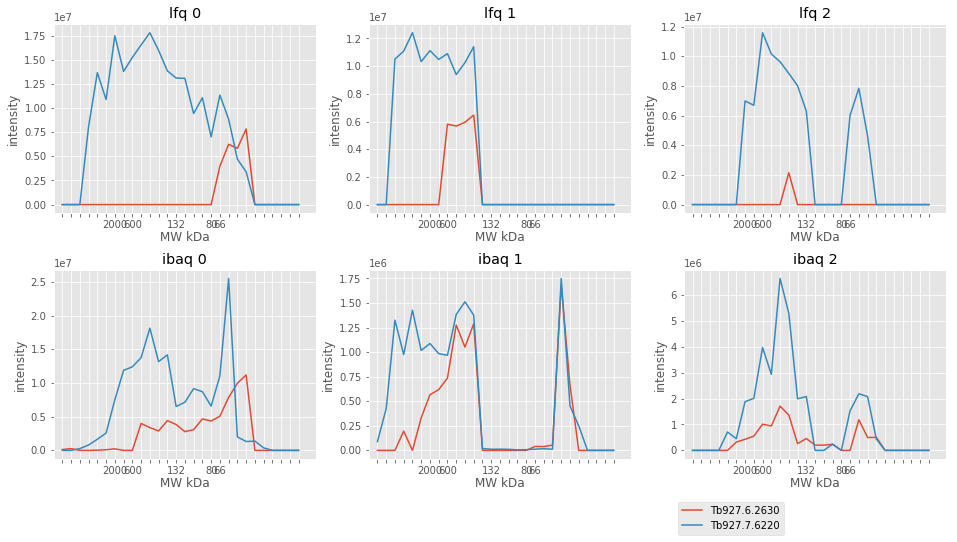

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.2630                  48               0   
Tb927.7.6220                  60               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.6.2630                            Hsp33 protein, putative  
Tb927.7.6220  calcium/calmodulin-dependent protein kinase, p...  
37 30 48 ['Tb927.6.2630', 'Tb927.7.6220']


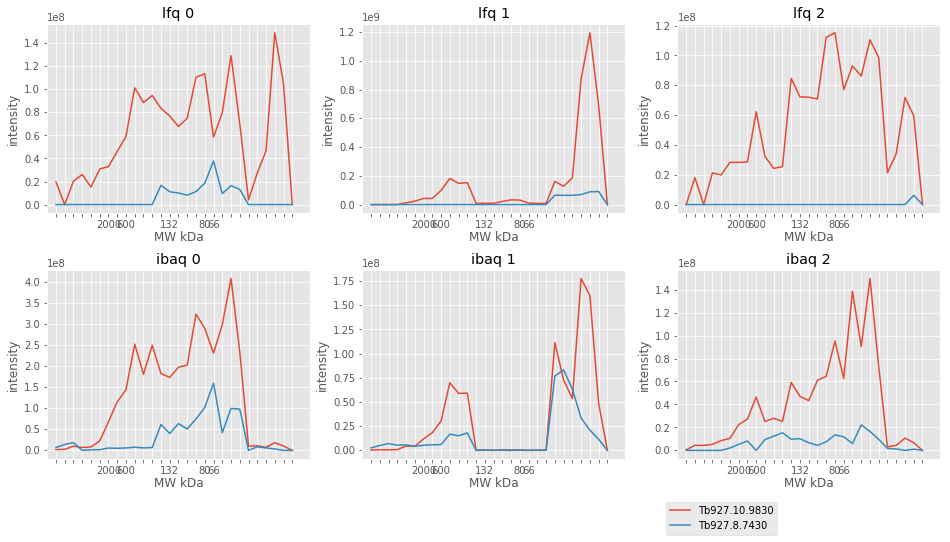

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.9830                  17               0   
Tb927.8.7430                    8               0   

                                      [Product Description]  
[Input ID]                                                   
Tb927.10.9830  Mitochondrial ATP synthase subunit, putative  
Tb927.8.7430     ubiquinol-cytochrome c reductase, putative  
37 32 2 ['Tb927.10.9830', 'Tb927.8.7430']


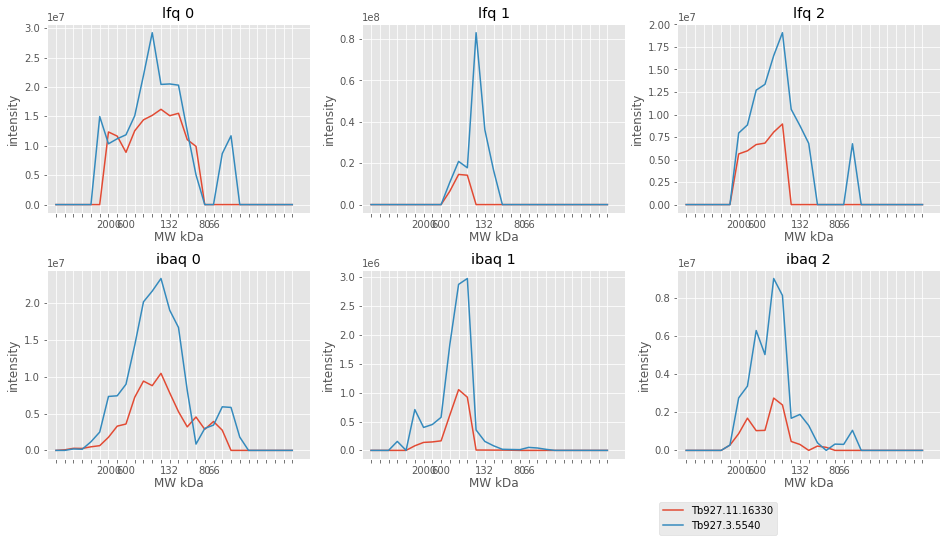

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.16330                 103               0   
Tb927.3.5540                    58               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.11.16330             hypothetical protein, conserved  
Tb927.3.5540    dynein intermediate chain WDRD34, putative  
76 35 48 ['Tb927.11.16330', 'Tb927.3.5540']


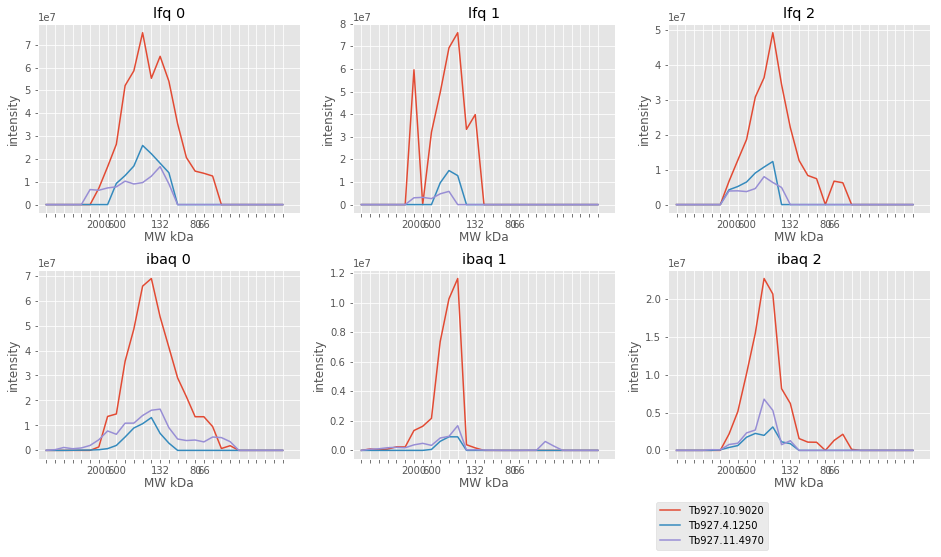

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.9020                  52               0   
Tb927.4.1250                   99               0   
Tb927.11.4970                  51               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.10.9020                   Gcd10p family, putative  
Tb927.4.1250   peroxisome biogenesis factor 1, putative  
Tb927.11.4970             predicted WD40 repeat protein  
76 35 46 ['Tb927.10.9020', 'Tb927.4.1250', 'Tb927.11.4970']


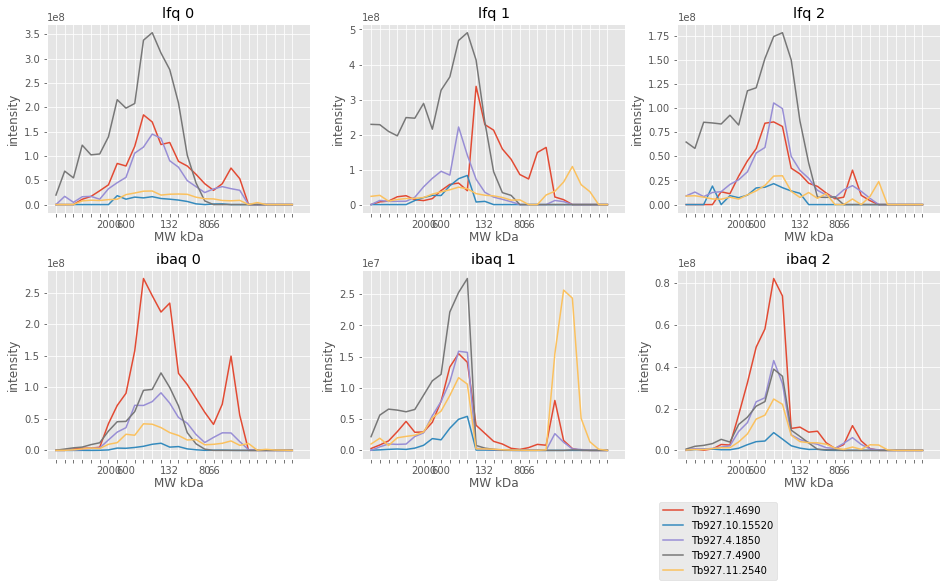

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.4690                    39               0   
Tb927.10.15520                  76               0   
Tb927.4.1850                    64               0   
Tb927.7.4900                   158               0   
Tb927.11.2540                   33               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.1.4690    Protein arginine N-methyltransferase 1 catalyt...  
Tb927.10.15520      signal recognition particle protein, putative  
Tb927.4.1850                      hypothetical protein, conserved  
Tb927.7.4900                              5'-3' exoribonuclease A  
Tb927.11.2540                     hypothetical protein, conserved  
76 31 48 ['Tb927.1.4690', 'Tb927.10.15520', 'Tb927.4.1850', 'Tb927.7.4900', 'Tb927.11.2540']


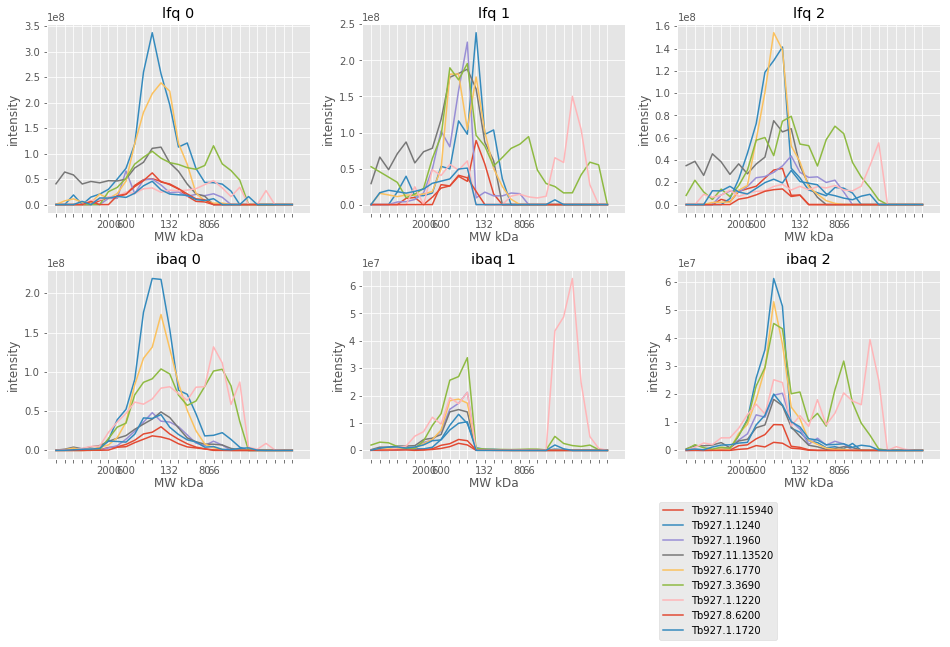

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.15940                 105               0   
Tb927.1.1240                    65               0   
Tb927.1.1960                    75               0   
Tb927.11.13520                 105               1   
Tb927.6.1770                    69               0   
Tb927.3.3690                    60               0   
Tb927.1.1220                    25               0   
Tb927.8.6200                   147               0   
Tb927.1.1720                    43               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.15940                hypothetical protein, conserved  
Tb927.1.1240         cytidine triphosphate synthase, putative  
Tb927.1.1960                 chaperone protein DnaJ, putative  
Tb927.11.13520                hypothetical protein, conserved  
Tb927.6.1770         

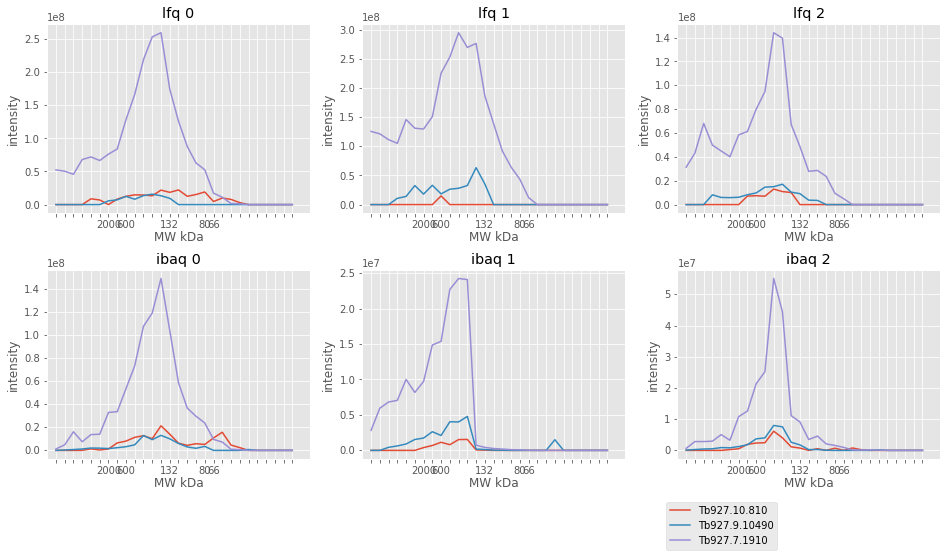

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.810                   67               0   
Tb927.9.10490                  65               0   
Tb927.7.1910                  106               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.810    Pentatricopeptide repeat protein (PPR), putative  
Tb927.9.10490                    Component of motile flagella 56  
Tb927.7.1910   pyridoxal phosphate containing glycine decarbo...  
76 25 46 ['Tb927.10.810', 'Tb927.9.10490', 'Tb927.7.1910']


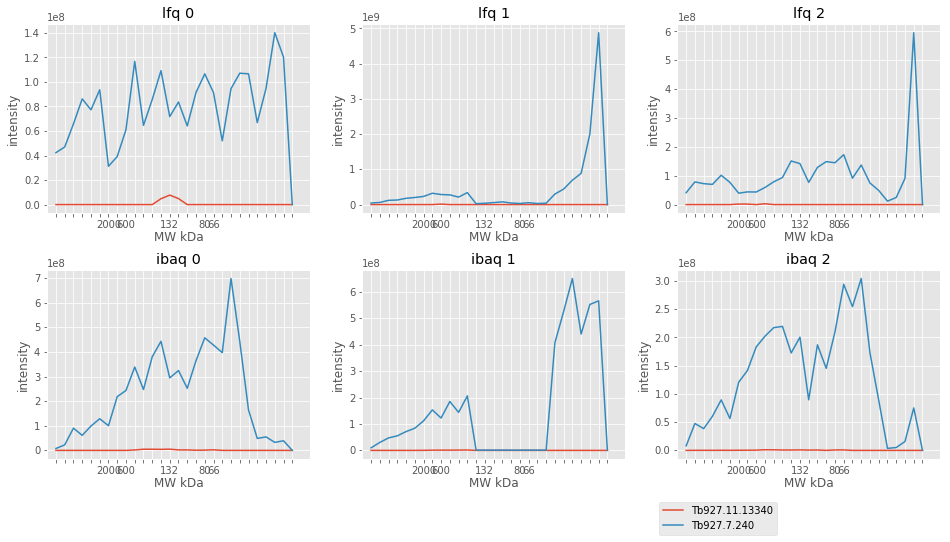

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.13340                  88               0   
Tb927.7.240                     11               0   

                              [Product Description]  
[Input ID]                                           
Tb927.11.13340      hypothetical protein, conserved  
Tb927.7.240     40S ribosomal protein S33, putative  
76 25 58 ['Tb927.11.13340', 'Tb927.7.240']


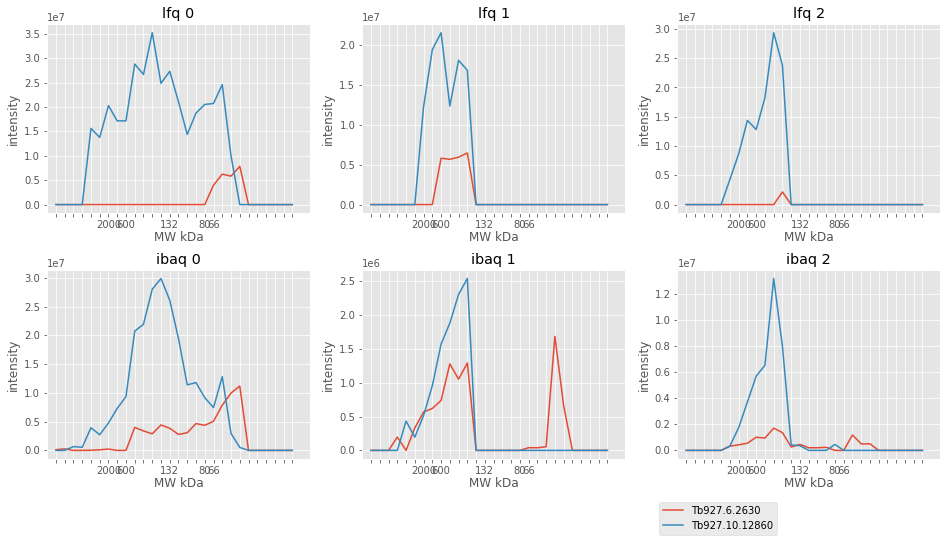

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.2630                    48               0   
Tb927.10.12860                  77               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.6.2630                    Hsp33 protein, putative  
Tb927.10.12860  pre-RNA processing PIH1/Nop17, putative  
76 30 48 ['Tb927.6.2630', 'Tb927.10.12860']


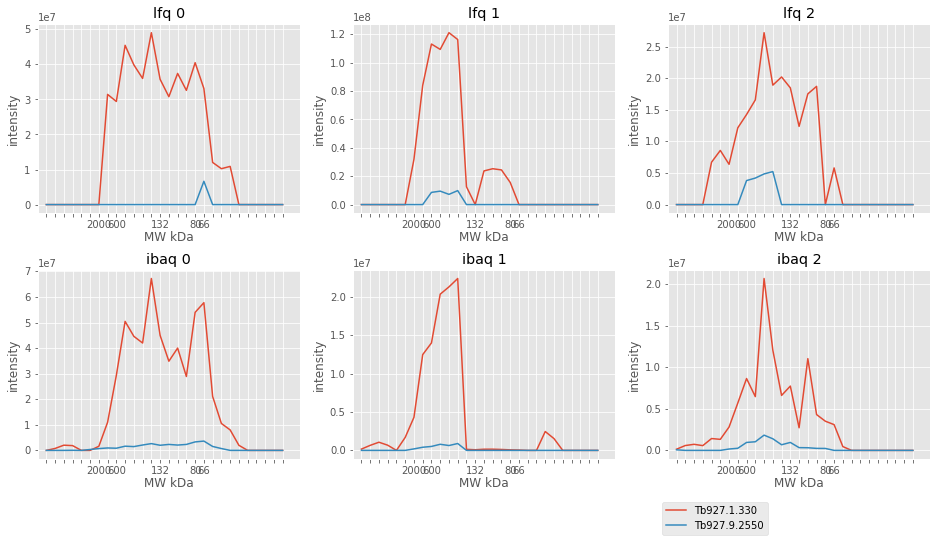

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.1.330                   30               0   
Tb927.9.2550                 113               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.1.330   retrotransposon hot spot protein (RHS, pseudog...  
Tb927.9.2550     Domain of unknown function (DUF4457), putative  
76 30 46 ['Tb927.1.330', 'Tb927.9.2550']


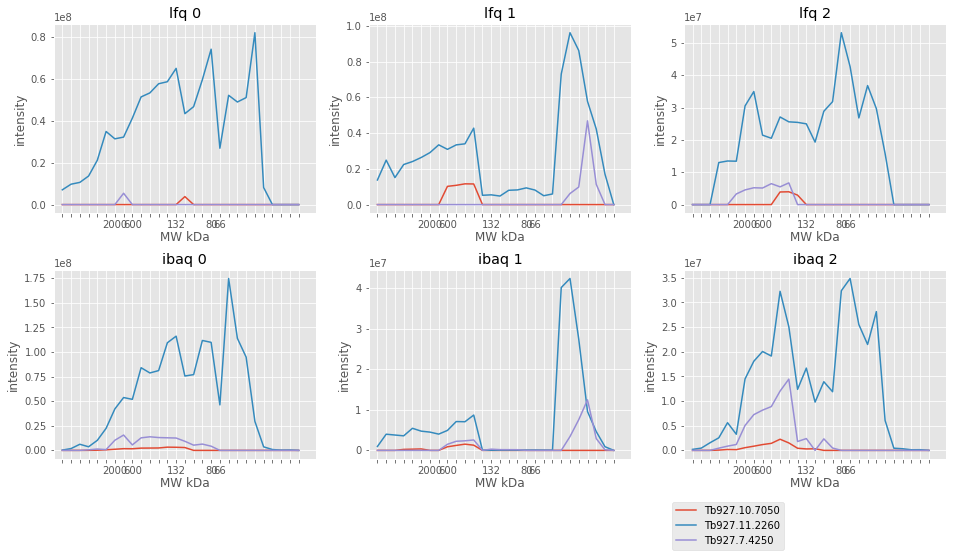

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.7050                  60               0   
Tb927.11.2260                  26               0   
Tb927.7.4250                   12               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.10.7050  chromatin assembly factor 1 subunit B, putative  
Tb927.11.2260    Eukaryotic translation initiation factor 4E-1  
Tb927.7.4250                   hypothetical protein, conserved  
76 32 48 ['Tb927.10.7050', 'Tb927.11.2260', 'Tb927.7.4250']


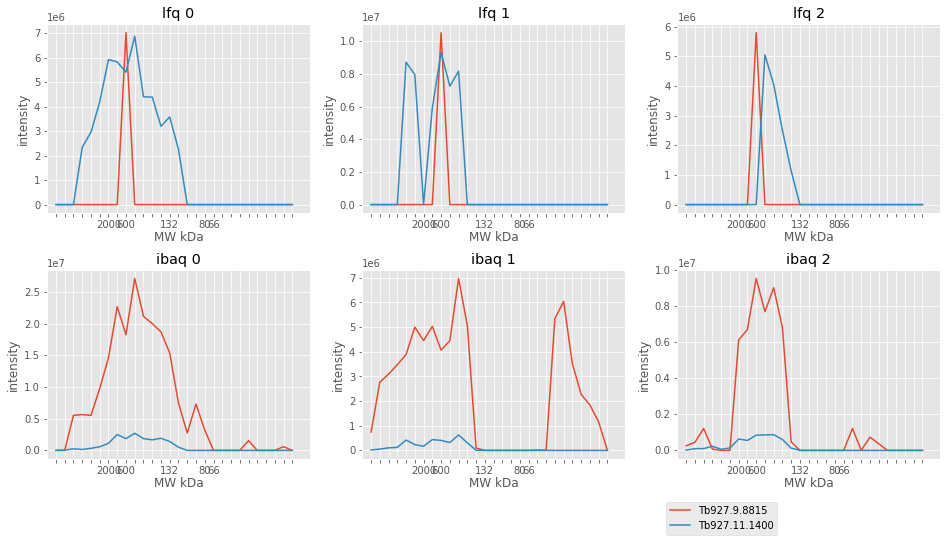

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.8815                    9               1   
Tb927.11.1400                  94               0   

                         [Product Description]  
[Input ID]                                      
Tb927.9.8815              hypothetical protein  
Tb927.11.1400  hypothetical protein, conserved  
49 50 37 ['Tb927.9.8815', 'Tb927.11.1400']


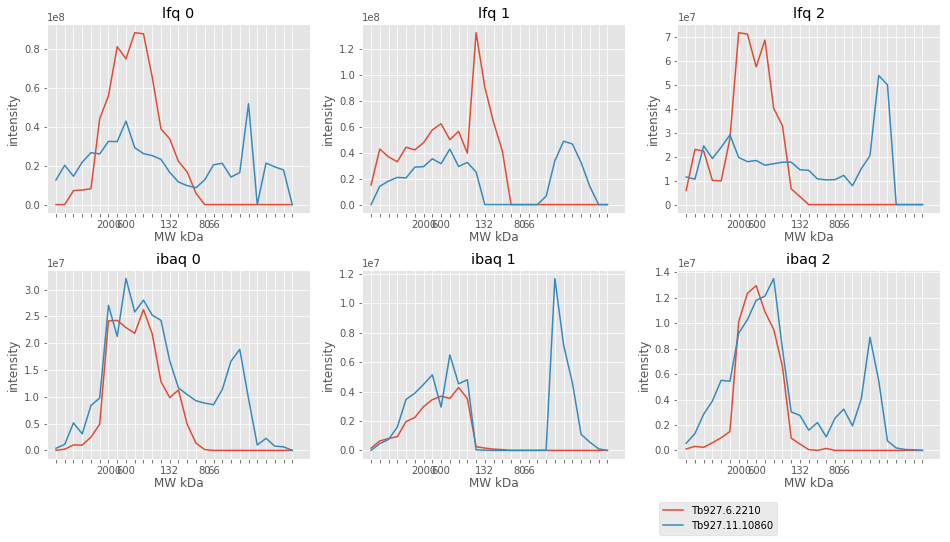

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.2210                   123               0   
Tb927.11.10860                  47               0   

                                [Product Description]  
[Input ID]                                             
Tb927.6.2210          hypothetical protein, conserved  
Tb927.11.10860  20S-pre-rRNA D-site endonuclease NOB1  
49 50 34 ['Tb927.6.2210', 'Tb927.11.10860']


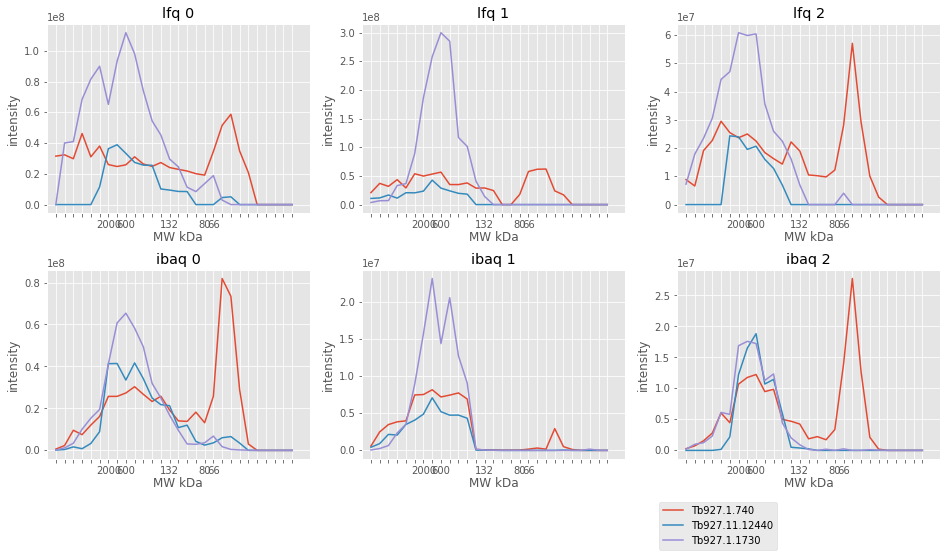

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.740                     48               0   
Tb927.11.12440                  43               0   
Tb927.1.1730                    75               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.1.740     phosphatidylinositol-4-phosphate 5-kinase related  
Tb927.11.12440  Plus-3 domain/Zinc finger, C3HC4 type (RING fi...  
Tb927.1.1730    Polyadenylation mediator complex protein PAMC1...  
49 49 44 ['Tb927.1.740', 'Tb927.11.12440', 'Tb927.1.1730']


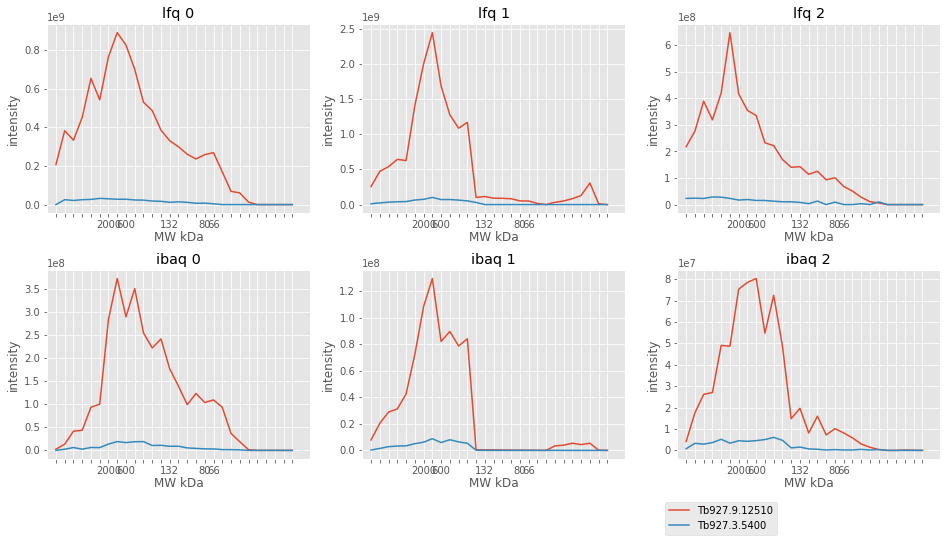

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.12510                  82               0   
Tb927.3.5400                   64               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.9.12510     ATP-dependent DEAD/H RNA helicase, putative  
Tb927.3.5400   serine/threonine protein kinase RIO1, putative  
49 49 33 ['Tb927.9.12510', 'Tb927.3.5400']


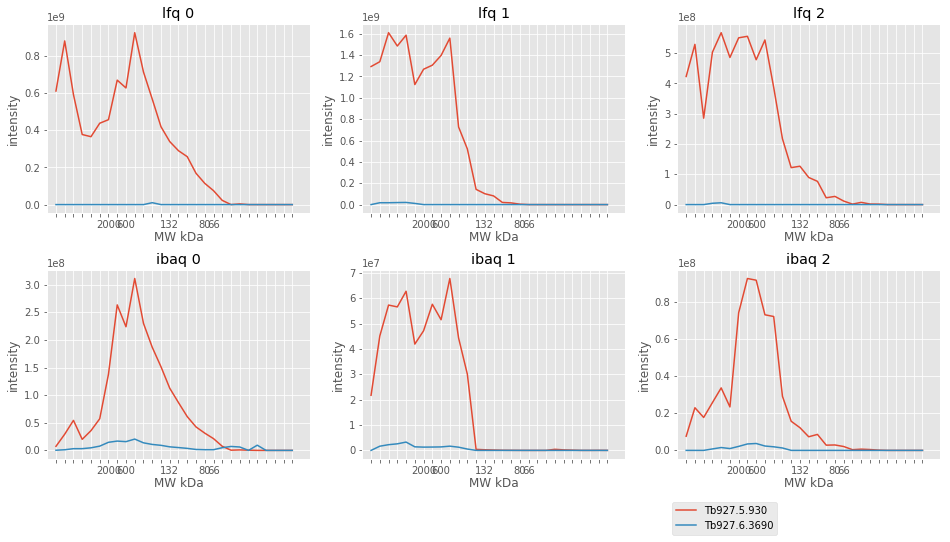

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.930                  123               0   
Tb927.6.3690                  46               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.930                   NADH-dependent fumarate reductase  
Tb927.6.3690  pre-mRNA cleavage complex II Clp1-like, conserved  
49 26 44 ['Tb927.5.930', 'Tb927.6.3690']


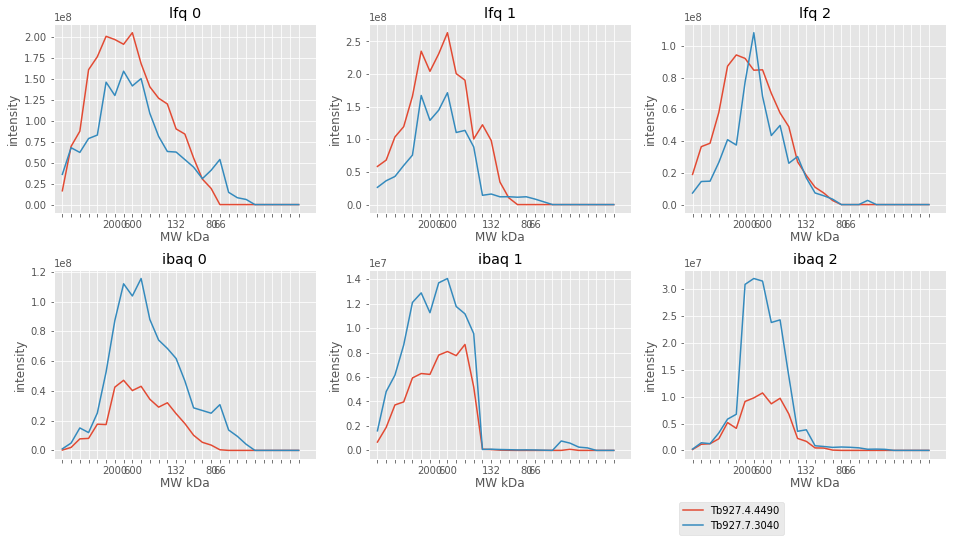

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.4490                 193               8   
Tb927.7.3040                  69               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.4.4490            multidrug resistance protein E  
Tb927.7.3040  F-box and WD40 domain containing protein  
49 47 35 ['Tb927.4.4490', 'Tb927.7.3040']


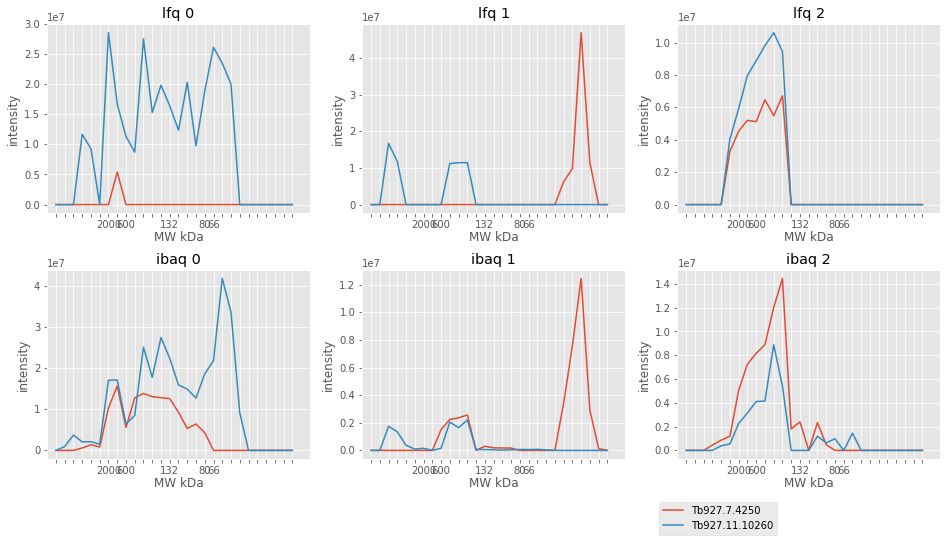

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.4250                    12               0   
Tb927.11.10260                  51               0   

                          [Product Description]  
[Input ID]                                       
Tb927.7.4250    hypothetical protein, conserved  
Tb927.11.10260  hypothetical protein, conserved  
14 32 48 ['Tb927.7.4250', 'Tb927.11.10260']


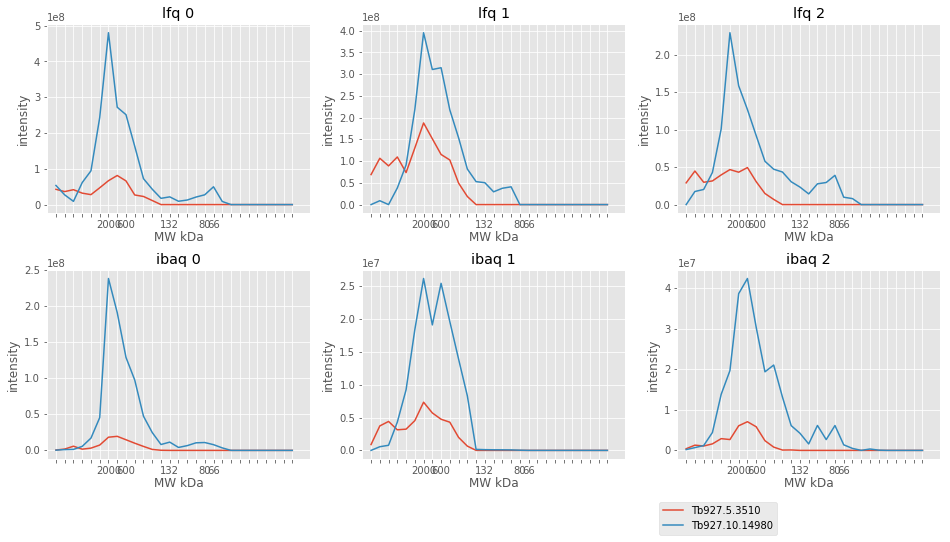

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.5.3510                   136               0   
Tb927.10.14980                  72               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.5.3510    structural maintenance of chromosome 3 , putative  
Tb927.10.14980                intraflagellar transport protein 52  
21 42 40 ['Tb927.5.3510', 'Tb927.10.14980']


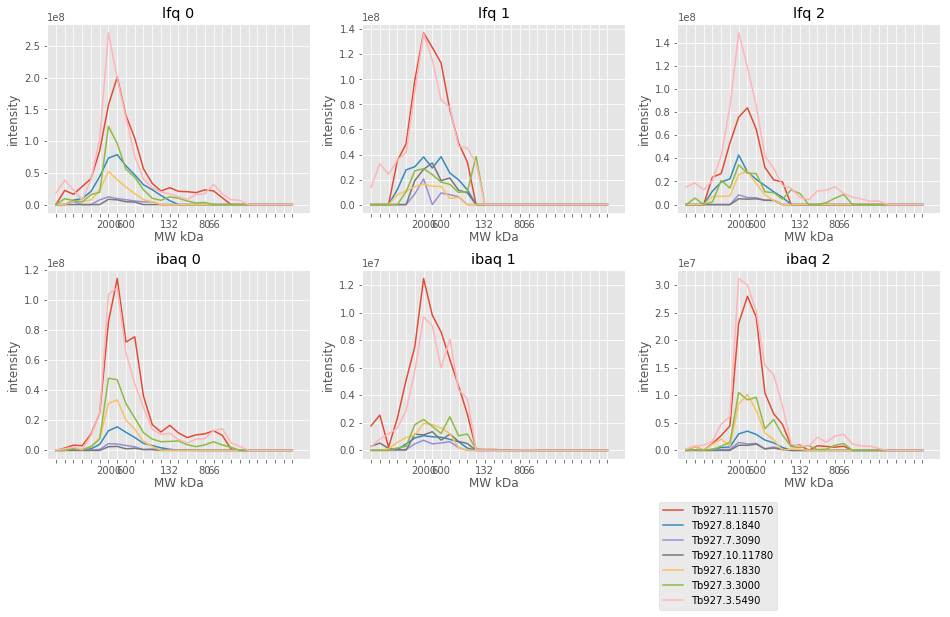

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11570                  87               0   
Tb927.8.1840                   225               0   
Tb927.7.3090                   111               0   
Tb927.10.11780                 131               0   
Tb927.6.1830                    49               0   
Tb927.3.3000                    64               0   
Tb927.3.5490                    79               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.11570  Translation initiation factor eIF-2B subunit e...  
Tb927.8.1840             Sec7 domain containing protein, putative  
Tb927.7.3090    Galactose oxidase, central domain containing p...  
Tb927.10.11780                    hypothetical protein, conserved  
Tb927.6.1830     Cleavage stimulation factor subunit 50, putative  
Tb927.3.3000         Putative intrafl

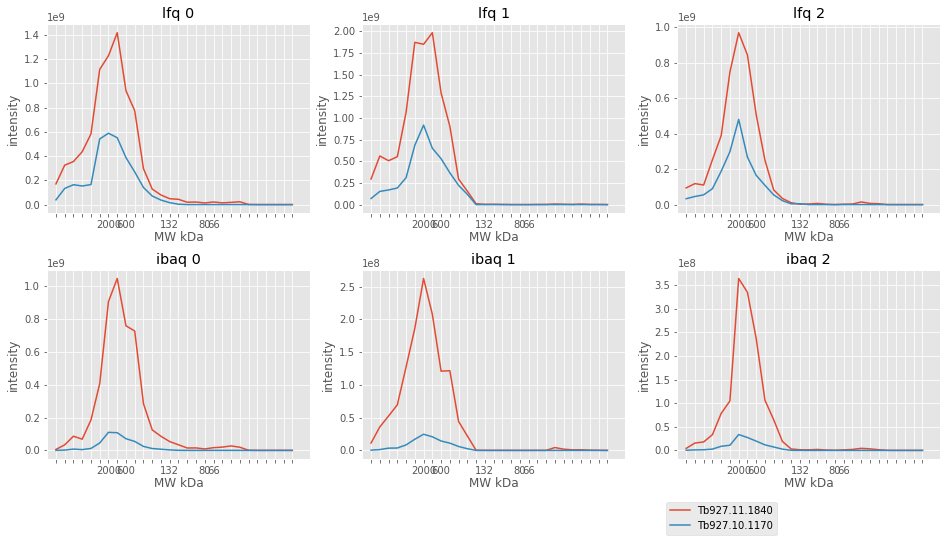

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.1840                  45               0   
Tb927.10.1170                 196               0   

                              [Product Description]  
[Input ID]                                           
Tb927.11.1840       hypothetical protein, conserved  
Tb927.10.1170  intraflagellar transport protein 172  
21 41 40 ['Tb927.11.1840', 'Tb927.10.1170']


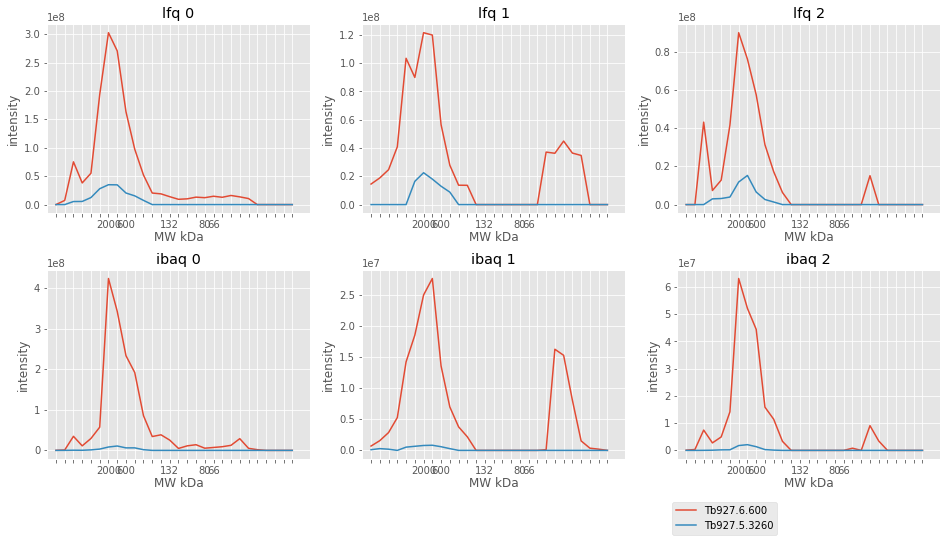

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.600                   38               0   
Tb927.5.3260                 149               0   

                               [Product Description]  
[Input ID]                                            
Tb927.6.600   ccr4-not transcription complex subunit  
Tb927.5.3260      WD domain, G-beta repeat, putative  
21 41 41 ['Tb927.6.600', 'Tb927.5.3260']


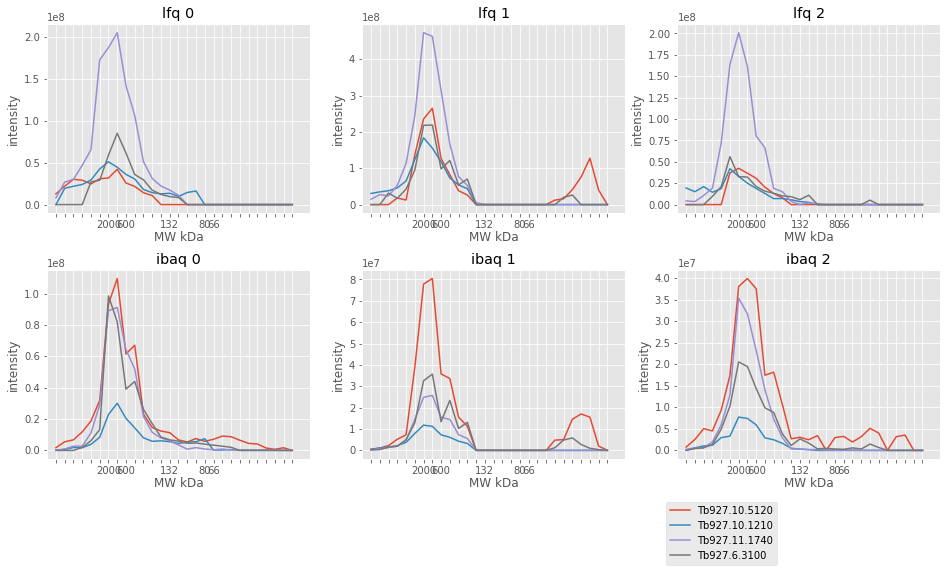

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.5120                  18               0   
Tb927.10.1210                  75               0   
Tb927.11.1740                  89               0   
Tb927.6.3100                   48               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.5120                                             KREPA6  
Tb927.10.1210                                  katanin, putative  
Tb927.11.1740                intraflagellar transport protein 88  
Tb927.6.3100   Intraflagellar transport complex B protein 46 ...  
21 40 40 ['Tb927.10.5120', 'Tb927.10.1210', 'Tb927.11.1740', 'Tb927.6.3100']


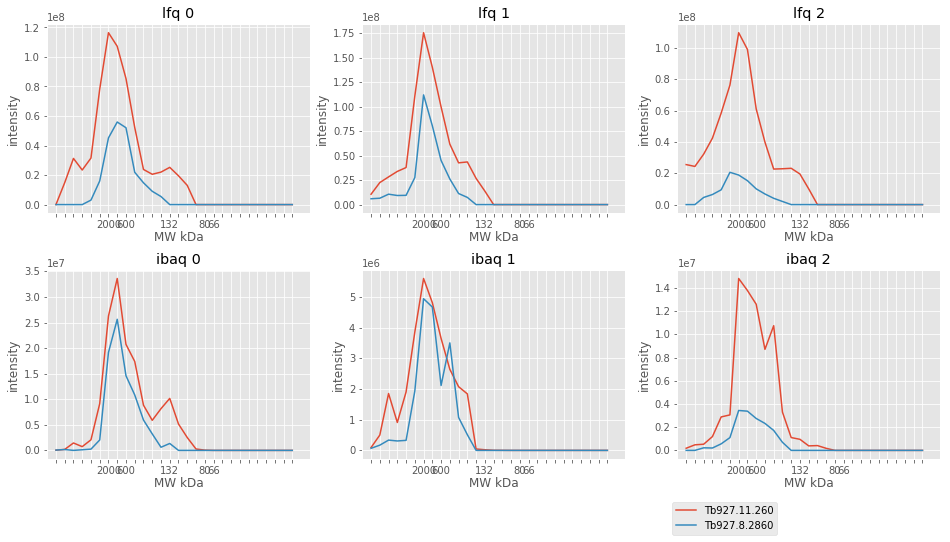

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.11.260                 149               0   
Tb927.8.2860                  99               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.11.260  Putative intraflagellar transport protein F6  
Tb927.8.2860               hypothetical protein, conserved  
21 40 44 ['Tb927.11.260', 'Tb927.8.2860']


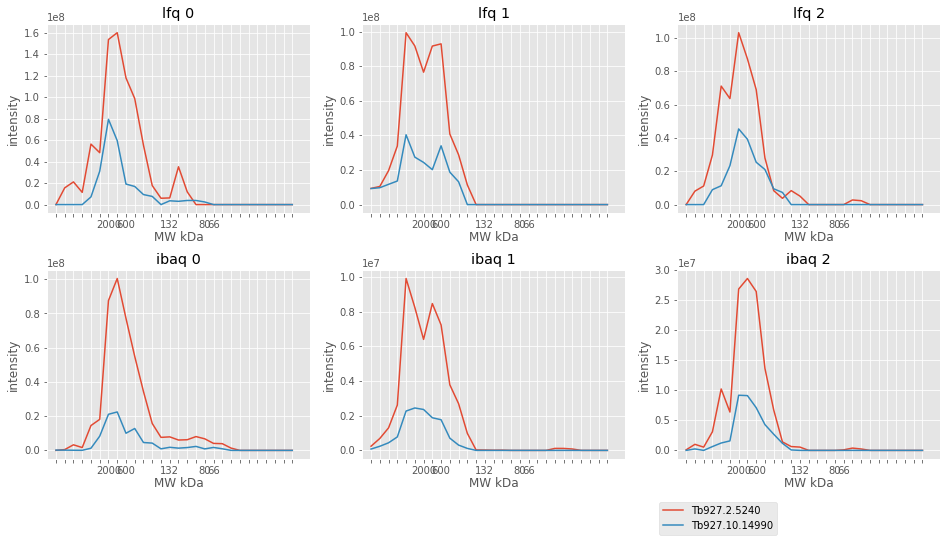

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.2.5240                    54               0   
Tb927.10.14990                  86               0   

                              [Product Description]  
[Input ID]                                           
Tb927.2.5240            pre-mRNA splicing factor 19  
Tb927.10.14990  intraflagellar transport protein 80  
21 38 42 ['Tb927.2.5240', 'Tb927.10.14990']


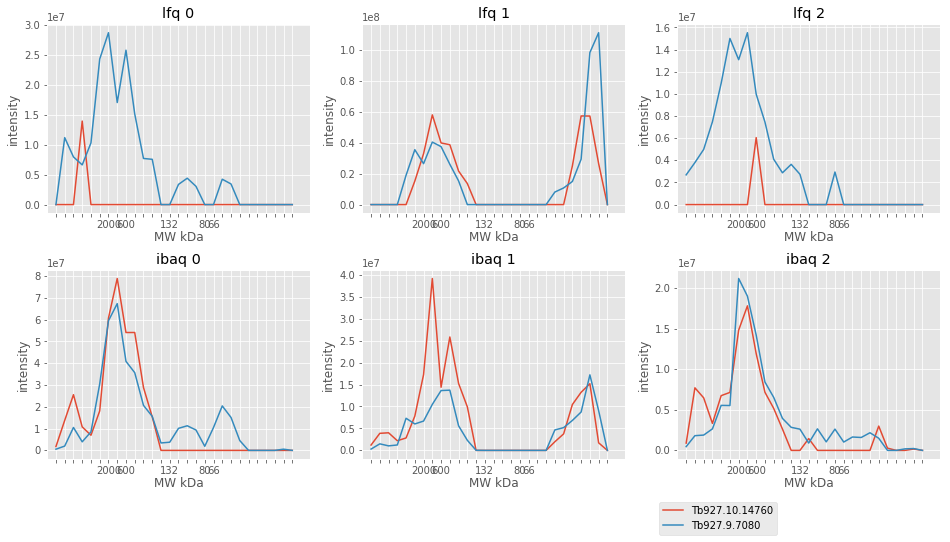

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.14760                  20               0   
Tb927.9.7080                    13               0   

                          [Product Description]  
[Input ID]                                       
Tb927.10.14760   clathrin light chain, putative  
Tb927.9.7080    hypothetical protein, conserved  
21 46 40 ['Tb927.10.14760', 'Tb927.9.7080']


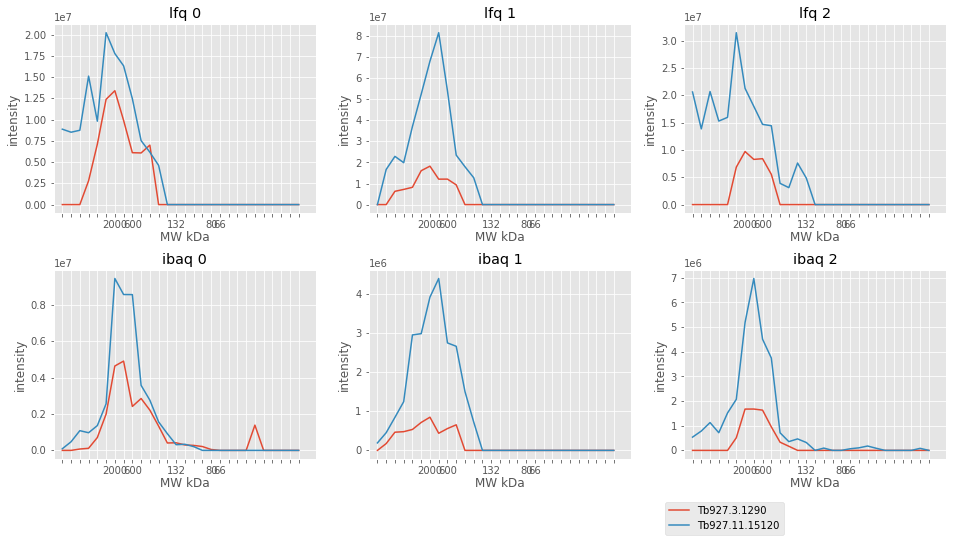

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.1290                   105               0   
Tb927.11.15120                  78               0   

                          [Product Description]  
[Input ID]                                       
Tb927.3.1290                cullin 4B, putative  
Tb927.11.15120  hypothetical protein, conserved  
21 36 42 ['Tb927.3.1290', 'Tb927.11.15120']


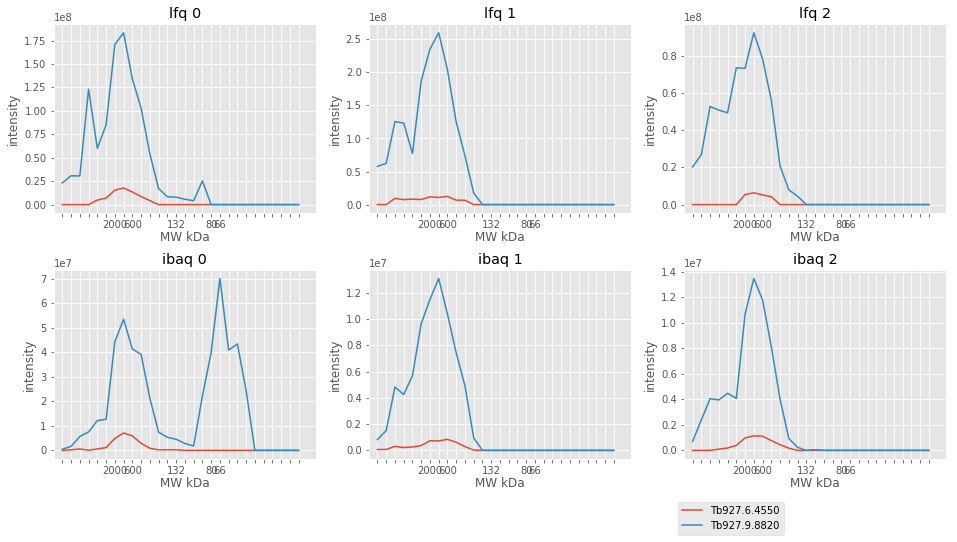

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.4550                  90               0   
Tb927.9.8820                 119               0   

                        [Product Description]  
[Input ID]                                     
Tb927.6.4550  hypothetical protein, conserved  
Tb927.9.8820  hypothetical protein, conserved  
22 42 39 ['Tb927.6.4550', 'Tb927.9.8820']


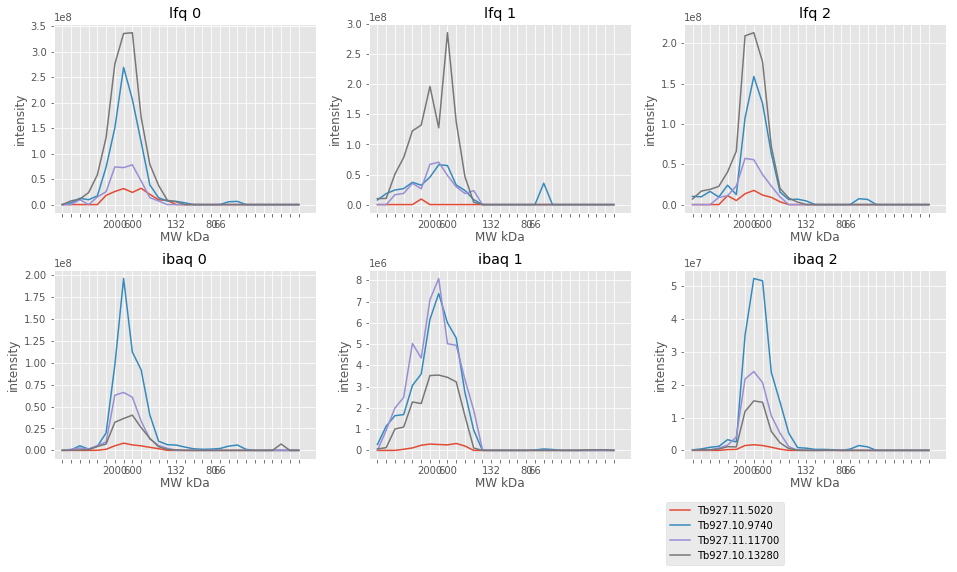

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.5020                  186               0   
Tb927.10.9740                   45               0   
Tb927.11.11700                  63               0   
Tb927.10.13280                 286               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.5020                 hypothetical protein, conserved  
Tb927.10.9740   Regulatory particle triple-A ATPase subunit 6  
Tb927.11.11700              nucleotidyl transferase, putative  
Tb927.10.13280                hypothetical protein, conserved  
22 42 42 ['Tb927.11.5020', 'Tb927.10.9740', 'Tb927.11.11700', 'Tb927.10.13280']


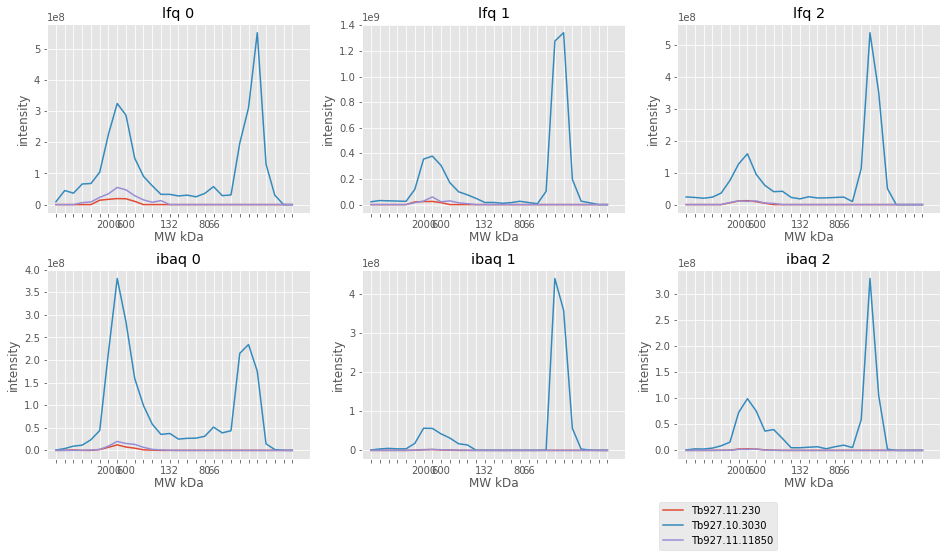

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.230                    90               0   
Tb927.10.3030                   33               0   
Tb927.11.11850                 122               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.230    cleavage and polyadenylation specificity facto...  
Tb927.10.3030         proteasome regulatory non-ATPase subunit 11  
Tb927.11.11850             splicing factor 3B subunit 1, putative  
22 43 42 ['Tb927.11.230', 'Tb927.10.3030', 'Tb927.11.11850']


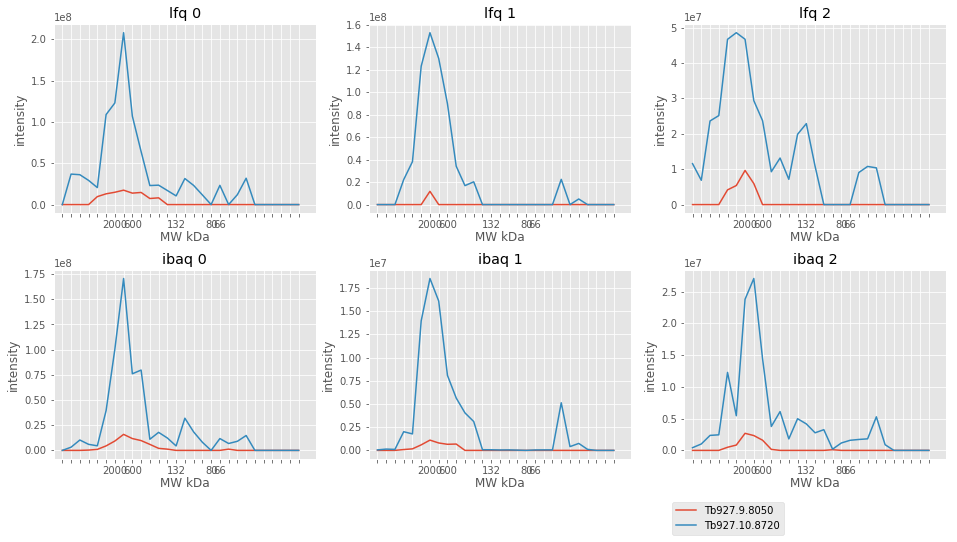

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.8050                   58               0   
Tb927.10.8720                  61               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.9.8050      Protein of unknown function (DUF974), putative  
Tb927.10.8720  CCR4-NOT transcription complex subunit 10, put...  
22 40 17 ['Tb927.9.8050', 'Tb927.10.8720']


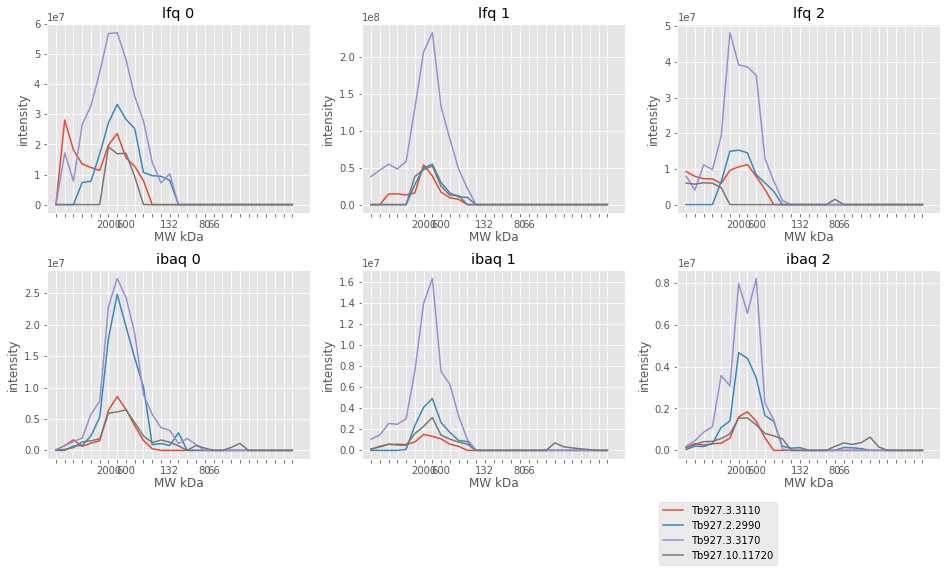

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.3110                   118               0   
Tb927.2.2990                    61               0   
Tb927.3.3170                    70               0   
Tb927.10.11720                  83               0   

                                [Product Description]  
[Input ID]                                             
Tb927.3.3110    Condensin complex subunit 3, putative  
Tb927.2.2990          hypothetical protein, conserved  
Tb927.3.3170          hypothetical protein, conserved  
Tb927.10.11720          CW-type Zinc Finger, putative  
22 40 40 ['Tb927.3.3110', 'Tb927.2.2990', 'Tb927.3.3170', 'Tb927.10.11720']


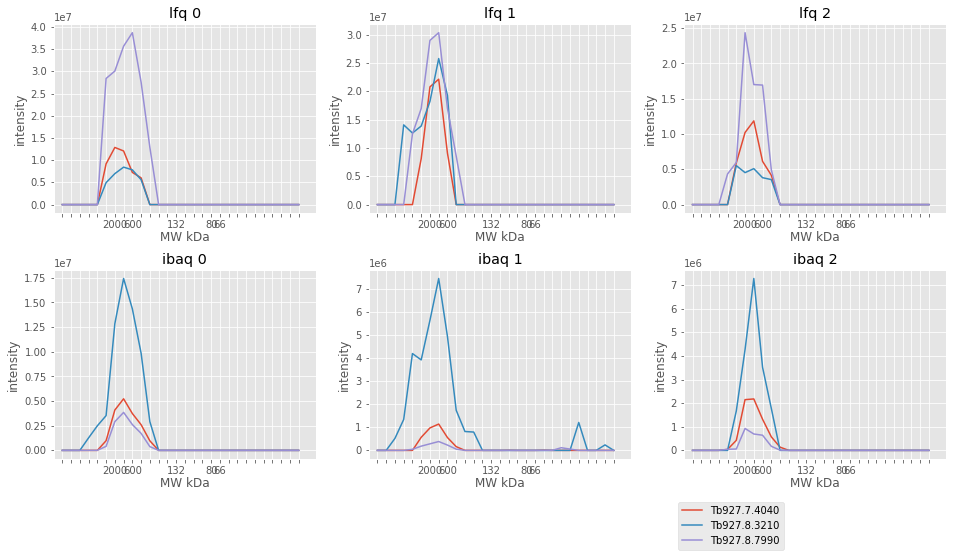

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.4040                  92               0   
Tb927.8.3210                  18               0   
Tb927.8.7990                 550               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.4040                    hypothetical protein, conserved  
Tb927.8.3210                    hypothetical protein, conserved  
Tb927.8.7990  Thioredoxin-like/Protein of unknown function (...  
22 40 41 ['Tb927.7.4040', 'Tb927.8.3210', 'Tb927.8.7990']


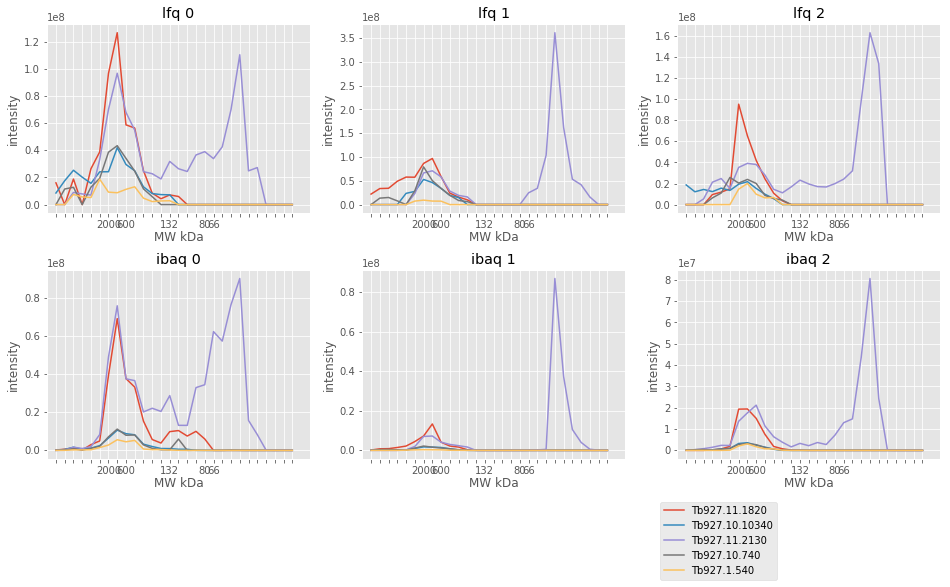

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.1820                   68               0   
Tb927.10.10340                 134               0   
Tb927.11.2130                   38               0   
Tb927.10.740                   154               0   
Tb927.1.540                    126               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.1820   translation initiation factor eIF2B delta subu...  
Tb927.10.10340   structural maintenance of chromosome 2, putative  
Tb927.11.2130         proteasome regulatory non-ATP-ase subunit 3  
Tb927.10.740     structural maintenance of chromosome 4, putative  
Tb927.1.540             DNA-directed RNA polymerase III, putative  
22 40 42 ['Tb927.11.1820', 'Tb927.10.10340', 'Tb927.11.2130', 'Tb927.10.740', 'Tb927.1.540']


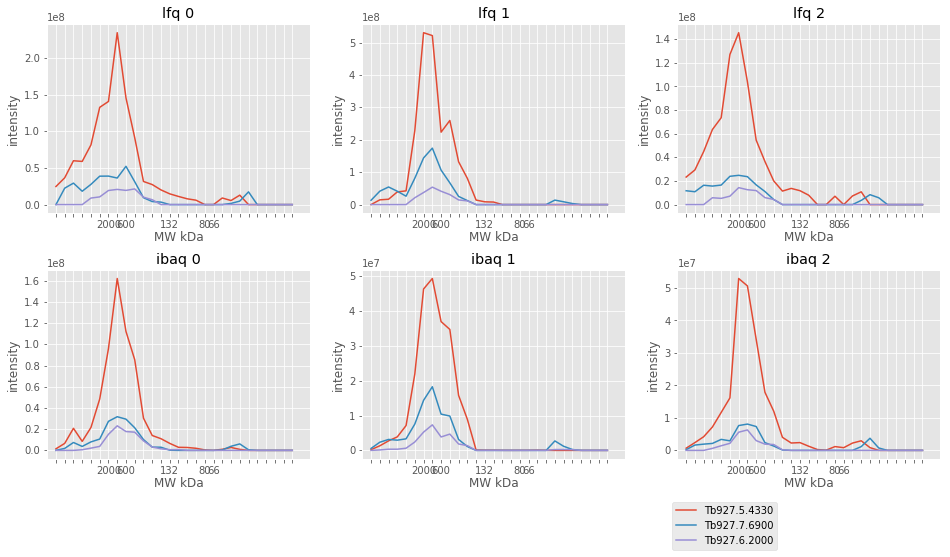

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.4330                  47               0   
Tb927.7.6900                  63               0   
Tb927.6.2000                  50               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.4330  dihydrolipoamide branched chain transacylase, ...  
Tb927.7.6900                Sister chromatid cohesion protein 1  
Tb927.6.2000           spliceosome-associated protein, putative  
22 44 40 ['Tb927.5.4330', 'Tb927.7.6900', 'Tb927.6.2000']


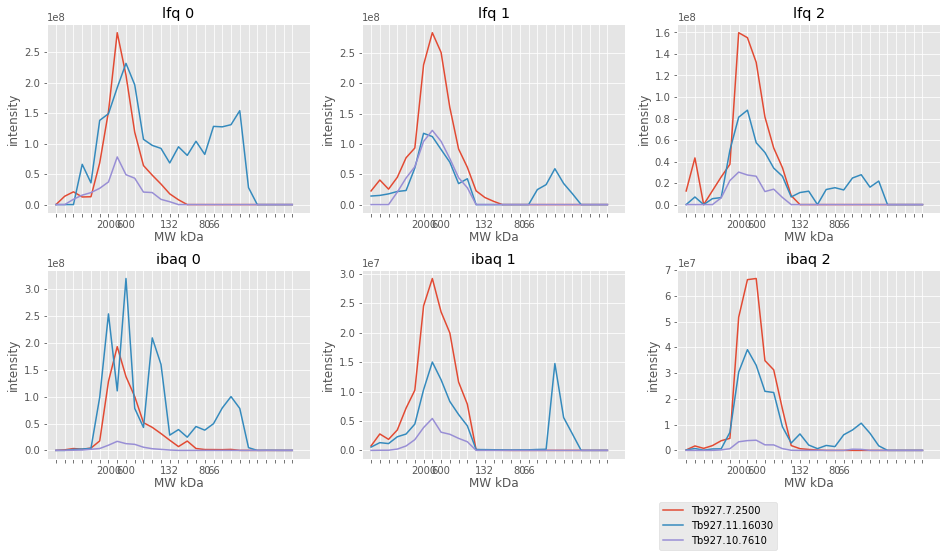

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.2500                    48               0   
Tb927.11.16030                  45               0   
Tb927.10.7610                  165               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.7.2500               proteasome regulatory ATPase subunit 1  
Tb927.11.16030        proteasome regulatory non-ATP-ase subunit 7  
Tb927.10.7610   NADH-ubiquinone oxidoreductase complex I subun...  
22 44 44 ['Tb927.7.2500', 'Tb927.11.16030', 'Tb927.10.7610']


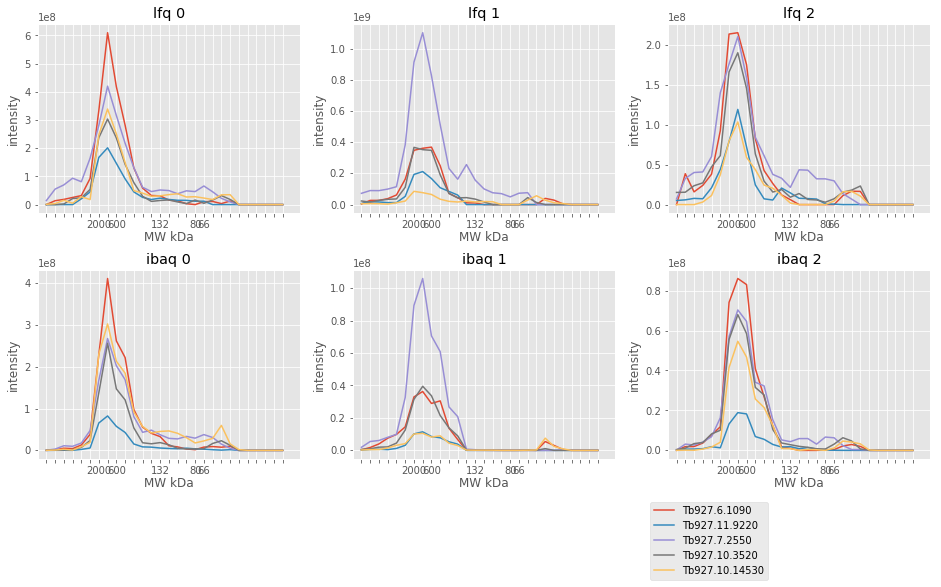

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.1090                    44               0   
Tb927.11.9220                  106               0   
Tb927.7.2550                    49               0   
Tb927.10.3520                   44               0   
Tb927.10.14530                  42               0   

                                      [Product Description]  
[Input ID]                                                   
Tb927.6.1090         proteasome regulatory ATPase subunit 3  
Tb927.11.9220   proteasome regulatory non-ATP-ase subunit 2  
Tb927.7.2550         proteasome regulatory ATPase subunit 5  
Tb927.10.3520          protease regulatory ATPase subunit 4  
Tb927.10.14530          19S proteasome non-atpase subunit 8  
22 44 42 ['Tb927.6.1090', 'Tb927.11.9220', 'Tb927.7.2550', 'Tb927.10.3520', 'Tb927.10.14530']


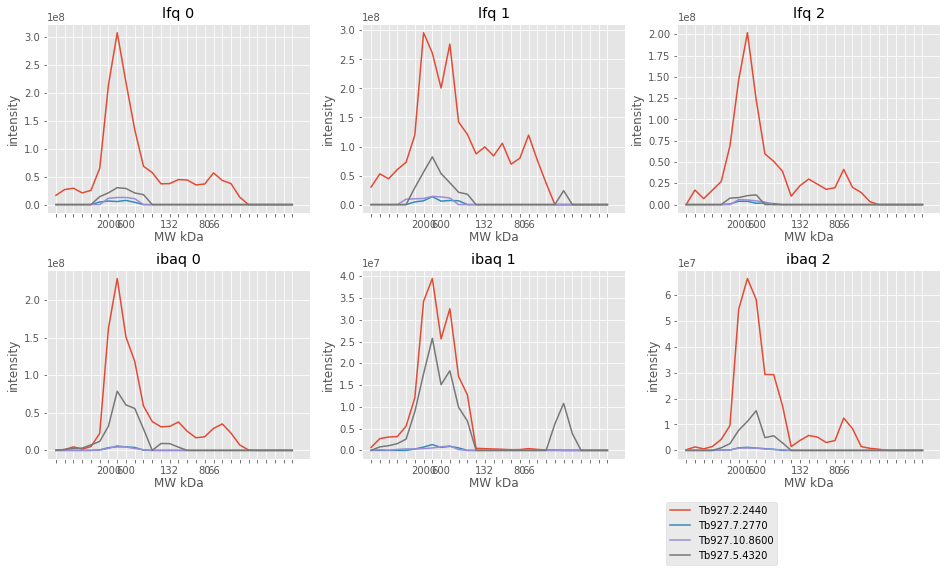

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.2.2440                   57               0   
Tb927.7.2770                   44               0   
Tb927.10.8600                 119               0   
Tb927.5.4320                   31               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.2.2440   proteasome regulatory non-ATPase subunit 6  
Tb927.7.2770              hypothetical protein, conserved  
Tb927.10.8600                Vps54-like protein, putative  
Tb927.5.4320         Pre-mRNA polyadenylation factor FIP1  
22 46 42 ['Tb927.2.2440', 'Tb927.7.2770', 'Tb927.10.8600', 'Tb927.5.4320']


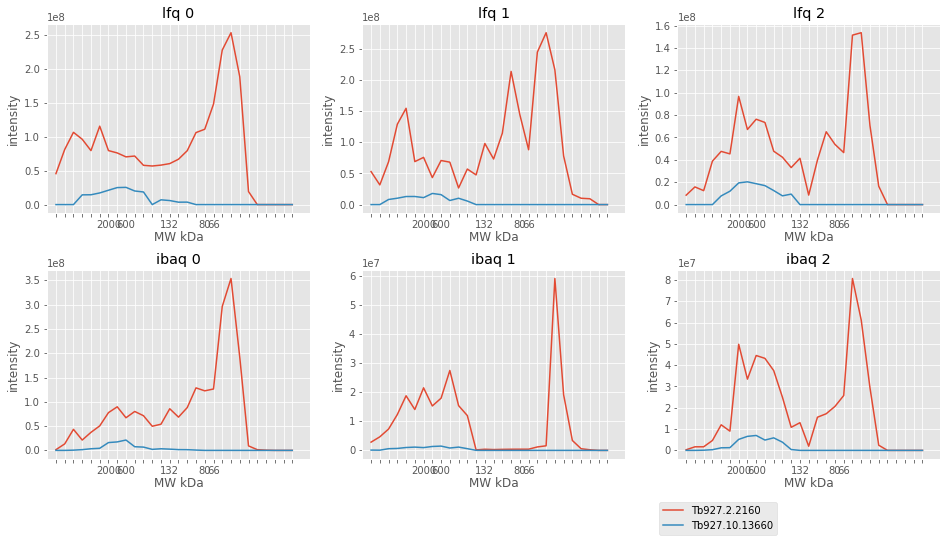

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.2.2160                    37               0   
Tb927.10.13660                  81               5   

                                     [Product Description]  
[Input ID]                                                  
Tb927.2.2160         paraflagellar rod component, putative  
Tb927.10.13660  Domain of unknown function DUF21, putative  
22 47 34 ['Tb927.2.2160', 'Tb927.10.13660']


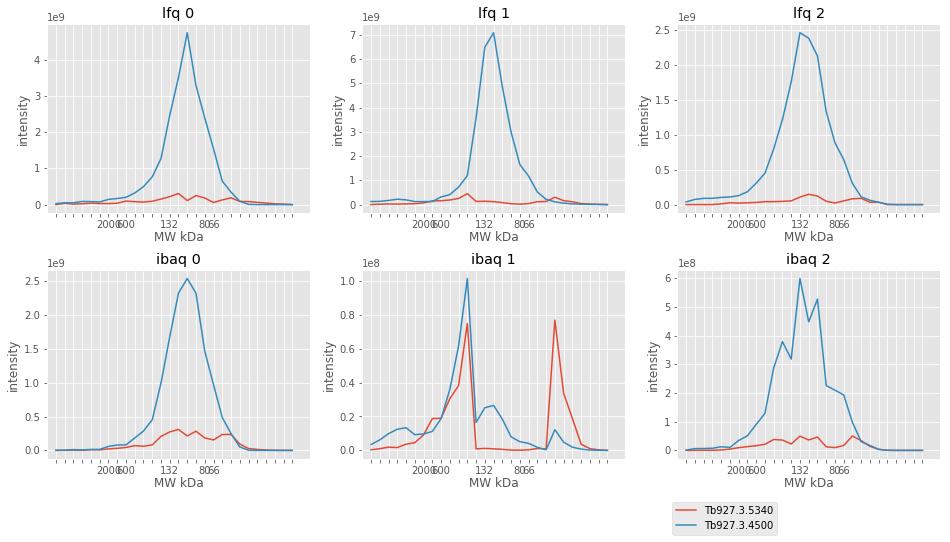

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.5340                  42               0   
Tb927.3.4500                  62               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.3.5340  Hsc70-interacting protein (Hip), putative  
Tb927.3.4500      Fumarate hydratase class I, cytosolic  
45 35 14 ['Tb927.3.5340', 'Tb927.3.4500']


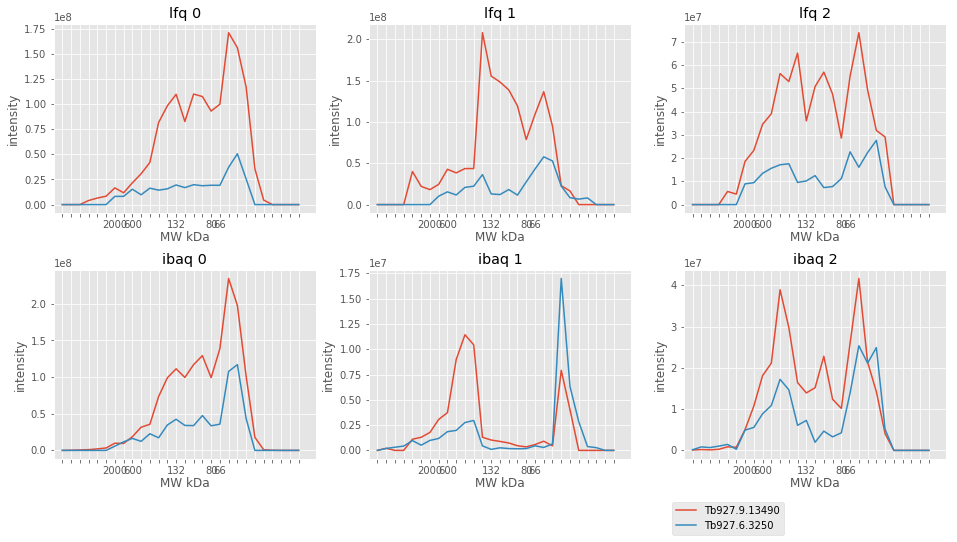

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.13490                  54               0   
Tb927.6.3250                   35               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.9.13490      metallo-peptidase, Clan MG, Family M24  
Tb927.6.3250   C2H2 type zinc-finger (2 copies), putative  
45 31 46 ['Tb927.9.13490', 'Tb927.6.3250']


KeyboardInterrupt: 

In [208]:
cfile = open('ibaq_complexes.txt','w')
plt.style.use('ggplot')
df_1 = pd.read_csv('ibaq_0_2.5.csv',index_col=[0])
df_2 = pd.read_csv('ibaq_1_2.5.csv',index_col=[0])
df_3 = pd.read_csv('ibaq_2_2.5.csv',index_col=[0])
find_complex(df_1, df_2, df_3, cfile, gene_table)
cfile.close()   
cfile.close()   

In [ ]:
plt.style.use('ggplot')
df_1 = pd.read_csv('ibaq_0_2.5.csv',index_col=[0])
df_2 = pd.read_csv('ibaq_1_2.5.csv',index_col=[0])
df_3 = pd.read_csv('ibaq_2_2.5.csv',index_col=[0])

cfile = open('ibaq_complexes_01.txt','w')
find_complex_2(df_1, df_2, cfile, gene_table)
cfile.close()  

cfile = open('ibaq_complexes_02.txt','w')
find_complex_2(df_1, df_3, cfile, gene_table)
cfile.close()  

cfile = open('ibaq_complexes_12.txt','w')
find_complex_2(df_2, df_3, cfile, gene_table)
cfile.close() 

In [31]:
#len(desc_dict)

11075

1752


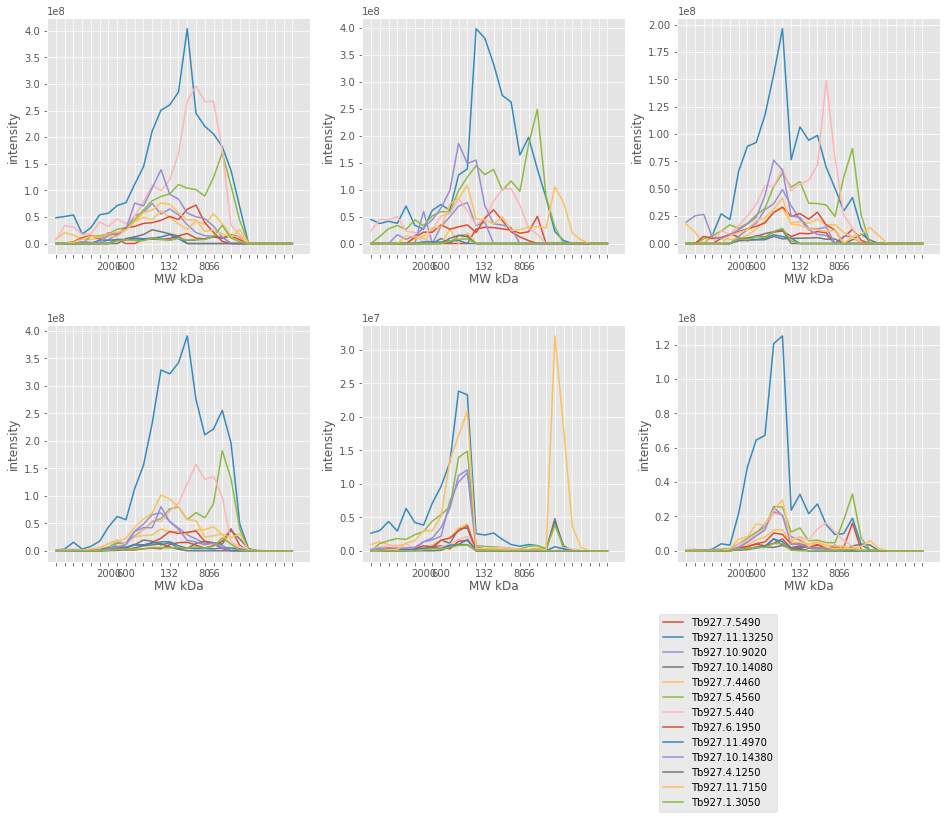

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.5490                    44               0   
Tb927.11.13250                  52               0   
Tb927.10.9020                   52               0   
Tb927.10.14080                  37               0   
Tb927.7.4460                    91               0   
Tb927.5.4560                    55               0   
Tb927.5.440                     84               1   
Tb927.6.1950                    95               0   
Tb927.11.4970                   51               0   
Tb927.10.14380                  92               0   
Tb927.4.1250                    99               0   
Tb927.11.7150                   30               0   
Tb927.1.3050                    61               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.7.5490               protein arginine n-methylt

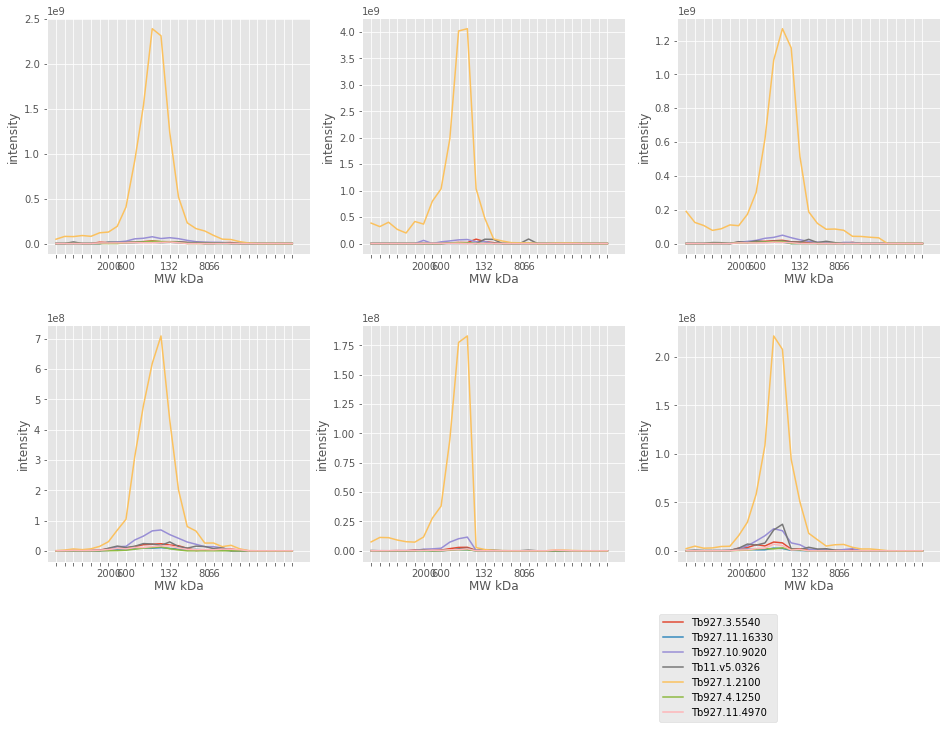

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.5540                    58               0   
Tb927.11.16330                 103               0   
Tb927.10.9020                   52               0   
Tb11.v5.0326                    34               0   
Tb927.1.2100                   126               0   
Tb927.4.1250                    99               0   
Tb927.11.4970                   51               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.3.5540          dynein intermediate chain WDRD34, putative  
Tb927.11.16330                   hypothetical protein, conserved  
Tb927.10.9020                            Gcd10p family, putative  
Tb11.v5.0326    retrotransposon hot spot (RHS) protein, putative  
Tb927.1.2100                            Calpain-like protein 1.1  
Tb927.4.1250            peroxisome biogenesi

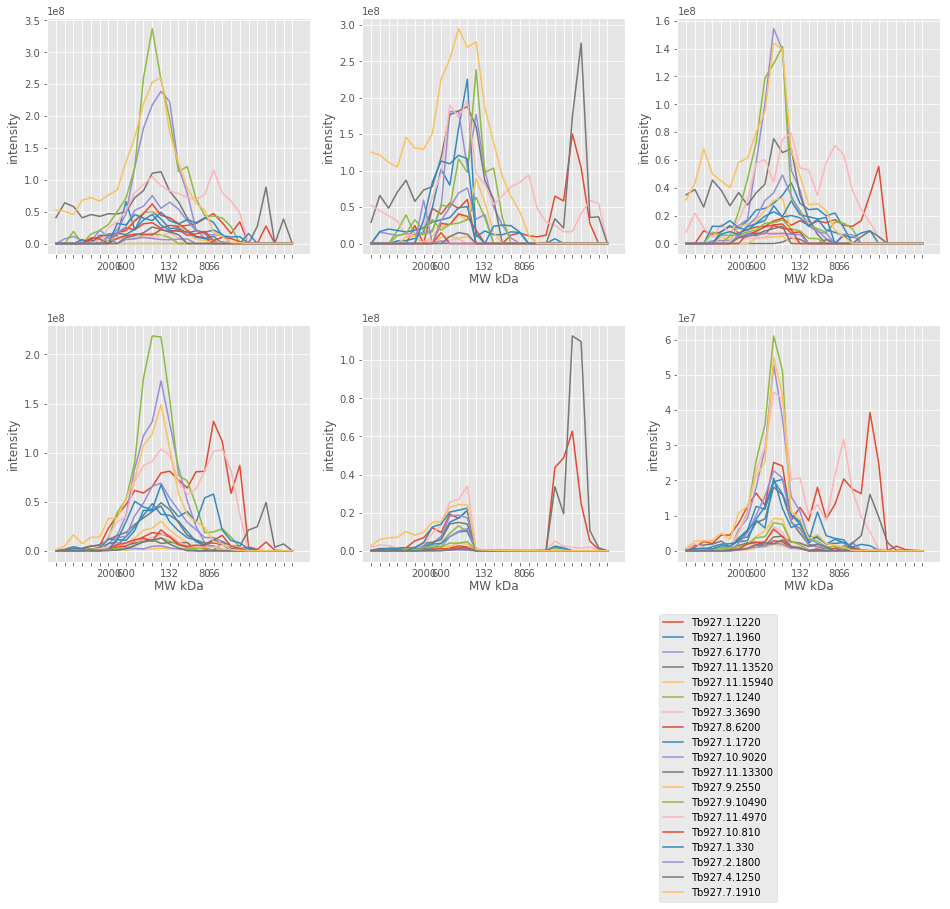

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.1220                    25               0   
Tb927.1.1960                    75               0   
Tb927.6.1770                    69               0   
Tb927.11.13520                 105               1   
Tb927.11.15940                 105               0   
Tb927.1.1240                    65               0   
Tb927.3.3690                    60               0   
Tb927.8.6200                   147               0   
Tb927.1.1720                    43               0   
Tb927.10.9020                   52               0   
Tb927.11.13300                  16               0   
Tb927.9.2550                   113               0   
Tb927.9.10490                   65               0   
Tb927.11.4970                   51               0   
Tb927.10.810                    67               0   
Tb927.1.330                     30               0   
Tb927.2.1800                

In [205]:
import networkx as nx
import itertools
G = nx.Graph()
def populate(G,f,desc_dict):
    for line in open(f):
        proteins = line.split('\t')[2].split(',')
        for prot in proteins:
             G.add_node(prot, desc=desc_dict[prot])
        for edge in itertools.combinations(proteins,2):
             G.add_edge(*edge)
populate(G,'ibaq_complexes_01.txt',desc_dict)
populate(G,'ibaq_complexes_02.txt',desc_dict)
populate(G,'ibaq_complexes_12.txt',desc_dict)
find_cliques = [n for n in nx.find_cliques(G)]
print(len(find_cliques))

for prots in find_cliques:
    if 'Tb927.11.4970' in prots:
        fig,axes = plt.subplots(ncols=3,nrows=2,figsize=(16,10))

        plot_line(res['lfq']['exp_list'][0].loc[prots], axes[0,0])
        plot_line(res['lfq']['exp_list'][1].loc[prots], axes[0,1])
        plot_line(res['lfq']['exp_list'][2].loc[prots], axes[0,2])

        plot_line(res['ibaq']['exp_list'][0].loc[prots], axes[1,0])
        plot_line(res['ibaq']['exp_list'][1].loc[prots], axes[1,1])
        plot_line(res['ibaq']['exp_list'][2].loc[prots], axes[1,2])
        plt.subplots_adjust(wspace=0.2)
        plt.subplots_adjust(hspace=0.3)
        plt.legend(bbox_to_anchor=(0.4, -0.2))
        plt.show()
        gt = gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[list(prots)]
        gt = gt.drop_duplicates()
        print (gt)
        print ('_____________________')

2

In [30]:
import networkx as nx
G = nx.Graph()
nodes = list(set(list(tempv['p_1'].values)+list(tempv['p_2'].values)))
for a in nodes:
    G.add_node(a, desc=desc_dict[a])
for a, b in zip(tempv['p_1'].values, tempv['p_2'].values):
    G.add_edge(*(a, b))
find_cliques = [n for n in nx.find_cliques(G)]
len(find_cliques) 

NameError: name 'tempv' is not defined

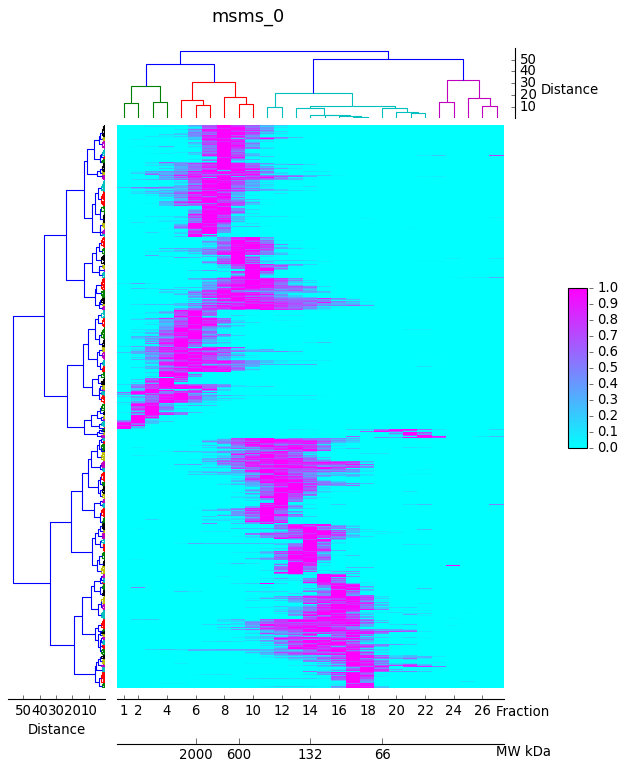

In [47]:
import warnings
warnings.filterwarnings("ignore")
temp = res['msms']['exp_filter_mw'][0].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='msms_0',
     fig_name = 'msms_0.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('msms_0_2.5.csv')

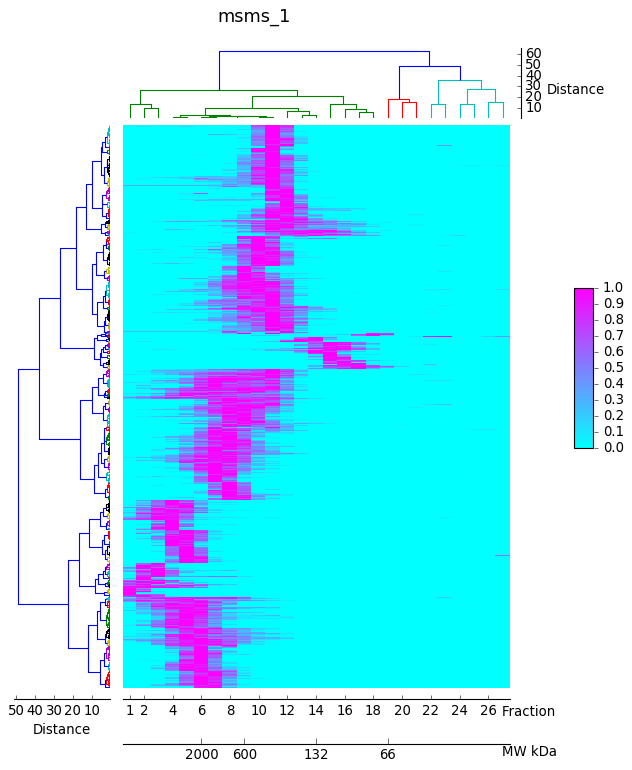

In [48]:
import warnings
warnings.filterwarnings("ignore")
temp = res['msms']['exp_filter_mw'][1].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='msms_1',
     fig_name = 'msms_1.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('msms_1_2.5.csv')

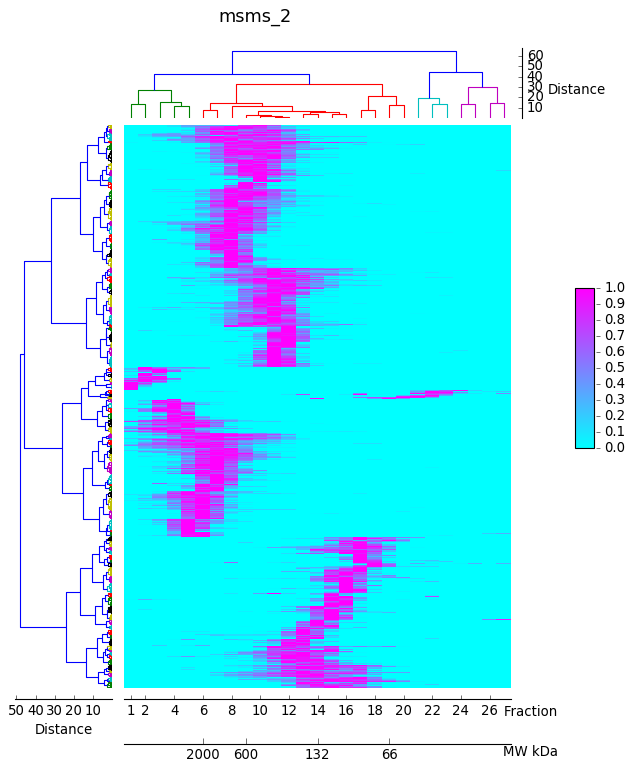

In [49]:
import warnings
warnings.filterwarnings("ignore")
temp = res['msms']['exp_filter_mw'][2].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='msms_2',
     fig_name = 'msms_2.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('msms_2_2.5.csv')

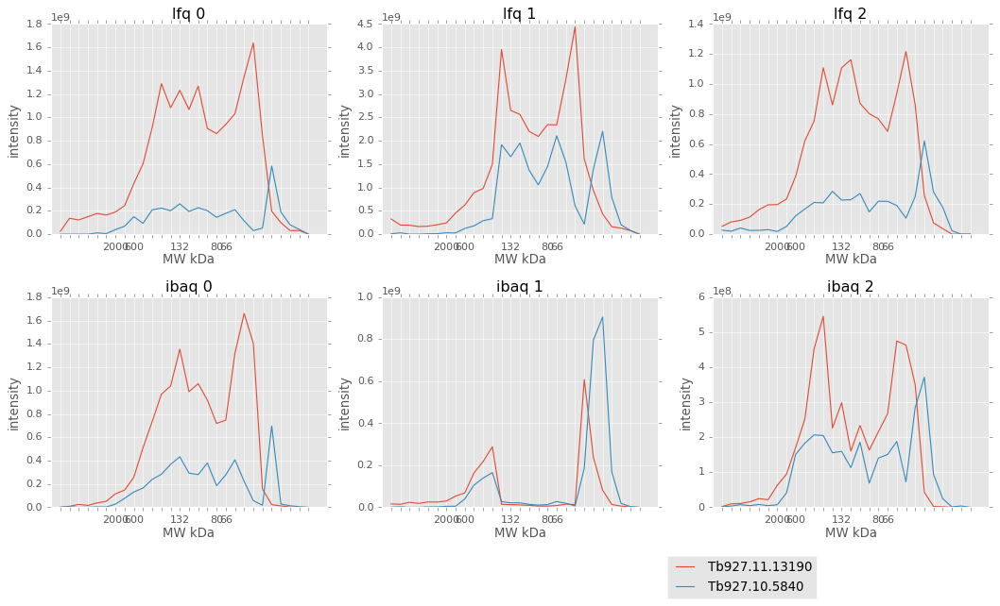

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.13190                  46               0   
Tb927.10.5840                   21               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.11.13190             elongation factor 1 gamma, putative  
Tb927.10.5840   translation elongation factor 1-beta, putative  
14 68 6 ['Tb927.11.13190', 'Tb927.10.5840']


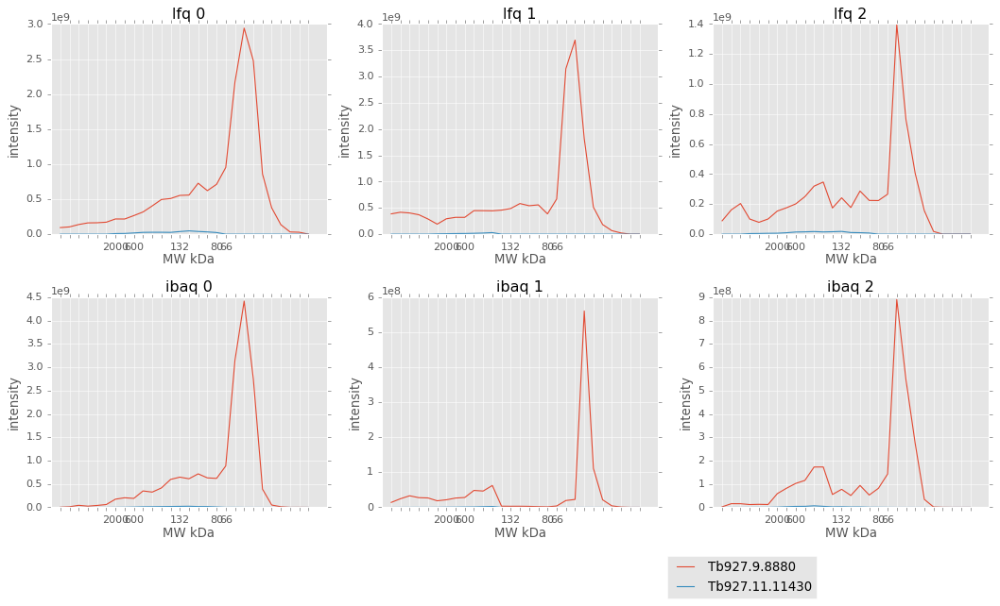

                [Molecular Weight]  [# TM Domains] [Product Description]
[Input ID]                                                              
Tb927.9.8880                    41               0               actin B
Tb927.11.11430                  91               0    cullin 1, putative
14 53 76 ['Tb927.9.8880', 'Tb927.11.11430']


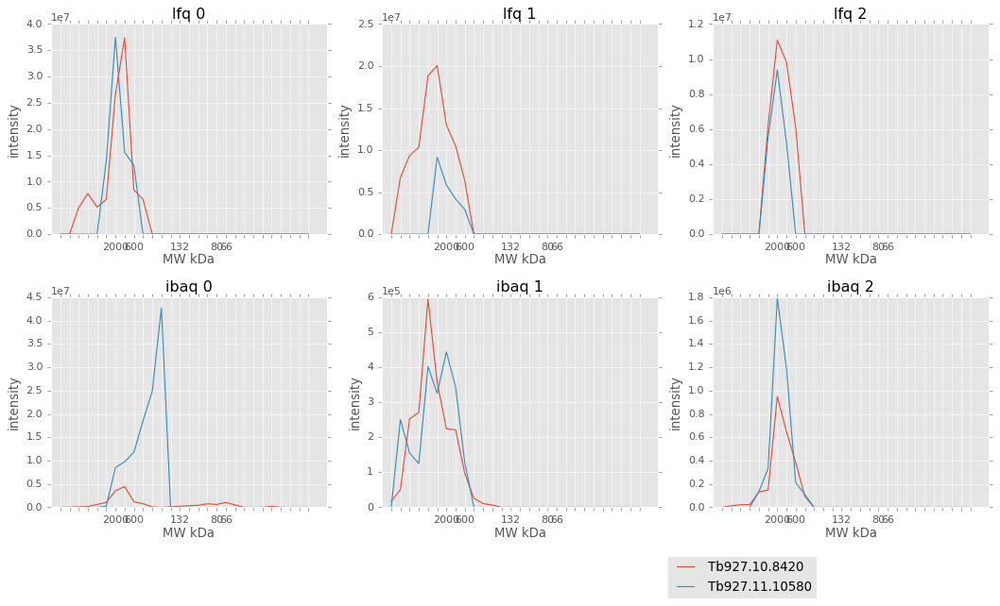

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.8420                  271               0   
Tb927.11.10580                  99               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.8420                  Phosphatidylinositol 3-kinase tor1  
Tb927.11.10580  COG (conserved oligomeric Golgi) complex compo...  
84 4 39 ['Tb927.10.8420', 'Tb927.11.10580']


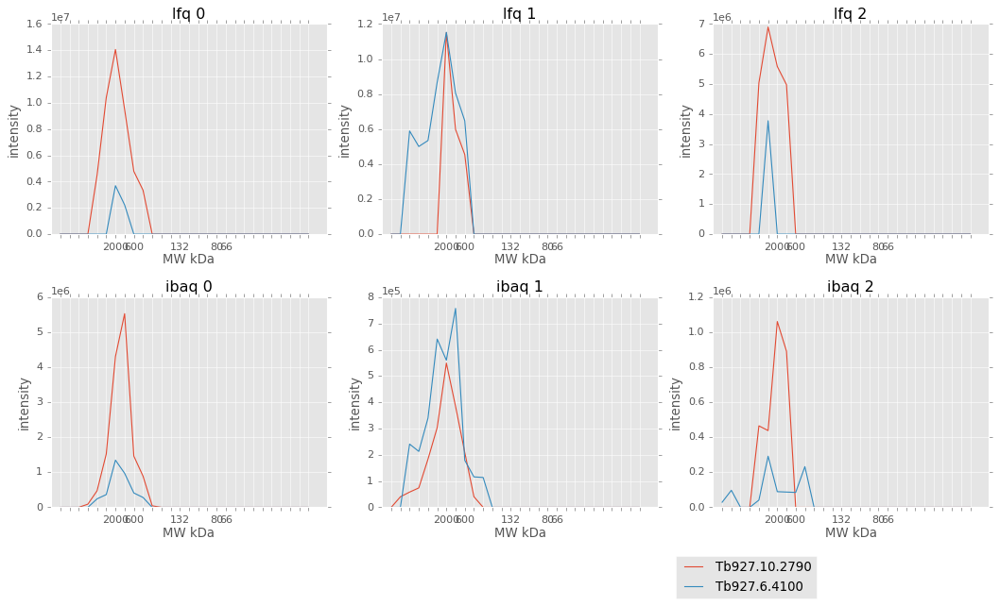

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.2790                 115               0   
Tb927.6.4100                   94               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.10.2790  Conserved oligomeric complex COG6, putative  
Tb927.6.4100               hypothetical protein, conserved  
84 27 34 ['Tb927.10.2790', 'Tb927.6.4100']


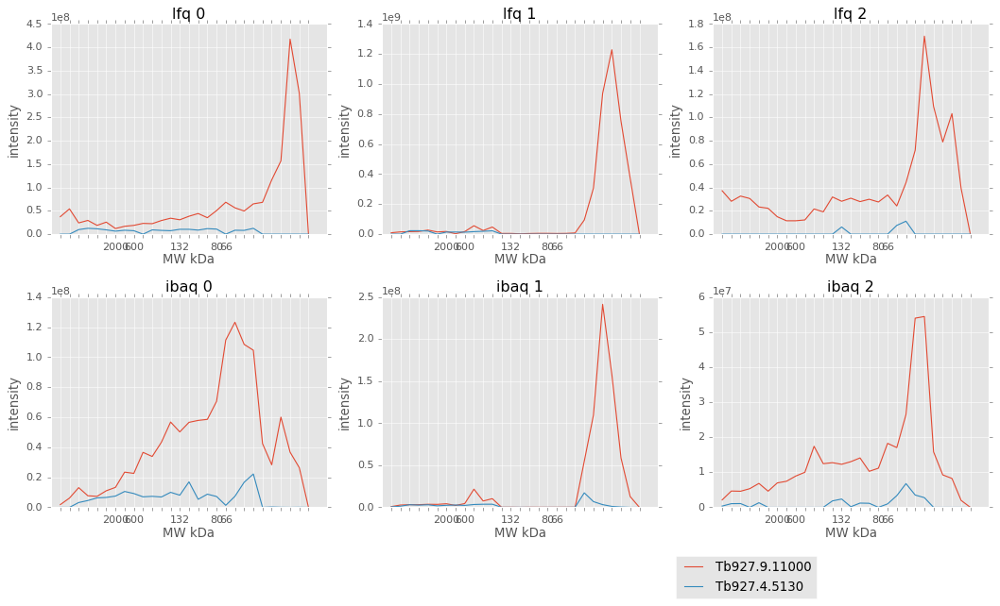

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.11000                  23               0   
Tb927.4.5130                   28               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.9.11000                 ras-related protein RAB7, putative  
Tb927.4.5130   KH domain/Domain of unknown function (DUF1771)...  
2 70 57 ['Tb927.9.11000', 'Tb927.4.5130']


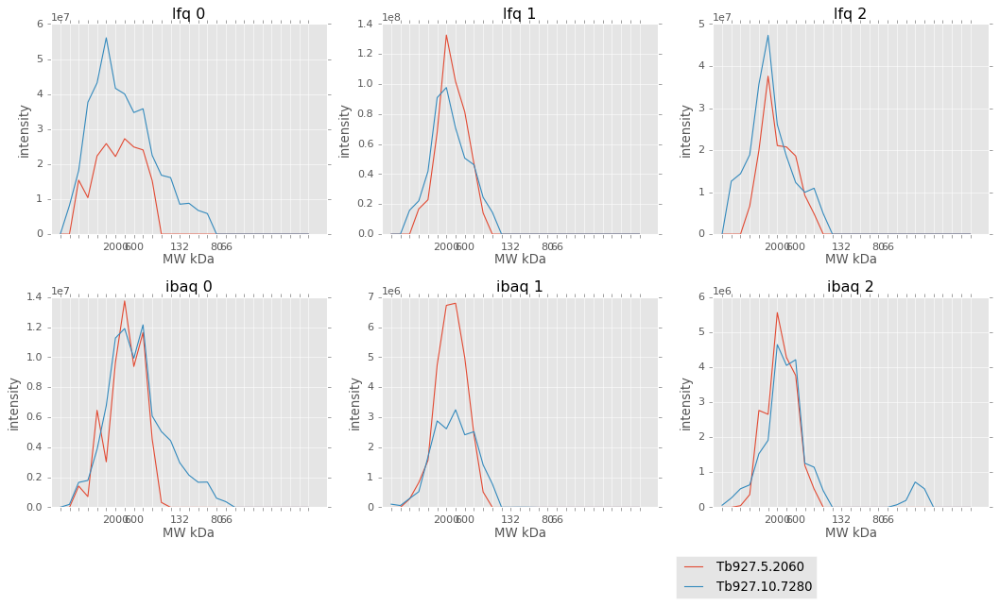

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.5.2060                   80               0   
Tb927.10.7280                 121               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.5.2060                  Cell division cycle 5-like protein  
Tb927.10.7280  pre-mRNA splicing factor ATP-dependent RNA hel...  
90 31 41 ['Tb927.5.2060', 'Tb927.10.7280']


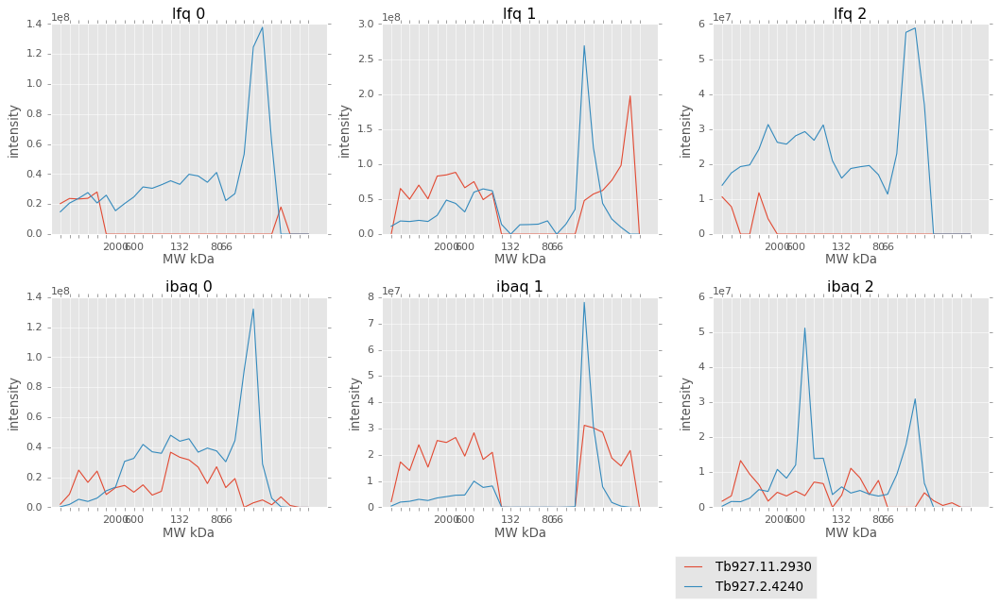

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.2930                  13               0   
Tb927.2.4240                   40               0   

                               [Product Description]  
[Input ID]                                            
Tb927.11.2930  membrane-associated protein, putative  
Tb927.2.4240           GTP binding protein, putative  
55 57 20 ['Tb927.11.2930', 'Tb927.2.4240']


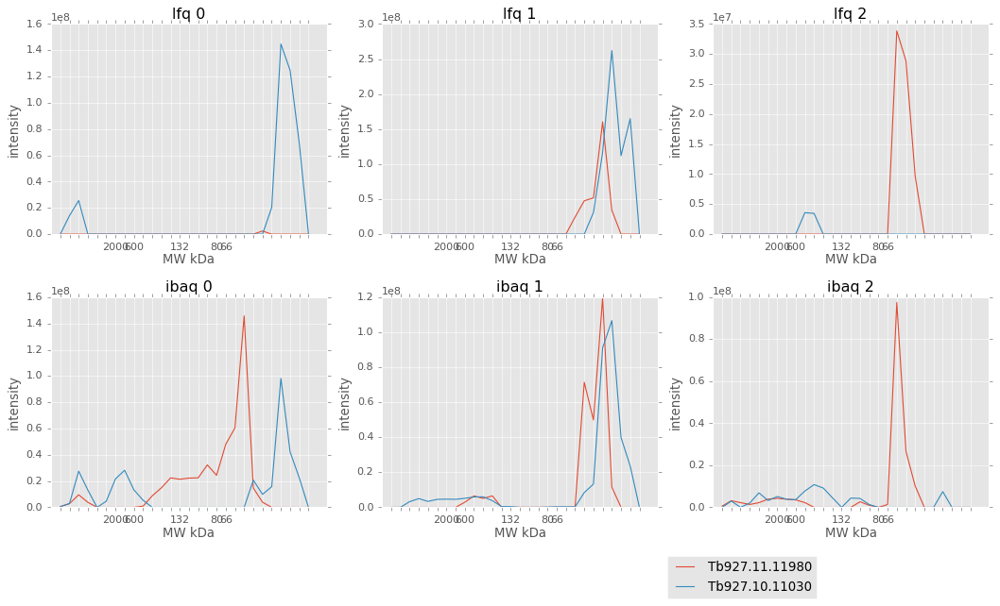

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11980                  14               0   
Tb927.10.11030                  11               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.11980                 cytoskeleton-associated protein 15  
Tb927.10.11030  Archaic translocase of outer membrane 11 kDa s...  
55 70 87 ['Tb927.11.11980', 'Tb927.10.11030']


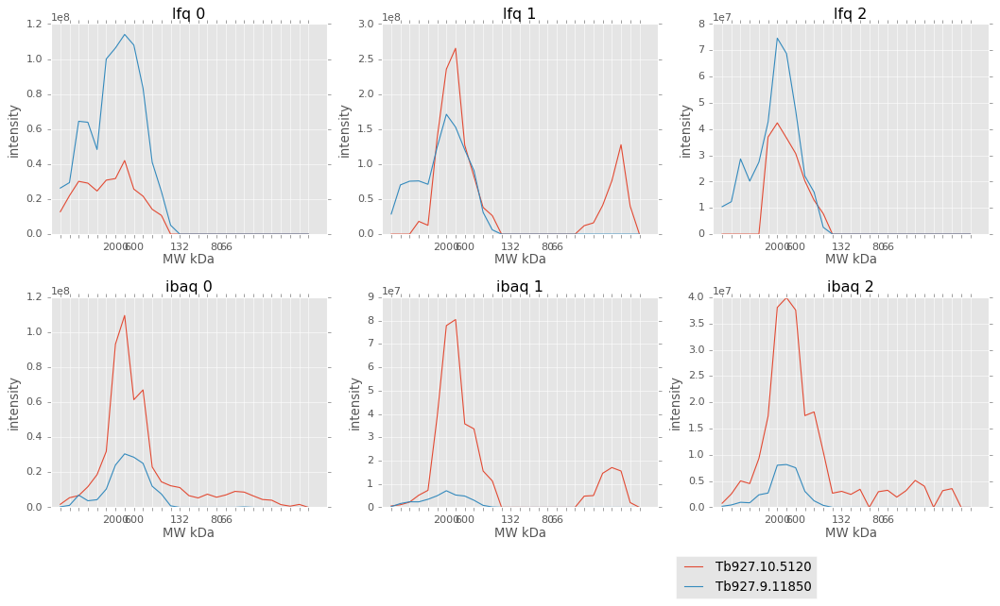

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.5120                  18               0   
Tb927.9.11850                 144               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.10.5120                                            KREPA6  
Tb927.9.11850  structural maintenance of chromosome 1, putative  
55 31 41 ['Tb927.10.5120', 'Tb927.9.11850']


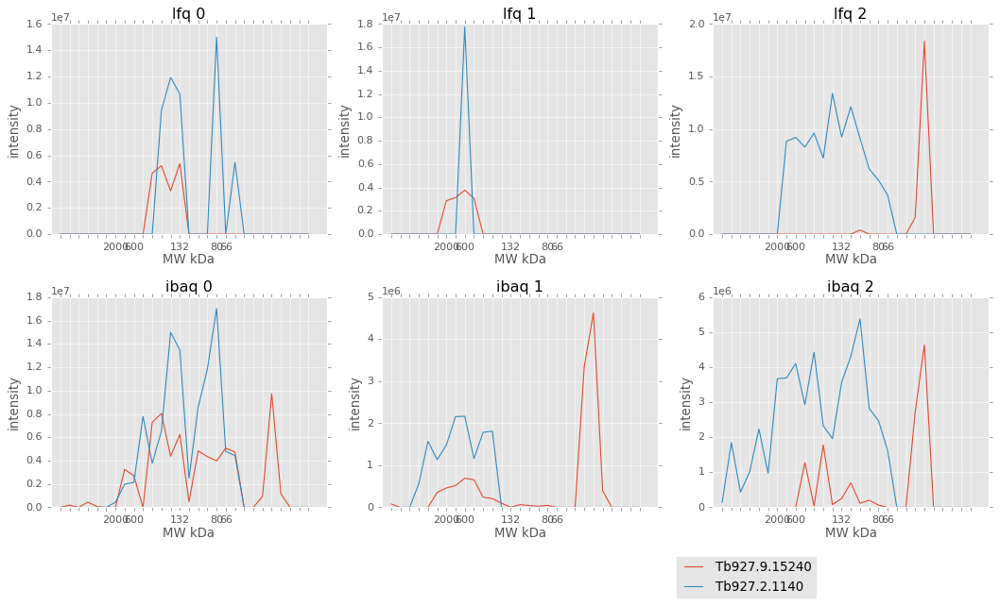

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.15240                  28               0   
Tb927.2.1140                   37               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.9.15240                            ATP11 protein, putative  
Tb927.2.1140   retrotransposon hot spot protein 3 (RHS3), int...  
3 27 21 ['Tb927.9.15240', 'Tb927.2.1140']


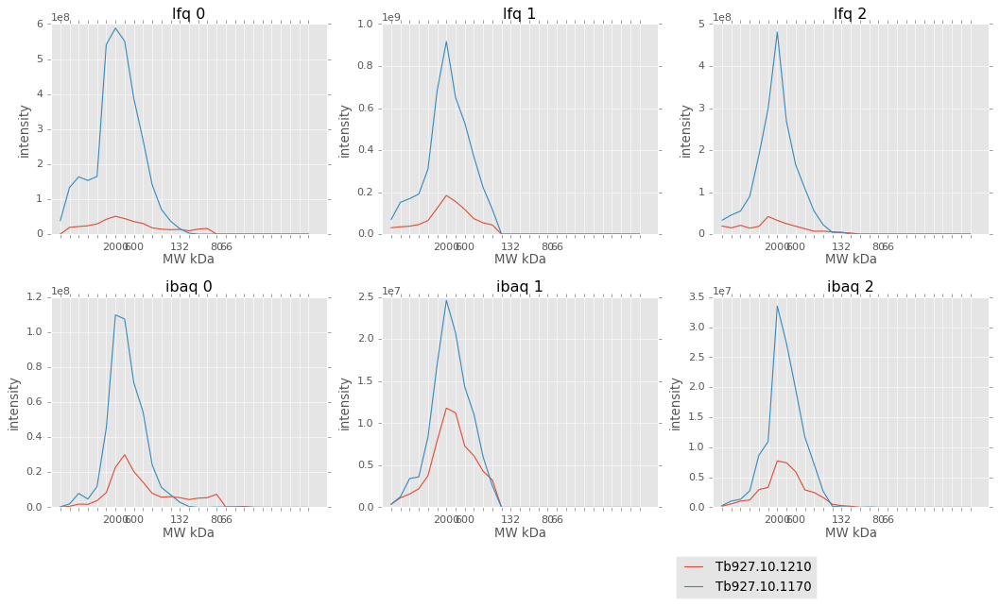

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.1210                  75               0   
Tb927.10.1170                 196               0   

                              [Product Description]  
[Input ID]                                           
Tb927.10.1210                     katanin, putative  
Tb927.10.1170  intraflagellar transport protein 172  
87 30 41 ['Tb927.10.1210', 'Tb927.10.1170']


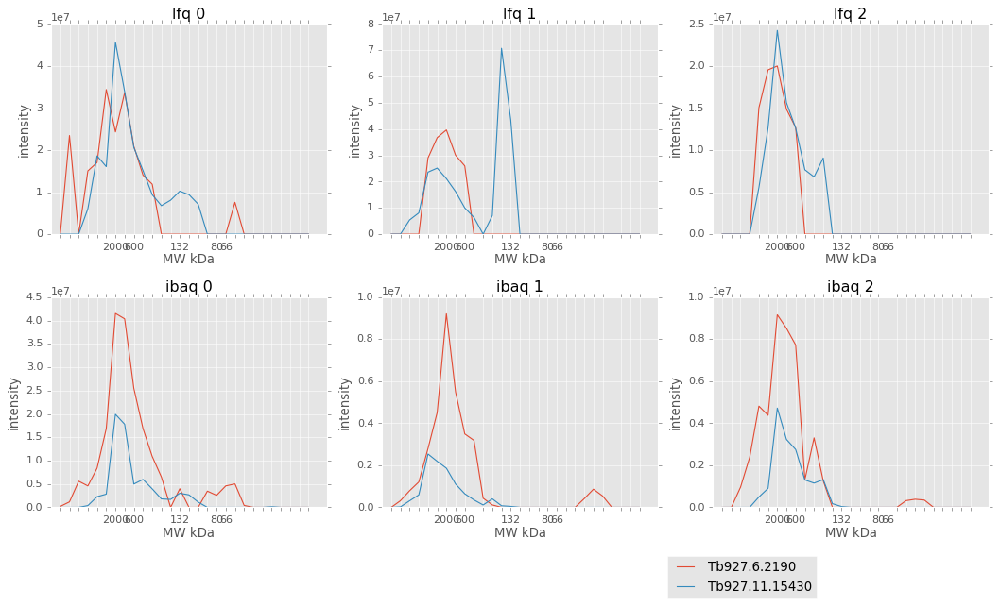

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.2190                    31               0   
Tb927.11.15430                 105               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.6.2190                      hypothetical protein, conserved  
Tb927.11.15430  U5 small nuclear ribonucleoprotein component, ...  
87 4 79 ['Tb927.6.2190', 'Tb927.11.15430']


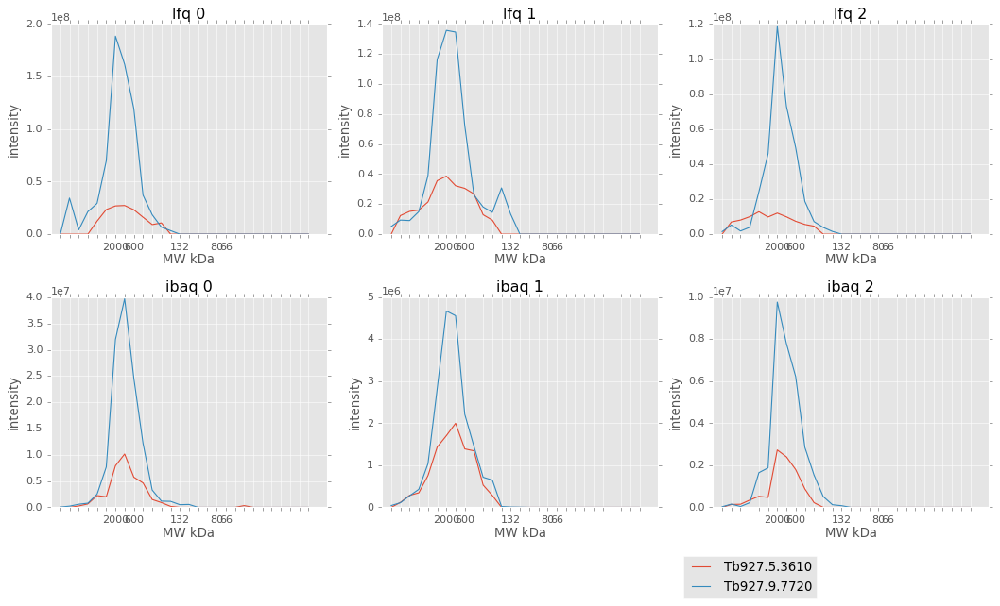

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.3610                 125               1   
Tb927.9.7720                 152               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.3610  adaptor complex protein (AP) 3 delta subunit 1...  
Tb927.9.7720         predicted tetratricopeptide repeat protein  
87 28 79 ['Tb927.5.3610', 'Tb927.9.7720']


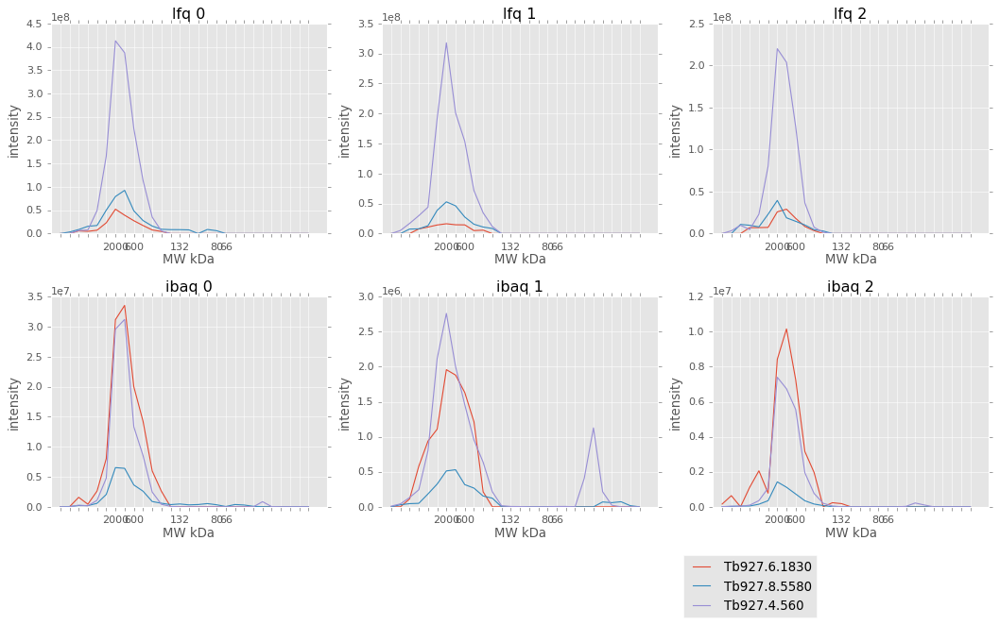

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.1830                  49               0   
Tb927.8.5580                 526               0   
Tb927.4.560                  479               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.6.1830   Cleavage stimulation factor subunit 50, putative  
Tb927.8.5580  N-terminal region of Chorein, a TM vesicle-med...  
Tb927.4.560   Cytoplasmic dynein 2 heavy chain (DYNC2H1), pu...  
87 31 79 ['Tb927.6.1830', 'Tb927.8.5580', 'Tb927.4.560']


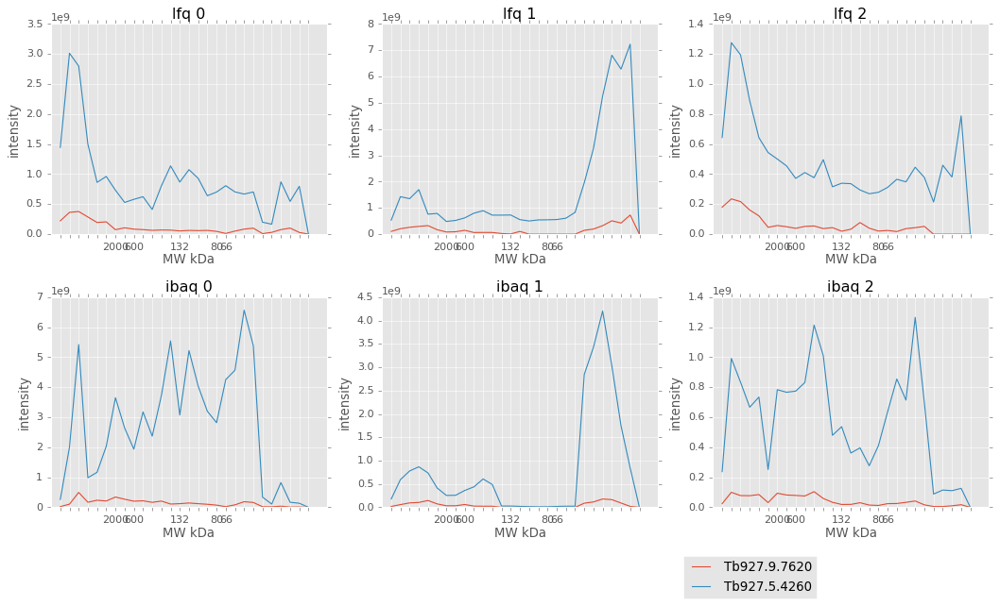

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.7620                  22               0   
Tb927.5.4260                  11               0   

                            [Product Description]  
[Input ID]                                         
Tb927.9.7620  60S ribosomal protein L11, putative  
Tb927.5.4260                 histone H4, putative  
51 23 16 ['Tb927.9.7620', 'Tb927.5.4260']


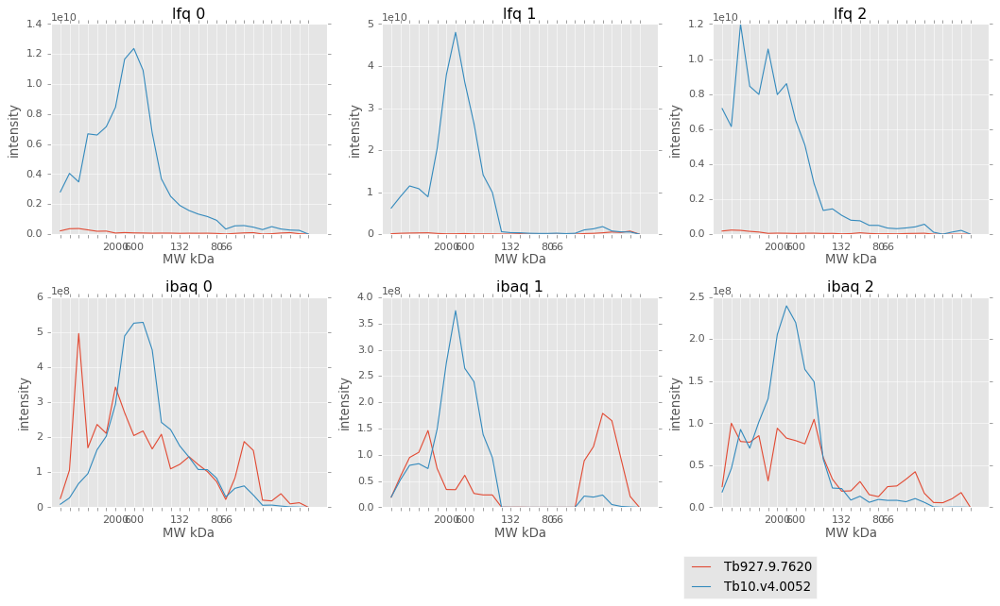

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.7620                  22               0   
Tb10.v4.0052                 561               0   

                            [Product Description]  
[Input ID]                                         
Tb927.9.7620  60S ribosomal protein L11, putative  
Tb10.v4.0052     microtubule-associated protein 2  
51 23 59 ['Tb927.9.7620', 'Tb10.v4.0052']


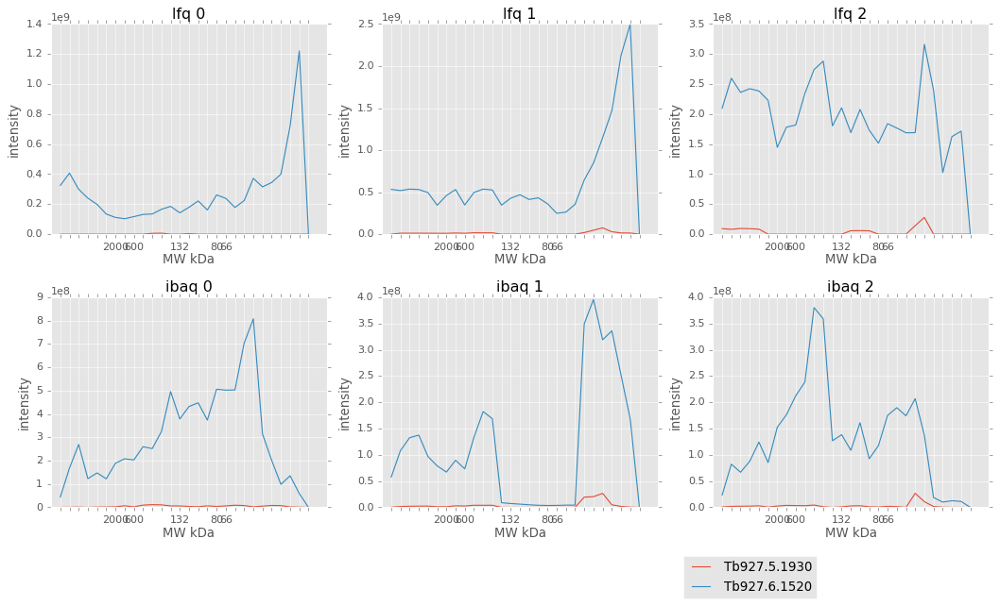

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.1930                  24               1   
Tb927.6.1520                  35               6   

                           [Product Description]  
[Input ID]                                        
Tb927.5.1930  signal peptidase subunit, putative  
Tb927.6.1520                  Aquaglyceroporin 1  
51 75 90 ['Tb927.5.1930', 'Tb927.6.1520']


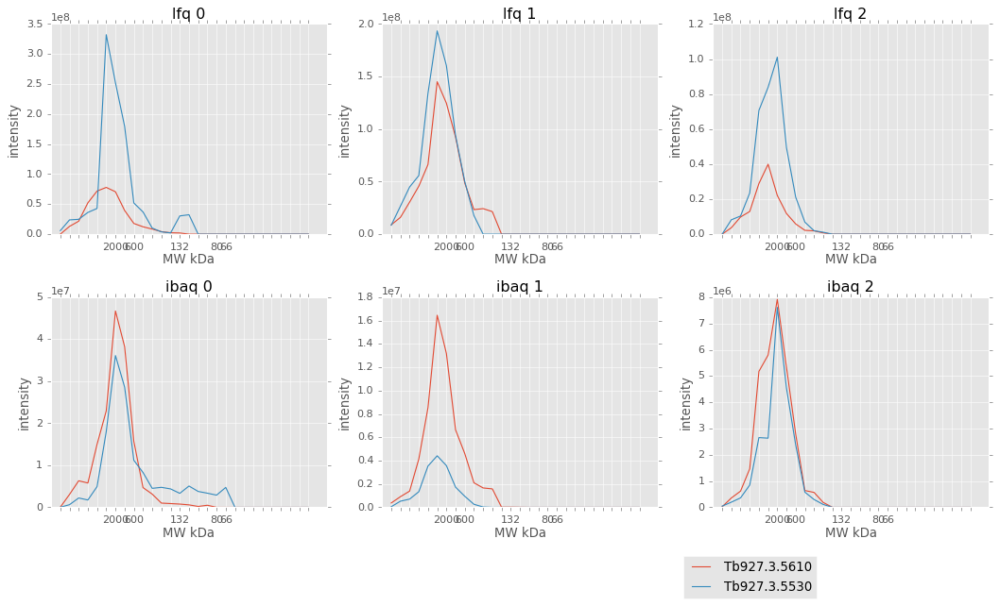

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.5610                  54               0   
Tb927.3.5530                 279               2   

                           [Product Description]  
[Input ID]                                        
Tb927.3.5610  Mitochondrial ribosomal protein L3  
Tb927.3.5530  Tb-292 membrane associated protein  
86 2 40 ['Tb927.3.5610', 'Tb927.3.5530']


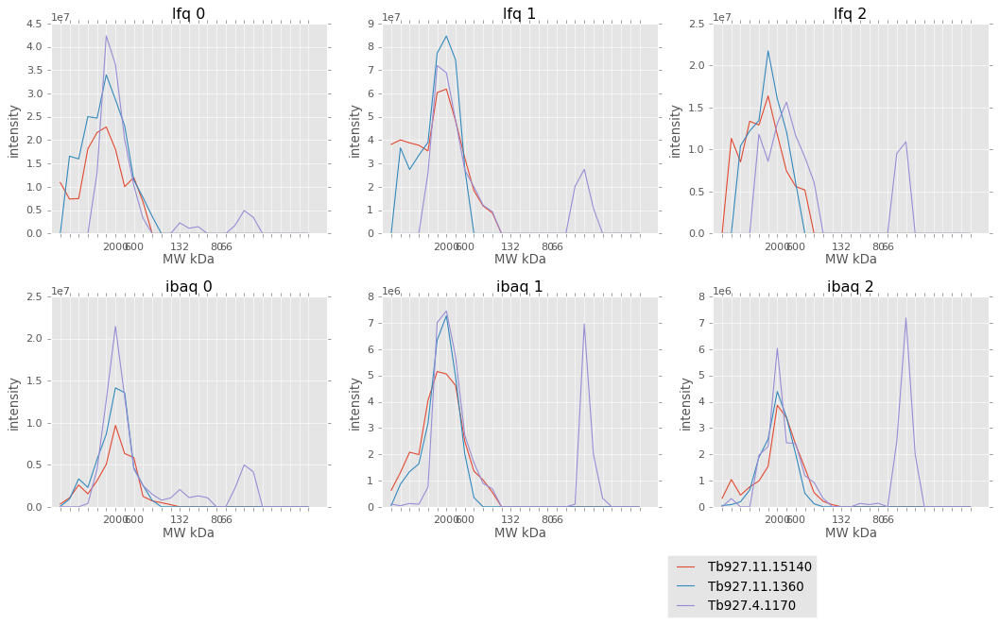

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.15140                  62               0   
Tb927.11.1360                   62               0   
Tb927.4.1170                    36               0   

                               [Product Description]  
[Input ID]                                            
Tb927.11.15140       bilobe region protein, putative  
Tb927.11.1360   zinc-finger of a C2HC-type, putative  
Tb927.4.1170                       ankyrin, putative  
86 28 40 ['Tb927.11.15140', 'Tb927.11.1360', 'Tb927.4.1170']


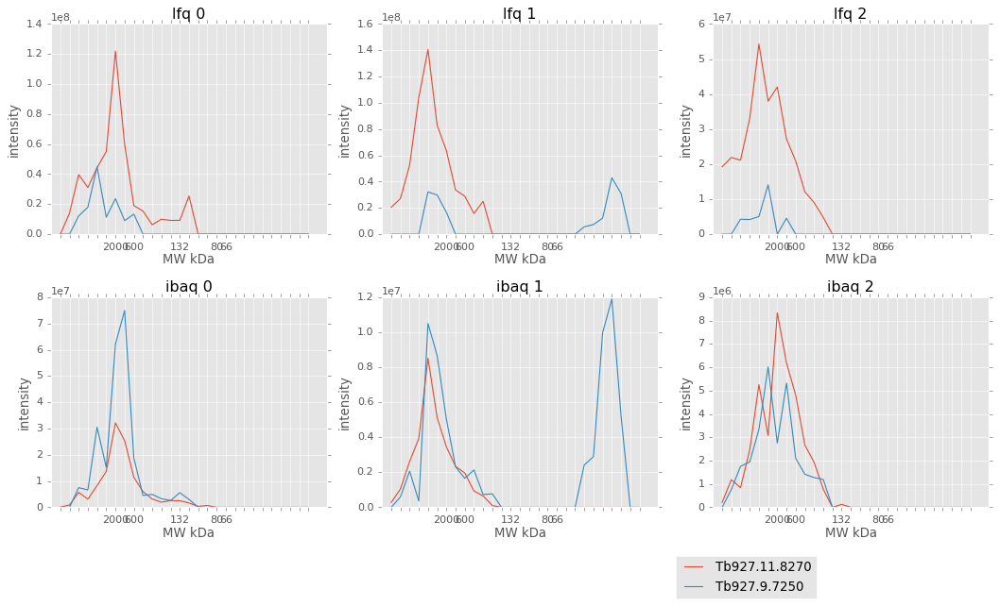

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.8270                  84               0   
Tb927.9.7250                   20               0   

                         [Product Description]  
[Input ID]                                      
Tb927.11.8270  hypothetical protein, conserved  
Tb927.9.7250   hypothetical protein, conserved  
86 7 41 ['Tb927.11.8270', 'Tb927.9.7250']


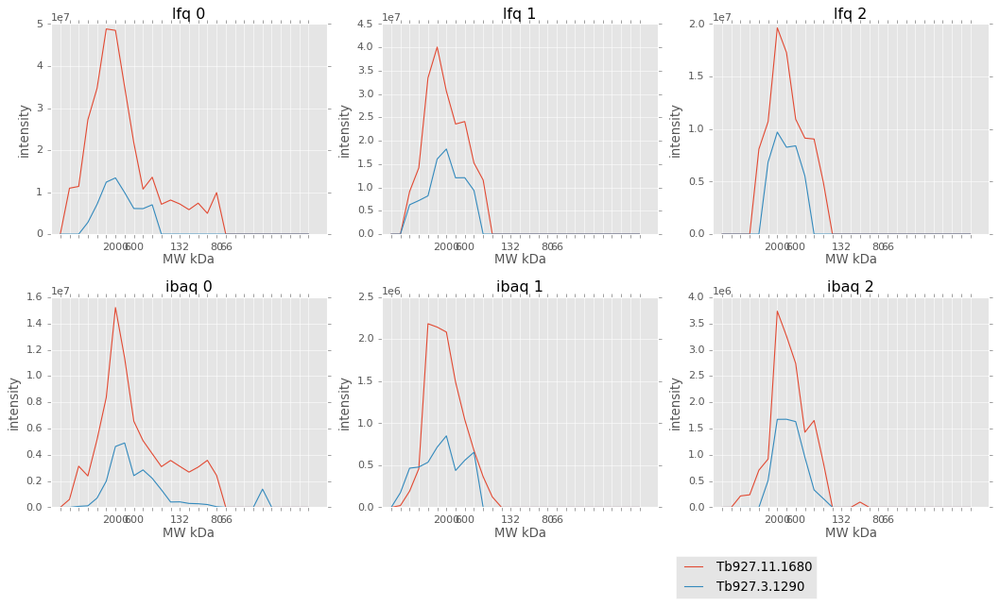

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.1680                  97               1   
Tb927.3.1290                  105               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.11.1680  vesicular-fusion protein SEC18, putative  
Tb927.3.1290                        cullin 4B, putative  
86 29 81 ['Tb927.11.1680', 'Tb927.3.1290']


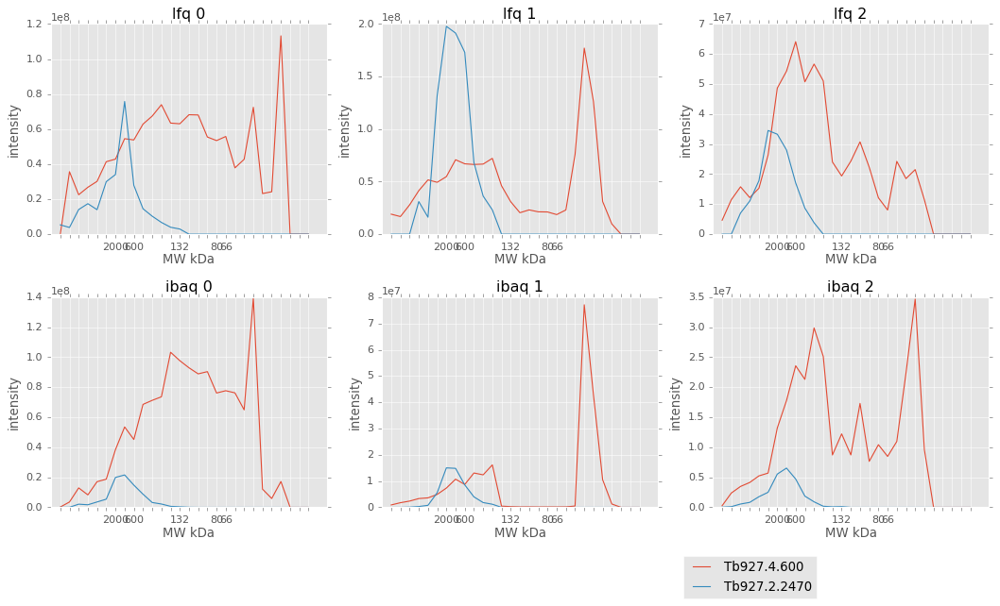

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.600                   34               0   
Tb927.2.2470                  81               0   

                              [Product Description]  
[Input ID]                                           
Tb927.4.600   Alpha/beta hydrolase family, putative  
Tb927.2.2470    Kinetoplastid RNA editing protein 1  
86 31 40 ['Tb927.4.600', 'Tb927.2.2470']


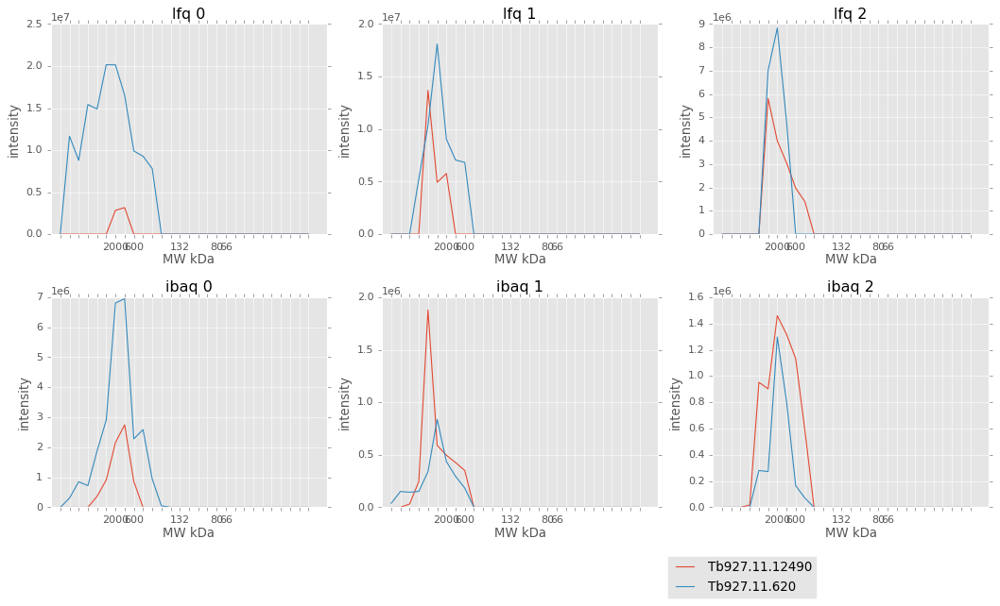

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.12490                  61               3   
Tb927.11.620                   143               0   

                                [Product Description]  
[Input ID]                                             
Tb927.11.12490        hypothetical protein, conserved  
Tb927.11.620    Regulatory-associated protein of TOR1  
86 3 39 ['Tb927.11.12490', 'Tb927.11.620']


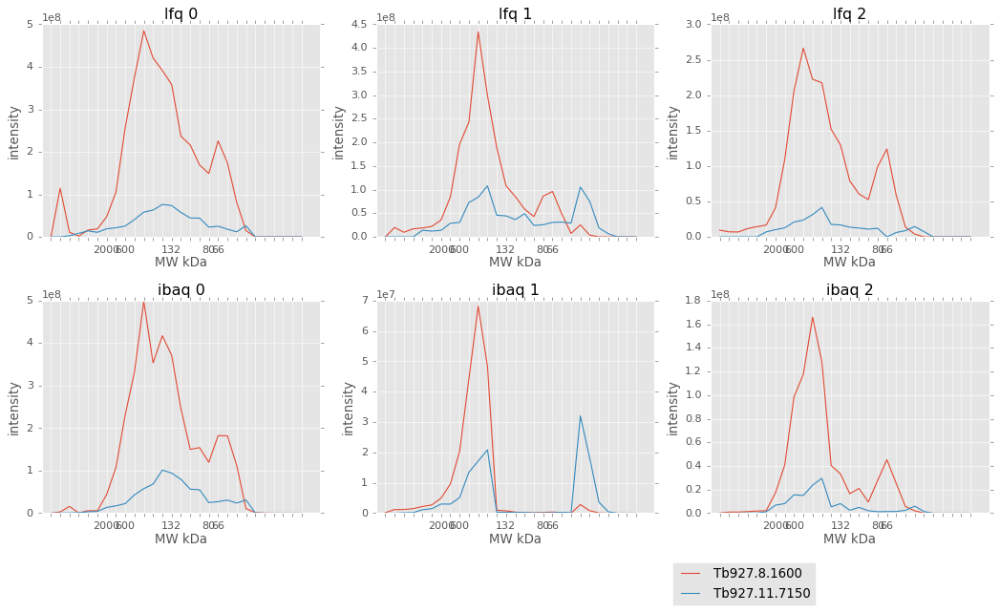

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.1600                   66               0   
Tb927.8.1600                   75               1   
Tb927.11.7150                  30               0   

                         [Product Description]  
[Input ID]                                      
Tb927.8.1600   lysyl-tRNA synthetase, putative  
Tb927.8.1600   lysyl-tRNA synthetase, putative  
Tb927.11.7150   NGG1 interacting factor 3-like  
40 54 69 ['Tb927.8.1600', 'Tb927.11.7150']


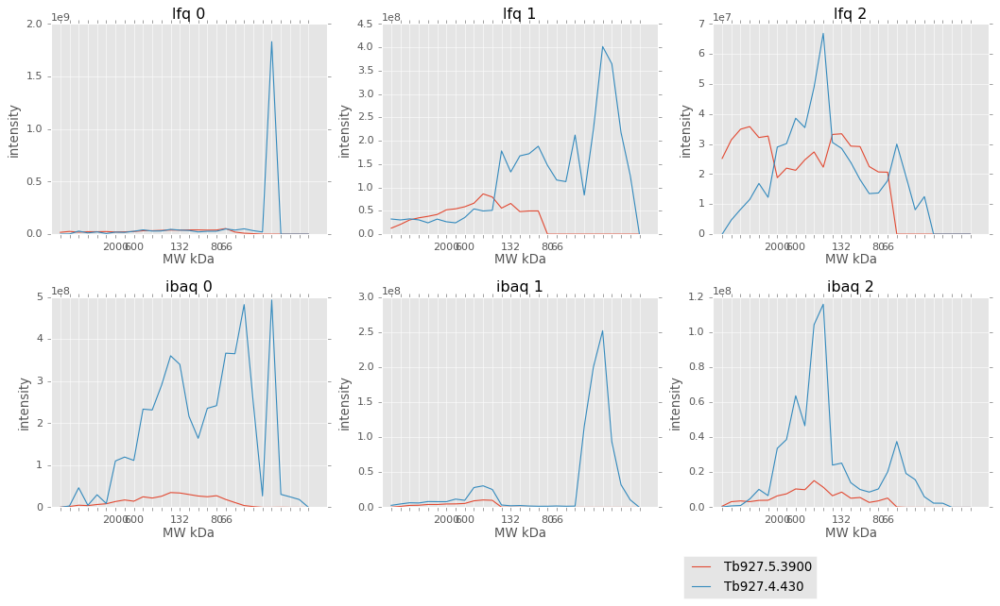

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.3900                  82               0   
Tb927.4.430                   24               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.3900  Galactose oxidase, central domain/Domain of un...  
Tb927.4.430                           proteasome beta 7 subunit  
40 72 75 ['Tb927.5.3900', 'Tb927.4.430']


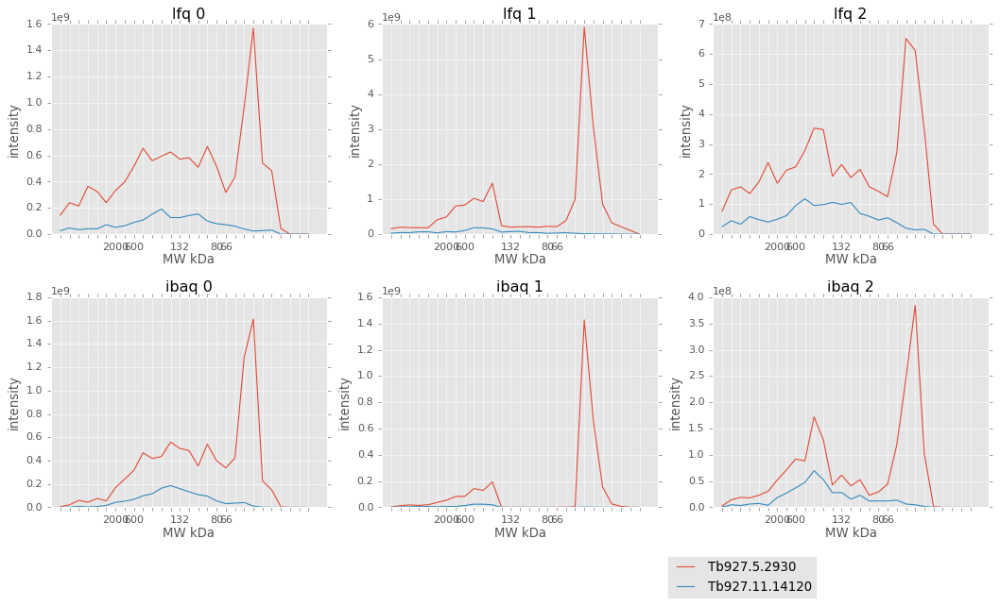

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.5.2930                    43               0   
Tb927.11.14120                  57               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.5.2930         Mitochondrial ATP synthase subunit, putative  
Tb927.11.14120  phenylalanyl-tRNA synthetase alpha chain, puta...  
40 56 91 ['Tb927.5.2930', 'Tb927.11.14120']


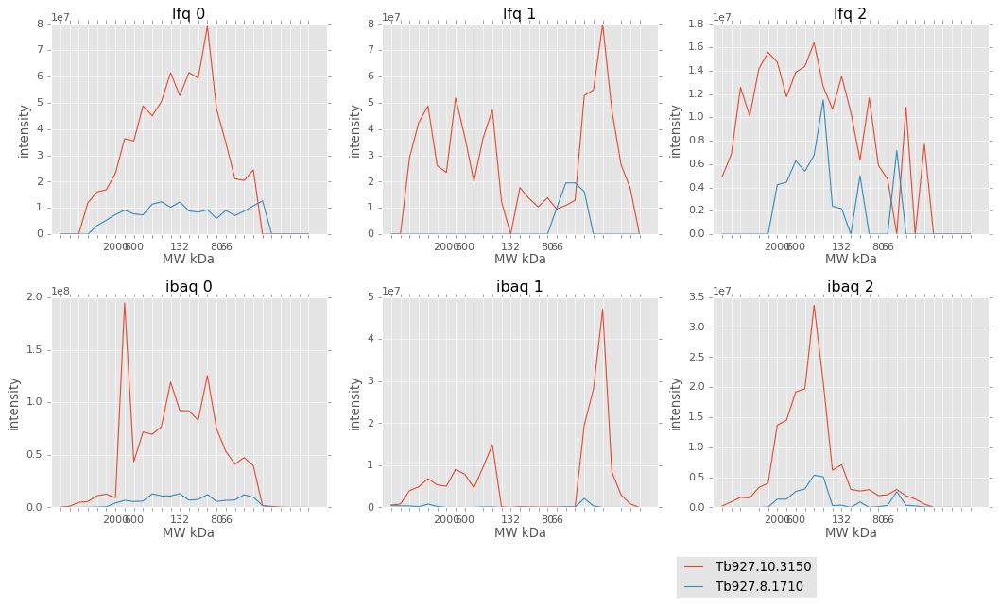

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.3150                  23               0   
Tb927.8.1710                   46               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.3150                      N-acetyltransferase, putative  
Tb927.8.1710   protein phosphatase 2A, regulatory subunit B, ...  
40 70 69 ['Tb927.10.3150', 'Tb927.8.1710']


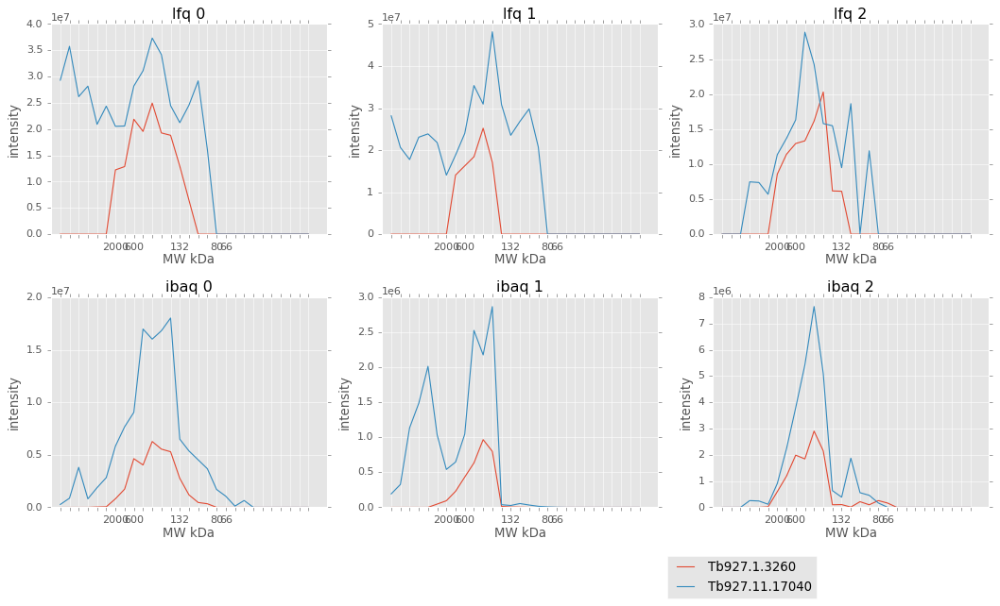

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.3260                   203               0   
Tb927.11.17040                 137               1   

                                            [Product Description]  
[Input ID]                                                         
Tb927.1.3260                      hypothetical protein, conserved  
Tb927.11.17040  procyclic-enriched flagellar receptor adenylat...  
41 72 69 ['Tb927.1.3260', 'Tb927.11.17040']


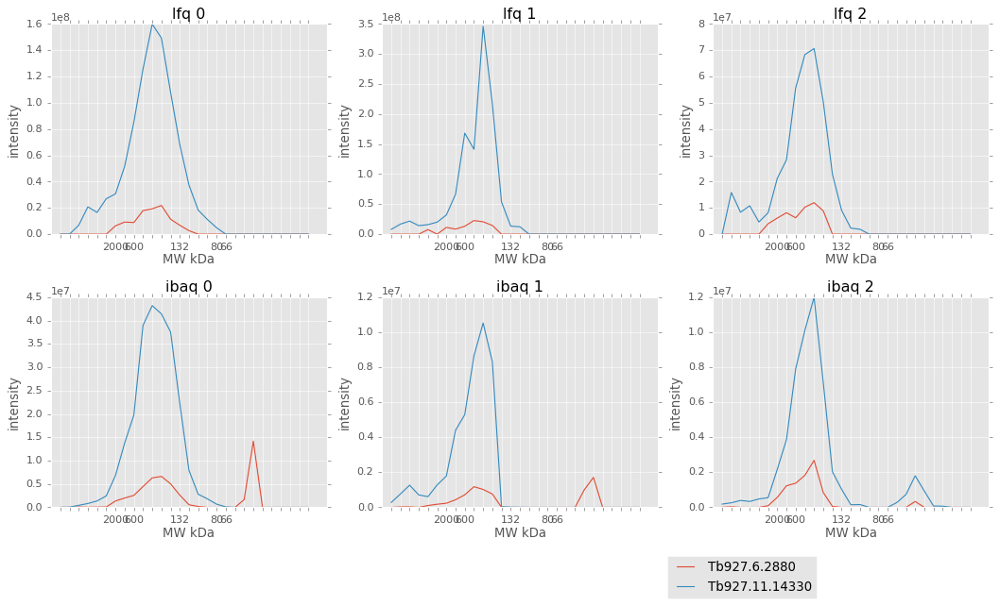

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.2880                   122               0   
Tb927.11.14330                 176               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.6.2880                                kinesin, putative  
Tb927.11.14330  HECT-domain (ubiquitin-transferase), putative  
41 60 88 ['Tb927.6.2880', 'Tb927.11.14330']


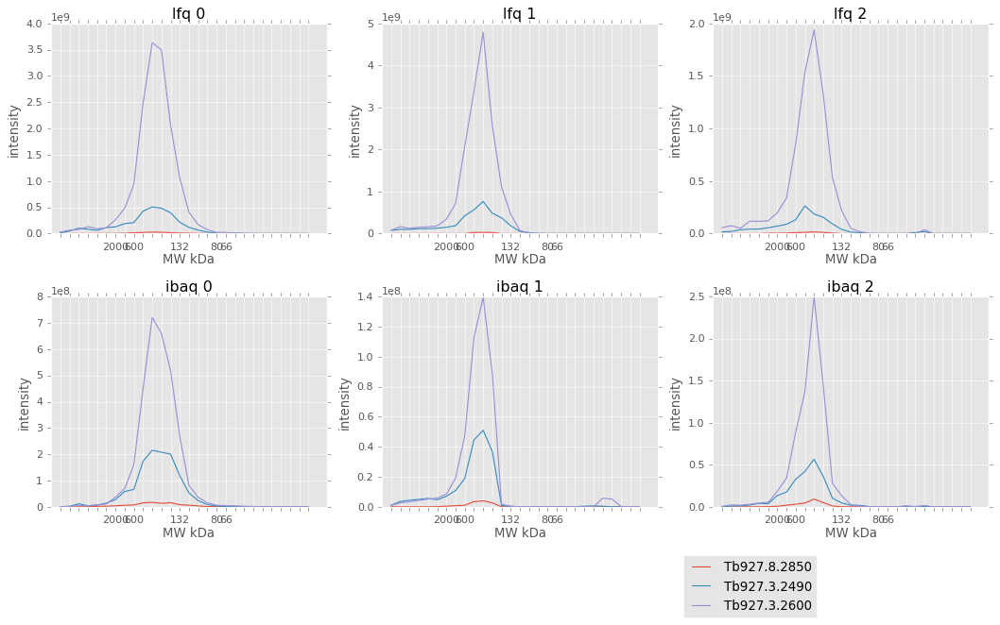

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.2850                  65               0   
Tb927.3.2490                 110               0   
Tb927.3.2600                 244               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.8.2850         Poly(A)-specific ribonuclease PARN-1  
Tb927.3.2490              hypothetical protein, conserved  
Tb927.3.2600  ATP-dependent DEAD/H RNA helicase, putative  
41 60 69 ['Tb927.8.2850', 'Tb927.3.2490', 'Tb927.3.2600']


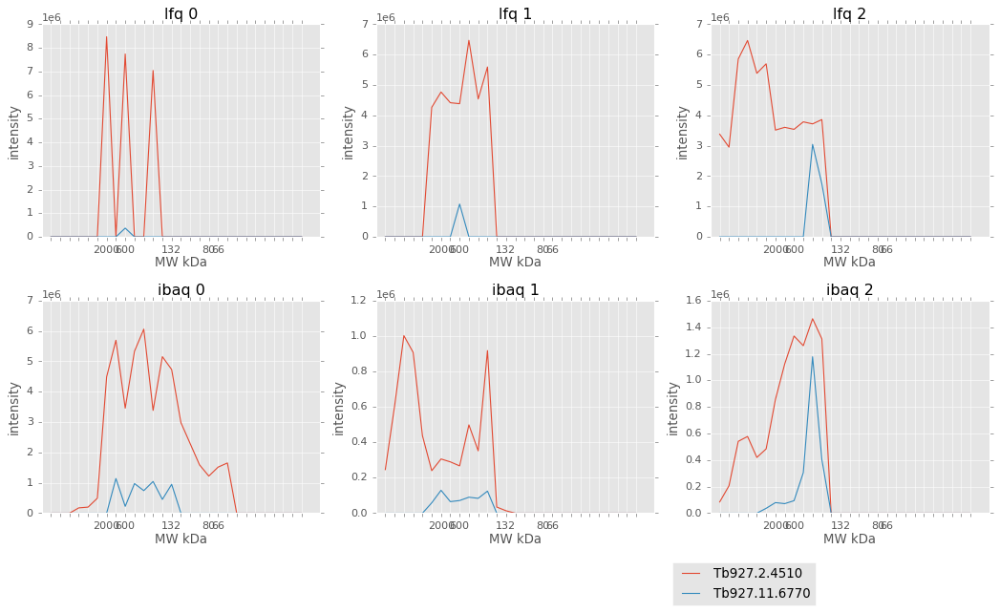

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.2.4510                   85               0   
Tb927.11.6770                  74               0   

                         [Product Description]  
[Input ID]                                      
Tb927.2.4510             cdc2-related kinase 9  
Tb927.11.6770  hypothetical protein, conserved  
34 57 90 ['Tb927.2.4510', 'Tb927.11.6770']


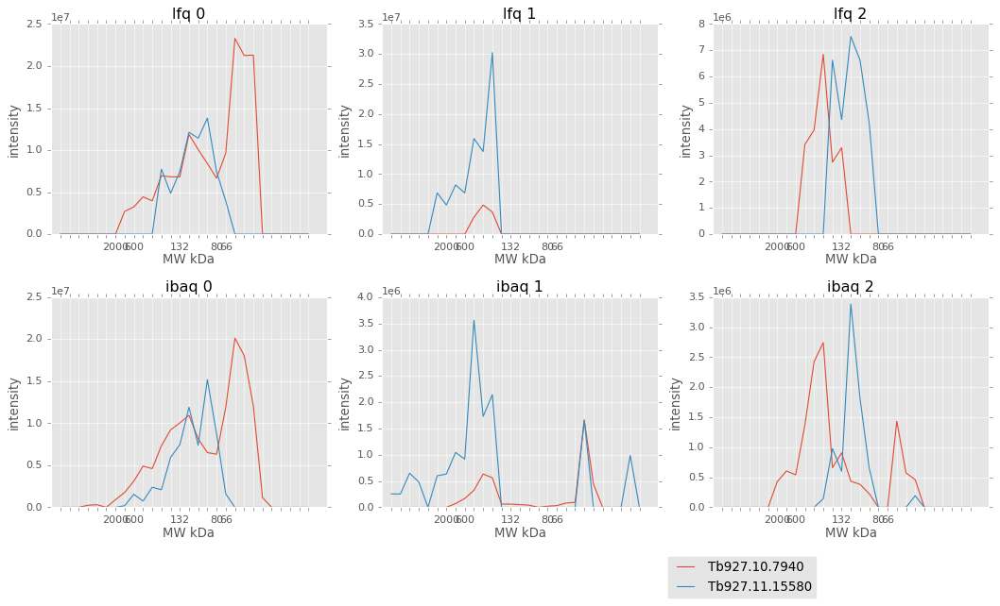

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.7940                   40               0   
Tb927.11.15580                  45               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.10.7940                 methyltransferase, putative  
Tb927.11.15580  TFIIF-like transcription factor subunit 2  
17 75 19 ['Tb927.10.7940', 'Tb927.11.15580']


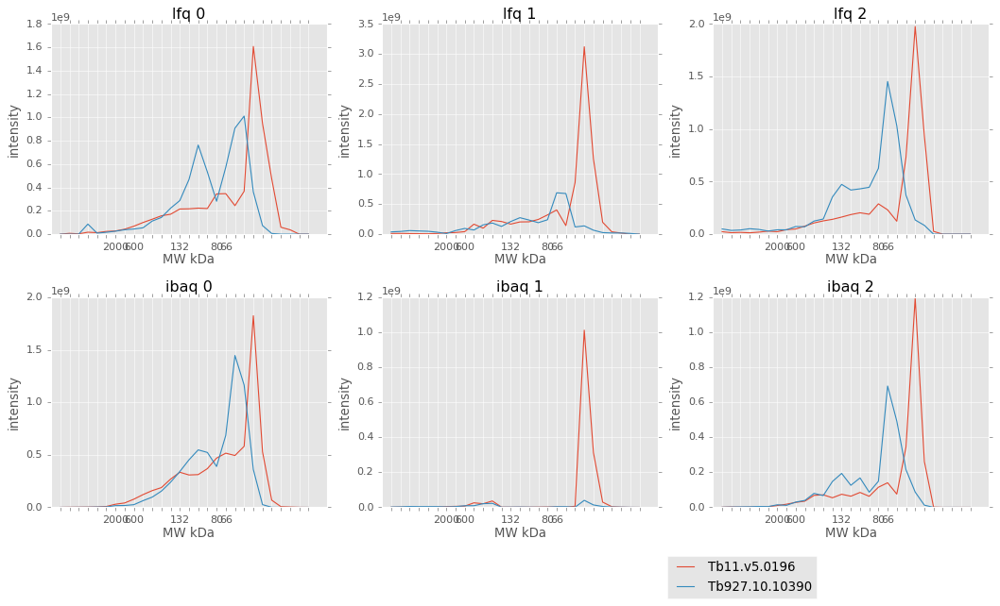

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb11.v5.0196                    29               0   
Tb927.10.10390                  53               0   

                                            [Product Description]  
[Input ID]                                                         
Tb11.v5.0196    Proteasome subunit A N-terminal signature/Prot...  
Tb927.10.10390                            trypanothione reductase  
17 68 3 ['Tb11.v5.0196', 'Tb927.10.10390']


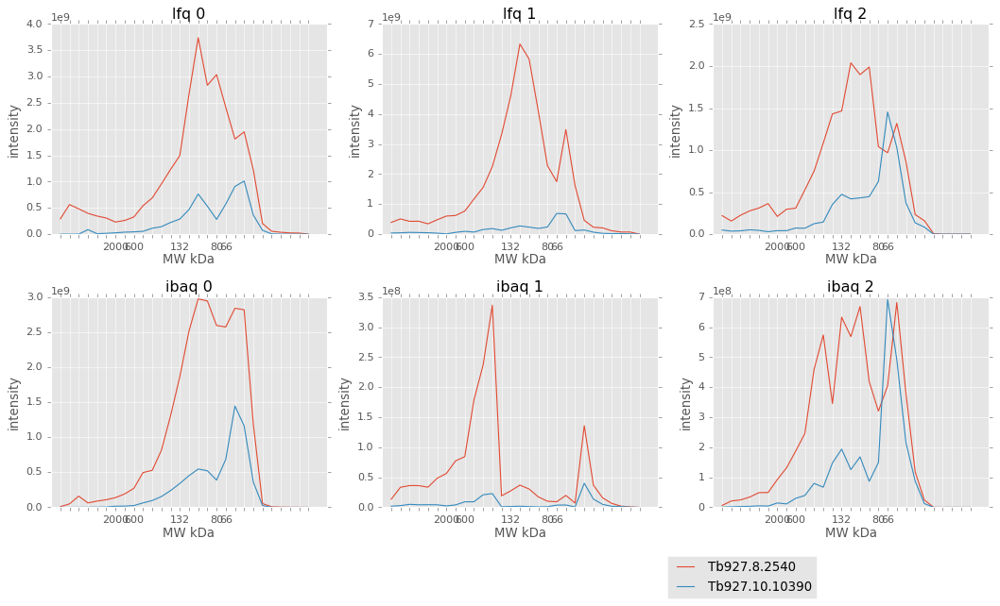

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.8.2540                    46               0   
Tb927.10.10390                  53               0   

                            [Product Description]  
[Input ID]                                         
Tb927.8.2540    3-ketoacyl-CoA thiolase, putative  
Tb927.10.10390            trypanothione reductase  
17 46 3 ['Tb927.8.2540', 'Tb927.10.10390']


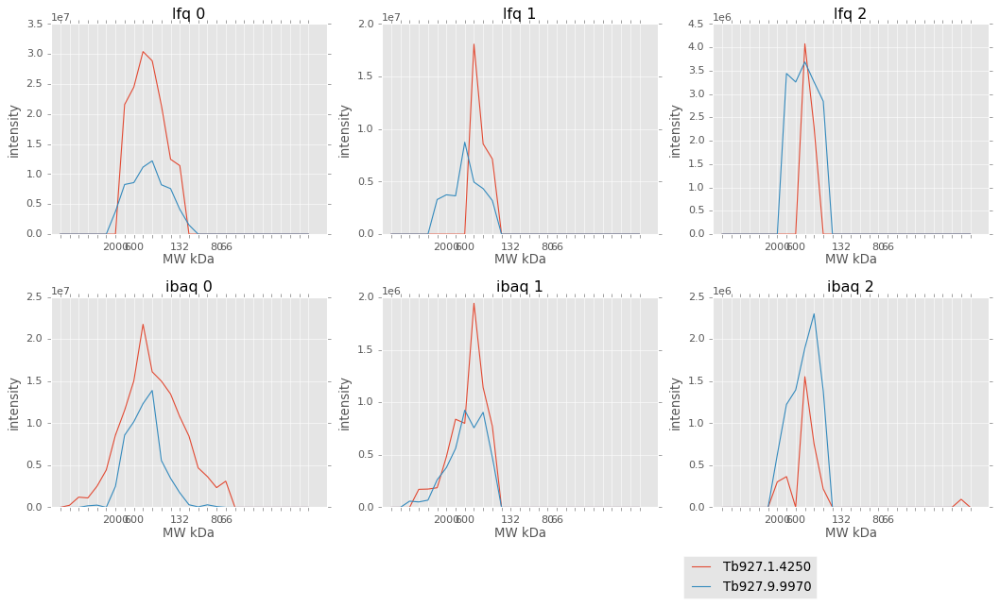

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.1.4250                  85               0   
Tb927.9.9970                  51               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.1.4250                    hypothetical protein, conserved  
Tb927.9.9970  Small nuclear RNA gene activation protein (SNA...  
77 57 70 ['Tb927.1.4250', 'Tb927.9.9970']


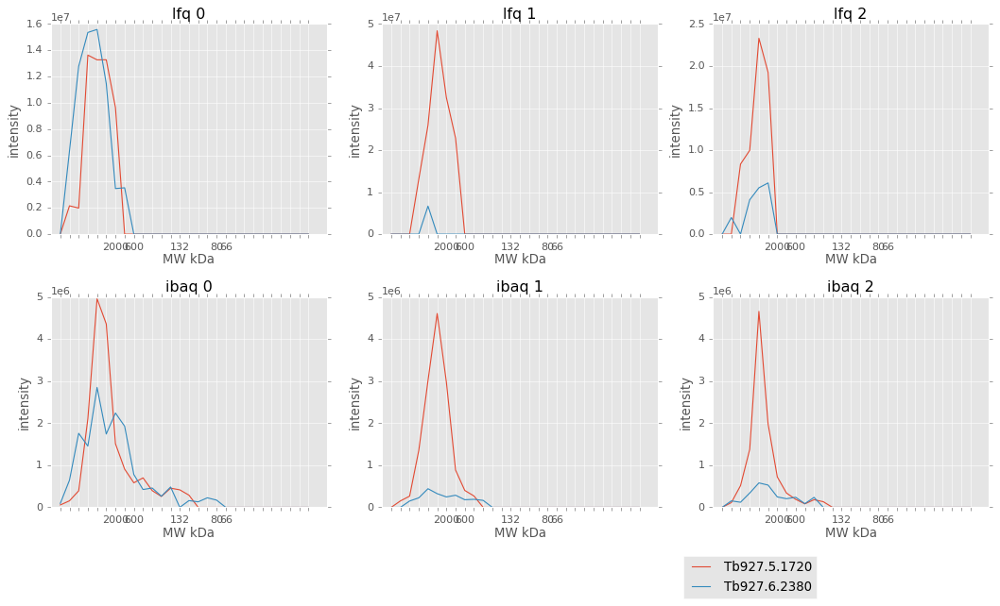

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.1720                  69               0   
Tb927.6.2380                  81               0   

                        [Product Description]  
[Input ID]                                     
Tb927.5.1720  hypothetical protein, conserved  
Tb927.6.2380  hypothetical protein, conserved  
56 2 49 ['Tb927.5.1720', 'Tb927.6.2380']


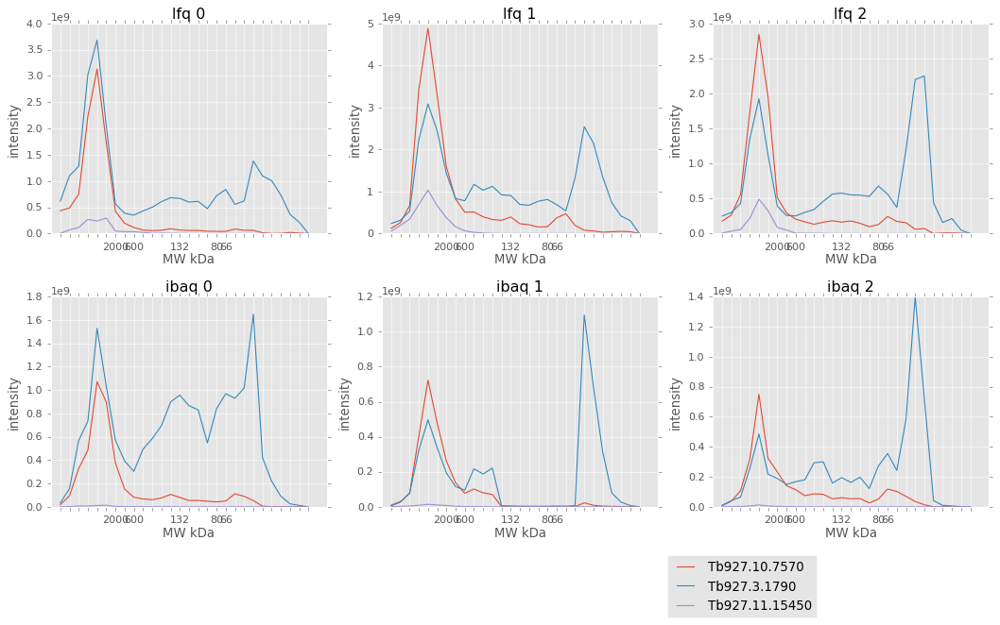

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.7570                   48               0   
Tb927.3.1790                    37               0   
Tb927.11.15450                 269               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.7570   dihydrolipoamide acetyltransferase E2 subunit,...  
Tb927.3.1790     pyruvate dehydrogenase E1 beta subunit, putative  
Tb927.11.15450                                 Basal body protein  
56 7 33 ['Tb927.10.7570', 'Tb927.3.1790', 'Tb927.11.15450']


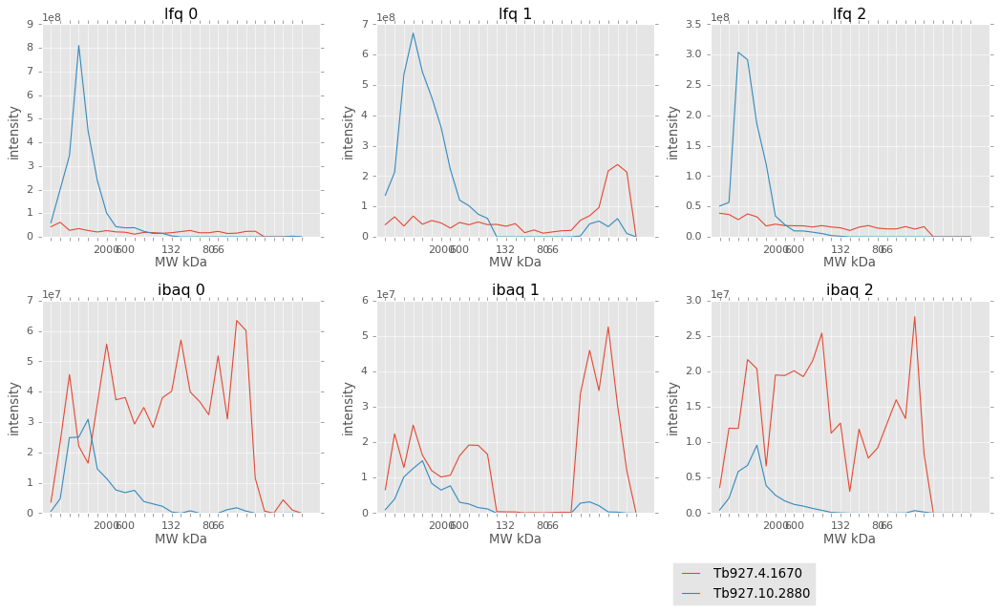

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.4.1670                   17               0   
Tb927.10.2880                 303              22   

                                           [Product Description]  
[Input ID]                                                        
Tb927.4.1670   cytochrome b5-like Heme/Steroid binding domain...  
Tb927.10.2880  Voltage-dependent calcium channel subunit, put...  
56 7 51 ['Tb927.4.1670', 'Tb927.10.2880']


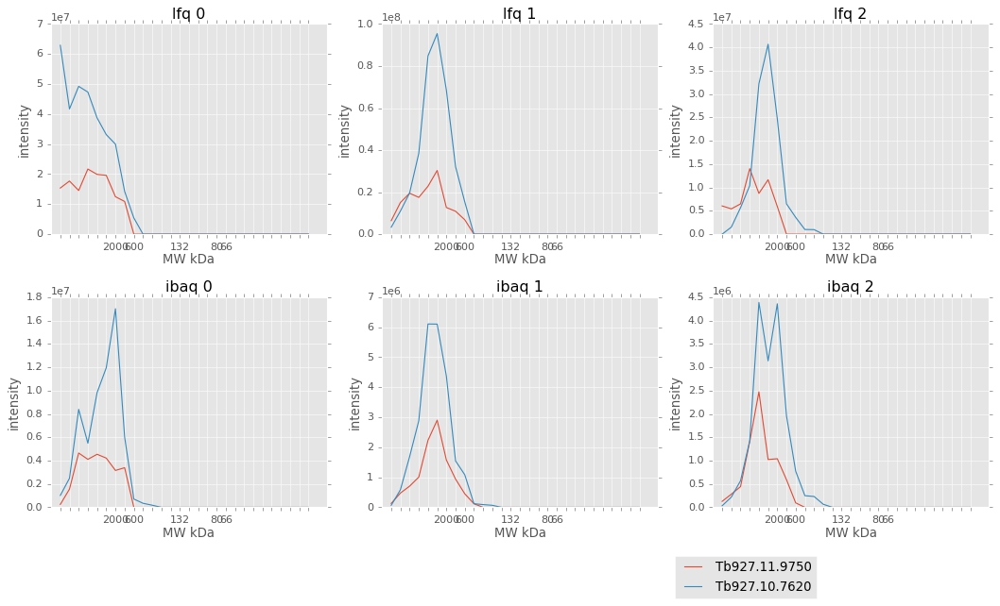

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.9750                  72               0   
Tb927.10.7620                  71               1   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.9750  Protein of unknown function (DUF498/DUF598), p...  
Tb927.10.7620  mitochondrial ATP-dependent zinc metallopeptid...  
56 3 35 ['Tb927.11.9750', 'Tb927.10.7620']


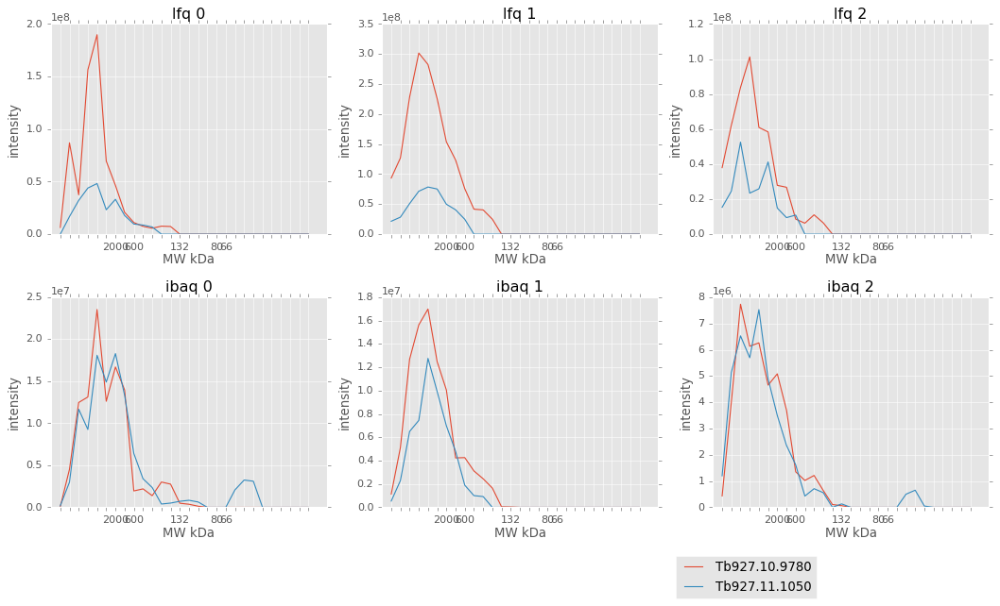

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.9780                  97               0   
Tb927.11.1050                  39               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.10.9780  ATP-dependent DEAD/H RNA helicase, putative  
Tb927.11.1050       ribosome production factor 1, putative  
56 8 47 ['Tb927.10.9780', 'Tb927.11.1050']


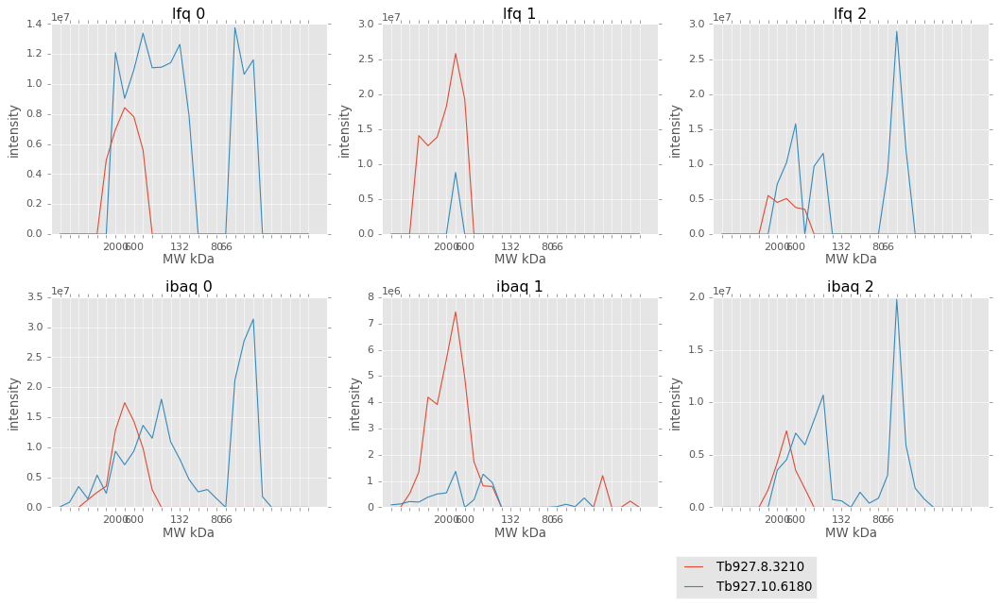

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.3210                   18               0   
Tb927.10.6180                  54               1   

                         [Product Description]  
[Input ID]                                      
Tb927.8.3210   hypothetical protein, conserved  
Tb927.10.6180                FLA1-like protein  
78 33 80 ['Tb927.8.3210', 'Tb927.10.6180']


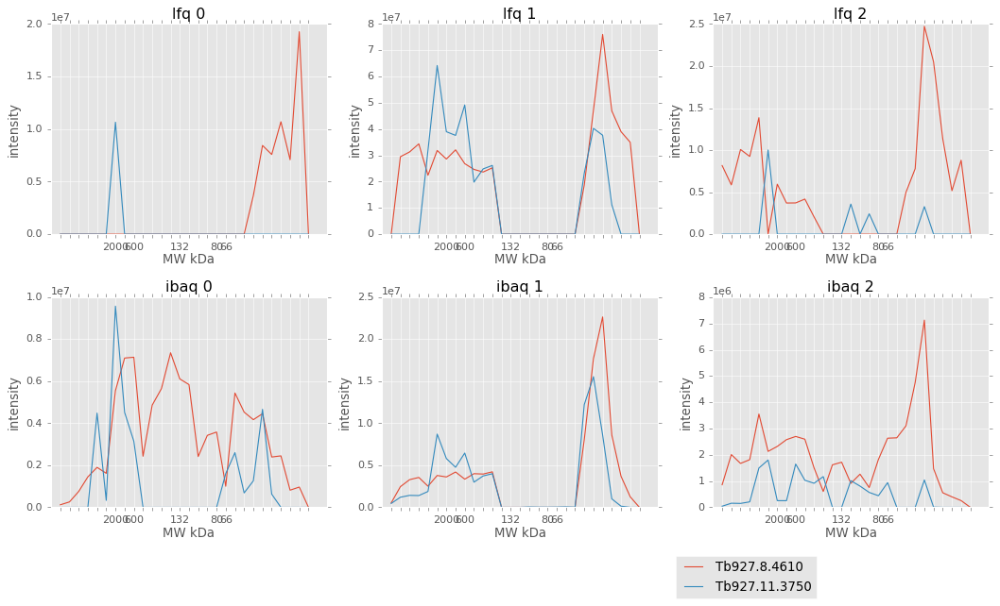

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.4610                   24               0   
Tb927.11.3750                  34               1   

                                [Product Description]  
[Input ID]                                             
Tb927.8.4610                Ras-related protein RabX1  
Tb927.11.3750  NADH-cytochrome b5 reductase, putative  
93 39 35 ['Tb927.8.4610', 'Tb927.11.3750']


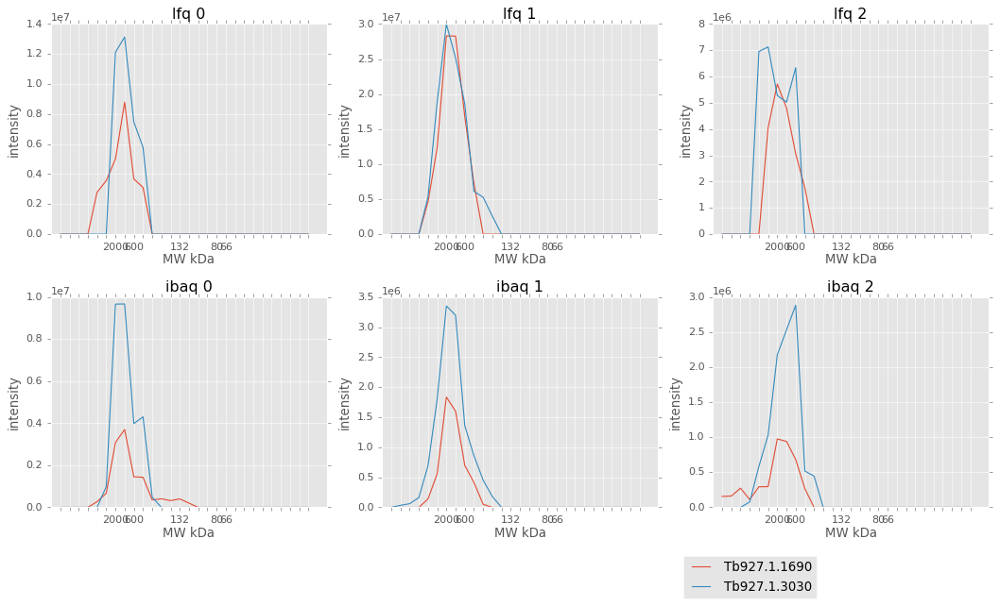

              [Molecular Weight]  [# TM Domains]   [Product Description]
[Input ID]                                                              
Tb927.1.1690                  89               0  RNA-editing nuclease 1
Tb927.1.3030                  47               0                   KREL2
93 31 79 ['Tb927.1.1690', 'Tb927.1.3030']


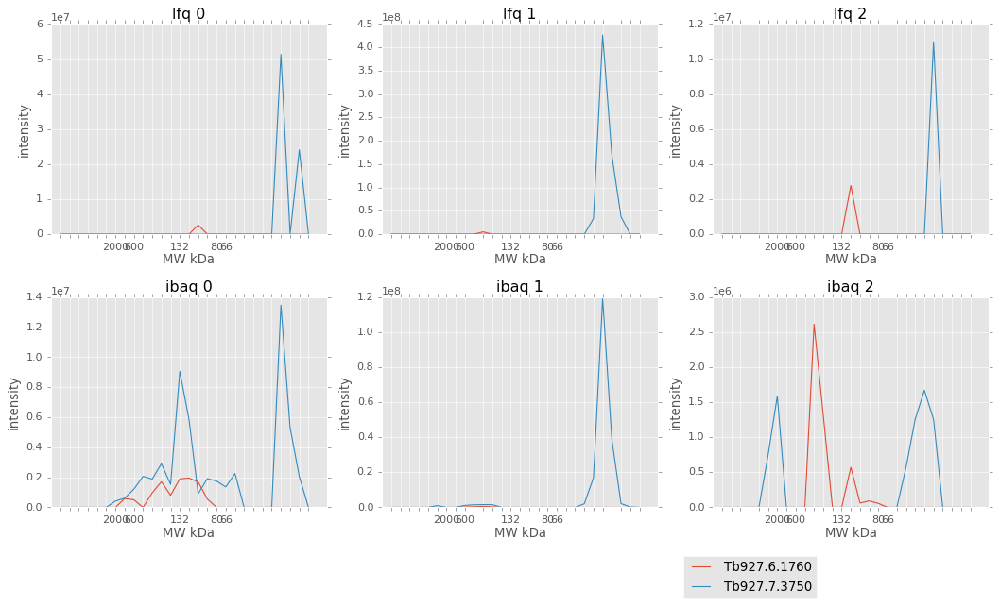

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.1760                  69               0   
Tb927.7.3750                  22               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.6.1760                                KU80 protein  
Tb927.7.3750  TFIIF-stimulated CTD phosphatase, putative  
93 73 67 ['Tb927.6.1760', 'Tb927.7.3750']


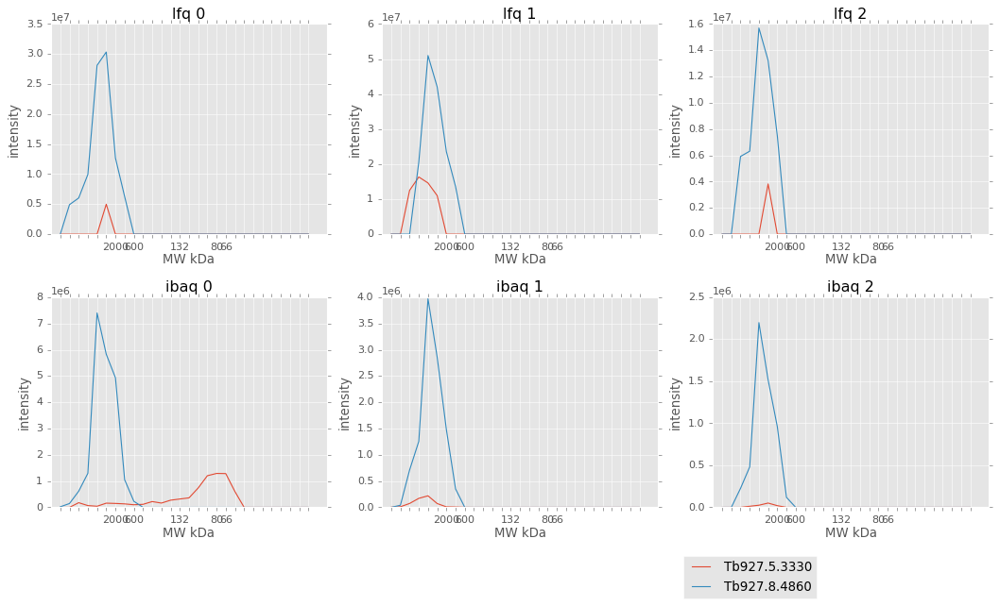

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.3330                 521               0   
Tb927.8.4860                  76               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.3330                    hypothetical protein, conserved  
Tb927.8.4860  kinetoplast ribosomal PPR-repeat containing pr...  
69 7 35 ['Tb927.5.3330', 'Tb927.8.4860']


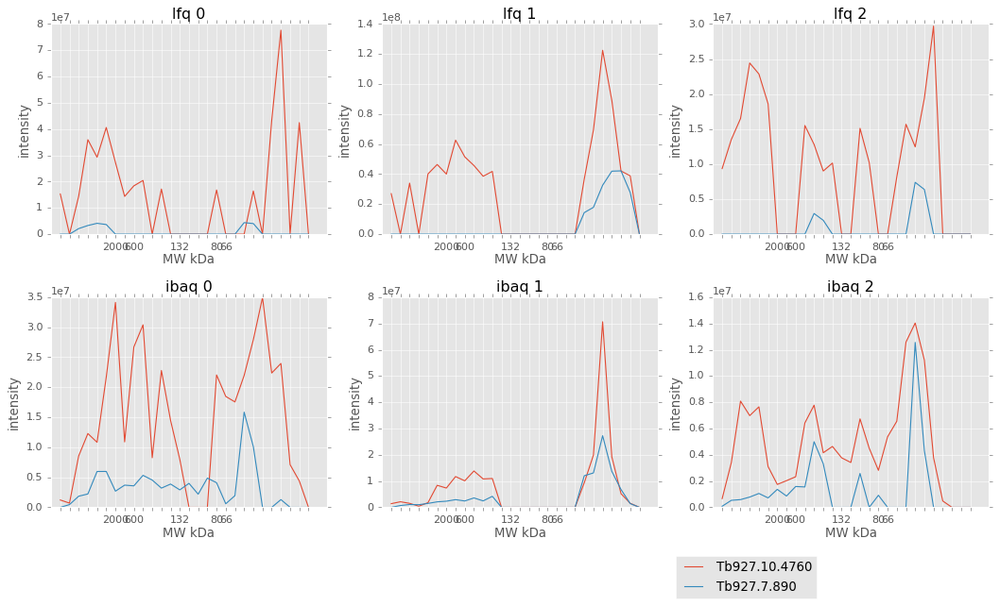

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.4760                  27               3   
Tb927.7.890                    19               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.10.4760  Integral membrane protein DUF106, putative  
Tb927.7.890           electron transfer protein, putative  
69 35 26 ['Tb927.10.4760', 'Tb927.7.890']


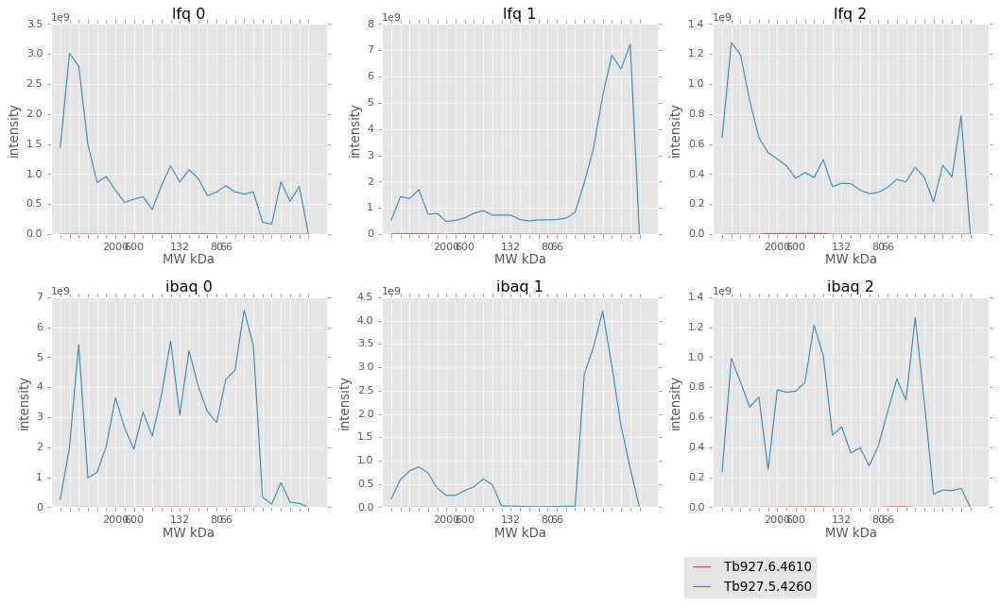

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.4610                  46               0   
Tb927.5.4260                  11               0   

                             [Product Description]  
[Input ID]                                          
Tb927.6.4610  Ankyrin repeats (3 copies), putative  
Tb927.5.4260                  histone H4, putative  
30 23 16 ['Tb927.6.4610', 'Tb927.5.4260']


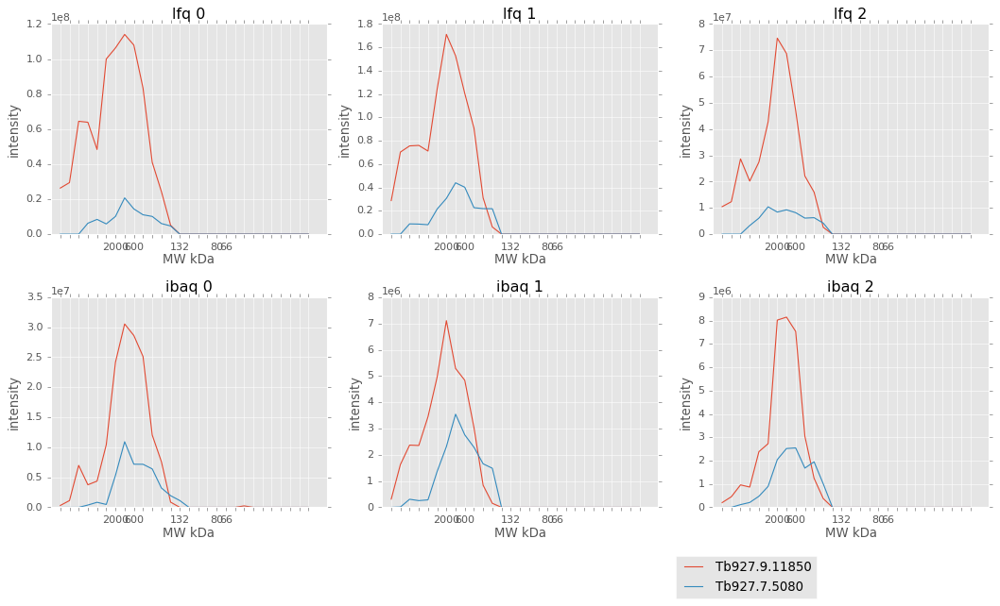

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.11850                 144               0   
Tb927.7.5080                   79               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.9.11850  structural maintenance of chromosome 1, putative  
Tb927.7.5080                        ATP-NAD kinase-like protein  
96 31 41 ['Tb927.9.11850', 'Tb927.7.5080']


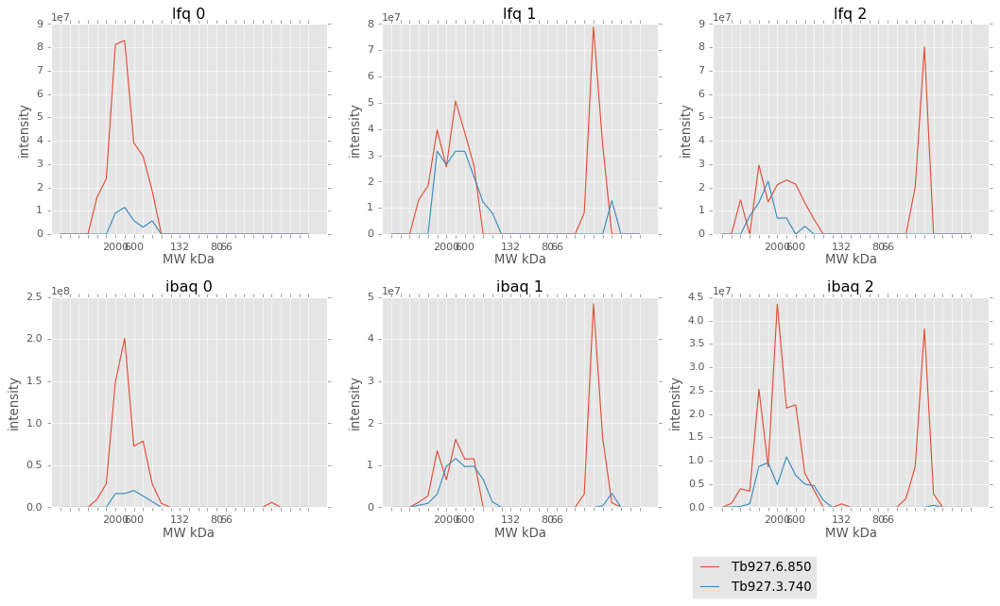

             [Molecular Weight]  [# TM Domains]  \
[Input ID]                                        
Tb927.6.850                  37               0   
Tb927.3.740                  25               0   

                                [Product Description]  
[Input ID]                                             
Tb927.6.850  ccr4-not transcription complex subunit 2  
Tb927.3.740               ZFP family member, putative  
96 31 40 ['Tb927.6.850', 'Tb927.3.740']


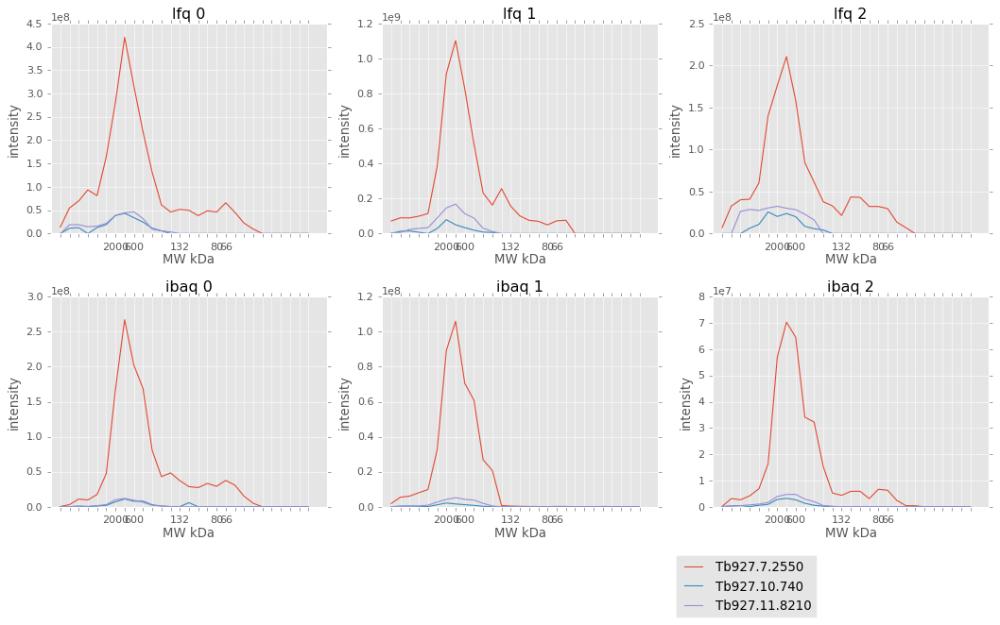

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.2550                   49               0   
Tb927.10.740                  154               0   
Tb927.11.8210                 152               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.2550             proteasome regulatory ATPase subunit 5  
Tb927.10.740   structural maintenance of chromosome 4, putative  
Tb927.11.8210                     RAD50 DNA repair-like protein  
96 31 81 ['Tb927.7.2550', 'Tb927.10.740', 'Tb927.11.8210']


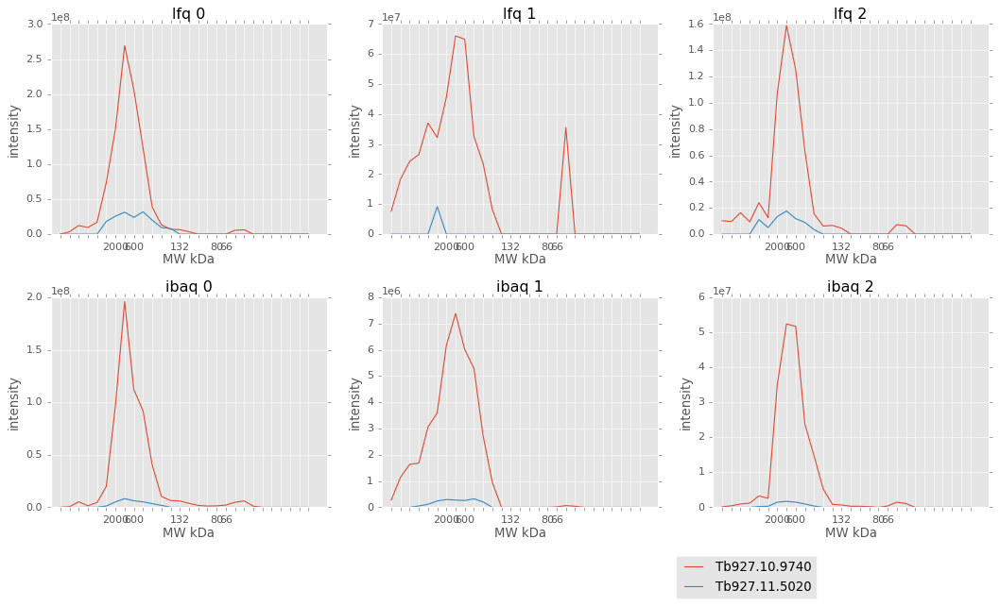

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.9740                  45               0   
Tb927.11.5020                 186               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.10.9740  Regulatory particle triple-A ATPase subunit 6  
Tb927.11.5020                hypothetical protein, conserved  
96 34 77 ['Tb927.10.9740', 'Tb927.11.5020']


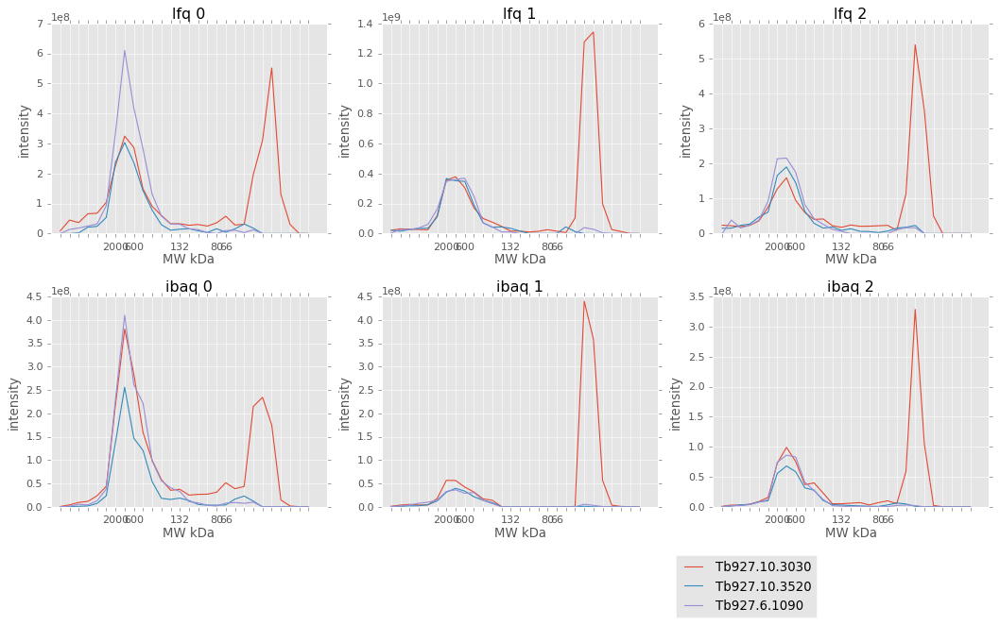

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.3030                  33               0   
Tb927.10.3520                  44               0   
Tb927.6.1090                   44               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.10.3030  proteasome regulatory non-ATPase subunit 11  
Tb927.10.3520         protease regulatory ATPase subunit 4  
Tb927.6.1090        proteasome regulatory ATPase subunit 3  
96 34 81 ['Tb927.10.3030', 'Tb927.10.3520', 'Tb927.6.1090']


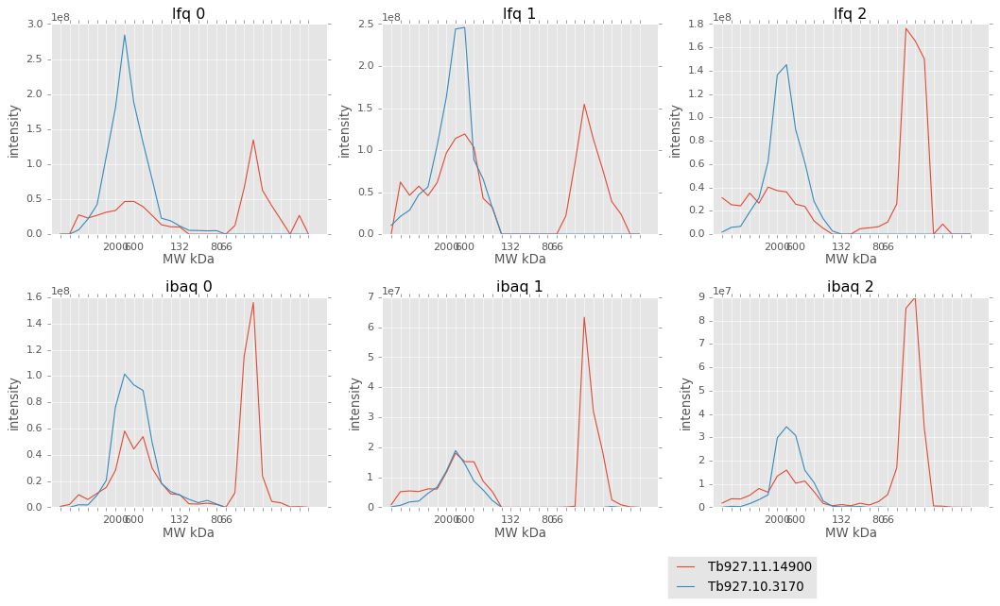

                [Molecular Weight]  [# TM Domains]      [Product Description]
[Input ID]                                                                   
Tb927.11.14900                  34               0   coatomer subunit epsilon
Tb927.10.3170                   82               0  ABC transporter, putative
96 33 81 ['Tb927.11.14900', 'Tb927.10.3170']


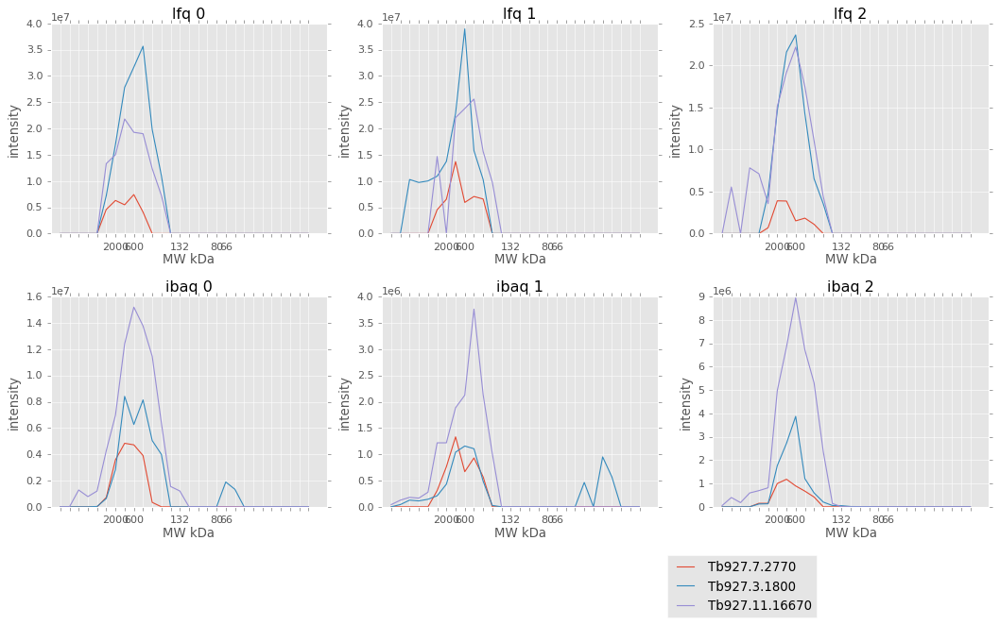

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.2770                    44               0   
Tb927.3.1800                   161               0   
Tb927.11.16670                  63               0   

                          [Product Description]  
[Input ID]                                       
Tb927.7.2770    hypothetical protein, conserved  
Tb927.3.1800    hypothetical protein, conserved  
Tb927.11.16670  hypothetical protein, conserved  
96 33 83 ['Tb927.7.2770', 'Tb927.3.1800', 'Tb927.11.16670']


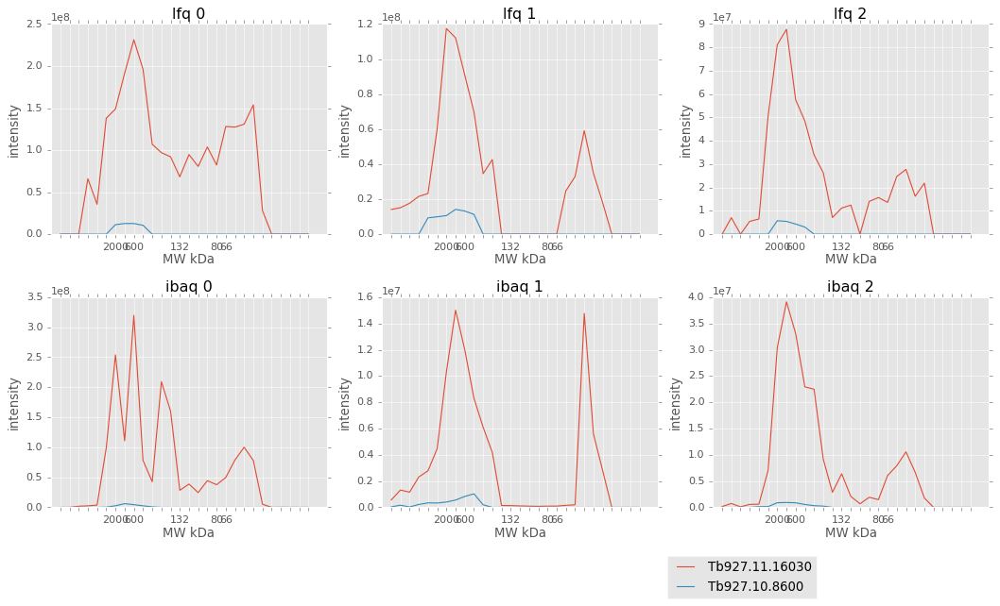

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.16030                  45               0   
Tb927.10.8600                  119               0   

                                      [Product Description]  
[Input ID]                                                   
Tb927.11.16030  proteasome regulatory non-ATP-ase subunit 7  
Tb927.10.8600                  Vps54-like protein, putative  
96 33 84 ['Tb927.11.16030', 'Tb927.10.8600']


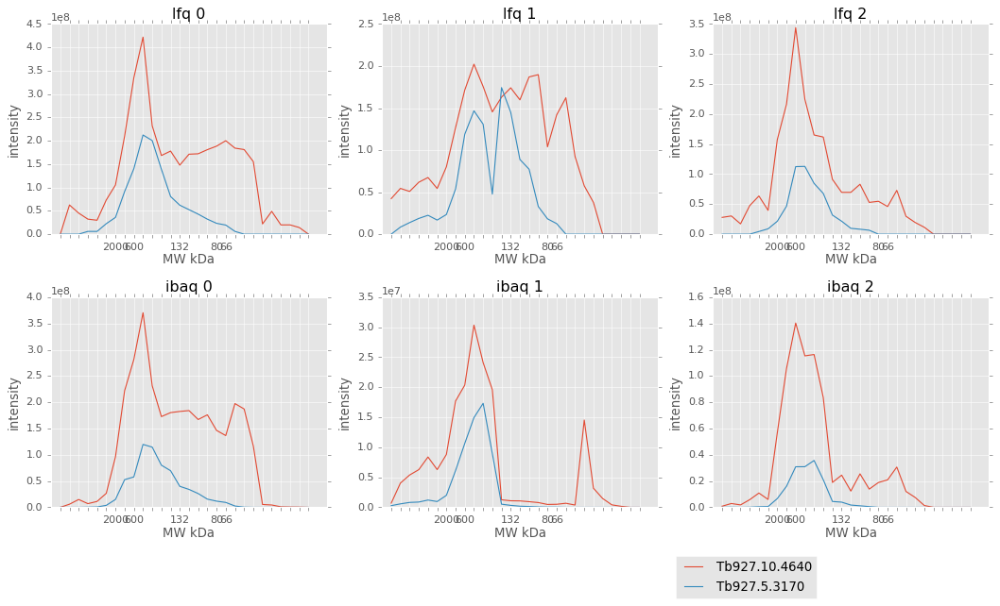

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.4640                  55               0   
Tb927.5.3170                   73               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.4640  eukaryotic translation initiation factor 3 sub...  
Tb927.5.3170        ribose-phosphate pyrophosphokinase, putative  
74 54 88 ['Tb927.10.4640', 'Tb927.5.3170']


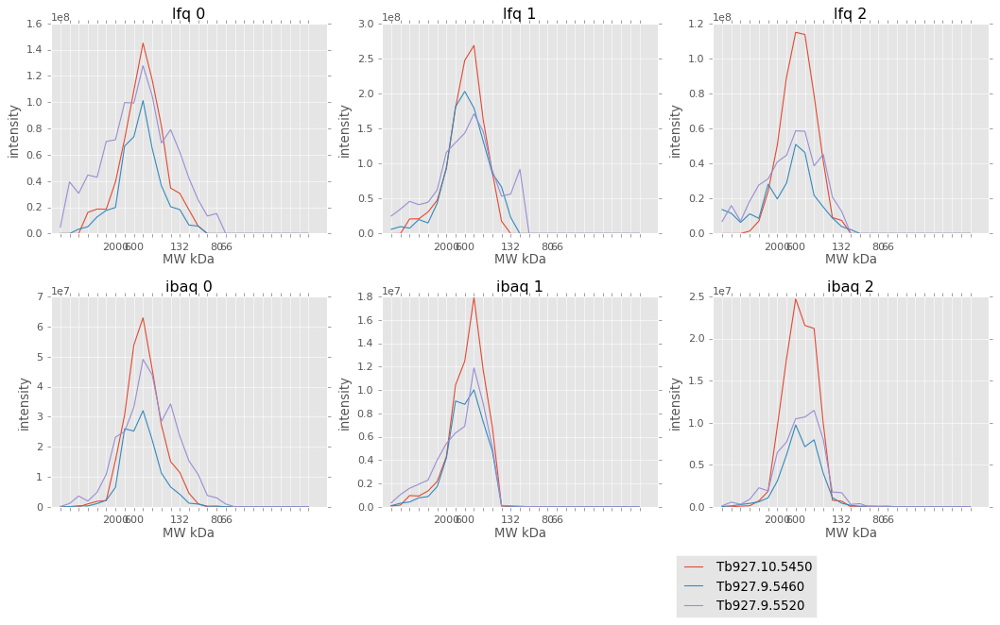

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.5450                 107               0   
Tb927.9.5460                  110               0   
Tb927.9.5520                  151               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.5450                               ISWI complex protein  
Tb927.9.5460   Eukaryotic translation initiation factor 4 gam...  
Tb927.9.5520     ubiquitin carboxyl-terminal hydrolase, putative  
74 57 90 ['Tb927.10.5450', 'Tb927.9.5460', 'Tb927.9.5520']


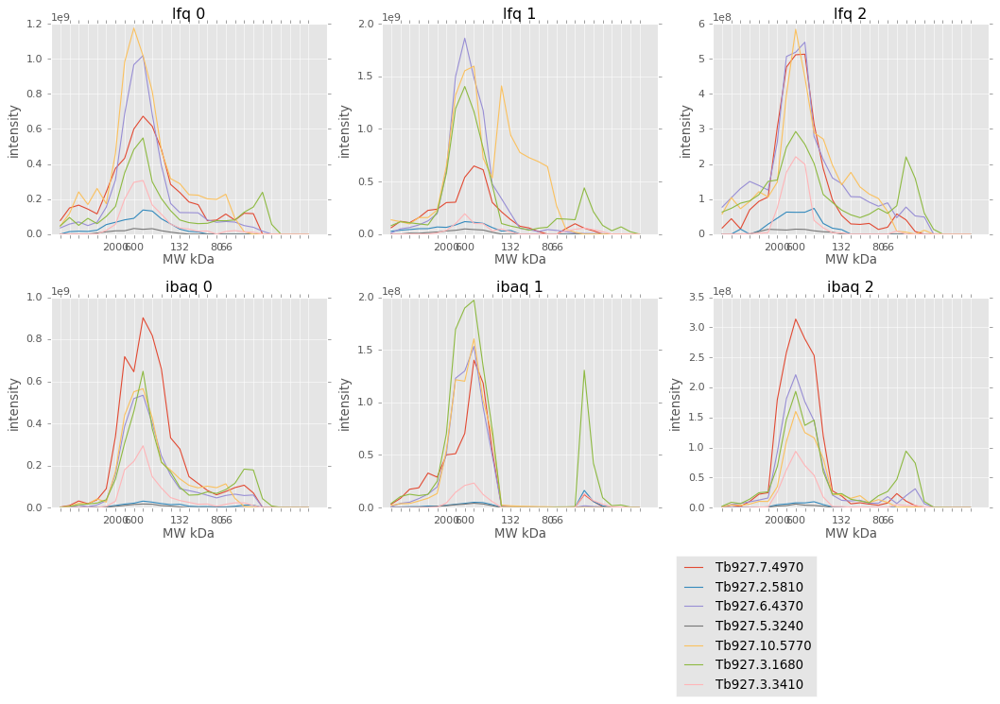

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.4970                   42               0   
Tb927.2.5810                  174               0   
Tb927.6.4370                   57               0   
Tb927.5.3240                   88               0   
Tb927.10.5770                  85               0   
Tb927.3.1680                   37               0   
Tb927.3.3410                   49               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.7.4970                      glutamine synthetase, putative  
Tb927.2.5810   Holliday-junction resolvase-like of SPT6/SH2 d...  
Tb927.6.4370   eukaryotic translation initiation factor 3 sub...  
Tb927.5.3240                     hypothetical protein, conserved  
Tb927.10.5770                         Valosin-containing protein  
Tb927.3.1680   Eukaryotic translation initiation fact

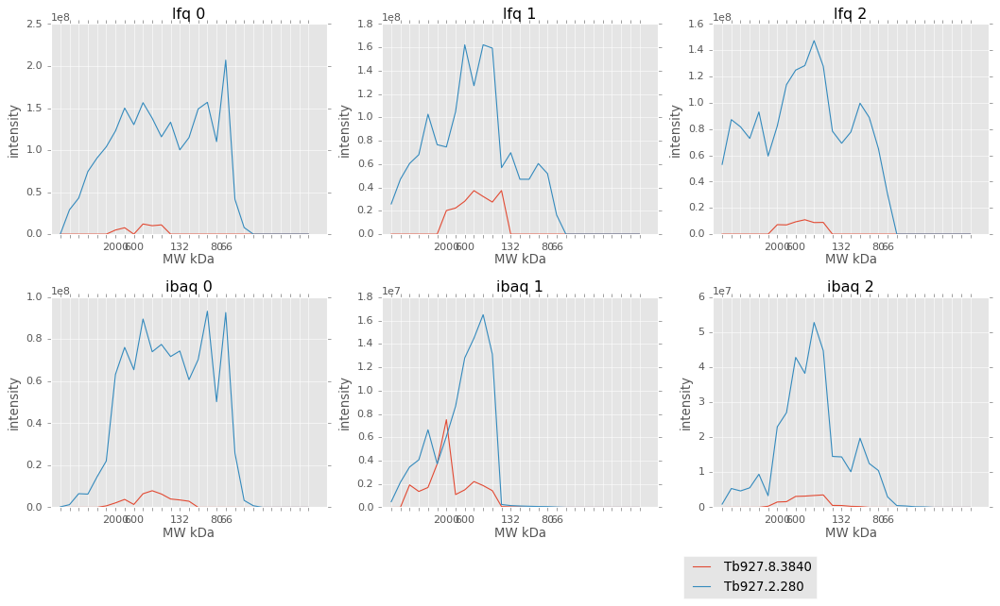

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.3840                  80               0   
Tb927.2.280                   90               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.3840                    hypothetical protein, conserved  
Tb927.2.280   retrotransposon hot spot protein 2 (RHS2), put...  
74 57 74 ['Tb927.8.3840', 'Tb927.2.280']


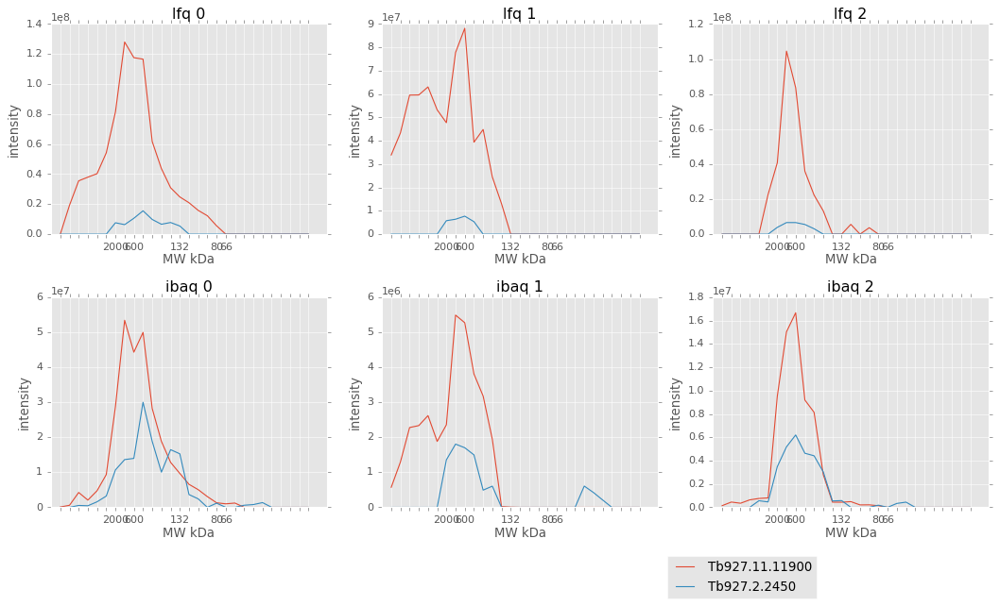

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11900                  97               0   
Tb927.2.2450                    46               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.11.11900                     Coatomer subunit gamma  
Tb927.2.2450    ribosomal RNA methyltransferase, putative  
74 33 83 ['Tb927.11.11900', 'Tb927.2.2450']


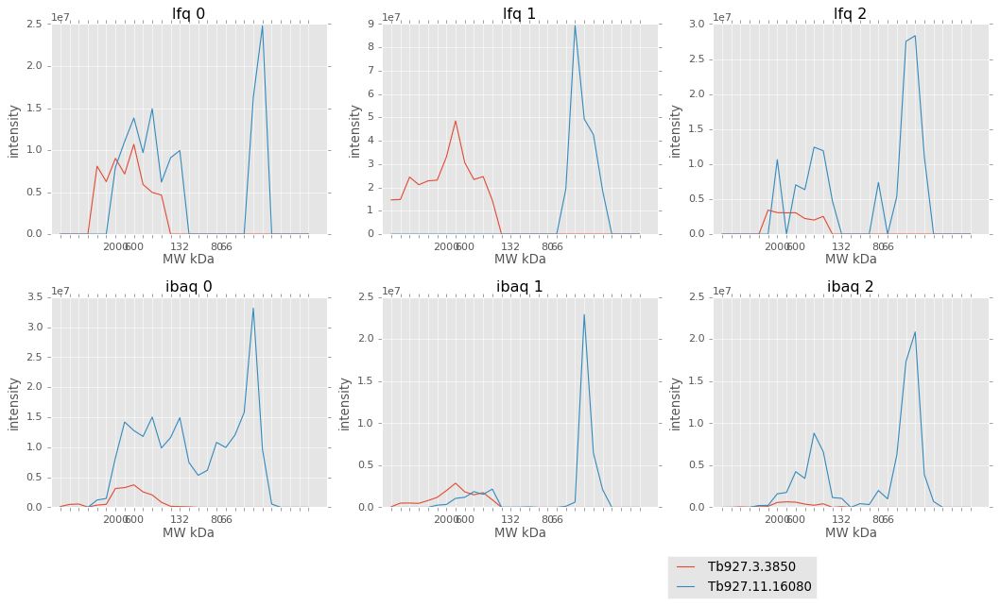

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.3850                   146               0   
Tb927.11.16080                  32               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.3.3850                 COPII coat assembly protein sec16  
Tb927.11.16080  Soluble NSF attachment protein, SNAP, putative  
74 32 80 ['Tb927.3.3850', 'Tb927.11.16080']


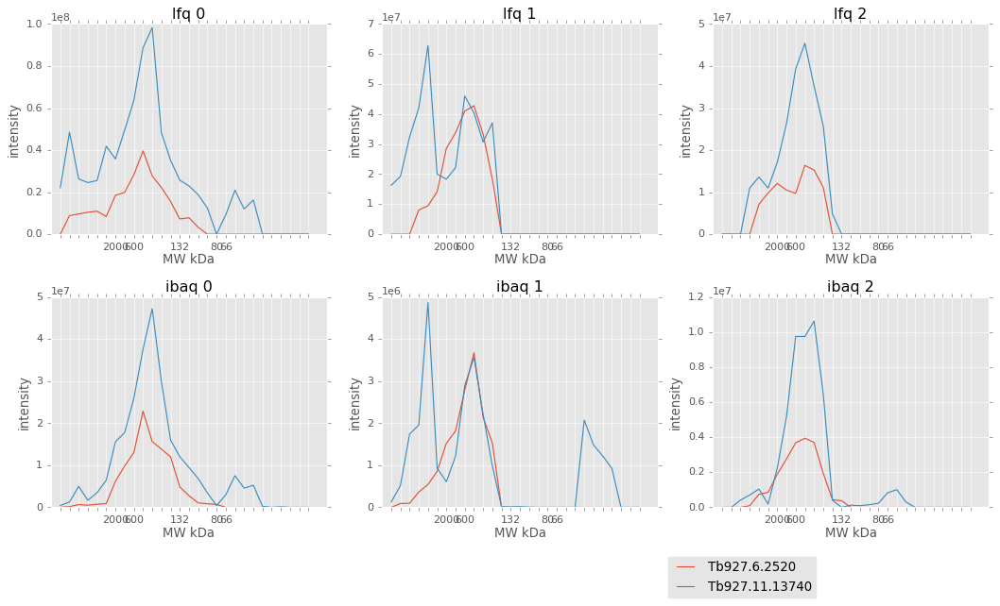

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.2520                    90               0   
Tb927.11.13740                 133               2   

                                            [Product Description]  
[Input ID]                                                         
Tb927.6.2520                      hypothetical protein, conserved  
Tb927.11.13740  procyclic-enriched flagellar receptor adenylat...  
74 58 71 ['Tb927.6.2520', 'Tb927.11.13740']


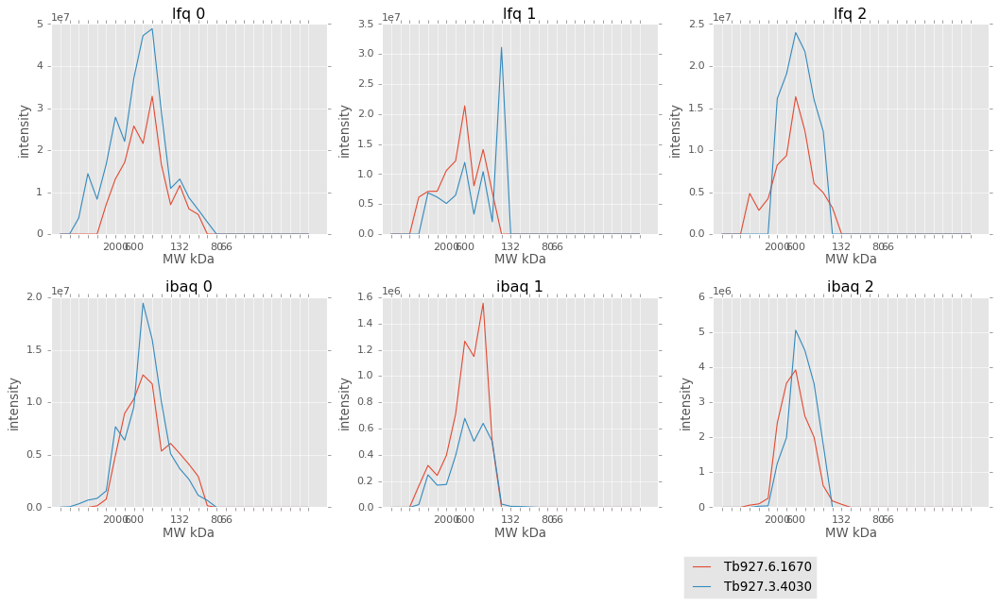

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.1670                 119               0   
Tb927.3.4030                 135               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.6.1670  PAB-dependent poly(A)-specific ribonuclease su...  
Tb927.3.4030                    hypothetical protein, conserved  
74 58 89 ['Tb927.6.1670', 'Tb927.3.4030']


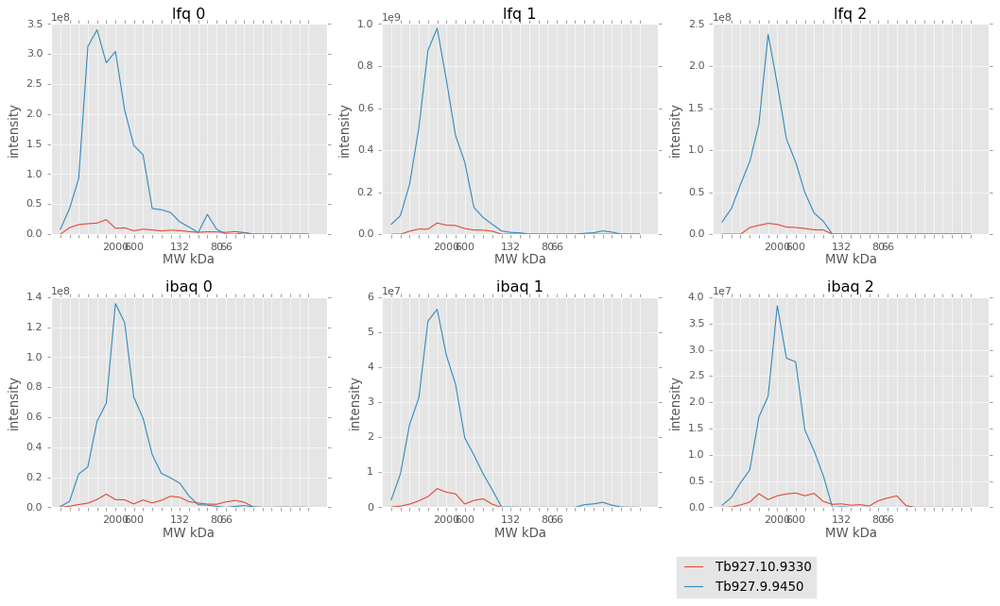

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.9330                  66               0   
Tb927.9.9450                  114               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.10.9330              hypothetical protein, conserved  
Tb927.9.9450   zinc finger protein family member, putative  
63 5 41 ['Tb927.10.9330', 'Tb927.9.9450']


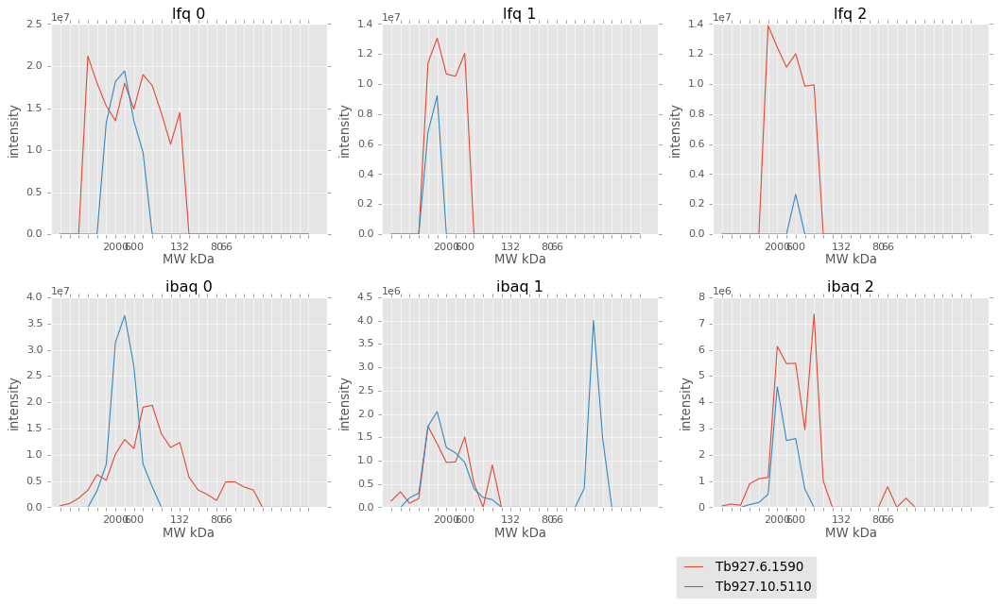

               [Molecular Weight]  [# TM Domains] [Product Description]
[Input ID]                                                             
Tb927.6.1590                   57               0     conserved protein
Tb927.10.5110                  23               0                KREPA4
85 18 83 ['Tb927.6.1590', 'Tb927.10.5110']


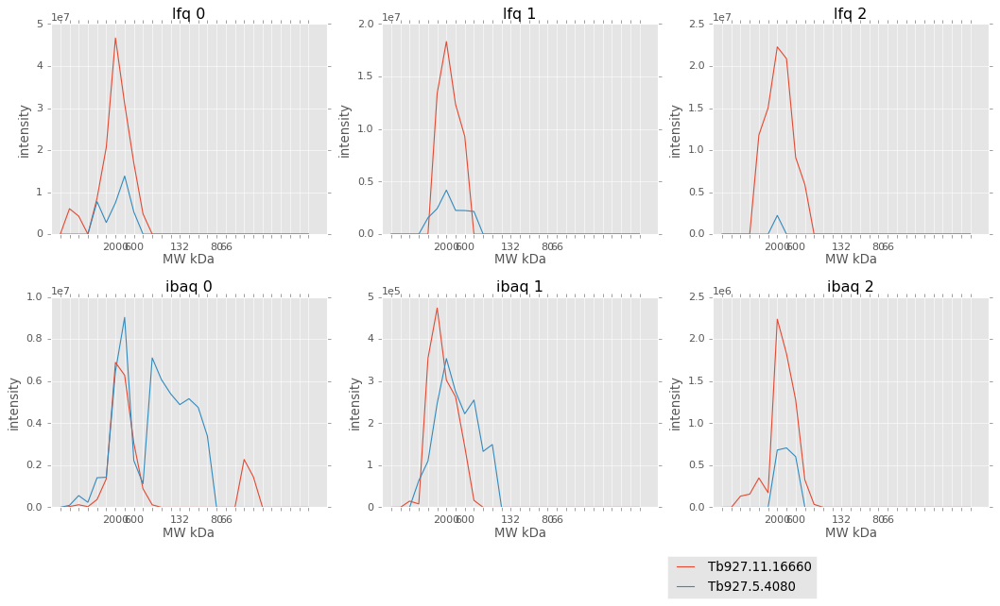

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.16660                 234               0   
Tb927.5.4080                    58               0   

                          [Product Description]  
[Input ID]                                       
Tb927.11.16660      Dopey, N-terminal, putative  
Tb927.5.4080    hypothetical protein, conserved  
85 27 80 ['Tb927.11.16660', 'Tb927.5.4080']


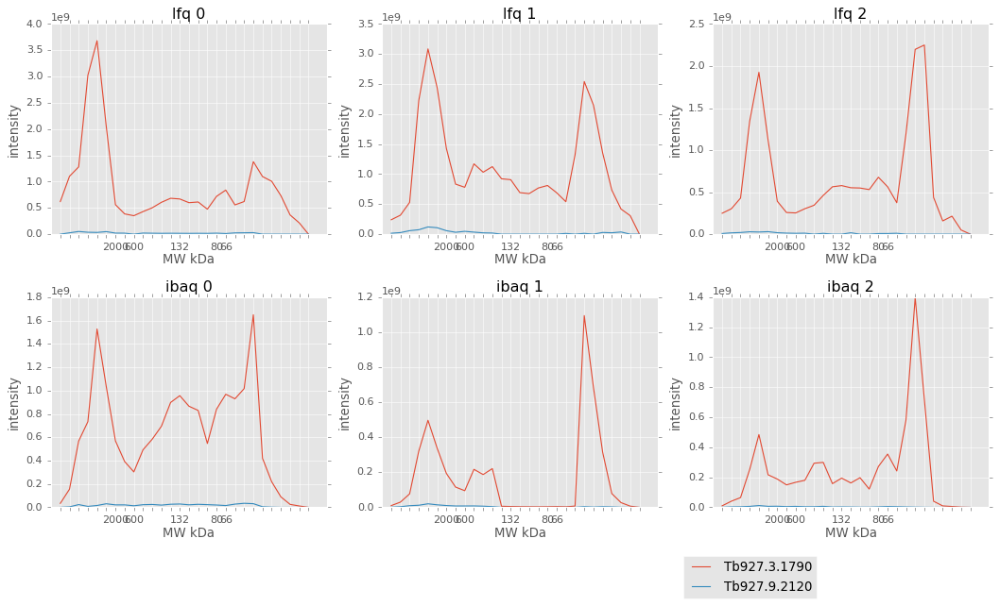

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.1790                  37               0   
Tb927.9.2120                  30               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.3.1790  pyruvate dehydrogenase E1 beta subunit, putative  
Tb927.9.2120                   hypothetical protein, conserved  
23 7 33 ['Tb927.3.1790', 'Tb927.9.2120']


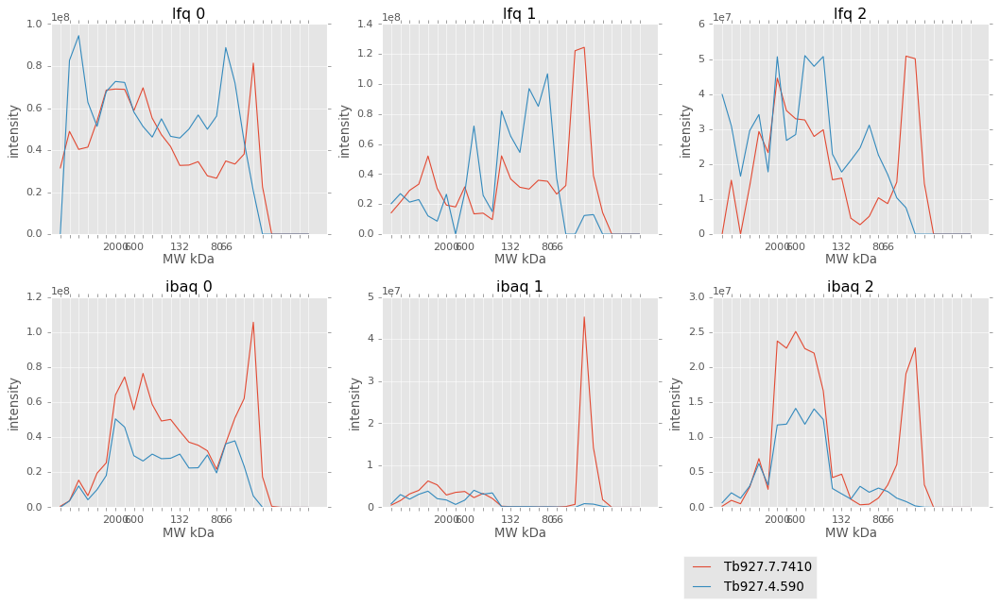

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.7410                  35               0   
Tb927.4.590                   88               1   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.7410            Trans-2-enoyl-ACP reductase 2, putative  
Tb927.4.590   PQQ-like domain/Protein of unknown function (D...  
28 24 93 ['Tb927.7.7410', 'Tb927.4.590']


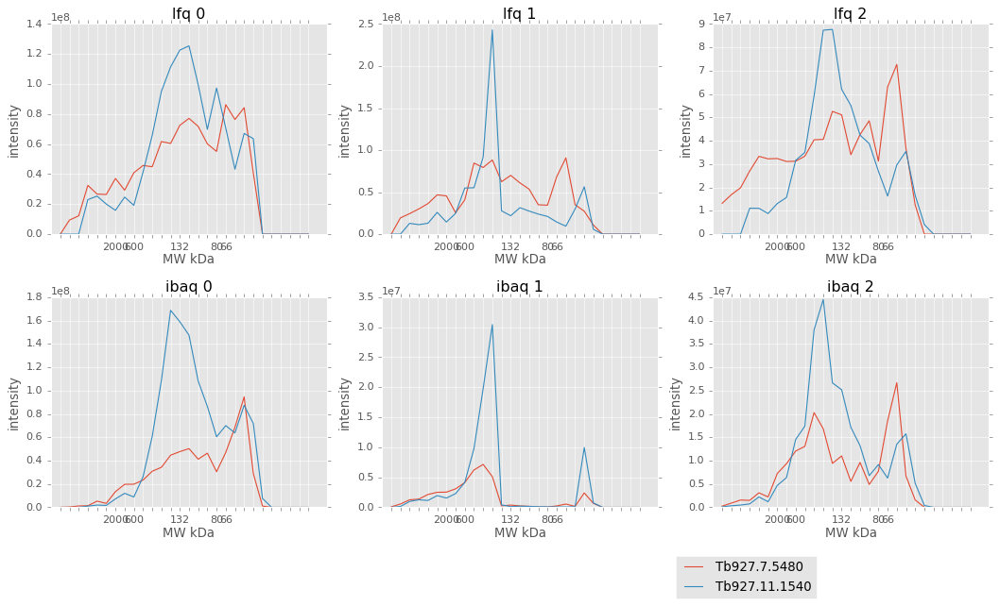

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.5480                   58               0   
Tb927.11.1540                  44               0   

                                      [Product Description]  
[Input ID]                                                   
Tb927.7.5480   dihydrofolate reductase-thymidylate synthase  
Tb927.11.1540        isovaleryl-coA dehydrogenase, putative  
28 72 4 ['Tb927.7.5480', 'Tb927.11.1540']


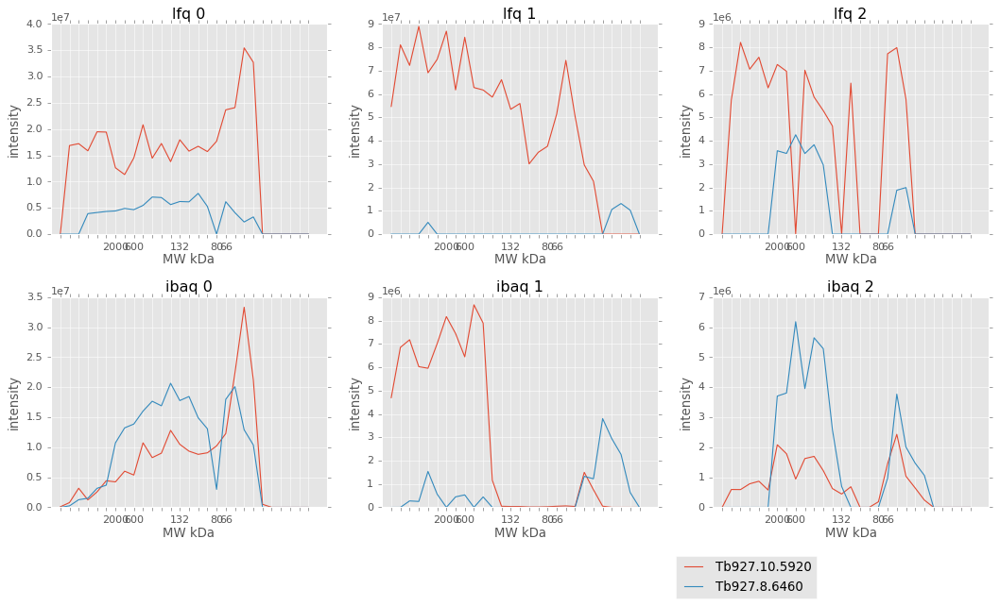

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.5920                  85               0   
Tb927.8.6460                   19               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.10.5920           hypothetical protein, conserved  
Tb927.8.6460   kinase binding protein CGI-121, putative  
28 62 53 ['Tb927.10.5920', 'Tb927.8.6460']


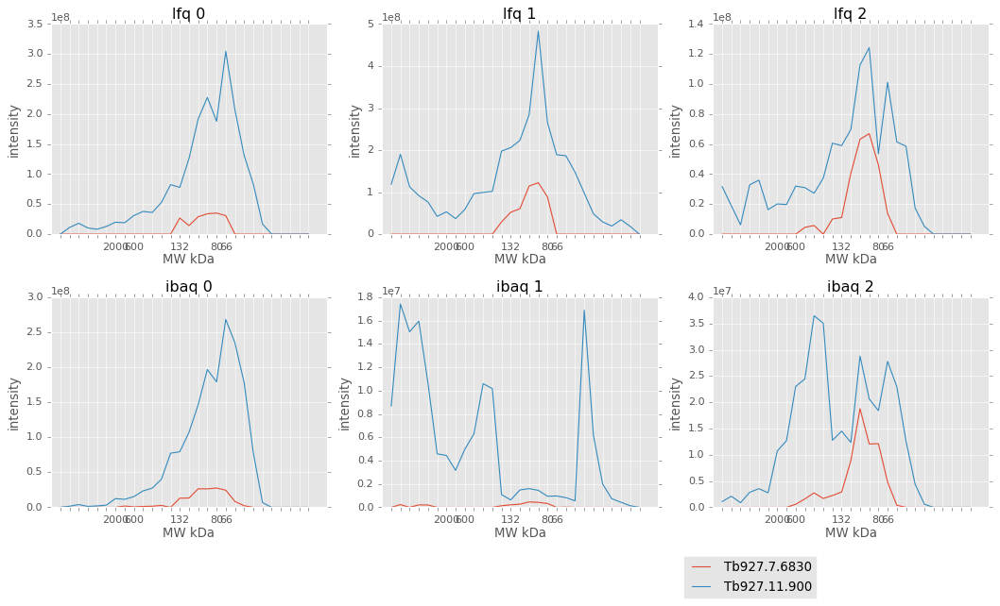

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.6830                  47               0   
Tb927.11.900                  46               0   

                           [Product Description]  
[Input ID]                                        
Tb927.7.6830           trans-sialidase, putative  
Tb927.11.900  isocitrate dehydrogenase, putative  
16 41 27 ['Tb927.7.6830', 'Tb927.11.900']


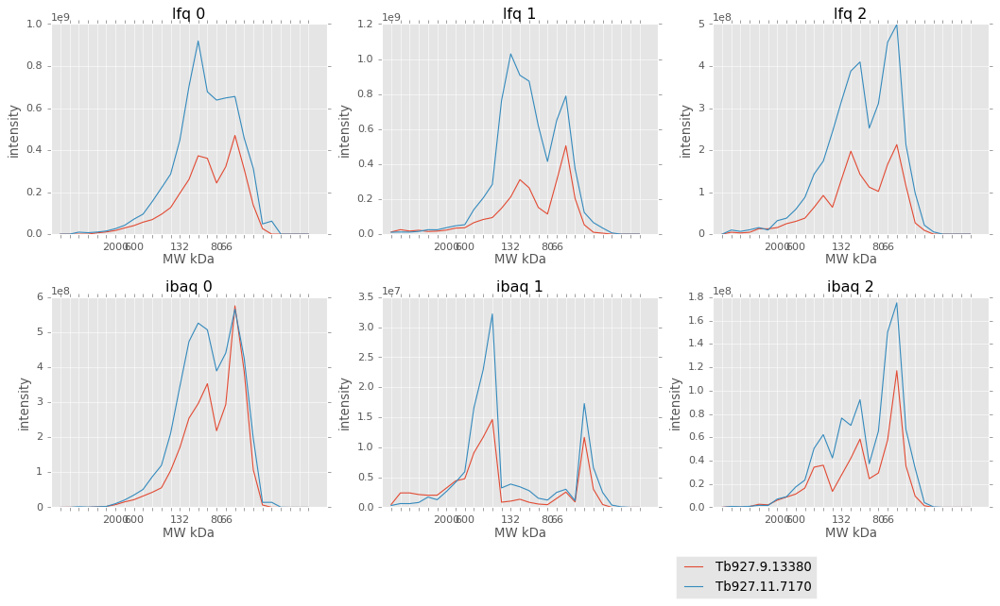

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.13380                  48               0   
Tb927.11.7170                  53               0   

                      [Product Description]  
[Input ID]                                   
Tb927.9.13380  Autophagy-related protein 24  
Tb927.11.7170         seryl-tRNA synthetase  
16 46 3 ['Tb927.9.13380', 'Tb927.11.7170']


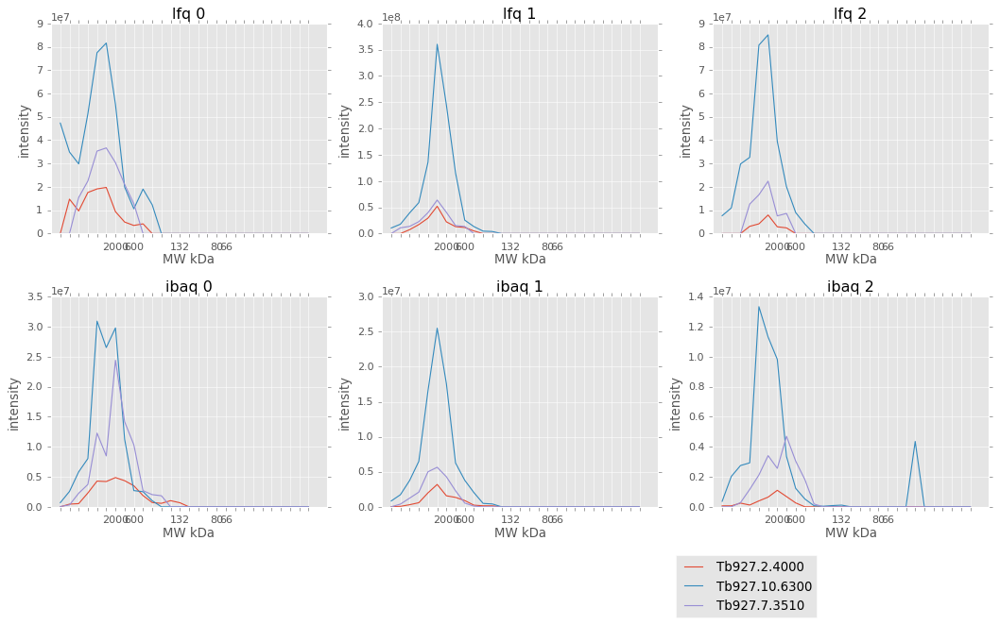

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.2.4000                   97               0   
Tb927.10.6300                  50               0   
Tb927.7.3510                   56               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.2.4000                  hypothetical protein, conserved  
Tb927.10.6300              Mitochondrial ribosomal protein S5  
Tb927.7.3510   LSU ribosomal protein, mitochondrial, putative  
64 4 35 ['Tb927.2.4000', 'Tb927.10.6300', 'Tb927.7.3510']


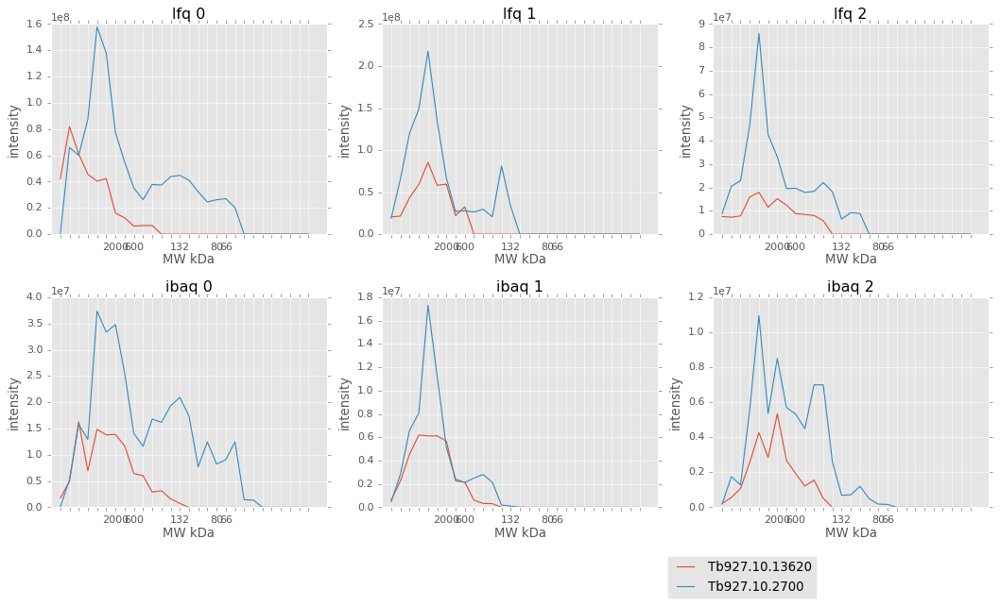

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.13620                  54               0   
Tb927.10.2700                   75               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.10.13620  nadh-ubiquinone oxidoreductase 39 kda subunit  
Tb927.10.2700                   predicted WD40 repeat protein  
64 7 33 ['Tb927.10.13620', 'Tb927.10.2700']


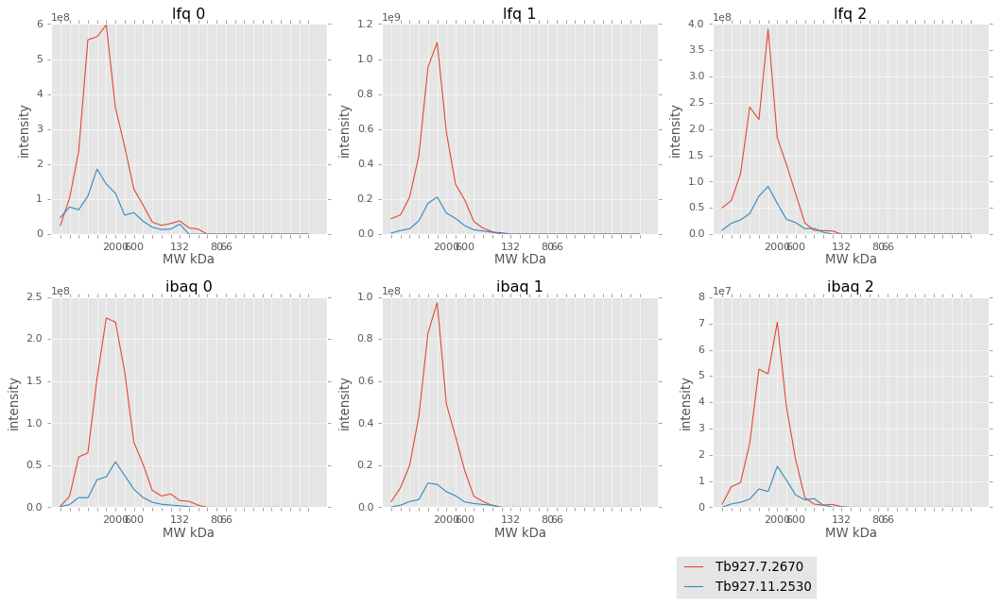

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.2670                   49               0   
Tb927.11.2530                  84               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.7.2670     zinc finger protein family member, putative  
Tb927.11.2530  Mitochondrial SSU ribosomal protein, putative  
64 7 40 ['Tb927.7.2670', 'Tb927.11.2530']


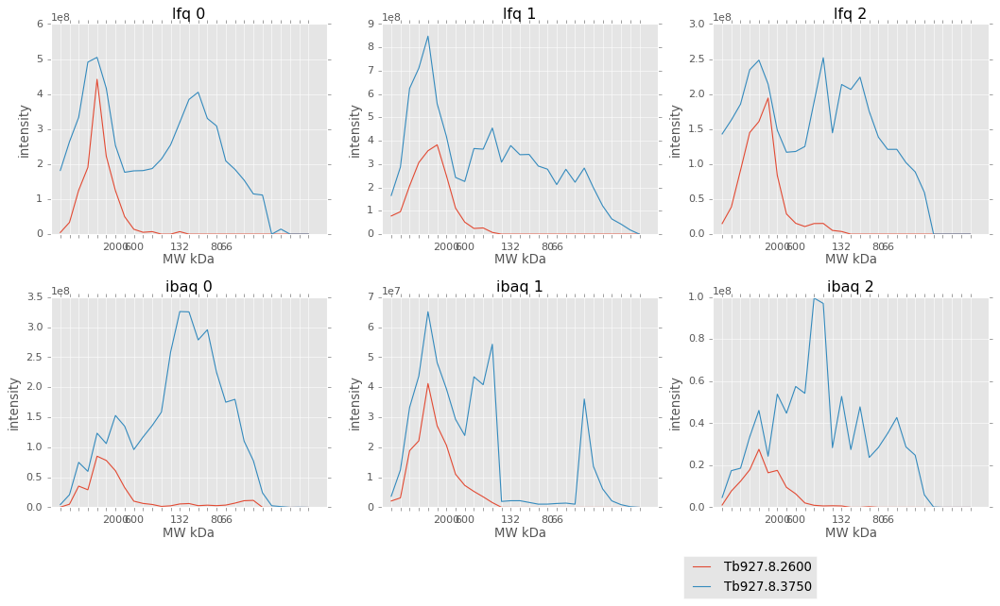

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.2600                  73               0   
Tb927.8.3750                  54               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.2600  WD domain, G-beta repeat/BING4CT (NUC141) doma...  
Tb927.8.3750                               nucleolar protein 56  
64 7 48 ['Tb927.8.2600', 'Tb927.8.3750']


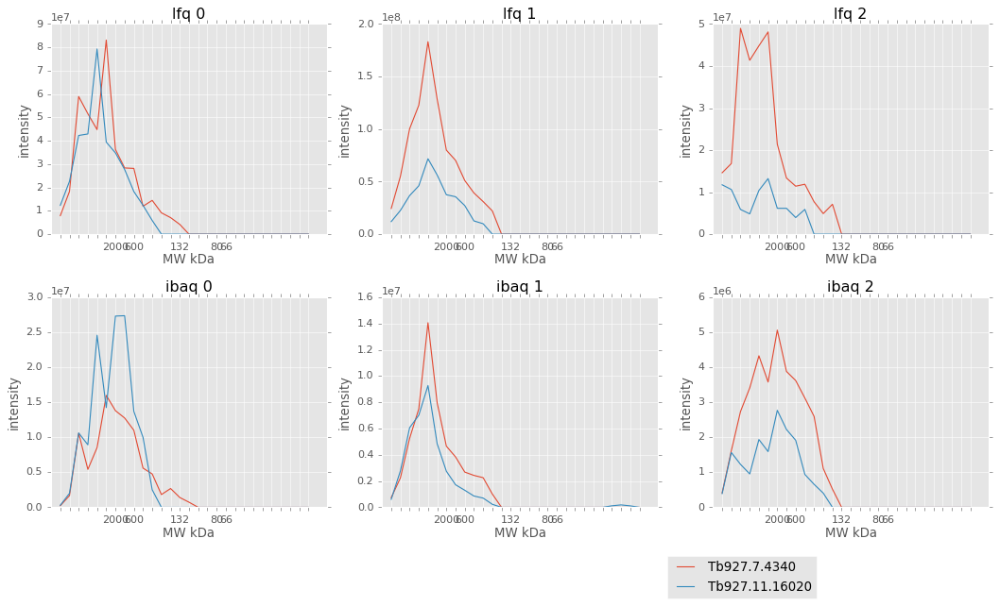

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.4340                    98               0   
Tb927.11.16020                  50               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.4340    Protein of unknown function (DUF1253), putative  
Tb927.11.16020                    RNA-binding protein, putative  
64 7 43 ['Tb927.7.4340', 'Tb927.11.16020']


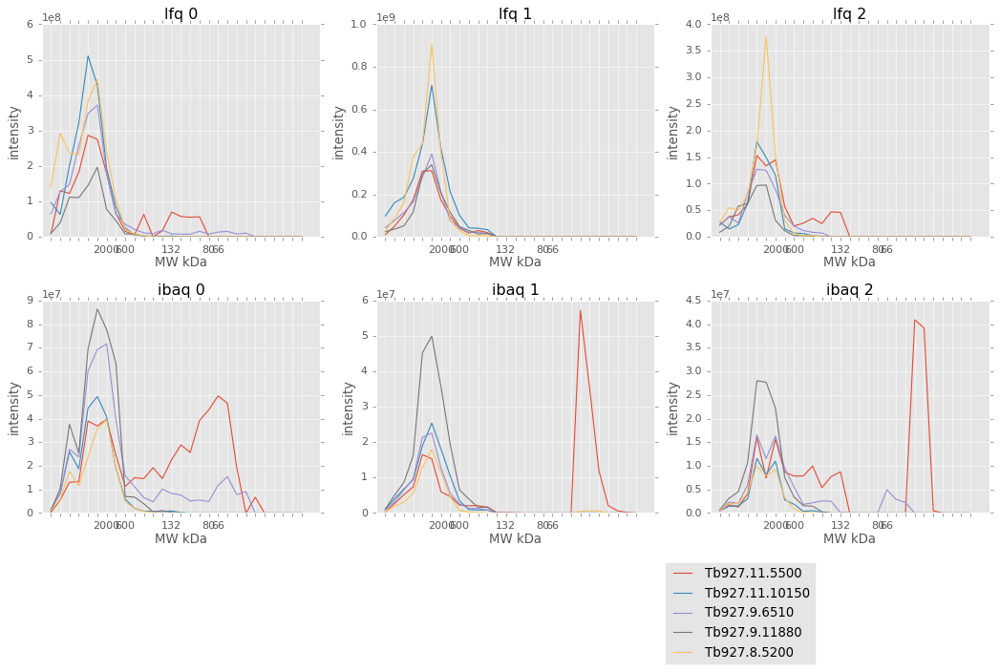

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.5500                   94               0   
Tb927.11.10150                 137               0   
Tb927.9.6510                    75               0   
Tb927.9.11880                   51               0   
Tb927.8.5200                   201               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.11.5500    Mitochondrial SSU ribosomal protein, putative  
Tb927.11.10150  Enoyl-CoA hydratase/isomerase family, putative  
Tb927.9.6510     Mitochondrial SSU ribosomal protein, putative  
Tb927.9.11880    Mitochondrial SSU ribosomal protein, putative  
Tb927.8.5200     Mitochondrial SSU ribosomal protein, putative  
64 3 35 ['Tb927.11.5500', 'Tb927.11.10150', 'Tb927.9.6510', 'Tb927.9.11880', 'Tb927.8.5200']


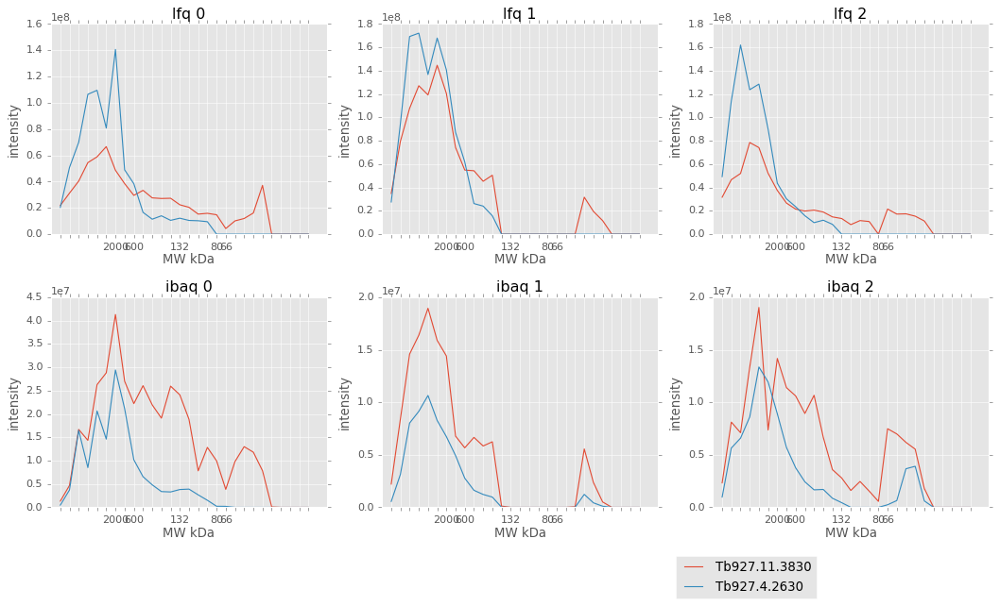

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.3830                  39               0   
Tb927.4.2630                   94               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.11.3830              hypothetical protein, conserved  
Tb927.4.2630   ATP-dependent DEAD/H RNA helicase, putative  
64 8 47 ['Tb927.11.3830', 'Tb927.4.2630']


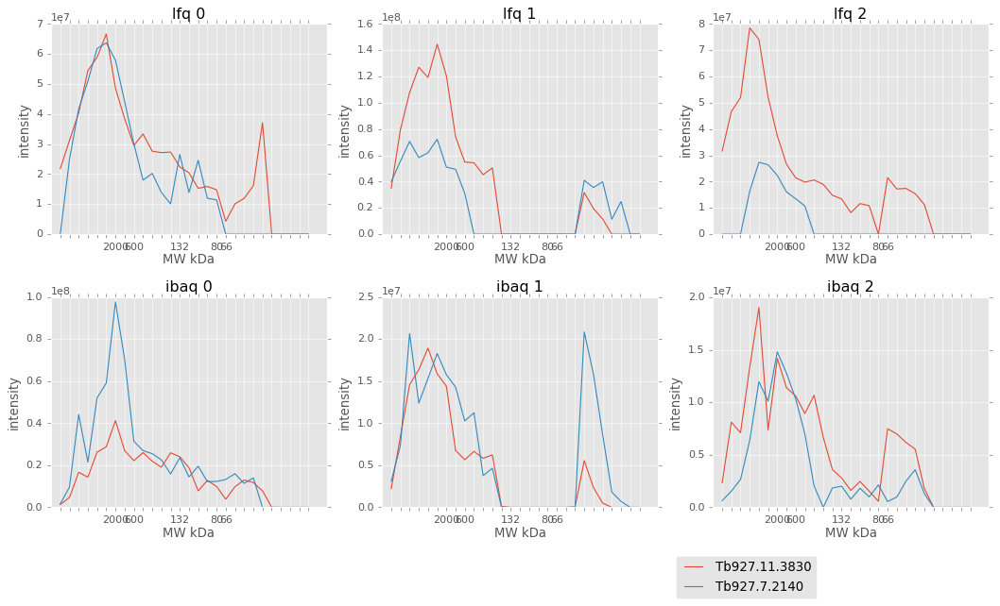

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.3830                  39               0   
Tb927.7.2140                   40               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.11.3830              hypothetical protein, conserved  
Tb927.7.2140   zinc finger protein family member, putative  
64 8 67 ['Tb927.11.3830', 'Tb927.7.2140']


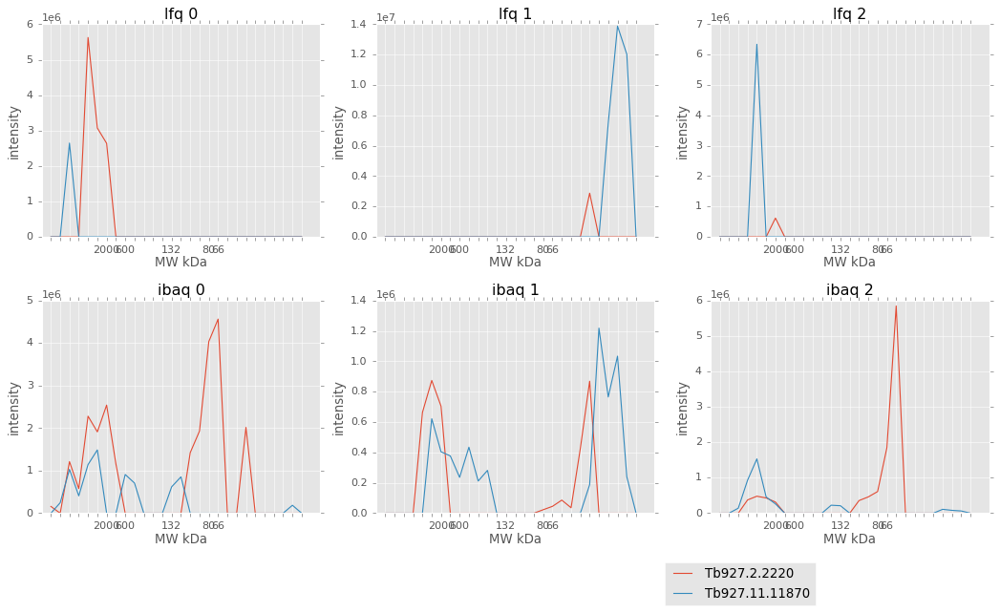

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.2.2220                    34               0   
Tb927.11.11870                  38               0   

                              [Product Description]  
[Input ID]                                           
Tb927.2.2220        hypothetical protein, conserved  
Tb927.11.11870  ADP-ribosylglycohydrolase, putative  
66 4 33 ['Tb927.2.2220', 'Tb927.11.11870']


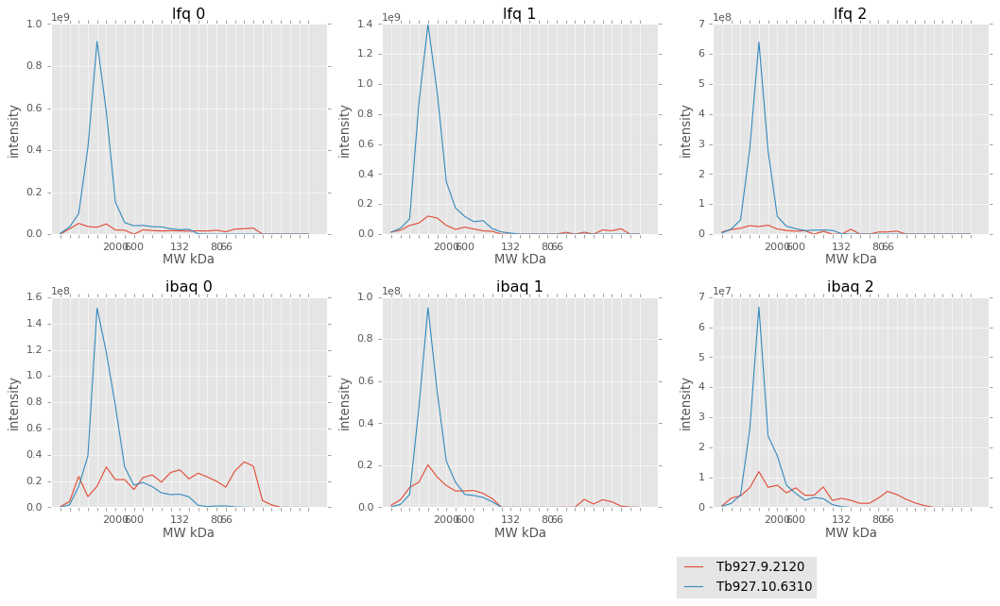

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.2120                   30               0   
Tb927.10.6310                  96               0   

                         [Product Description]  
[Input ID]                                      
Tb927.9.2120   hypothetical protein, conserved  
Tb927.10.6310    major vault protein, putative  
66 7 33 ['Tb927.9.2120', 'Tb927.10.6310']


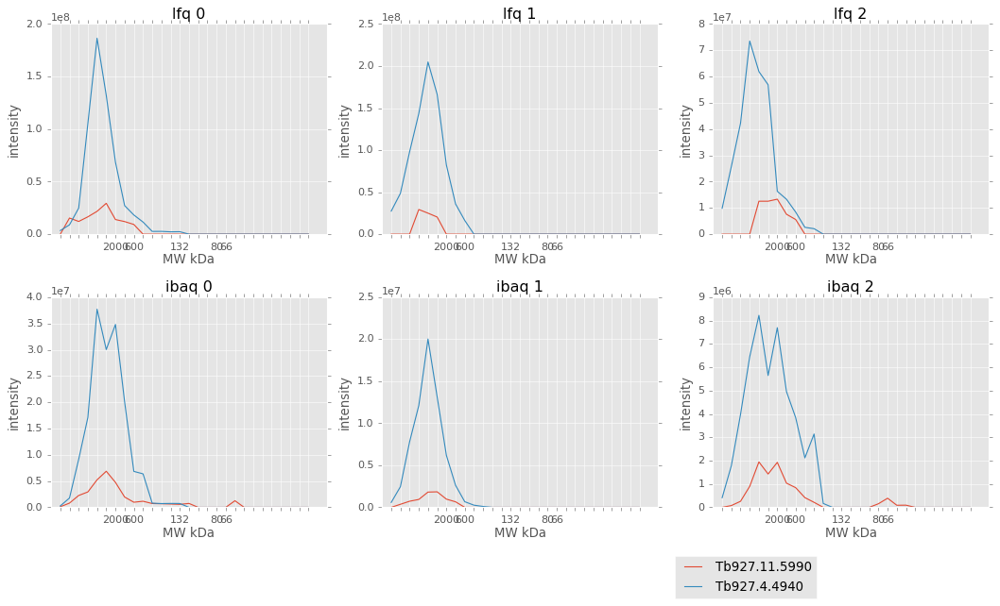

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.5990                  69               0   
Tb927.4.4940                   73               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.5990  LSU ribosomal protein, mitochondrial, putative  
Tb927.4.4940                  hypothetical protein, conserved  
66 7 36 ['Tb927.11.5990', 'Tb927.4.4940']


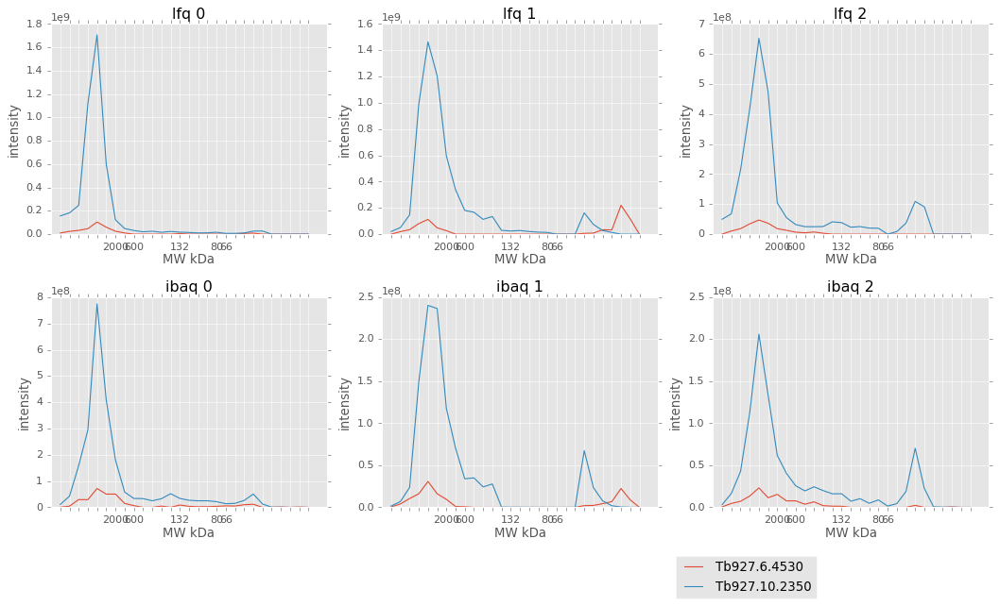

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.6.4530                   16               0   
Tb927.10.2350                  27               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.6.4530                       RNA-binding protein, putative  
Tb927.10.2350  pyruvate dehydrogenase complex E3 binding prot...  
66 7 48 ['Tb927.6.4530', 'Tb927.10.2350']


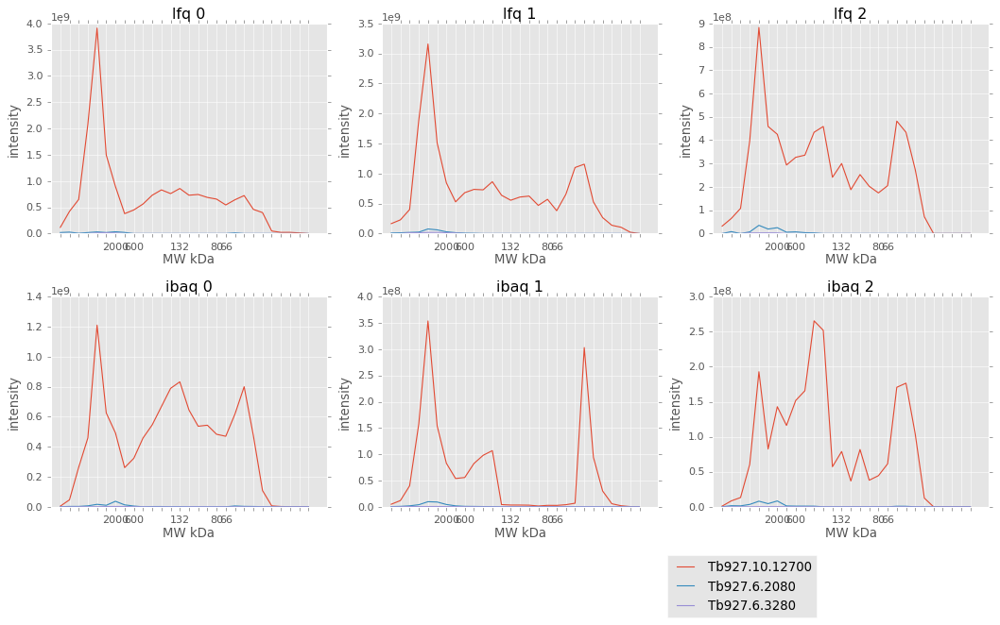

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.12700                  42               0   
Tb927.6.2080                    45               0   
Tb927.6.3280                   202               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.12700  pyruvate dehydrogenase E1 alpha subunit, putative  
Tb927.6.2080        Mitochondrial SSU ribosomal protein, putative  
Tb927.6.3280                        cyclosome subunit 1, putative  
66 3 35 ['Tb927.10.12700', 'Tb927.6.2080', 'Tb927.6.3280']


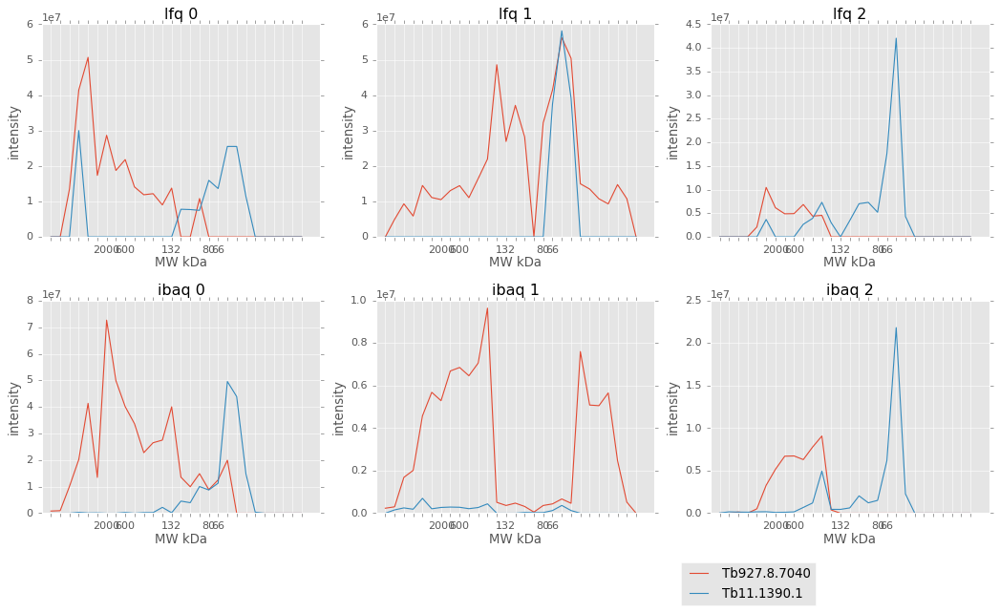

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.7040                  21               0   
Tb11.1390.1                   62               6   

                        [Product Description]  
[Input ID]                                     
Tb927.8.7040  hypothetical protein, conserved  
Tb11.1390.1   hypothetical protein, conserved  
61 18 63 ['Tb927.8.7040', 'Tb11.1390.1']


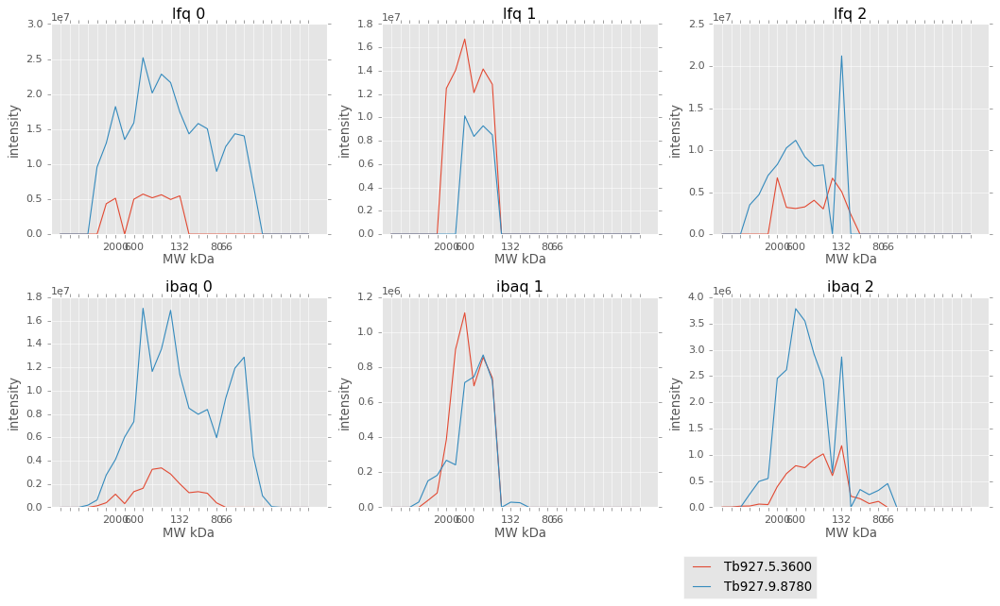

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.3600                  90               0   
Tb927.5.3600                 103               0   
Tb927.9.8780                  58               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.5.3600  ATP-dependent DEAD/H RNA helicase, putative  
Tb927.5.3600  ATP-dependent DEAD/H RNA helicase, putative  
Tb927.9.8780        tRNA nucleotidyltransferase, putative  
32 57 77 ['Tb927.5.3600', 'Tb927.9.8780']


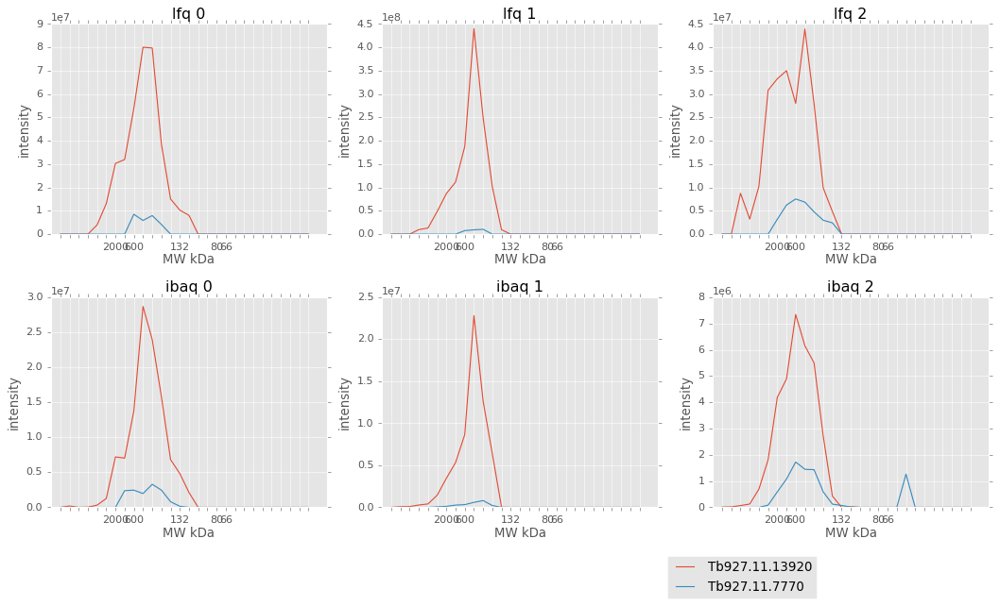

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.13920                 124               0   
Tb927.11.7770                   96               0   

                             [Product Description]  
[Input ID]                                          
Tb927.11.13920  kinesin-II 85 Kd subunit, putative  
Tb927.11.7770          oxidoreductase-like protein  
32 60 85 ['Tb927.11.13920', 'Tb927.11.7770']


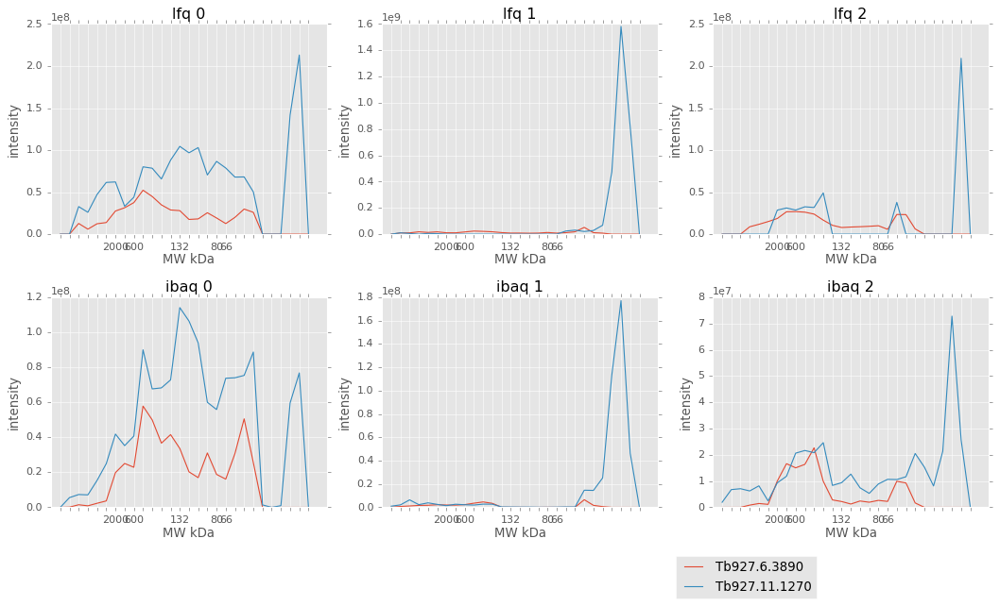

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.6.3890                   38               0   
Tb927.11.1270                  20               2   

                                      [Product Description]  
[Input ID]                                                   
Tb927.6.3890      replication factor C, subunit 2, putative  
Tb927.11.1270  Mitochondrial ATP synthase subunit, putative  
32 16 90 ['Tb927.6.3890', 'Tb927.11.1270']


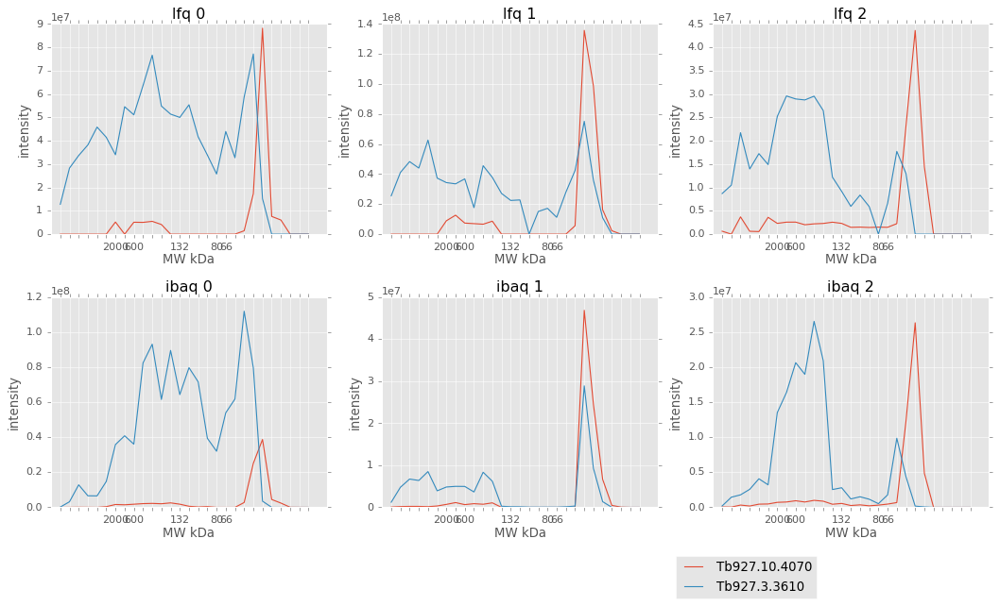

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.4070                  36               0   
Tb927.3.3610                   39               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.4070                    hypothetical protein, conserved  
Tb927.3.3610   peroxisomal targeting signal 2 receptor, putative  
32 26 74 ['Tb927.10.4070', 'Tb927.3.3610']


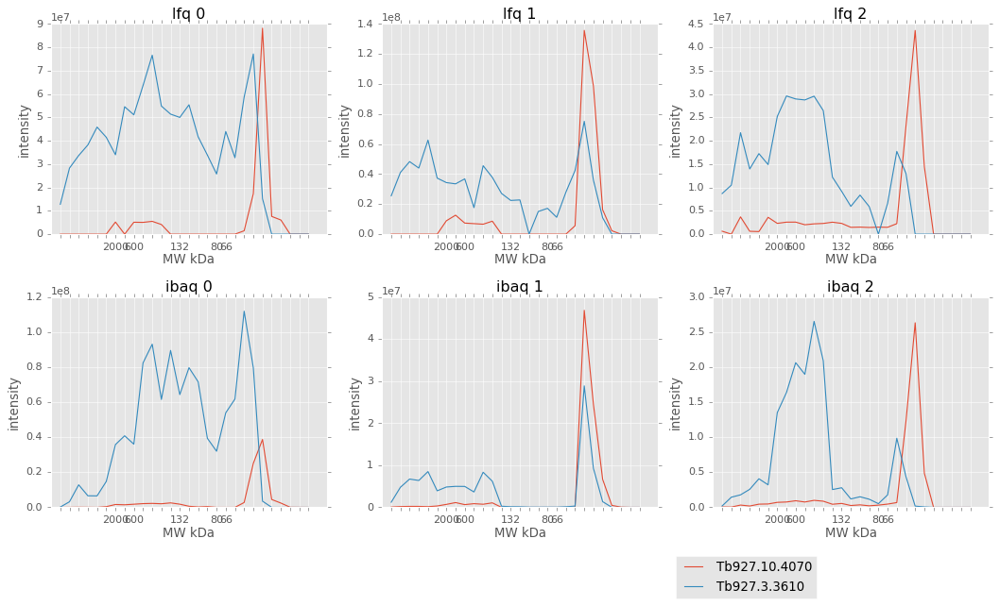

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.4070                  36               0   
Tb927.3.3610                   39               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.4070                    hypothetical protein, conserved  
Tb927.3.3610   peroxisomal targeting signal 2 receptor, putative  
32 75 74 ['Tb927.10.4070', 'Tb927.3.3610']


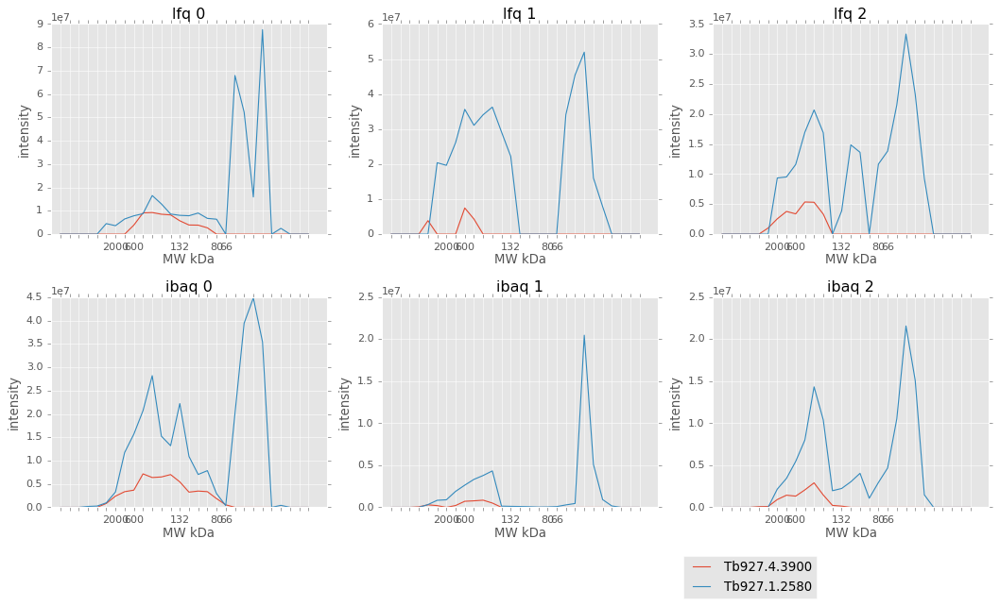

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.3900                  45               0   
Tb927.1.2580                  42               0   

                        [Product Description]  
[Input ID]                                     
Tb927.4.3900  hypothetical protein, conserved  
Tb927.1.2580     exosome-associated protein 1  
43 57 63 ['Tb927.4.3900', 'Tb927.1.2580']


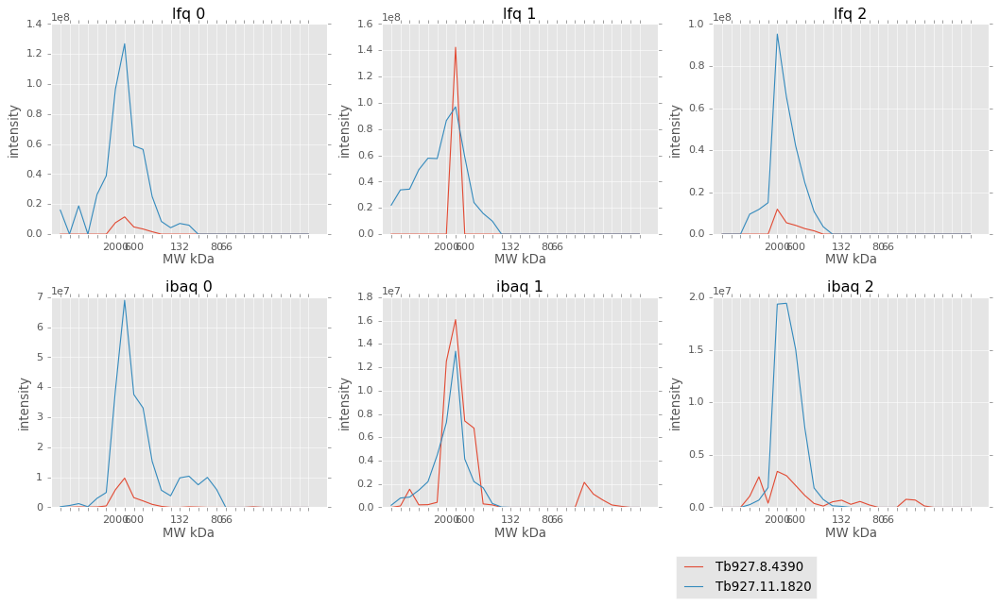

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.4390                   51               0   
Tb927.11.1820                  68               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.8.4390   translation initiation factor eIF-2B subunit b...  
Tb927.11.1820  translation initiation factor eIF2B delta subu...  
94 29 77 ['Tb927.8.4390', 'Tb927.11.1820']


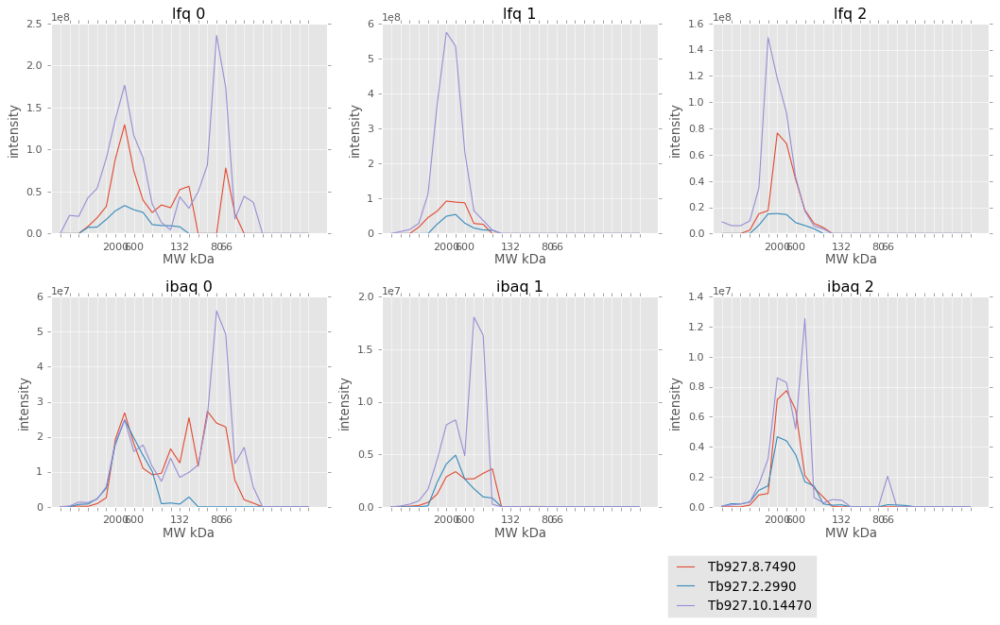

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.8.7490                   157               0   
Tb927.2.2990                    61               0   
Tb927.10.14470                 186               0   

                               [Product Description]  
[Input ID]                                            
Tb927.8.7490                               symplekin  
Tb927.2.2990         hypothetical protein, conserved  
Tb927.10.14470  intraflagellar transport protein 140  
94 31 79 ['Tb927.8.7490', 'Tb927.2.2990', 'Tb927.10.14470']


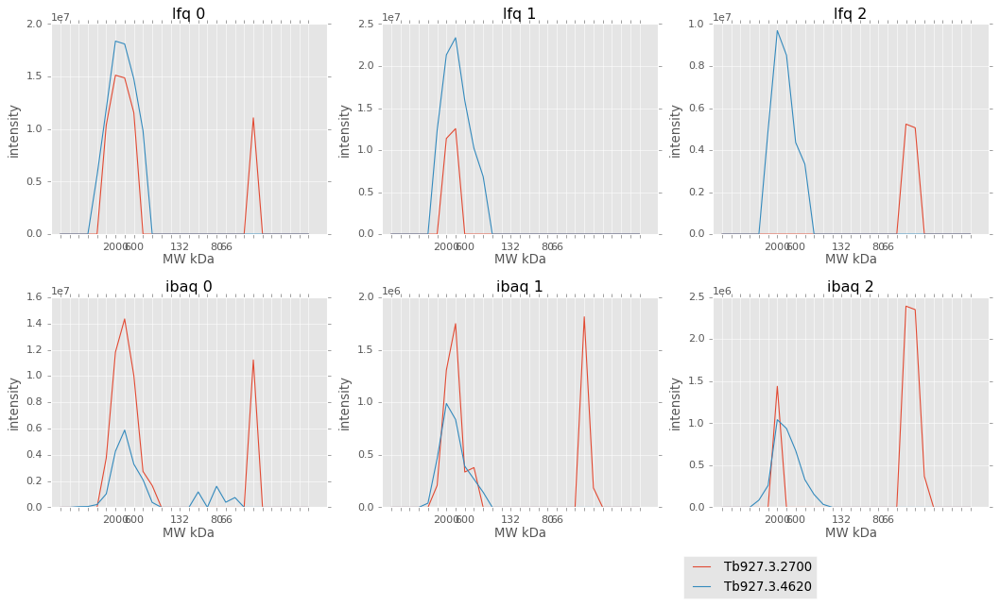

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.2700                  42               0   
Tb927.3.4620                 160               0   

                                [Product Description]  
[Input ID]                                             
Tb927.3.2700          hypothetical protein, conserved  
Tb927.3.4620  AAA domain containing protein, putative  
94 26 39 ['Tb927.3.2700', 'Tb927.3.4620']


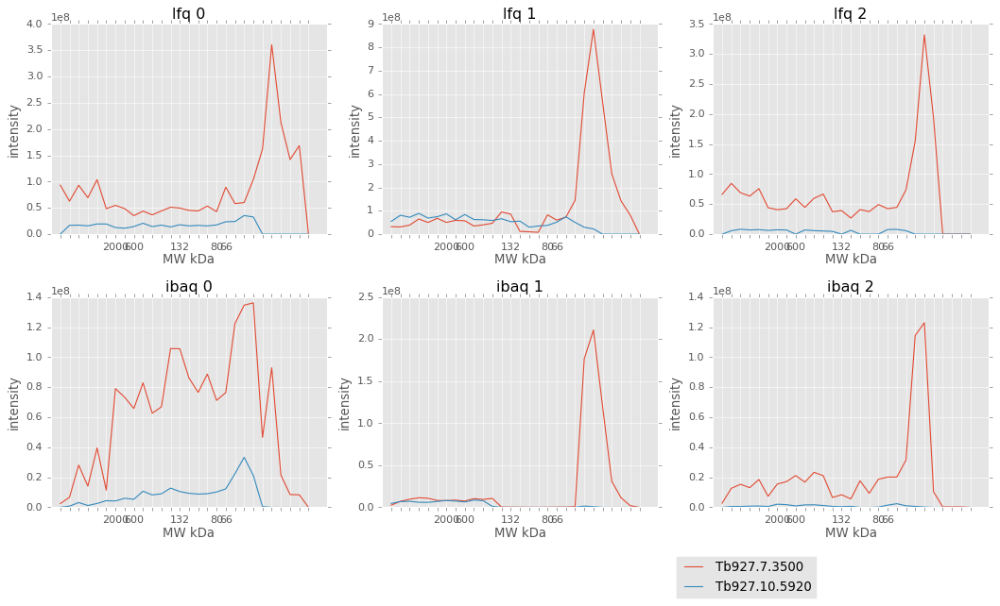

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.3500                   35               0   
Tb927.10.5920                  85               0   

                         [Product Description]  
[Input ID]                                      
Tb927.7.3500          Prostaglandin E synthase  
Tb927.10.5920  hypothetical protein, conserved  
60 62 48 ['Tb927.7.3500', 'Tb927.10.5920']


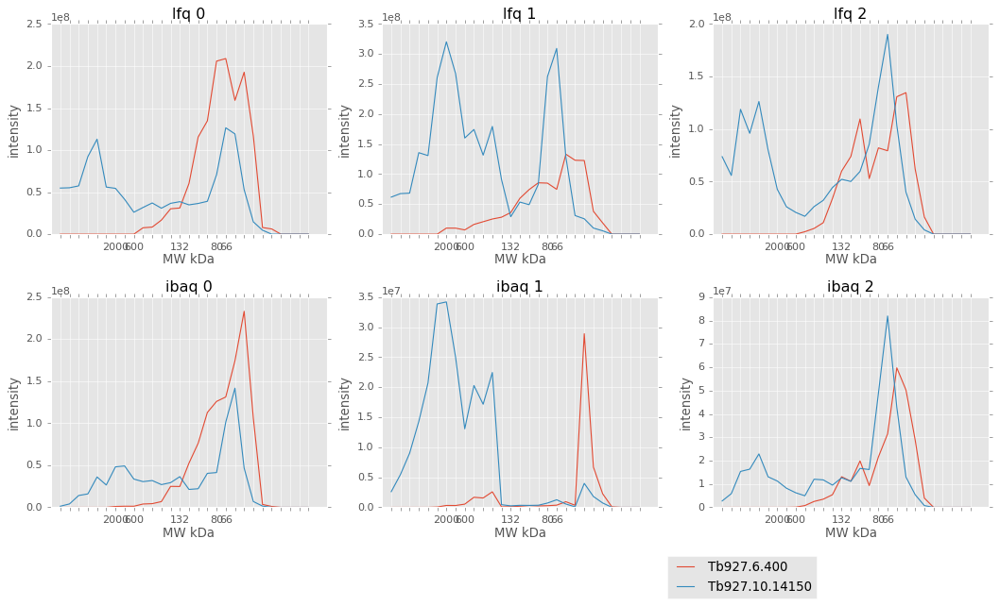

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.400                     52               0   
Tb927.10.14150                  55               0   

                                [Product Description]  
[Input ID]                                             
Tb927.6.400           peptidase M20/M25/M40, putative  
Tb927.10.14150  nuclear segregation protein, putative  
6 75 28 ['Tb927.6.400', 'Tb927.10.14150']


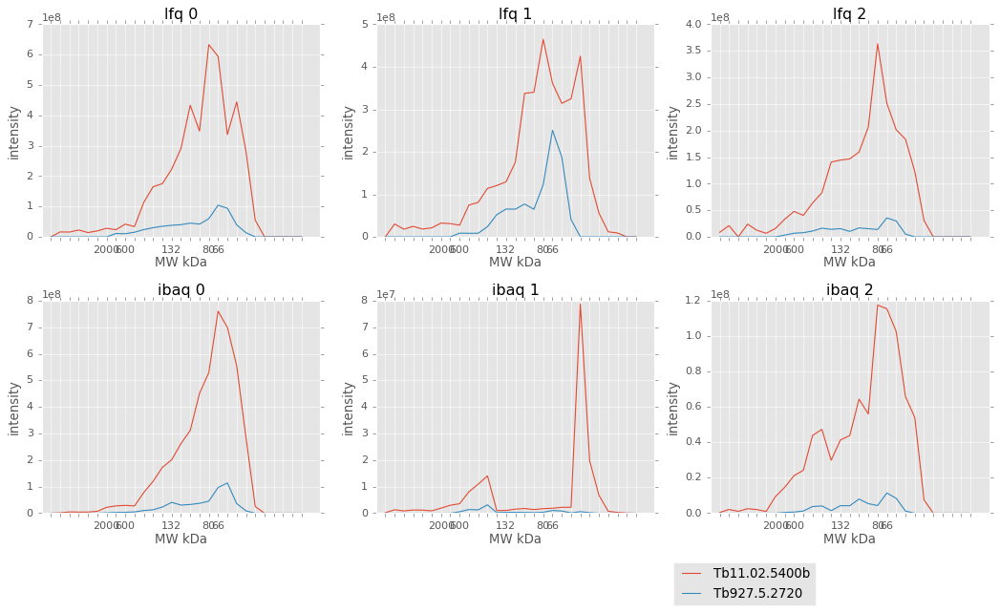

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb11.02.5400b                  39               0   
Tb927.5.2720                   53               0   

                               [Product Description]  
[Input ID]                                            
Tb11.02.5400b  cystathionine beta-synthase, putative  
Tb927.5.2720                zinc finger protein ZPR1  
6 41 3 ['Tb11.02.5400b', 'Tb927.5.2720']


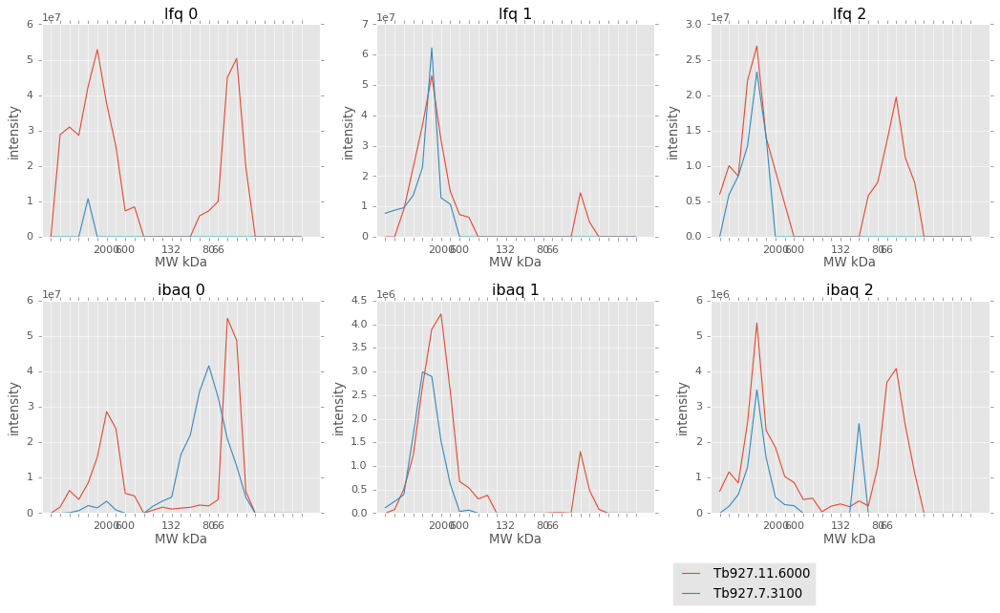

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.6000                  53               0   
Tb927.7.3100                   69               0   

                            [Product Description]  
[Input ID]                                         
Tb927.11.6000  mitochondrial ribosomal protein L4  
Tb927.7.3100      hypothetical protein, conserved  
68 4 33 ['Tb927.11.6000', 'Tb927.7.3100']


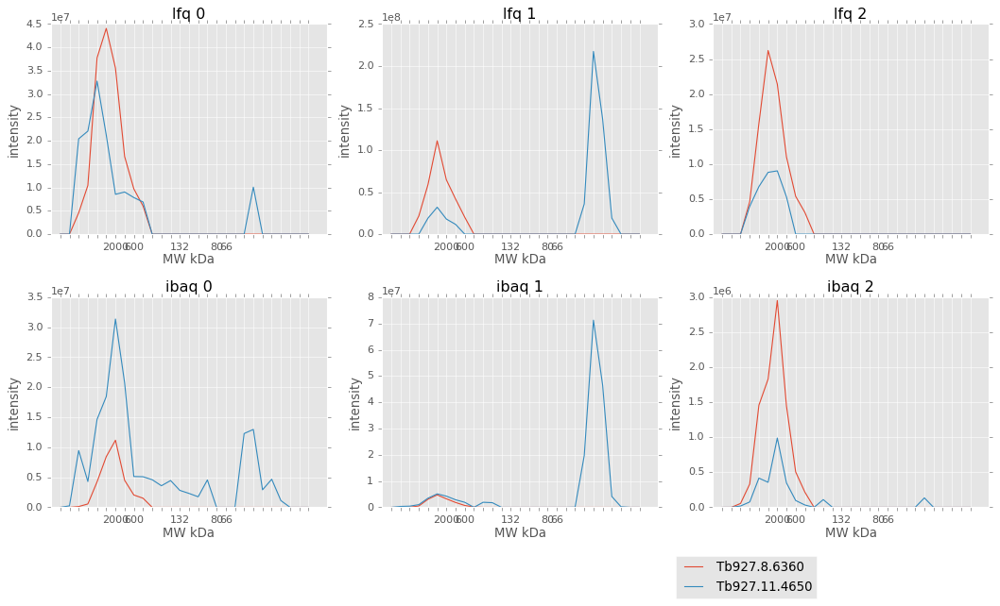

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.6360                   97               0   
Tb927.11.4650                  29               0   
Tb927.11.4650                 167               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.8.6360            SPRY domain containing protein, putative  
Tb927.11.4650  Mitochondrial ribosomal protein L52, kinetopla...  
Tb927.11.4650  Mitochondrial ribosomal protein L52, kinetopla...  
68 4 40 ['Tb927.8.6360', 'Tb927.11.4650']


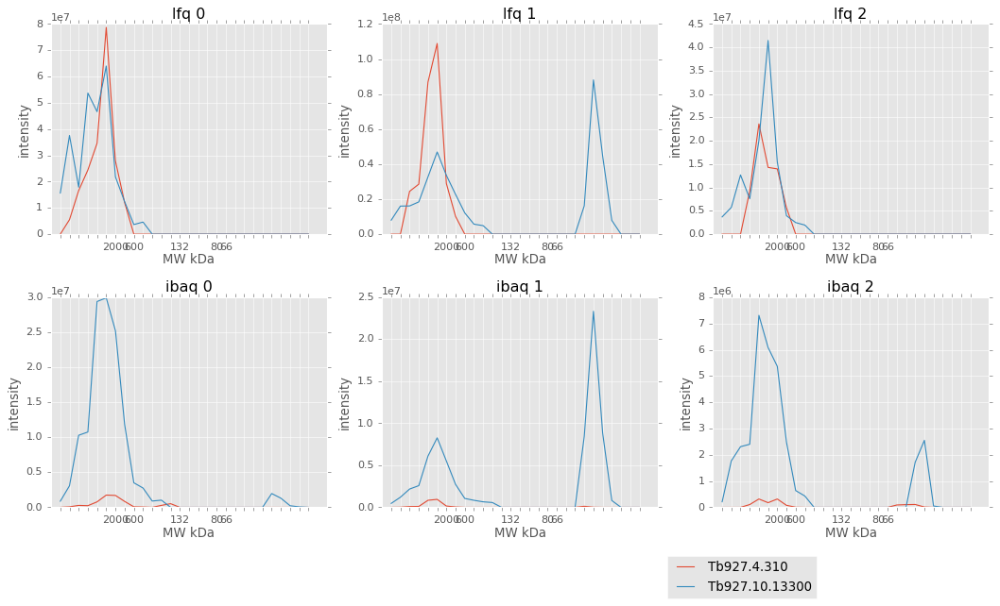

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.4.310                    733               0   
Tb927.10.13300                  32               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.4.310     SPRY domain/HECT-domain (ubiquitin-transferase...  
Tb927.10.13300                 Mitochondrial ribosomal protein S8  
68 4 35 ['Tb927.4.310', 'Tb927.10.13300']


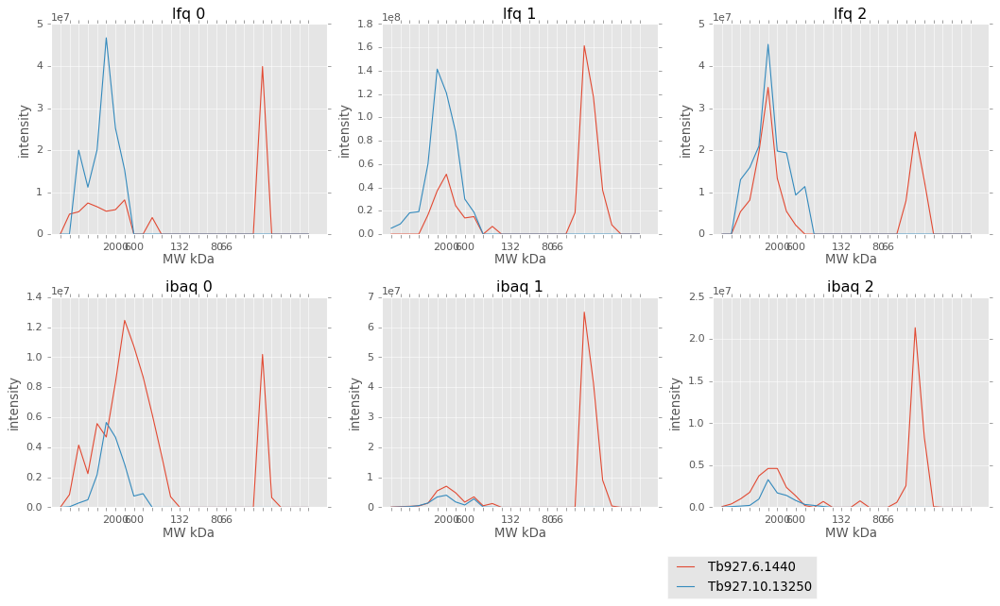

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.1440                    29               0   
Tb927.10.13250                 206               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.6.1440    LSU ribosomal protein, mitochondrial, putative  
Tb927.10.13250                 hypothetical protein, conserved  
68 2 40 ['Tb927.6.1440', 'Tb927.10.13250']


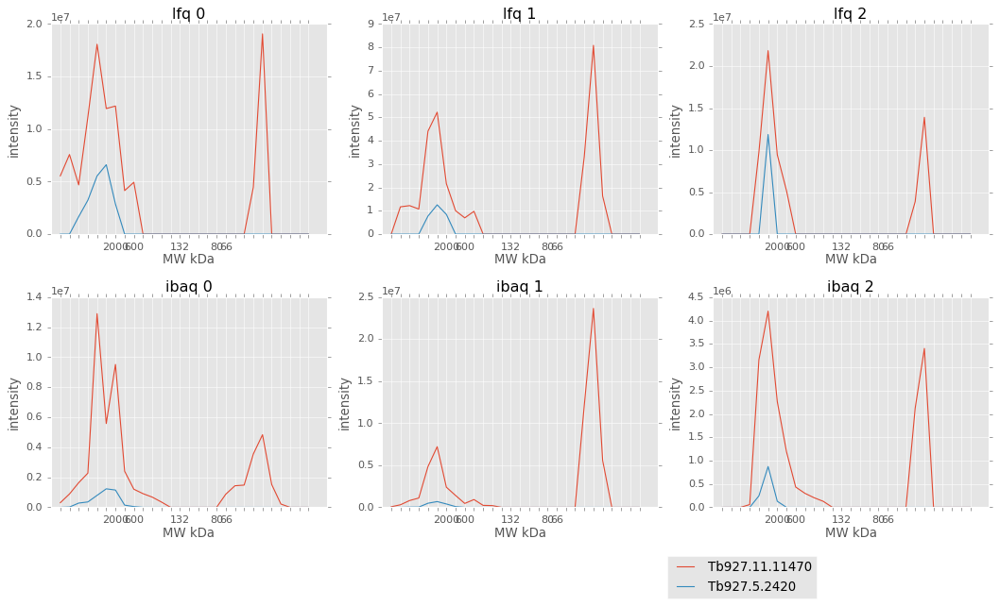

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11470                  32               0   
Tb927.5.2420                   102               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.11470  kinetoplast ribosomal PPR-repeat containing pr...  
Tb927.5.2420                       NOL1/NOP2/sun family, putative  
67 4 34 ['Tb927.11.11470', 'Tb927.5.2420']


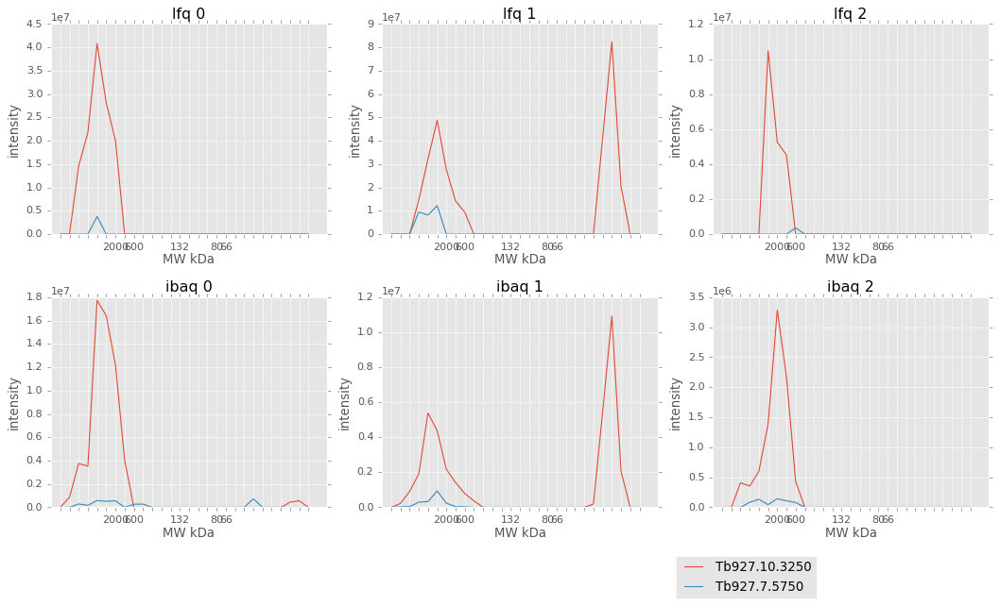

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.3250                  35               0   
Tb927.7.5750                  116               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.3250      Mitochondrial SSU ribosomal protein, putative  
Tb927.7.5750   Anaphase promoting complex-associated Protein AP2  
67 4 36 ['Tb927.10.3250', 'Tb927.7.5750']


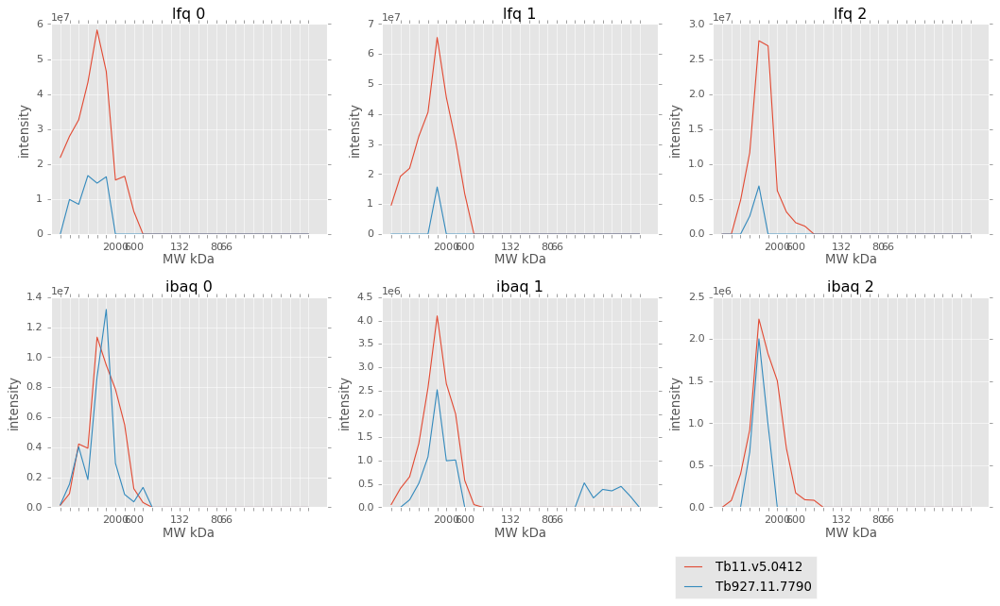

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb11.v5.0412                   89               0   
Tb927.11.7790                  22               0   

                             [Product Description]  
[Input ID]                                          
Tb11.v5.0412       hypothetical protein, conserved  
Tb927.11.7790  Mitochondrial ribosomal protein S16  
67 2 33 ['Tb11.v5.0412', 'Tb927.11.7790']


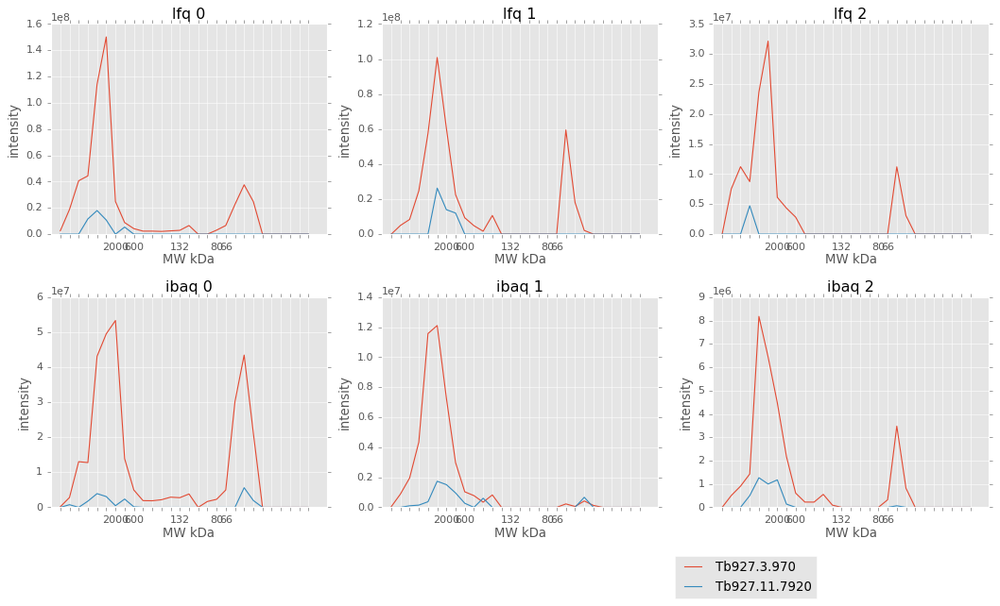

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.970                    39               0   
Tb927.11.7920                  47               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.3.970    Mitochondrial SSU ribosomal protein, putative  
Tb927.11.7920                hypothetical protein, conserved  
67 2 35 ['Tb927.3.970', 'Tb927.11.7920']


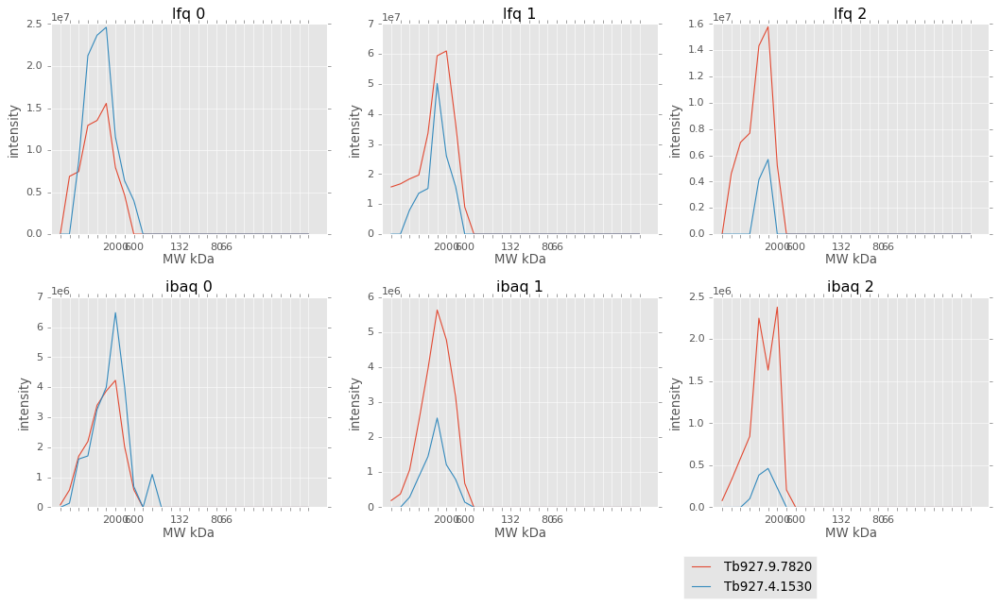

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.7820                  82               0   
Tb927.4.1530                 108               0   

                        [Product Description]  
[Input ID]                                     
Tb927.9.7820  hypothetical protein, conserved  
Tb927.4.1530  hypothetical protein, conserved  
67 2 31 ['Tb927.9.7820', 'Tb927.4.1530']


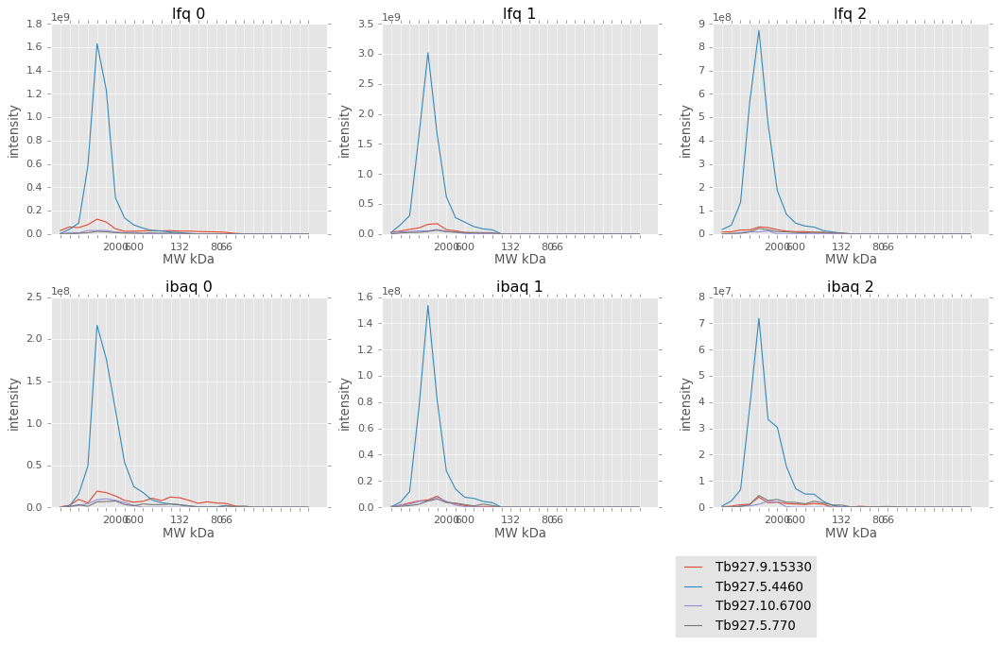

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.15330                 100               0   
Tb927.5.4460                   94               0   
Tb927.10.6700                  56               0   
Tb927.5.770                    76               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.9.15330  U3 small nucleolar RNA-associated protein 6, p...  
Tb927.5.4460                       major vault protein, putative  
Tb927.10.6700                  Kinetochore interacting protein 3  
Tb927.5.770                      hypothetical protein, conserved  
67 7 33 ['Tb927.9.15330', 'Tb927.5.4460', 'Tb927.10.6700', 'Tb927.5.770']


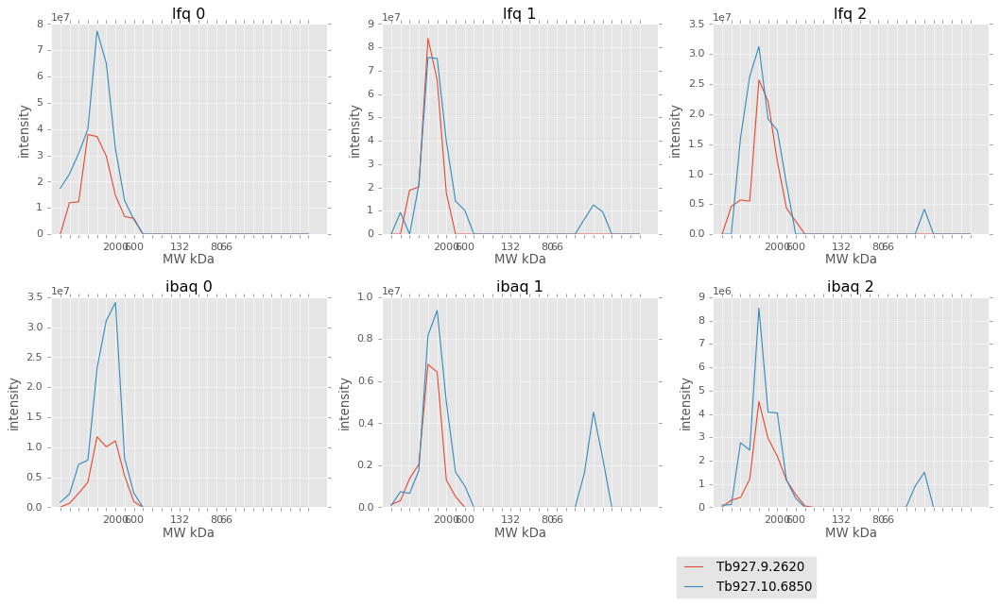

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.2620                   76               0   
Tb927.10.6850                  36               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.9.2620   Domain of unknown function (DUF4460), putative  
Tb927.10.6850   Mitochondrial ribosomal protein S18, putative  
67 3 31 ['Tb927.9.2620', 'Tb927.10.6850']


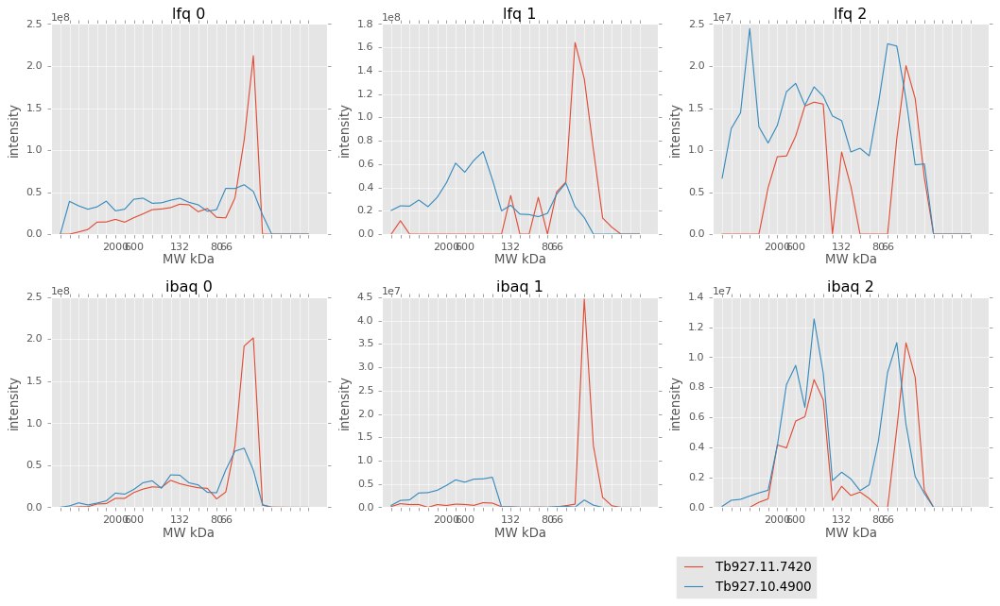

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.7420                  36               0   
Tb927.10.4900                  55               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.7420  phosphoadenosine phosphosulfate reductase-like...  
Tb927.10.4900  TPR-repeat-containing chaperone protein DNAJ, ...  
38 57 69 ['Tb927.11.7420', 'Tb927.10.4900']


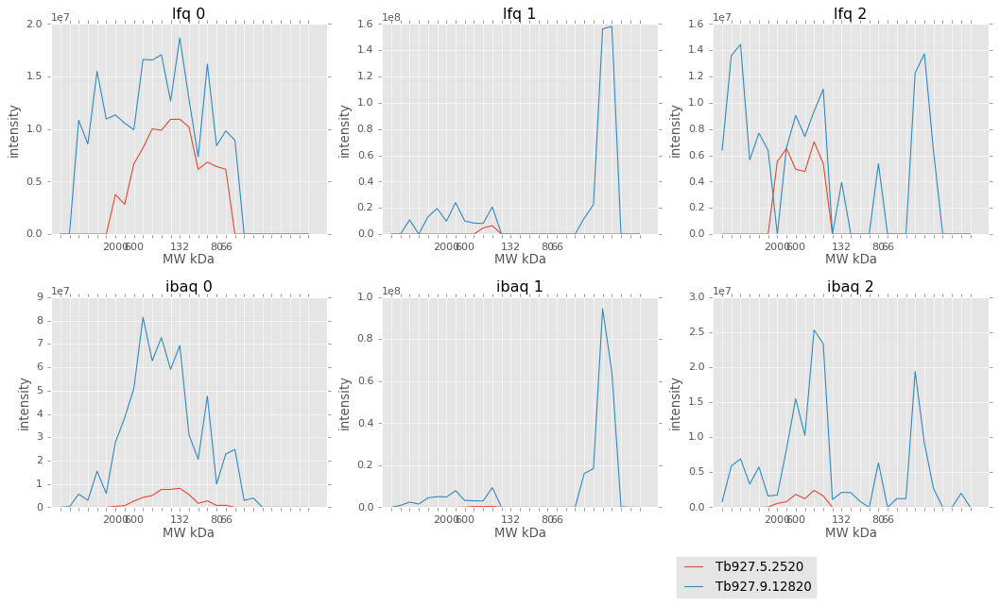

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.5.2520                  104               0   
Tb927.9.12820                  14               0   

                      [Product Description]  
[Input ID]                                   
Tb927.5.2520           TPR repeat, putative  
Tb927.9.12820  dynein light chain, putative  
38 70 71 ['Tb927.5.2520', 'Tb927.9.12820']


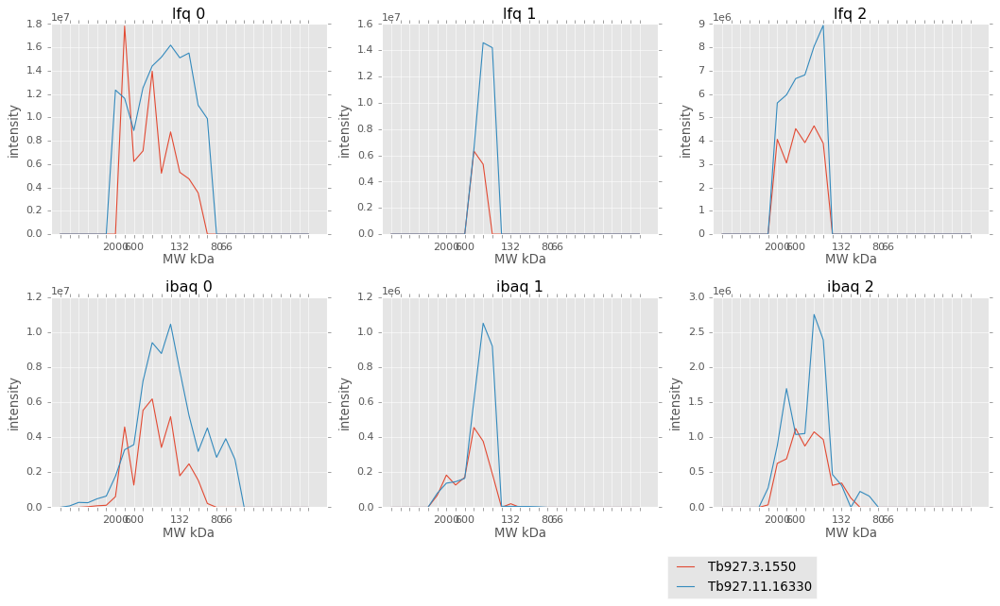

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.1550                   114               0   
Tb927.11.16330                 103               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.3.1550    Rab3 GTPase-activating protein catalytic subun...  
Tb927.11.16330                    hypothetical protein, conserved  
38 75 90 ['Tb927.3.1550', 'Tb927.11.16330']


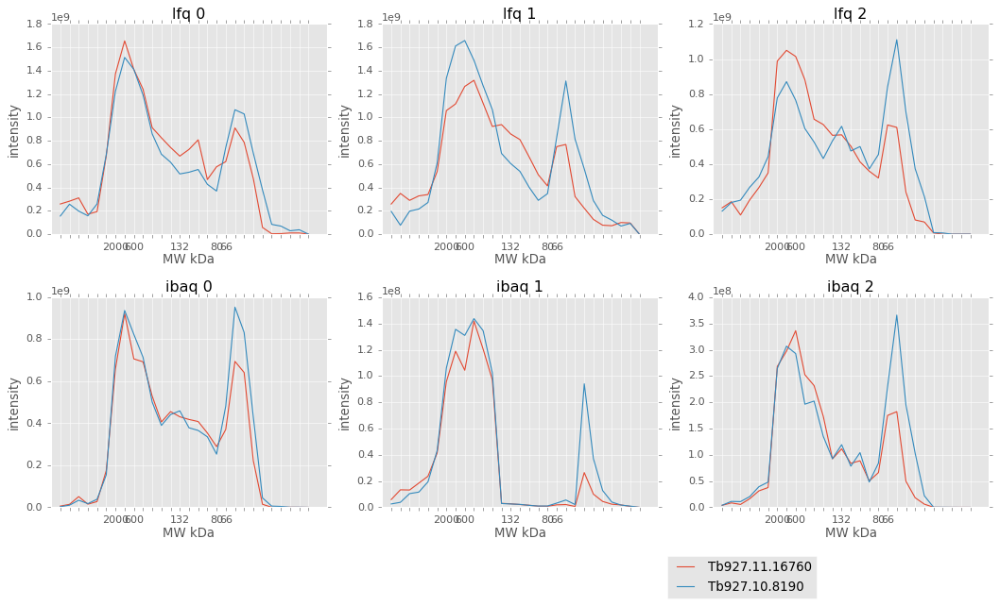

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.16760                  59               0   
Tb927.10.8190                   58               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.11.16760  T-complex protein 1, alpha subunit, putative  
Tb927.10.8190   T-complex protein 1, theta subunit, putative  
72 55 91 ['Tb927.11.16760', 'Tb927.10.8190']


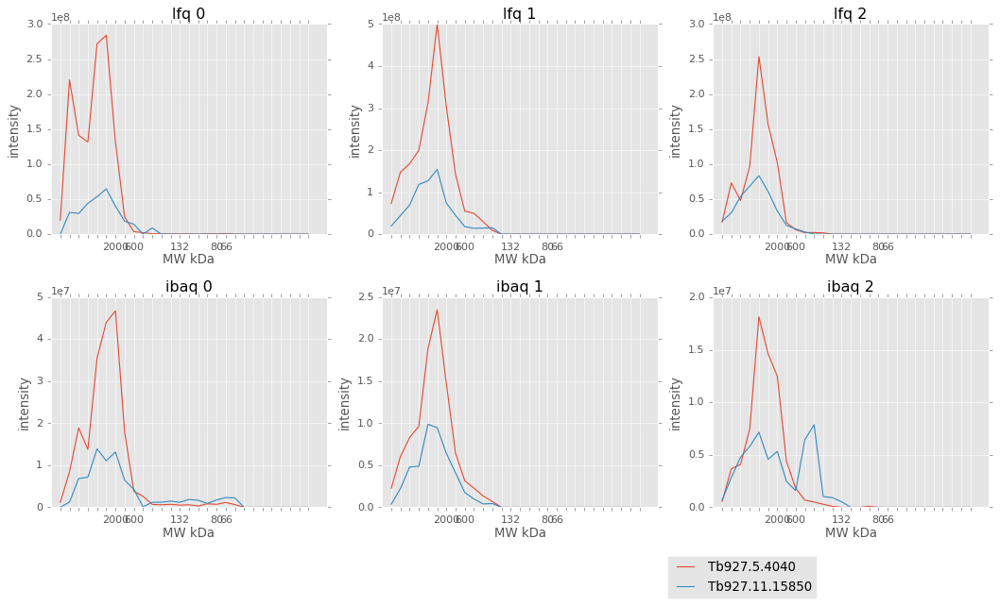

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.5.4040                    94               0   
Tb927.11.15850                  86               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.5.4040       Mitochondrial SSU ribosomal protein, putative  
Tb927.11.15850  kinteoplast poly(A) polymerase complex 1 subunit  
59 3 48 ['Tb927.5.4040', 'Tb927.11.15850']


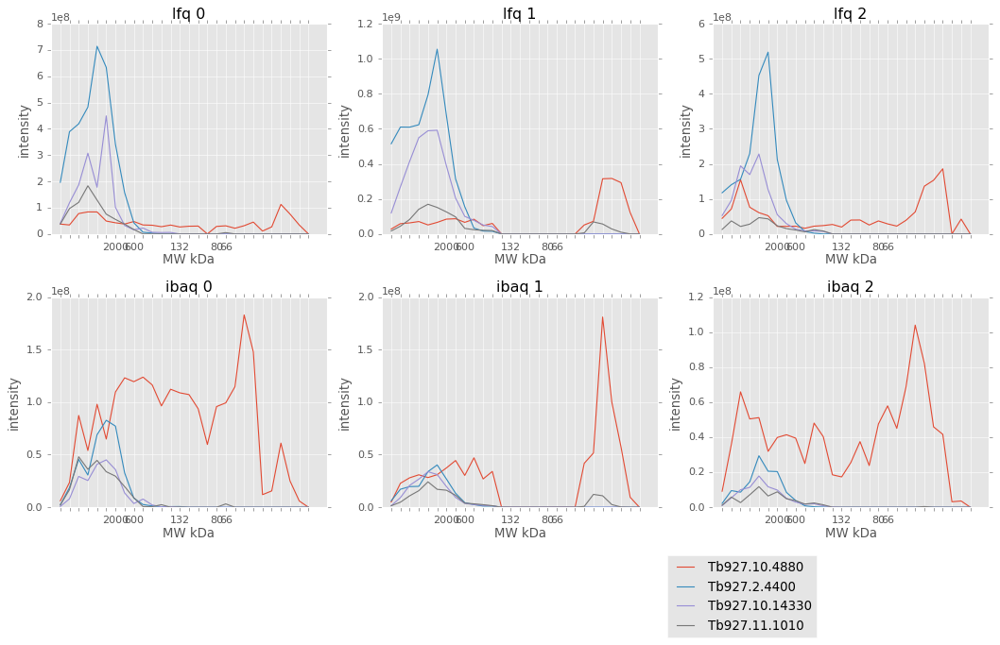

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.4880                   25               0   
Tb927.2.4400                   136               0   
Tb927.10.14330                 115               0   
Tb927.11.1010                   41               1   

                                         [Product Description]  
[Input ID]                                                      
Tb927.10.4880                  hypothetical protein, conserved  
Tb927.2.4400    SSU ribosomal protein, mitochondrial, putative  
Tb927.10.14330                         Utp14 protein, putative  
Tb927.11.1010                 chaperone protein DnaJ, putative  
59 8 48 ['Tb927.10.4880', 'Tb927.2.4400', 'Tb927.10.14330', 'Tb927.11.1010']


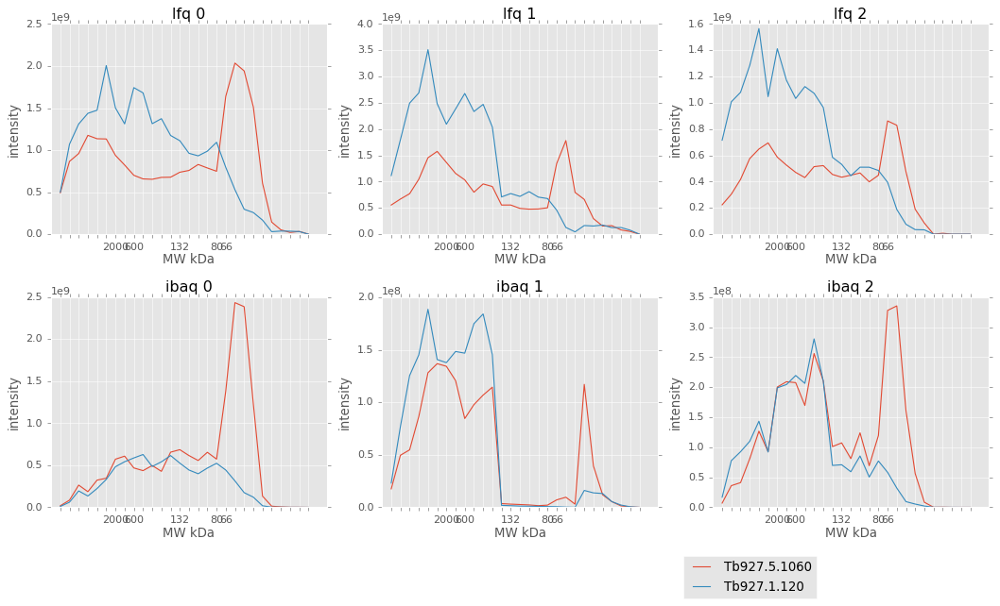

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.1060                  54               0   
Tb927.1.120                   98               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.1060  mitochondrial processing peptidase, beta subun...  
Tb927.1.120   retrotransposon hot spot protein 4 (RHS4), put...  
59 36 92 ['Tb927.5.1060', 'Tb927.1.120']


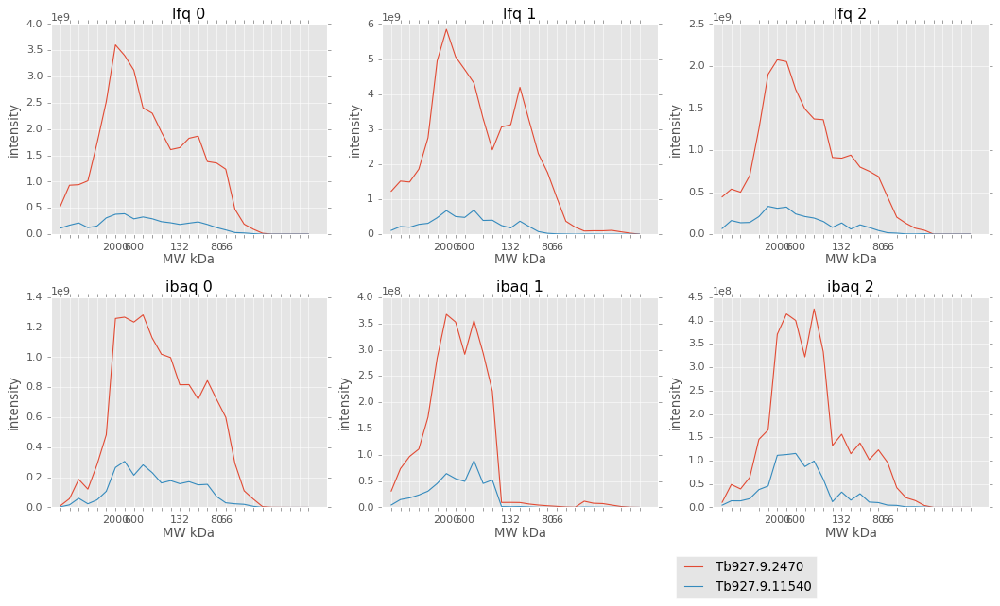

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.2470                   86               0   
Tb927.9.11540                  50               0   

                         [Product Description]  
[Input ID]                                      
Tb927.9.2470                 nucleolar protein  
Tb927.9.11540  hypothetical protein, conserved  
73 39 93 ['Tb927.9.2470', 'Tb927.9.11540']


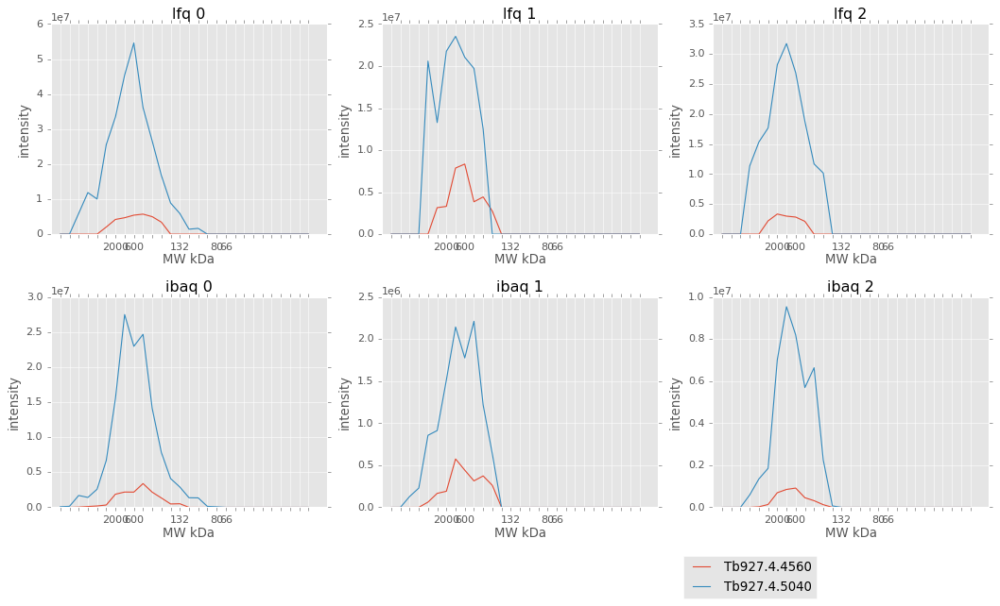

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.4560                 117               0   
Tb927.4.5040                  63               0   

                        [Product Description]  
[Input ID]                                     
Tb927.4.4560  hypothetical protein, conserved  
Tb927.4.5040   dihydrolipoamide dehydrogenase  
73 33 83 ['Tb927.4.4560', 'Tb927.4.5040']


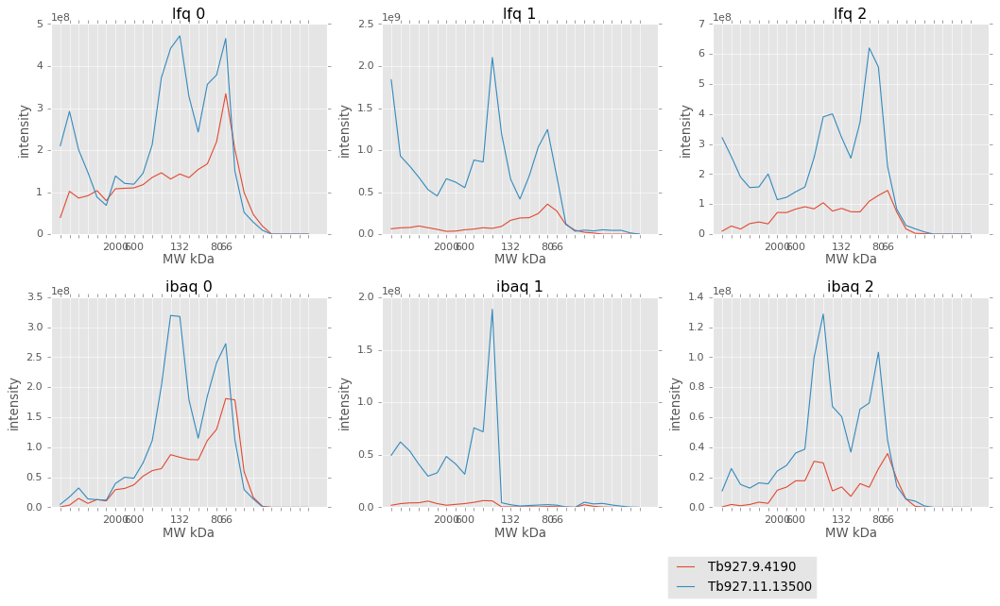

                [Molecular Weight]  [# TM Domains]       [Product Description]
[Input ID]                                                                    
Tb927.9.4190                    78               0  fatty acyl CoA syntetase 1
Tb927.11.13500                  68               0                        par1
25 13 8 ['Tb927.9.4190', 'Tb927.11.13500']


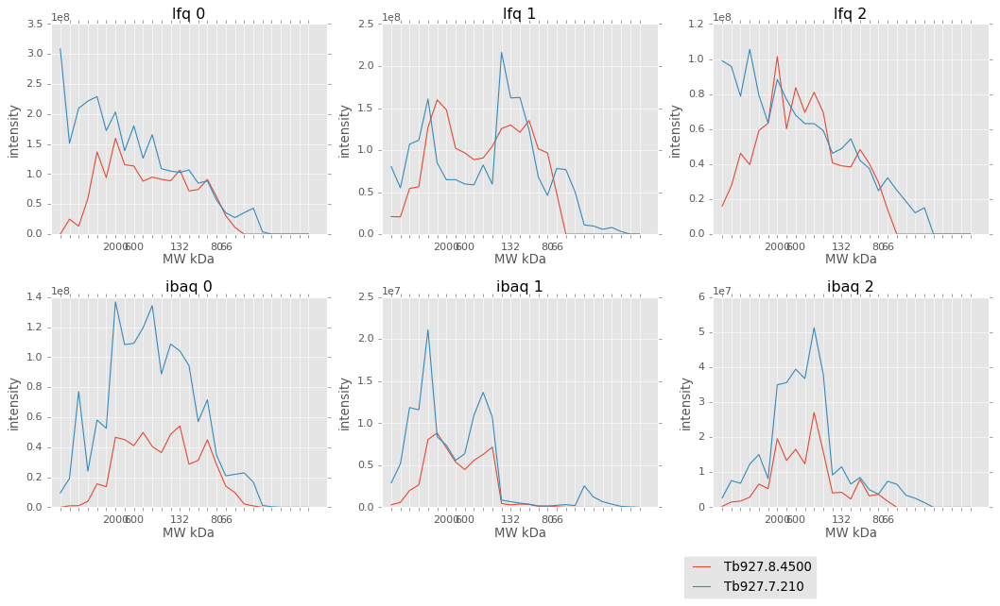

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.4500                  84               0   
Tb927.7.210                   63               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.4500  Eukaryotic translation initiation factor 4 gam...  
Tb927.7.210                Proline dehydrogenase, mitochondrial  
71 72 93 ['Tb927.8.4500', 'Tb927.7.210']


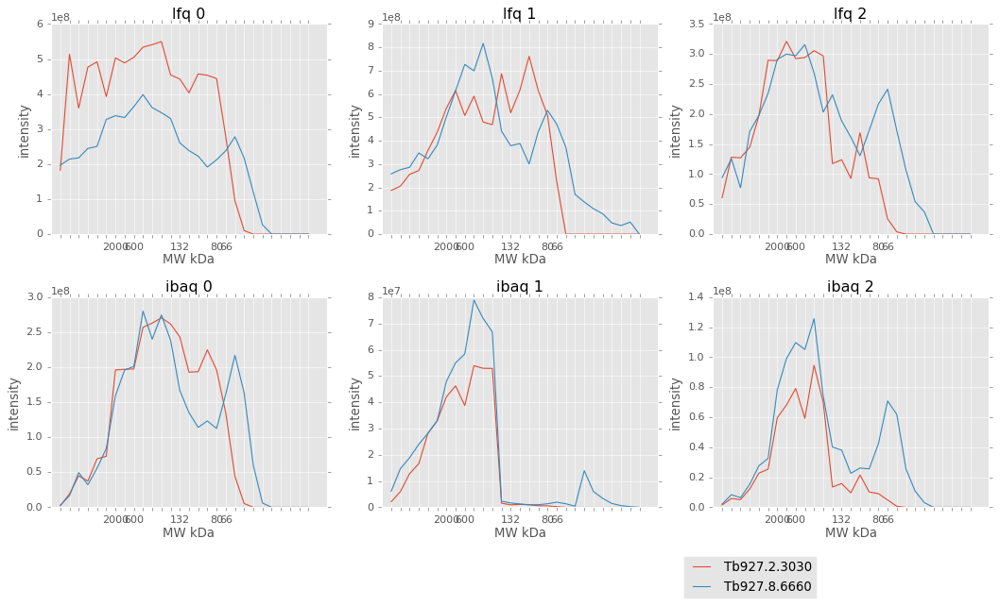

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.2.3030                  90               0   
Tb927.8.6660                  69               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.2.3030  ATP-dependent Clp protease subunit, heat shock...  
Tb927.8.6660              paraflagellar rod component, putative  
71 40 93 ['Tb927.2.3030', 'Tb927.8.6660']


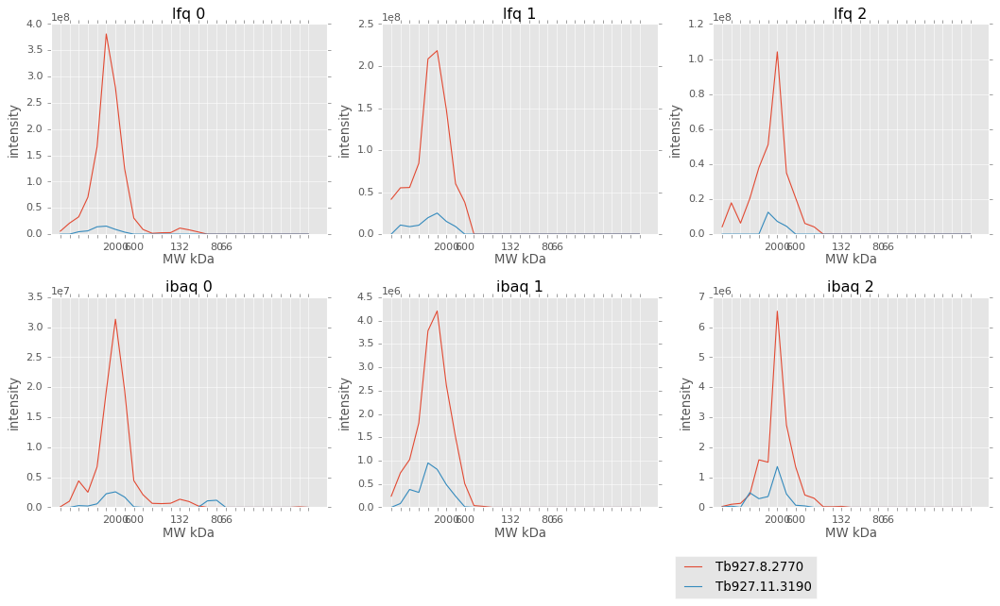

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.8.2770                  342               5   
Tb927.11.3190                 181               0   
Tb927.11.3190                 184               0   

                               [Product Description]  
[Input ID]                                            
Tb927.8.2770   inositol 1,4,5-trisphosphate receptor  
Tb927.11.3190        hypothetical protein, conserved  
Tb927.11.3190        hypothetical protein, conserved  
83 3 40 ['Tb927.8.2770', 'Tb927.11.3190']


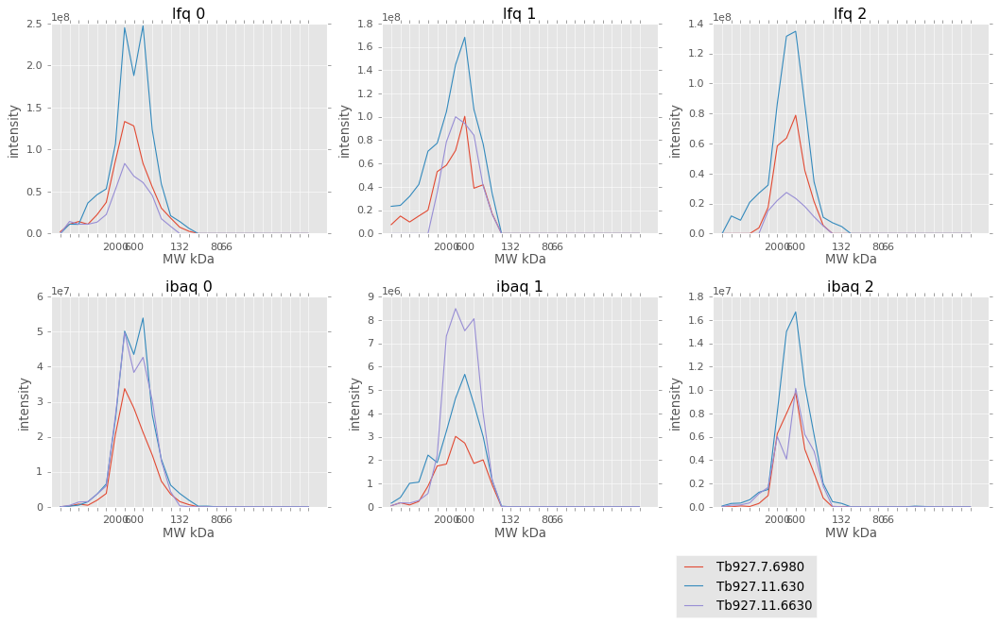

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.6980                  194               0   
Tb927.11.630                  179               0   
Tb927.11.6630                  66               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.7.6980   Mono-functional DNA-alkylating methyl methanes...  
Tb927.11.630             RNA polymerase I second largest subunit  
Tb927.11.6630  3-methylcrotonoyl-CoA carboxylase beta subunit...  
79 34 83 ['Tb927.7.6980', 'Tb927.11.630', 'Tb927.11.6630']


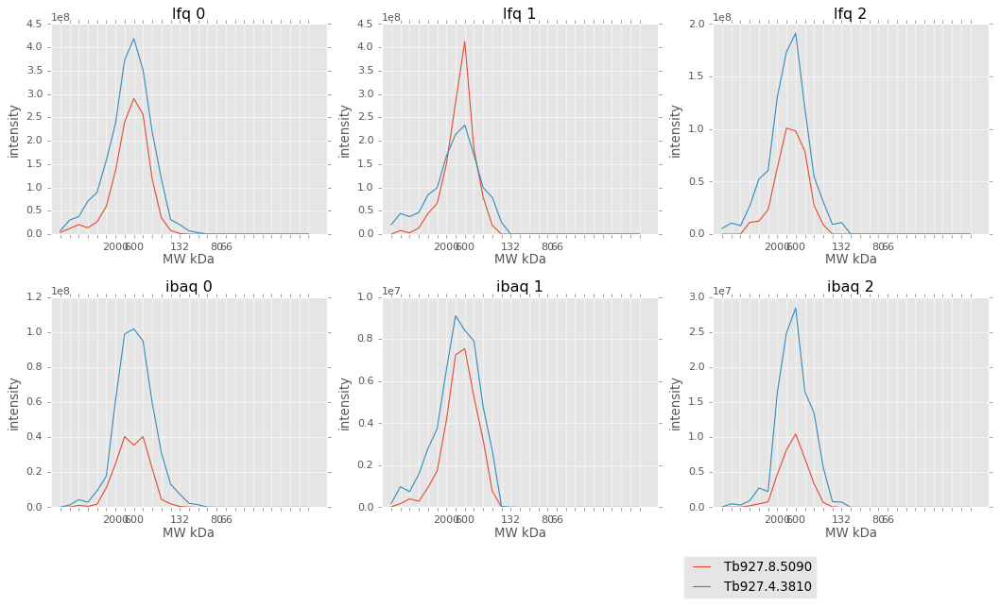

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.5090                 195               0   
Tb927.4.3810                 134               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.5090      DNA-directed RNA polymerase I largest subunit  
Tb927.4.3810  DNA-directed RNA polymerase II subunit 2, puta...  
79 33 83 ['Tb927.8.5090', 'Tb927.4.3810']


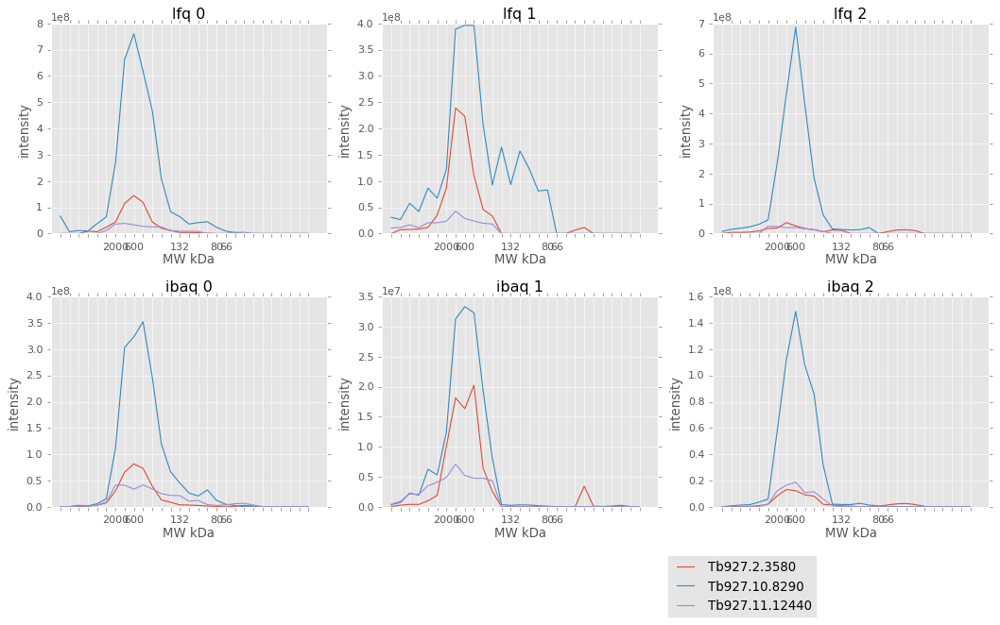

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.2.3580                    52               0   
Tb927.10.8290                   84               0   
Tb927.11.12440                  43               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.2.3580       transcription elongation factor s-II, putative  
Tb927.10.8290   eukaryotic translation initiation factor 3 sub...  
Tb927.11.12440  Plus-3 domain/Zinc finger, C3HC4 type (RING fi...  
79 33 85 ['Tb927.2.3580', 'Tb927.10.8290', 'Tb927.11.12440']


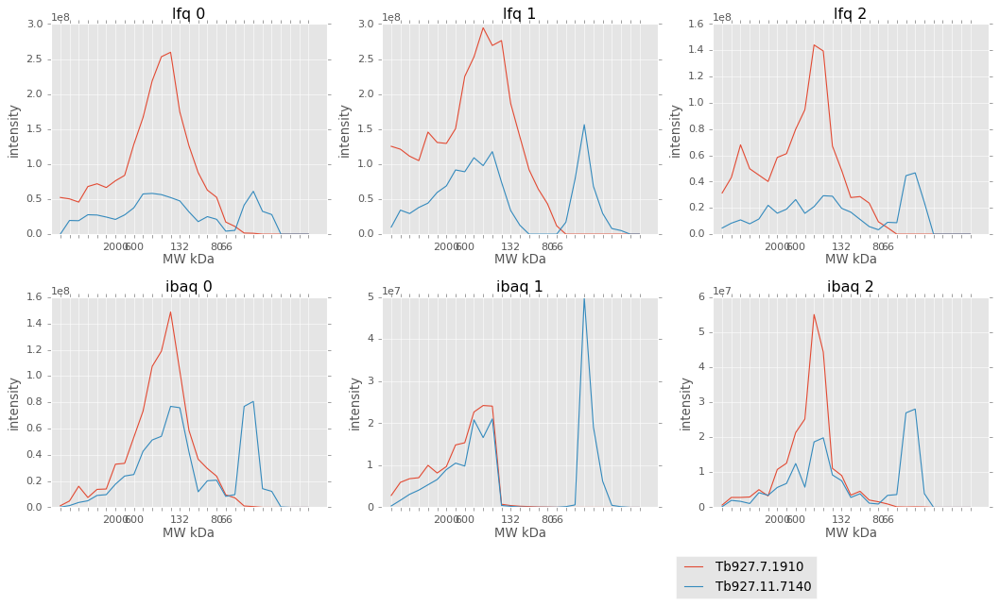

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.1910                  106               0   
Tb927.11.7140                  35               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.7.1910   pyridoxal phosphate containing glycine decarbo...  
Tb927.11.7140  cell cycle sequence binding phosphoprotein (RB...  
44 40 74 ['Tb927.7.1910', 'Tb927.11.7140']


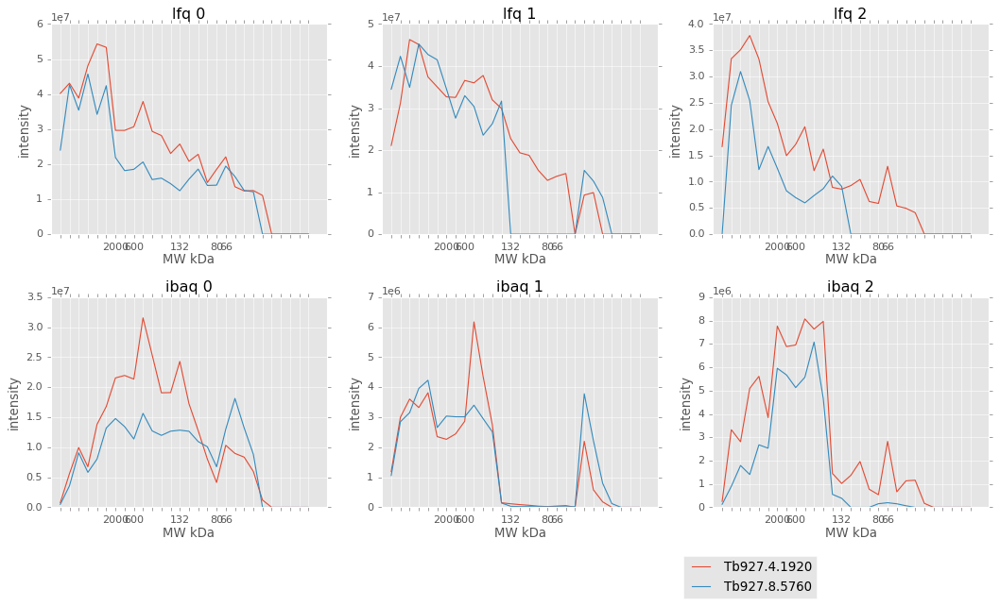

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.1920                  75               2   
Tb927.8.5760                  53               1   

                                          [Product Description]  
[Input ID]                                                       
Tb927.4.1920              GPI transamidase subunit 16, putative  
Tb927.8.5760  Ankyrin repeats (many copies)/Alpha/beta hydro...  
88 24 48 ['Tb927.4.1920', 'Tb927.8.5760']


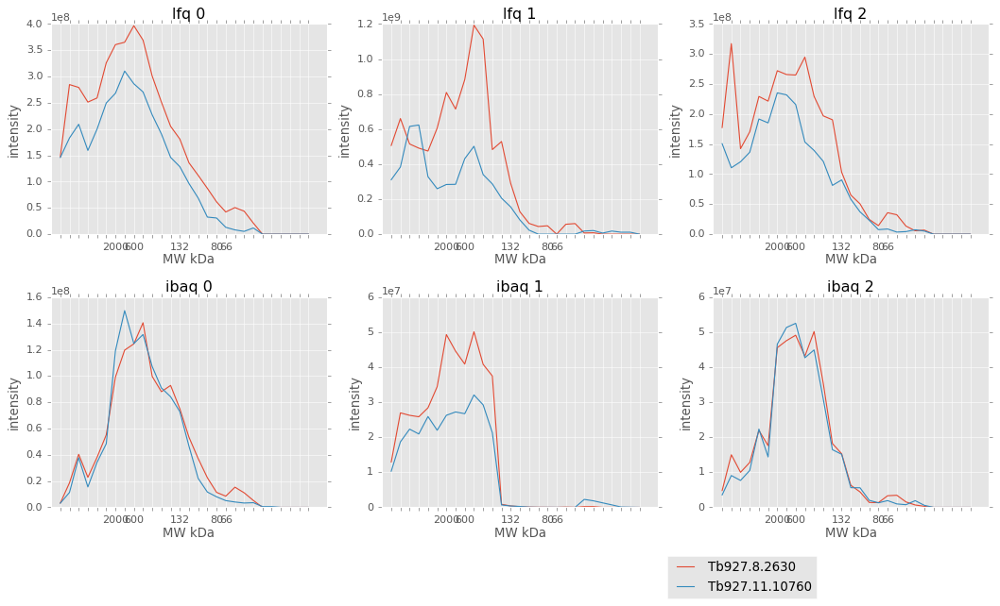

                [Molecular Weight]  [# TM Domains] [Product Description]
[Input ID]                                                              
Tb927.8.2630                    85               0             kinesin-C
Tb927.11.10760                  69               0             kinesin-D
88 36 45 ['Tb927.8.2630', 'Tb927.11.10760']


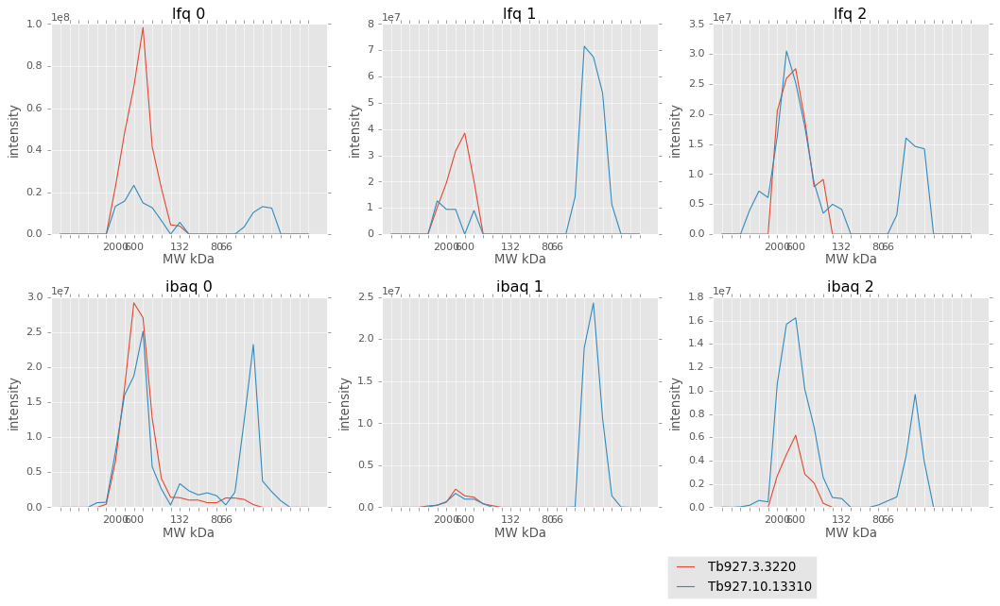

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.3220                   101               0   
Tb927.10.13310                  33               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.3.3220     RNA polymerase-associated protein CTR9, putative  
Tb927.10.13310  DNA-directed RNA polymerase I subunit RPB5z, p...  
80 25 83 ['Tb927.3.3220', 'Tb927.10.13310']


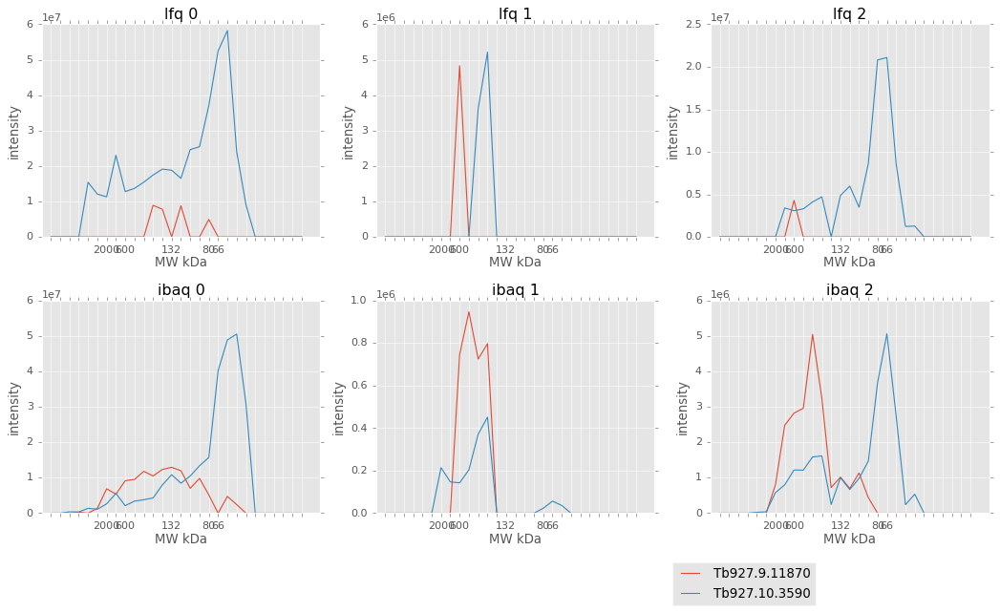

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.11870                  31               0   
Tb927.10.3590                  62               0   

                         [Product Description]  
[Input ID]                                      
Tb927.9.11870    zinc finger protein, putative  
Tb927.10.3590  hypothetical protein, conserved  
80 70 64 ['Tb927.9.11870', 'Tb927.10.3590']


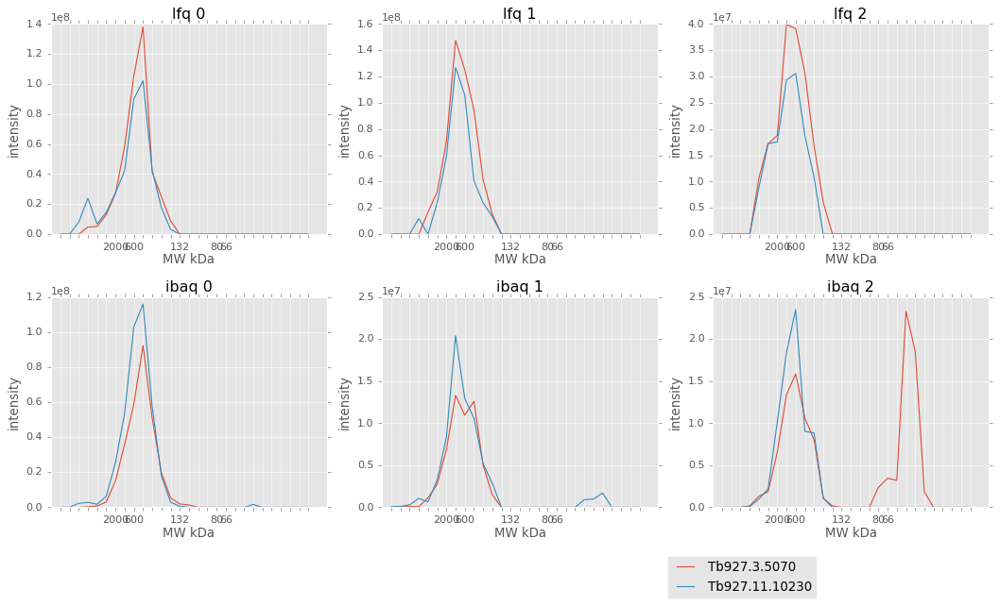

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.5070                    70               0   
Tb927.11.10230                  40               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.3.5070                      hypothetical protein, conserved  
Tb927.11.10230  RNA polymerase-associated protein CDC73, putative  
80 34 83 ['Tb927.3.5070', 'Tb927.11.10230']


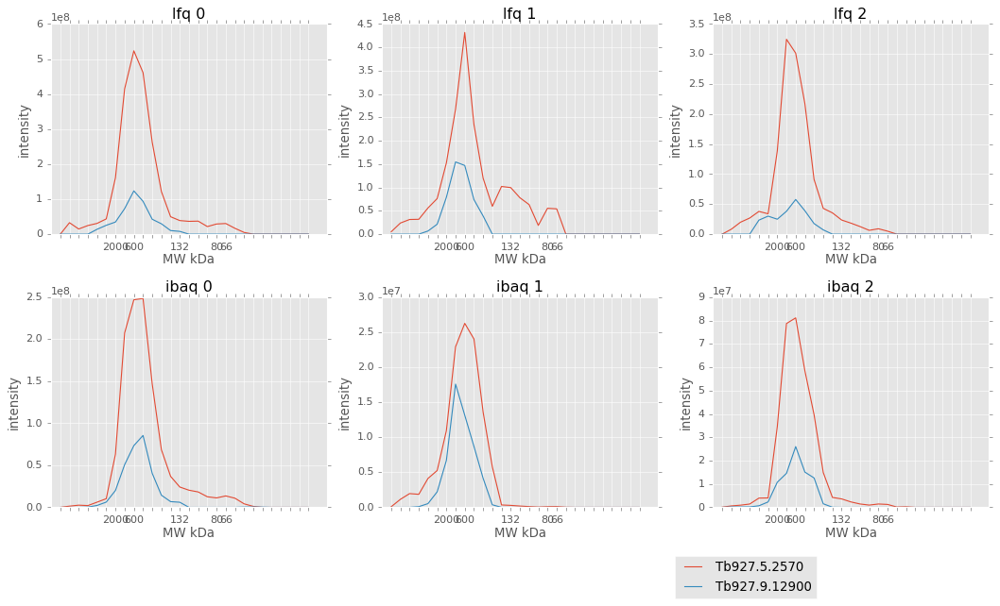

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.5.2570                   79               0   
Tb927.9.12900                  64               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.5.2570   eukaryotic translation initiation factor 3 sub...  
Tb927.9.12900   RNA polymerase-associated protein LEO1, putative  
80 33 83 ['Tb927.5.2570', 'Tb927.9.12900']


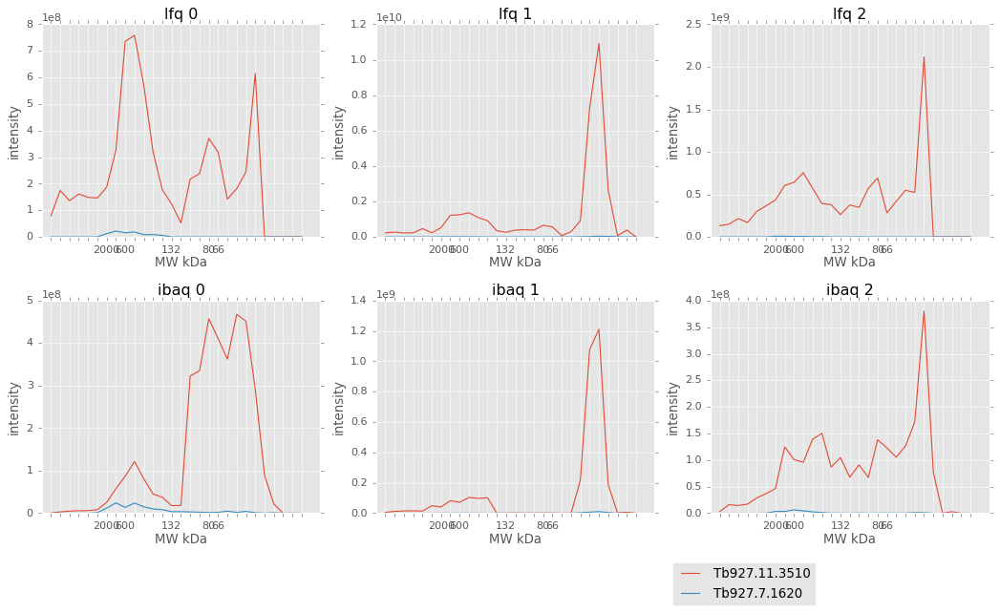

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.3510                  91               0   
Tb927.7.1620                   32               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.11.3510             hypothetical protein, conserved  
Tb927.7.1620   Cleavage factor I 25 kDa subunit, putative  
80 58 85 ['Tb927.11.3510', 'Tb927.7.1620']


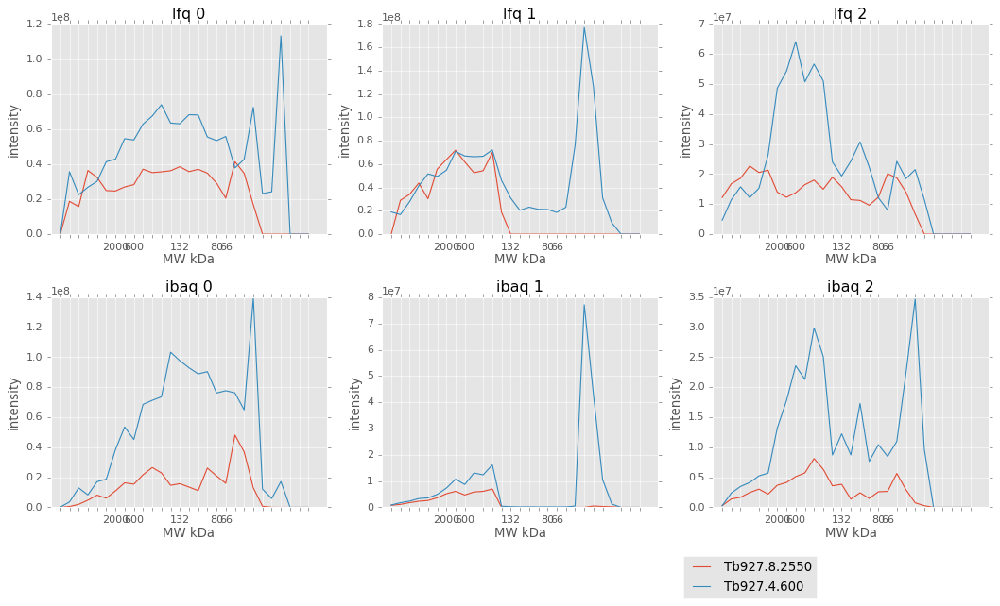

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.2550                  69               0   
Tb927.4.600                   34               0   

                              [Product Description]  
[Input ID]                                           
Tb927.8.2550              mitochondrial DNA primase  
Tb927.4.600   Alpha/beta hydrolase family, putative  
9 31 63 ['Tb927.8.2550', 'Tb927.4.600']


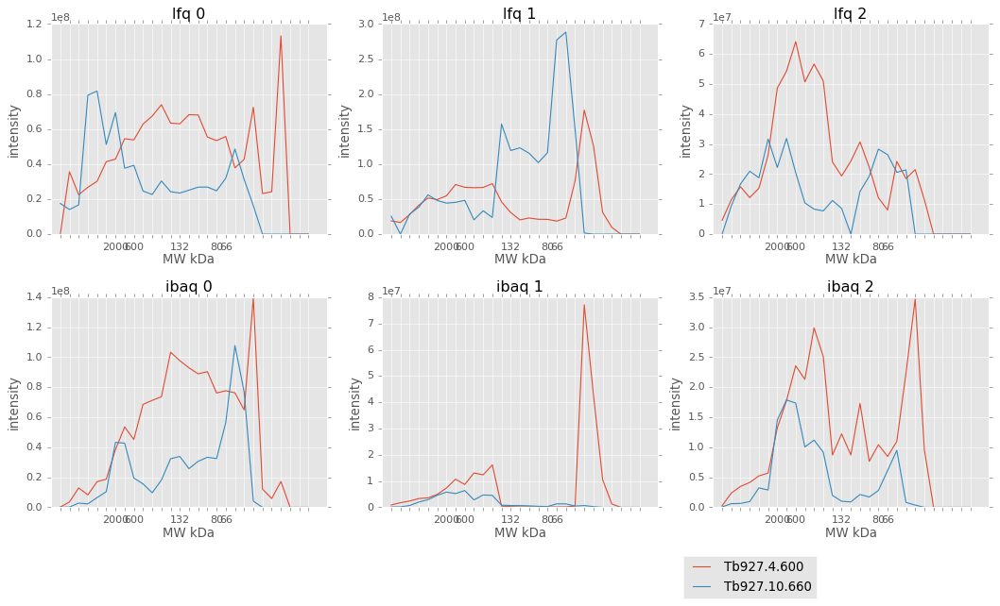

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.600                   34               0   
Tb927.10.660                  46               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.4.600               Alpha/beta hydrolase family, putative  
Tb927.10.660  2-oxoisovalerate dehydrogenase alpha subunit, ...  
9 68 26 ['Tb927.4.600', 'Tb927.10.660']


In [50]:
cfile = open('msms_complexes.txt','w')
plt.style.use('ggplot')
df_1 = pd.read_csv('msms_0_2.5.csv',index_col=[0])
df_2 = pd.read_csv('msms_1_2.5.csv',index_col=[0])
df_3 = pd.read_csv('msms_2_2.5.csv',index_col=[0])
find_complex(df_1, df_2, df_3, cfile, gene_table)
cfile.close()      

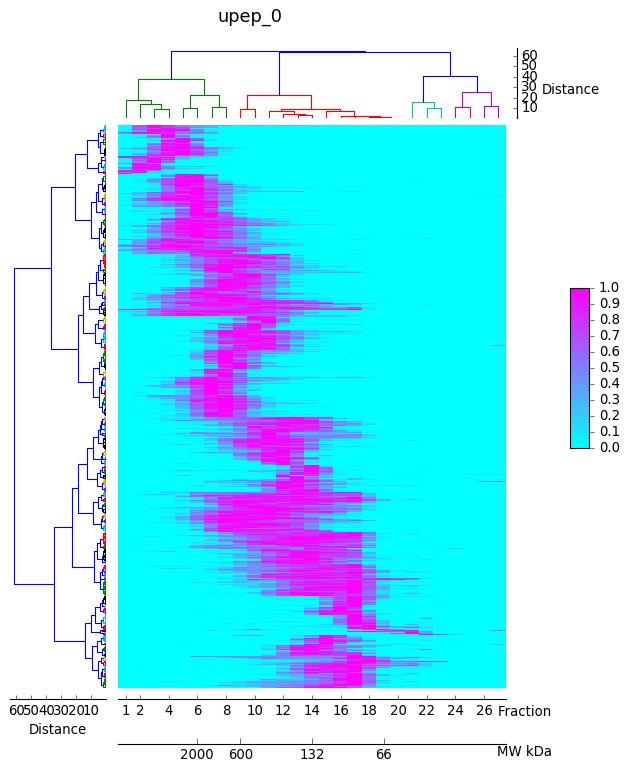

In [55]:
import warnings
warnings.filterwarnings("ignore")
temp = res['upep']['exp_filter_mw'][0].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='upep_0',
     fig_name = 'upep_0.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('upep_0_2.5.csv')

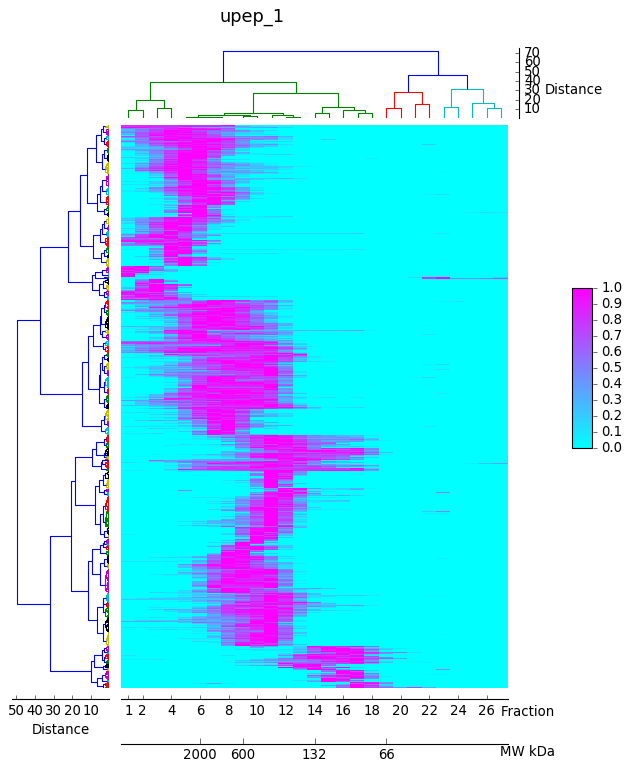

In [56]:
import warnings
warnings.filterwarnings("ignore")
temp = res['upep']['exp_filter_mw'][1].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max, 1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='upep_1',
     fig_name = 'upep_1.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('upep_1_2.5.csv')

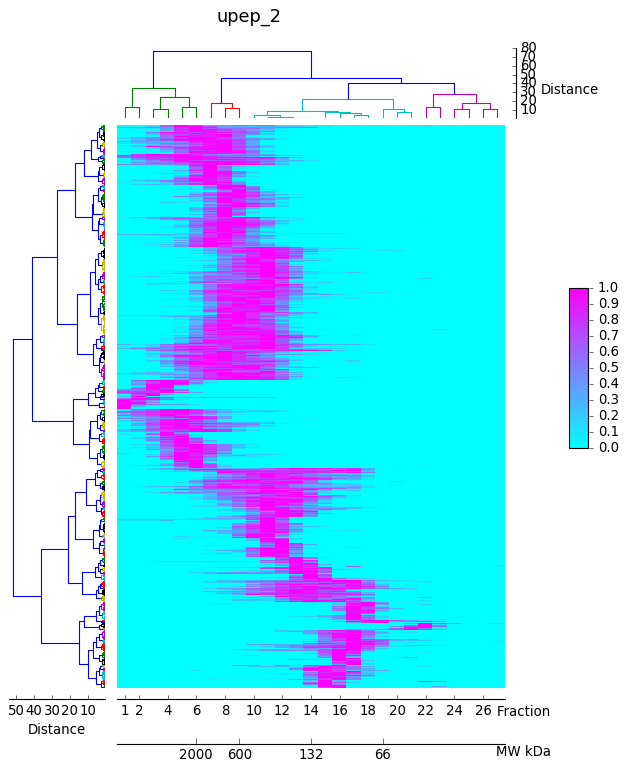

In [57]:
import warnings
warnings.filterwarnings("ignore")
temp = res['upep']['exp_filter_mw'][2].iloc[:,0:27]
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max, 1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.5,
     step_first_x = 2,
     title='upep_2',
     fig_name = 'upep_2.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      14:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n.split('_')[0]] for n in cluster_df.index.values]
cluster_df.to_csv('upep_2_2.5.csv')

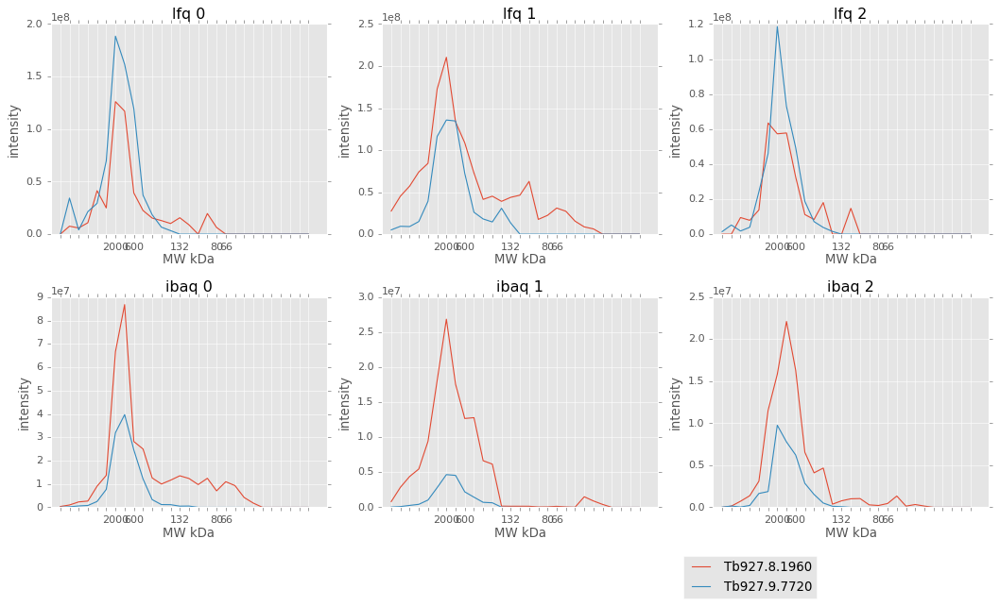

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.1960                  48               0   
Tb927.9.7720                 152               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.8.1960   CCR4-NOT transcription complex subunit 11  
Tb927.9.7720  predicted tetratricopeptide repeat protein  
49 54 73 ['Tb927.8.1960', 'Tb927.9.7720']


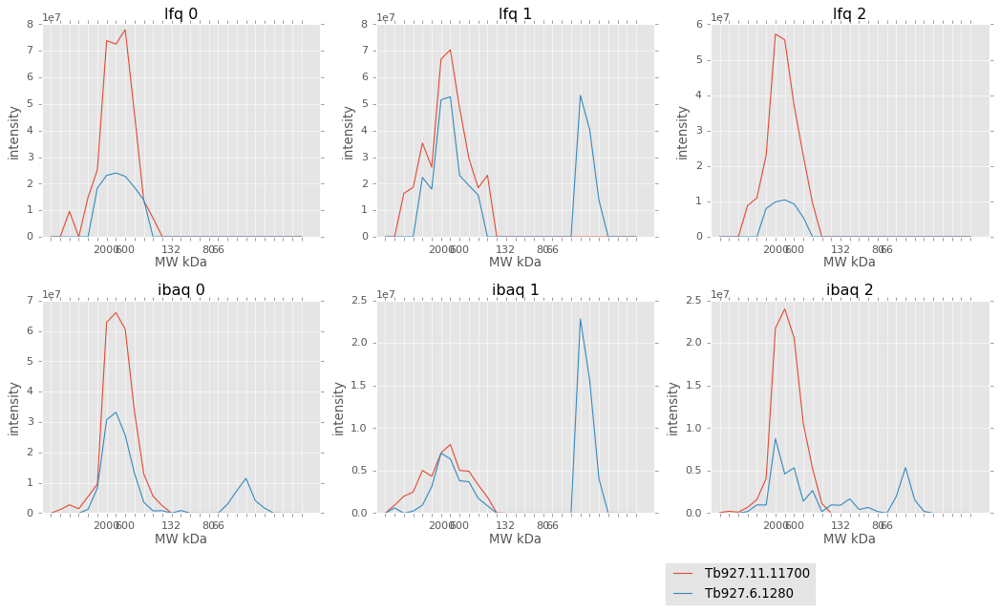

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11700                  63               0   
Tb927.6.1280                    33               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.11700                  nucleotidyl transferase, putative  
Tb927.6.1280    translation initiation factor EIF-2b alpha sub...  
49 54 75 ['Tb927.11.11700', 'Tb927.6.1280']


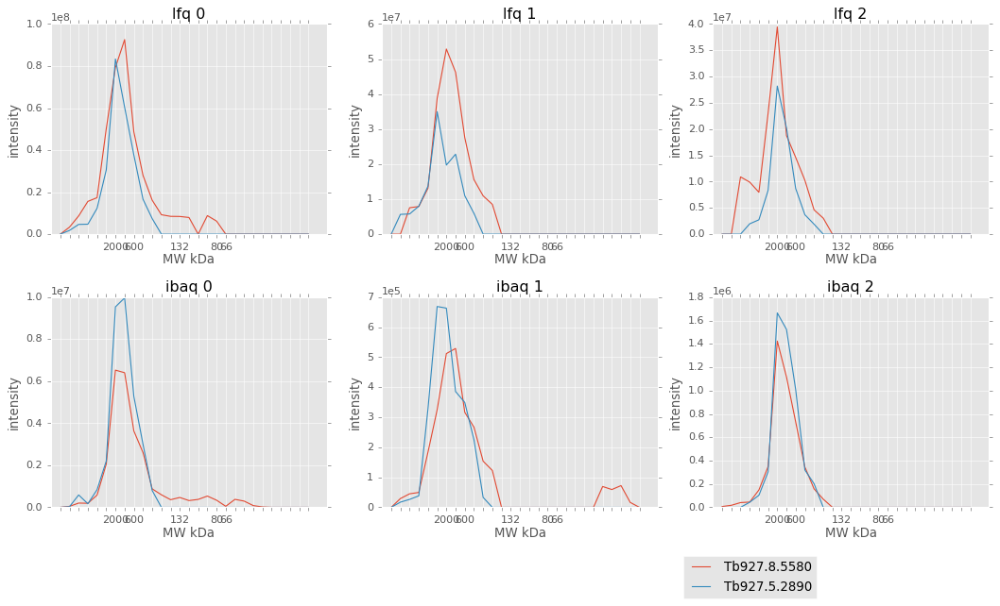

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.5580                 526               0   
Tb927.5.2890                 240               0   
Tb927.5.2890                 236               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.5580  N-terminal region of Chorein, a TM vesicle-med...  
Tb927.5.2890  AAA domain (dynein-related subfamily)/von Will...  
Tb927.5.2890  AAA domain (dynein-related subfamily)/von Will...  
49 41 73 ['Tb927.8.5580', 'Tb927.5.2890']


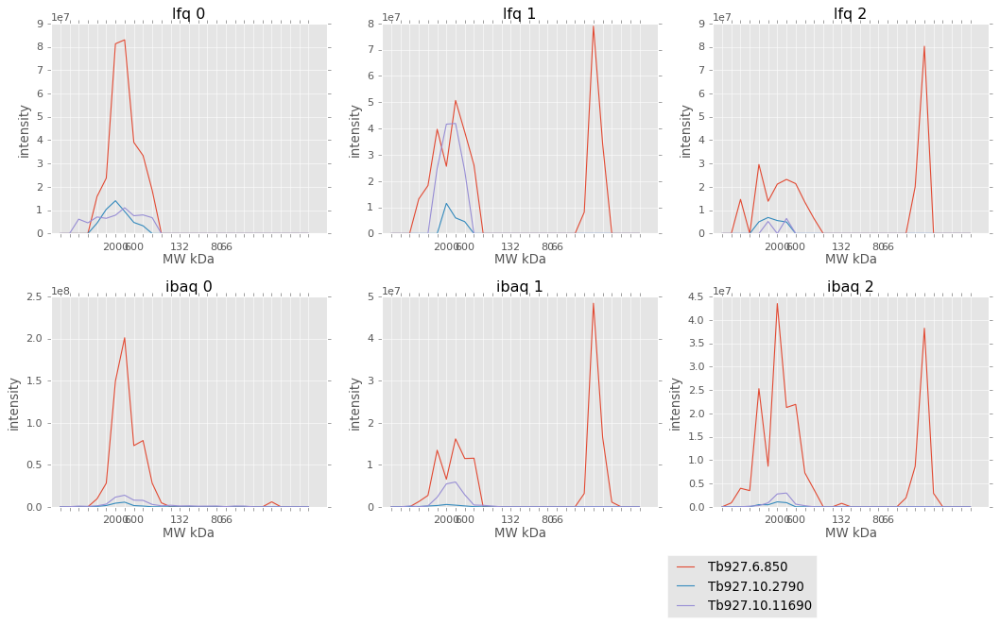

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.850                     37               0   
Tb927.10.2790                  115               0   
Tb927.10.11690                  53               1   

                                      [Product Description]  
[Input ID]                                                   
Tb927.6.850        ccr4-not transcription complex subunit 2  
Tb927.10.2790   Conserved oligomeric complex COG6, putative  
Tb927.10.11690                       YEATS family, putative  
49 41 82 ['Tb927.6.850', 'Tb927.10.2790', 'Tb927.10.11690']


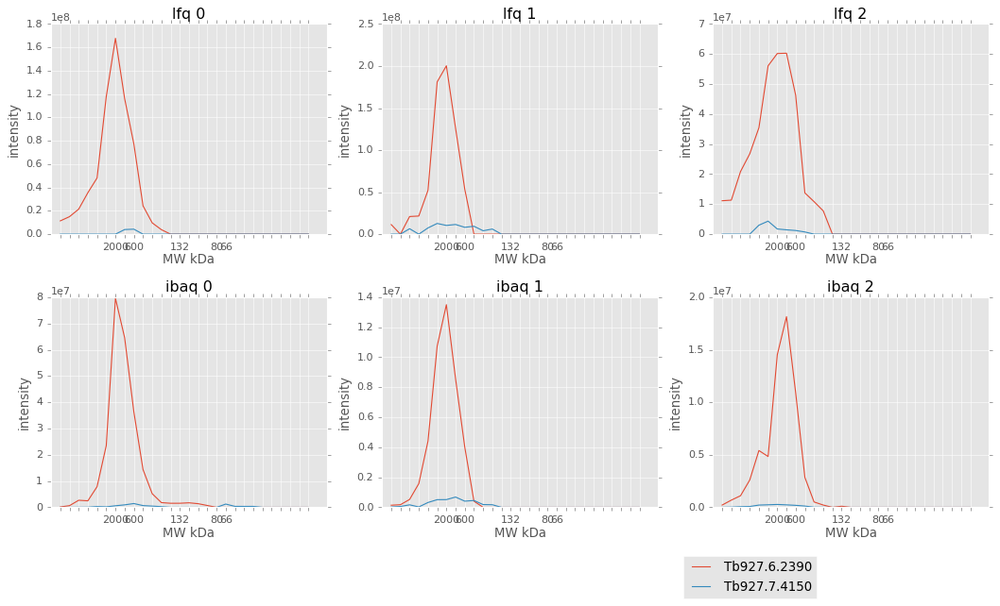

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.2390                  63               0   
Tb927.7.4150                 138               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.6.2390  conserved hypothetical protein, putative  
Tb927.7.4150           hypothetical protein, conserved  
49 75 89 ['Tb927.6.2390', 'Tb927.7.4150']


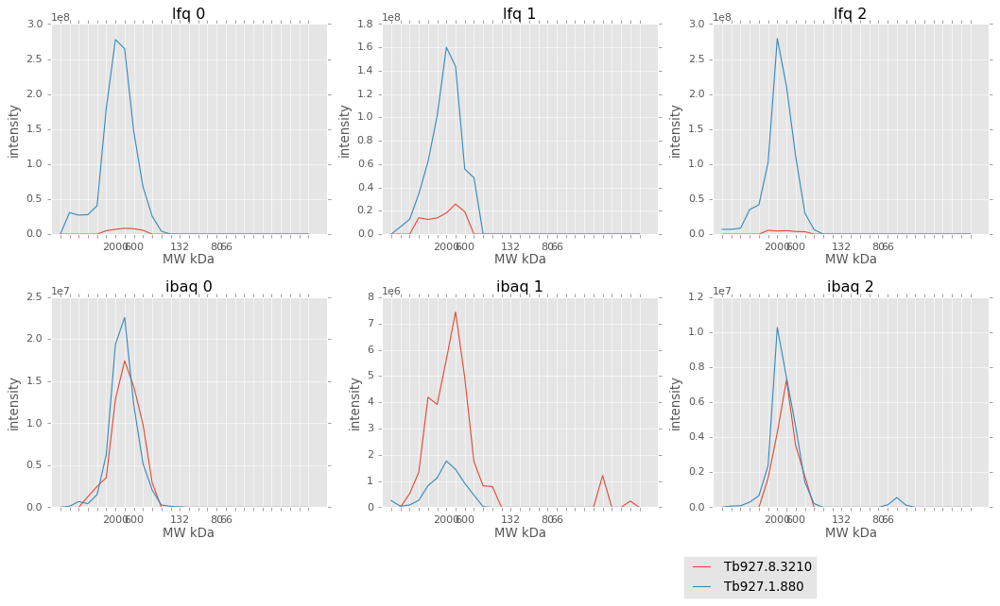

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.3210                  18               0   
Tb927.1.880                  512               0   

                        [Product Description]  
[Input ID]                                     
Tb927.8.3210  hypothetical protein, conserved  
Tb927.1.880                 Midasin, putative  
49 75 74 ['Tb927.8.3210', 'Tb927.1.880']


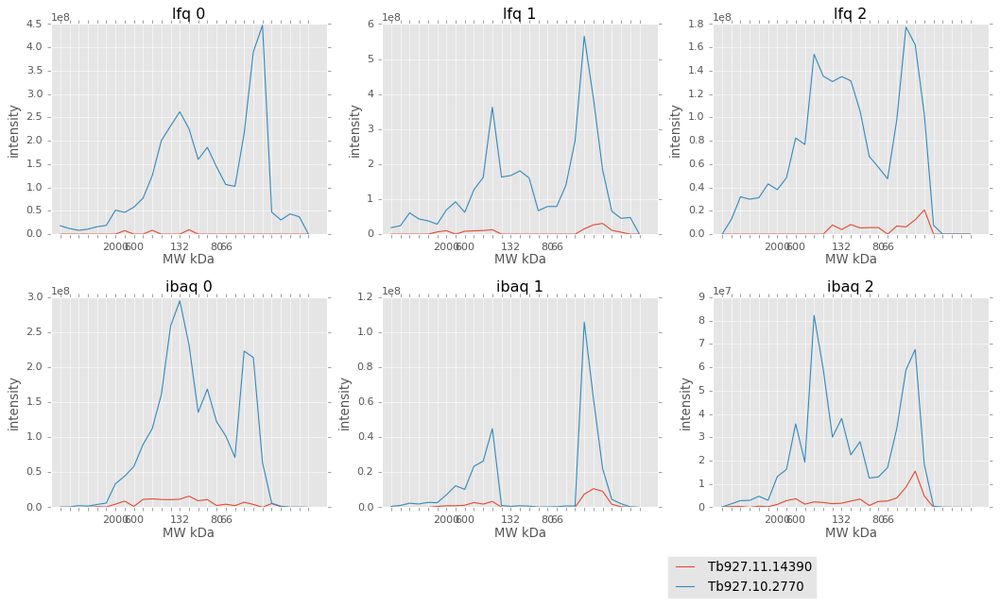

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.14390                  29               0   
Tb927.10.2770                   42               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.14390                    hypothetical protein, conserved  
Tb927.10.2770   eukaryotic translation initiation factor 5, pu...  
24 15 20 ['Tb927.11.14390', 'Tb927.10.2770']


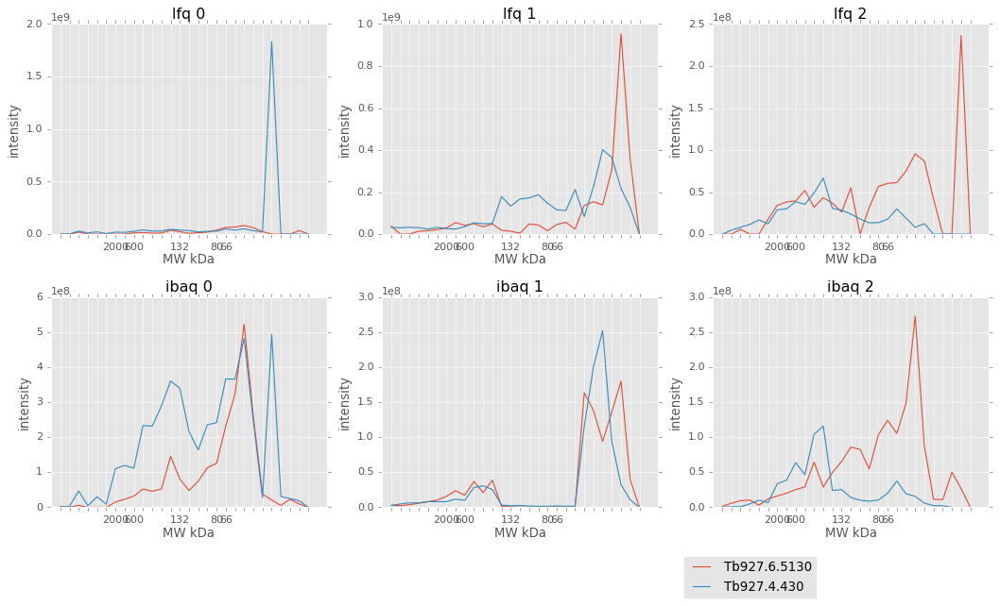

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.5130                  10               0   
Tb927.4.430                   24               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.6.5130  60S acidic ribosomal protein P2, putative  
Tb927.4.430                   proteasome beta 7 subunit  
24 14 84 ['Tb927.6.5130', 'Tb927.4.430']


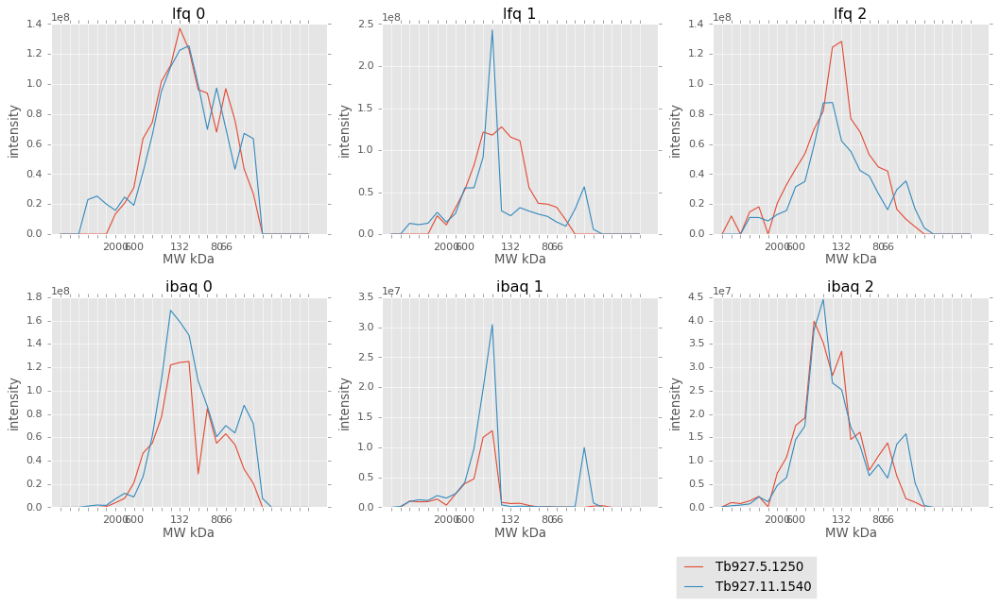

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.5.1250                   63               0   
Tb927.11.1540                  44               0   

                                [Product Description]  
[Input ID]                                             
Tb927.5.1250   GAF domain/TIP41-like family, putative  
Tb927.11.1540  isovaleryl-coA dehydrogenase, putative  
24 37 38 ['Tb927.5.1250', 'Tb927.11.1540']


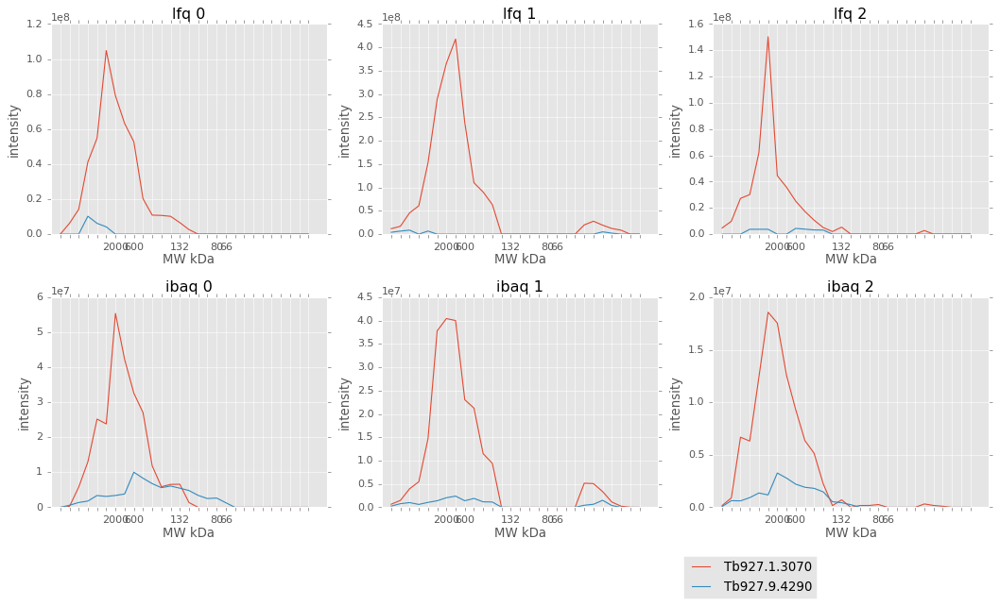

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.1.3070                  44               0   
Tb927.9.4290                  27               0   

                        [Product Description]  
[Input ID]                                     
Tb927.1.3070  hypothetical protein, conserved  
Tb927.9.4290  hypothetical protein, conserved  
85 44 47 ['Tb927.1.3070', 'Tb927.9.4290']


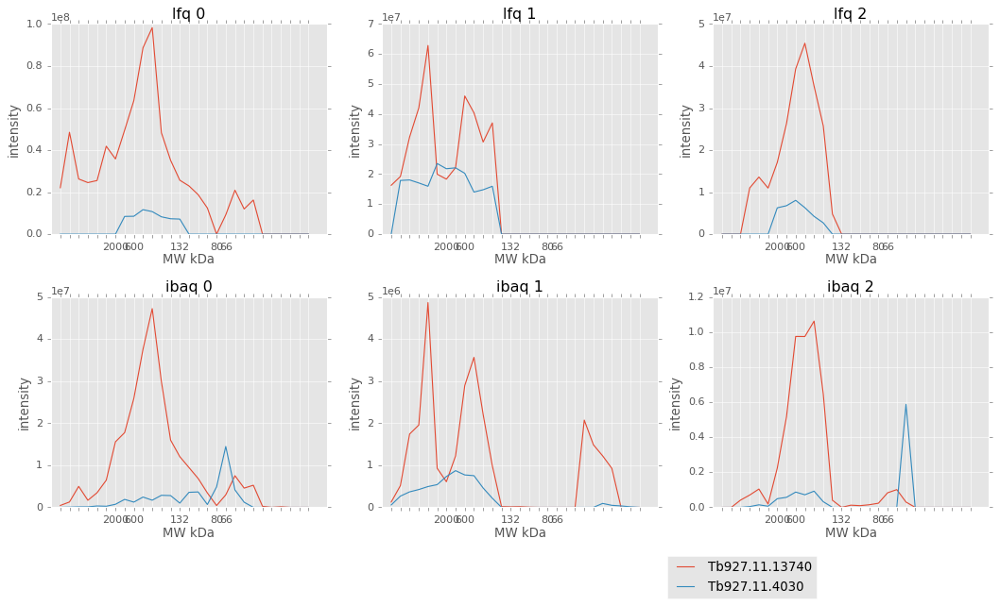

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.13740                 133               2   
Tb927.11.4030                  183               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.13740  procyclic-enriched flagellar receptor adenylat...  
Tb927.11.4030                     hypothetical protein, conserved  
57 70 67 ['Tb927.11.13740', 'Tb927.11.4030']


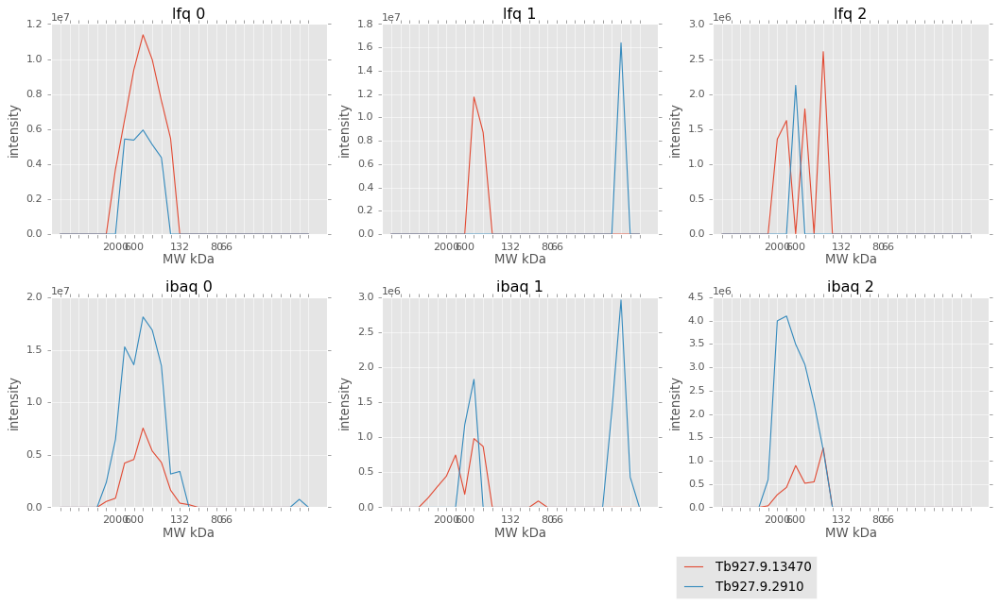

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.13470                  85               0   
Tb927.9.2910                   19               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.9.13470                   hypothetical protein, conserved  
Tb927.9.2910   histone acetyltransferase subunit NuA4, putative  
57 22 65 ['Tb927.9.13470', 'Tb927.9.2910']


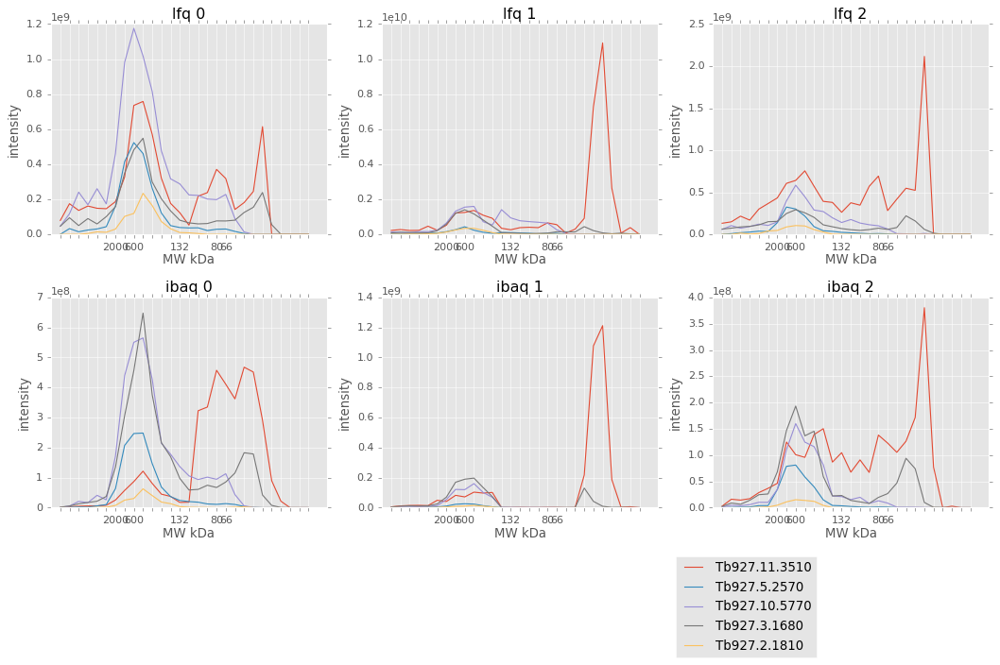

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.3510                  91               0   
Tb927.5.2570                   79               0   
Tb927.10.5770                  85               0   
Tb927.3.1680                   37               0   
Tb927.2.1810                  132               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.3510                    hypothetical protein, conserved  
Tb927.5.2570   eukaryotic translation initiation factor 3 sub...  
Tb927.10.5770                         Valosin-containing protein  
Tb927.3.1680   Eukaryotic translation initiation factor 3 sub...  
Tb927.2.1810      chromatin-remodeling complex atpase chain iswi  
57 16 65 ['Tb927.11.3510', 'Tb927.5.2570', 'Tb927.10.5770', 'Tb927.3.1680', 'Tb927.2.1810']


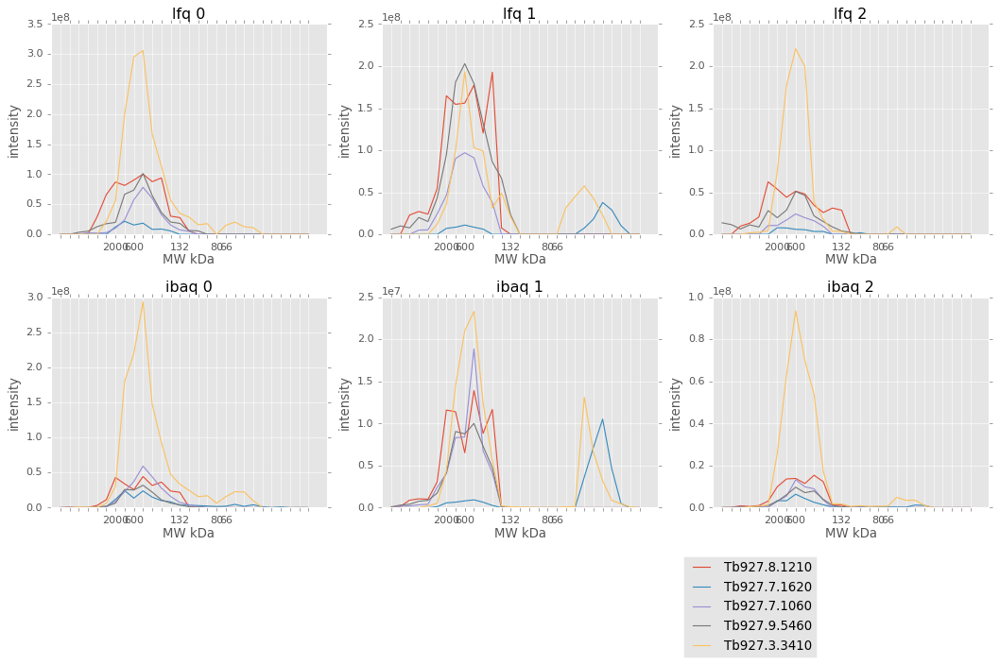

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.1210                  77               0   
Tb927.7.1620                  32               0   
Tb927.7.1060                  53               0   
Tb927.9.5460                 110               0   
Tb927.3.3410                  49               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.1210                    hypothetical protein, conserved  
Tb927.7.1620         Cleavage factor I 25 kDa subunit, putative  
Tb927.7.1060                               ISWI complex protein  
Tb927.9.5460  Eukaryotic translation initiation factor 4 gam...  
Tb927.3.3410                  aspartyl aminopeptidase, putative  
57 16 67 ['Tb927.8.1210', 'Tb927.7.1620', 'Tb927.7.1060', 'Tb927.9.5460', 'Tb927.3.3410']


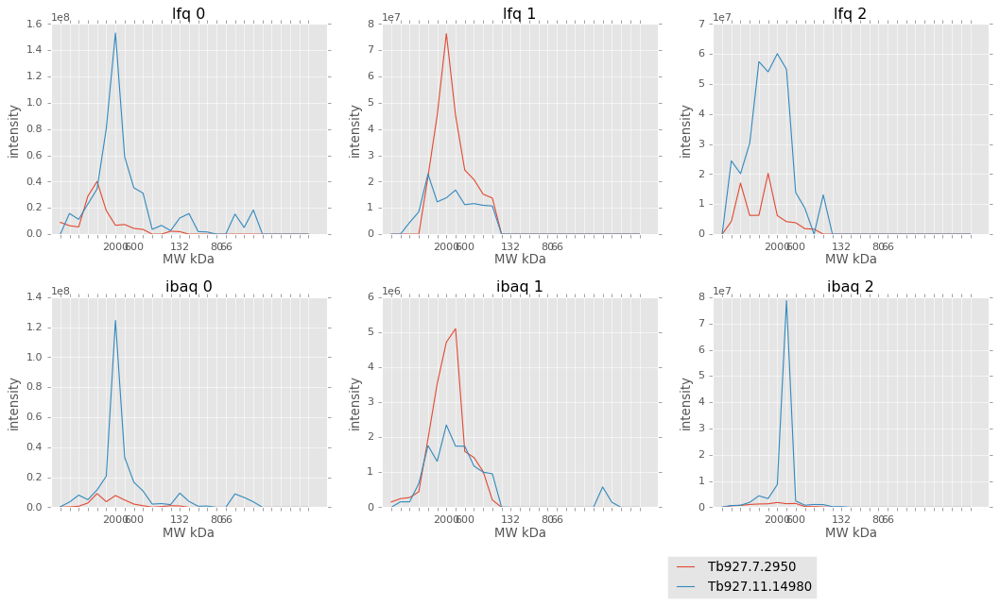

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.2950                    74               2   
Tb927.11.14980                  58               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.7.2950    ATPase family associated with various cellular...  
Tb927.11.14980                mitochondrial ribosomal protein L38  
72 54 90 ['Tb927.7.2950', 'Tb927.11.14980']


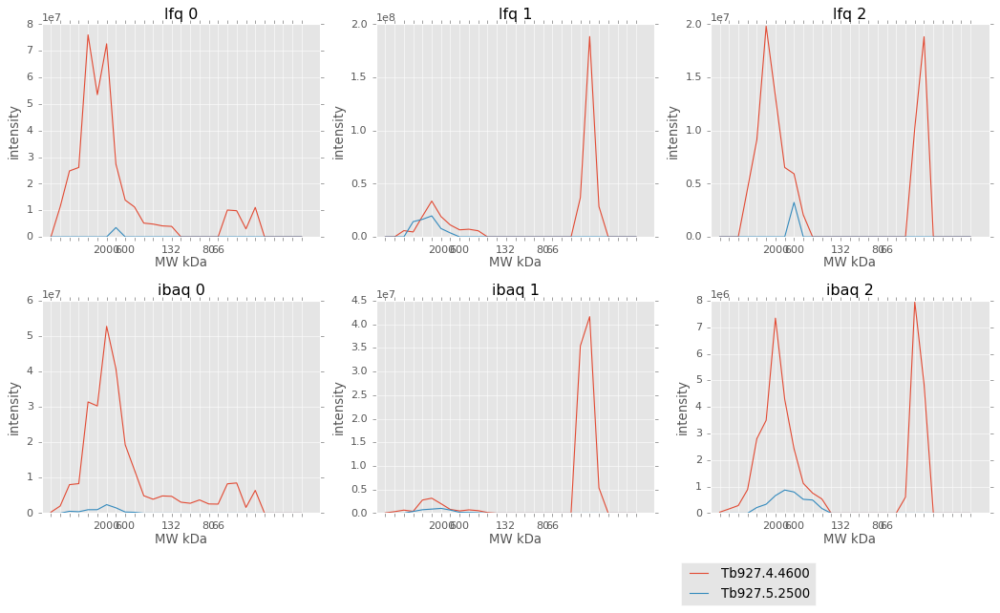

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.4600                  31               0   
Tb927.5.2500                  75               0   

                            [Product Description]  
[Input ID]                                         
Tb927.4.4600  mitochondrial ribosomal protein l43  
Tb927.5.2500      hypothetical protein, conserved  
72 76 73 ['Tb927.4.4600', 'Tb927.5.2500']


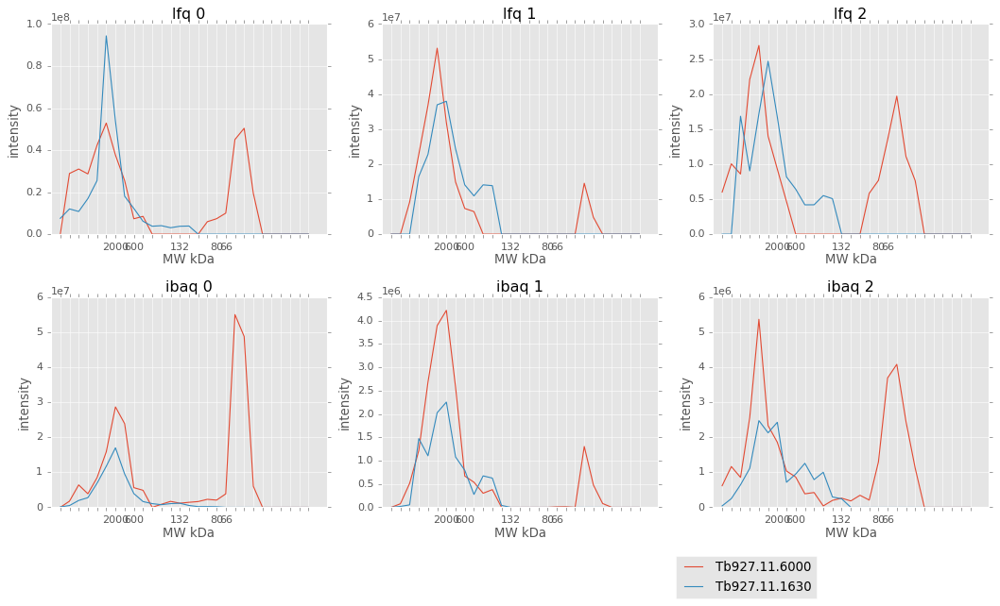

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.6000                  53               0   
Tb927.11.1630                  93               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.6000              mitochondrial ribosomal protein L4  
Tb927.11.1630  LSU ribosomal protein, mitochondrial, putative  
72 76 48 ['Tb927.11.6000', 'Tb927.11.1630']


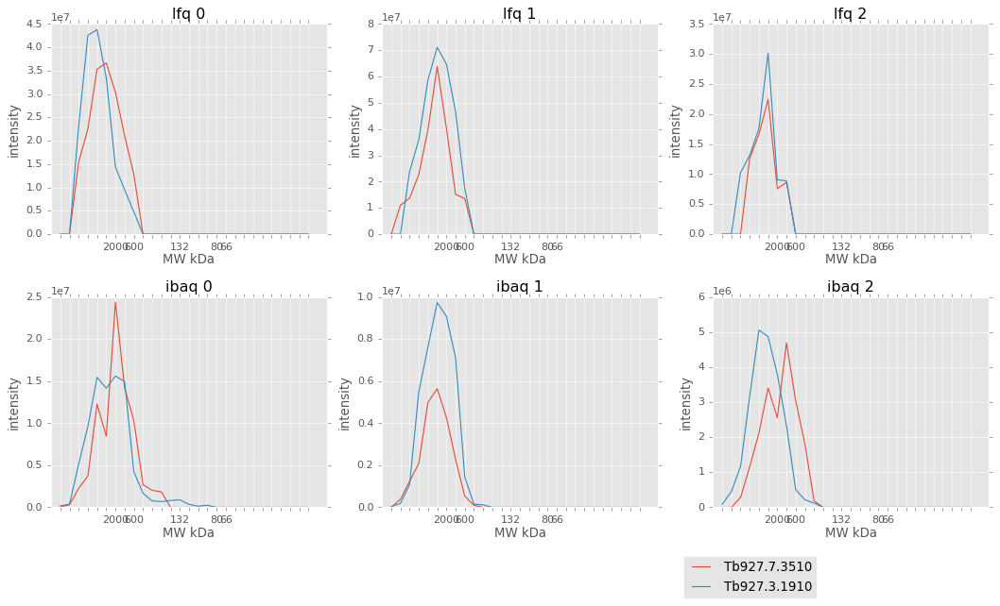

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.3510                  56               0   
Tb927.3.1910                  63               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.3510     LSU ribosomal protein, mitochondrial, putative  
Tb927.3.1910  Histone RNA hairpin-binding protein RNA-bindin...  
72 75 43 ['Tb927.7.3510', 'Tb927.3.1910']


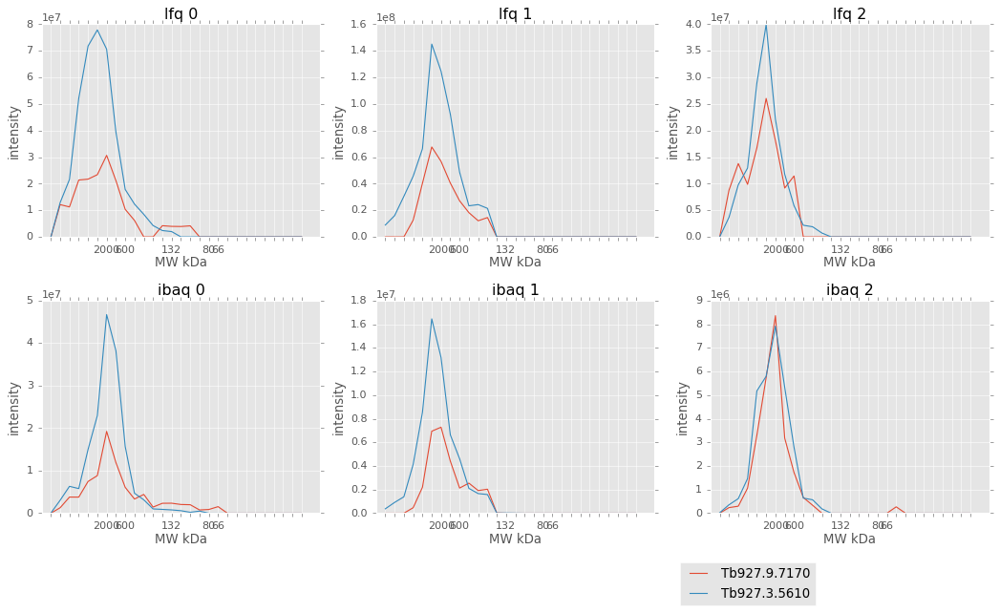

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.7170                  53               0   
Tb927.3.5610                  54               0   

                            [Product Description]  
[Input ID]                                         
Tb927.9.7170  Mitochondrial ribosomal protein L47  
Tb927.3.5610   Mitochondrial ribosomal protein L3  
72 52 82 ['Tb927.9.7170', 'Tb927.3.5610']


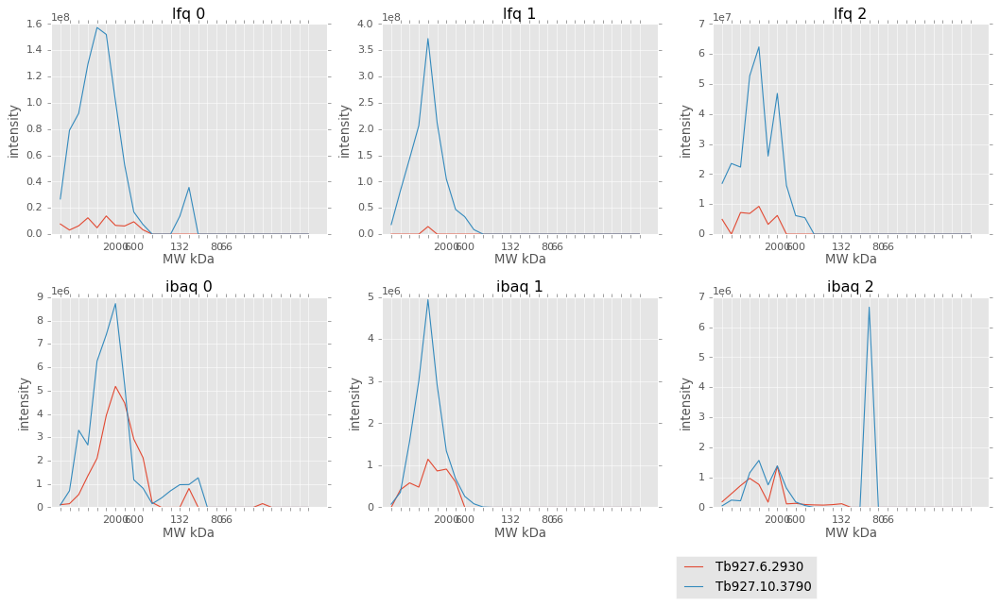

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.6.2930                   59               0   
Tb927.10.3790                 432               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.6.2930   ATPase family associated with various cellular...  
Tb927.10.3790                    hypothetical protein, conserved  
72 71 48 ['Tb927.6.2930', 'Tb927.10.3790']


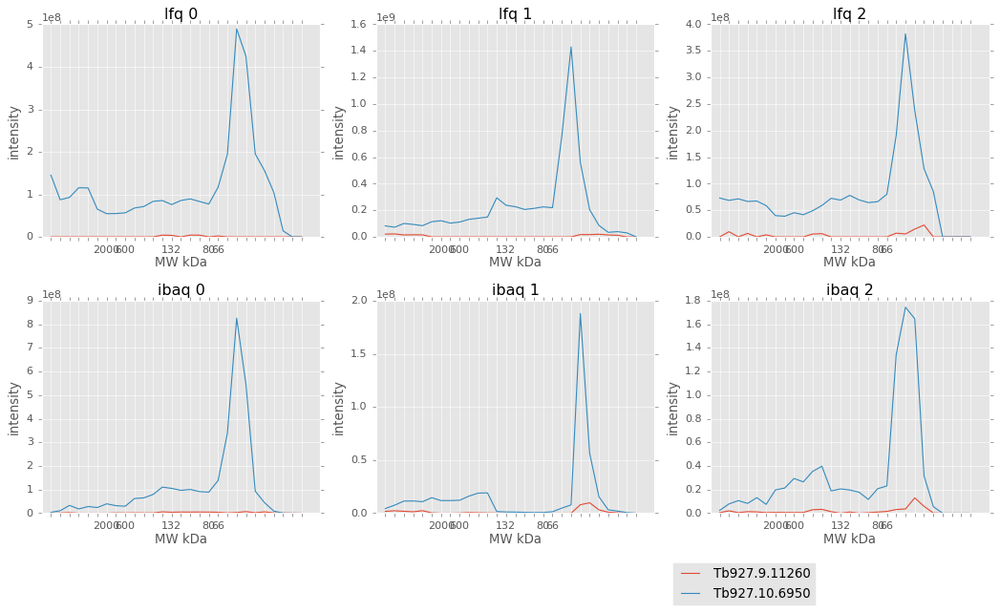

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.11260                  37               0   
Tb927.10.6950                  40               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.9.11260  nucleoside diphosphate kinase, putative  
Tb927.10.6950  sterol 24-c-methyltransferase, putative  
3 68 57 ['Tb927.9.11260', 'Tb927.10.6950']


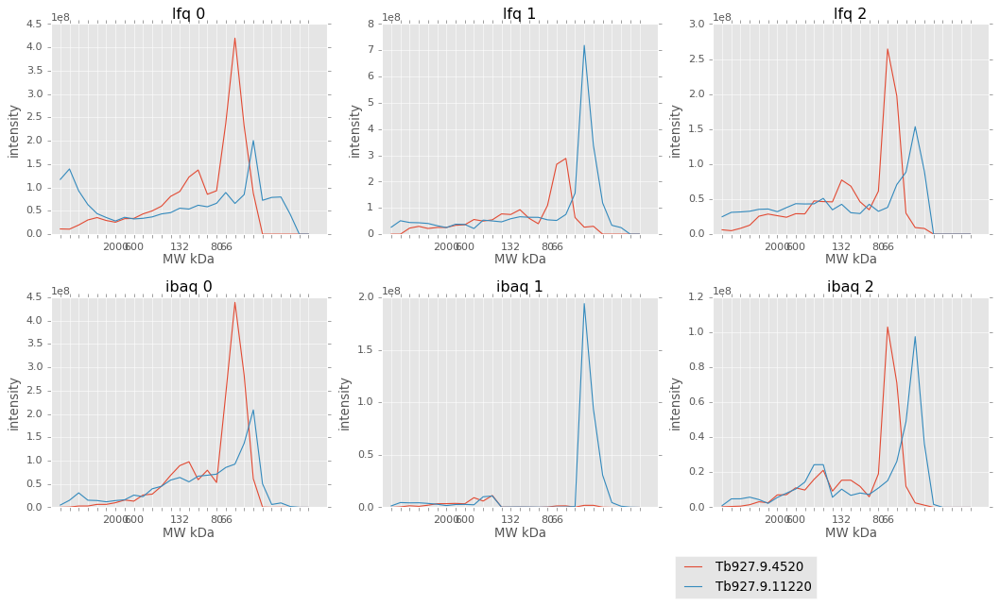

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.4520                   53               0   
Tb927.9.11220                  41               1   

                                         [Product Description]  
[Input ID]                                                      
Tb927.9.4520   Mitochondrial-processing peptidase subunit beta  
Tb927.9.11220          tRNA import complex component, putative  
22 30 33 ['Tb927.9.4520', 'Tb927.9.11220']


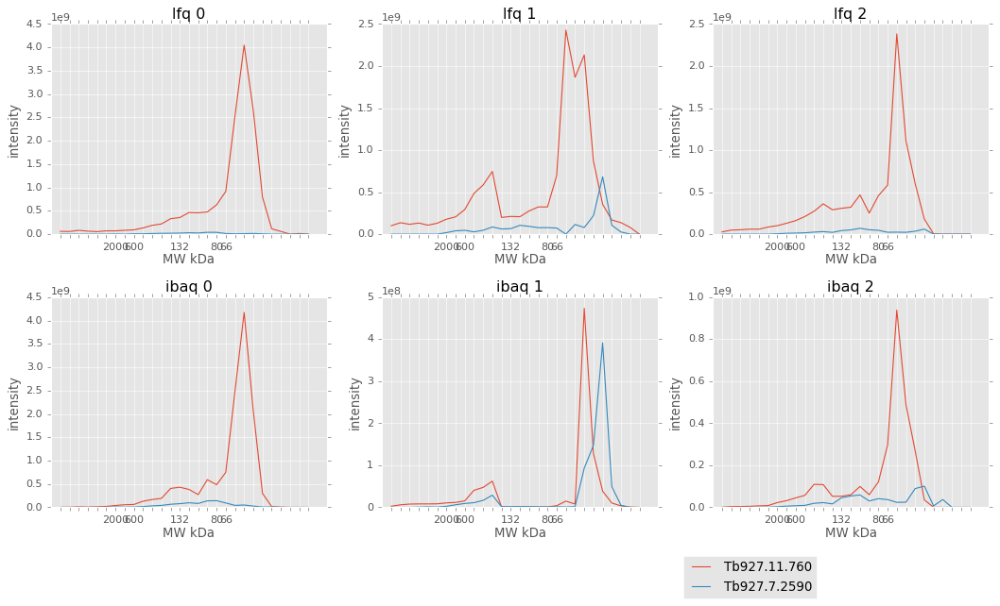

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.11.760                  45               0   
Tb927.7.2590                  18               0   

                         [Product Description]  
[Input ID]                                      
Tb927.11.760  protein phosphatase 2C, putative  
Tb927.7.2590               prefoldin, putative  
19 26 8 ['Tb927.11.760', 'Tb927.7.2590']


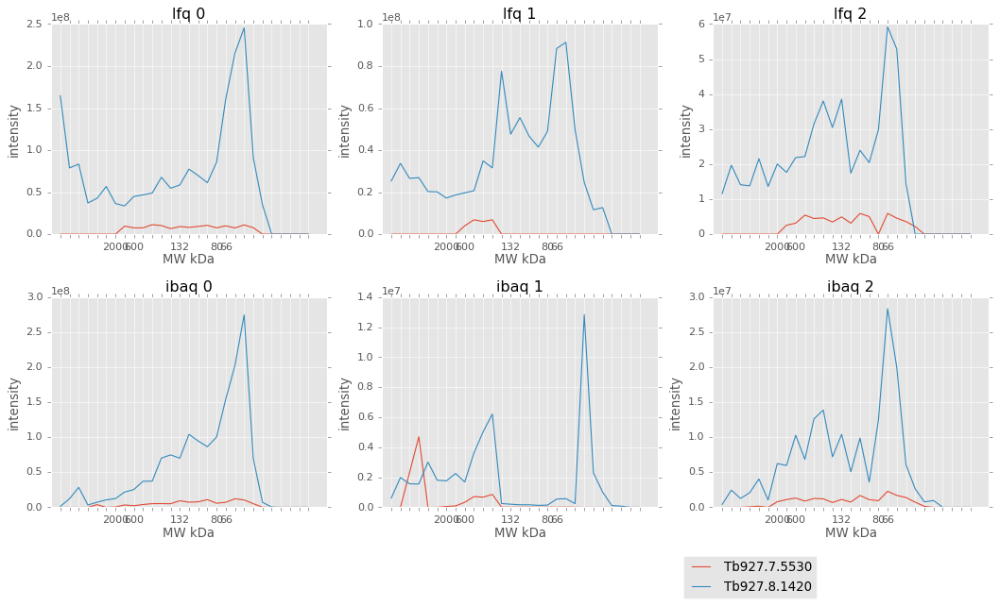

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.5530                  42               0   
Tb927.8.1420                  55               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.5530                    hypothetical protein, conserved  
Tb927.8.1420  acyl-CoA dehydrogenase, mitochondrial precurso...  
19 26 77 ['Tb927.7.5530', 'Tb927.8.1420']


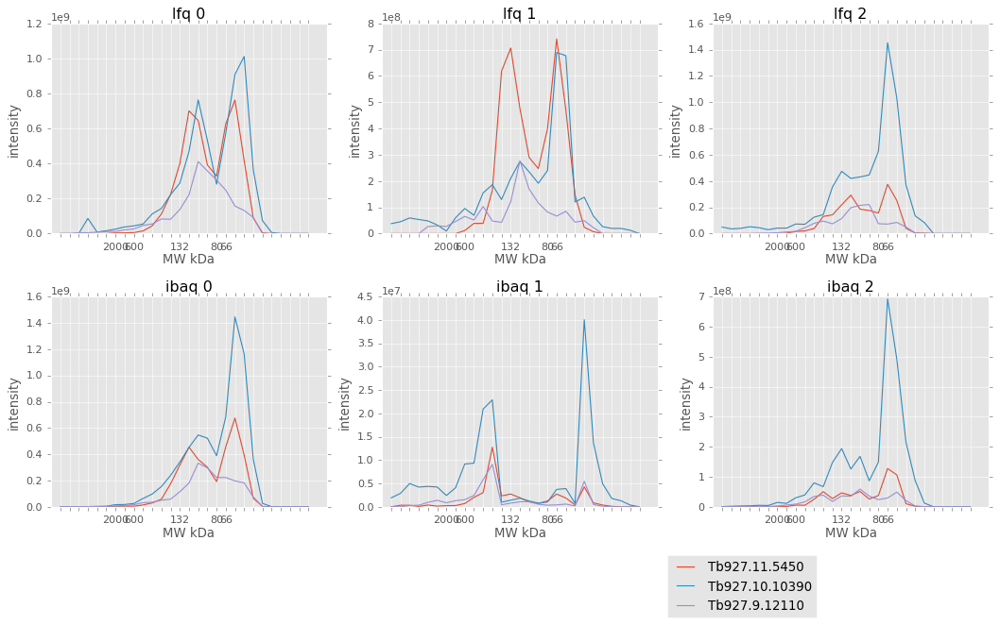

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.5450                   63               0   
Tb927.10.10390                  53               0   
Tb927.9.12110                   52               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.5450                                        malic enzyme  
Tb927.10.10390                            trypanothione reductase  
Tb927.9.12110   6-phosphogluconate dehydrogenase, decarboxylating  
19 8 20 ['Tb927.11.5450', 'Tb927.10.10390', 'Tb927.9.12110']


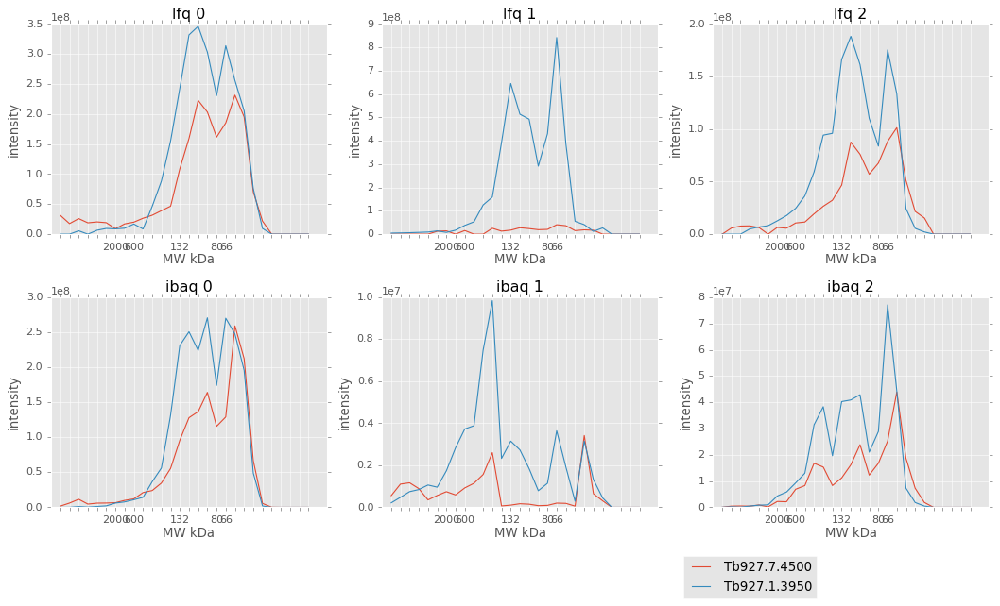

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.4500                  58               0   
Tb927.1.3950                  55               0   

                               [Product Description]  
[Input ID]                                            
Tb927.7.4500  PX domain containing protein, putative  
Tb927.1.3950                alanine aminotransferase  
19 8 3 ['Tb927.7.4500', 'Tb927.1.3950']


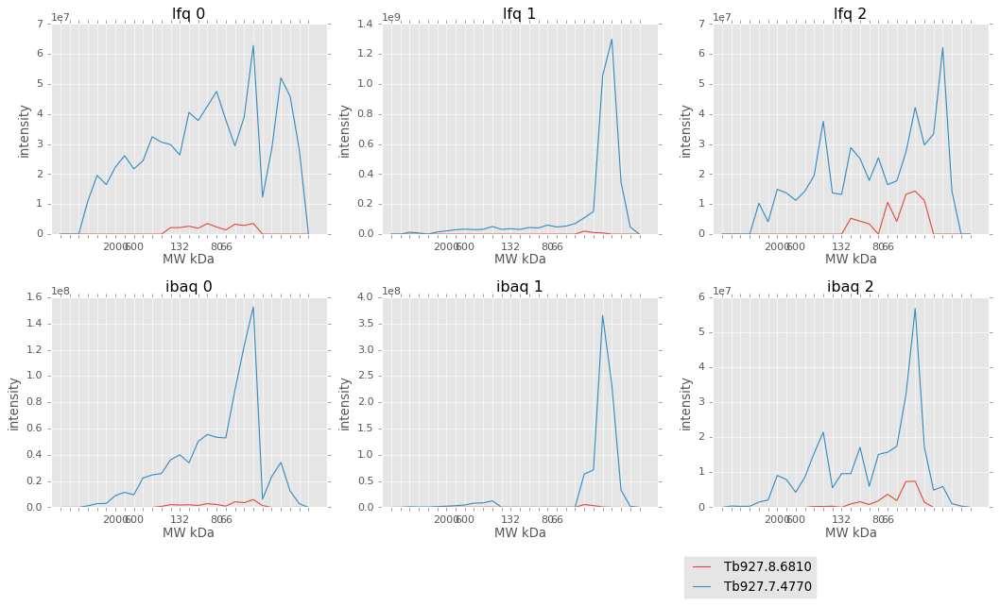

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.6810                  46               0   
Tb927.7.4770                  21               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.6810  STE/STE11 serine/threonine-protein kinase, put...  
Tb927.7.4770  cyclophilin-type peptidyl-prolyl cis-trans iso...  
19 13 10 ['Tb927.8.6810', 'Tb927.7.4770']


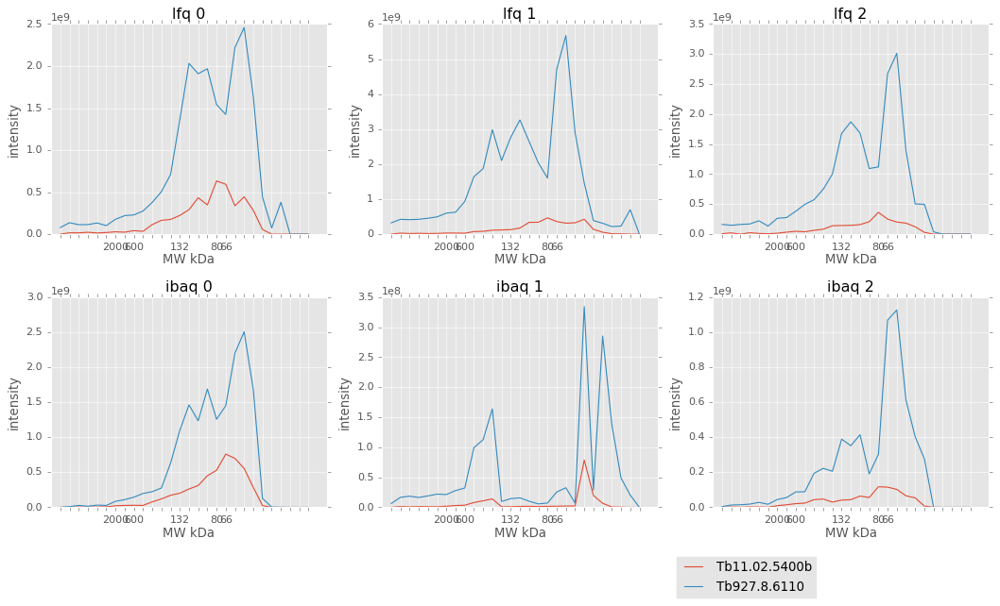

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb11.02.5400b                  39               0   
Tb927.8.6110                   54               0   

                                           [Product Description]  
[Input ID]                                                        
Tb11.02.5400b              cystathionine beta-synthase, putative  
Tb927.8.6110   3-hydroxy-3-methylglutaryl-CoA synthase, putative  
19 36 20 ['Tb11.02.5400b', 'Tb927.8.6110']


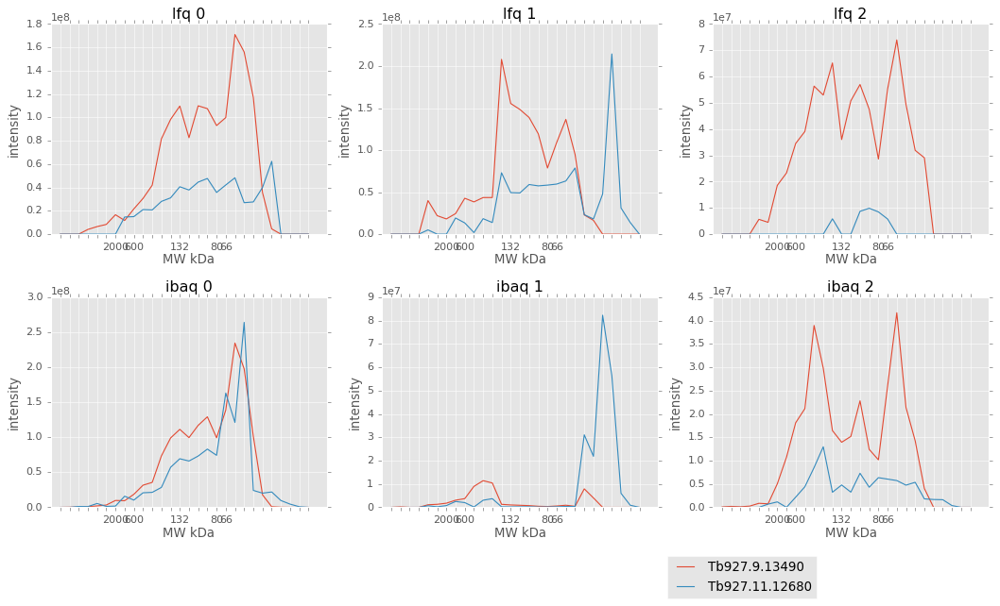

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.9.13490                   54               0   
Tb927.11.12680                  15               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.9.13490   metallo-peptidase, Clan MG, Family M24  
Tb927.11.12680           prefoldin subunit 2, putative  
19 36 10 ['Tb927.9.13490', 'Tb927.11.12680']


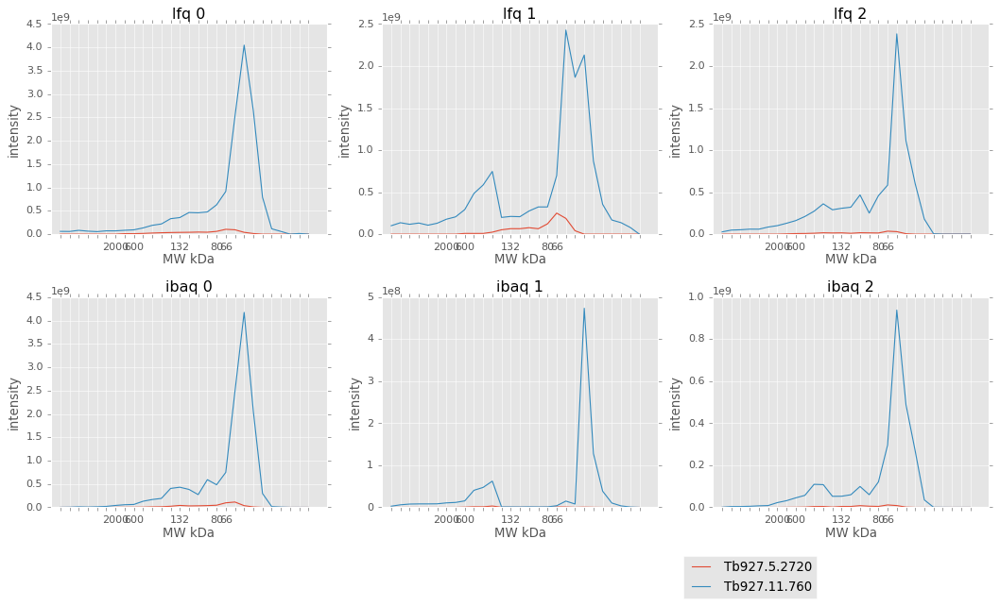

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.2720                  53               0   
Tb927.11.760                  45               0   

                         [Product Description]  
[Input ID]                                      
Tb927.5.2720          zinc finger protein ZPR1  
Tb927.11.760  protein phosphatase 2C, putative  
19 9 8 ['Tb927.5.2720', 'Tb927.11.760']


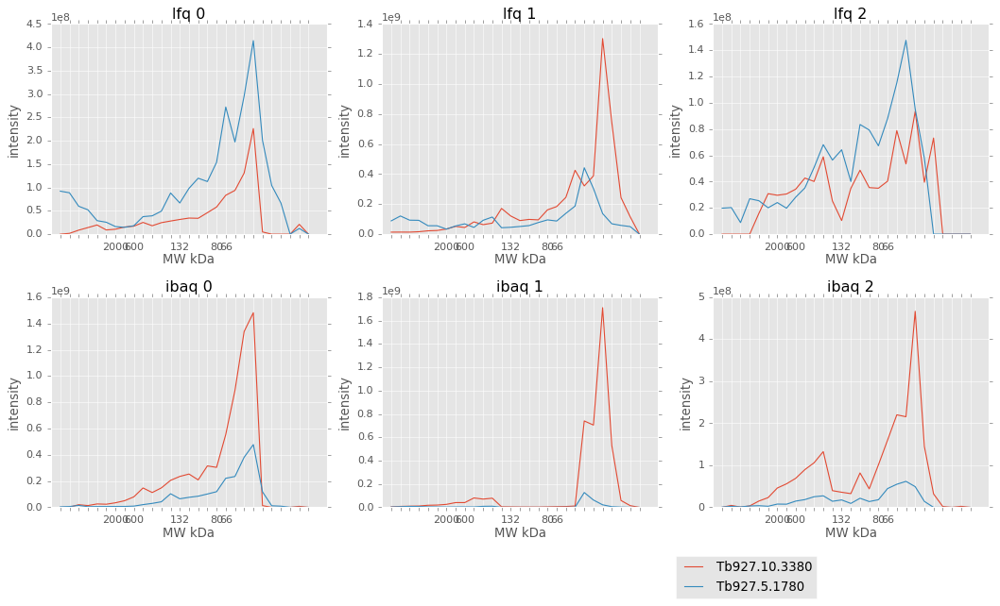

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.3380                  11               0   
Tb927.5.1780                   48               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.10.3380  60S acidic ribosomal protein P2, putative  
Tb927.5.1780             hypothetical protein, conserved  
19 10 16 ['Tb927.10.3380', 'Tb927.5.1780']


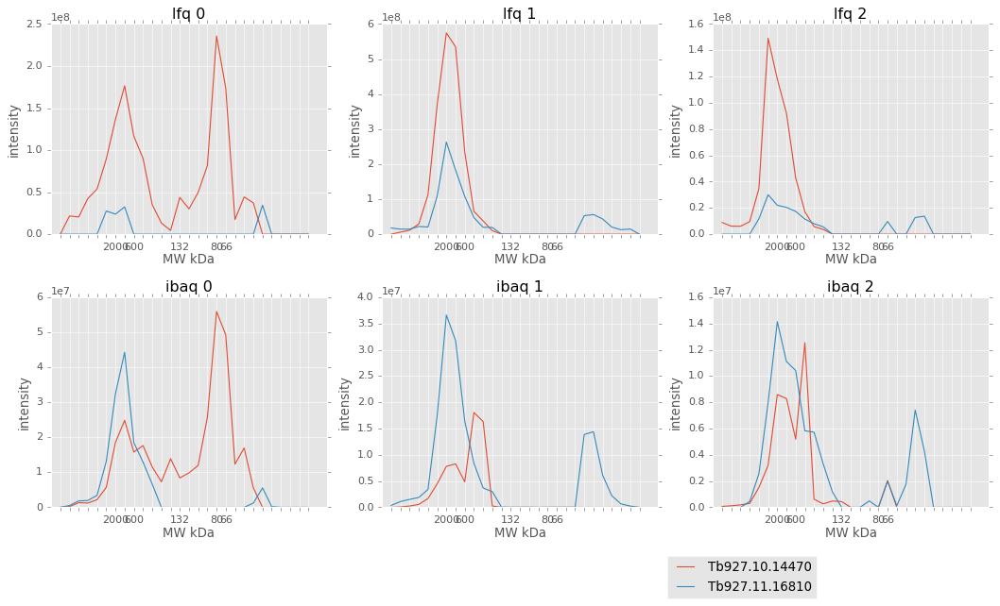

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.14470                 186               0   
Tb927.11.16810                  45               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.14470              intraflagellar transport protein 140  
Tb927.11.16810  dynein light intermediate chain D1bLIC, putative  
48 54 73 ['Tb927.10.14470', 'Tb927.11.16810']


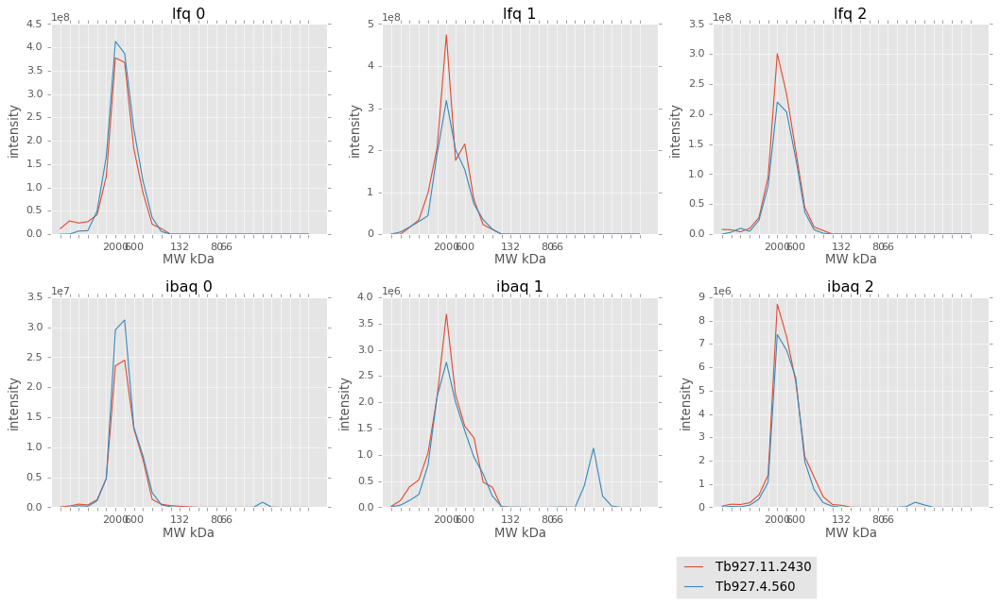

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.2430                 484               0   
Tb927.4.560                   479               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.2430  Cytoplasmic dynein 2 heavy chain (DYNC2H2), pu...  
Tb927.4.560    Cytoplasmic dynein 2 heavy chain (DYNC2H1), pu...  
48 54 74 ['Tb927.11.2430', 'Tb927.4.560']


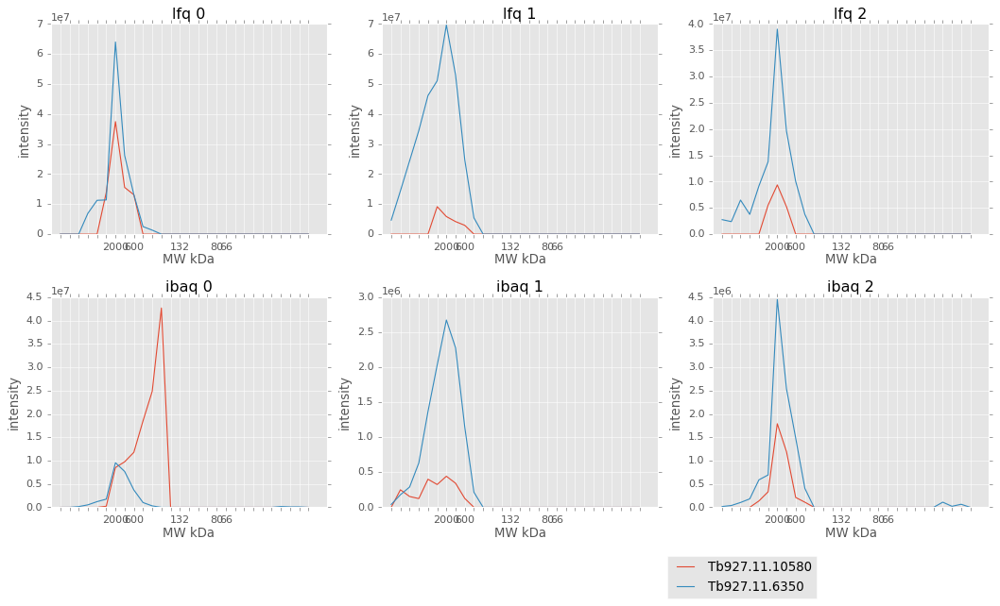

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.10580                  99               0   
Tb927.11.6350                  141               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.10580  COG (conserved oligomeric Golgi) complex compo...  
Tb927.11.6350                                AAA ATPase, putative  
48 75 83 ['Tb927.11.10580', 'Tb927.11.6350']


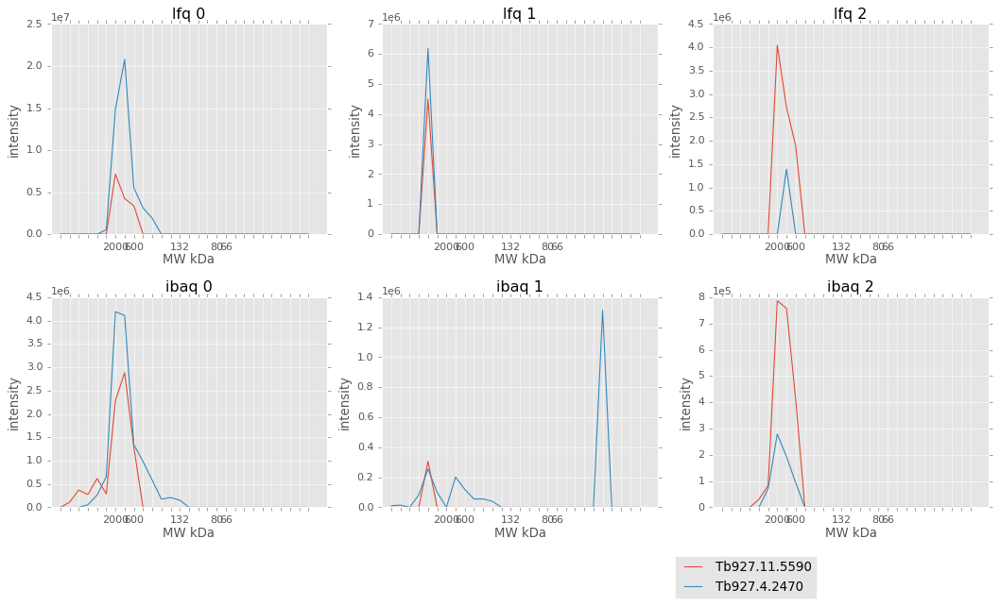

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.5590                  82               0   
Tb927.4.2470                  146               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.5590  Anaphase-promoting complex-associated protein AP1  
Tb927.4.2470                     hypothetical protein, conserved  
48 65 83 ['Tb927.11.5590', 'Tb927.4.2470']


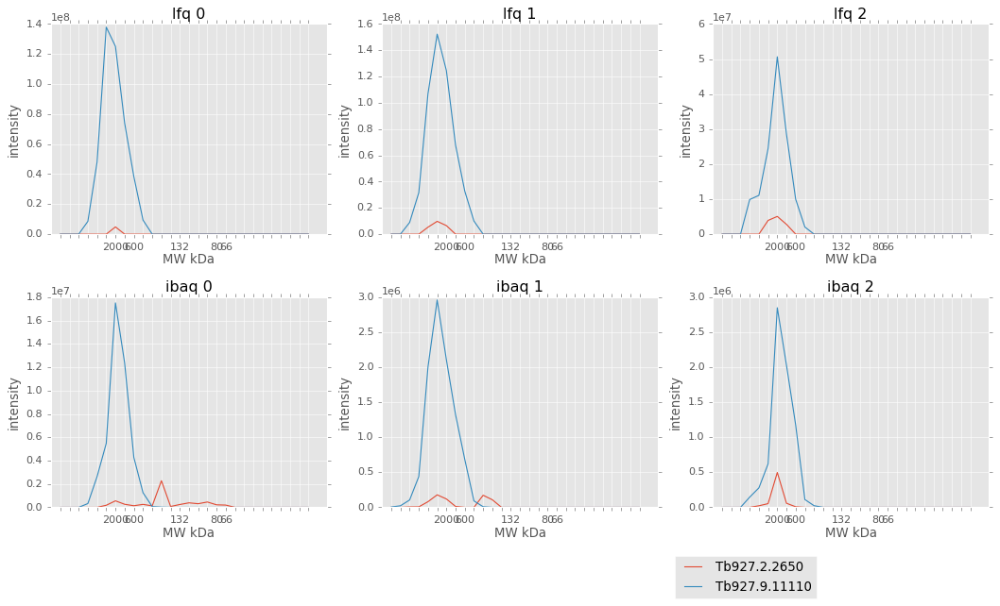

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.2.2650                  367               0   
Tb927.9.11110                 276               0   

                             [Product Description]  
[Input ID]                                          
Tb927.2.2650       hypothetical protein, conserved  
Tb927.9.11110  U5 snRNA-associated splicing factor  
50 76 83 ['Tb927.2.2650', 'Tb927.9.11110']


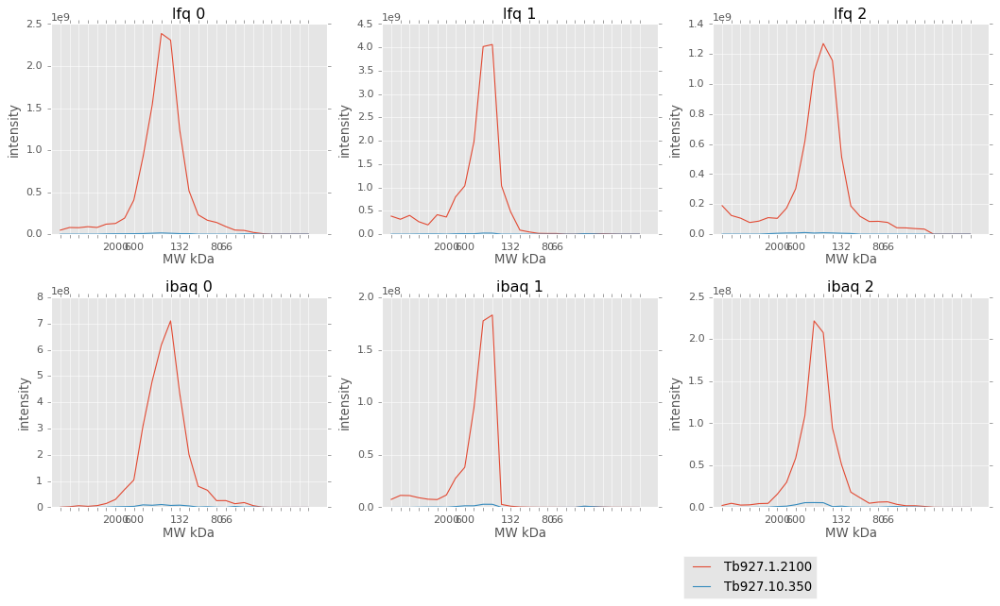

              [Molecular Weight]  [# TM Domains]         [Product Description]
[Input ID]                                                                    
Tb927.1.2100                 126               0      Calpain-like protein 1.1
Tb927.10.350                  58               0  protein kinase PK4, putative
45 15 34 ['Tb927.1.2100', 'Tb927.10.350']


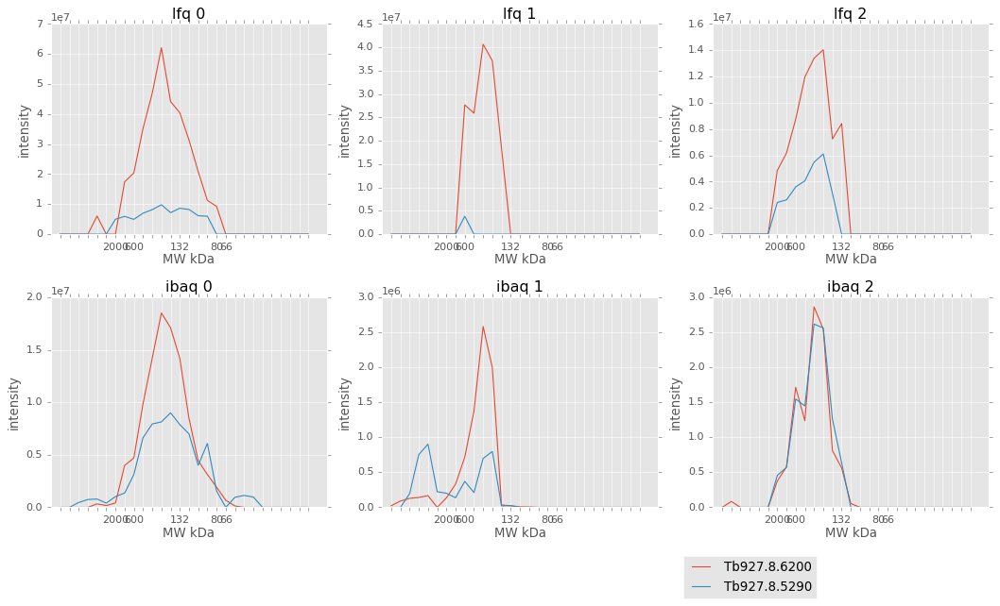

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.6200                 147               0   
Tb927.8.5290                  67               0   

                               [Product Description]  
[Input ID]                                            
Tb927.8.6200    tubulin folding cofactor D, putative  
Tb927.8.5290  WW domain containing protein, putative  
45 26 72 ['Tb927.8.6200', 'Tb927.8.5290']


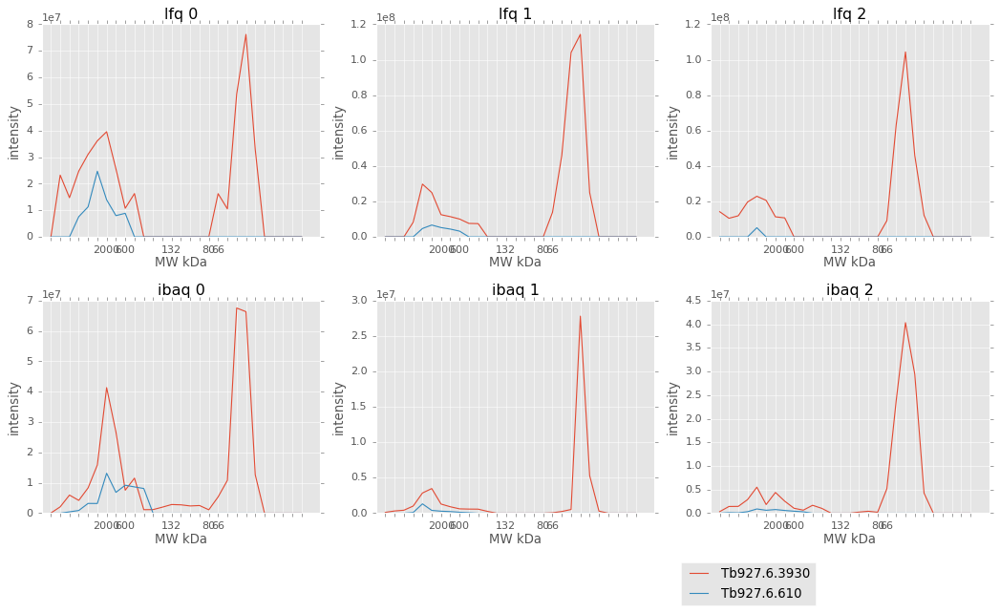

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.3930                  49               0   
Tb927.6.610                   64               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.6.3930     LSU ribosomal protein, mitochondrial, putative  
Tb927.6.610   kinetoplast ribosomal PPR-repeat containing pr...  
51 76 47 ['Tb927.6.3930', 'Tb927.6.610']


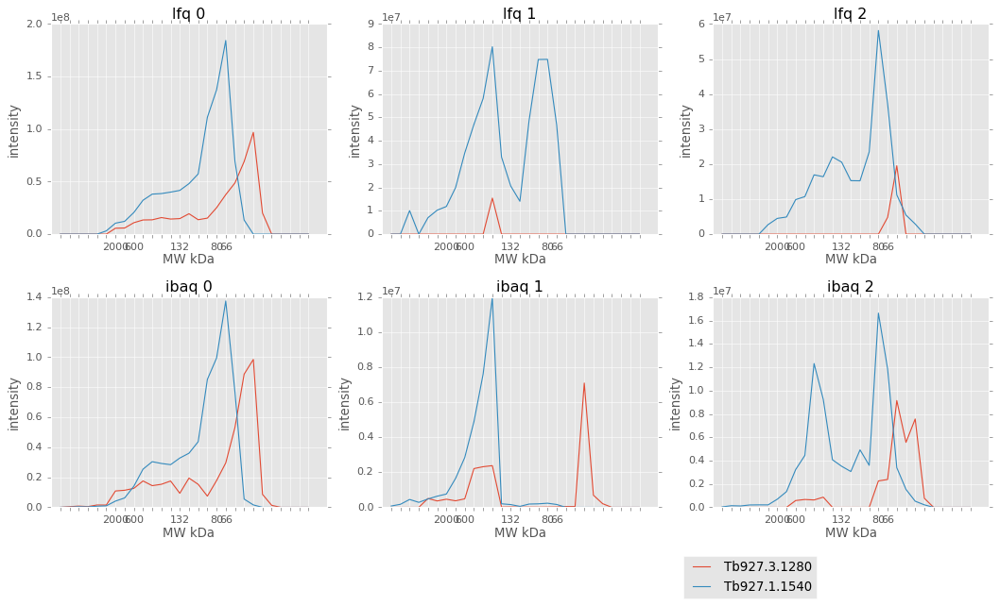

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.1280                  45               0   
Tb927.1.1540                  71               0   

                      [Product Description]  
[Input ID]                                   
Tb927.3.1280          NPL4 family, putative  
Tb927.1.1540  Tubulin/FtsZ family, putative  
56 26 30 ['Tb927.3.1280', 'Tb927.1.1540']


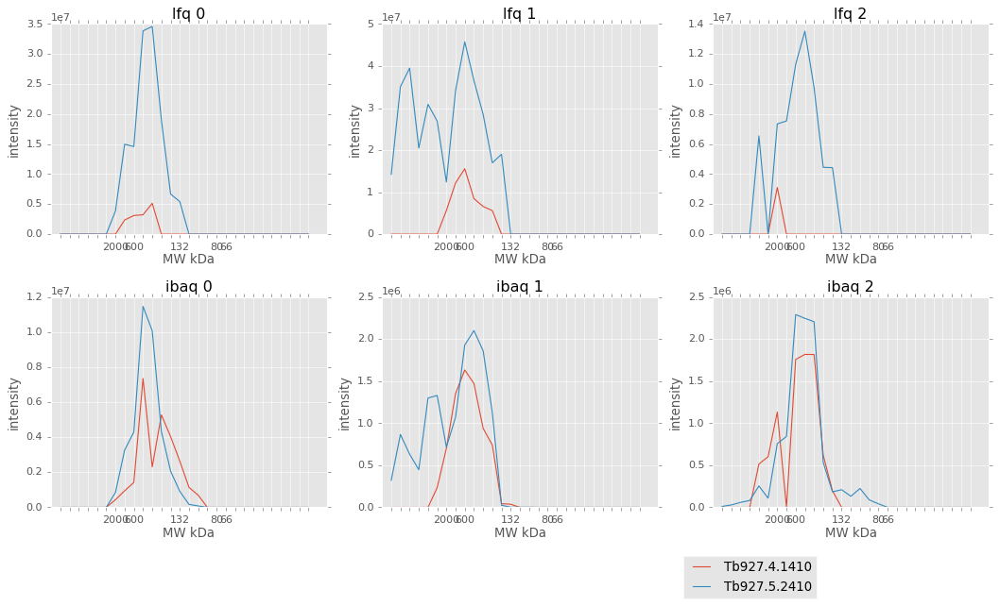

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.1410                  65               0   
Tb927.5.2410                 149               0   

                        [Product Description]  
[Input ID]                                     
Tb927.4.1410  hypothetical protein, conserved  
Tb927.5.2410                kinesin, putative  
56 16 71 ['Tb927.4.1410', 'Tb927.5.2410']


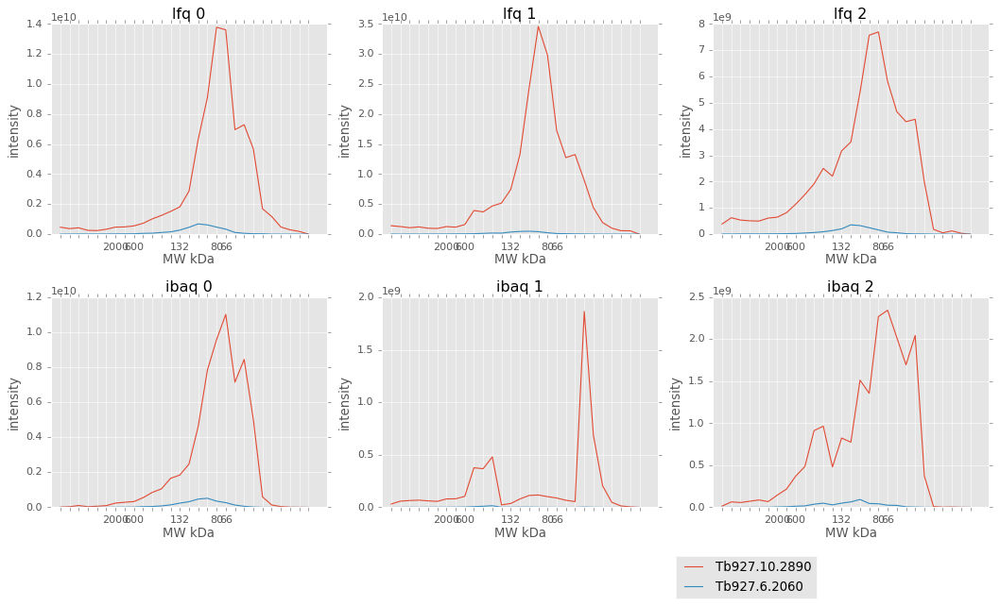

               [Molecular Weight]  [# TM Domains]     [Product Description]
[Input ID]                                                                 
Tb927.10.2890                  46               0                   enolase
Tb927.6.2060                   53               0  histidyl-tRNA synthetase
1 7 20 ['Tb927.10.2890', 'Tb927.6.2060']


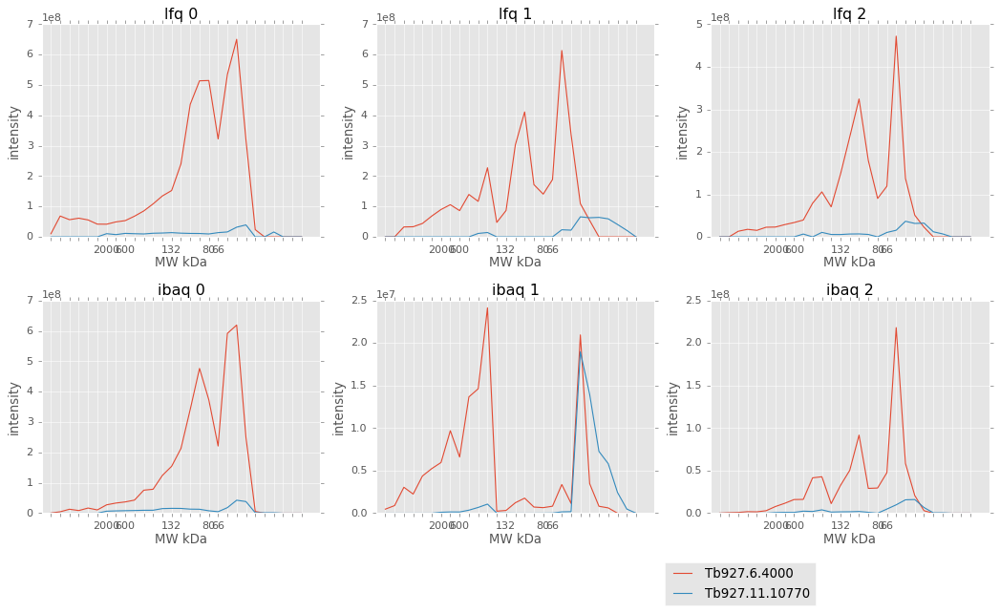

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.6.4000                    45               0   
Tb927.11.10770                  48               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.6.4000    small glutamine-rich tetratricopeptide repeat ...  
Tb927.11.10770            VHS domain containing protein, putative  
1 30 3 ['Tb927.6.4000', 'Tb927.11.10770']


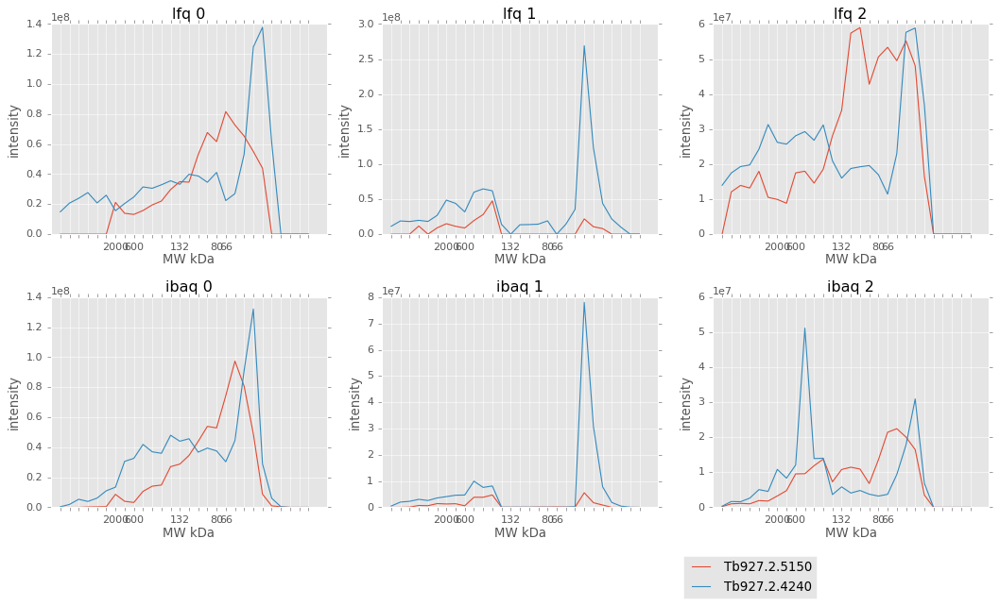

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.2.5150                  54               0   
Tb927.2.4240                  40               0   

                      [Product Description]  
[Input ID]                                   
Tb927.2.5150   TPR-repeat protein, putative  
Tb927.2.4240  GTP binding protein, putative  
1 12 34 ['Tb927.2.5150', 'Tb927.2.4240']


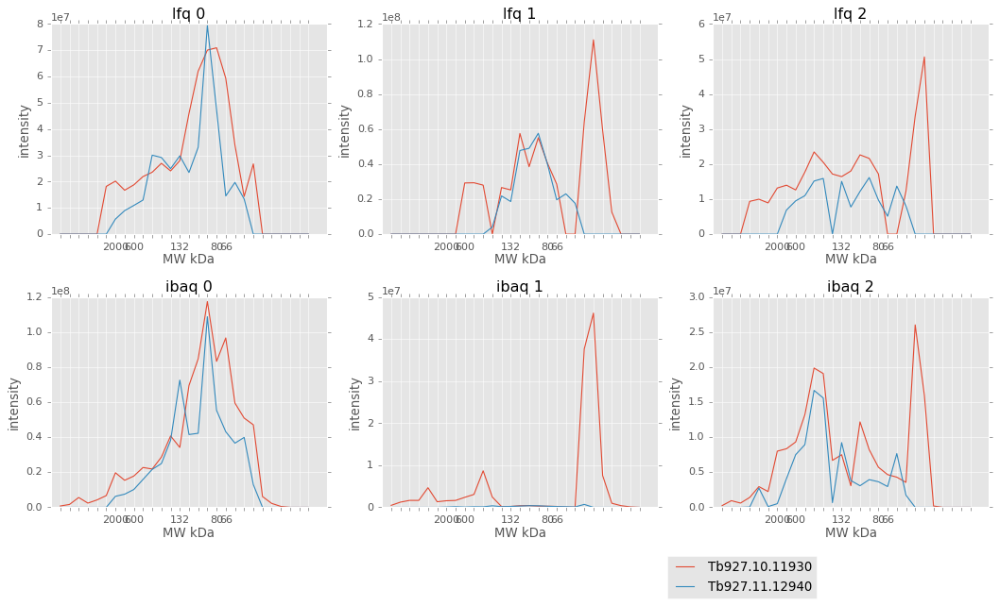

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.11930                  27               0   
Tb927.11.12940                  43               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.11930               beta-D-hydroxybutyrate dehydrogenase  
Tb927.11.12940  Uncharacterised protein family (UPF0160), puta...  
1 10 30 ['Tb927.10.11930', 'Tb927.11.12940']


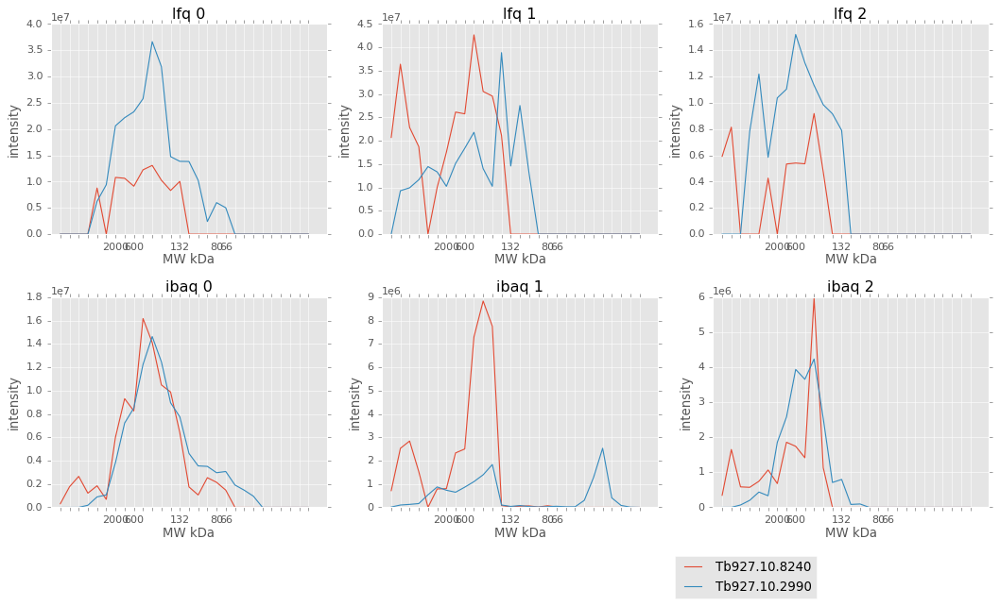

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.8240                  42               0   
Tb927.10.2990                 110               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.10.8240             hypothetical protein, conserved  
Tb927.10.2990  nuclear cap binding complex subunit CBP110  
27 26 67 ['Tb927.10.8240', 'Tb927.10.2990']


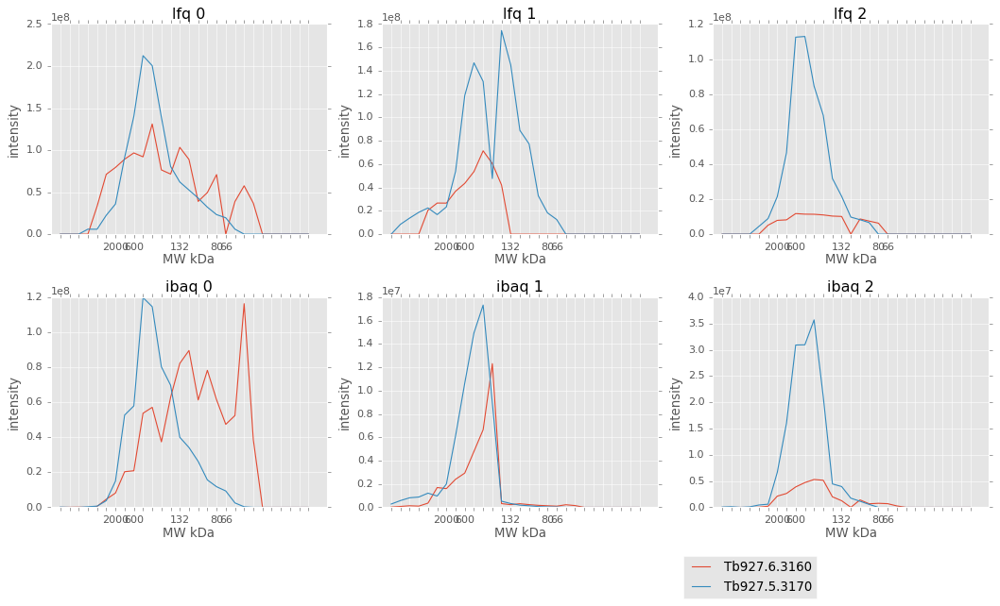

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.3160                  61               0   
Tb927.5.3170                  73               0   

                                     [Product Description]  
[Input ID]                                                  
Tb927.6.3160                  splicing factor 3a, putative  
Tb927.5.3170  ribose-phosphate pyrophosphokinase, putative  
27 13 68 ['Tb927.6.3160', 'Tb927.5.3170']


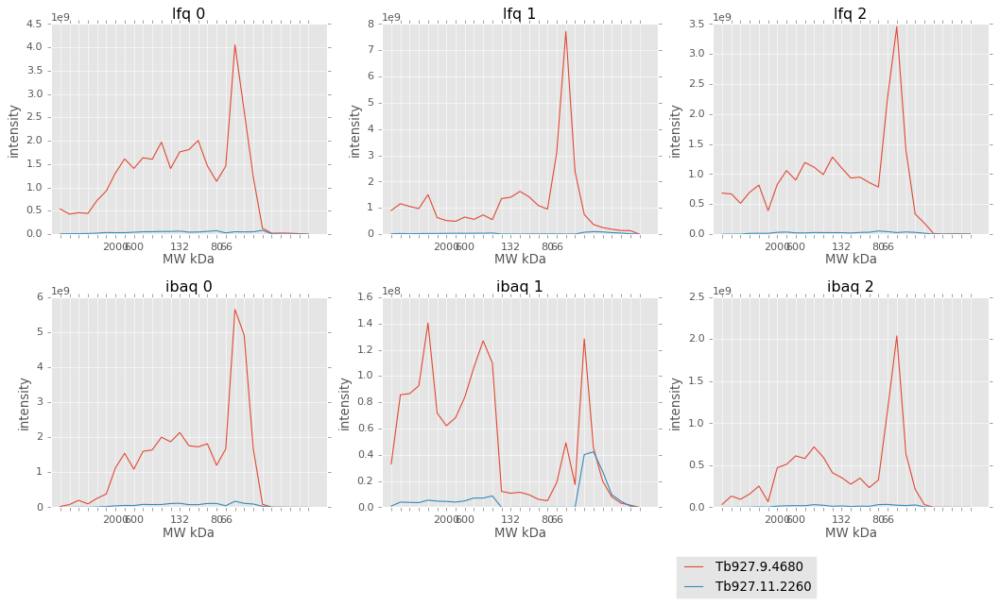

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.4680                   45               0   
Tb927.11.2260                  26               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.9.4680               Eukaryotic initiation factor 4A-1  
Tb927.11.2260  Eukaryotic translation initiation factor 4E-1  
33 68 36 ['Tb927.9.4680', 'Tb927.11.2260']


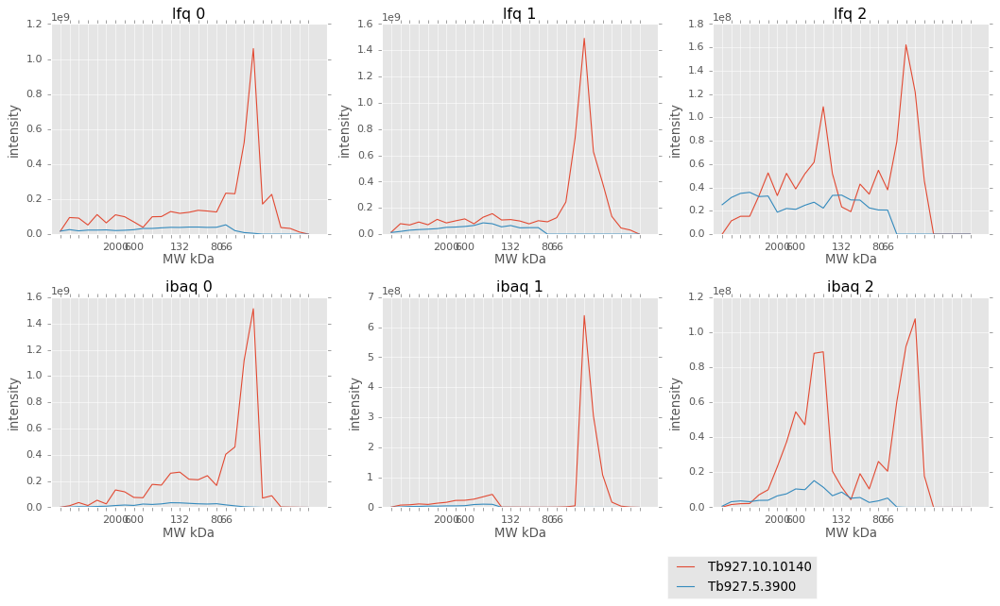

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.10140                  37               0   
Tb927.5.3900                    82               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.10140              paraflagellar rod component, putative  
Tb927.5.3900    Galactose oxidase, central domain/Domain of un...  
33 12 68 ['Tb927.10.10140', 'Tb927.5.3900']


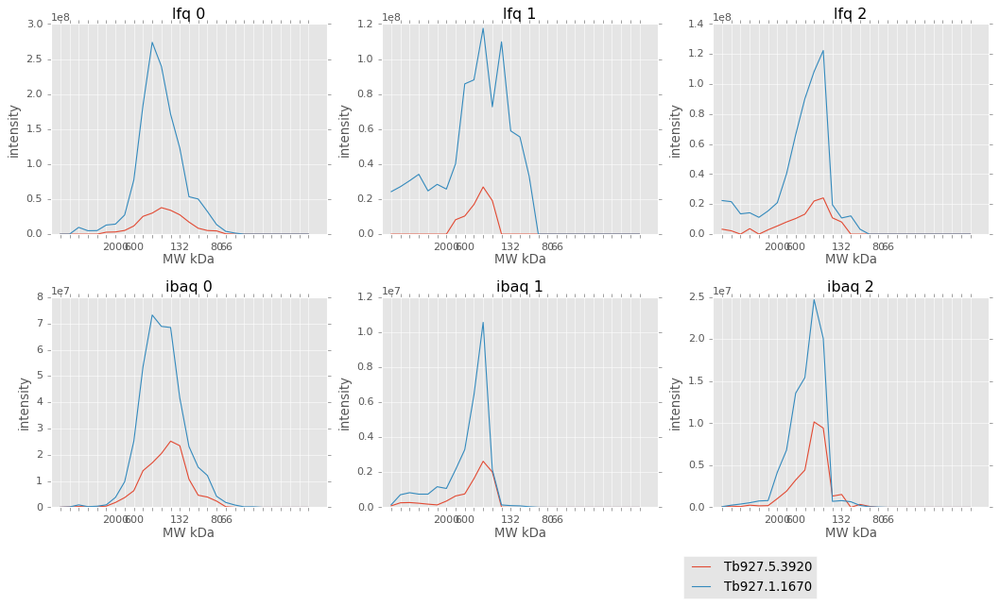

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.3920                 106               0   
Tb927.1.1670                 120               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.5.3920              Peroxisome biogenesis factor 6  
Tb927.1.1670  ARM-like helical domain-containing protein  
42 15 71 ['Tb927.5.3920', 'Tb927.1.1670']


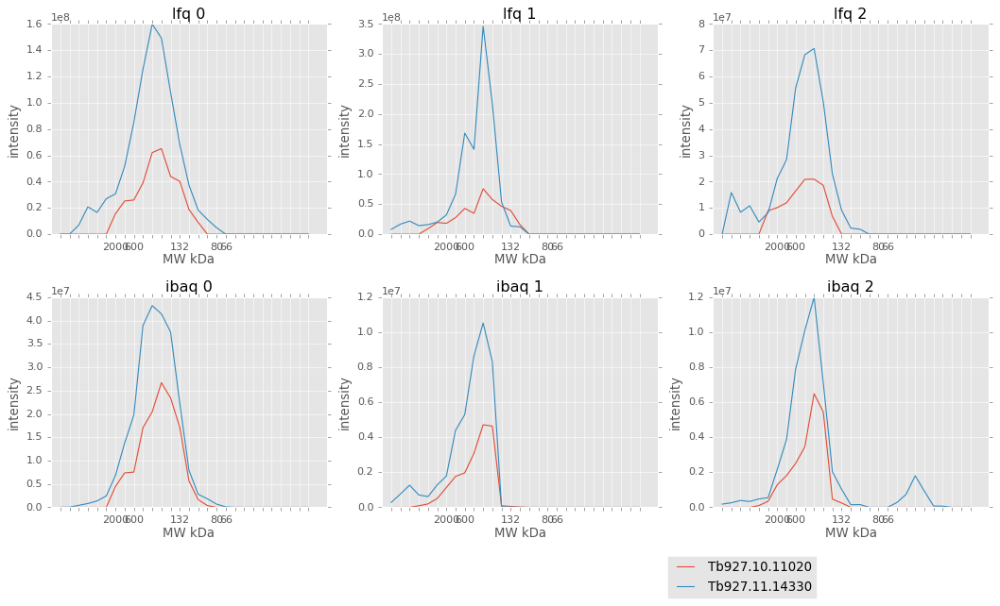

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.11020                 105               0   
Tb927.11.14330                 176               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.10.11020     DNA mismatch repair protein MSH2, putative  
Tb927.11.14330  HECT-domain (ubiquitin-transferase), putative  
42 13 70 ['Tb927.10.11020', 'Tb927.11.14330']


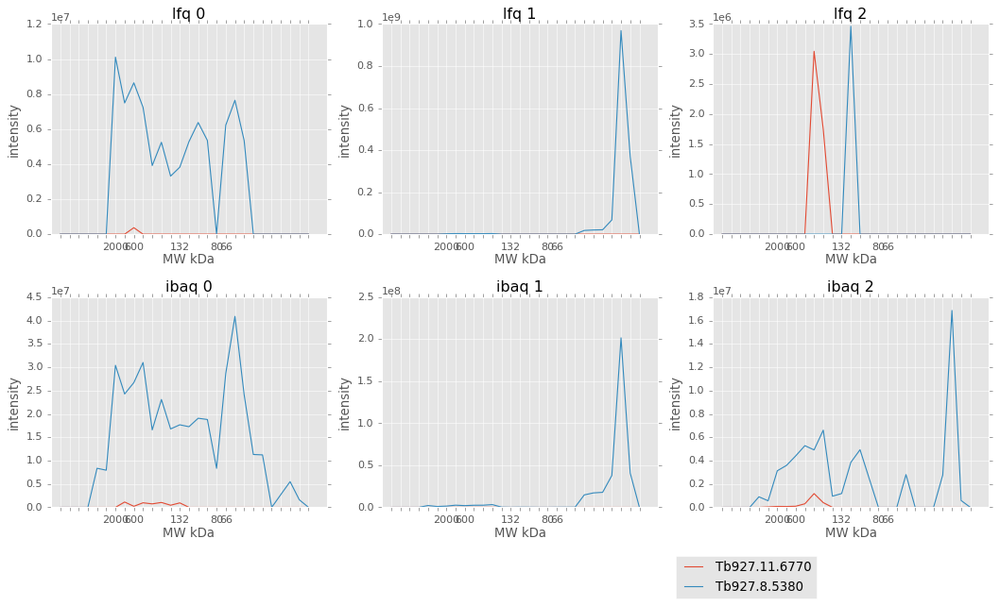

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.6770                  74               0   
Tb927.8.5380                   10               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.11.6770            hypothetical protein, conserved  
Tb927.8.5380   ubiquitin fold modifier protein, putative  
42 16 31 ['Tb927.11.6770', 'Tb927.8.5380']


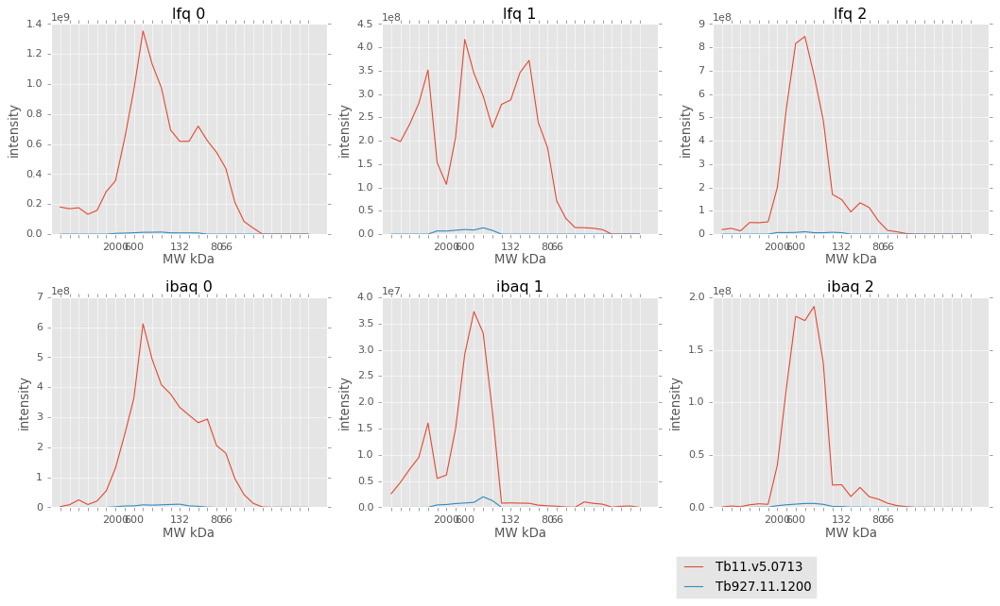

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb11.v5.0713                   78               0   
Tb927.11.1200                  66               0   

                                          [Product Description]  
[Input ID]                                                       
Tb11.v5.0713   retrotransposon hot spot (RHS) protein, putative  
Tb927.11.1200                   hypothetical protein, conserved  
42 16 68 ['Tb11.v5.0713', 'Tb927.11.1200']


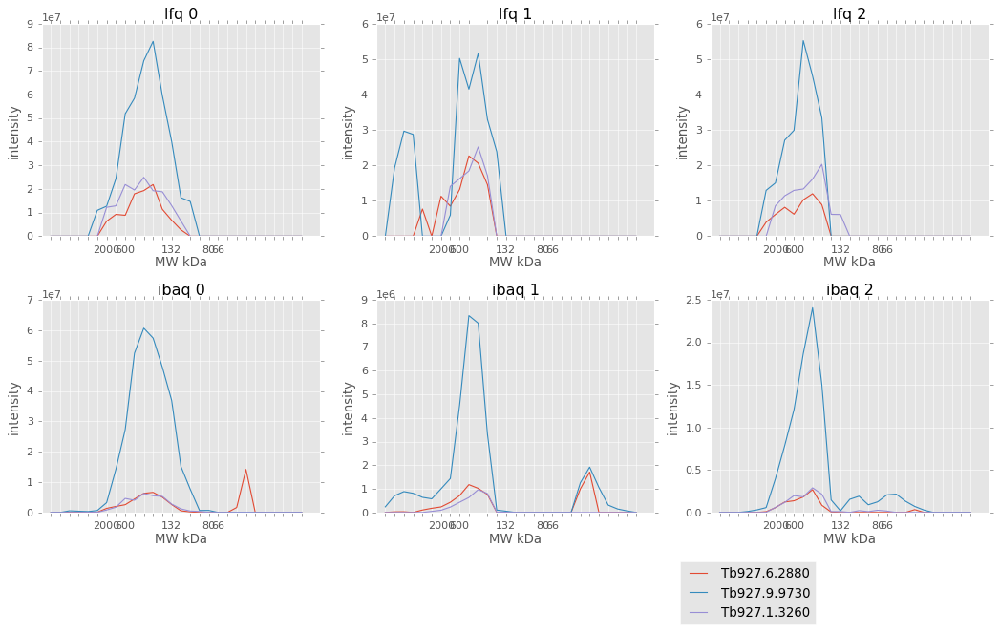

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.6.2880                 122               0   
Tb927.9.9730                  44               0   
Tb927.1.3260                 203               0   

                        [Product Description]  
[Input ID]                                     
Tb927.6.2880                kinesin, putative  
Tb927.9.9730    Flagellar pocket protein FP45  
Tb927.1.3260  hypothetical protein, conserved  
42 11 67 ['Tb927.6.2880', 'Tb927.9.9730', 'Tb927.1.3260']


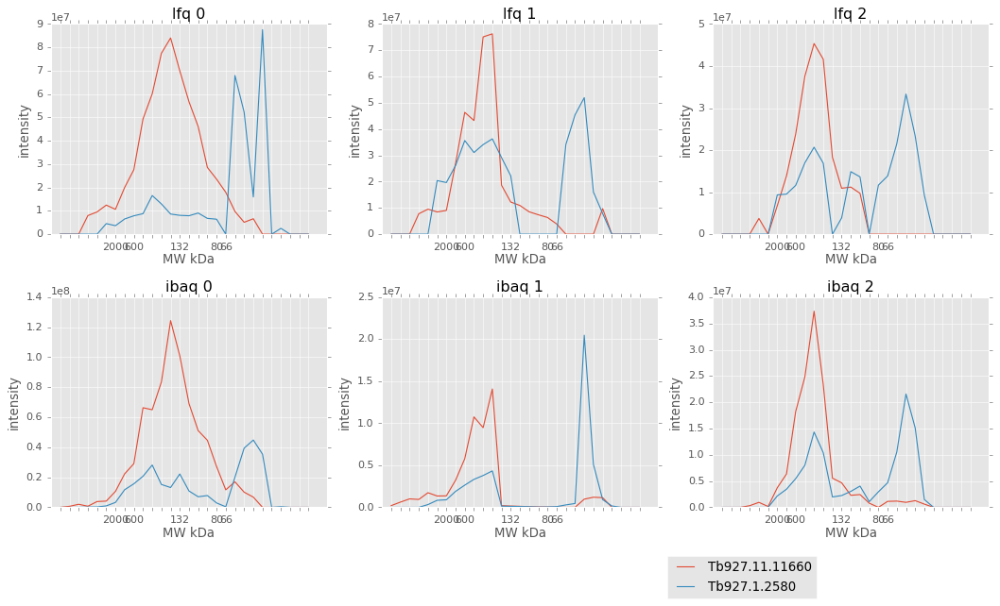

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11660                  39               0   
Tb927.1.2580                    42               0   

                       [Product Description]  
[Input ID]                                    
Tb927.11.11660             conserved protein  
Tb927.1.2580    exosome-associated protein 1  
26 15 71 ['Tb927.11.11660', 'Tb927.1.2580']


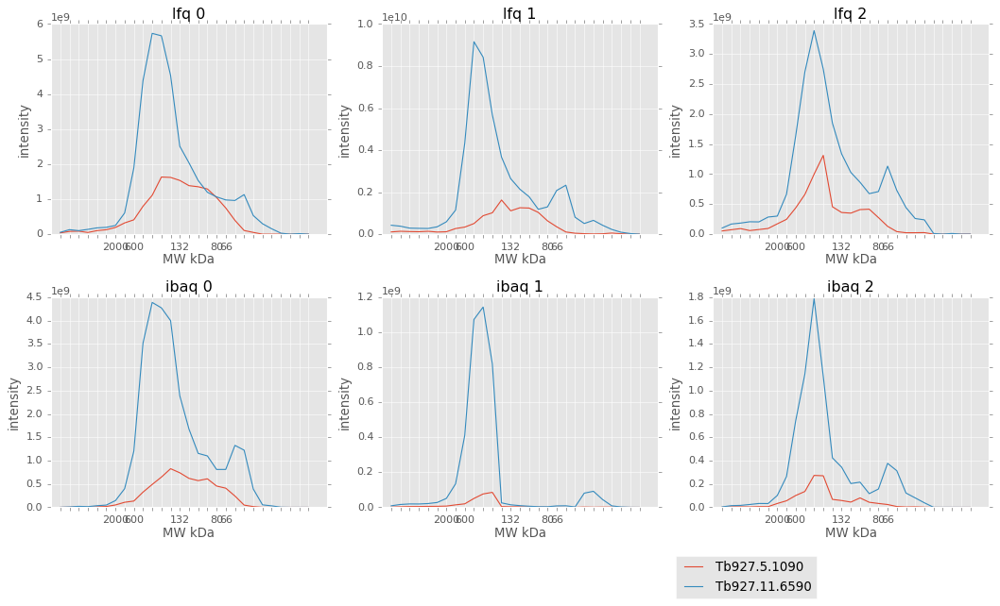

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.5.1090                   90               0   
Tb927.11.6590                  55               0   

                                [Product Description]  
[Input ID]                                             
Tb927.5.1090       threonyl-tRNA synthetase, putative  
Tb927.11.6590  metallo-peptidase, Clan MF, Family M17  
26 38 38 ['Tb927.5.1090', 'Tb927.11.6590']


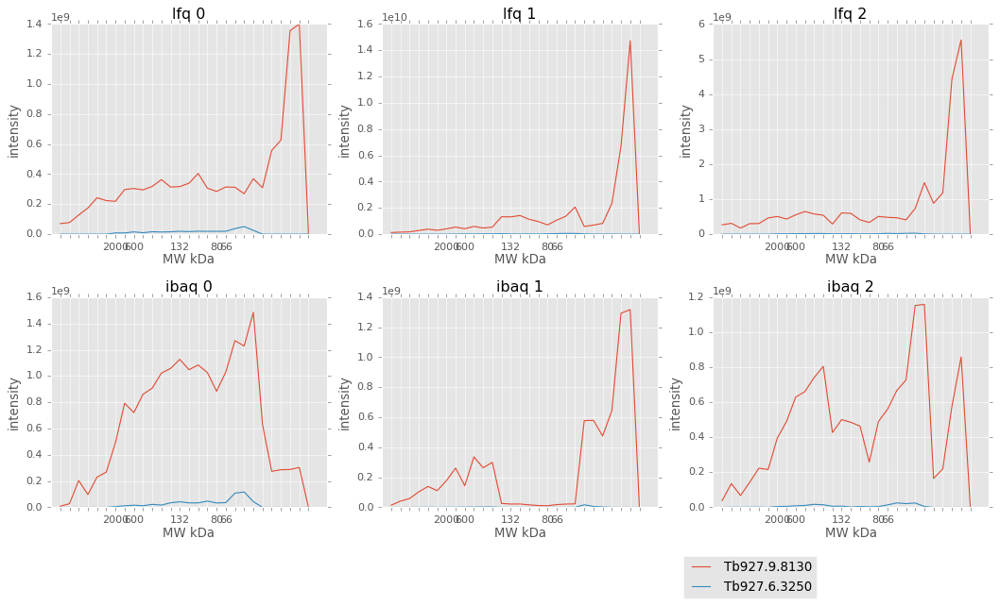

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.8130                  20               0   
Tb927.6.3250                  35               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.9.8130  nascent polypeptide associated complex subunit...  
Tb927.6.3250         C2H2 type zinc-finger (2 copies), putative  
26 4 38 ['Tb927.9.8130', 'Tb927.6.3250']


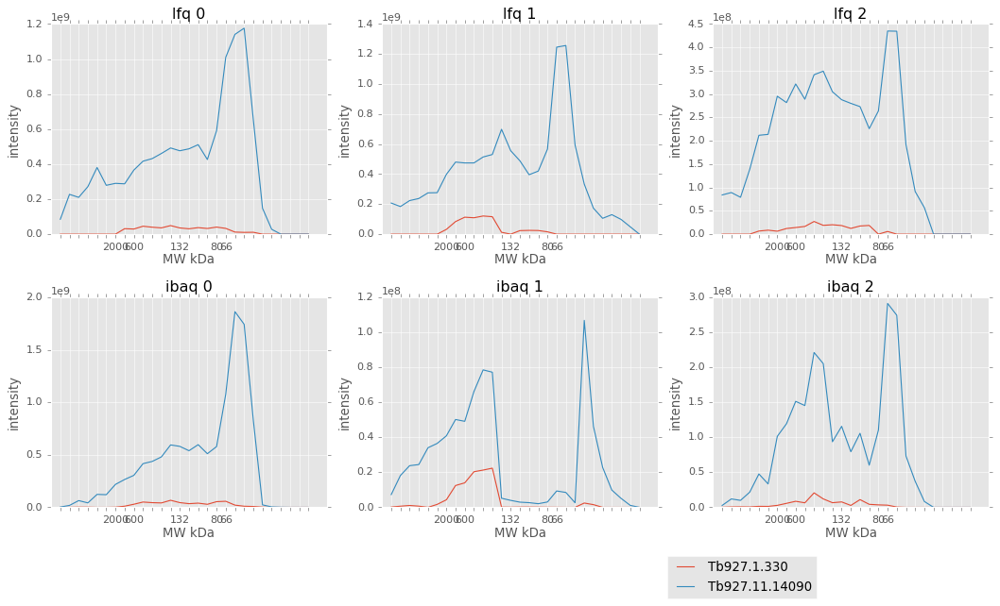

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.1.330                     30               0   
Tb927.11.14090                  51               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.1.330     retrotransposon hot spot protein (RHS, pseudog...  
Tb927.11.14090               Double RNA binding domain protein 18  
26 4 10 ['Tb927.1.330', 'Tb927.11.14090']


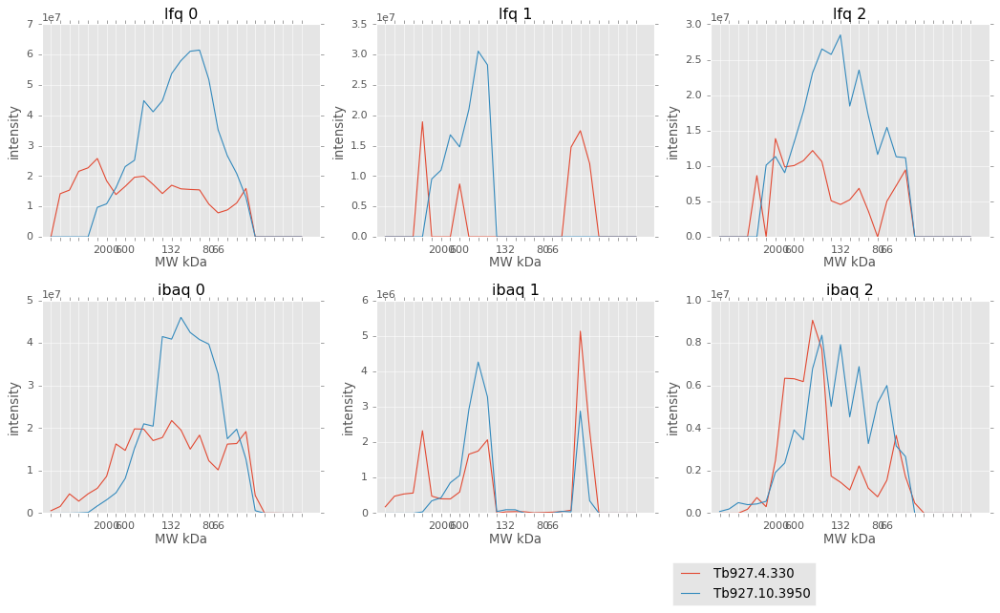

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.4.330                    43               0   
Tb927.10.3950                  53               0   

                         [Product Description]  
[Input ID]                                      
Tb927.4.330    hypothetical protein, conserved  
Tb927.10.3950  hypothetical protein, conserved  
26 11 35 ['Tb927.4.330', 'Tb927.10.3950']


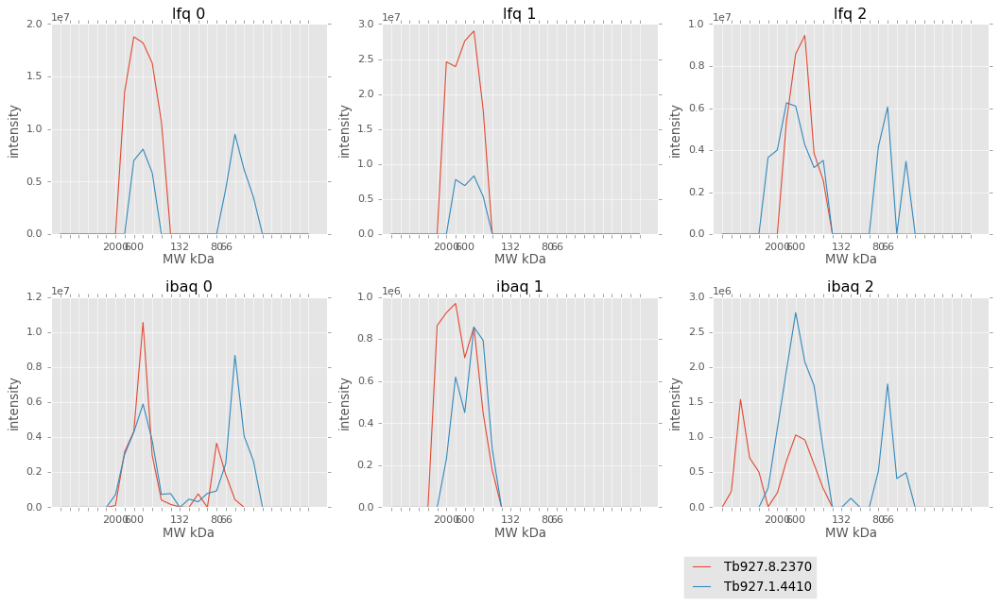

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.2370                 186               0   
Tb927.1.4410                  83               0   

                        [Product Description]  
[Input ID]                                     
Tb927.8.2370               dicer-like protein  
Tb927.1.4410  hypothetical protein, conserved  
58 16 67 ['Tb927.8.2370', 'Tb927.1.4410']


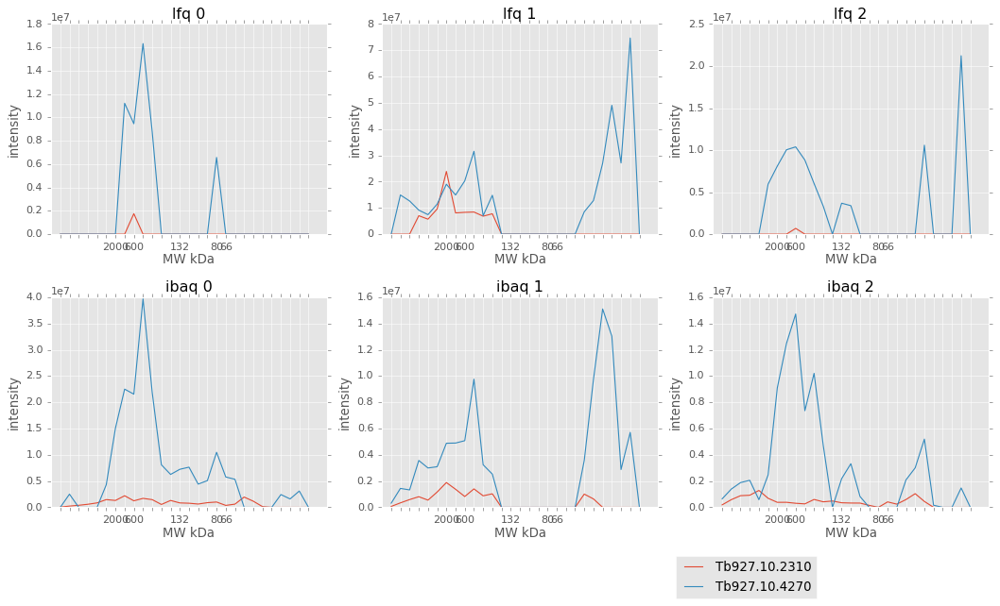

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.2310                  52               0   
Tb927.10.4270                  20               0   

                         [Product Description]  
[Input ID]                                      
Tb927.10.2310  hypothetical protein, conserved  
Tb927.10.4270  coatomer subunit zeta, putative  
58 43 58 ['Tb927.10.2310', 'Tb927.10.4270']


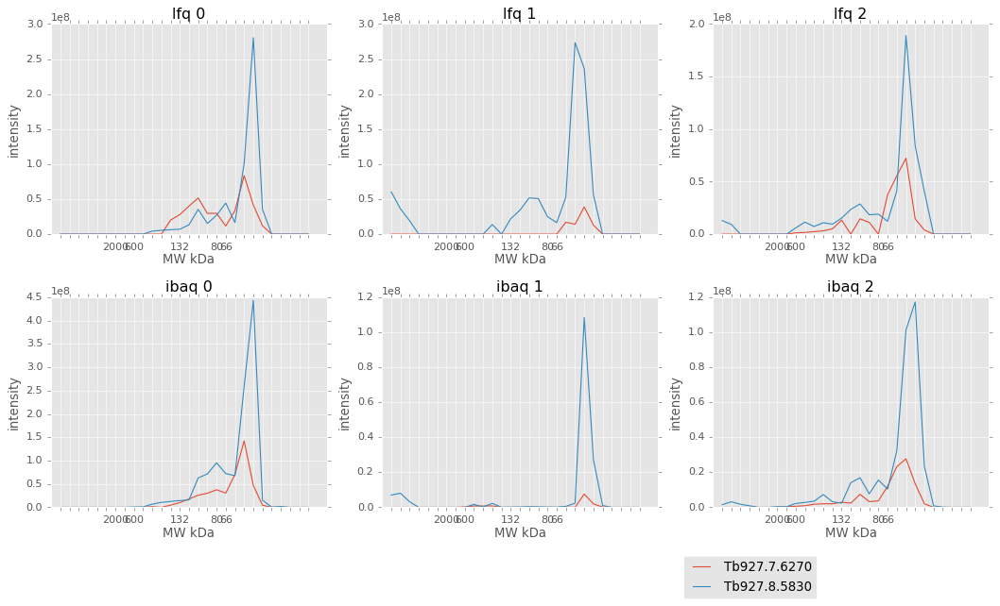

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.6270                  46               0   
Tb927.8.5830                  36               0   

                                         [Product Description]  
[Input ID]                                                      
Tb927.7.6270                             peptidase t, putative  
Tb927.8.5830  SMP-30/Gluconolaconase/LRE-like region, putative  
18 4 10 ['Tb927.7.6270', 'Tb927.8.5830']


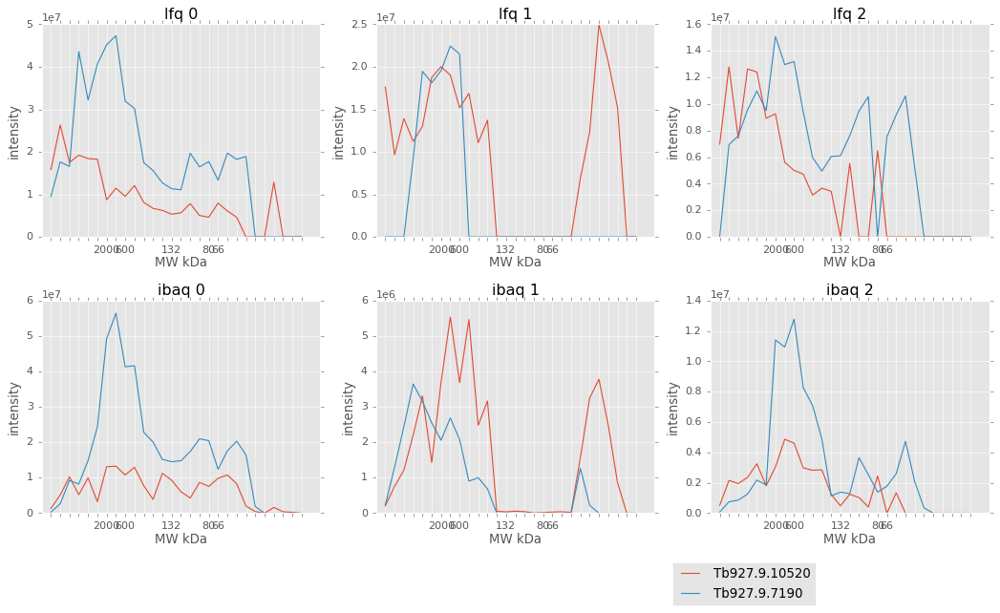

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.9.10520                  29               0   
Tb927.9.7190                   49               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.9.10520          hypothetical protein, conserved  
Tb927.9.7190   Trans-2-enoyl-ACP reductase 1, putative  
15 77 65 ['Tb927.9.10520', 'Tb927.9.7190']


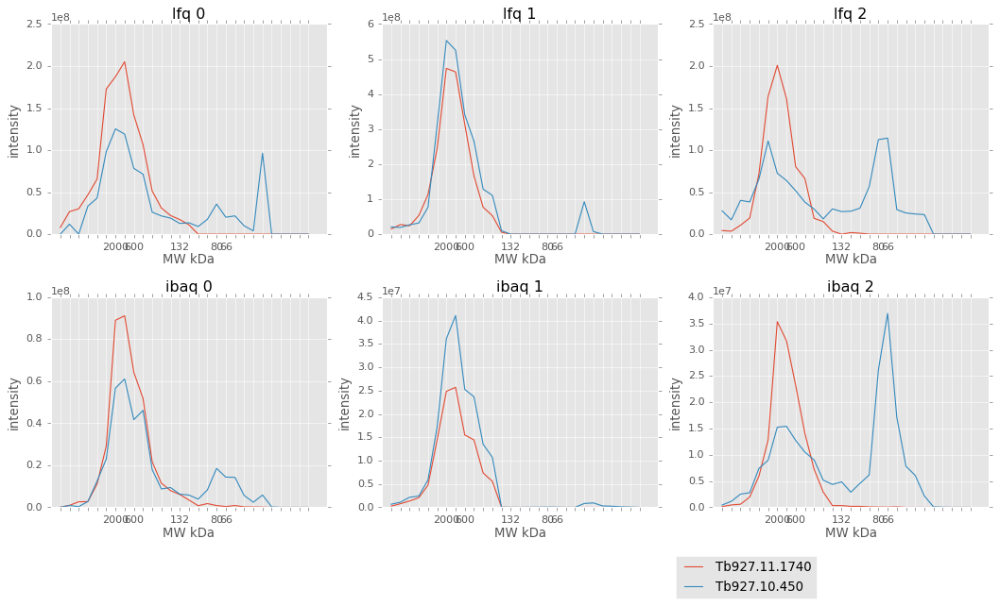

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.1740                  89               0   
Tb927.10.450                   71               0   

                             [Product Description]  
[Input ID]                                          
Tb927.11.1740  intraflagellar transport protein 88  
Tb927.10.450       Component of motile flagella 62  
65 54 60 ['Tb927.11.1740', 'Tb927.10.450']


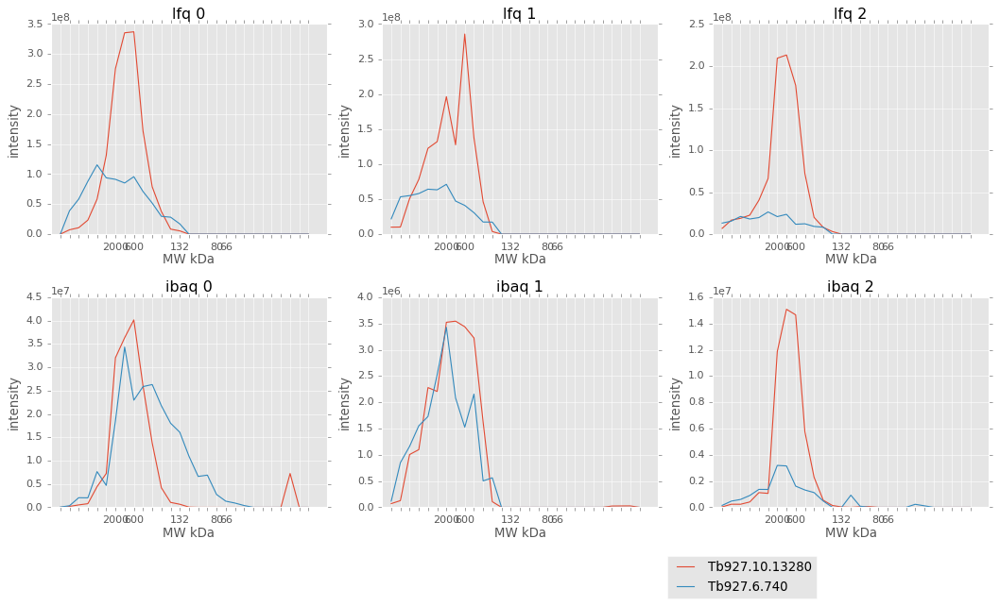

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.13280                 286               0   
Tb927.6.740                    139               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.10.13280                hypothetical protein, conserved  
Tb927.6.740     ATP-dependent DEAH-box RNA helicase, putative  
65 56 74 ['Tb927.10.13280', 'Tb927.6.740']


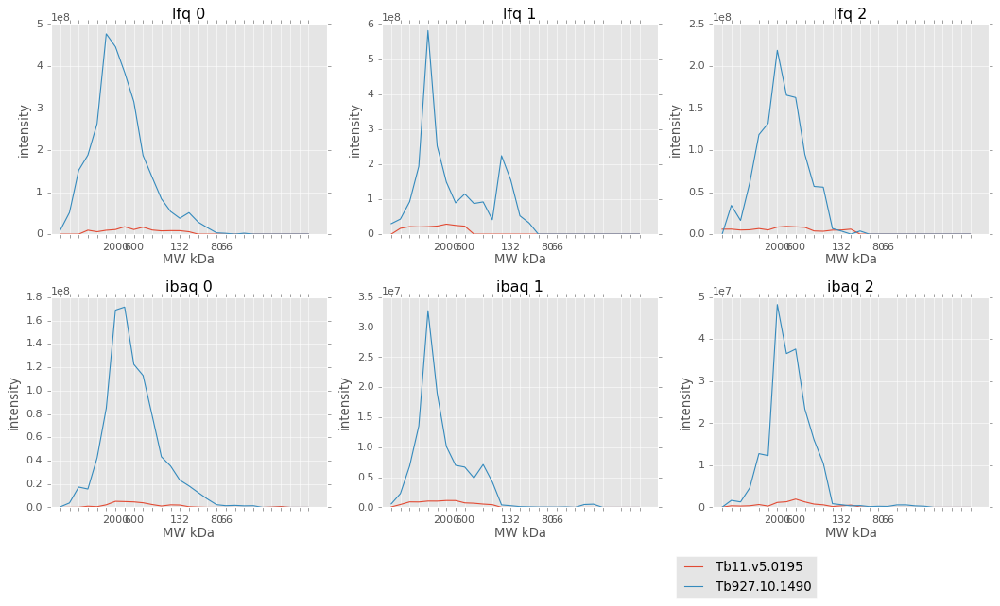

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb11.v5.0195                  115               0   
Tb927.10.1490                 134               0   

                                           [Product Description]  
[Input ID]                                                        
Tb11.v5.0195            STAG domain containing protein, putative  
Tb927.10.1490  Temperature dependent protein affecting M2 dsR...  
65 77 60 ['Tb11.v5.0195', 'Tb927.10.1490']


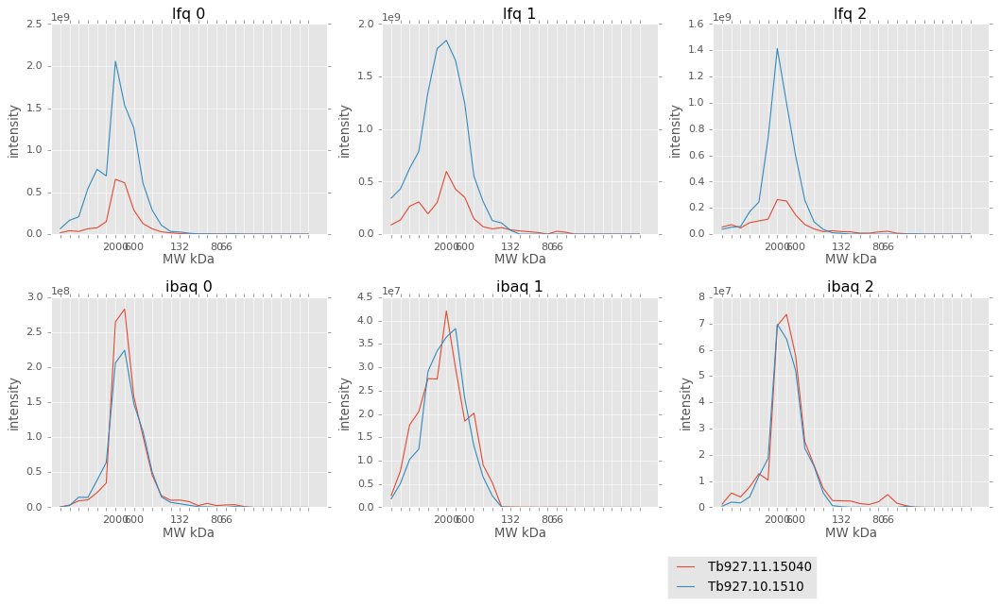

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.15040                  64               0   
Tb927.10.1510                  259               0   

                                   [Product Description]  
[Input ID]                                                
Tb927.11.15040           Chaperonin HSP60, mitochondrial  
Tb927.10.1510   CCR4-NOT transcription complex subunit 1  
65 81 60 ['Tb927.11.15040', 'Tb927.10.1510']


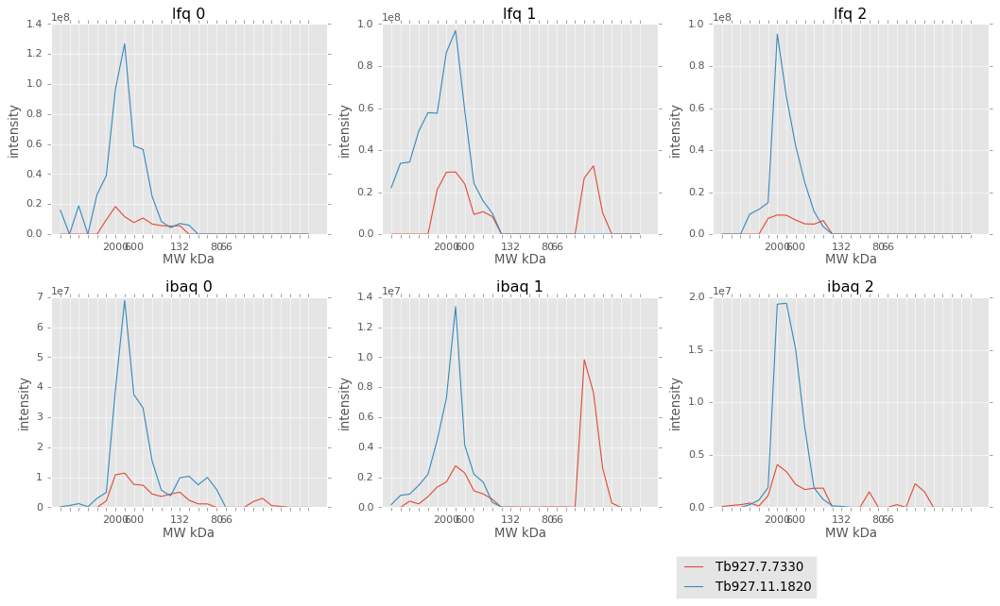

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.7330                   47               0   
Tb927.11.1820                  68               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.7.7330   NADH dehydrogenase (ubiquinone) 1 alpha subcom...  
Tb927.11.1820  translation initiation factor eIF2B delta subu...  
55 54 74 ['Tb927.7.7330', 'Tb927.11.1820']


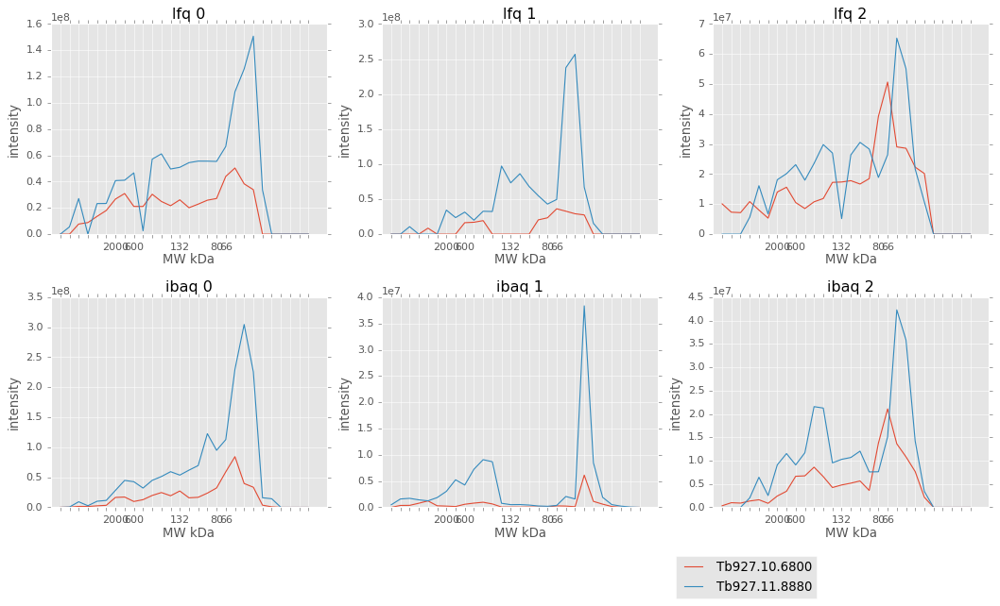

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.6800                  41               0   
Tb927.11.8880                  40               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.6800  developmentally regulated GTP-binding protein,...  
Tb927.11.8880  tRNA threonylcarbamoyl adenosine modification ...  
55 1 3 ['Tb927.10.6800', 'Tb927.11.8880']


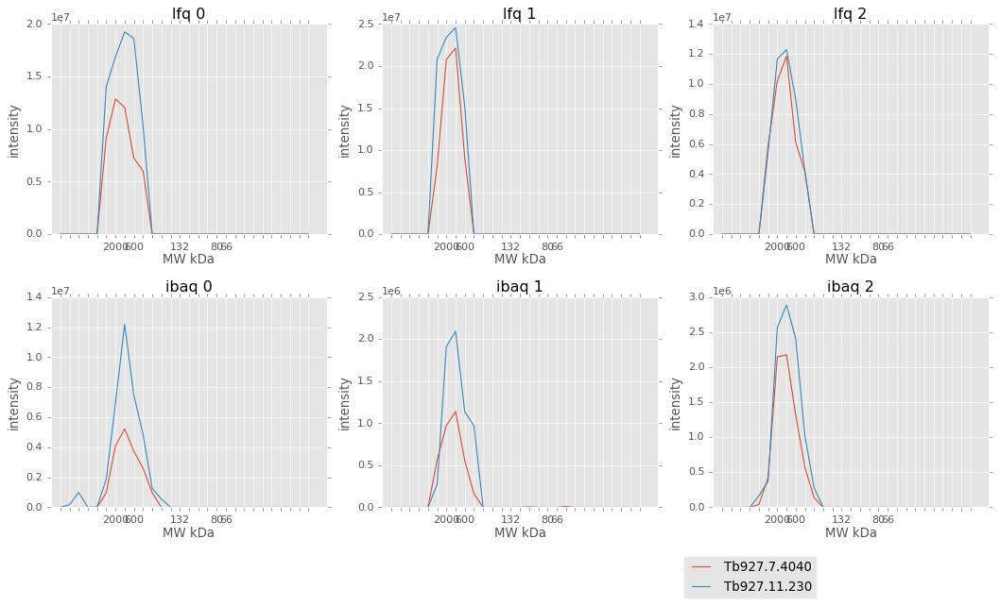

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.4040                  92               0   
Tb927.11.230                  90               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.7.4040                    hypothetical protein, conserved  
Tb927.11.230  cleavage and polyadenylation specificity facto...  
55 40 74 ['Tb927.7.4040', 'Tb927.11.230']


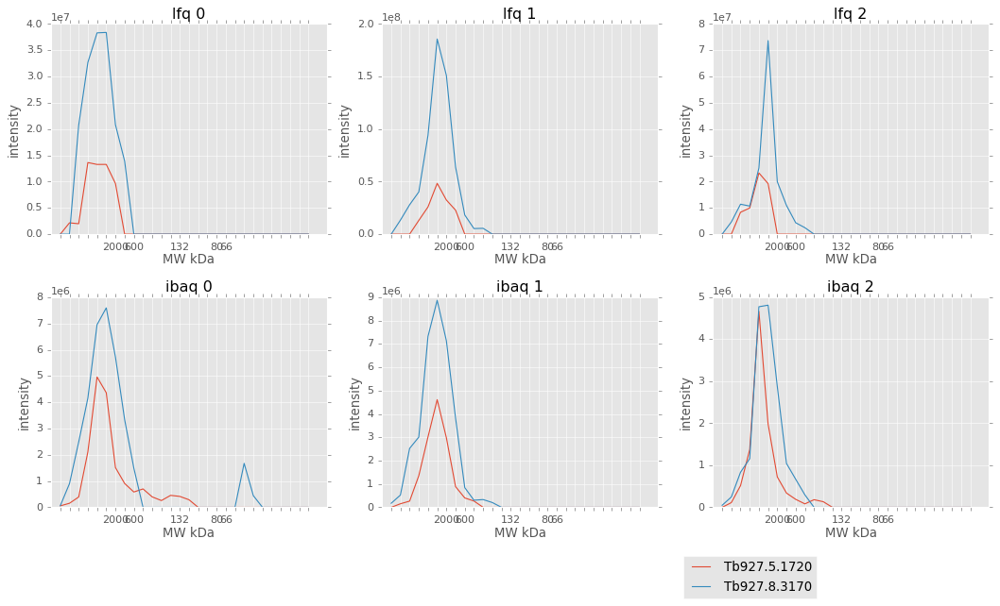

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.1720                  69               0   
Tb927.8.3170                  90               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.1720                    hypothetical protein, conserved  
Tb927.8.3170  kinetoplast ribosomal PPR-repeat containing pr...  
84 76 44 ['Tb927.5.1720', 'Tb927.8.3170']


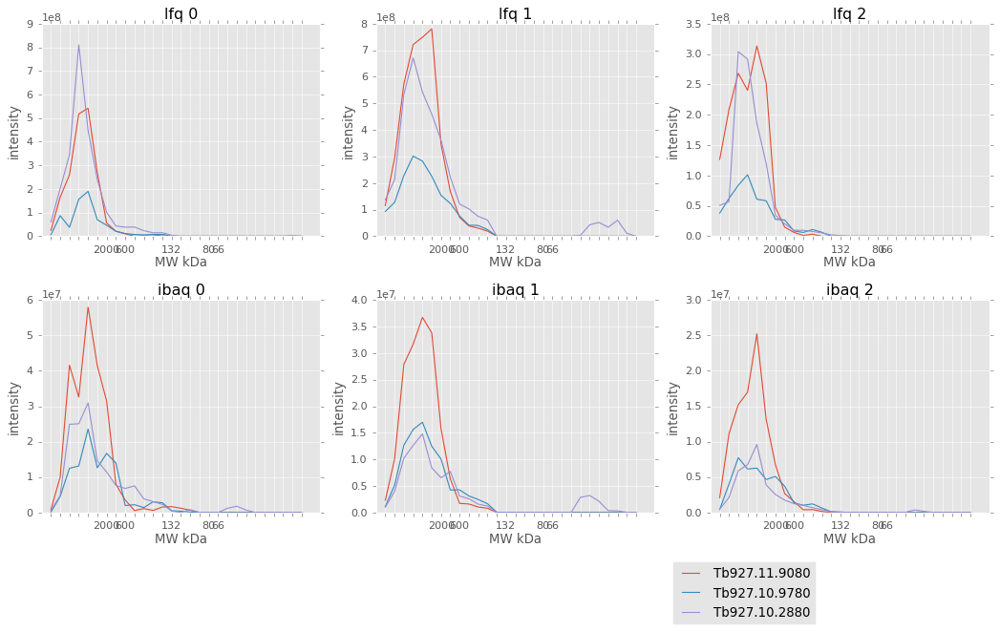

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.9080                 136               0   
Tb927.10.9780                  97               0   
Tb927.10.2880                 303              22   

                                           [Product Description]  
[Input ID]                                                        
Tb927.11.9080                              Nucleolar protein 136  
Tb927.10.9780        ATP-dependent DEAD/H RNA helicase, putative  
Tb927.10.2880  Voltage-dependent calcium channel subunit, put...  
84 82 49 ['Tb927.11.9080', 'Tb927.10.9780', 'Tb927.10.2880']


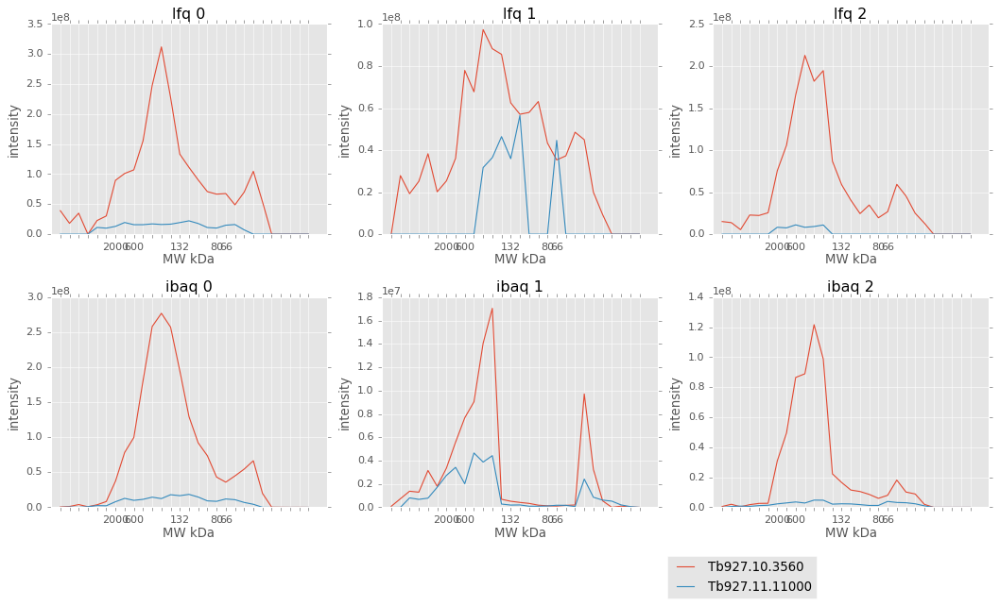

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.3560                   42               0   
Tb927.11.11000                  54               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.3560              arginine N-methyltransferase, putative  
Tb927.11.11000  Calponin homology (CH) domain containing prote...  
46 35 68 ['Tb927.10.3560', 'Tb927.11.11000']


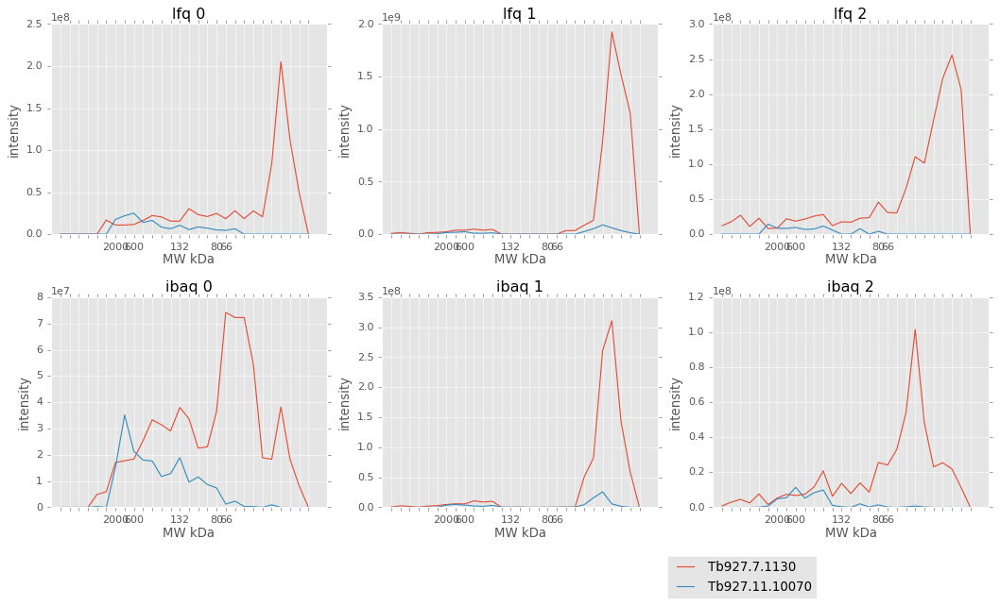

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.1130                    18               0   
Tb927.11.10070                  25               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.7.1130    trypanothione/tryparedoxin dependent peroxidase 2  
Tb927.11.10070                              Bromodomain, putative  
46 16 15 ['Tb927.7.1130', 'Tb927.11.10070']


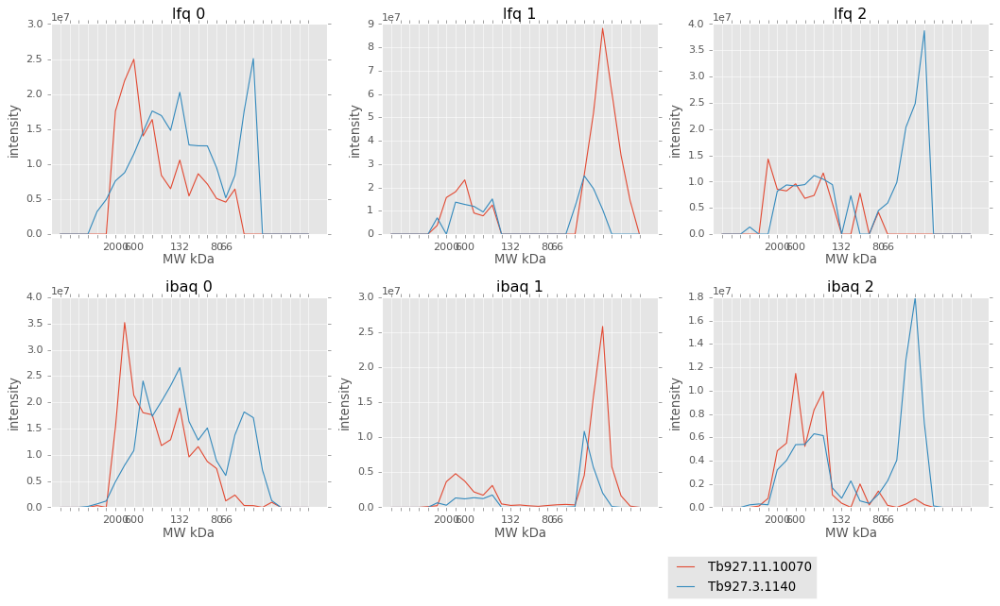

                [Molecular Weight]  [# TM Domains]  [Product Description]
[Input ID]                                                               
Tb927.11.10070                  25               0  Bromodomain, putative
Tb927.3.1140                    43               0  Surp module, putative
46 16 67 ['Tb927.11.10070', 'Tb927.3.1140']


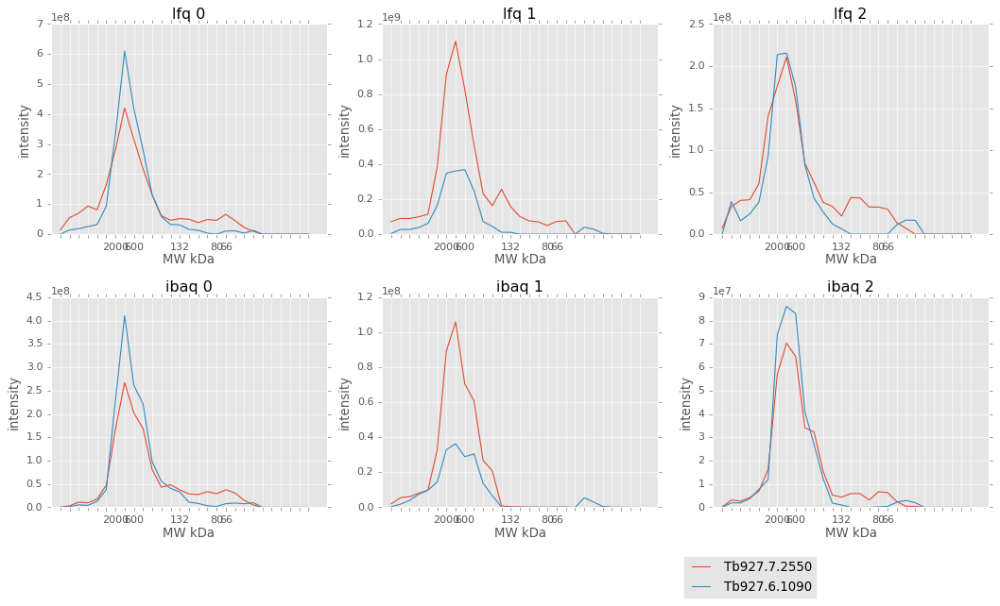

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.2550                  49               0   
Tb927.6.1090                  44               0   

                               [Product Description]  
[Input ID]                                            
Tb927.7.2550  proteasome regulatory ATPase subunit 5  
Tb927.6.1090  proteasome regulatory ATPase subunit 3  
68 54 60 ['Tb927.7.2550', 'Tb927.6.1090']


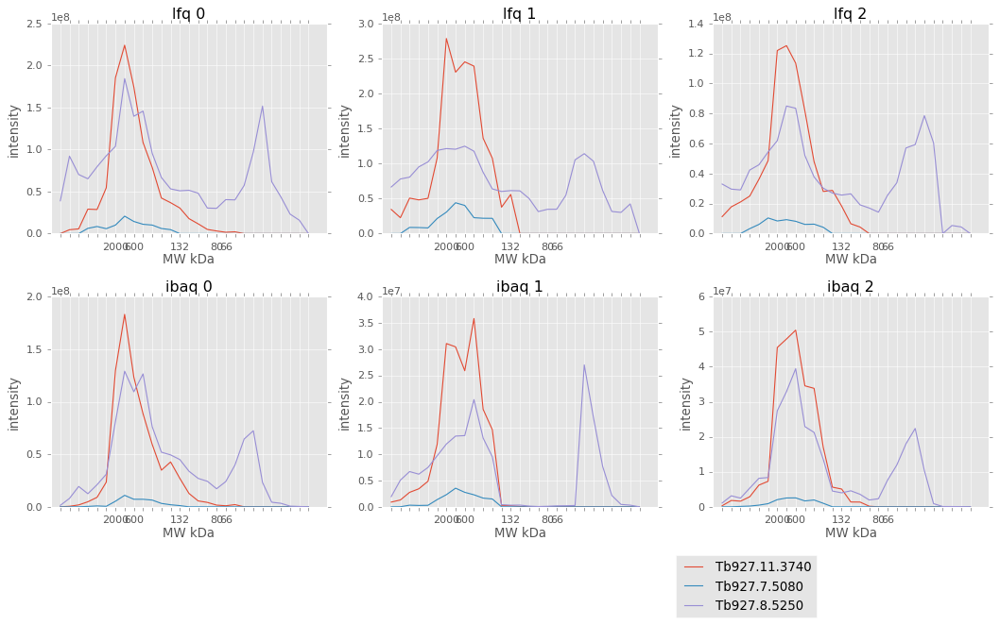

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.3740                  48               0   
Tb927.7.5080                   79               0   
Tb927.8.5250                   57               0   

                                [Product Description]  
[Input ID]                                             
Tb927.11.3740  proteasome regulatory ATPase subunit 2  
Tb927.7.5080              ATP-NAD kinase-like protein  
Tb927.8.5250             delta-coat protein, putative  
68 47 58 ['Tb927.11.3740', 'Tb927.7.5080', 'Tb927.8.5250']


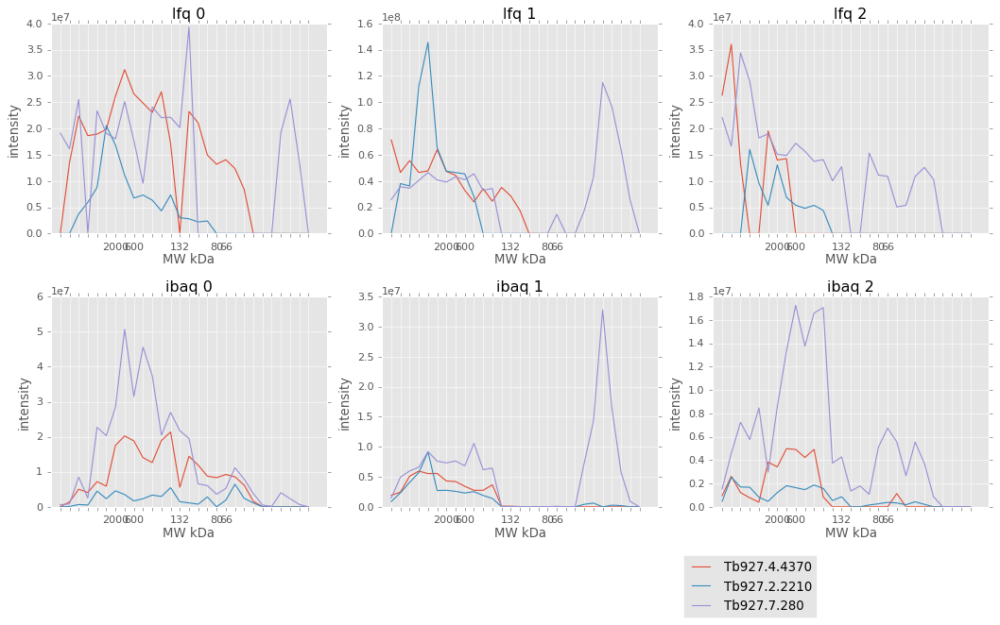

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.4370                  63               0   
Tb927.4.4370                  67               0   
Tb927.2.2210                 113               1   
Tb927.7.280                   24               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.4.4370                    hypothetical protein, conserved  
Tb927.4.4370                    hypothetical protein, conserved  
Tb927.2.2210                    hypothetical protein, conserved  
Tb927.7.280   cyclophilin-type peptidyl-prolyl cis-trans iso...  
68 77 58 ['Tb927.4.4370', 'Tb927.2.2210', 'Tb927.7.280']


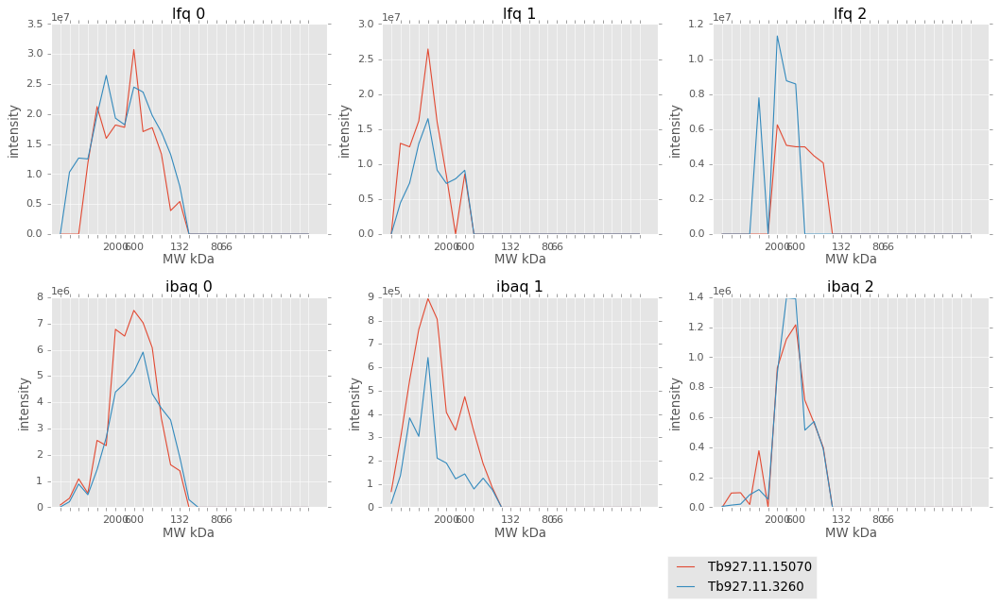

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.15070                 119               0   
Tb927.11.3260                  182               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.15070                                 Basal body protein  
Tb927.11.3260   mitochondrial DNA polymerase I protein D, puta...  
68 77 79 ['Tb927.11.15070', 'Tb927.11.3260']


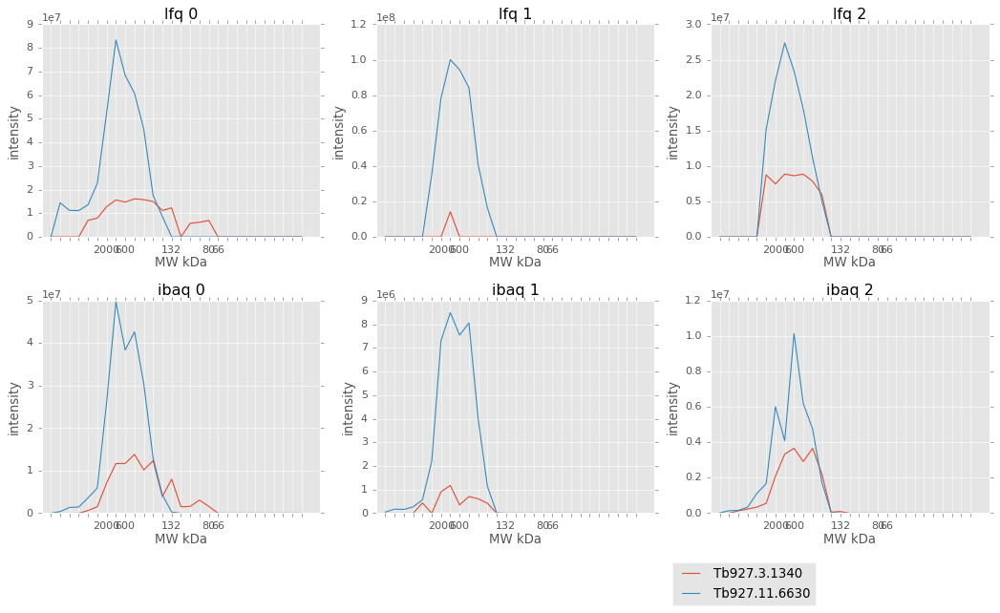

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.1340                   66               0   
Tb927.11.6630                  66               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.3.1340              Nuclear cap-binding protein subunit 66  
Tb927.11.6630  3-methylcrotonoyl-CoA carboxylase beta subunit...  
68 16 65 ['Tb927.3.1340', 'Tb927.11.6630']


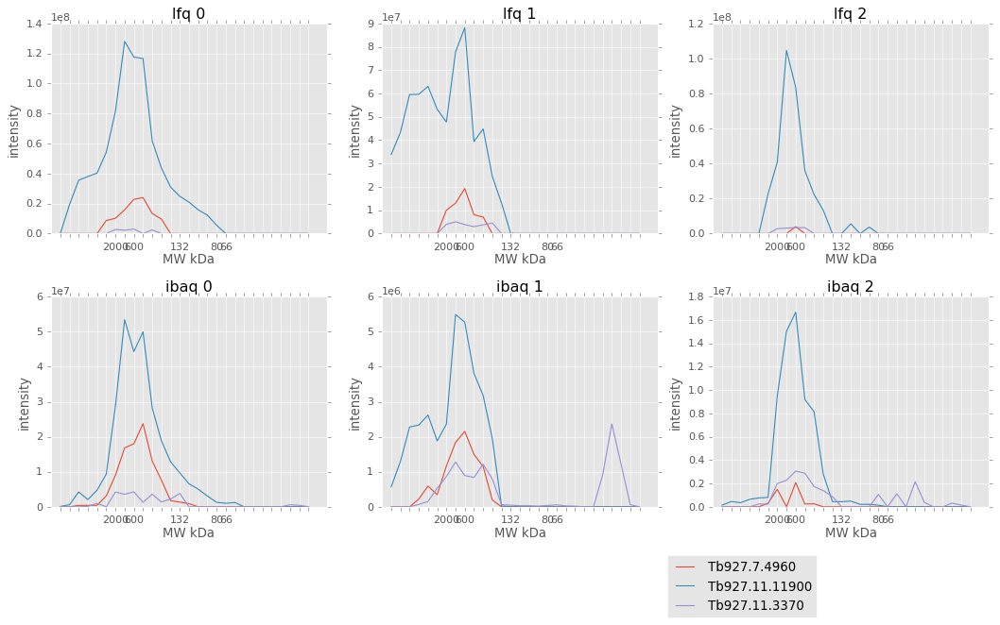

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.4960                    50               0   
Tb927.11.11900                  97               0   
Tb927.11.3370                   21               0   

                          [Product Description]  
[Input ID]                                       
Tb927.7.4960    hypothetical protein, conserved  
Tb927.11.11900           Coatomer subunit gamma  
Tb927.11.3370              hypothetical protein  
68 16 79 ['Tb927.7.4960', 'Tb927.11.11900', 'Tb927.11.3370']


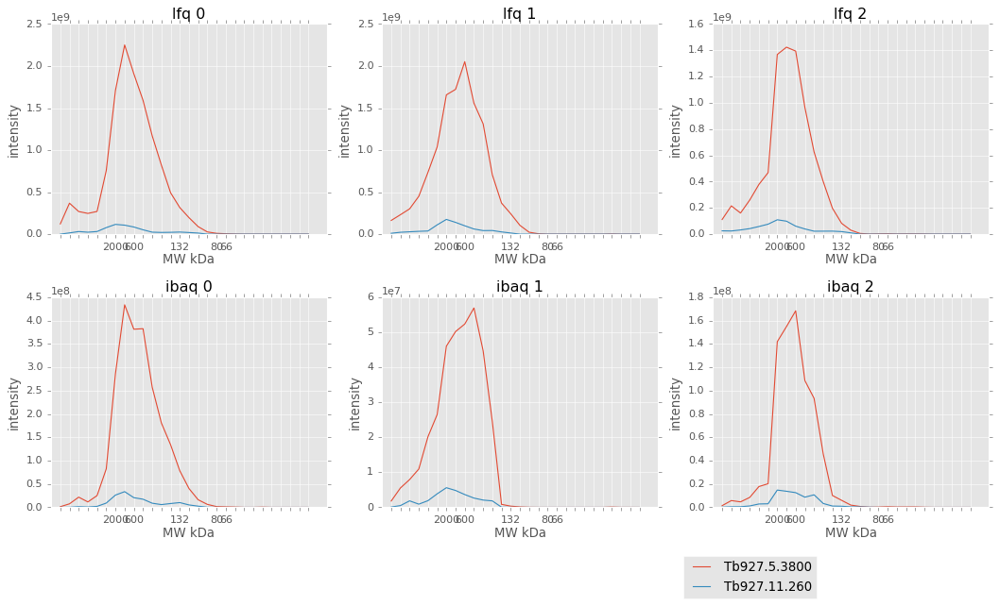

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.3800                 204               0   
Tb927.11.260                 149               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.5.3800  glutamine hydrolysing (not ammonia-dependent) ...  
Tb927.11.260       Putative intraflagellar transport protein F6  
68 43 58 ['Tb927.5.3800', 'Tb927.11.260']


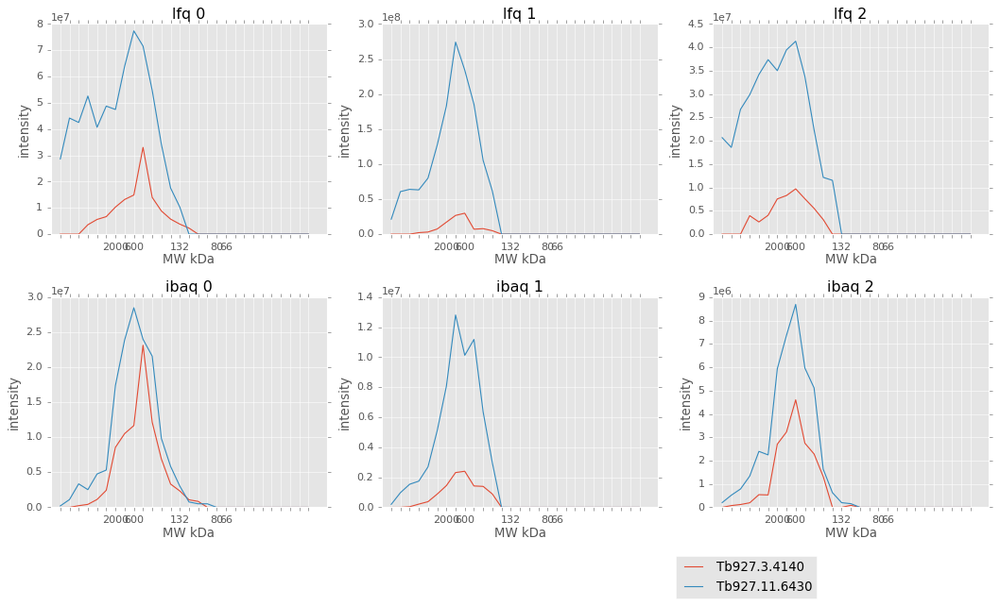

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.3.4140                   61               0   
Tb927.11.6430                 134               0   

                         [Product Description]  
[Input ID]                                      
Tb927.3.4140   hypothetical protein, conserved  
Tb927.11.6430  hypothetical protein, conserved  
68 43 60 ['Tb927.3.4140', 'Tb927.11.6430']


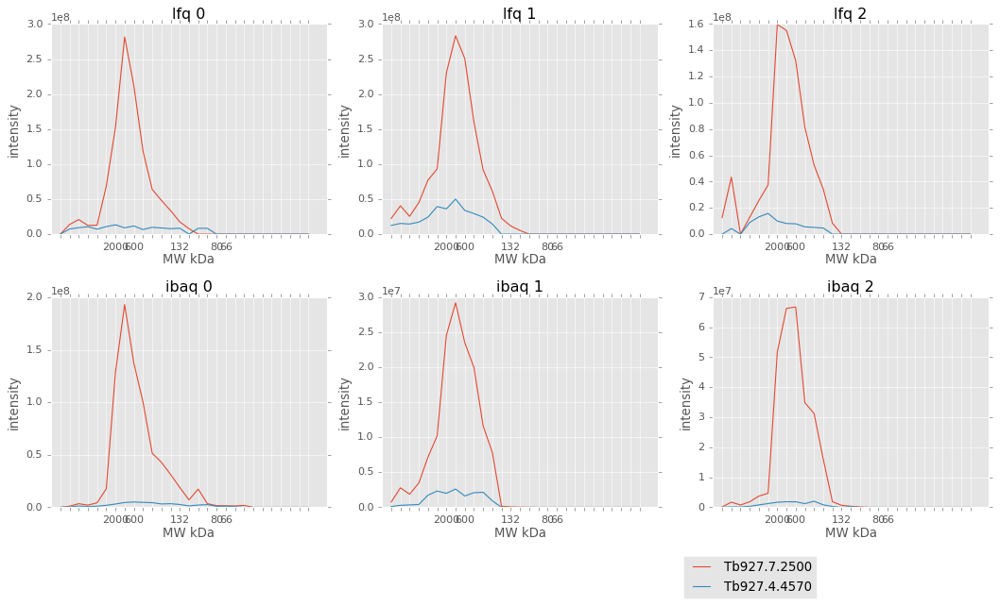

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.2500                  48               0   
Tb927.4.4570                  98               0   

                               [Product Description]  
[Input ID]                                            
Tb927.7.2500  proteasome regulatory ATPase subunit 1  
Tb927.4.4570         hypothetical protein, conserved  
68 44 58 ['Tb927.7.2500', 'Tb927.4.4570']


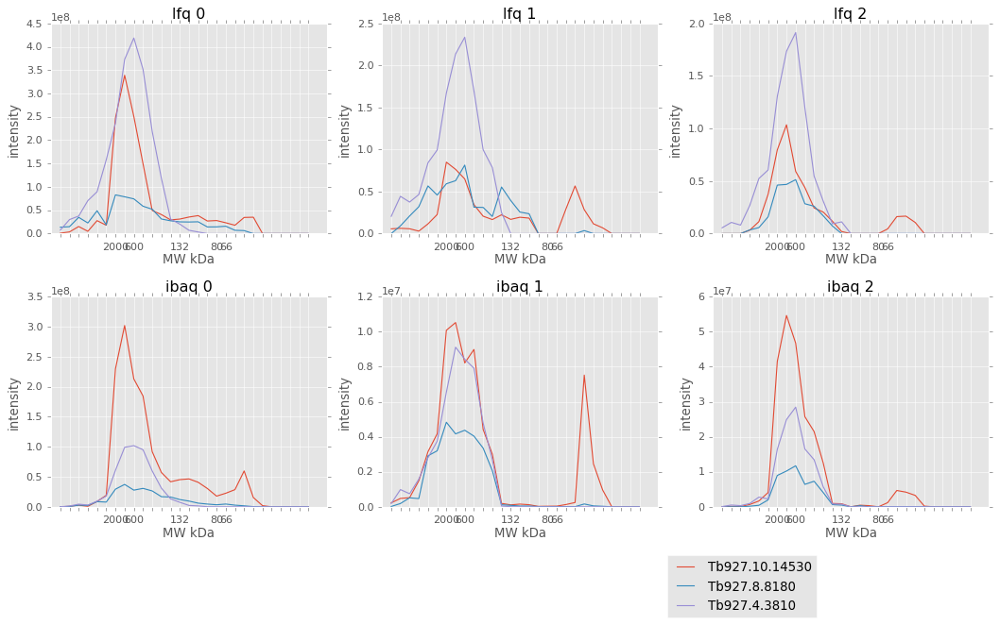

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.14530                  42               0   
Tb927.8.8180                   103               0   
Tb927.4.3810                   134               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.10.14530                19S proteasome non-atpase subunit 8  
Tb927.8.8180          mitochondrial RNA binding complex 1 subunit  
Tb927.4.3810    DNA-directed RNA polymerase II subunit 2, puta...  
68 44 65 ['Tb927.10.14530', 'Tb927.8.8180', 'Tb927.4.3810']


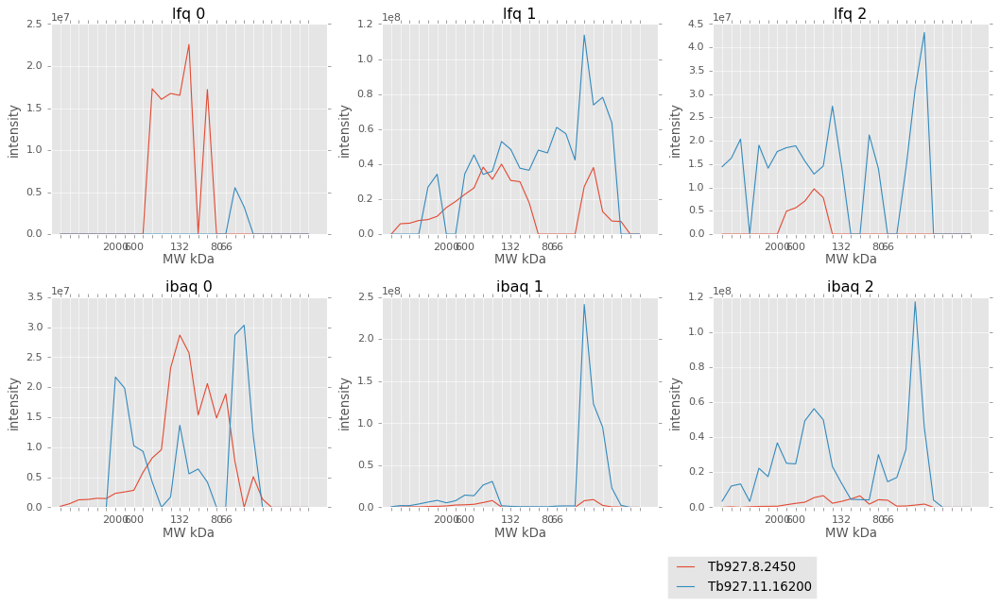

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.8.2450                    34               0   
Tb927.11.16200                  14               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.8.2450    5'-AMP-activated protein kinase subunit beta  
Tb927.11.16200            cytoskeleton-associated protein 17  
7 15 30 ['Tb927.8.2450', 'Tb927.11.16200']


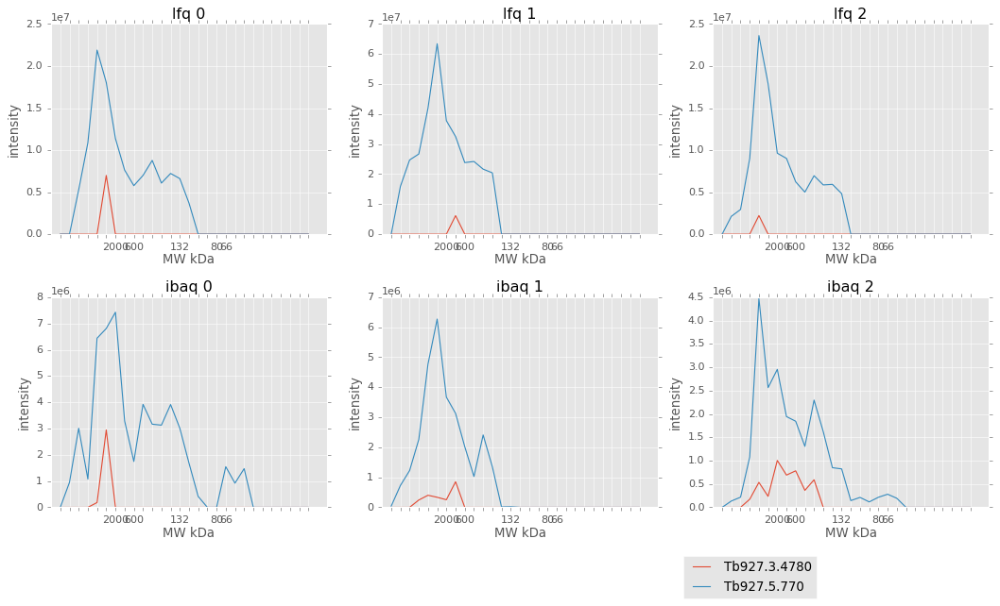

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.4780                  45               0   
Tb927.5.770                   76               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.3.4780  NAD-dependent glycerol-3-phosphate dehydrogena...  
Tb927.5.770                     hypothetical protein, conserved  
79 76 91 ['Tb927.3.4780', 'Tb927.5.770']


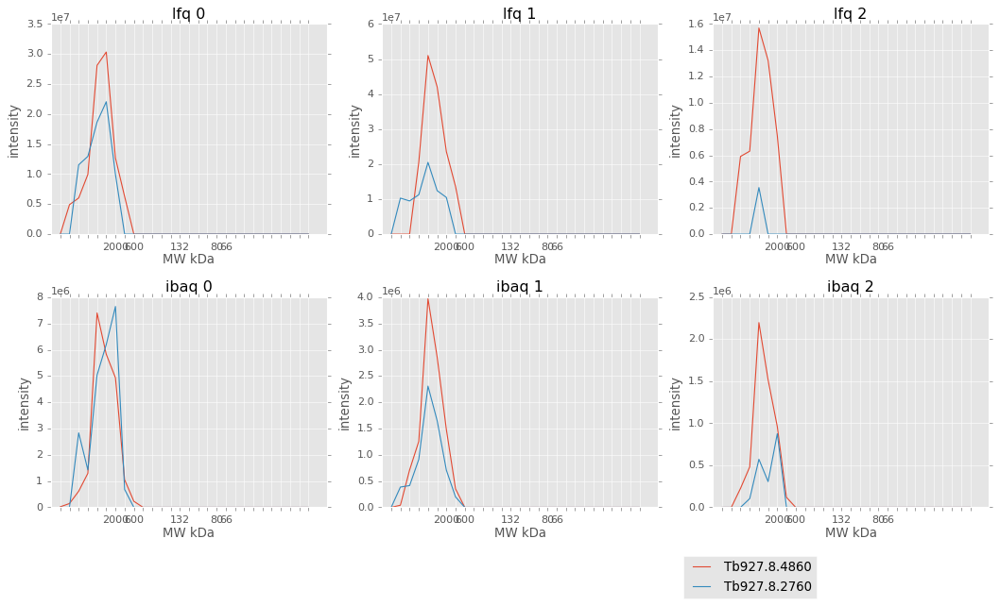

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.4860                  76               0   
Tb927.8.2760                  52               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.8.4860  kinetoplast ribosomal PPR-repeat containing pr...  
Tb927.8.2760              50S ribosome-binding GTPase, putative  
79 78 42 ['Tb927.8.4860', 'Tb927.8.2760']


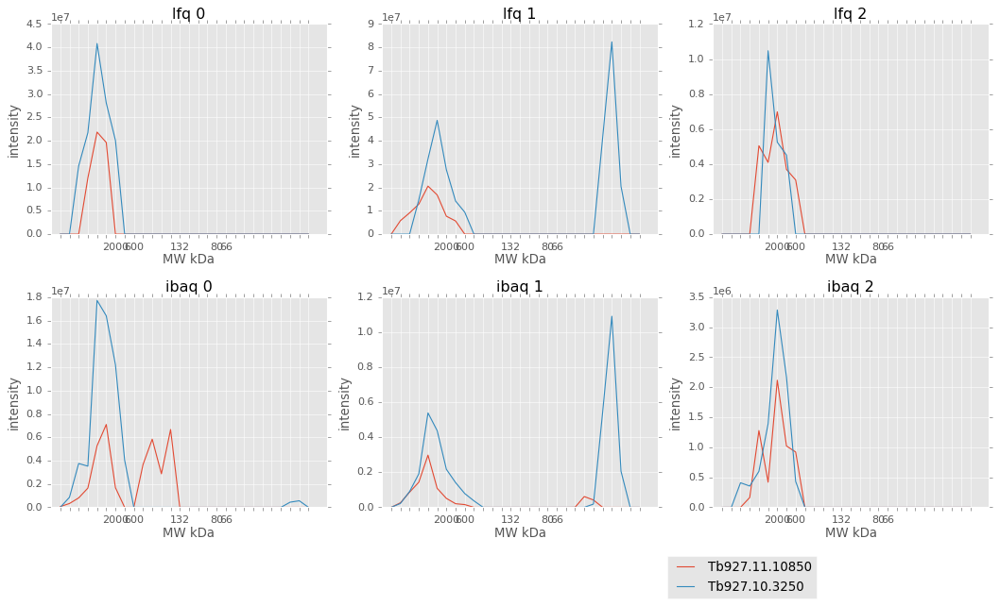

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.10850                  47               0   
Tb927.10.3250                   35               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.11.10850                hypothetical protein, conserved  
Tb927.10.3250   Mitochondrial SSU ribosomal protein, putative  
79 78 82 ['Tb927.11.10850', 'Tb927.10.3250']


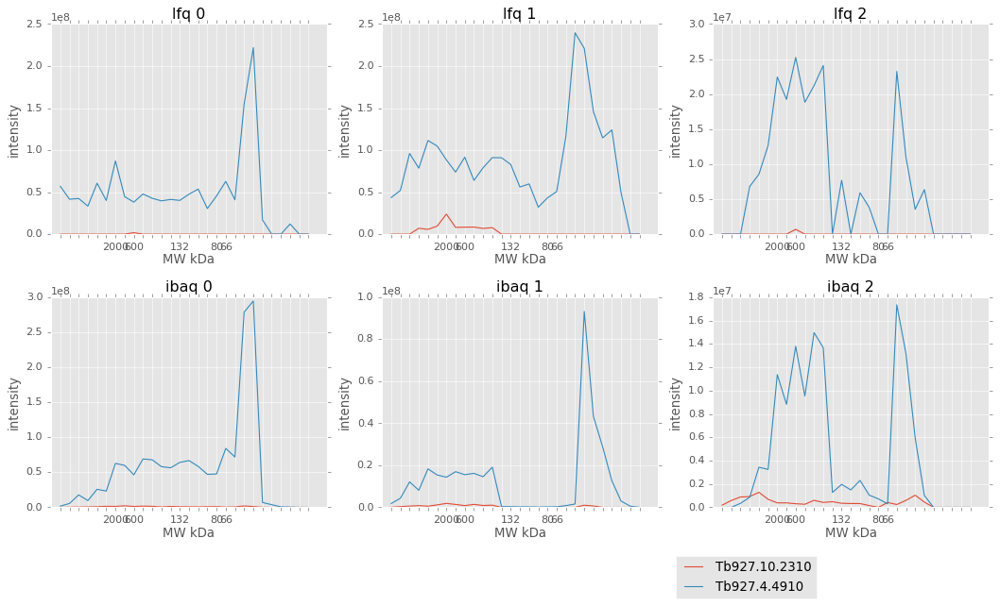

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.2310                  52               0   
Tb927.4.4910                   53               2   
Tb927.4.4910                   45               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.2310                    hypothetical protein, conserved  
Tb927.4.4910   3,2-trans-enoyl-CoA isomerase, mitochondrial p...  
Tb927.4.4910   3,2-trans-enoyl-CoA isomerase, mitochondrial p...  
79 43 58 ['Tb927.10.2310', 'Tb927.4.4910']


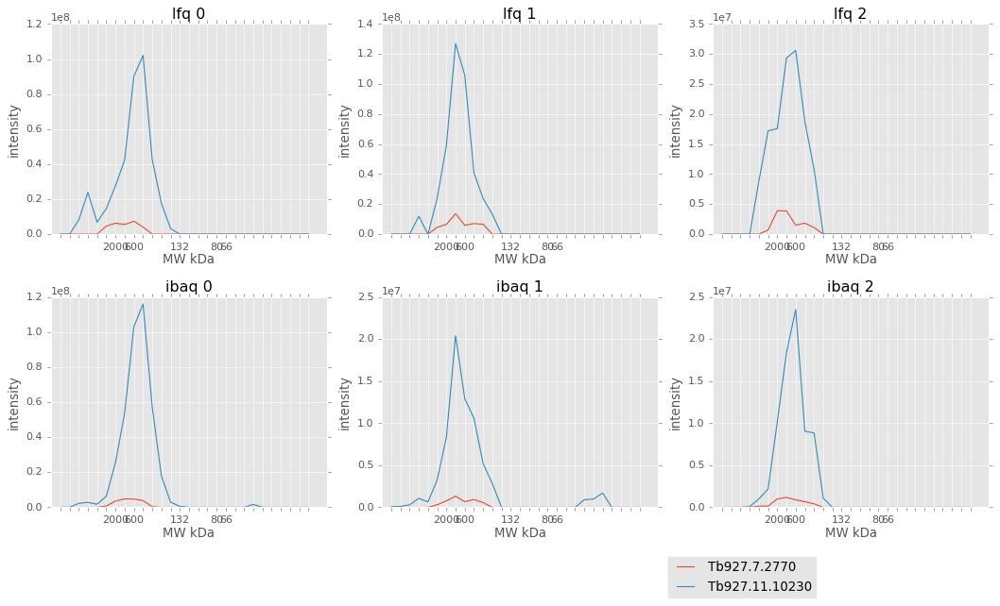

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.7.2770                    44               0   
Tb927.11.10230                  40               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.7.2770                      hypothetical protein, conserved  
Tb927.11.10230  RNA polymerase-associated protein CDC73, putative  
66 17 75 ['Tb927.7.2770', 'Tb927.11.10230']


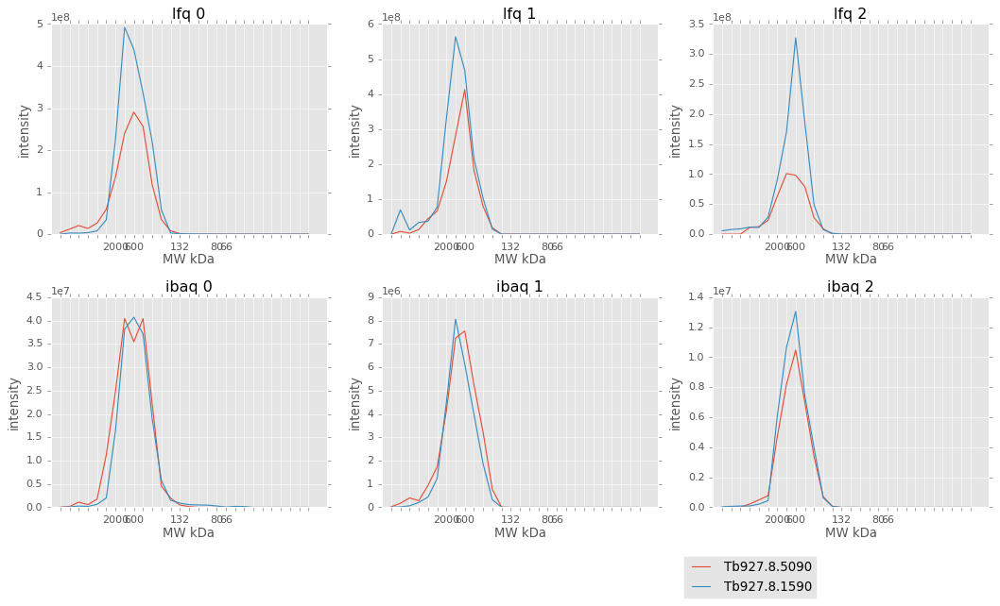

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.5090                 195               0   
Tb927.8.1590                 470               0   

                                      [Product Description]  
[Input ID]                                                   
Tb927.8.5090  DNA-directed RNA polymerase I largest subunit  
Tb927.8.1590             ubiquitin-protein ligase, putative  
66 17 79 ['Tb927.8.5090', 'Tb927.8.1590']


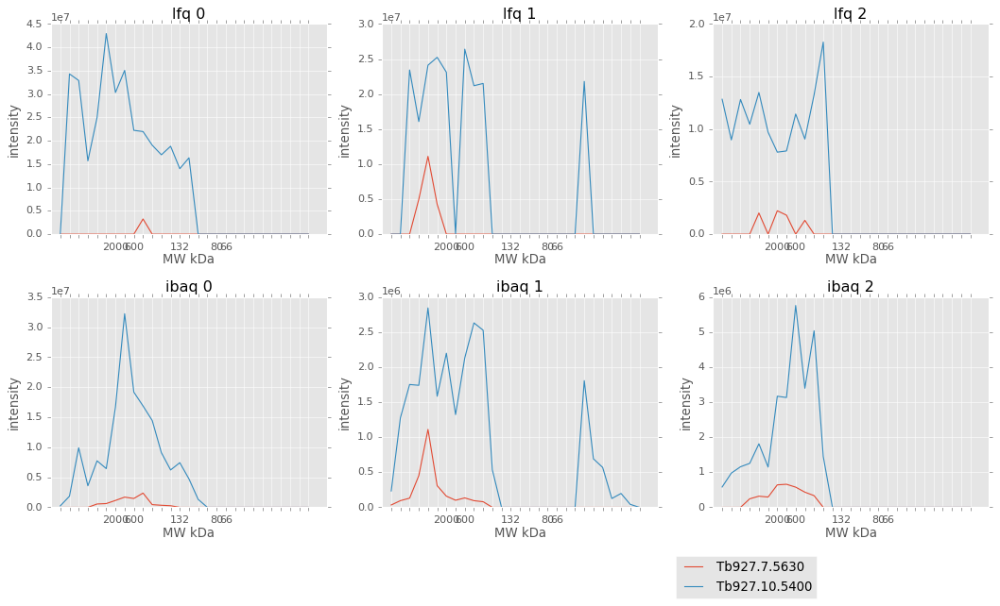

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.7.5630                   73               0   
Tb927.10.5400                  63               3   

                         [Product Description]  
[Input ID]                                      
Tb927.7.5630   hypothetical protein, conserved  
Tb927.10.5400  hypothetical protein, conserved  
66 77 60 ['Tb927.7.5630', 'Tb927.10.5400']


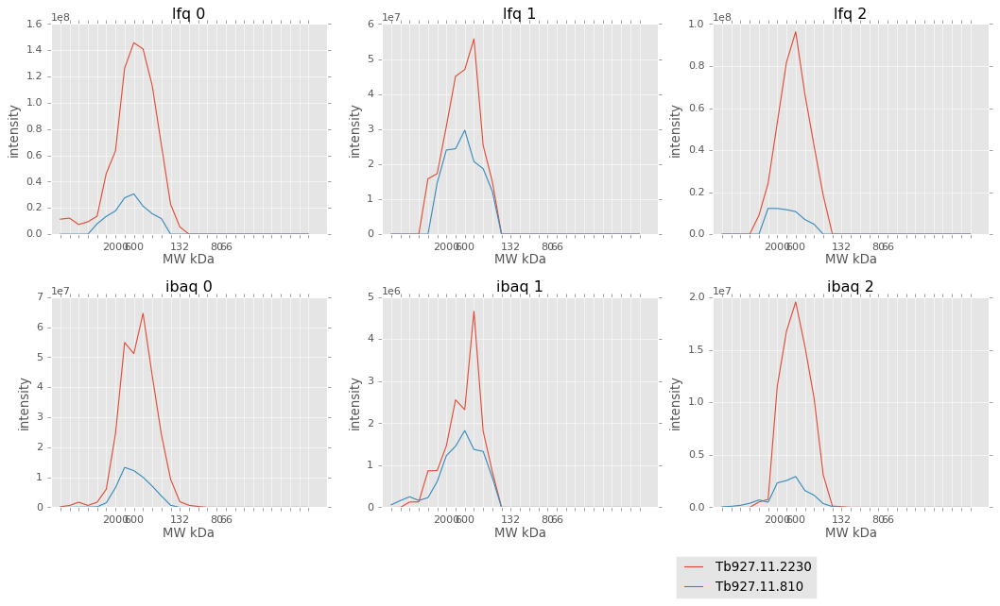

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.2230                  82               0   
Tb927.11.810                   86               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.11.2230  carnitine O-acetyltransferase, putative  
Tb927.11.810           hypothetical protein, conserved  
66 16 65 ['Tb927.11.2230', 'Tb927.11.810']


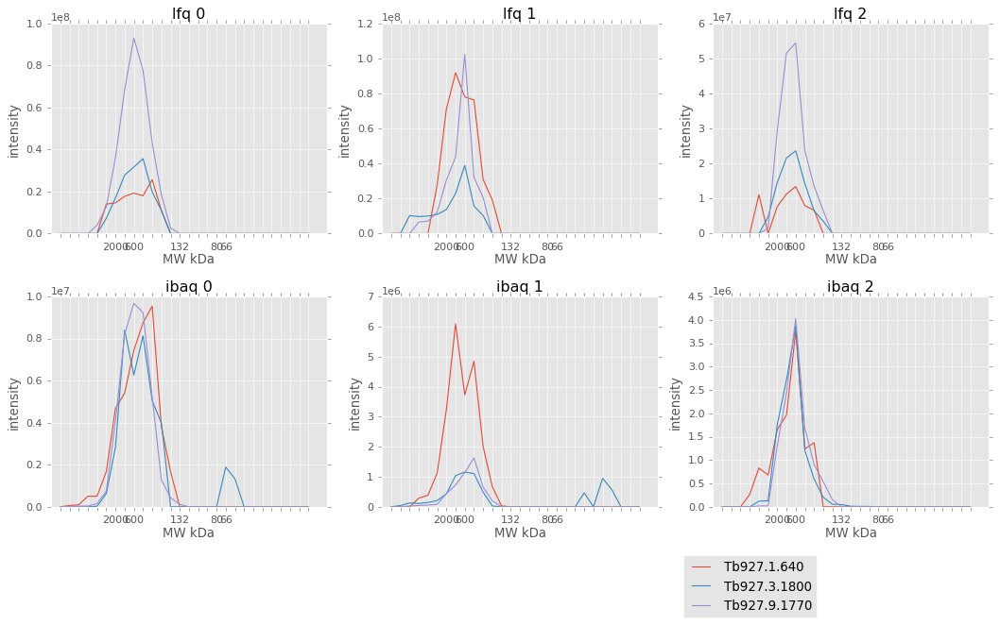

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.1.640                  176               0   
Tb927.3.1800                 161               0   
Tb927.9.1770                 329               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.1.640                                               BRCA2  
Tb927.3.1800                    hypothetical protein, conserved  
Tb927.9.1770  Zn-finger in Ran binding protein and others/SP...  
66 18 79 ['Tb927.1.640', 'Tb927.3.1800', 'Tb927.9.1770']


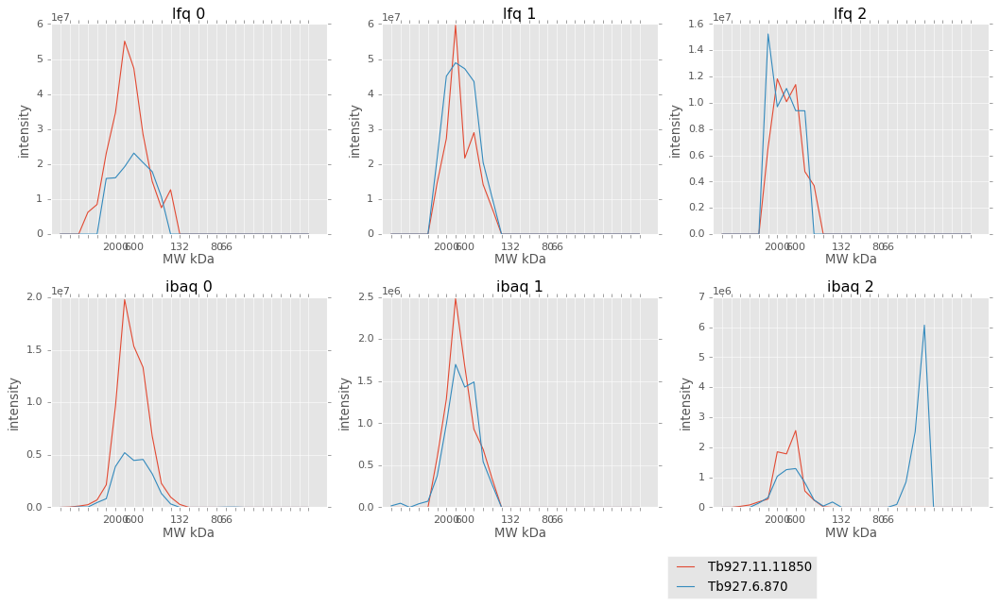

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.11850                 122               0   
Tb927.6.870                    194               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.11.11850  splicing factor 3B subunit 1, putative  
Tb927.6.870                     myotubularin, putative  
66 18 74 ['Tb927.11.11850', 'Tb927.6.870']


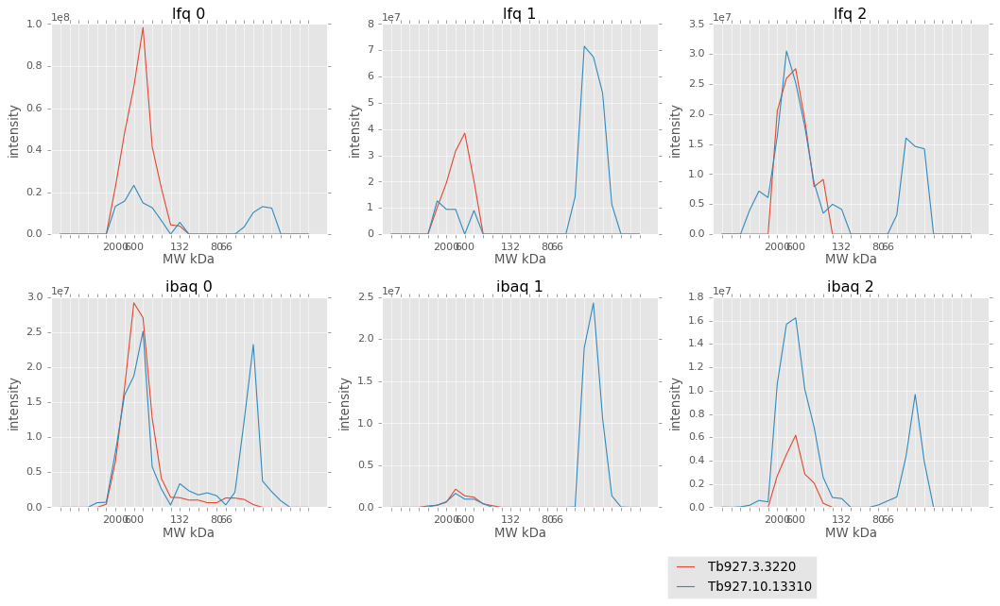

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.3.3220                   101               0   
Tb927.10.13310                  33               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.3.3220     RNA polymerase-associated protein CTR9, putative  
Tb927.10.13310  DNA-directed RNA polymerase I subunit RPB5z, p...  
66 40 79 ['Tb927.3.3220', 'Tb927.10.13310']


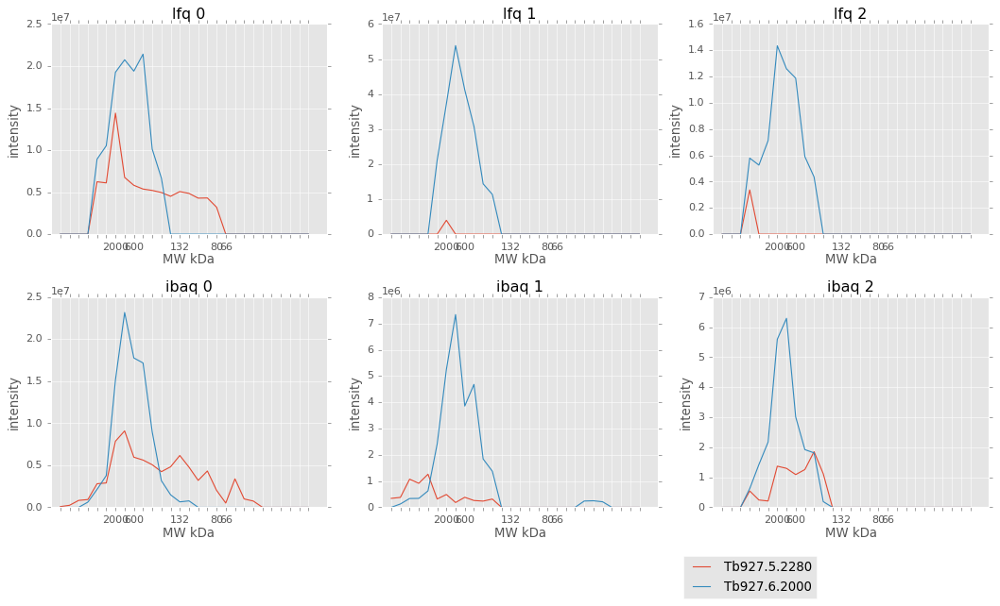

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.2280                  49               4   
Tb927.6.2000                  50               0   

                                 [Product Description]  
[Input ID]                                              
Tb927.5.2280               acetyltransferase, putative  
Tb927.6.2000  spliceosome-associated protein, putative  
66 40 91 ['Tb927.5.2280', 'Tb927.6.2000']


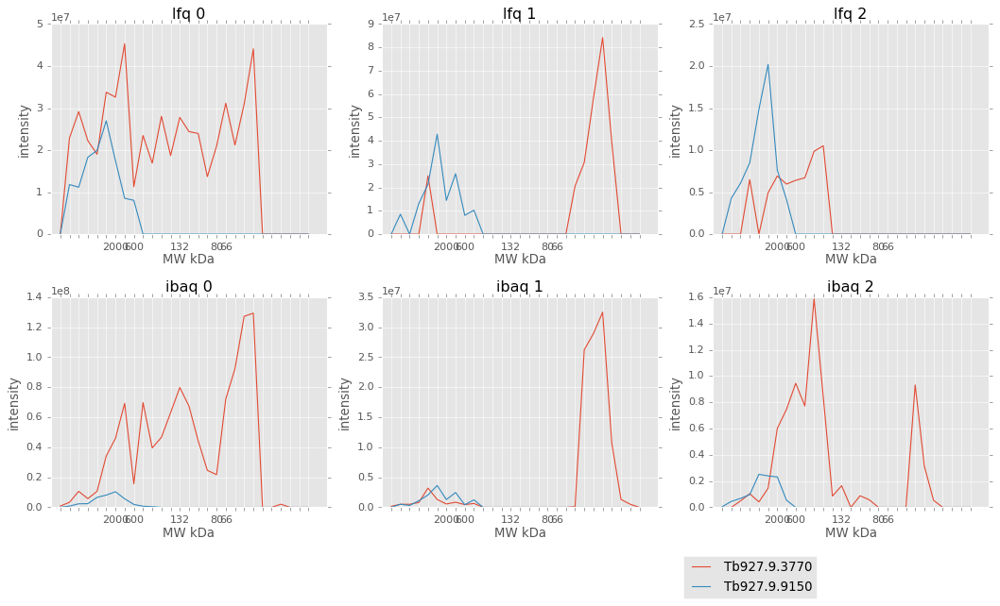

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.3770                  23               2   
Tb927.9.9150                  50               0   

                        [Product Description]  
[Input ID]                                     
Tb927.9.3770  hypothetical protein, conserved  
Tb927.9.9150    GTP-binding protein, putative  
78 77 43 ['Tb927.9.3770', 'Tb927.9.9150']


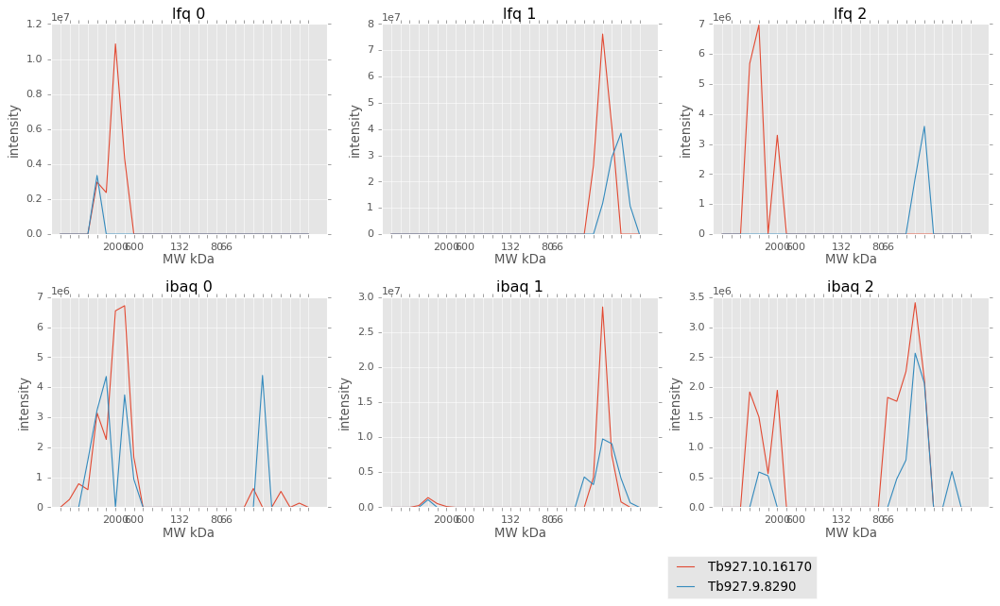

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.16170                  34               0   
Tb927.9.8290                    25               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.10.16170  potassium voltage-gated channel, putative  
Tb927.9.8290          mitochondrial ribosomal protein l30  
78 65 41 ['Tb927.10.16170', 'Tb927.9.8290']


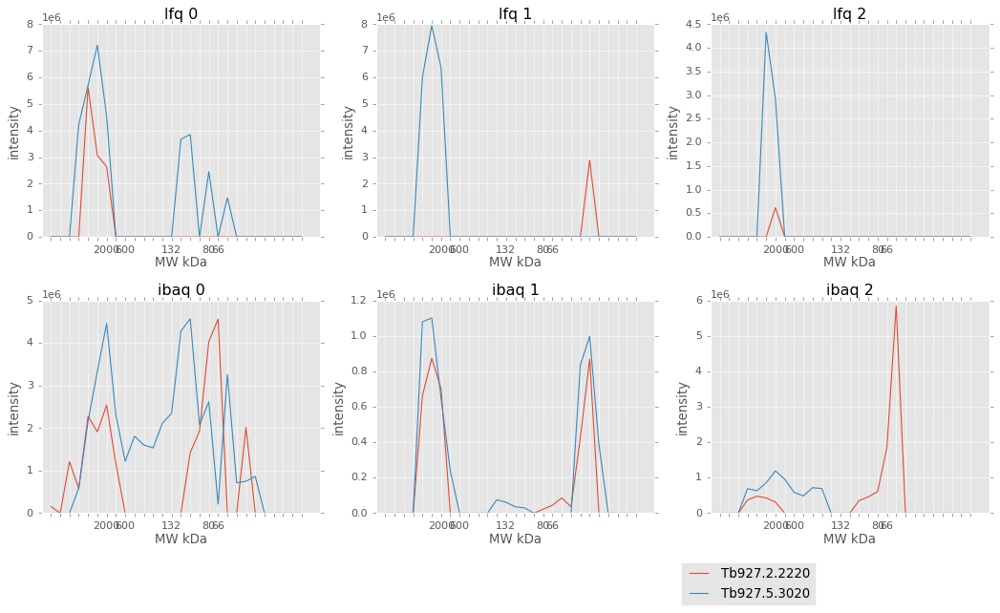

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.2.2220                  34               0   
Tb927.5.3020                  45               0   

                        [Product Description]  
[Input ID]                                     
Tb927.2.2220  hypothetical protein, conserved  
Tb927.5.3020  hypothetical protein, conserved  
78 72 42 ['Tb927.2.2220', 'Tb927.5.3020']


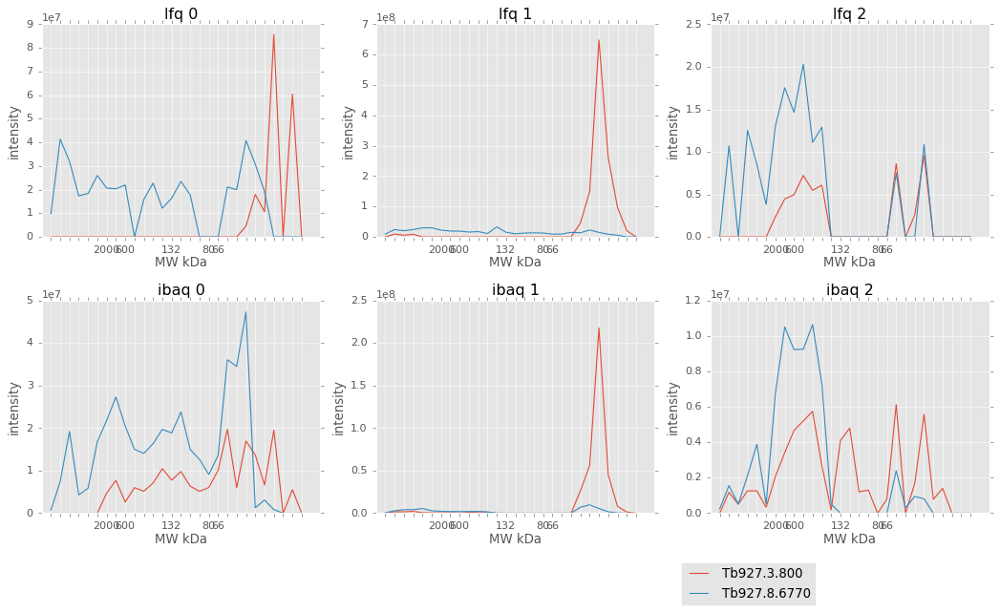

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.800                   30               3   
Tb927.8.6770                  45               0   

                              [Product Description]  
[Input ID]                                           
Tb927.3.800   Vacuolar iron transporter 1, putative  
Tb927.8.6770     WD domain, G-beta repeat, putative  
38 69 65 ['Tb927.3.800', 'Tb927.8.6770']


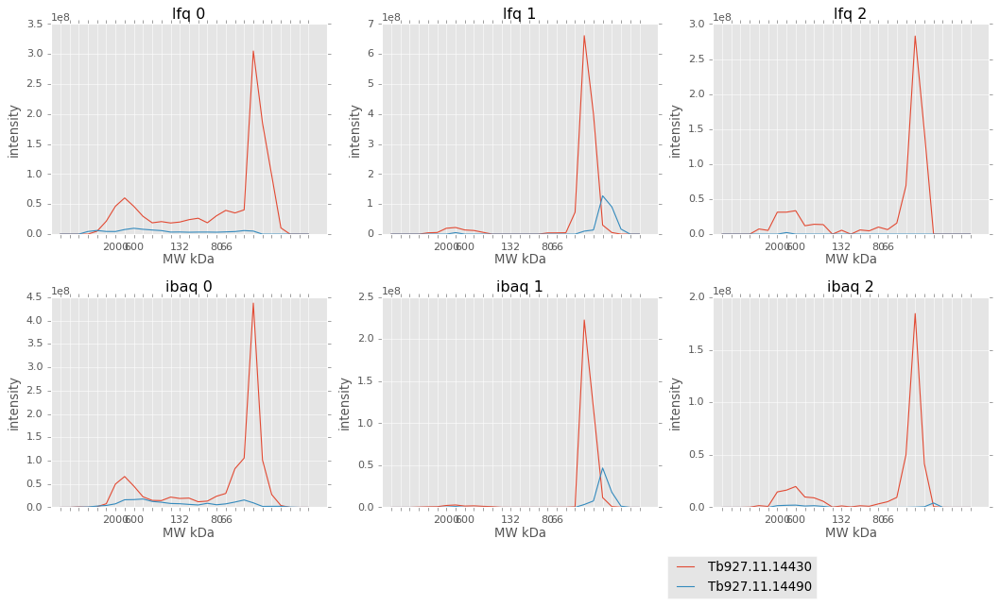

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.14430                  31               0   
Tb927.11.14490                  21               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.11.14430  proteasome regulatory non-ATP-ase subunit  
Tb927.11.14490           RNA polymerase subunit, putative  
67 39 79 ['Tb927.11.14430', 'Tb927.11.14490']


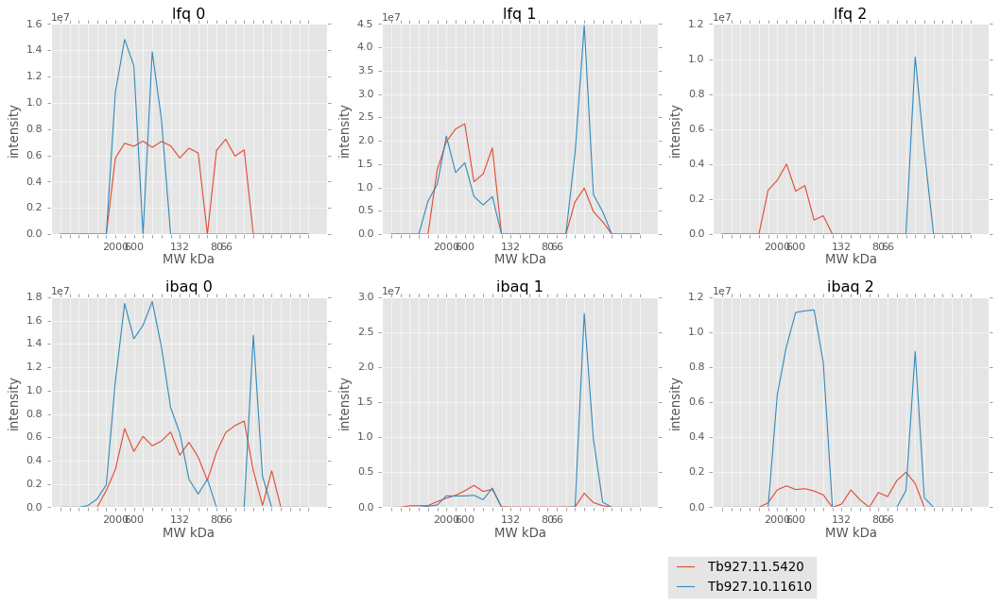

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.5420                   37               0   
Tb927.10.11610                  25               0   

                          [Product Description]  
[Input ID]                                       
Tb927.11.5420   hypothetical protein, conserved  
Tb927.10.11610                SKP1-like protein  
67 12 67 ['Tb927.11.5420', 'Tb927.10.11610']


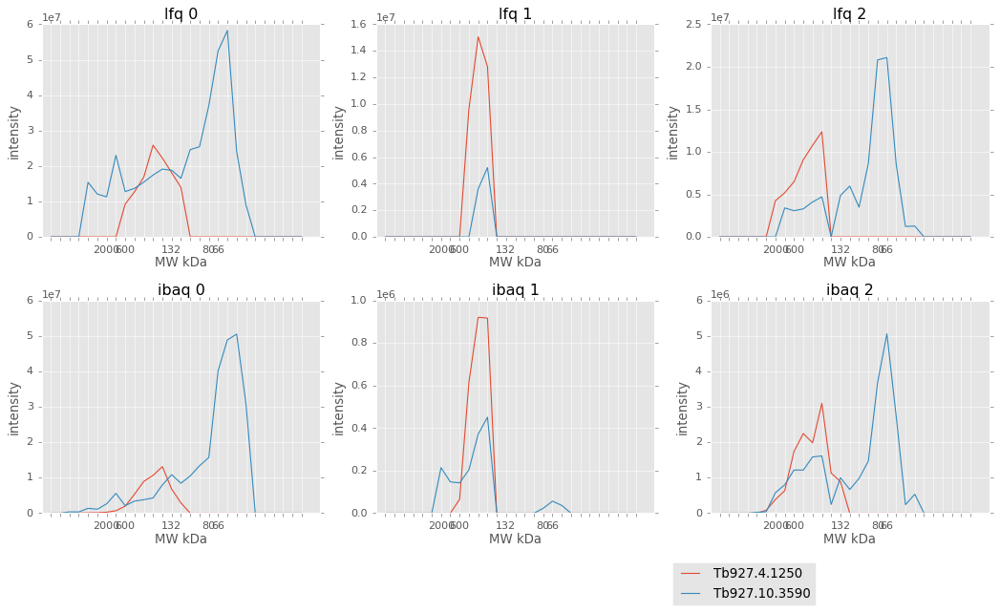

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.4.1250                   99               0   
Tb927.10.3590                  62               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.4.1250   peroxisome biogenesis factor 1, putative  
Tb927.10.3590           hypothetical protein, conserved  
35 25 71 ['Tb927.4.1250', 'Tb927.10.3590']


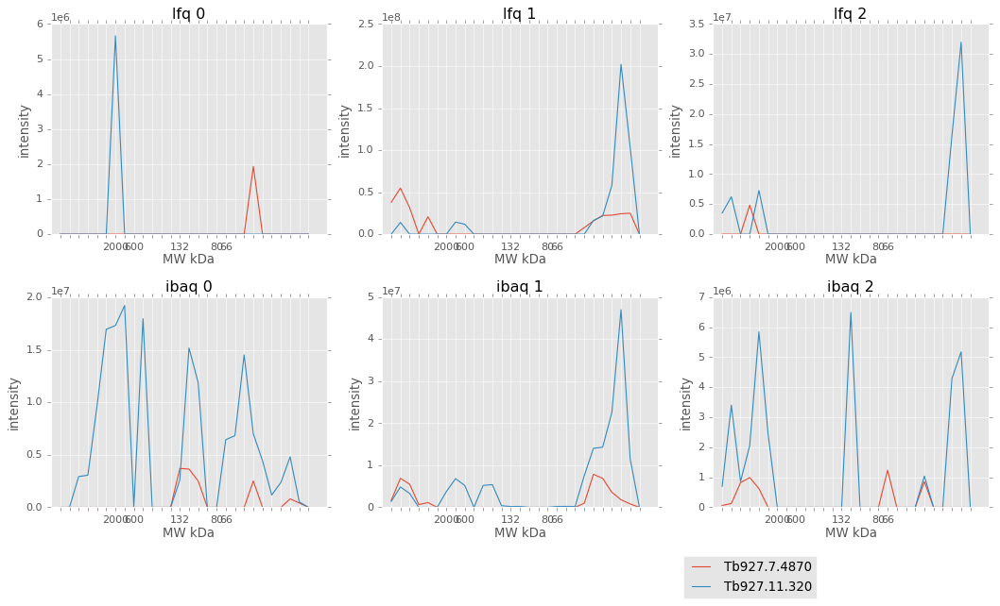

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.7.4870                  30               0   
Tb927.11.320                  10               0   

                        [Product Description]  
[Input ID]                                     
Tb927.7.4870  hypothetical protein, conserved  
Tb927.11.320   dynein light chain 1, putative  
8 64 55 ['Tb927.7.4870', 'Tb927.11.320']


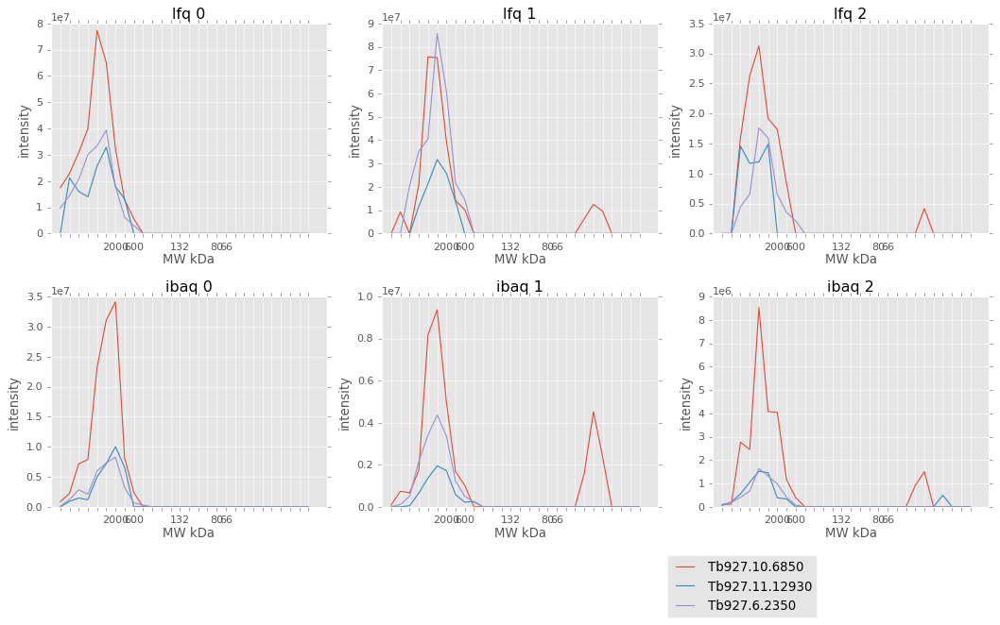

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.6850                   36               0   
Tb927.11.12930                  85               0   
Tb927.6.2350                   103               0   

                                        [Product Description]  
[Input ID]                                                     
Tb927.10.6850   Mitochondrial ribosomal protein S18, putative  
Tb927.11.12930                    DEAD-box helicase, putative  
Tb927.6.2350            50S ribosome-binding GTPase, putative  
76 76 48 ['Tb927.10.6850', 'Tb927.11.12930', 'Tb927.6.2350']


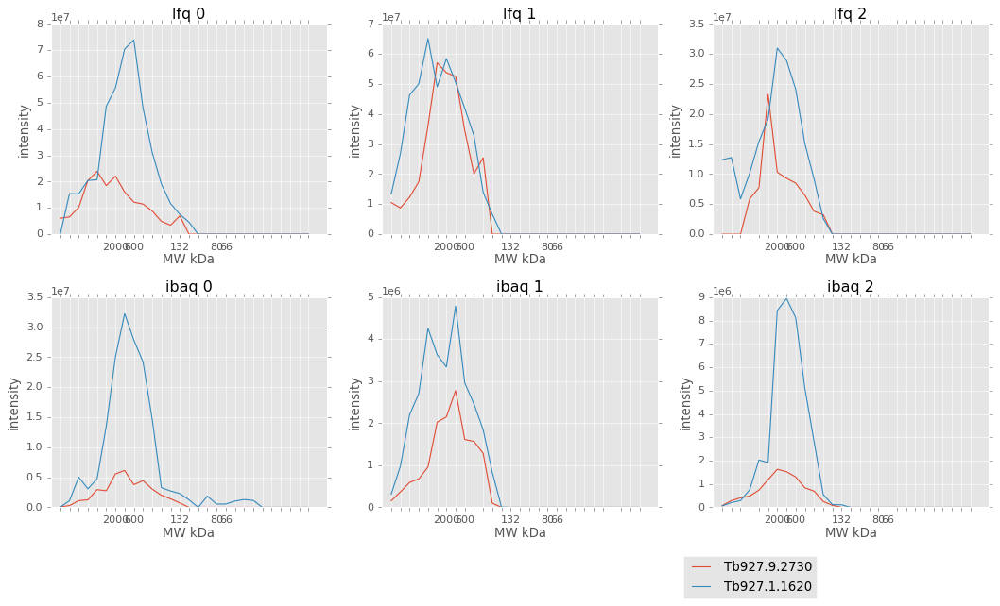

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.2730                 147               0   
Tb927.1.1620                  81               0   

                                    [Product Description]  
[Input ID]                                                 
Tb927.9.2730              hypothetical protein, conserved  
Tb927.1.1620  ATP-dependent DEAD/H RNA helicase, putative  
60 56 60 ['Tb927.9.2730', 'Tb927.1.1620']


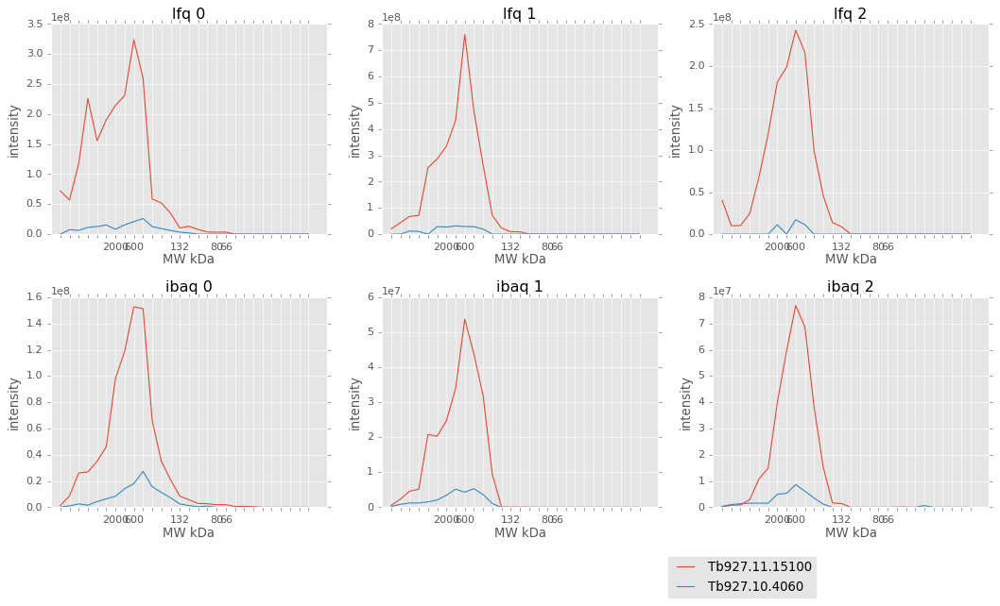

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.15100                 118               0   
Tb927.10.4060                   39               0   

                               [Product Description]  
[Input ID]                                            
Tb927.11.15100                                Tb5.20  
Tb927.10.4060   Ankyrin repeats (3 copies), putative  
60 43 58 ['Tb927.11.15100', 'Tb927.10.4060']


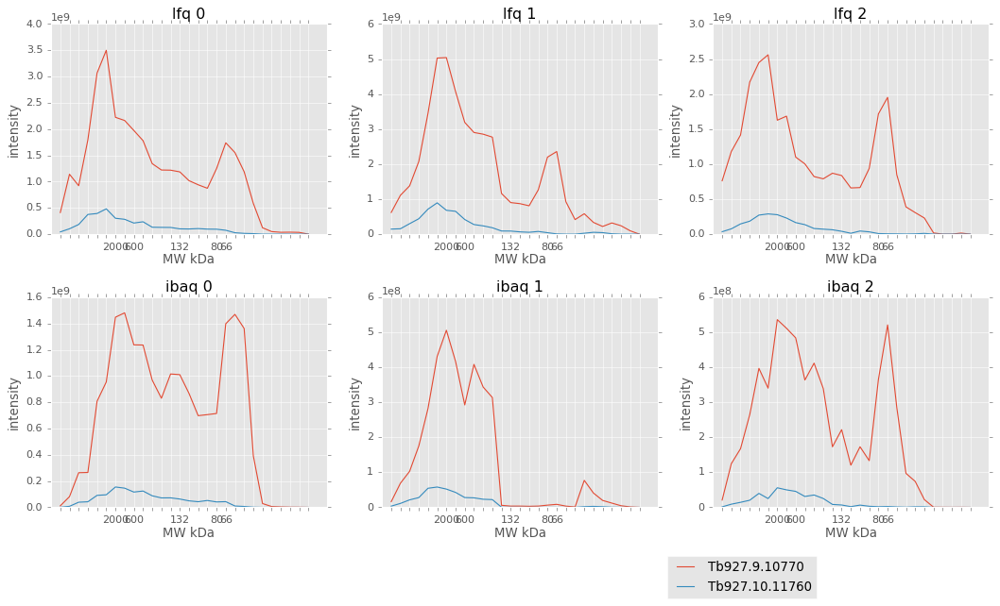

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.9.10770                   62               0   
Tb927.10.11760                  93               0   

                            [Product Description]  
[Input ID]                                         
Tb927.9.10770     polyadenylate-binding protein 2  
Tb927.10.11760  pumilio/PUF RNA binding protein 6  
60 50 85 ['Tb927.9.10770', 'Tb927.10.11760']


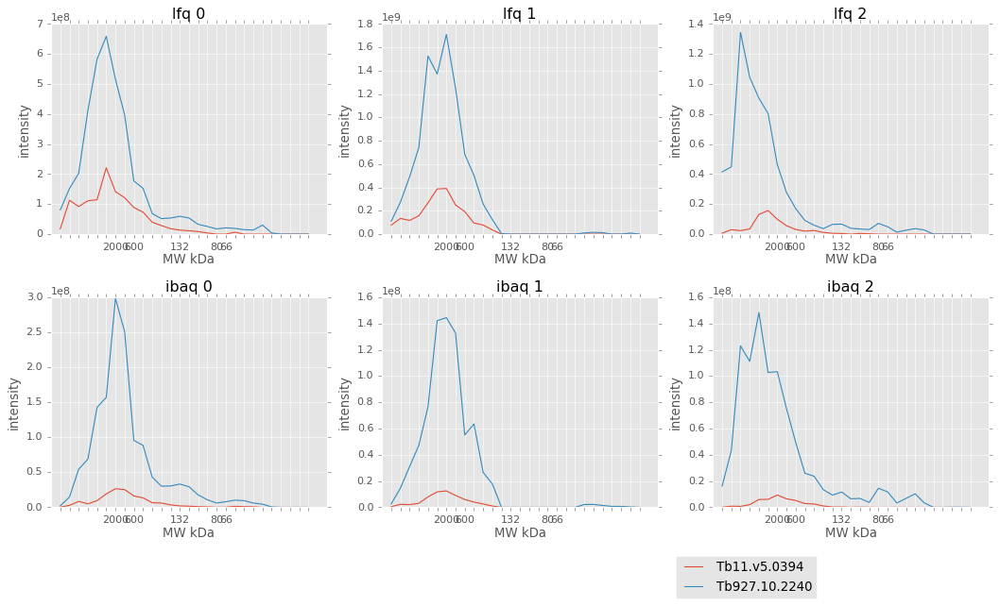

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb11.v5.0394                  183               0   
Tb927.10.2240                  66               0   

                         [Product Description]  
[Input ID]                                      
Tb11.v5.0394   hypothetical protein, conserved  
Tb927.10.2240              RNA binding protein  
71 56 90 ['Tb11.v5.0394', 'Tb927.10.2240']


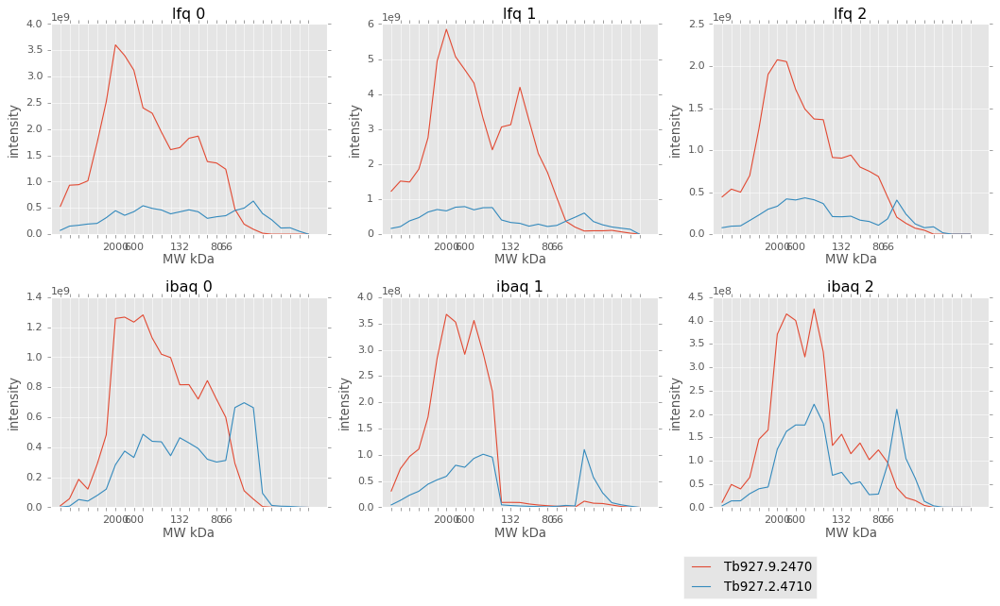

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.9.2470                  86               0   
Tb927.2.4710                  49               0   

                      [Product Description]  
[Input ID]                                   
Tb927.9.2470              nucleolar protein  
Tb927.2.4710  RNA-binding protein, putative  
61 50 61 ['Tb927.9.2470', 'Tb927.2.4710']


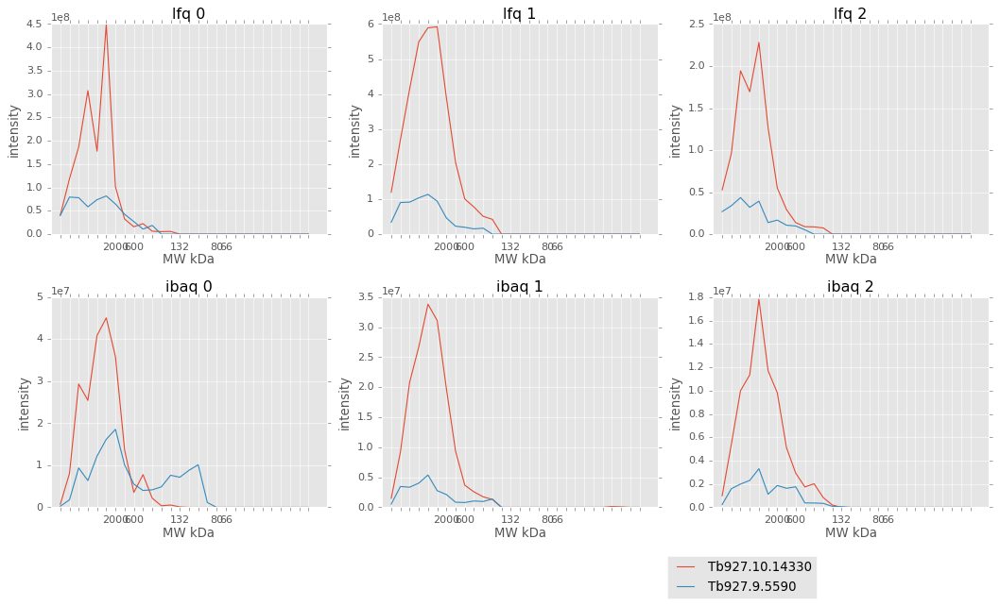

                [Molecular Weight]  [# TM Domains]    [Product Description]
[Input ID]                                                                 
Tb927.10.14330                 115               0  Utp14 protein, putative
Tb927.9.5590                   137               0     DNA topoisomerase ii
77 82 49 ['Tb927.10.14330', 'Tb927.9.5590']


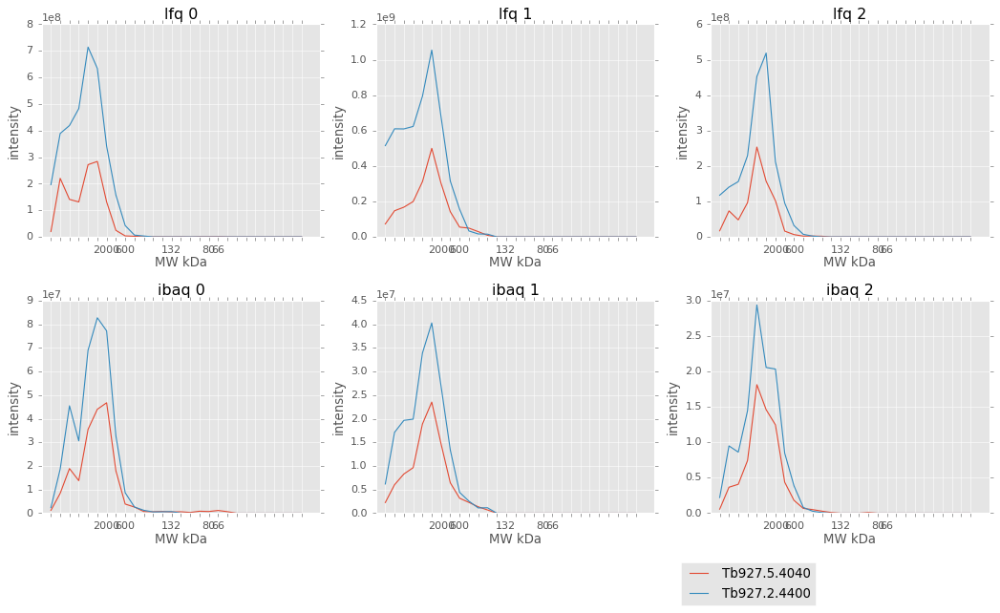

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.5.4040                  94               0   
Tb927.2.4400                 136               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.5.4040   Mitochondrial SSU ribosomal protein, putative  
Tb927.2.4400  SSU ribosomal protein, mitochondrial, putative  
77 82 48 ['Tb927.5.4040', 'Tb927.2.4400']


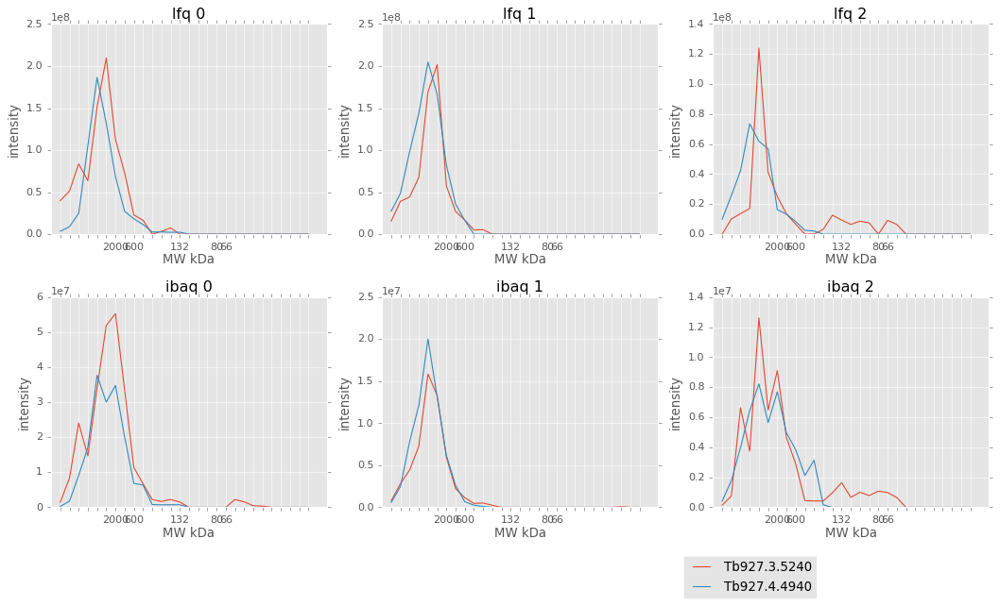

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.5240                  66               0   
Tb927.4.4940                  73               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.3.5240  kinetoplast ribosomal PPR-repeat containing pr...  
Tb927.4.4940                    hypothetical protein, conserved  
77 71 43 ['Tb927.3.5240', 'Tb927.4.4940']


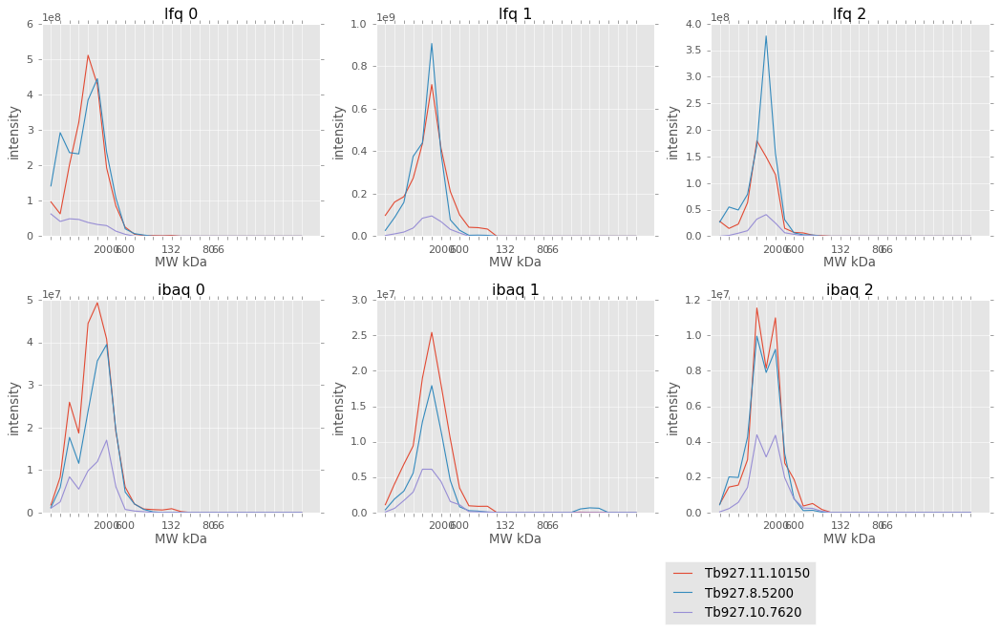

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.10150                 137               0   
Tb927.8.5200                   201               0   
Tb927.10.7620                   71               1   

                                            [Product Description]  
[Input ID]                                                         
Tb927.11.10150     Enoyl-CoA hydratase/isomerase family, putative  
Tb927.8.5200        Mitochondrial SSU ribosomal protein, putative  
Tb927.10.7620   mitochondrial ATP-dependent zinc metallopeptid...  
77 79 43 ['Tb927.11.10150', 'Tb927.8.5200', 'Tb927.10.7620']


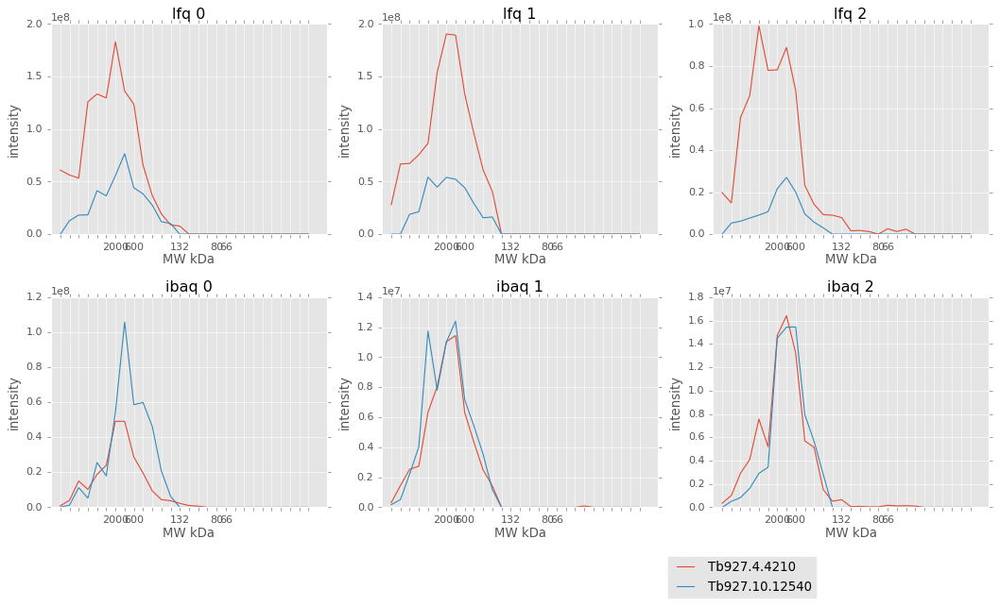

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.4.4210                    96               2   
Tb927.10.12540                  33               0   

                                            [Product Description]  
[Input ID]                                                         
Tb927.4.4210    ATP-dependent zinc metalloprotease AFG3-like, ...  
Tb927.10.12540  NADH-ubiquinone oxidoreductase complex I subun...  
69 55 85 ['Tb927.4.4210', 'Tb927.10.12540']


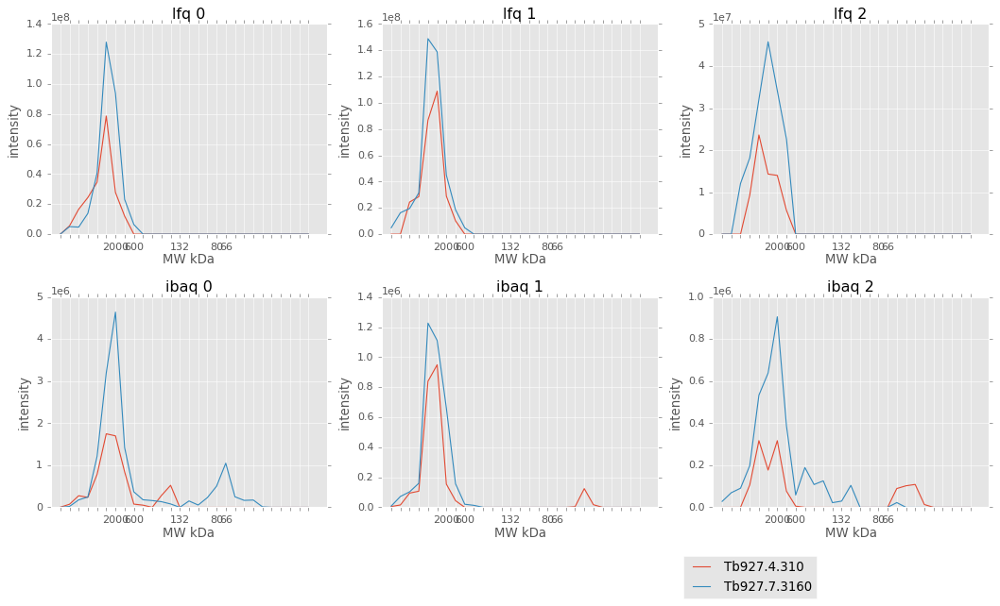

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.4.310                  733               0   
Tb927.7.3160                 596               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.4.310   SPRY domain/HECT-domain (ubiquitin-transferase...  
Tb927.7.3160  Cytoplasmic dynein 1 heavy chain (DYNC1H1), pu...  
74 73 43 ['Tb927.4.310', 'Tb927.7.3160']


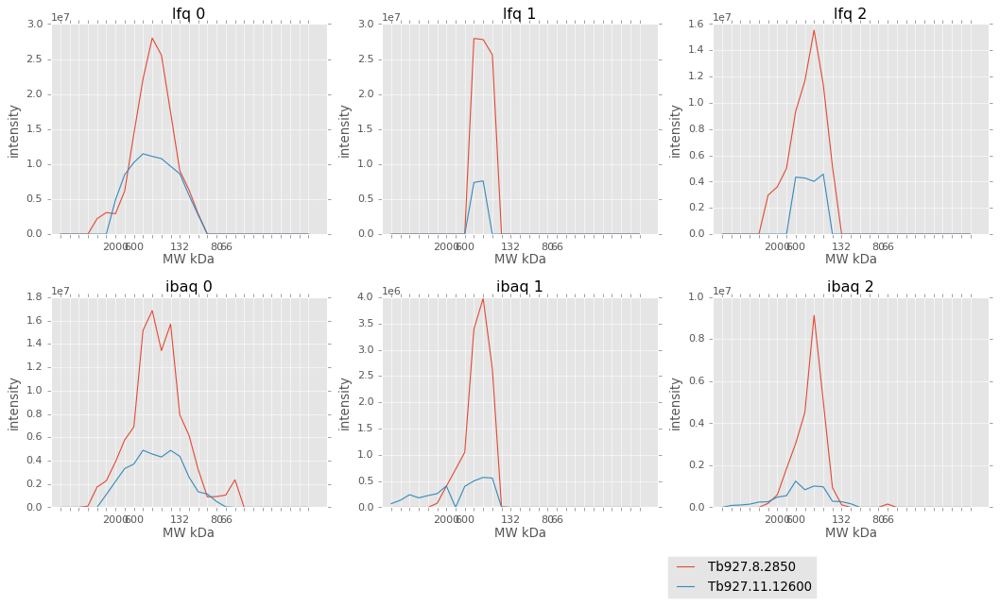

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.8.2850                    65               0   
Tb927.11.12600                  93               0   

                               [Product Description]  
[Input ID]                                            
Tb927.8.2850    Poly(A)-specific ribonuclease PARN-1  
Tb927.11.12600  ATP-dependent DNA helicase, putative  
30 12 71 ['Tb927.8.2850', 'Tb927.11.12600']


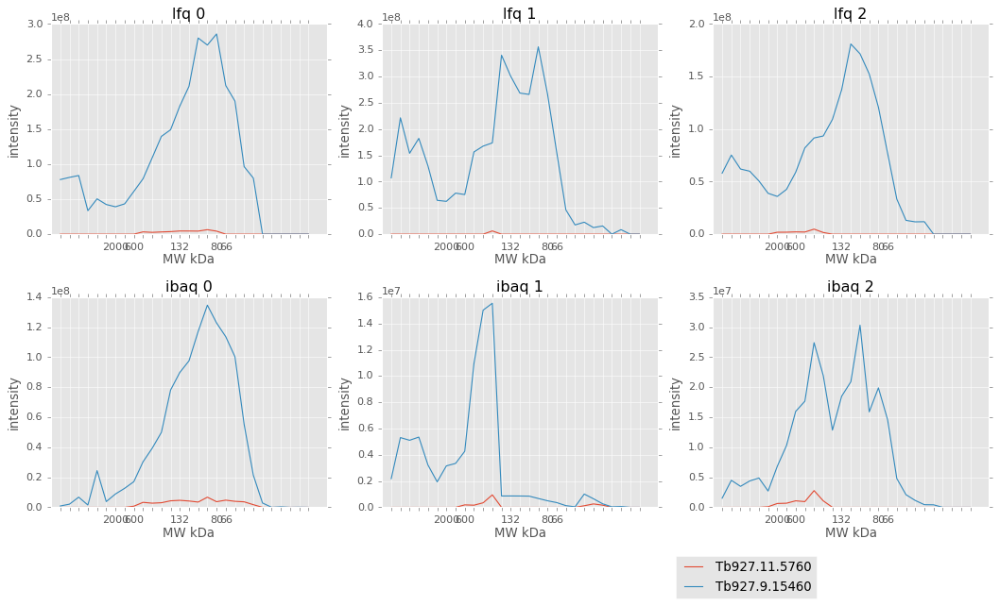

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.11.5760                  36               0   
Tb927.9.15460                 113               8   

                                [Product Description]  
[Input ID]                                             
Tb927.11.5760         hypothetical protein, conserved  
Tb927.9.15460  calcium motive p-type ATPase, putative  
21 26 70 ['Tb927.11.5760', 'Tb927.9.15460']


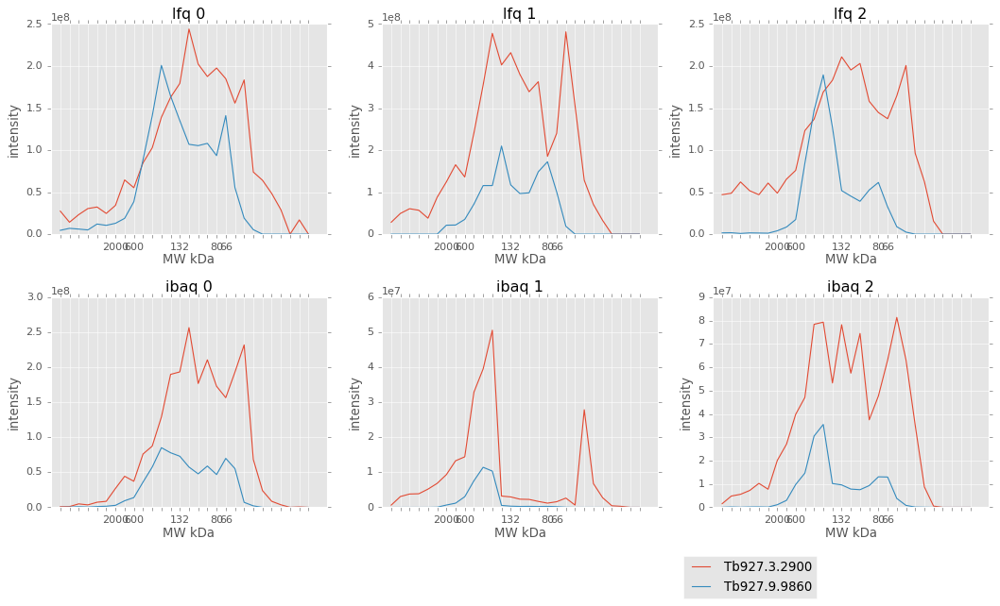

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.2900                  46               0   
Tb927.9.9860                  79               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.3.2900  eukaryotic translation initiation factor 2 sub...  
Tb927.9.9860        170 kDa glucose-regulated protein, putative  
21 38 38 ['Tb927.3.2900', 'Tb927.9.9860']


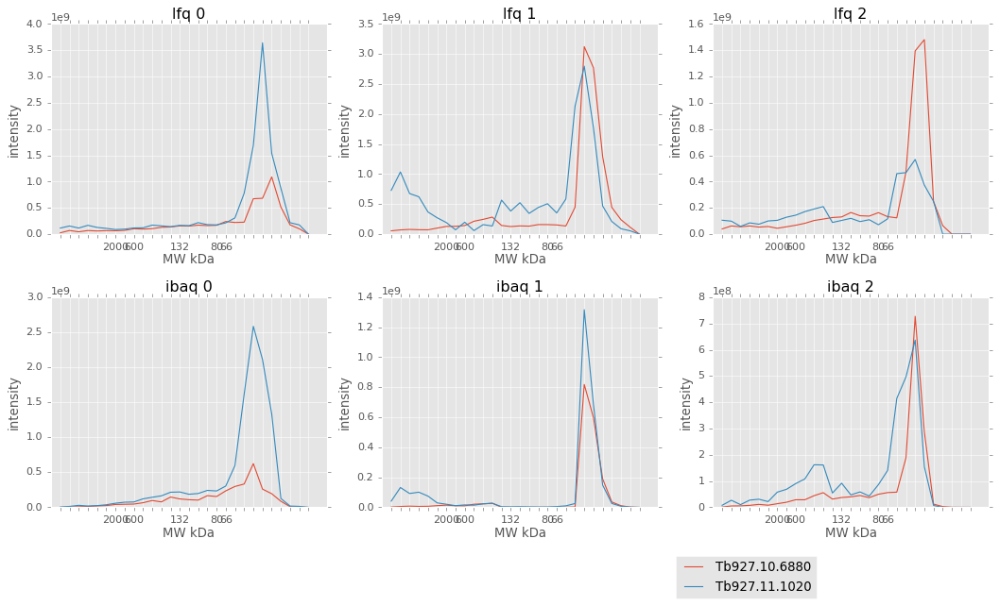

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.10.6880                  35               0   
Tb927.11.1020                  35               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.6880  glyceraldehyde 3-phosphate dehydrogenase, cyto...  
Tb927.11.1020                               ribokinase, putative  
21 10 15 ['Tb927.10.6880', 'Tb927.11.1020']


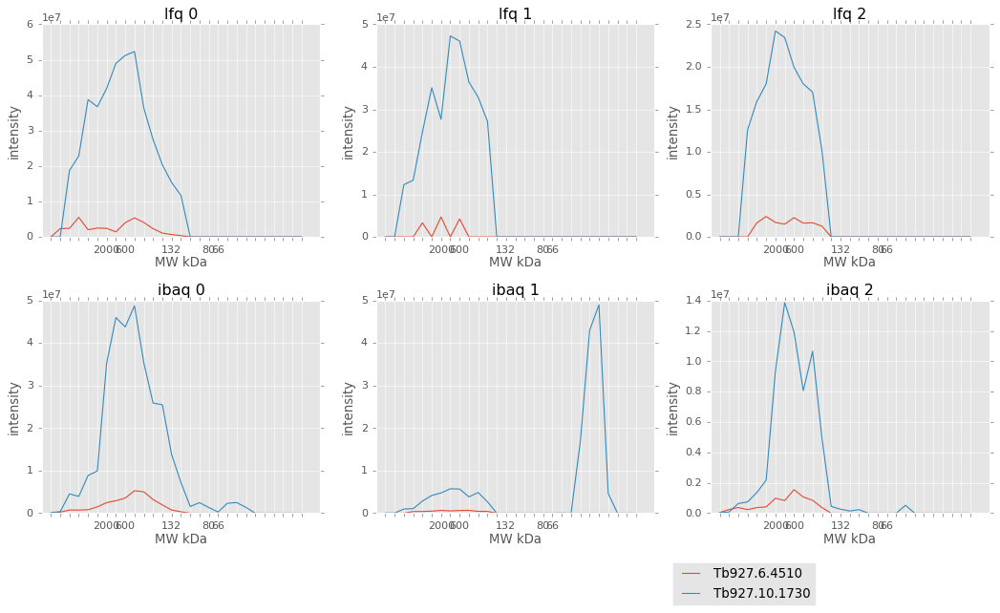

               [Molecular Weight]  [# TM Domains]  \
[Input ID]                                          
Tb927.6.4510                   36               0   
Tb927.10.1730                  39               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.6.4510                     hypothetical protein, conserved  
Tb927.10.1730  Polyadenylation mediator complex protein PAMC3...  
63 54 58 ['Tb927.6.4510', 'Tb927.10.1730']


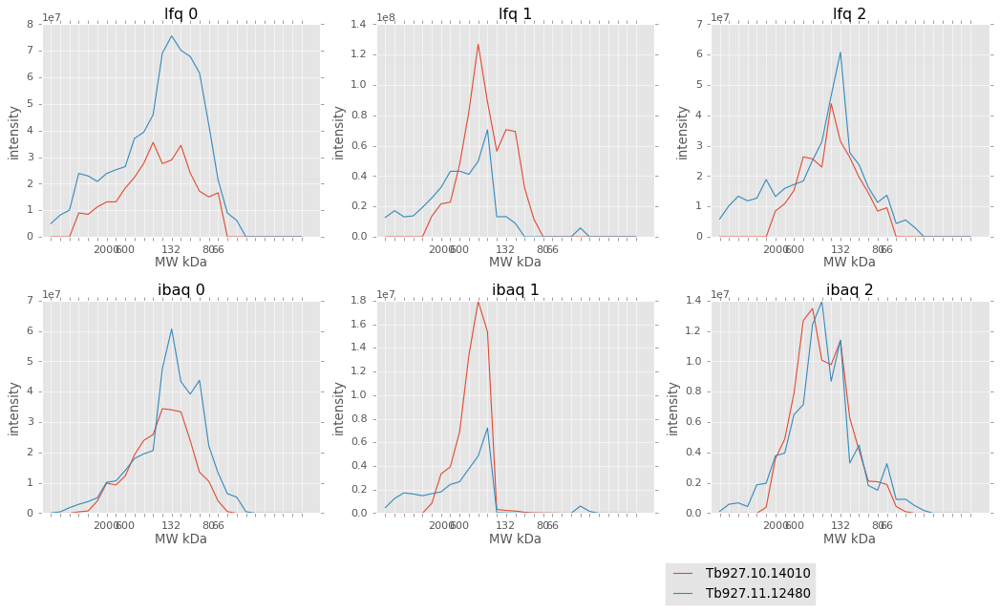

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.10.14010                  50               0   
Tb927.11.12480                  69               0   

                                           [Product Description]  
[Input ID]                                                        
Tb927.10.14010  tubulin cofactor C domain-containing protein RP2  
Tb927.11.12480             Kinetochore interacting phosphatase 7  
25 26 35 ['Tb927.10.14010', 'Tb927.11.12480']


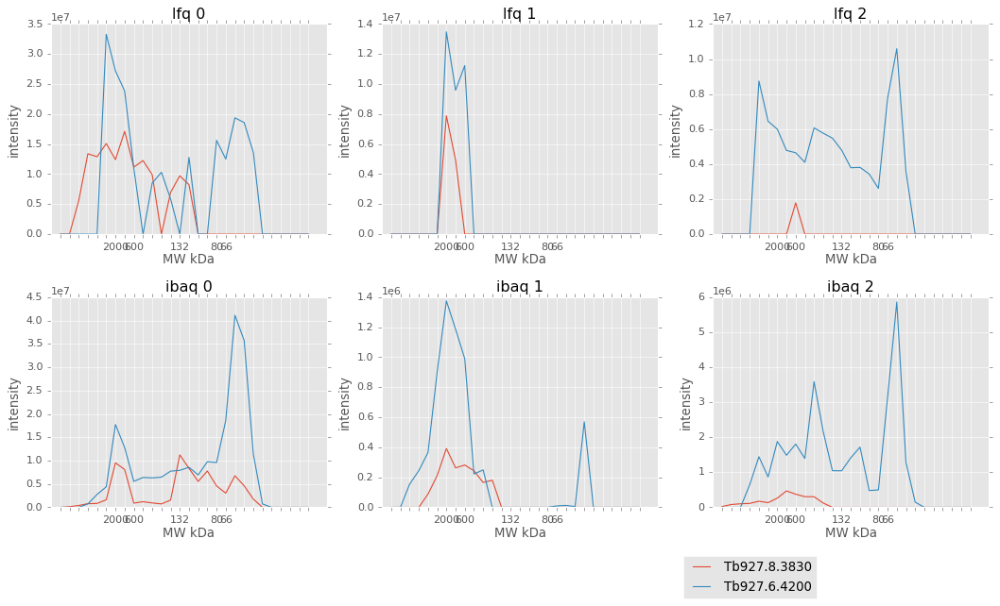

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.8.3830                  81               0   
Tb927.6.4200                  50               0   

                                       [Product Description]  
[Input ID]                                                    
Tb927.8.3830                                   mitochondrial  
Tb927.6.4200  LSU ribosomal protein, mitochondrial, putative  
34 40 58 ['Tb927.8.3830', 'Tb927.6.4200']


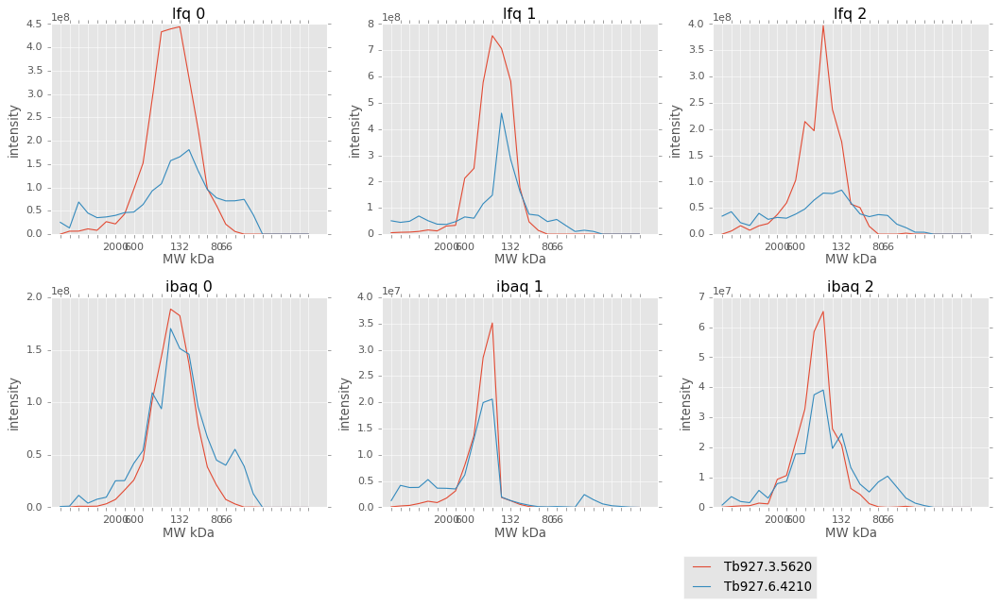

              [Molecular Weight]  [# TM Domains]  \
[Input ID]                                         
Tb927.3.5620                 113               0   
Tb927.6.4210                  64               0   

                                          [Product Description]  
[Input ID]                                                       
Tb927.3.5620  Facilitates chromatin transcription complex su...  
Tb927.6.4210                   aldehyde dehydrogenase, putative  
23 37 35 ['Tb927.3.5620', 'Tb927.6.4210']


In [54]:
cfile = open('upep_complexes.txt','w')
plt.style.use('ggplot')
df_1 = pd.read_csv('upep_0_2.5.csv',index_col=[0])
df_2 = pd.read_csv('upep_1_2.5.csv',index_col=[0])
df_3 = pd.read_csv('upep_2_2.5.csv',index_col=[0])
find_complex(df_1, df_2, df_3, cfile, gene_table)
cfile.close()       

In [ ]:
plt.style.use('ggplot')
import tqdm
#clusters dataframe with different distances
#compute dendogram and than cutting it at different distances
def make_clustering_df(in_df = pd.DataFrame(), 
                       min_number_of_clusters=4,
                       res_df_name = '',
                       method='', metric=''):
    
    link = sch.linkage(in_df, method, metric)
    
    den = sch.dendrogram(link, 
                         color_threshold=20, 
                         orientation='left')
    #plt.show()
    #print ('done den')
    cut_distances = np.arange(0,3,0.01)
    done = set()
    
    for cut_distance in tqdm.tqdm(cut_distances):
        clusters = sch.fcluster(link, cut_distance, criterion='distance')
        in_df['clusters_'+str(cut_distance)]=clusters
        n_of_clusters =  in_df['clusters_'+str(cut_distance)].value_counts().shape[0]
        
        if n_of_clusters not in done:
            done.add(n_of_clusters)
            #print (cut_distance, n_of_clusters)
        else:
            del in_df['clusters_'+str(cut_distance)]
        if n_of_clusters <=min_number_of_clusters:
            break
        
    res_df = in_df[[n for n in in_df.columns if 'clusters_' in n]]
    res_df.to_csv(res_df_name)
    print ('done')
    print (res_df.shape) 

In [ ]:
plt.style.use('ggplot')
for q in ['lfq', 'ibaq', 'msms', 'upep']:
    for index in [0, 1]:
        make_clustering_df(in_df = res[q]['exp_filter_mw'][index].iloc[:,0:27].apply(utilities.norm_max, 1), 
                    min_number_of_clusters=20,
                    res_df_name = os.path.join('clusters', q+str(index)+'.csv'),
                    method='ward' ,
                    metric='euclidean'
                       )
        plt.show()

plt.style.use('ggplot')
for label in ['lfq', 'ibaq']:
    for exp in [0,1]:
        print(label, exp)
        make_clustering_df(in_df = res[label]['exp_masked'][exp].apply(utilities.norm_max, 1), 
                    min_number_of_clusters=20,
                    res_df_name = os.path.join('clusters', label+'_'+str(exp)+'.csv'),
                    method='ward' ,
                    metric='euclidean'
                       )
        plt.show()


In [ ]:
from IPython.display import Image
from IPython.core.display import HTML
import scipy.cluster.hierarchy as sch
import gc
from ipyparallel import Client
import os
import pprint

import pprint
pp = pprint.PrettyPrinter(indent=4)

'''

#create some paths to push to the cluster engines
data_path = 'd:/git/fernando/final_run/'
res_go_path = 'd:/git/fernando/final_run/go_results/'
res_random_go_path = 'd:/git/fernando/final_run/go_results_random/'




rc[:].push(dict(
    data_path=data_path,
    res_go_path=res_go_path,
    res_random_go_path=res_random_go_path,
    in_go=in_go,
    in_assoc=in_assoc,
    res = res
))
'''


In [ ]:
rc = Client()
dview = rc.load_balanced_view()
print ('n of workers:', len(dview))
print (len(rc))

In [ ]:
#all_genes = res['lfq']['exp_masked'][0]
#gene_found = list(all_genes.index.values)
#open('gene_found.txt','w').write('\n'.join(gene_found))

In [ ]:
%%px --local
#add the go term function to the cluster engines
import os
import pandas as pd
from goatools.base import download_go_basic_obo
from goatools.associations import read_associations
from goatools.go_enrichment import GOEnrichmentStudy
from goatools.obo_parser import GODag
import scipy.cluster.hierarchy as sch
import numpy as np
from itertools import combinations
from scipy import stats
from itertools import combinations

gene_found = open('D:/git/fernando/final_run/gene_found.txt').read().split('\n')

in_go='d:/git/fernando/Fernando8mM60/indata/go/go-basic_2.obo'
print (in_go)
in_assoc='d:/git/fernando/Fernando8mM60/indata/go/associations_2.txt'
print (in_assoc)
#gene_found = list(res['upep'][0][0].index.values)
obodag = GODag(in_go)
geneid2gos = read_associations(in_assoc)

goeaobj = GOEnrichmentStudy(
            gene_found, # List of mouse protein-coding genes
            geneid2gos, # geneid/GO associations
            obodag, # Ontologies
            propagate_counts = False,
            alpha = 0.05, # default significance cut-off
            methods = ['fdr_bh'])

In [ ]:
%%px --local
#function to count the enriched go terms
def score(in_genes, index_res, cut_distance, cluster_id, out_folder):
    print (out_folder)
    def count(goea_results_sig):
            res = {'BP' : 0,
                   'CC' : 0,
                   'MF' : 0,
                   'complex':0}
            for item in goea_results_sig:
                item_list = str(item).split()            
                go_type = item_list[1] 
                res[go_type]+=1
                if 'complex_' in str(item):
                    res['complex']+=1
            return res   
    goea_results_all = goeaobj.run_study(in_genes)
    goea_results_sig = [r for r in goea_results_all if r.p_fdr_bh < 0.05]
    res = count(goea_results_sig)
    if sum(res.values())>0:
        file_name = 'res_'+str(cut_distance)+'_'+str(cluster_id)+'.txt'
        res_file = open(os.path.join(out_folder, file_name),'w')
        print(res_file)
        res_file.write('\t'.join(['cut_distance','cluster_id','CC','MF','BP','complexes'])+'\n')
        res_file.write('\t'.join( [str(n) for n in [cut_distance,cluster_id,res['CC'],res['MF'],res['BP'],res['complex']]] ))
        res_file.close()
    #return count(goea_results_sig)

In [ ]:
geneids_study = ['Tb927.10.8190','Tb927.11.14250','Tb927.8.3150','Tb927.11.3240','Tb927.11.1900']
rc[0].apply(score, geneids_study, 'test_cluster', 0.05, 3, 'D:/git/fernando/final_run/go_results/').get()

In [ ]:
def test():
    in_file = 'D:/git/fernando/Fernando8mM60/test/t-complex.txt'
    geneids_study = ['Tb927.10.8190','Tb927.11.14250','Tb927.8.3150','Tb927.11.3240','Tb927.11.1900']
    #score(geneids_study, 'test_local', 0.04, 2, 'D:/git/fernando/final_run/go_results/')
    rc[0].apply(score, geneids_study, 'test_cluster', 0.05, 3, 'D:/git/fernando/final_run/go_results/')
test()

In [ ]:
import time
import sys
start_time = time.time()
#res = []

def process_df(clustering_df=pd.DataFrame(), res_path=''):
    index=0
    for col in tqdm.tqdm(clustering_df.columns):
        index+=1
        in_data = clustering_df[col].value_counts()
        in_data = in_data[in_data>=2]
        cut_distance = col.split('_')[-1]
        #print (index, col, cut_distance)
        for cluster in in_data.index.values:
            genes = clustering_df[col][clustering_df[col]==cluster]
            genes = genes.index.values
            genes = [n.split('_')[0] for n in genes]
            #if len(genes) >1:
            #print cluster, len(genes)
            #print 'send', index, cut_distance, cluster, 'to controller'
            dview.apply(score, genes, index, cut_distance, cluster, res_path)
            #print(res_path)
            test = 0
            a=0
            while 1:
                #send more job only if the queue is less than 100
                #to do not run out of memory
                if dview.queue_status()['unassigned']<100:            
                    break
                else:
                    a+=1
                    #print a, 'unassigned:', dview.queue_status()['unassigned']
                    #print 'waited for ', a*1, 'sec'
                    sys.stdout.flush()
                    time.sleep(2)            
                    pass  

In [ ]:
#%%px --local
#create a rndom dataset
import time
import random
import tqdm
import shutil
for df_name in os.listdir('D:/git/fernando/final_run/clusters/'):
    print(df_name)
    start_time = time.time()
    #if '_2' in df_name:
    clustering_df = pd.read_csv('D:/git/fernando/final_run/clusters/'+df_name,index_col=[0])
    print(clustering_df.head())
    #test on small subset
    #clustering_df = clustering_df.iloc[:,0:3]
    #clustering_df.set_index('prot_id', inplace=True)
    res_go_path = 'D:/git/fernando/final_run/go_results/'+df_name.split('.')[0]
    
    if os.path.exists(res_go_path):
        shutil.rmtree(res_go_path)
    os.makedirs(res_go_path)


    process_df(clustering_df=clustering_df, res_path=res_go_path)

    print ('-------elapsed-------------\n',    
    time.time() - start_time, 'min: ', (time.time() - start_time)/60, 'h: ', (time.time() - start_time)/60/60,
    '\n-------------------------\n')   

In [ ]:
dview.queue_status()

In [ ]:
#counting the outputs
def reduce_res(res_path, outname):
    list_df = [pd.read_table(os.path.join(res_path, file_name),
                             sep='\t') for file_name in os.listdir(res_path)]
    if len(list_df)>0:
        list_df = pd.concat(list_df)
        list_df.sort_values(by='cut_distance', ascending=True, inplace=True)
        print (list_df.head())
        combined = list_df.groupby('cut_distance').sum()
        del combined['cluster_id']
        print (combined.head())
        combined.to_csv(outname)
                
for q in ['msms','upep']:#'lfq', 'ibaq',
    for exp in [0,1]:
        path = 'D:/git/fernando/final_run/go_results/'        
        reduce_res(path+q+str(exp), path+q+'_f'+str(exp)+'_reduced_go_terms.csv')

In [ ]:
def make_enrichment_plot(tag='ibaq_0'):
    plt.style.use('ggplot')
    fig,ax = plt.subplots()
    res_go_path='D:/git/fernando/final_run/go_results/'
    combined = pd.read_csv(res_go_path+tag+'_reduced_go_terms.csv')
    #combined.set_index('cut_distance',inplace=True)
    combined['mean']=combined.mean(axis=1)
    #combined['mean']=np.exp(combined['mean'])
    combined.plot(kind='scatter', ax=ax, x='cut_distance', y='mean', label='enrichment_go')
    combined['roll']=combined['mean'].rolling(10, win_type='hamming').mean()
    combined.plot(kind='line', ax=ax, x='cut_distance', y='roll', label='enrichment_go')
    plt.title(tag)
    plt.show()
    combined.head()
    combined.loc[np.argmax(combined['roll'])]
    

    fig,ax=plt.subplots()
    combined['mean']=np.exp(combined['mean'])
    combined.plot(kind='scatter', ax=ax, x='cut_distance', y='mean', label='mean')
    combined['roll']=combined['mean'].rolling(50, win_type='hamming').mean()
    combined['rolls']=combined['roll'].shift(-25)
    combined.plot(kind='line', ax=ax, x='cut_distance', y='rolls', label='enrichment_go')
    plt.title(tag)
    plt.show()
    
    print(combined.loc[np.argmax(combined['rolls'])])
    

In [ ]:
make_enrichment_plot(tag='ibaq_f0')

In [ ]:
make_enrichment_plot(tag='ibaq_f1')

In [ ]:
make_enrichment_plot(tag='lfq_f0')

In [ ]:
make_enrichment_plot(tag='lfq_f1')

In [ ]:
make_enrichment_plot(tag='msms_f0')

In [ ]:
make_enrichment_plot(tag='msms_f1')

In [ ]:
make_enrichment_plot(tag='upep_f0')

In [ ]:
make_enrichment_plot(tag='upep_f1')

In [ ]:
#temp[temp<3]=0
#temp = temp[(temp.T != 0).any()]
#print (temp.head())
temp = res['ibaq']['exp_masked'][0].copy()
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     #temp,
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=1,
     step_first_x = 2,
     title='ibaq 0',
     fig_name = 'ibaq_0.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      #4:'132', 
                      #19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

cluster_df['desc']=[desc_dict[n] for n in cluster_df.index.values]
cluster_df.to_csv('temp_cluster_lfq_0.csv')

In [ ]:
temp.head()

In [ ]:
make_enrichment_plot(tag='ibaq_f1')

In [ ]:
import warnings
warnings.filterwarnings("ignore")
#create the plot
temp = res['ibaq'][0][1]
#temp[temp<3]=0
#temp = temp[(temp.T != 0).any()]
#print (temp.head())
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=1,
     step_first_x = 2,
     title='ibaq 2',
     fig_name = 'ibaq_2.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      #4:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

In [ ]:
make_enrichment_plot(tag='lfq_f0')

In [ ]:
import warnings
warnings.filterwarnings("ignore")
#create the plot
temp = res['lfq'][0][0]
#temp[temp<3]=0
#temp = temp[(temp.T != 0).any()]
#print (temp.head())
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=1,
     step_first_x = 2,
     title='lfq 0',
     fig_name = 'lfq_0.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      #4:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

In [ ]:
make_enrichment_plot(tag='lfq_f1')

In [ ]:
import warnings
warnings.filterwarnings("ignore")
#create the plot
temp = res['lfq'][0][1]
#temp[temp<3]=0
#temp = temp[(temp.T != 0).any()]
#print (temp.head())
cluster_df, leaves = make_fig.plot_experiment(
     temp.apply(utilities.norm_max,1),
     method='ward', 
     metric='euclidean',
     cluster_columns = True,
     order_row_and_columns= False,
     color_map_id='cool',
     figsize=(8, 10),
     cut_distance_cols=40,
     cut_distance_rows=2.1,
     step_first_x = 2,
     title='lfq 2',
     fig_name = 'lfq_2.png',
     add_second_axis={'label':'MW kDa',
                      'values': {
                      6:'2000', 
                      9:'600', 
                      #4:'132', 
                      19:'66', 
                      } 
                      },
    height_ratios=[1, 8],
    hspace=0.02,
    get_clusters=True,
    owerwrite_order=False,
     )

In [ ]:
all_clusters = []
temp = pd.read_csv('clusters/'+'ibaq_f0.csv',index_col=[0])

all_clusters.append(temp['clusters_1.0'])

temp = pd.read_csv('clusters/'+'ibaq_f1.csv',index_col=[0])
all_clusters.append(temp['clusters_1.0'])

temp = pd.read_csv('clusters/'+'lfq_f0.csv',index_col=[0])

all_clusters.append(temp['clusters_1.5'])

temp = pd.read_csv('clusters/'+'lfq_f1.csv',index_col=[0])
print(temp.head())
all_clusters.append(temp['clusters_1.5'])

#temp = pd.read_csv('clusters/'+'msms_0.csv',index_col=[0])
#all_clusters.append(temp['clusters_1.29'])

#temp = pd.read_csv('clusters/'+'msms_1.csv',index_col=[0])
#all_clusters.append(temp['clusters_1.37'])

all_clusters = pd.concat(all_clusters,axis=1)
all_clusters.head()
all_clusters=all_clusters.dropna()
print(all_clusters.shape)
all_clusters.columns = ['ibaq_0','ibaq_1','lfq_0','lfq_1']
all_clusters.head()

In [ ]:
corr = all_clusters.T.corr()
corr.head()
upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))
temp = upper.unstack().dropna().sort_values()
temp.shape

In [ ]:
all_clusters.loc[['Tb927.10.8190',
'Tb927.11.14250',
'Tb927.8.3150',
'Tb927.11.3240',
'Tb927.11.1900']].T

In [ ]:
desc_dict = {}
from Bio import SeqIO
for record in SeqIO.parse("in_data/TriTrypDB-37_TbruceiTREU927_AnnotatedProteins.fasta", "fasta"):
    
    #print(record.description)
    if '|' in record.description:
        desc = record.description.split(' | ')[4].split('=')[1].strip()
    else:
        desc = record.description
    
    desc_dict[utilities.clean_id(record.id)]=desc
temp[temp==1].shape

In [ ]:
tempv = temp[temp==1].to_frame()
tempv.columns = ['p']
tempv['d1'] = ['_'.join(desc_dict[n[0].split('_')[0]].split(' ')[0:2]).replace(',','') for n in tempv.index.values] 
tempv['d2'] = ['_'.join(desc_dict[n[1].split('_')[0]].split(' ')[0:2]).replace(',','') for n in tempv.index.values] 
tempv['p_1'] = [n[0] for n in tempv.index.values]
tempv['p_2'] = [n[1] for n in tempv.index.values]
tempv['id_1'] = tempv['p_1']+'_'+tempv['d1']
tempv['id_2'] = tempv['p_2']+'_'+tempv['d2']
tempv.to_csv('temp_visant.txt',sep='\t')
tempv.tail()

In [ ]:
tempv.shape

In [ ]:
import networkx as nx
G = nx.Graph()
nodes = list(set(list(tempv['p_1'].values)+list(tempv['p_2'].values)))
for a in nodes:
    G.add_node(a, desc=desc_dict[a])
for a, b in zip(tempv['p_1'].values, tempv['p_2'].values):
    G.add_edge(*(a, b))
find_cliques = [n for n in nx.find_cliques(G)]
len(find_cliques)    

In [ ]:
for index in range(len(find_cliques)):
    prots= find_cliques[index]
    fig,axes = plt.subplots(ncols=2,nrows=2,figsize=(16,10))
    prots = [n  for n in prots if n in res['lfq']['exp_list'][0].index.values]
    plot_line(res['lfq']['exp_list'][0].loc[prots], axes[0,0])
    plot_line(res['lfq']['exp_list'][1].loc[prots], axes[0,1])
    plot_line(res['ibaq']['exp_list'][0].loc[prots], axes[1,0])
    plot_line(res['ibaq']['exp_list'][1].loc[prots], axes[1,1])
    plt.legend(bbox_to_anchor=(1.4, 0.5))
    axes[0,0].set_title('lfq 1')
    axes[0,1].set_title('lfq 3')
    axes[1,0].set_title('ibaq 1')
    axes[1,1].set_title('ibaq 3')
    #plt.suptitle('Cytoplasmic dynein', fontsize=21)
    #plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()
    print(gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[prots])
    

In [ ]:
prots=['Tb927.4.1270',
'Tb927.9.9290',
'Tb927.4.2000']
fig,axes = plt.subplots(ncols=2,nrows=2,figsize=(16,10))
prots = [n  for n in prots if n in res['lfq'][0][0].index.values]
plot_line(res['lfq'][0][0].loc[prots], axes[0,0])
plot_line(res['lfq'][0][1].loc[prots], axes[0,1])
plot_line(res['ibaq'][0][0].loc[prots], axes[1,0])
plot_line(res['ibaq'][0][1].loc[prots], axes[1,1])
plt.legend(bbox_to_anchor=(1.4, 0.5))
axes[0,0].set_title('lfq 1')
axes[0,1].set_title('lfq 3')
axes[1,0].set_title('ibaq 1')
axes[1,1].set_title('ibaq 3')
#plt.suptitle('Cytoplasmic dynein', fontsize=21)
#plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()
print(gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[prots])


In [ ]:
#!python


In [ ]:
import analytic_wfm
import numpy as np
from analytic_wfm import peakdetect,peakdetect_parabola
plt.style.use('ggplot')

    
a = get_profile(prot='Tb927.11.16760', dataset=('ibaq',1))
b = get_profile(prot='Tb927.10.1060', dataset=('ibaq',1))  

a_peaks = peakdetect(a[2], lookahead=2, delta=0.05)
b_peaks = peakdetect(b[2], lookahead=2, delta=0.05)
#, y = zip(*max_peaks)
#a_peaks = peakdetect_parabola(np.arange(1,28,1),a[2])
#b_peaks = peakdetect_parabola(np.arange(1,28,1),b[2])


plt.plot(b[2])
plt.plot(a[2])
for item in a_peaks[0]:
    plt.scatter(item[0],item[1],c='r')
for item in a_peaks[1]:
    plt.scatter(item[0],item[1],c='g')    

for item in b_peaks[0]:
    plt.scatter(item[0],item[1], c='r')
for item in b_peaks[1]:
    plt.scatter(item[0],item[1], c='g')    
#detect_peaks(x, mph=0, mpd=5, valley=False, edge='both', show=True)

In [ ]:
x = res['ibaq'][0][0].loc['Tb927.6.2000'].values
X = x/x.max()
Xs = savitzky_golay(X, 5, 3)
peaks = peakdetect(Xs, lookahead=2, delta=0.2)
print (peaks[0])
plt.plot(X)
plt.plot(Xs)
for item in peaks[0]:
    plt.scatter(item[0],item[1],c='r')
for item in peaks[1]:
    plt.scatter(item[0],item[1],c='g')    


In [ ]:
prots = ['Tb927.10.8190','Tb927.11.14250','Tb927.8.3150','Tb927.11.3240','Tb927.11.1900']
res['ibaq'][0][0].loc[prots].T.plot()

In [ ]:
prots = ['Tb927.10.8190','Tb927.11.14250','Tb927.8.3150','Tb927.11.3240','Tb927.11.1900']
res['ibaq'][0][0].loc[prots].T.plot()

In [ ]:
help(peakdetect_fft)

In [ ]:
prots=[
'Tb927.11.16920',
'Tb927.11.13380',    
]  
quant_to_use = 'ibaq'
fig,axes = plt.subplots(ncols=3, nrows=1, figsize=(16,5))
prots = [n  for n in prots if n in res[quant_to_use]['exp_list'][0].index.values]
plot_line(res[quant_to_use]['exp_list'][0].loc[prots], axes[0])
plot_line(res[quant_to_use]['exp_list'][1].loc[prots], axes[1])
plot_line(res[quant_to_use]['exp_list'][2].loc[prots], axes[2])
plt.legend(bbox_to_anchor=(1.4, 0.5))
print(gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[prots])


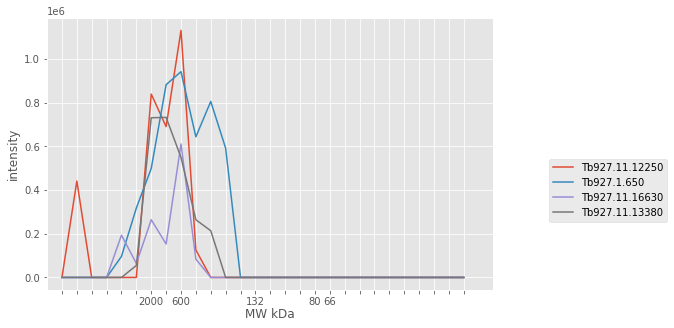

                [Molecular Weight]  [# TM Domains]  \
[Input ID]                                           
Tb927.11.12250                  92               0   
Tb927.1.650                     22               0   
Tb927.11.16630                  74              14   
Tb927.11.13380                 223               0   

                                  [Product Description]  
[Input ID]                                               
Tb927.11.12250    DNA replication licensing factor MCM4  
Tb927.1.650         conserved protein, unknown function  
Tb927.11.16630  major facilitator superfamily, putative  
Tb927.11.13380         ATP-dependent helicase, putative  


In [46]:

prots=[   
'Tb927.11.12250',
'Tb927.1.650',
'Tb927.11.16630',
'Tb927.11.16920',
'Tb927.11.13380',
]
    
quant_to_use = 'ibaq'
fig,axes = plt.subplots(ncols=1, nrows=1, figsize=(8,5))
prots = [n  for n in prots if n in res[quant_to_use]['exp_list'][0].index.values]
plot_line(res[quant_to_use]['exp_list'][2].loc[prots], axes)
#plot_line(res[quant_to_use]['exp_list'][1].loc[prots], axes[1])
plt.legend(bbox_to_anchor=(1.4, 0.5))
plt.show()
print(gene_table[['[Molecular Weight]','[# TM Domains]','[Product Description]']].loc[prots])


['Tb927.8.3150', 'Tb927.7.2500', 'Tb927.6.3100', 'Tb927.10.1060', 'Tb927.11.3240', 'Tb927.11.1900_profile_0', 'Tb927.11.1900_profile_1', 'Tb927.6.4990', 'Tb927.10.8190_profile_0', 'Tb927.11.14250', 'Tb927.11.16760']
test2 0.17115785848835985


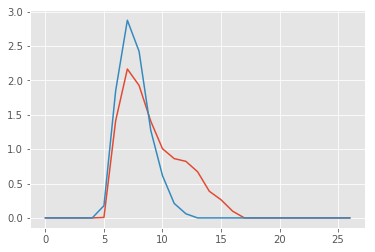

test2 0.11005038397102902


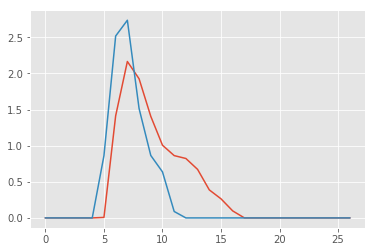

test2 0.4958376919502113


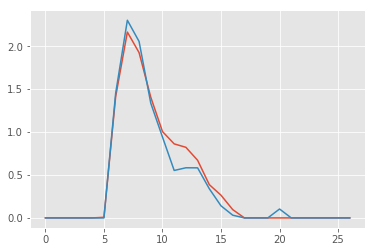

test2 0.6092744578783797


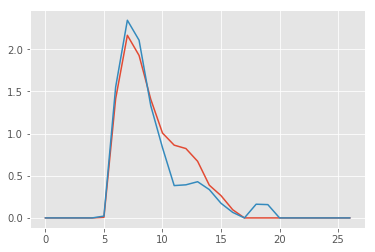

test2 0.04754721080055343


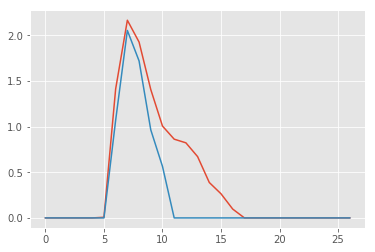

test2 0.08885695143369293


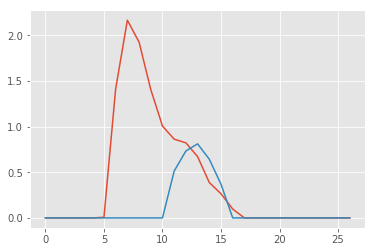

test2 0.16416606149824625


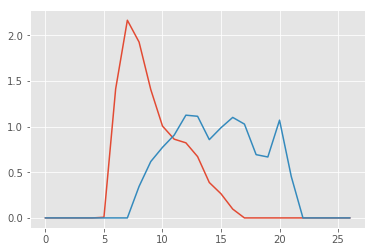

test2 0.5421527846755522


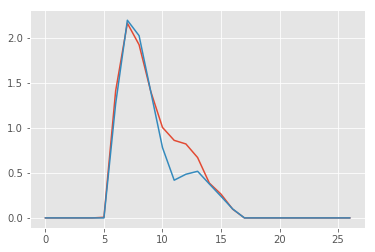

test2 0.5152000594318544


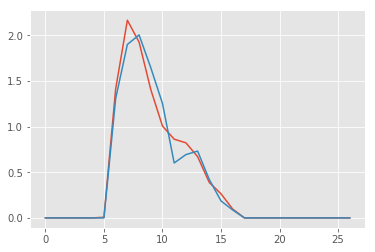

test2 0.48383130840094535


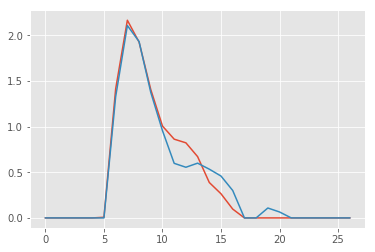

test2 0.15210656112956303


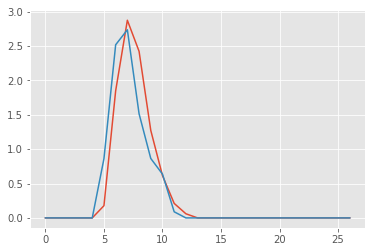

test2 0.10935554184347362


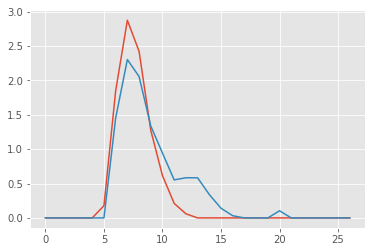

test2 0.16653660674847884


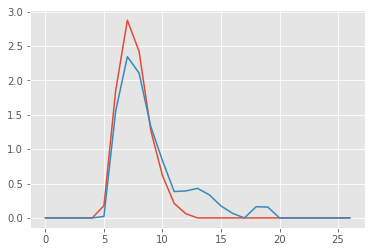

test2 0.07012046367722591


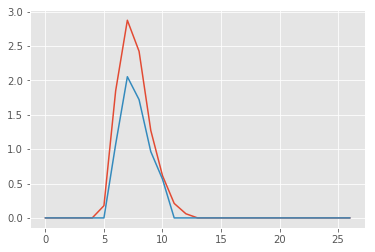

test2 0.0034202363120861157


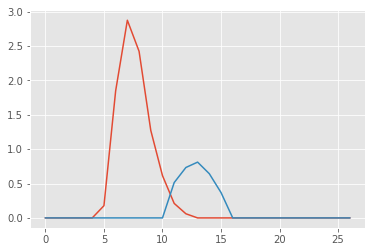

test2 0.021050446122328845


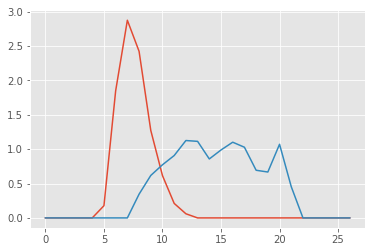

test2 0.12185983218403075


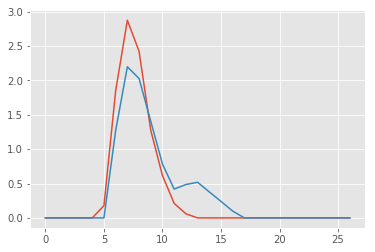

test2 0.11019952294515518


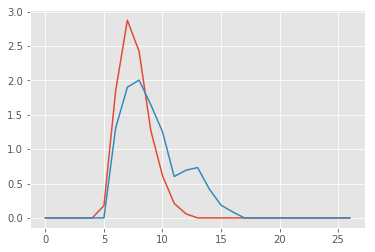

test2 0.10079903383352197


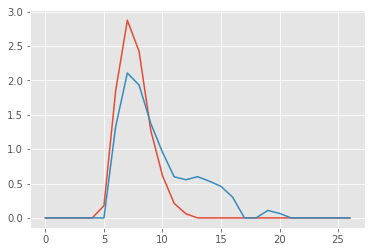

test2 0.06416525626626288


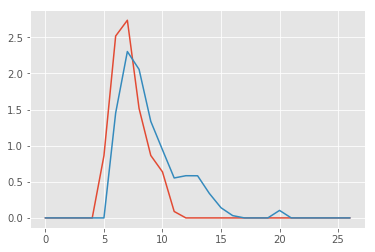

test2 0.10675907864293033


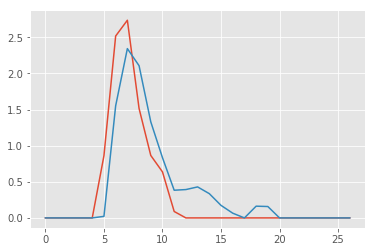

test2 0.07699327329275597


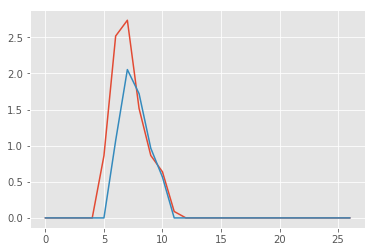

test2 0.000231689471165589


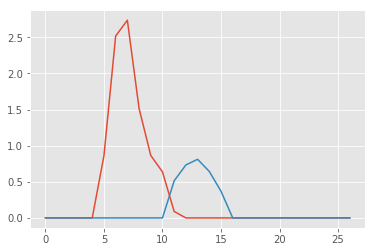

test2 0.009568002125539439


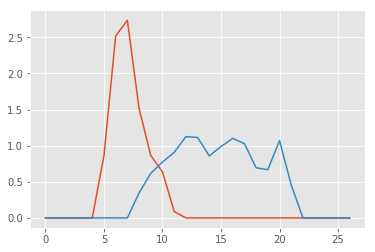

test2 0.07150375071938056


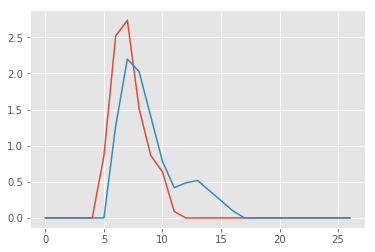

test2 0.064750051424061


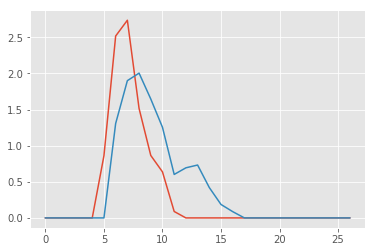

test2 0.0587809871486347


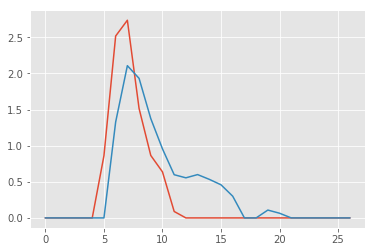

test2 0.4659474342614532


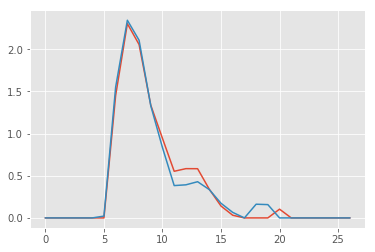

test2 0.050326982379557204


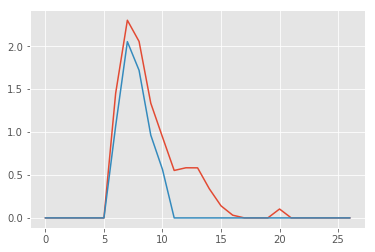

test2 0.0908320601563242


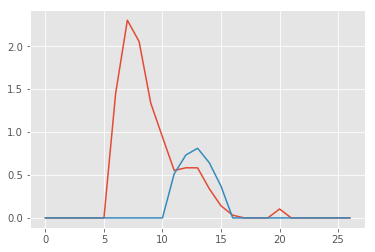

test2 0.21699096860054382


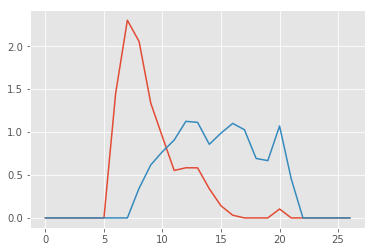

test2 0.5541178029453255


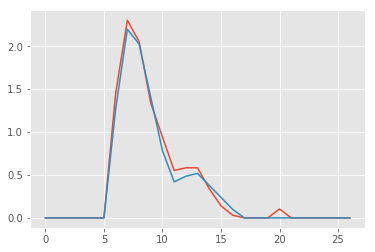

test2 0.5205984054252294


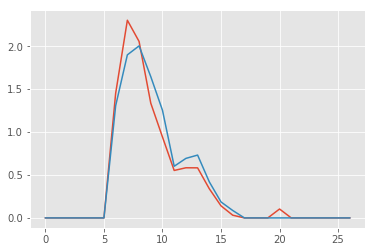

test2 0.6617072432105191


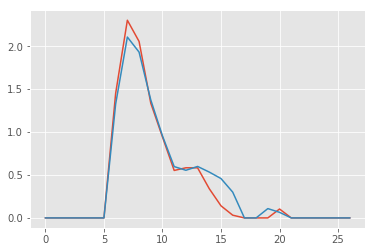

test2 0.04570258550322101


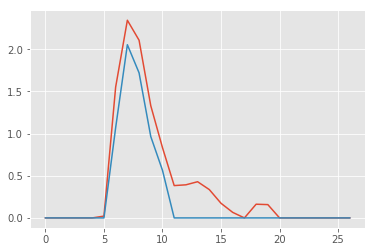

test2 0.0807949215839067


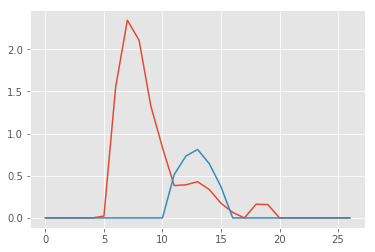

test2 0.24459801768005604


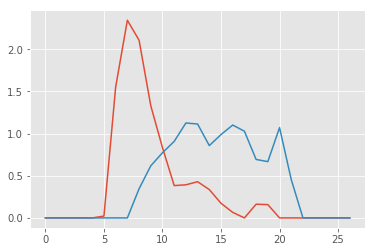

test2 0.5100861223476926


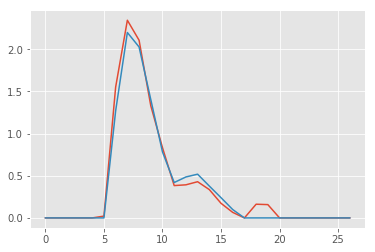

test2 0.47505958924980507


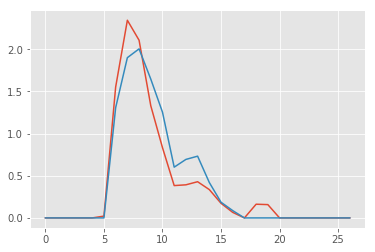

test2 0.6100539817214494


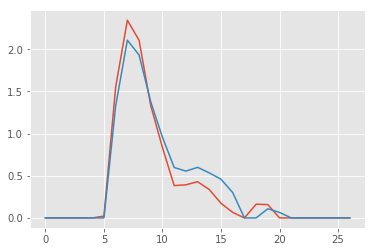

test2 None


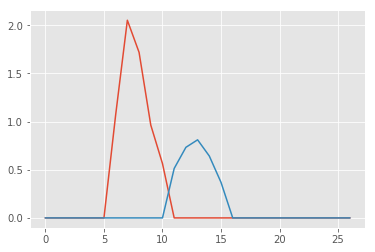

test2 0.004818215204196613


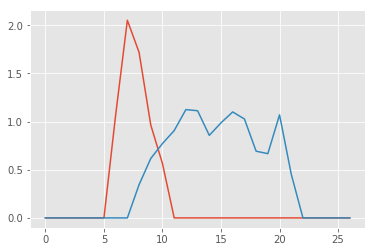

test2 0.056737961705702604


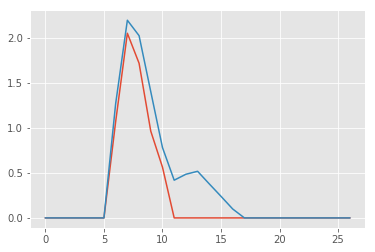

test2 0.05133505878635155


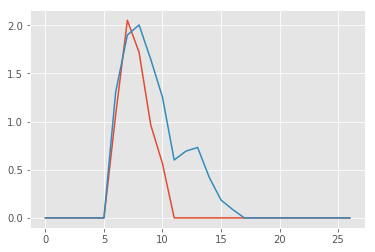

test2 0.045642390998304916


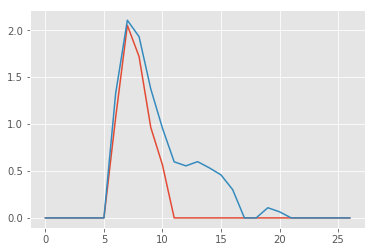

test2 0.0827305367657907


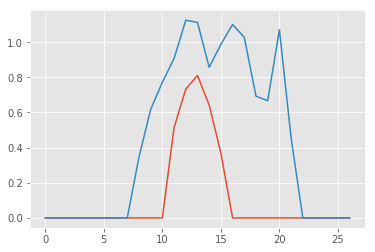

test2 0.10181951427968633


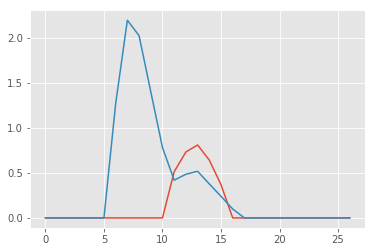

test2 0.09525938668370615


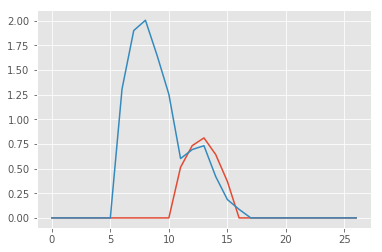

test2 0.0848003806750457


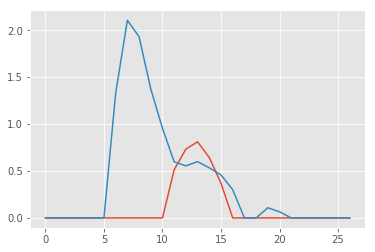

test2 0.172932450977048


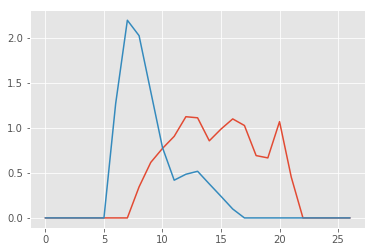

test2 0.1729311172140745


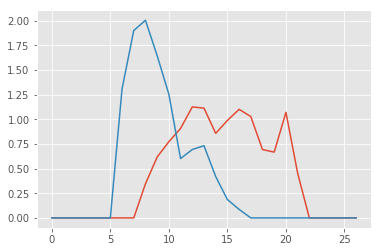

test2 0.30567837300659023


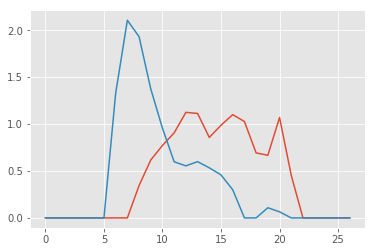

test2 0.5716884865890869


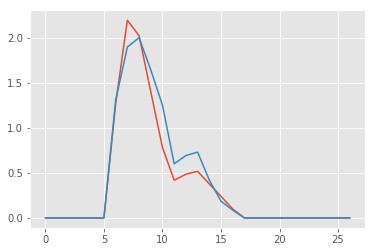

test2 0.5377199352399789


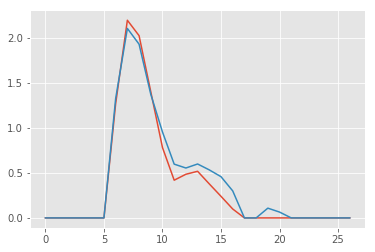

test2 0.5078971999310884


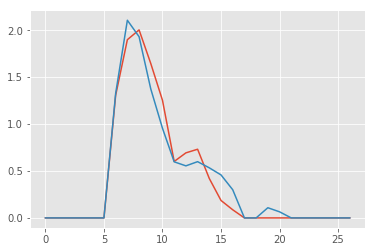

"\ntemp = res['ibaq']['exp_filter_mw'][0].loc[prots]\n#print(temp.head())\nlink = sch.linkage(temp.iloc[:,0:27], method='complete', metric=my_corr)\nfig,ax=plt.subplots()\nden_rows = sch.dendrogram(link, color_threshold=0.5, ax=ax, orientation='left')\nclusters = sch.fcluster(link, 0.5, criterion='distance')\ntemp['clusters']=clusters\ntemp['desc']=[desc_dict[a.split('_')[0]] for a in prots]\nprint(temp)\n"

In [190]:
prots=[
#'Tb927.11.10690'
'Tb927.10.1060',
'Tb927.10.8190',
'Tb927.11.14250',
'Tb927.11.16760',
'Tb927.11.1900',
'Tb927.11.3240',
'Tb927.6.4760',
'Tb927.8.3150',
'Tb927.7.2500',
'Tb927.6.3100',
'Tb927.6.4990']


def fetch(prots, df):
    split_profiles = [n for n in df.index.values if n.split('_')[0] in prots]
    return split_profiles

prots = fetch(prots, res['ibaq']['exp_filter_mw'][0])
print(prots)
#i = res['ibaq']['exp_filter_mw'][0].loc['Tb927.8.3150'][0:27]
#j = res['ibaq']['exp_filter_mw'][0].loc['Tb927.7.2500'][0:27]
def distance_metric(i, j):
    detected_i= i>0
    detected_j= j>0
    common  = detected_i & detected_j
    #print(common)
    unique, counts = np.unique(common, return_counts=True)
    if np.isin(True, unique):
        n_ij = dict(zip(unique, counts))[True]
        
        unique, counts = np.unique(detected_i, return_counts=True)
        n_i = dict(zip(unique, counts))[True]
        
        unique, counts = np.unique(detected_j, return_counts=True)
        n_j = dict(zip(unique, counts))[True]
        a = 2 * n_ij / (n_i + n_j)
        #print ('a', a)

        h_i = 1/n_ij * i.sum()
        sig_i = 1/n_ij * np.sum(np.square(i-h_i))
        #print ('h_i',h_i)
        #print ('sig_i',sig_i)

        h_j = 1/n_ij * j.sum()
        sig_j = 1/n_ij * np.sum(np.square(j-h_j))
        #print ('h_j',h_j)
        #print ('sig_j',sig_j)

        b = ( 1/n_ij * np.sum((i-h_i) * (j-h_j))) / (sig_i * sig_j)
        #print(a)
        #print('b', b)
        return (a*b)
    else:
        return 

    
    
for n in itertools.combinations(prots,2):
    #n = ('Tb927.11.3240', 'Tb927.1.650')#'Tb927.10.8190_profile_0')
    #print ('Tb927.6.4990', n[1])
    i = res['ibaq']['exp_filter_mw'][0].loc[n[0]][0:27].values
    j = res['ibaq']['exp_filter_mw'][0].loc[n[1]][0:27].values
    plt.plot(i)
    plt.plot(j)
    #plt.show()
    #corr = my_corr(i, j)
    #print ('test1',corr)
    #print ('_______')
    #i = np.array([1,1,2,3,4,5,6,7,8,9,9,8,7,6,5,4,3,2,1,1,8,9,8,9,1,1,2,3,4,5,6,7,8,9,9,8,7,6,5,4,3,2,1,1,8,9,8,9,])
    #j = 1-i
    #print(i)
    #print(j)
    corr = distance_metric(i, j)
    print('test2', corr)
    plt.show()
    
    
    
'''
temp = res['ibaq']['exp_filter_mw'][0].loc[prots]
#print(temp.head())
link = sch.linkage(temp.iloc[:,0:27], method='complete', metric=my_corr)
fig,ax=plt.subplots()
den_rows = sch.dendrogram(link, color_threshold=0.5, ax=ax, orientation='left')
clusters = sch.fcluster(link, 0.5, criterion='distance')
temp['clusters']=clusters
temp['desc']=[desc_dict[a.split('_')[0]] for a in prots]
print(temp)
'''


In [139]:
np.exp(0.3)

1.3498588075760032

In [141]:
np.exp(-0.9)

0.4065696597405991

In [146]:
np.exp(-1)

0.36787944117144233

In [147]:
np.exp(1)

2.718281828459045